In [1]:
from collections import defaultdict
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
import torch
from torch.utils.data import TensorDataset, DataLoader
from tqdm import tqdm

In [2]:
import sys
sys.path.append("..")

In [3]:
%load_ext autoreload
%autoreload 2
from common.utility import to_categorical, torch_device
from notebook_utils.generate_gaussian import generate_gaussian
from notebook_utils.eigan import Encoder, Discriminator
from notebook_utils.federated import federated
from notebook_utils.eigan_training import distributed, centralized
from notebook_utils.utility import class_plot, to_numpy
import notebook_utils.metrics as metrics

In [4]:
device='gpu'
device = torch_device(device=device)
device

device(type='cuda')

# Training

In [5]:
MAX = 1024
history = {}
NUM_TRIALS = 10
VAR1 = 4
VAR2 = 1
NUM_NODES = 2
PHI=1
BATCHSIZE=512

VAR1: 0.4, VAR2: 0.1
@node 0, X: (1871, 2), y_1: (1871, 1), y2: (1871, 1)
@node 1, X: (2455, 2), y_1: (2455, 1), y2: (2455, 1)
@node 0: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1496, 2) (375, 2) (1496, 1) (375, 1) (1496, 1) (375, 1)
@node 0: class weights => w1, w2 [array([2.1744186 , 1.85148515])] [array([4.53333333, 1.28301887])]
@node 0: tensor sizes => torch.Size([1496, 2]) (375, 2) torch.Size([1496, 2]) (375, 2) torch.Size([1496, 2]) (375, 2)
@node 1: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1964, 2) (491, 2) (1964, 1) (491, 1) (1964, 1) (491, 1)
@node 1: class weights => w1, w2 [array([2.1744186 , 1.85148515]), array([1.60720131, 2.64690027])] [array([4.53333333, 1.28301887]), array([1.77576854, 2.28904429])]
@node 1: tensor sizes => torch.Size([1964, 2]) (491, 2) torch.Size([1964, 2]) (491, 2) torch.Size([1964, 2]) (491, 2)


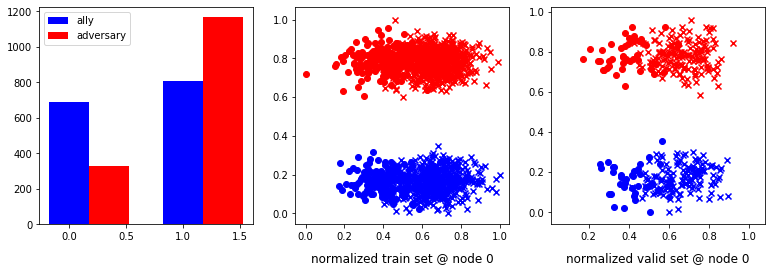

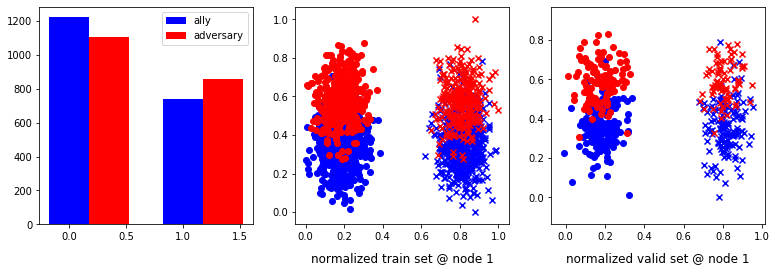

In [6]:
X1, y_11, y_21 = generate_gaussian(VAR1/10, VAR2/10, 1000, 1)
X2, y_12, y_22 = generate_gaussian((VAR1-3)/10, (VAR2+4)/10, 1000, 1, MEAN=2)
X = [X1, X2] 
y_1 = [y_11, y_12]
y_2 = [y_21, y_22]

print('='*80)
print('VAR1: {}, VAR2: {}'.format(VAR1/10, VAR2/10))
print('='*80)
for _ in range(NUM_NODES):
    print('@node {}, X: {}, y_1: {}, y2: {}'.format(_, X[_].shape, y_1[_].shape, y_2[_].shape))
    
w_1 = []
w_2 = []
train_loaders = []
X_valids = []
X_trains = []
y_1_valids = []
y_1_trains = []
y_2_valids = []
y_2_trains = []
for node_idx in range(NUM_NODES):
    X_local = X[node_idx]
    y_1_local = y_1[node_idx]
    y_2_local = y_2[node_idx]
    
    X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid = train_test_split(
        X_local, y_1_local, y_2_local, test_size=0.2, stratify=pd.DataFrame(
            np.concatenate((y_1_local, y_2_local), axis=1)
        ))
    print('@node {}: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid'.format(node_idx))
    print(X_train.shape, X_valid.shape, y_1_train.shape, y_1_valid.shape, y_2_train.shape, y_2_valid.shape)

    w = np.bincount(y_1_train.flatten())
    w_1.append(sum(w)/w)
    w = np.bincount(y_2_train.flatten())
    w_2.append(sum(w)/w)
    print('@node {}: class weights => w1, w2'.format(node_idx), w_1, w_2)

    scaler = MinMaxScaler()
    X_train = scaler.fit_transform(X_train)
    X_valid = scaler.transform(X_valid)
    
    width = 0.35
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(13, 4))
    ax1.bar(np.unique(y_1_train.flatten()), np.bincount(y_1_train.flatten()), width, color='b')
    ax1.bar(np.unique(y_2_train.flatten())+width, np.bincount(y_2_train.flatten()), width, color='r')
    ax1.legend(['ally', 'adversary'])
    
    y_1_train = to_categorical(y_1_train)
    y_2_train = to_categorical(y_2_train)
    y_1_valid = to_categorical(y_1_valid)
    y_2_valid = to_categorical(y_2_valid)

    X_train = torch.Tensor(X_train)
    y_1_train = torch.Tensor(y_1_train)
    y_2_train = torch.Tensor(y_2_train)

    X_valids.append(torch.Tensor(X_valid))
    y_1_valids.append(torch.Tensor(y_1_valid))
    y_2_valids.append(torch.Tensor(y_2_valid))
    
    X_trains.append(X_train)
    y_1_trains.append(y_1_train)
    y_2_trains.append(y_2_train)

    class_plot(X_train, np.argmax(y_1_train, axis=1), np.argmax(y_2_train, axis=1), 'normalized train set @ node {}'.format(node_idx), ax2)
    class_plot(X_valid, np.argmax(y_1_valid, axis=1), np.argmax(y_2_valid, axis=1), 'normalized valid set @ node {}'.format(node_idx), ax3)

    print('@node {}: tensor sizes =>'.format(node_idx), X_train.shape, X_valid.shape, y_1_train.shape, y_1_valid.shape, y_2_train.shape, y_2_valid.shape)

    train_loaders.append(DataLoader(TensorDataset(X_train, y_1_train, y_2_train), batch_size=BATCHSIZE, shuffle=True))

In [10]:
alpha = 1
lr_encd = 0.001
lr_1 = 0.001
lr_2 = 0.001
n_iter_gan = 501

input_size = X_train.shape[1]
hidden_size = input_size*8
output_size = 2

In [11]:
global_params = {}
encoders = {}

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.0 and delta=1
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.66088653 	 0.66336465 	 1.02272451 	 1.02386391 	 1.05505013 	 1.05364645


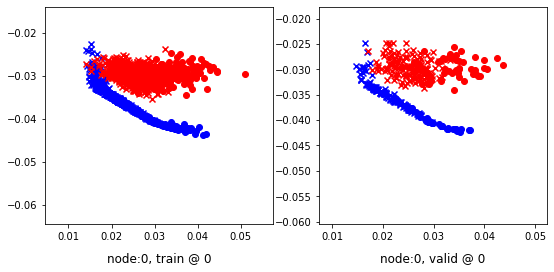

0 	 1 	 0.69071090 	 0.68952394 	 1.04626024 	 1.04222322 	 1.04891670 	 1.04584646


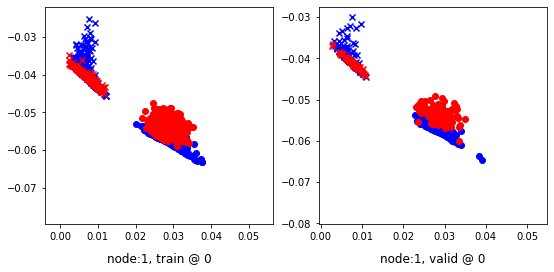

20 	 0 	 0.72248477 	 0.70600080 	 0.95300114 	 0.95274931 	 0.92432934 	 0.93989569


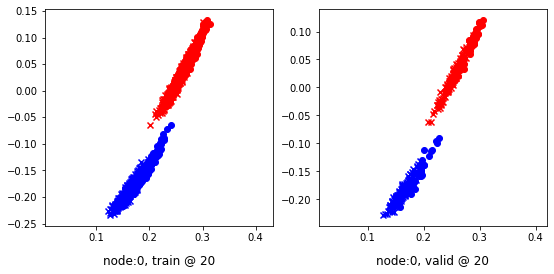

20 	 1 	 0.65729761 	 0.68361092 	 0.92030060 	 0.94494438 	 0.95620495 	 0.95448065


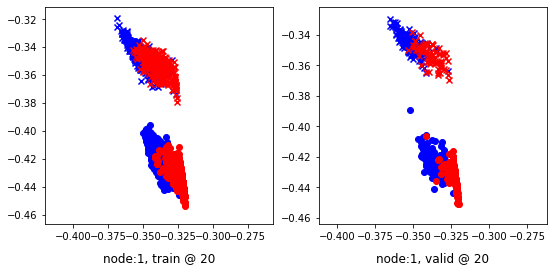

40 	 0 	 0.32905817 	 0.33344227 	 0.53878695 	 0.53320199 	 0.90741551 	 0.89290690


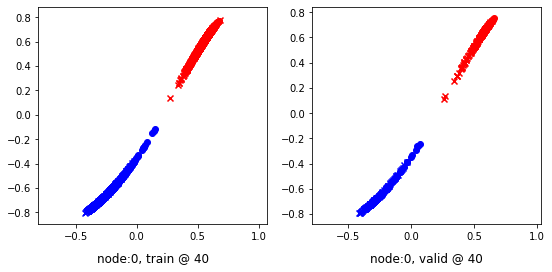

40 	 1 	 0.60054076 	 0.59925920 	 0.86173946 	 0.85844308 	 0.95600855 	 0.95233107


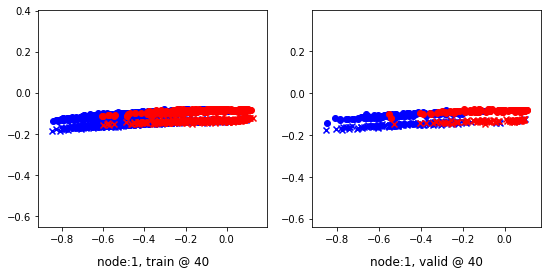

60 	 0 	 -0.16066784 	 -0.15721782 	 0.04785553 	 0.04740857 	 0.90200084 	 0.89777356


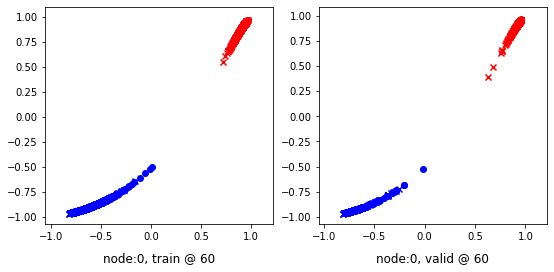

60 	 1 	 0.26047343 	 0.20592687 	 0.51809359 	 0.46389344 	 0.95099086 	 0.95111376


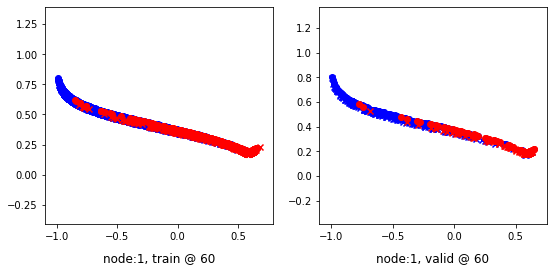

80 	 0 	 -0.22715238 	 -0.19547866 	 0.00934329 	 0.00957550 	 0.92971647 	 0.89820135


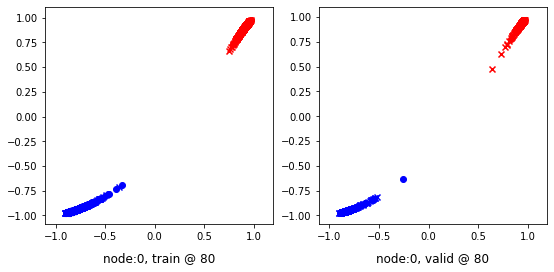

80 	 1 	 0.23153704 	 0.19482446 	 0.48087206 	 0.45449543 	 0.94305038 	 0.95281816


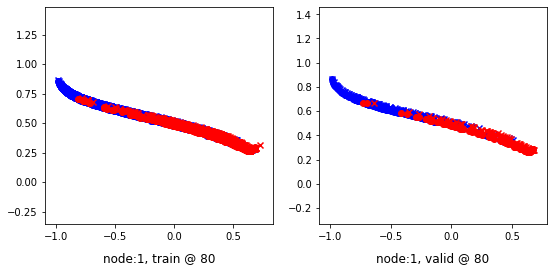

100 	 0 	 -0.22990532 	 -0.20360138 	 0.00391259 	 0.00396620 	 0.92701447 	 0.90071476


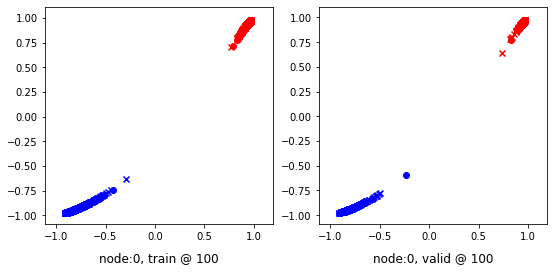

100 	 1 	 0.21110442 	 0.19811189 	 0.47247598 	 0.45560640 	 0.95492029 	 0.95064169


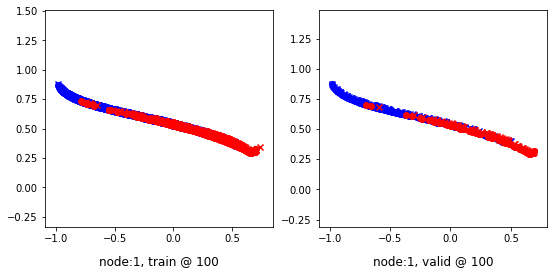

120 	 0 	 -0.21352361 	 -0.20474860 	 0.00210411 	 0.00222293 	 0.90877855 	 0.90011871


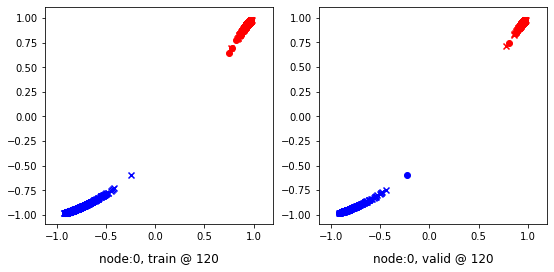

120 	 1 	 0.28839725 	 0.19945455 	 0.55064231 	 0.45913470 	 0.95505661 	 0.95282733


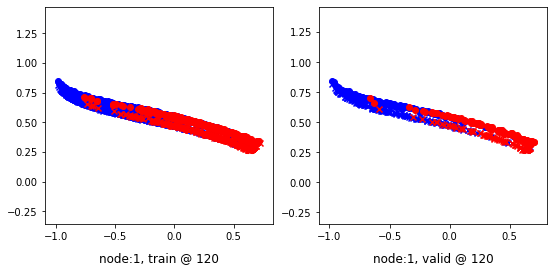

140 	 0 	 -0.20356220 	 -0.20477347 	 0.00129042 	 0.00139225 	 0.89800179 	 0.89931291


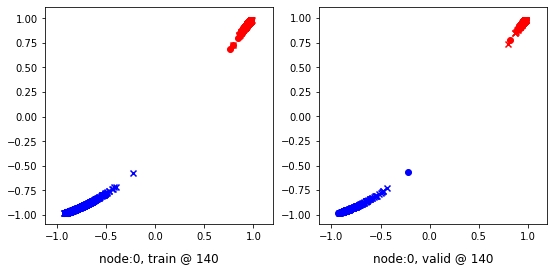

140 	 1 	 0.26984704 	 0.19511518 	 0.52321249 	 0.45546046 	 0.94718117 	 0.95349246


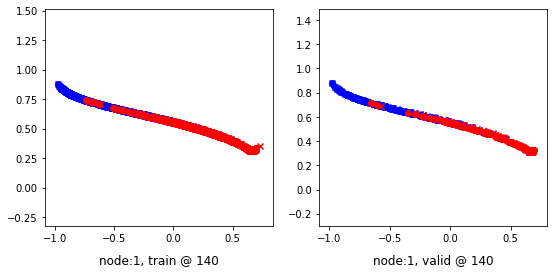

160 	 0 	 -0.16910523 	 -0.20494227 	 0.00084436 	 0.00089540 	 0.86310291 	 0.89898485


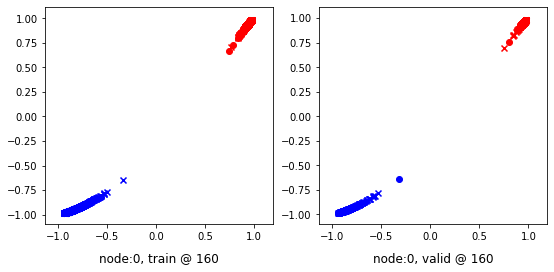

160 	 1 	 0.30895567 	 0.20097521 	 0.55576658 	 0.45640394 	 0.93999571 	 0.94857591


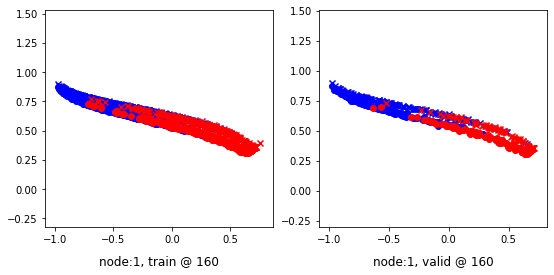

180 	 0 	 -0.17315151 	 -0.20538190 	 0.00061647 	 0.00063691 	 0.86691964 	 0.89916599


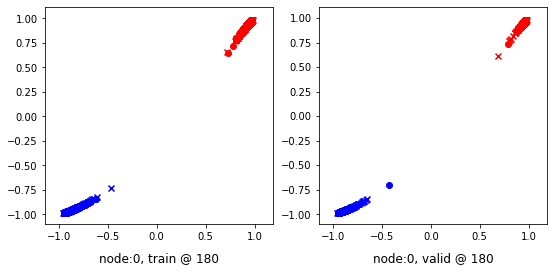

180 	 1 	 0.21323848 	 0.19005448 	 0.47459570 	 0.45488405 	 0.95410025 	 0.95797676


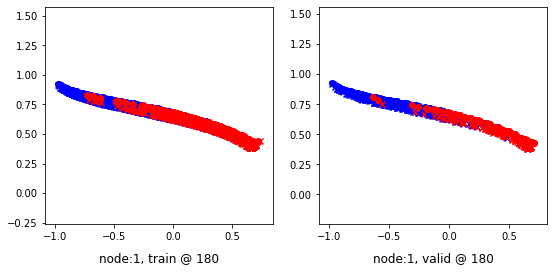

200 	 0 	 -0.18249662 	 -0.20579165 	 0.00047533 	 0.00049179 	 0.87612331 	 0.89943063


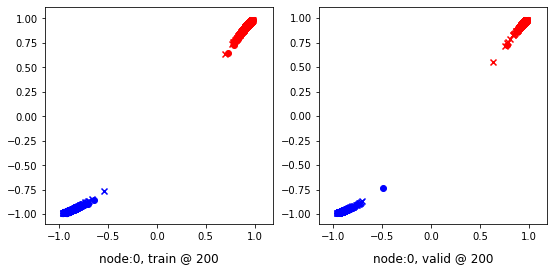

200 	 1 	 0.27193117 	 0.20392668 	 0.51850069 	 0.45607883 	 0.94034070 	 0.94529933


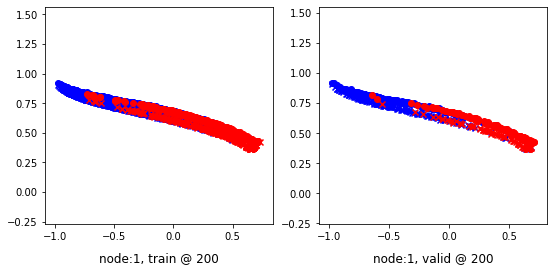

220 	 0 	 -0.18643372 	 -0.20610319 	 0.00036659 	 0.00039495 	 0.87995046 	 0.89964533


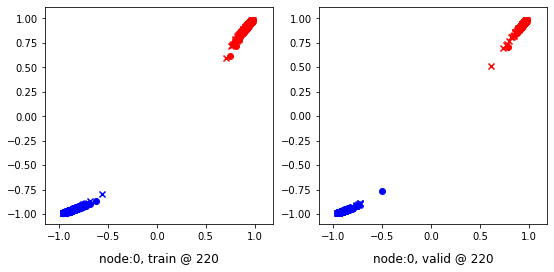

220 	 1 	 0.23506498 	 0.19215718 	 0.48825699 	 0.45688060 	 0.94899070 	 0.95787060


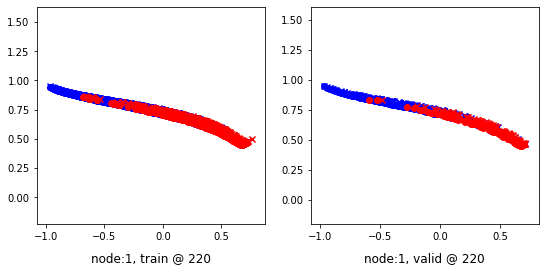

240 	 0 	 -0.19727810 	 -0.20623659 	 0.00029384 	 0.00031943 	 0.89072114 	 0.89970320


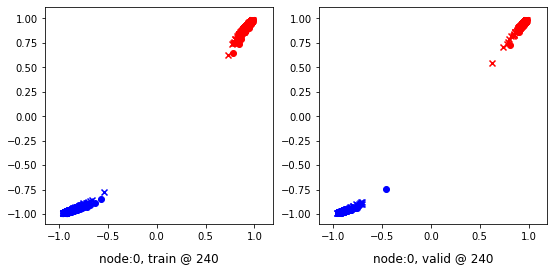

240 	 1 	 0.16075206 	 0.19672582 	 0.42548490 	 0.45820859 	 0.95835501 	 0.95462996


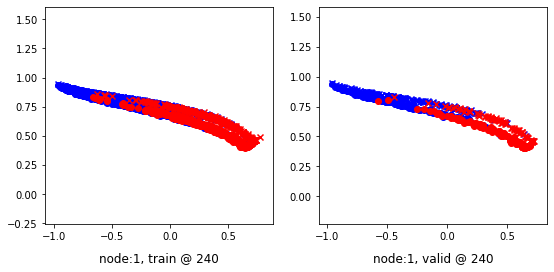

260 	 0 	 -0.19407906 	 -0.20608808 	 0.00024286 	 0.00026374 	 0.88747007 	 0.89949900


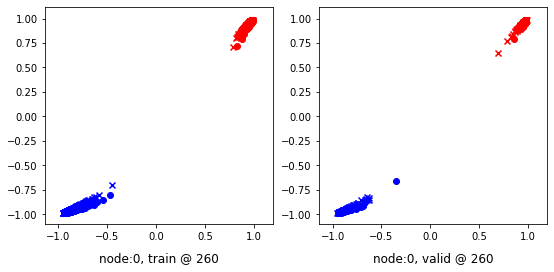

260 	 1 	 0.21614152 	 0.20121467 	 0.46772268 	 0.45539743 	 0.94459528 	 0.94732994


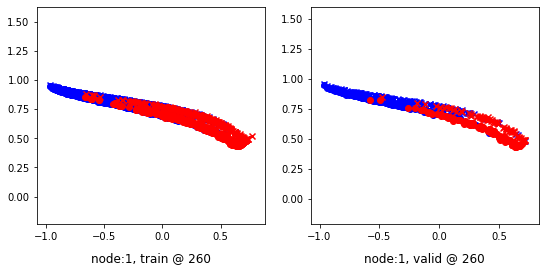

280 	 0 	 -0.22861958 	 -0.20602304 	 0.00020973 	 0.00023133 	 0.92197859 	 0.89940155


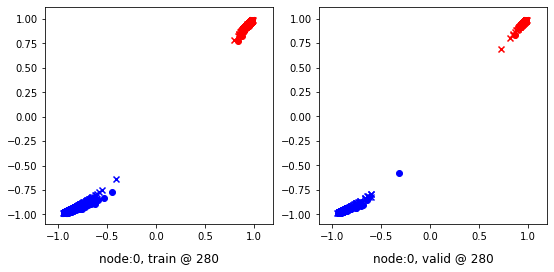

280 	 1 	 0.21245313 	 0.19428855 	 0.47203502 	 0.45476609 	 0.95382303 	 0.95362473


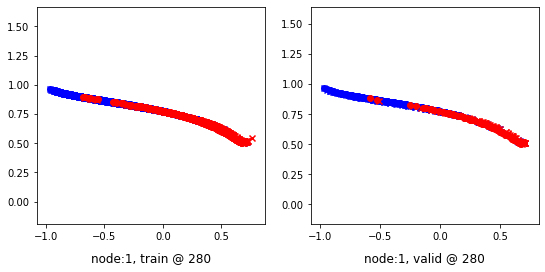

300 	 0 	 -0.23442125 	 -0.20609806 	 0.00017809 	 0.00019797 	 0.92774910 	 0.89944321


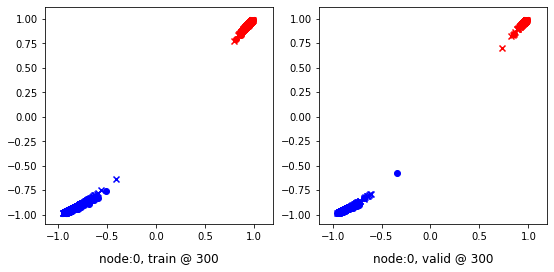

300 	 1 	 0.24714911 	 0.19539756 	 0.50988281 	 0.45330149 	 0.95585507 	 0.95105112


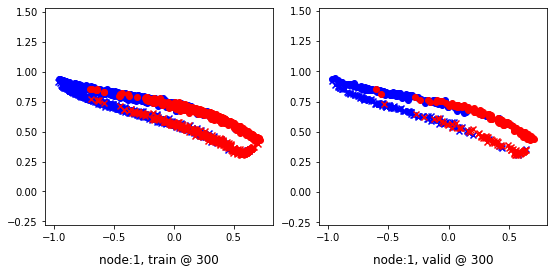

320 	 0 	 -0.23134260 	 -0.20630489 	 0.00016519 	 0.00018669 	 0.92465818 	 0.89963877


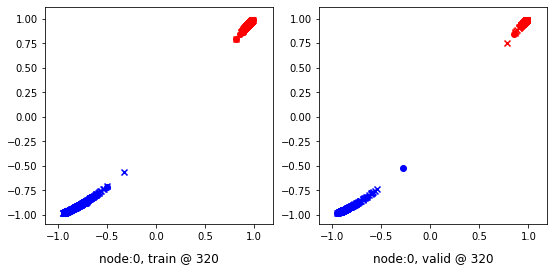

320 	 1 	 0.29505301 	 0.20466694 	 0.54960197 	 0.45751563 	 0.94800484 	 0.94599587


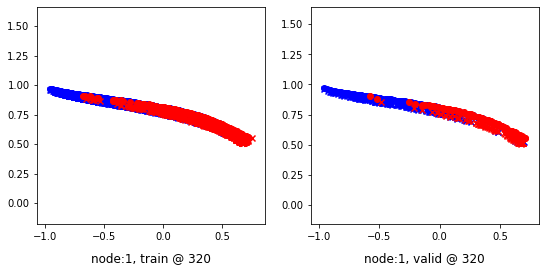

340 	 0 	 -0.21483395 	 -0.20640919 	 0.00020205 	 0.00024203 	 0.90818530 	 0.89979839


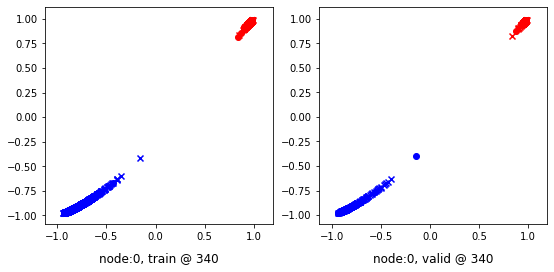

340 	 1 	 0.22577608 	 0.18971825 	 0.49117184 	 0.45392060 	 0.95841449 	 0.95734954


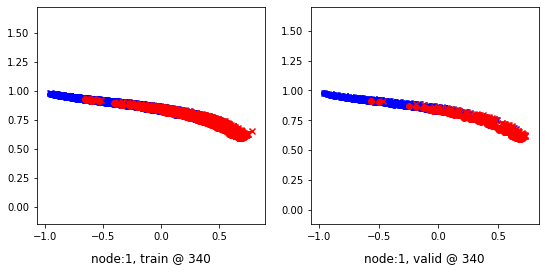

360 	 0 	 -0.20793180 	 -0.20608869 	 0.00015635 	 0.00021861 	 0.90123528 	 0.89945447


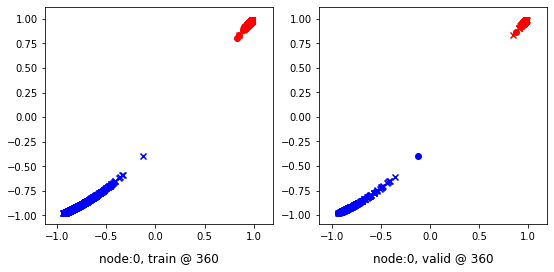

360 	 1 	 0.16087291 	 0.19113287 	 0.43658841 	 0.45448688 	 0.96888775 	 0.95650119


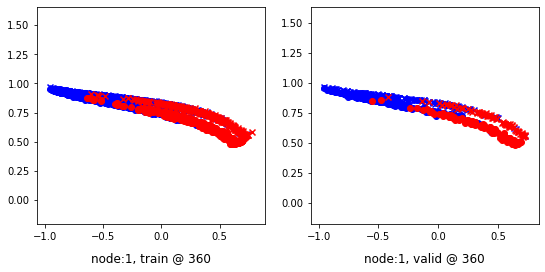

380 	 0 	 -0.18384613 	 -0.20593475 	 0.00011149 	 0.00011994 	 0.87710935 	 0.89920187


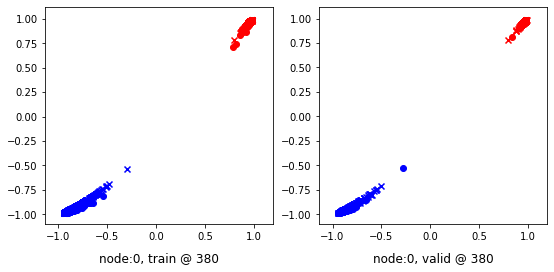

380 	 1 	 0.25334948 	 0.20114958 	 0.50785971 	 0.45927024 	 0.94770741 	 0.95126784


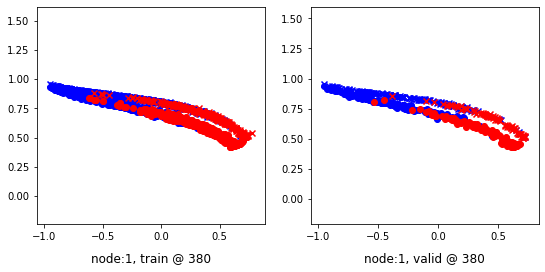

400 	 0 	 -0.19787569 	 -0.20615071 	 0.00008669 	 0.00009453 	 0.89111185 	 0.89939243


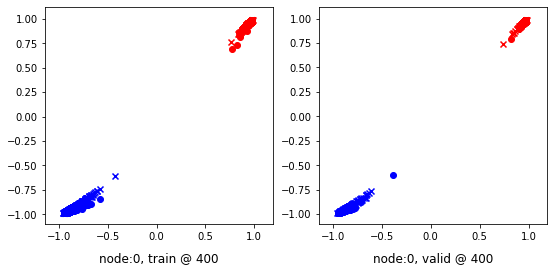

400 	 1 	 0.20811564 	 0.20314121 	 0.46219829 	 0.45646858 	 0.94742846 	 0.94647455


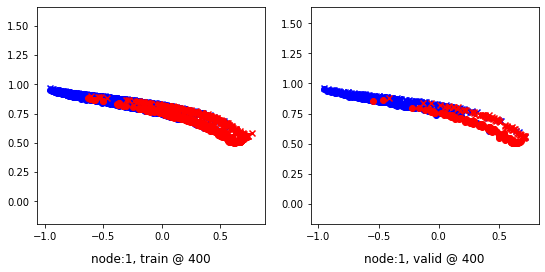

420 	 0 	 -0.18642303 	 -0.20622912 	 0.00007654 	 0.00008765 	 0.87964749 	 0.89946395


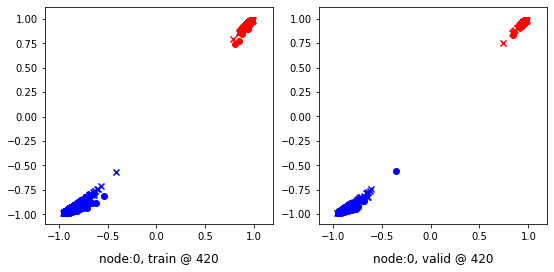

420 	 1 	 0.22606957 	 0.19390309 	 0.48045069 	 0.45539552 	 0.94862503 	 0.95463961


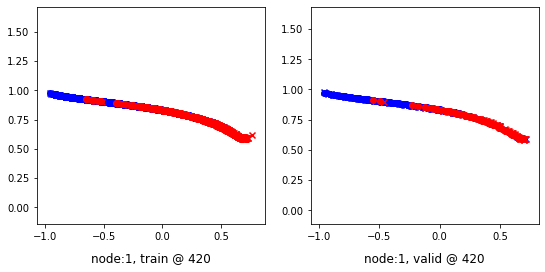

440 	 0 	 -0.20471863 	 -0.20616645 	 0.00007226 	 0.00008595 	 0.89793825 	 0.89939958


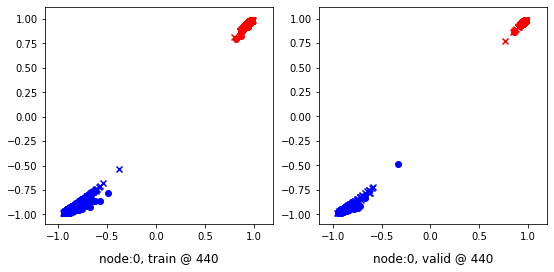

440 	 1 	 0.21202832 	 0.18382758 	 0.47913736 	 0.45375472 	 0.96084207 	 0.96307433


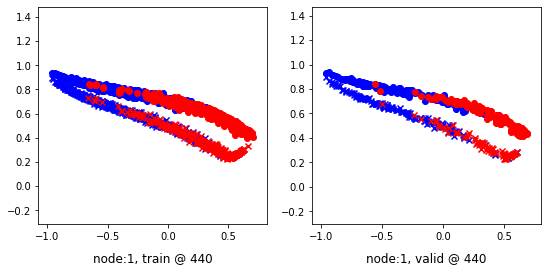

460 	 0 	 -0.25540492 	 -0.20620145 	 0.00006648 	 0.00007598 	 0.94862092 	 0.89942461


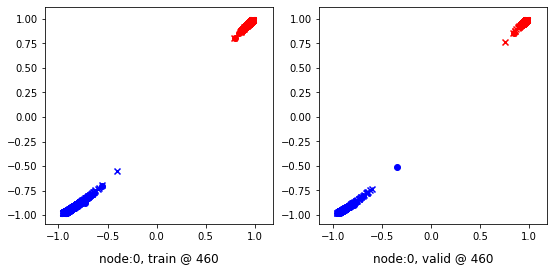

460 	 1 	 0.24757856 	 0.21235102 	 0.47676998 	 0.45211154 	 0.92277354 	 0.93290770


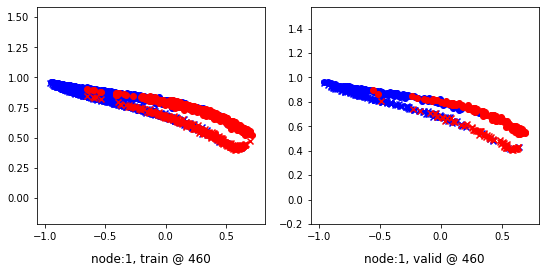

480 	 0 	 -0.17773041 	 -0.20620410 	 0.00006296 	 0.00007344 	 0.87094080 	 0.89942473


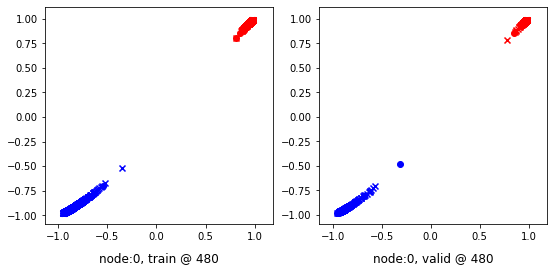

480 	 1 	 0.20735869 	 0.19210663 	 0.47431323 	 0.45395520 	 0.96190989 	 0.95499575


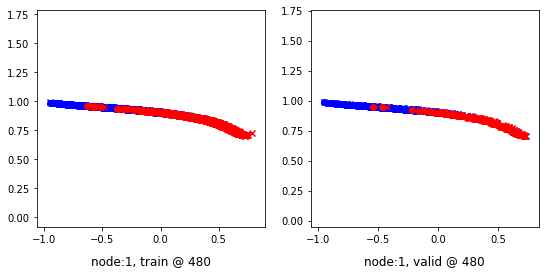

500 	 0 	 -0.18355407 	 -0.20613661 	 0.00005489 	 0.00006506 	 0.87675643 	 0.89934886


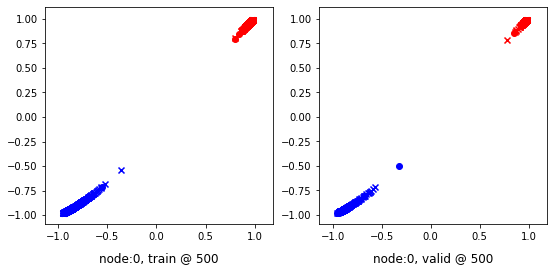

500 	 1 	 0.19140545 	 0.18224019 	 0.46464962 	 0.45366603 	 0.96706909 	 0.96457303


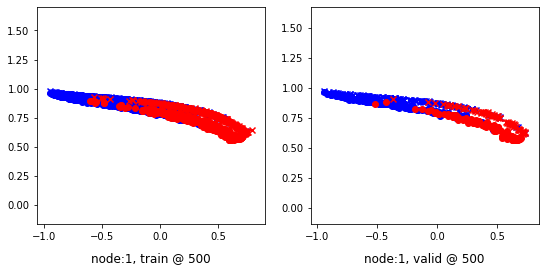

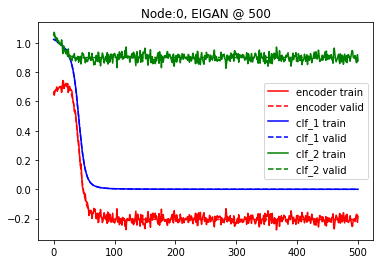

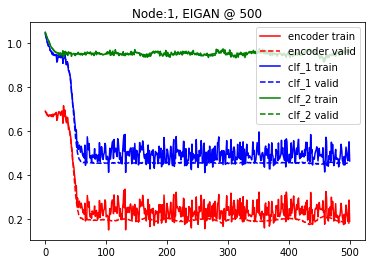

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.0 and delta=3
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.71835554 	 0.71721351 	 1.07665324 	 1.07436788 	 1.05195010 	 1.05030155


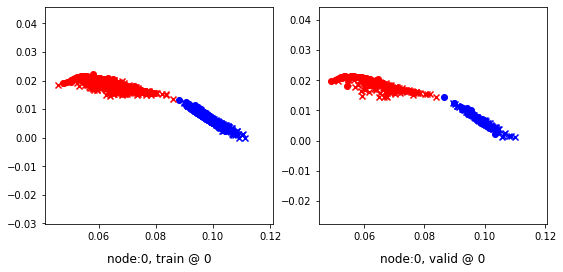

0 	 1 	 0.70546222 	 0.71081567 	 1.05688751 	 1.05767834 	 1.04476821 	 1.04000986


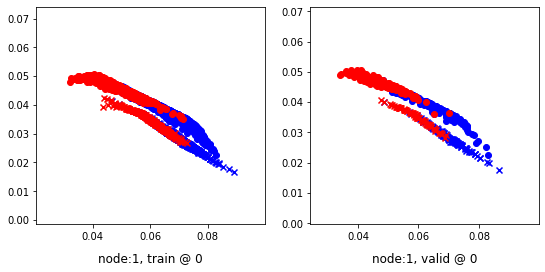

20 	 0 	 0.70399457 	 0.71179086 	 0.95518994 	 0.95491636 	 0.94454789 	 0.93627268


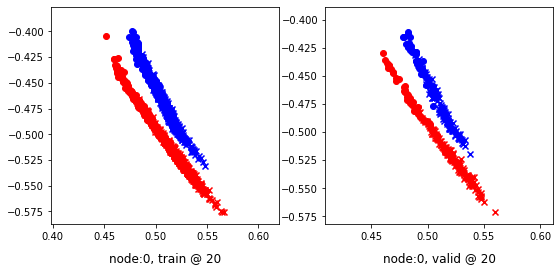

20 	 1 	 0.69978946 	 0.70933360 	 0.96441692 	 0.96664655 	 0.95806283 	 0.95046014


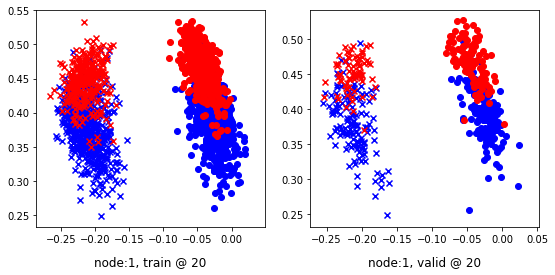

40 	 0 	 0.70591277 	 0.70375031 	 0.90836823 	 0.90935165 	 0.89727628 	 0.89874852


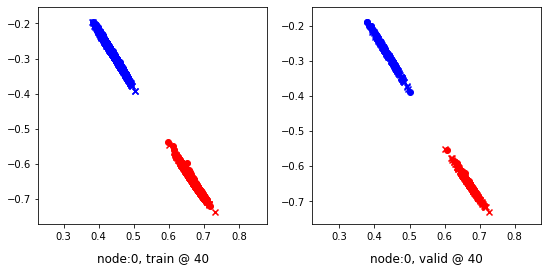

40 	 1 	 0.61616141 	 0.59790438 	 0.87229460 	 0.85702646 	 0.95072478 	 0.95226926


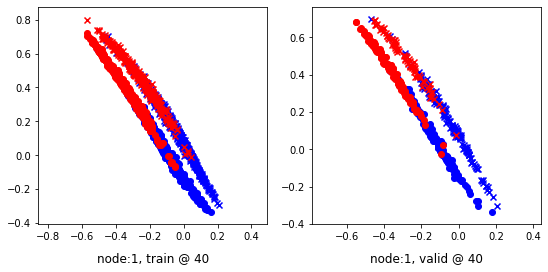

60 	 0 	 0.09956792 	 0.09649569 	 0.30957651 	 0.30337012 	 0.90492350 	 0.90002161


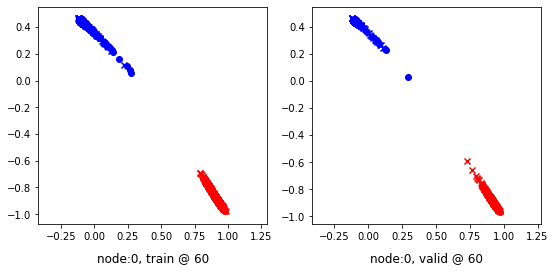

60 	 1 	 0.29442841 	 0.22144228 	 0.54188132 	 0.48241258 	 0.94043893 	 0.95411748


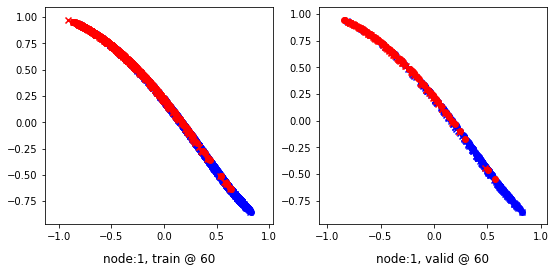

80 	 0 	 -0.20387168 	 -0.17788666 	 0.02773383 	 0.02773517 	 0.92499077 	 0.89876902


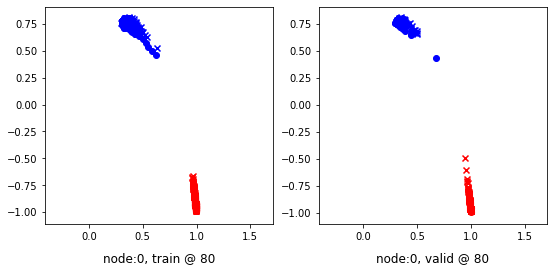

80 	 1 	 0.21805856 	 0.19915089 	 0.48617846 	 0.45870265 	 0.96100509 	 0.95269895


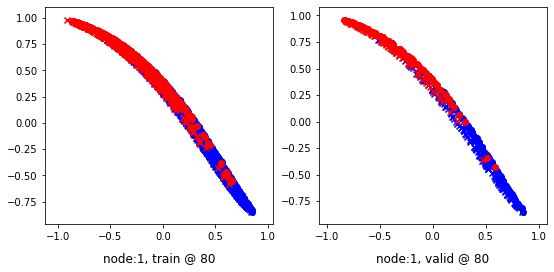

100 	 0 	 -0.19830857 	 -0.19950411 	 0.00561262 	 0.00571784 	 0.89709210 	 0.89836913


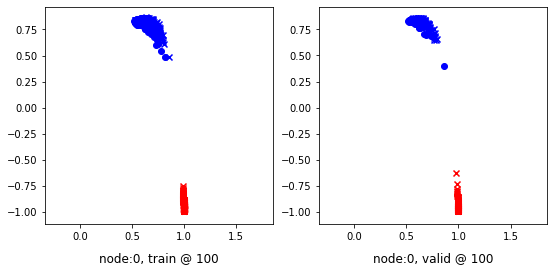

100 	 1 	 0.23362613 	 0.20091352 	 0.49734110 	 0.45862338 	 0.95673603 	 0.95085704


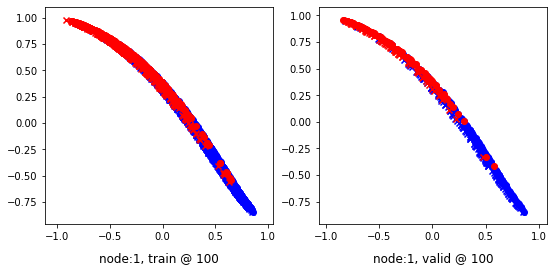

120 	 0 	 -0.15433428 	 -0.20250840 	 0.00258947 	 0.00277785 	 0.85009241 	 0.89843345


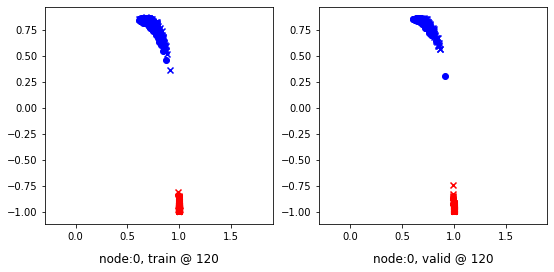

120 	 1 	 0.22726029 	 0.20118141 	 0.48889992 	 0.46102029 	 0.95476192 	 0.95298606


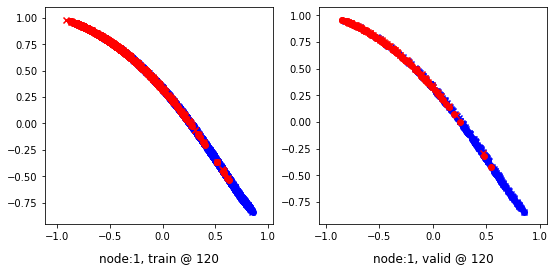

140 	 0 	 -0.16591352 	 -0.20445752 	 0.00164378 	 0.00191594 	 0.86072952 	 0.89952064


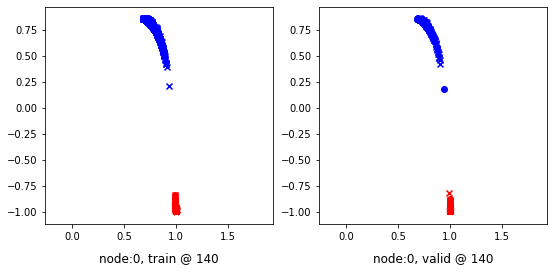

140 	 1 	 0.28016752 	 0.19650647 	 0.53183478 	 0.45693979 	 0.94476020 	 0.95358050


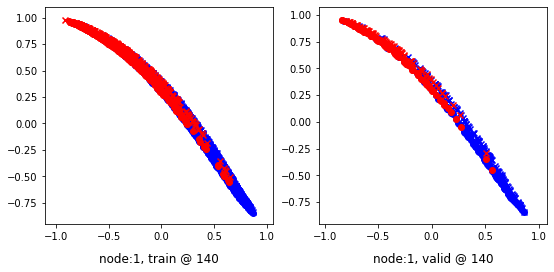

160 	 0 	 -0.17652491 	 -0.20511740 	 0.00104845 	 0.00115794 	 0.87072325 	 0.89942253


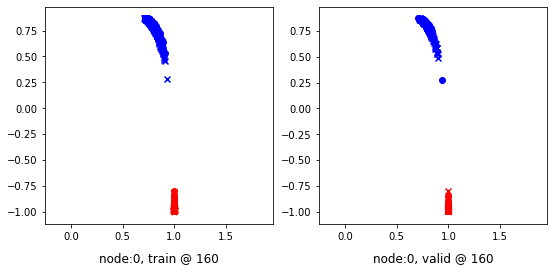

160 	 1 	 0.26892889 	 0.20051515 	 0.52175355 	 0.45831388 	 0.94660479 	 0.95094591


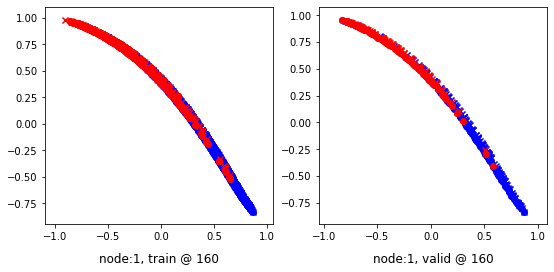

180 	 0 	 -0.23836932 	 -0.20548311 	 0.00075879 	 0.00079497 	 0.93228006 	 0.89942527


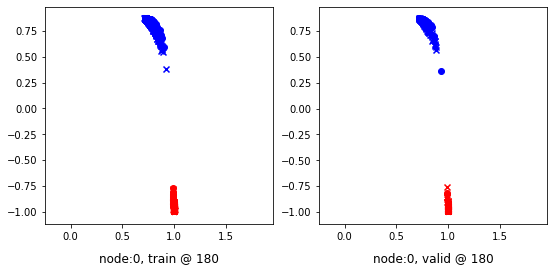

180 	 1 	 0.25953674 	 0.19864193 	 0.50125200 	 0.46107724 	 0.93809986 	 0.95558250


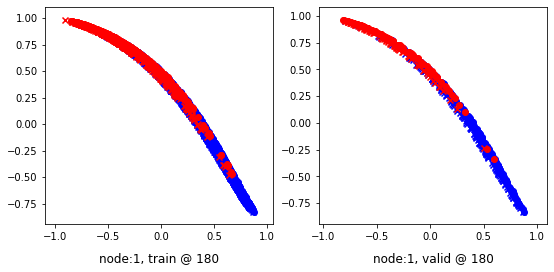

200 	 0 	 -0.18725912 	 -0.20589909 	 0.00057663 	 0.00060281 	 0.88098752 	 0.89964908


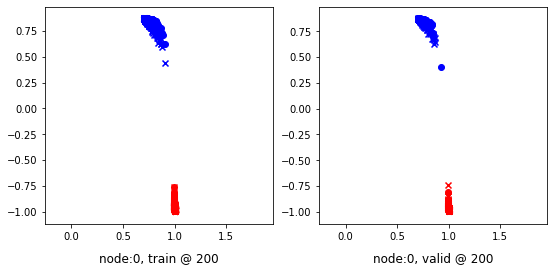

200 	 1 	 0.22432601 	 0.20195749 	 0.47902629 	 0.45939299 	 0.94809556 	 0.95058268


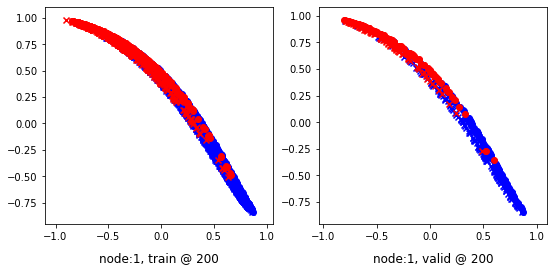

220 	 0 	 -0.21168518 	 -0.20598039 	 0.00046727 	 0.00048307 	 0.90530109 	 0.89961064


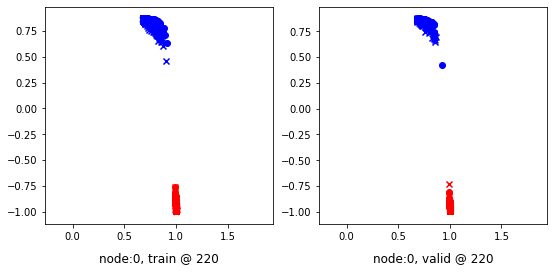

220 	 1 	 0.24545258 	 0.19442964 	 0.51253909 	 0.45706135 	 0.96046788 	 0.95577890


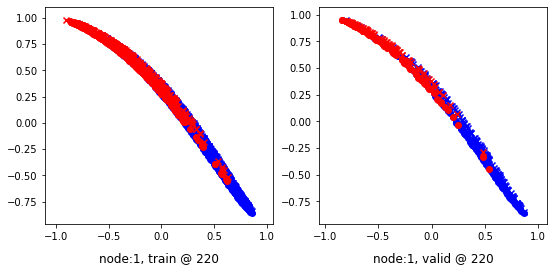

240 	 0 	 -0.22123681 	 -0.20562471 	 0.00037452 	 0.00038855 	 0.91475964 	 0.89916044


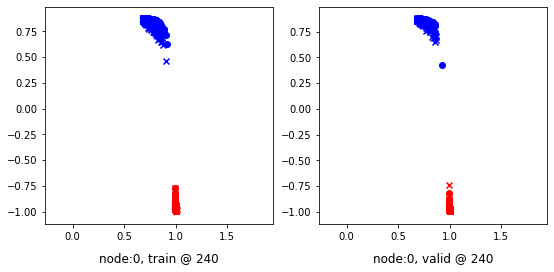

240 	 1 	 0.23509121 	 0.20014635 	 0.48738816 	 0.45899639 	 0.94565046 	 0.95199722


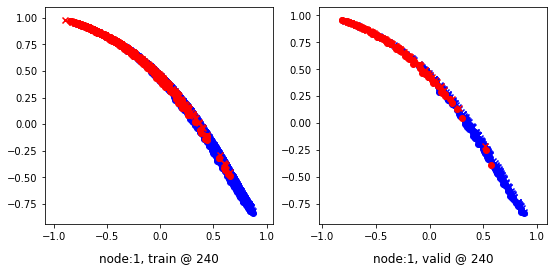

260 	 0 	 -0.20009556 	 -0.20553276 	 0.00028156 	 0.00030860 	 0.89353579 	 0.89898854


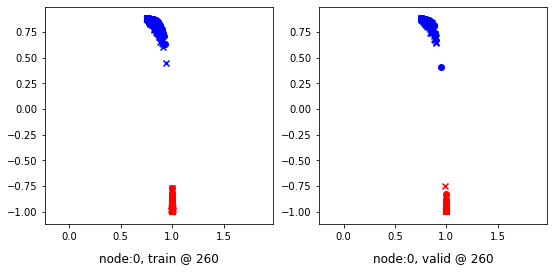

260 	 1 	 0.24475503 	 0.19848311 	 0.50662738 	 0.45952505 	 0.95499867 	 0.95418912


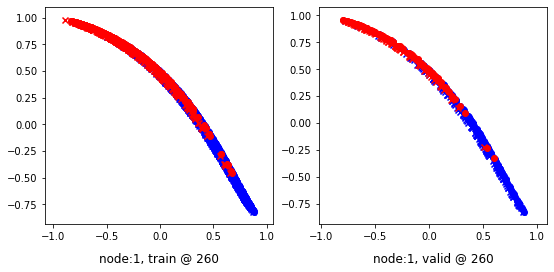

280 	 0 	 -0.22947571 	 -0.20600714 	 0.00023180 	 0.00025258 	 0.92285919 	 0.89940691


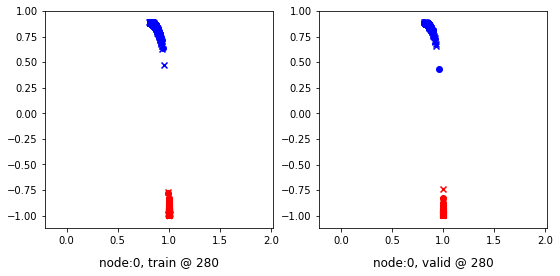

280 	 1 	 0.25944638 	 0.19950485 	 0.52039772 	 0.45921946 	 0.95454520 	 0.95286179


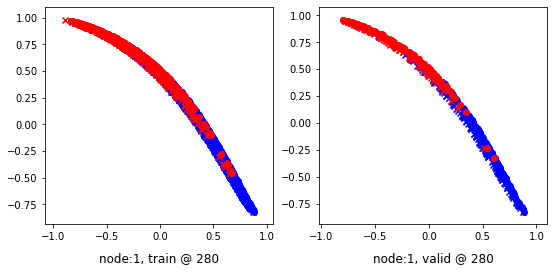

300 	 0 	 -0.25357187 	 -0.20622776 	 0.00020816 	 0.00022174 	 0.94692838 	 0.89959669


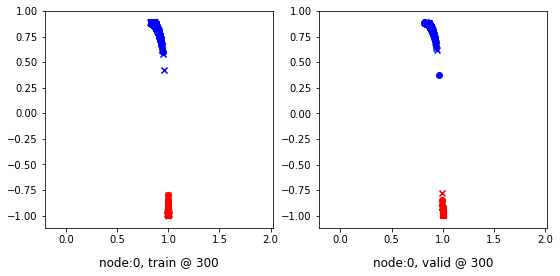

300 	 1 	 0.28000402 	 0.19972146 	 0.53881741 	 0.45795351 	 0.95196700 	 0.95137924


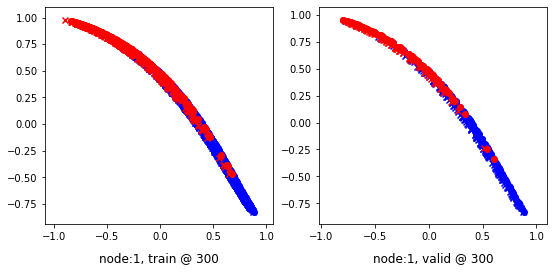

320 	 0 	 -0.18415459 	 -0.20628001 	 0.00017824 	 0.00019275 	 0.87748140 	 0.89961994


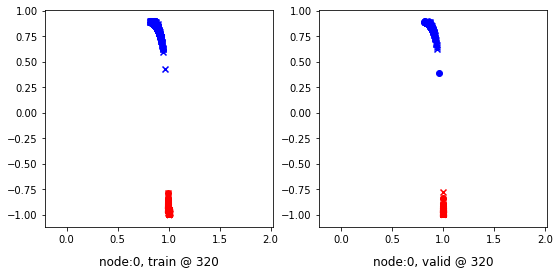

320 	 1 	 0.22105402 	 0.19889942 	 0.48957342 	 0.45784101 	 0.96174806 	 0.95208877


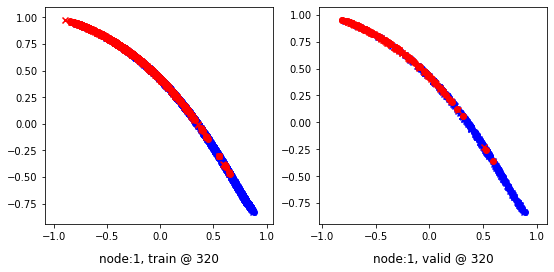

340 	 0 	 -0.20085348 	 -0.20610419 	 0.00016516 	 0.00018140 	 0.89416826 	 0.89943278


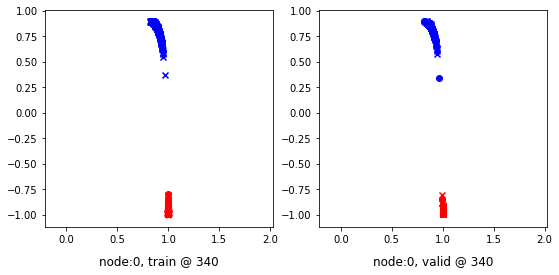

340 	 1 	 0.23109558 	 0.19846138 	 0.48986334 	 0.45893779 	 0.95182586 	 0.95362359


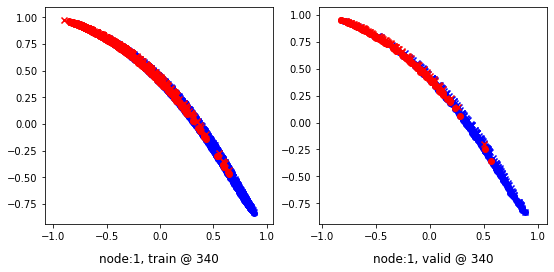

360 	 0 	 -0.17052934 	 -0.20599264 	 0.00013972 	 0.00015193 	 0.86381739 	 0.89929175


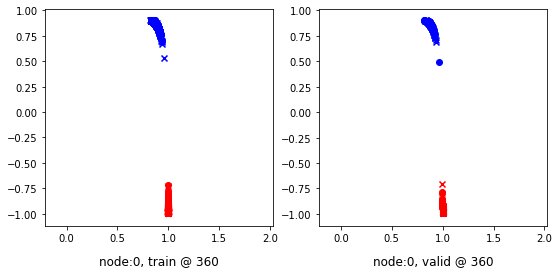

360 	 1 	 0.24342686 	 0.19882384 	 0.49849105 	 0.45798734 	 0.94824415 	 0.95231068


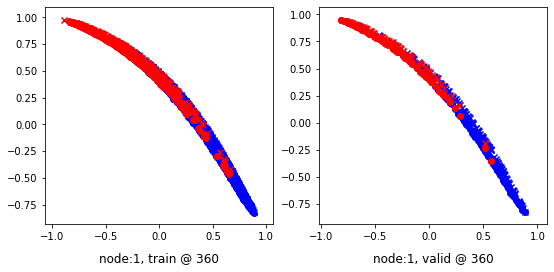

380 	 0 	 -0.21462399 	 -0.20605910 	 0.00014087 	 0.00014704 	 0.90791333 	 0.89935333


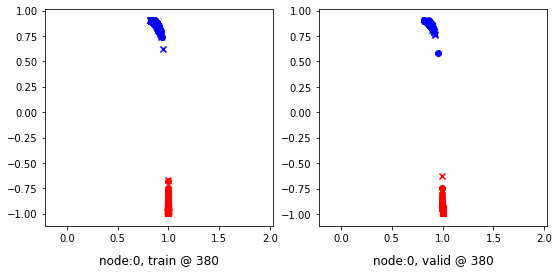

380 	 1 	 0.18914893 	 0.19919592 	 0.44070286 	 0.45717907 	 0.94500089 	 0.95113033


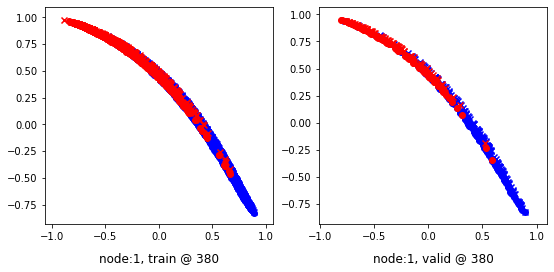

400 	 0 	 -0.18706332 	 -0.20612256 	 0.00012998 	 0.00014229 	 0.88034111 	 0.89941204


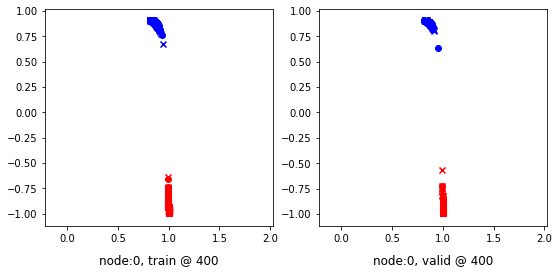

400 	 1 	 0.22341639 	 0.19769859 	 0.47432837 	 0.45778054 	 0.94488263 	 0.95322913


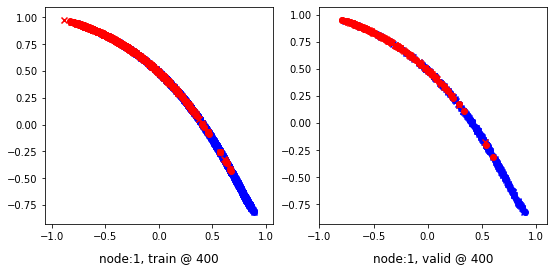

420 	 0 	 -0.20797920 	 -0.20619436 	 0.00009622 	 0.00011174 	 0.90122348 	 0.89945328


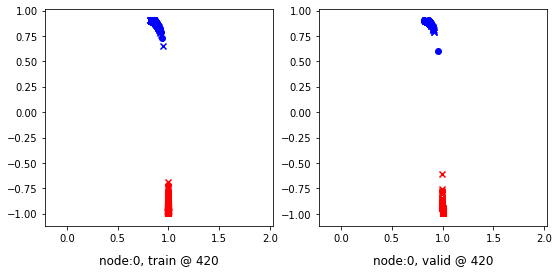

420 	 1 	 0.27367699 	 0.19714555 	 0.53001416 	 0.45853165 	 0.94947881 	 0.95453328


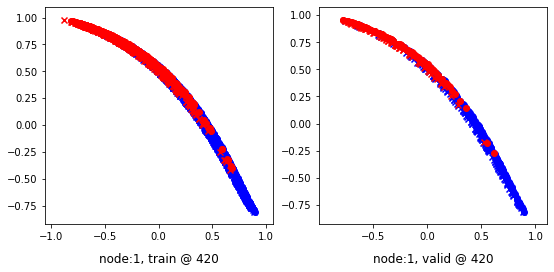

440 	 0 	 -0.19722982 	 -0.20619786 	 0.00008437 	 0.00009495 	 0.89046222 	 0.89943999


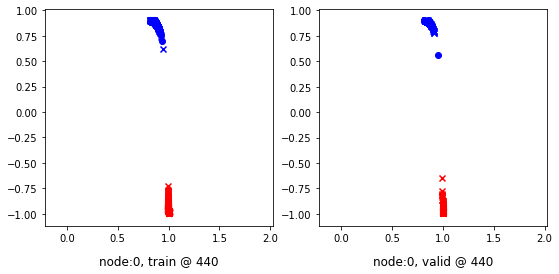

440 	 1 	 0.25620466 	 0.19834358 	 0.50071806 	 0.45749915 	 0.93827730 	 0.95230275


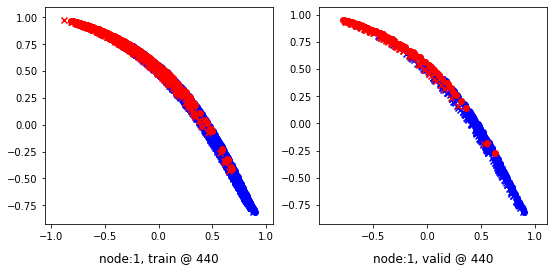

460 	 0 	 -0.21817864 	 -0.20623884 	 0.00007788 	 0.00008348 	 0.91140491 	 0.89946949


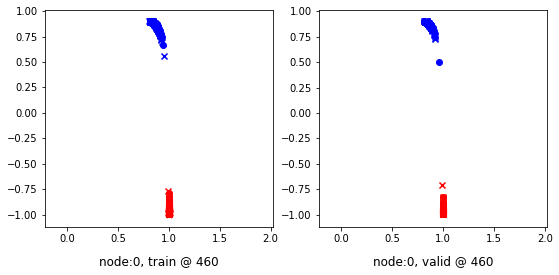

460 	 1 	 0.26256090 	 0.20073020 	 0.51682943 	 0.45836908 	 0.95269614 	 0.95078605


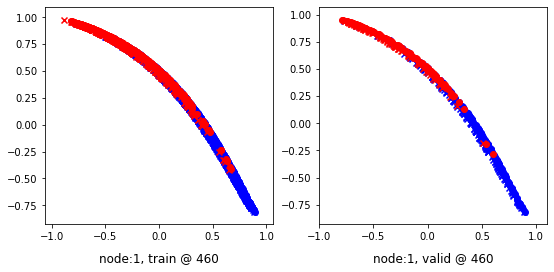

480 	 0 	 -0.20416495 	 -0.20616971 	 0.00006932 	 0.00007620 	 0.89738554 	 0.89939308


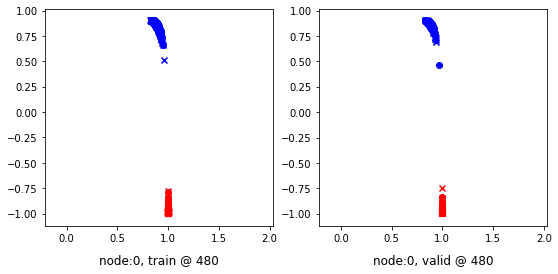

480 	 1 	 0.18723983 	 0.19711149 	 0.45121410 	 0.45652092 	 0.95715123 	 0.95255661


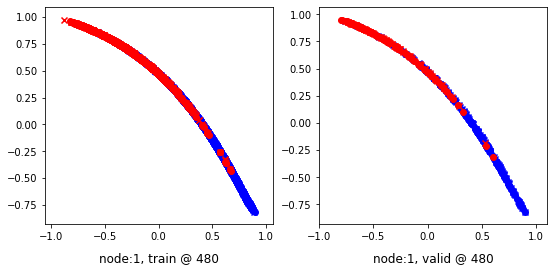

500 	 0 	 -0.19977874 	 -0.20640552 	 0.00006258 	 0.00006873 	 0.89299333 	 0.89962143


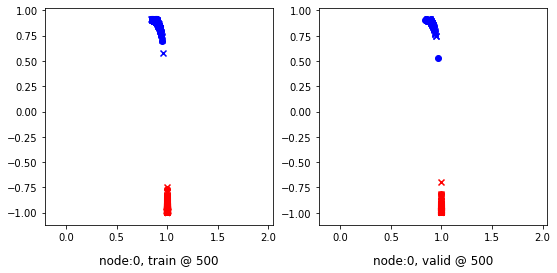

500 	 1 	 0.29623473 	 0.19760439 	 0.55540711 	 0.45807543 	 0.95240593 	 0.95361823


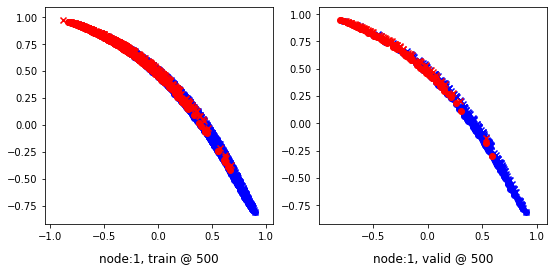

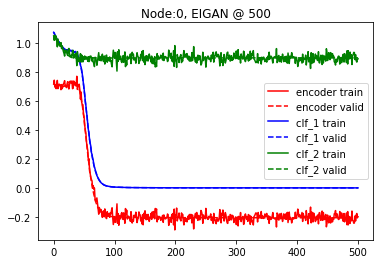

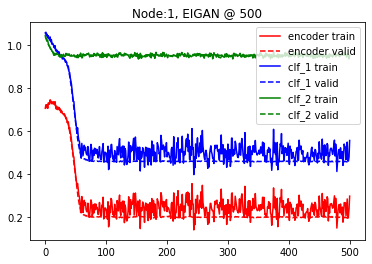

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.0 and delta=5
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.64666939 	 0.66303134 	 1.03327954 	 1.03127563 	 1.07995403 	 1.06139147


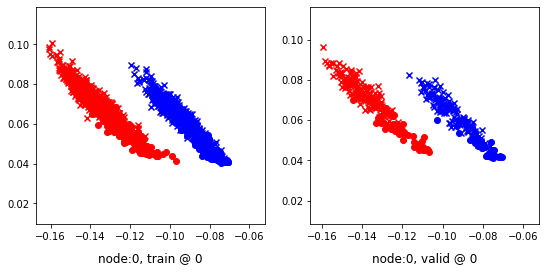

0 	 1 	 0.71990824 	 0.72119427 	 1.03741622 	 1.03455901 	 1.01082027 	 1.00651193


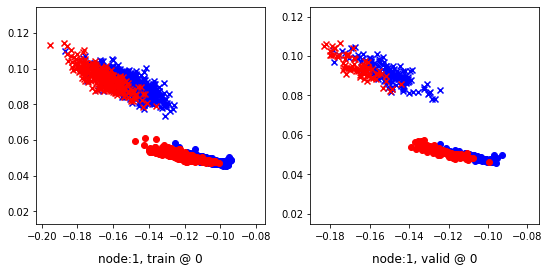

20 	 0 	 0.71348977 	 0.72550434 	 0.95688796 	 0.95610535 	 0.93672729 	 0.92374820


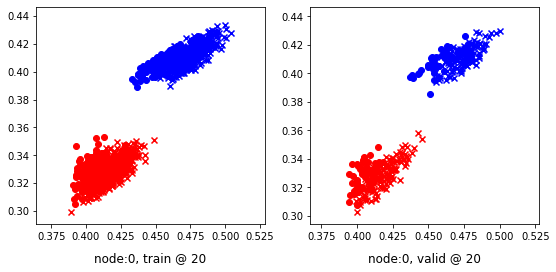

20 	 1 	 0.68581790 	 0.68758804 	 0.94215673 	 0.94568402 	 0.94952697 	 0.95124316


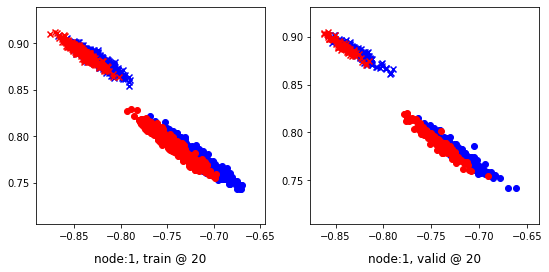

40 	 0 	 0.67469352 	 0.67235887 	 0.88445359 	 0.88336921 	 0.90473115 	 0.90415752


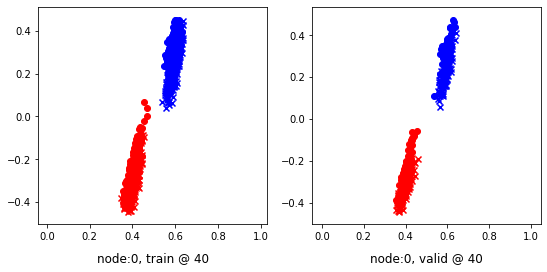

40 	 1 	 0.69100296 	 0.68723303 	 0.94499487 	 0.94515234 	 0.94717968 	 0.95106649


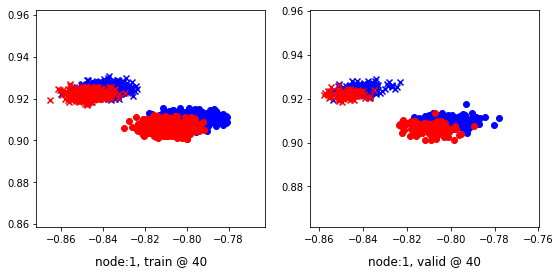

60 	 0 	 0.00215700 	 0.01331456 	 0.21927038 	 0.21868785 	 0.91146606 	 0.89852047


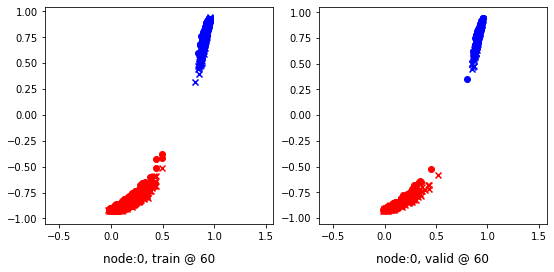

60 	 1 	 0.69326866 	 0.68291944 	 0.95406598 	 0.94177961 	 0.95406437 	 0.95200735


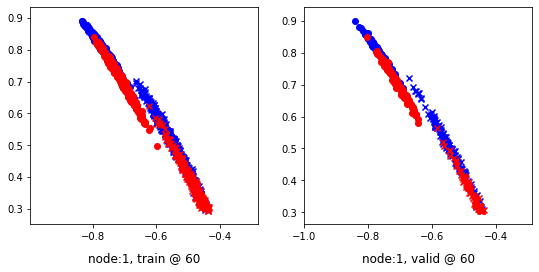

80 	 0 	 -0.13768670 	 -0.17121507 	 0.03483706 	 0.03418241 	 0.86570376 	 0.89854467


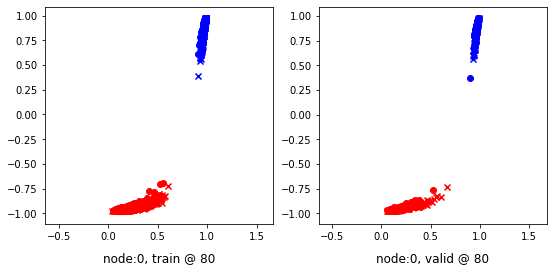

80 	 1 	 0.53635561 	 0.52569306 	 0.79941058 	 0.78403538 	 0.95886487 	 0.95148951


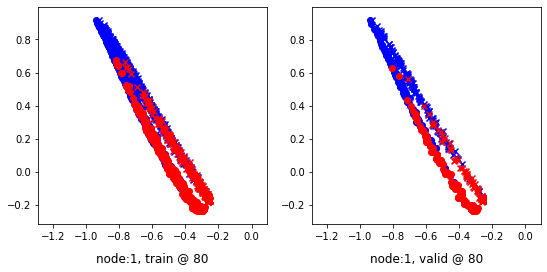

100 	 0 	 -0.24717459 	 -0.19297083 	 0.01201022 	 0.01238762 	 0.95237416 	 0.89850563


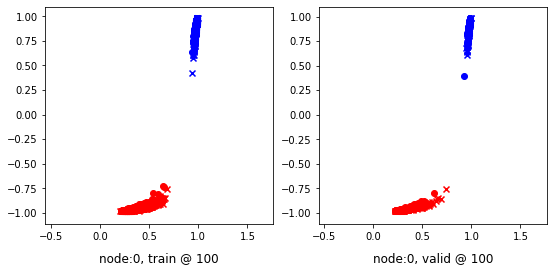

100 	 1 	 0.22987154 	 0.20439368 	 0.49938706 	 0.46468079 	 0.96288574 	 0.95343429


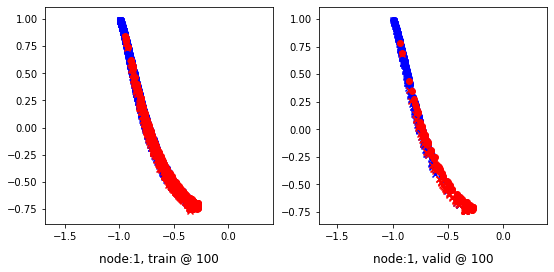

120 	 0 	 -0.18164560 	 -0.19983231 	 0.00636143 	 0.00659586 	 0.88117510 	 0.89957535


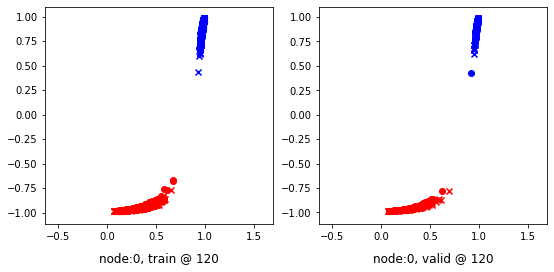

120 	 1 	 0.28420442 	 0.20266610 	 0.53643000 	 0.45803362 	 0.94660527 	 0.94851470


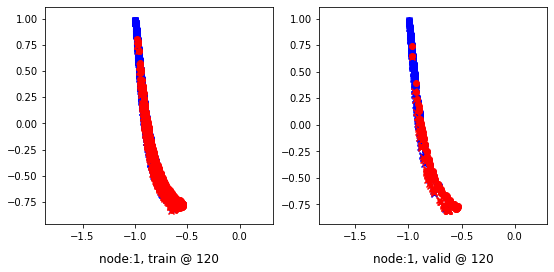

140 	 0 	 -0.19324480 	 -0.20133193 	 0.00379560 	 0.00386726 	 0.89022851 	 0.89834636


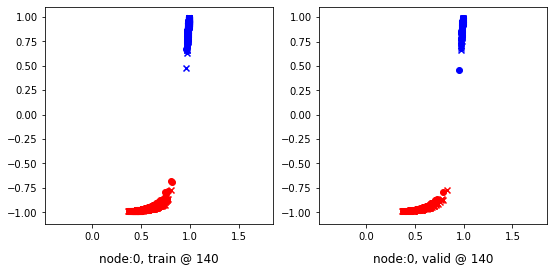

140 	 1 	 0.28254652 	 0.19785136 	 0.52855676 	 0.45810544 	 0.94142717 	 0.95340127


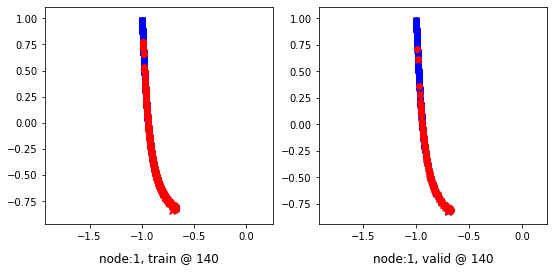

160 	 0 	 -0.16818832 	 -0.20357288 	 0.00240461 	 0.00251900 	 0.86374289 	 0.89923906


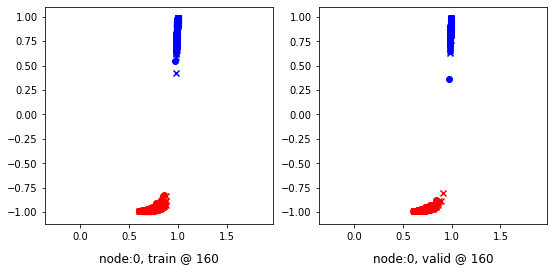

160 	 1 	 0.22104558 	 0.19695663 	 0.48126611 	 0.45964354 	 0.95420855 	 0.95583409


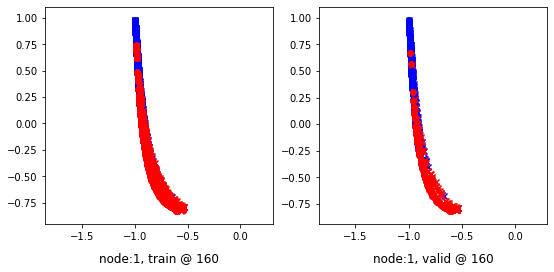

180 	 0 	 -0.19900382 	 -0.20420955 	 0.00172903 	 0.00180408 	 0.89388168 	 0.89916080


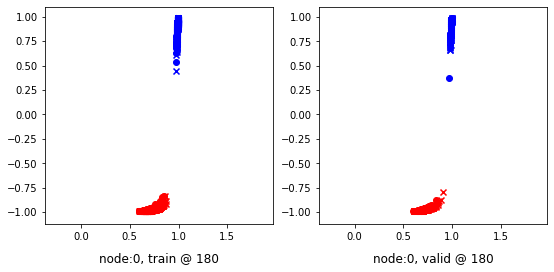

180 	 1 	 0.28225112 	 0.19942763 	 0.53657800 	 0.45883778 	 0.94770330 	 0.95255733


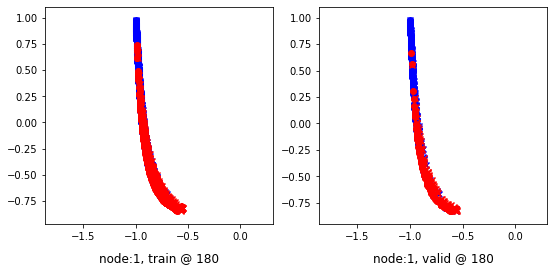

200 	 0 	 -0.21475244 	 -0.20477998 	 0.00131844 	 0.00136059 	 0.90922230 	 0.89928776


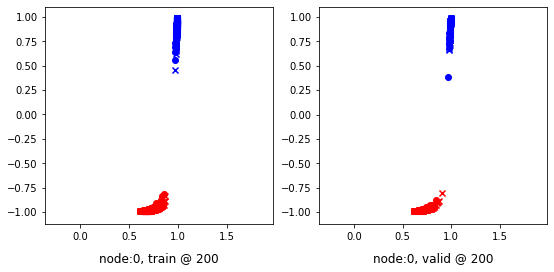

200 	 1 	 0.19775847 	 0.20048299 	 0.45584452 	 0.46038398 	 0.95126432 	 0.95304817


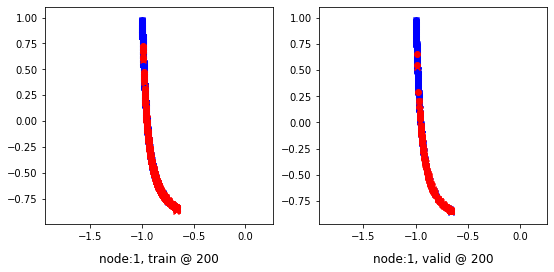

220 	 0 	 -0.22291251 	 -0.20523630 	 0.00106366 	 0.00109168 	 0.91712666 	 0.89947516


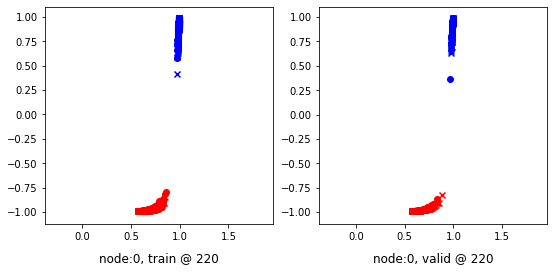

220 	 1 	 0.23098403 	 0.19635302 	 0.48694250 	 0.45634562 	 0.94933796 	 0.95313978


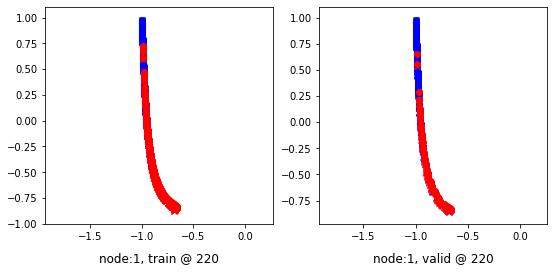

240 	 0 	 -0.23418999 	 -0.20491679 	 0.00077220 	 0.00085210 	 0.92813587 	 0.89891607


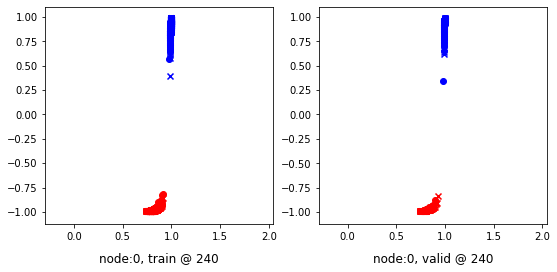

240 	 1 	 0.25035769 	 0.19748771 	 0.50426698 	 0.45741898 	 0.94729125 	 0.95307845


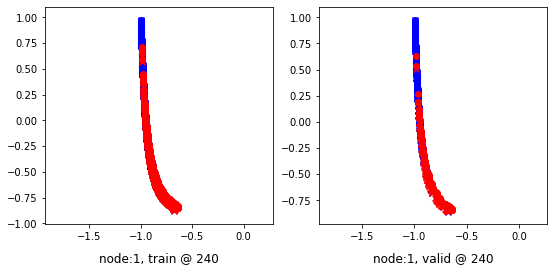

260 	 0 	 -0.18062113 	 -0.20572884 	 0.00065104 	 0.00067847 	 0.87442559 	 0.89955449


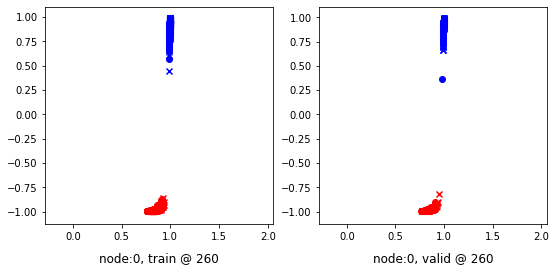

260 	 1 	 0.22083896 	 0.19841906 	 0.47430813 	 0.45792601 	 0.94782424 	 0.95265412


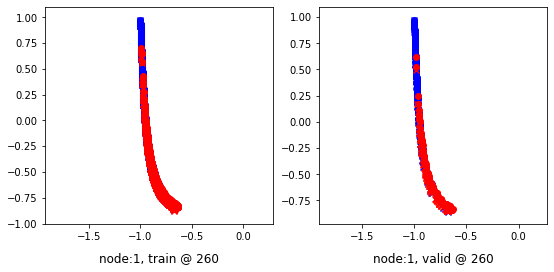

280 	 0 	 -0.28002244 	 -0.20566738 	 0.00051886 	 0.00055408 	 0.97368932 	 0.89936864


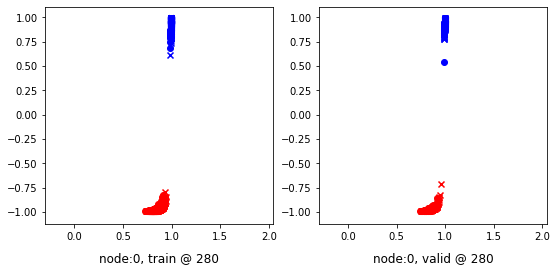

280 	 1 	 0.20304522 	 0.19679686 	 0.45994467 	 0.45596907 	 0.95015973 	 0.95231938


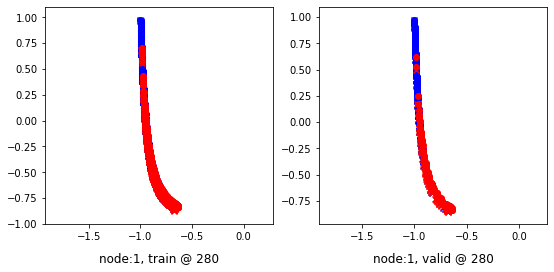

300 	 0 	 -0.24578376 	 -0.20548794 	 0.00050131 	 0.00057181 	 0.93944073 	 0.89920694


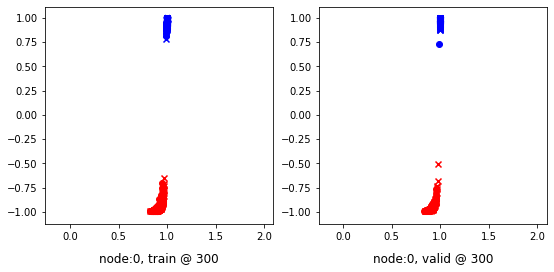

300 	 1 	 0.29685551 	 0.19571328 	 0.55076677 	 0.45491076 	 0.94894689 	 0.95234466


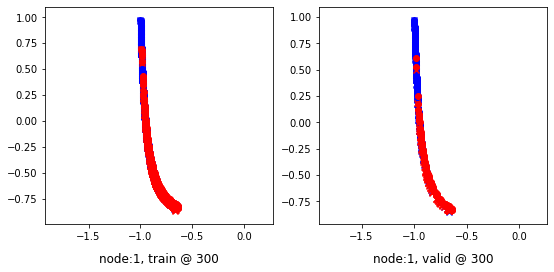

320 	 0 	 -0.22862200 	 -0.20536147 	 0.00048924 	 0.00087334 	 0.92226088 	 0.89938200


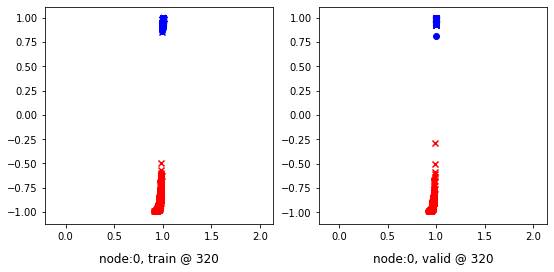

320 	 1 	 0.23090339 	 0.19548735 	 0.48129371 	 0.45563903 	 0.94367748 	 0.95329887


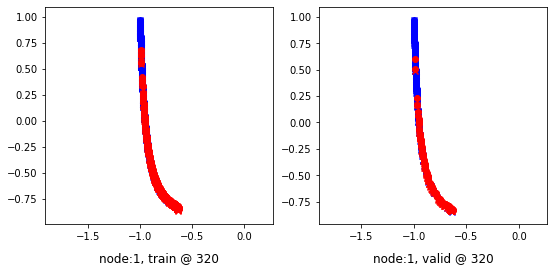

340 	 0 	 -0.16306482 	 -0.20548704 	 0.00037716 	 0.00076130 	 0.85659027 	 0.89939553


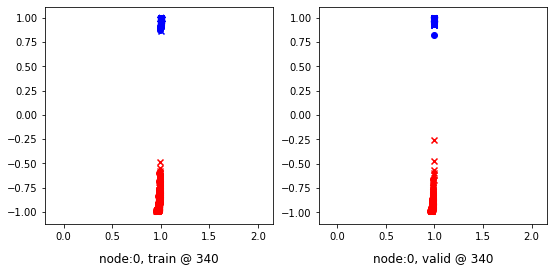

340 	 1 	 0.19869992 	 0.19716281 	 0.44811490 	 0.45861447 	 0.94318068 	 0.95459884


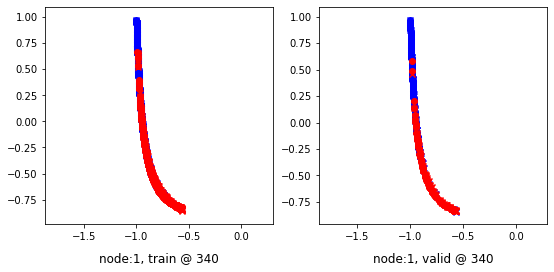

360 	 0 	 -0.14023358 	 -0.20574175 	 0.00029749 	 0.00045772 	 0.83367848 	 0.89934665


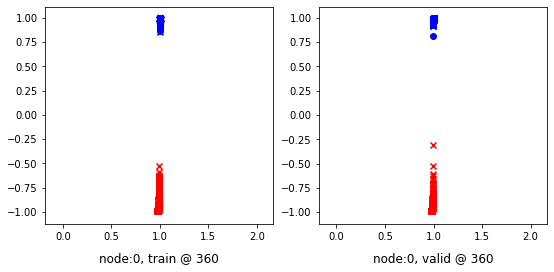

360 	 1 	 0.22798067 	 0.19795647 	 0.48582444 	 0.45777372 	 0.95093054 	 0.95296443


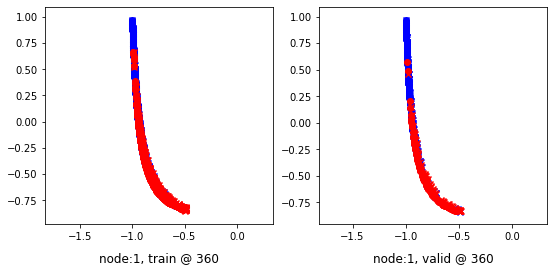

380 	 0 	 -0.20353577 	 -0.20588405 	 0.00023024 	 0.00029914 	 0.89691418 	 0.89933038


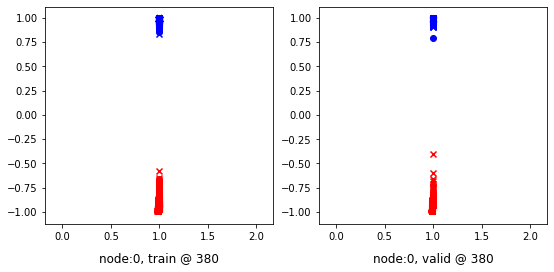

380 	 1 	 0.19935057 	 0.19734114 	 0.46019620 	 0.45646477 	 0.95405275 	 0.95227081


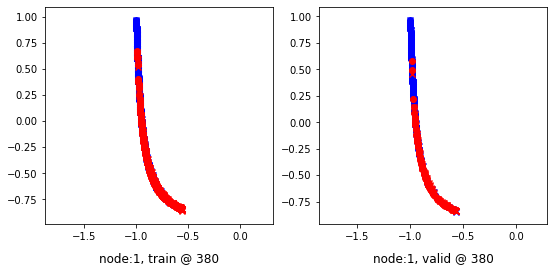

400 	 0 	 -0.21166100 	 -0.20597962 	 0.00019861 	 0.00022242 	 0.90500760 	 0.89934921


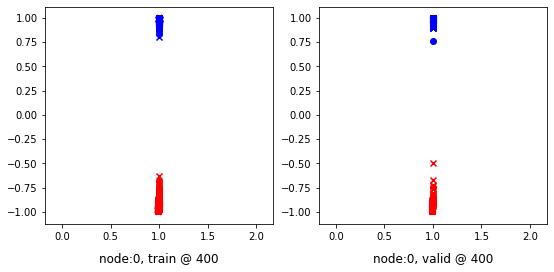

400 	 1 	 0.22804600 	 0.19458035 	 0.48341739 	 0.45422974 	 0.94826823 	 0.95279658


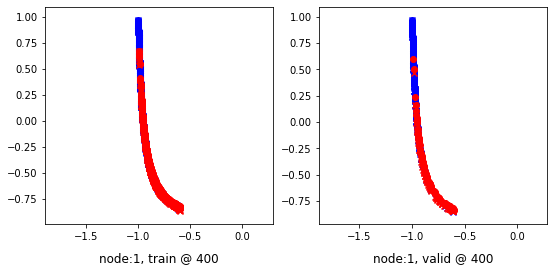

420 	 0 	 -0.17309272 	 -0.20603713 	 0.00017264 	 0.00018254 	 0.86641330 	 0.89936686


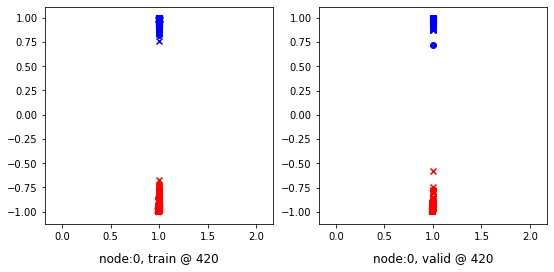

420 	 1 	 0.34379047 	 0.19524232 	 0.58838308 	 0.45485082 	 0.93994021 	 0.95275569


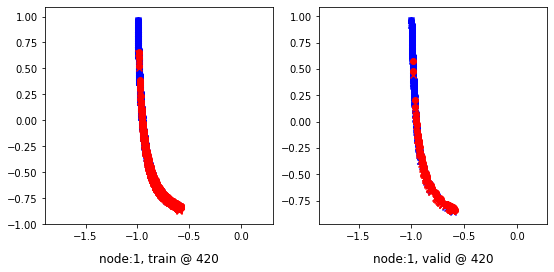

440 	 0 	 -0.19006665 	 -0.20609552 	 0.00014662 	 0.00015831 	 0.88336188 	 0.89940101


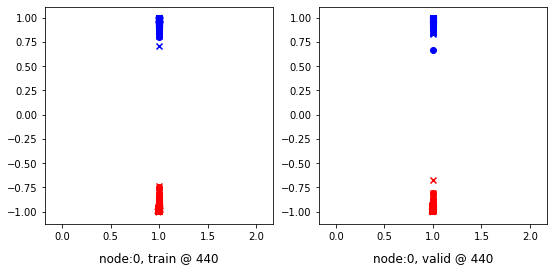

440 	 1 	 0.26668650 	 0.19685304 	 0.50414765 	 0.45639271 	 0.93062198 	 0.95268685


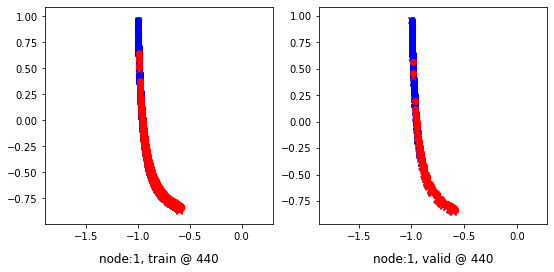

460 	 0 	 -0.21496499 	 -0.20622107 	 0.00014000 	 0.00014982 	 0.90825409 	 0.89951807


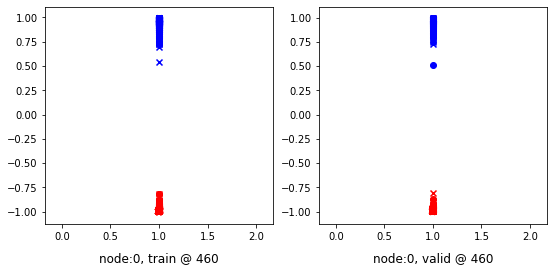

460 	 1 	 0.24675685 	 0.19409350 	 0.50675941 	 0.45389983 	 0.95309722 	 0.95295352


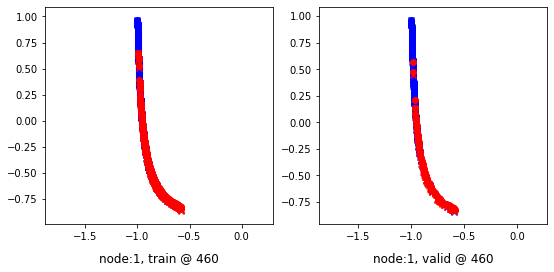

480 	 0 	 -0.15665343 	 -0.20631889 	 0.00014501 	 0.00026759 	 0.84994674 	 0.89973366


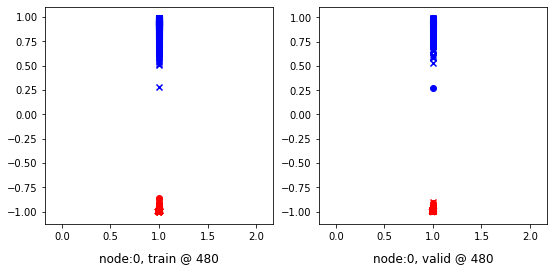

480 	 1 	 0.21003816 	 0.19334289 	 0.46688893 	 0.45415285 	 0.95051241 	 0.95395714


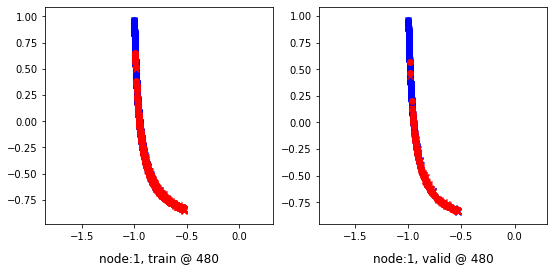

500 	 0 	 -0.15323813 	 -0.20632041 	 0.00012471 	 0.00019371 	 0.84651053 	 0.89966130


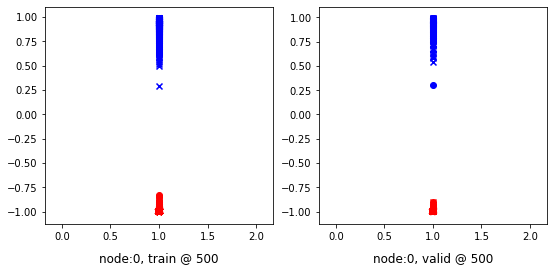

500 	 1 	 0.18197203 	 0.19464424 	 0.44457650 	 0.45503166 	 0.95574665 	 0.95353460


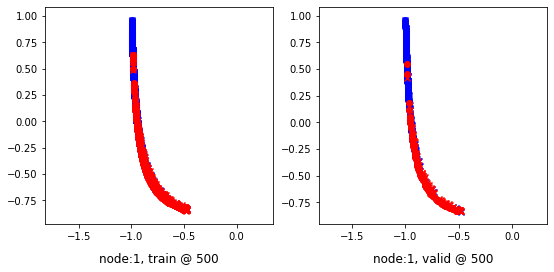

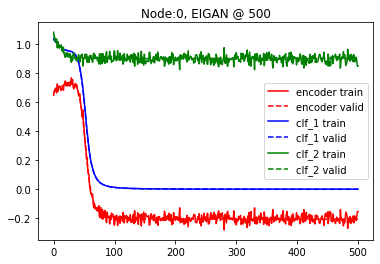

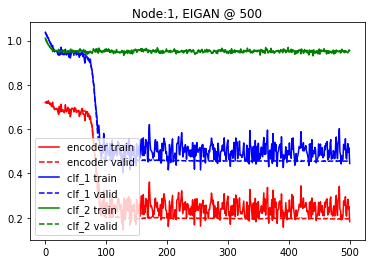

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.0 and delta=7
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.66135693 	 0.66050553 	 1.04764891 	 1.04418421 	 1.07953393 	 1.07682586


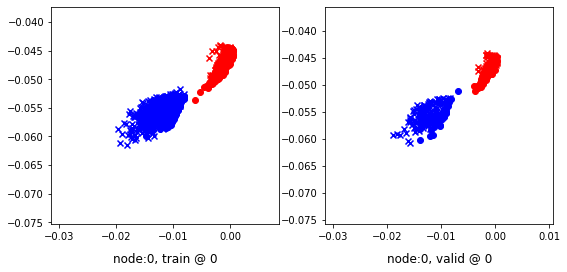

0 	 1 	 0.65647340 	 0.66072917 	 1.00736856 	 1.00587618 	 1.04417241 	 1.03829420


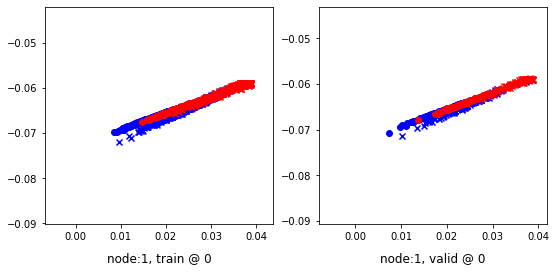

20 	 0 	 0.68924278 	 0.66950756 	 0.96453345 	 0.96333349 	 0.96860516 	 0.98697311


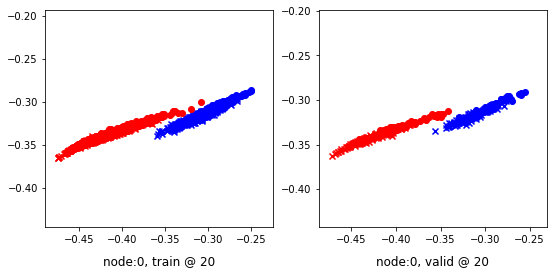

20 	 1 	 0.70055413 	 0.68110138 	 0.96127260 	 0.94619352 	 0.95401794 	 0.95823932


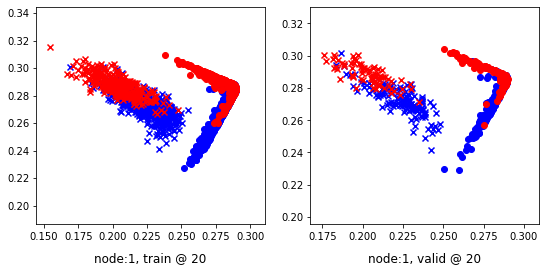

40 	 0 	 0.55652082 	 0.55251479 	 0.77151114 	 0.77089632 	 0.91080320 	 0.91152871


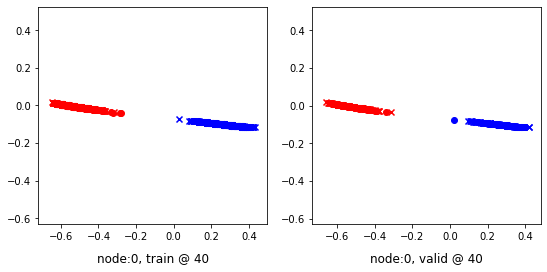

40 	 1 	 0.65369570 	 0.65907300 	 0.91247785 	 0.91563666 	 0.95282495 	 0.94971085


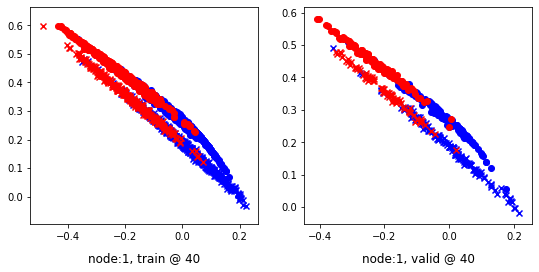

60 	 0 	 -0.03180623 	 -0.07255134 	 0.13746391 	 0.13271019 	 0.86333025 	 0.89840871


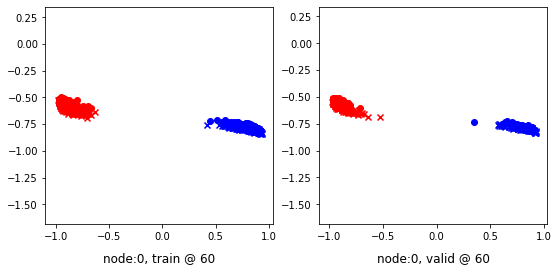

60 	 1 	 0.28685153 	 0.22725505 	 0.54372823 	 0.48576218 	 0.94989145 	 0.95165431


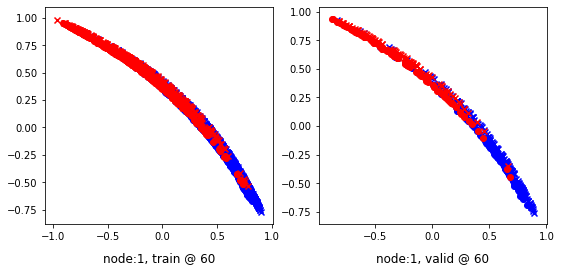

80 	 0 	 -0.21597651 	 -0.18948227 	 0.01562960 	 0.01572186 	 0.92480153 	 0.89835131


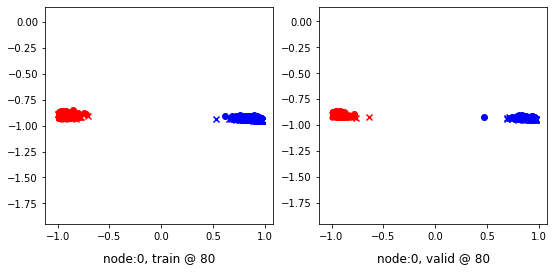

80 	 1 	 0.23307255 	 0.20306939 	 0.49087372 	 0.45634824 	 0.95239669 	 0.94642603


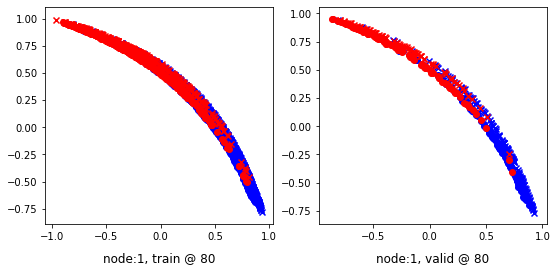

100 	 0 	 -0.17078680 	 -0.20055175 	 0.00514766 	 0.00529868 	 0.86909395 	 0.89899760


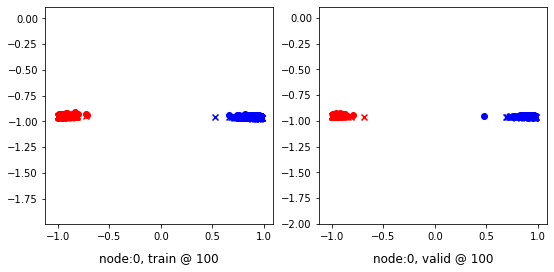

100 	 1 	 0.21389118 	 0.19837642 	 0.48009500 	 0.46025980 	 0.95977050 	 0.95503056


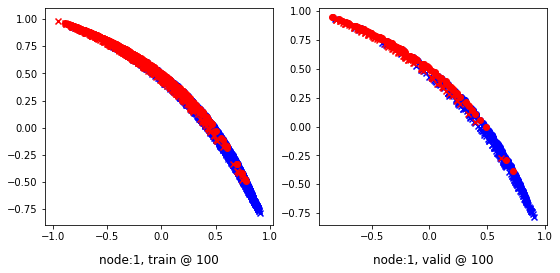

120 	 0 	 -0.21931165 	 -0.20358901 	 0.00257270 	 0.00283577 	 0.91503769 	 0.89957196


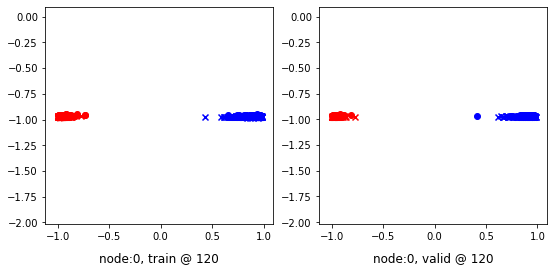

120 	 1 	 0.25301397 	 0.19964373 	 0.51791096 	 0.45850110 	 0.95874578 	 0.95200455


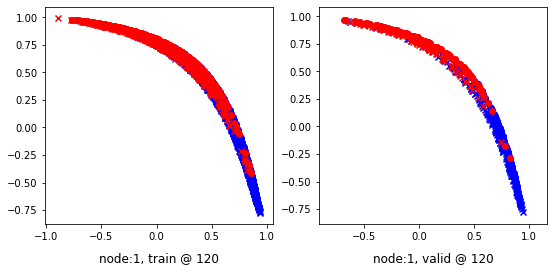

140 	 0 	 -0.17565155 	 -0.20468904 	 0.00165885 	 0.00185077 	 0.87046206 	 0.89968699


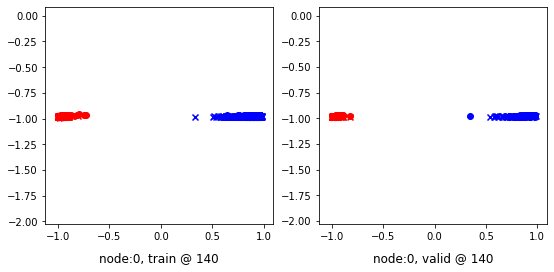

140 	 1 	 0.24267021 	 0.19991025 	 0.49625599 	 0.45850769 	 0.94845045 	 0.95174462


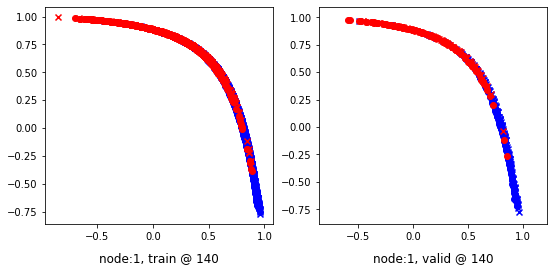

160 	 0 	 -0.22070621 	 -0.20495963 	 0.00111654 	 0.00124884 	 0.91497201 	 0.89935565


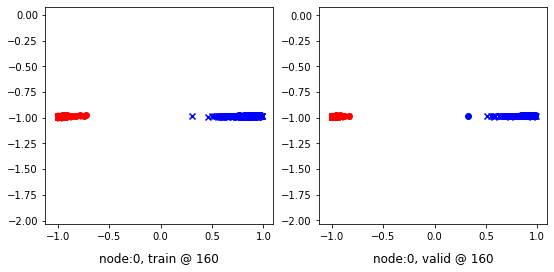

160 	 1 	 0.22789446 	 0.20014590 	 0.47502577 	 0.45796561 	 0.94039685 	 0.95096689


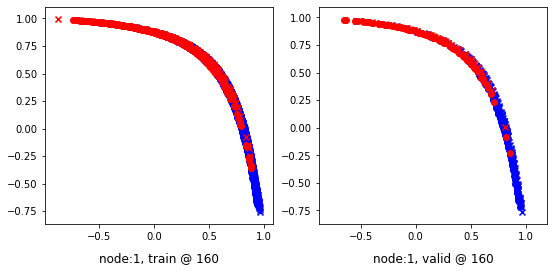

180 	 0 	 -0.20024675 	 -0.20507073 	 0.00070952 	 0.00082558 	 0.89410543 	 0.89904350


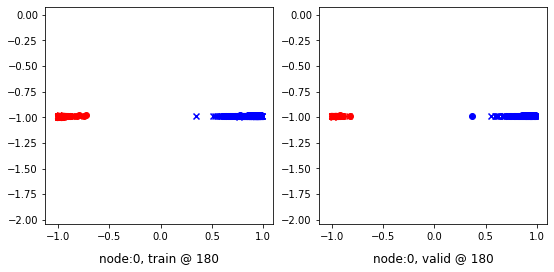

180 	 1 	 0.23331881 	 0.19935283 	 0.48199567 	 0.45937660 	 0.94302267 	 0.95317096


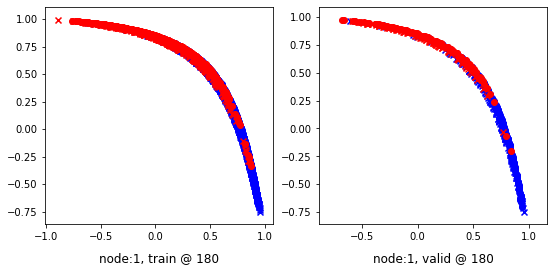

200 	 0 	 -0.22784117 	 -0.20519090 	 0.00050650 	 0.00056296 	 0.92149746 	 0.89890105


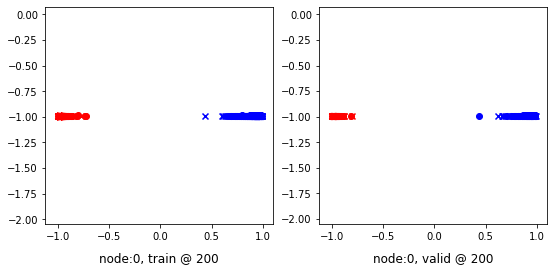

200 	 1 	 0.18521419 	 0.19928053 	 0.43206009 	 0.45742086 	 0.94026637 	 0.95128751


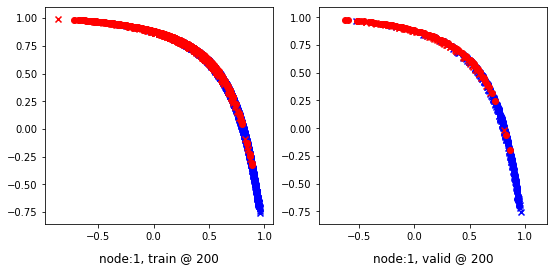

220 	 0 	 -0.18351173 	 -0.20542292 	 0.00039220 	 0.00041057 	 0.87705487 	 0.89898068


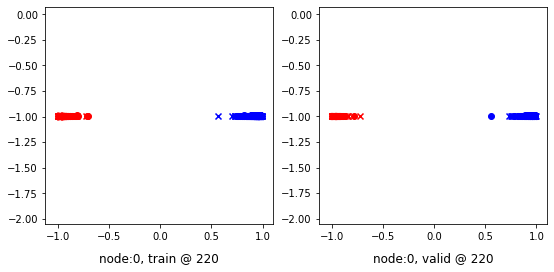

220 	 1 	 0.22770998 	 0.20017794 	 0.48304081 	 0.45838282 	 0.95196390 	 0.95135206


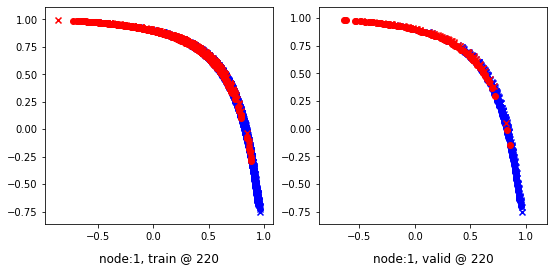

240 	 0 	 -0.21761219 	 -0.20571209 	 0.00031511 	 0.00033604 	 0.91107756 	 0.89919531


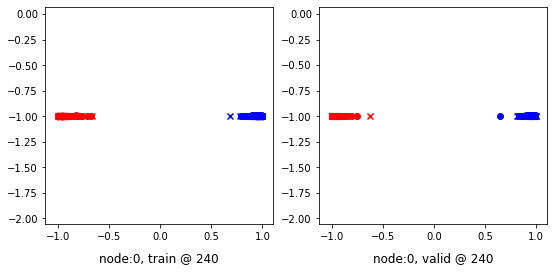

240 	 1 	 0.31837201 	 0.19673166 	 0.57601172 	 0.45591256 	 0.95140642 	 0.95232809


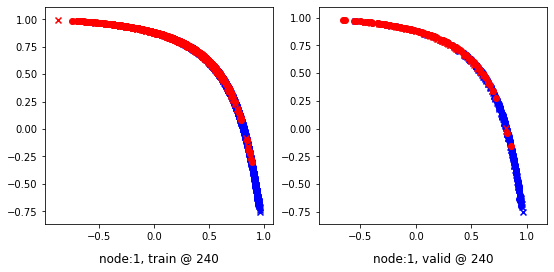

260 	 0 	 -0.24889207 	 -0.20592780 	 0.00026700 	 0.00035553 	 0.94230866 	 0.89943051


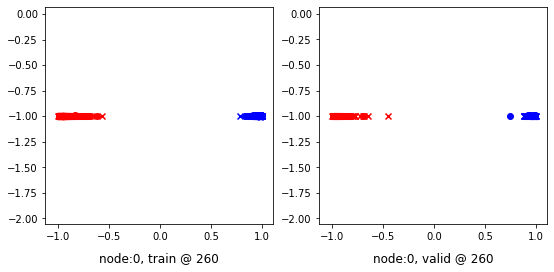

260 	 1 	 0.24943352 	 0.19996062 	 0.50103104 	 0.45902082 	 0.94786781 	 0.95220739


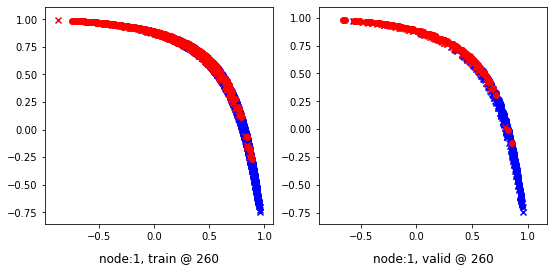

280 	 0 	 -0.17299223 	 -0.20593442 	 0.00020654 	 0.00024556 	 0.86634934 	 0.89932716


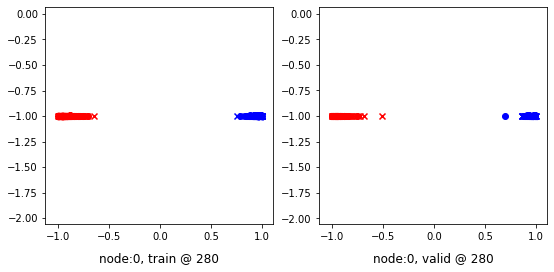

280 	 1 	 0.21383509 	 0.19935468 	 0.47325602 	 0.45829442 	 0.95394397 	 0.95208693


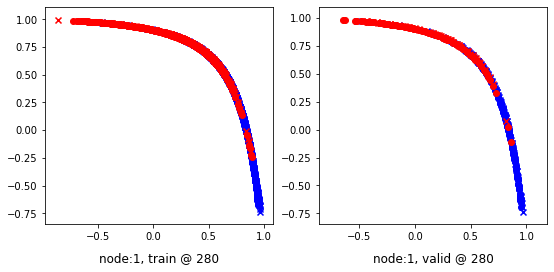

300 	 0 	 -0.17315932 	 -0.20602369 	 0.00017056 	 0.00018460 	 0.86647719 	 0.89935547


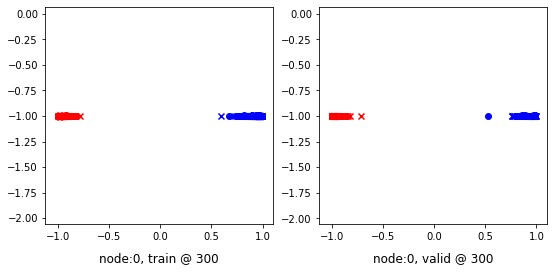

300 	 1 	 0.23137000 	 0.19762760 	 0.49131095 	 0.45620137 	 0.95415652 	 0.95172095


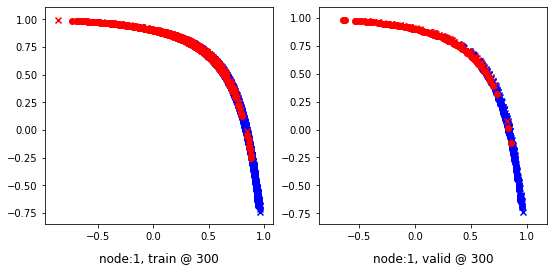

320 	 0 	 -0.19999413 	 -0.20605311 	 0.00014510 	 0.00016013 	 0.89328665 	 0.89936042


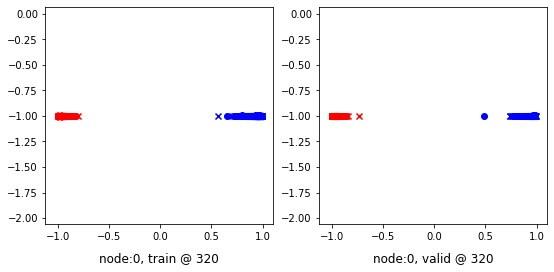

320 	 1 	 0.23777223 	 0.19589481 	 0.49358273 	 0.45536748 	 0.94896317 	 0.95261985


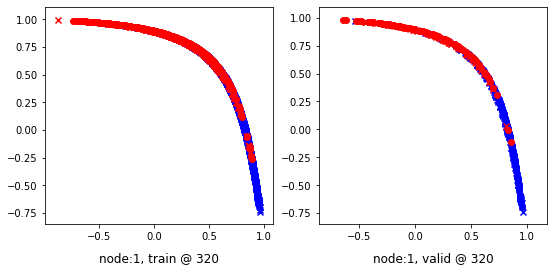

340 	 0 	 -0.23528589 	 -0.20608395 	 0.00012433 	 0.00013995 	 0.92855763 	 0.89937109


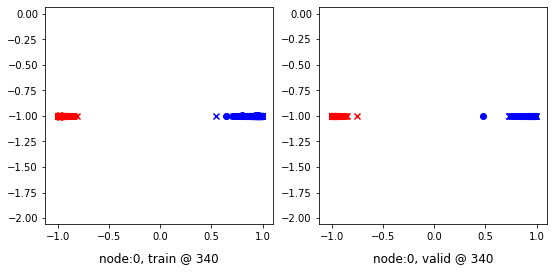

340 	 1 	 0.18951136 	 0.19759339 	 0.44859681 	 0.45669651 	 0.95276189 	 0.95225030


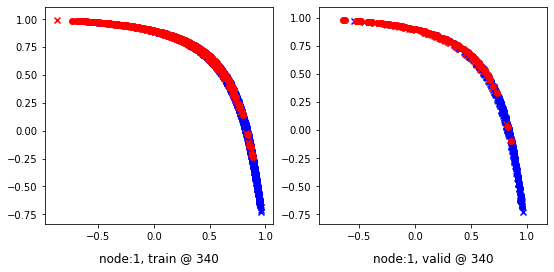

360 	 0 	 -0.19447958 	 -0.20610557 	 0.00010956 	 0.00012287 	 0.88773644 	 0.89937562


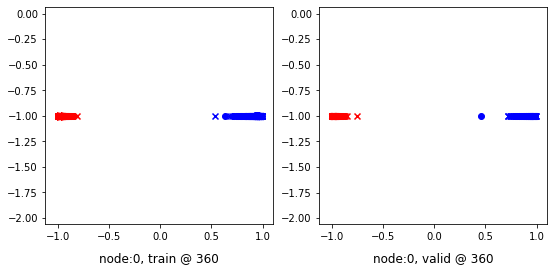

360 	 1 	 0.27865875 	 0.19643417 	 0.53299832 	 0.45547375 	 0.94746482 	 0.95218676


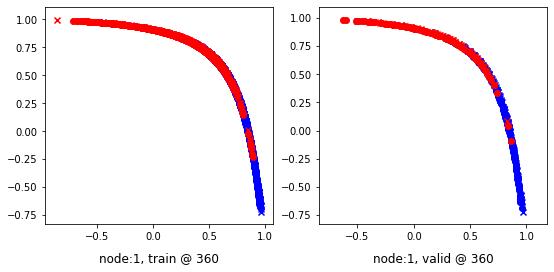

380 	 0 	 -0.22919397 	 -0.20614552 	 0.00009646 	 0.00010919 	 0.92243779 	 0.89940190


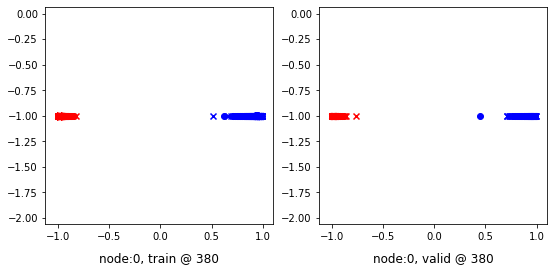

380 	 1 	 0.27124780 	 0.19720650 	 0.52416670 	 0.45616657 	 0.94602752 	 0.95210725


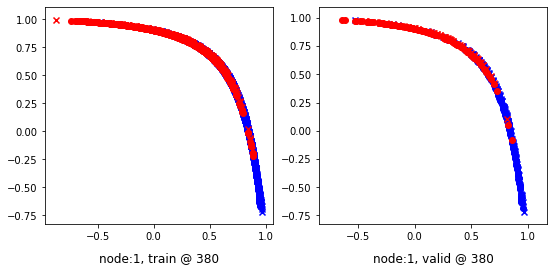

400 	 0 	 -0.20667261 	 -0.20613705 	 0.00008453 	 0.00009664 	 0.89990449 	 0.89938086


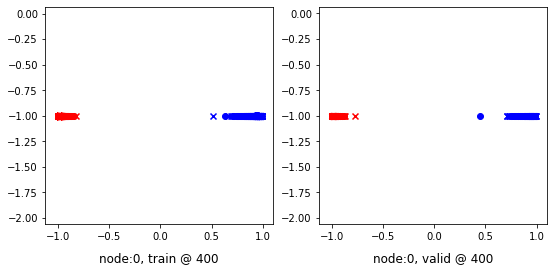

400 	 1 	 0.22842619 	 0.19635239 	 0.48127773 	 0.45611420 	 0.94627774 	 0.95290899


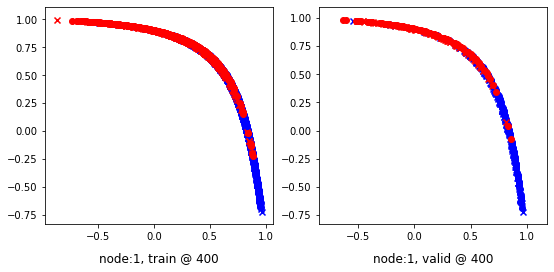

420 	 0 	 -0.19065833 	 -0.20616490 	 0.00007355 	 0.00008523 	 0.88387918 	 0.89939731


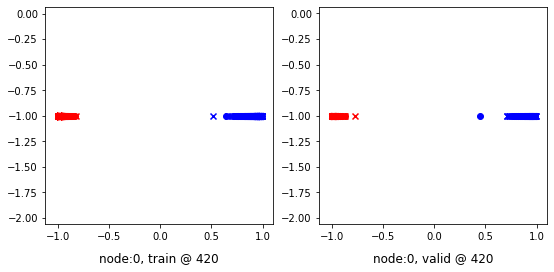

420 	 1 	 0.19353661 	 0.19773570 	 0.45882896 	 0.45709249 	 0.95845217 	 0.95250398


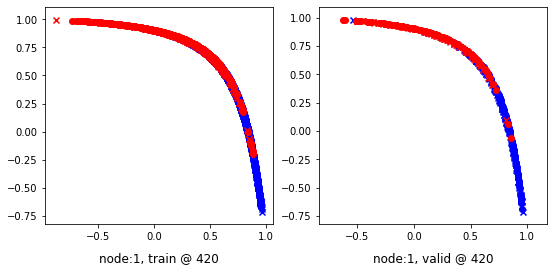

440 	 0 	 -0.18649216 	 -0.20617220 	 0.00006764 	 0.00007597 	 0.87970704 	 0.89939535


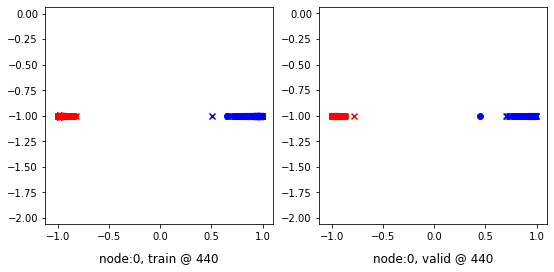

440 	 1 	 0.23087463 	 0.19671580 	 0.48509210 	 0.45583639 	 0.94737053 	 0.95226777


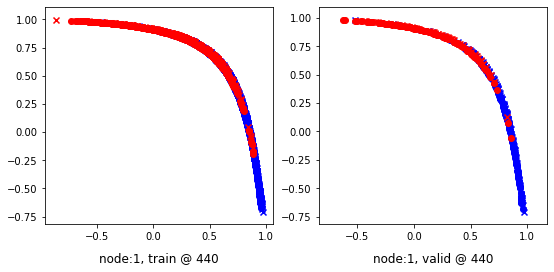

460 	 0 	 -0.23550312 	 -0.20619237 	 0.00006027 	 0.00006711 	 0.92871070 	 0.89940667


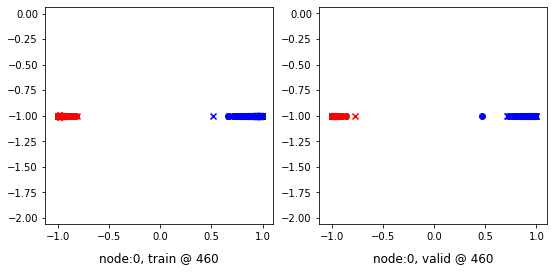

460 	 1 	 0.23787260 	 0.19680393 	 0.49963629 	 0.45619869 	 0.95534343 	 0.95254195


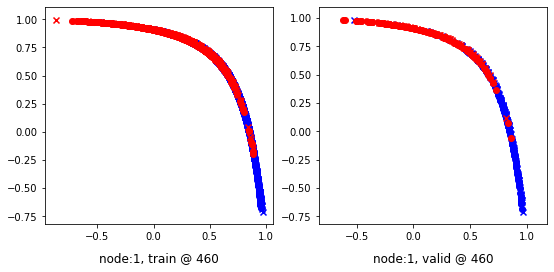

480 	 0 	 -0.21583164 	 -0.20619598 	 0.00005203 	 0.00005869 	 0.90903091 	 0.89940184


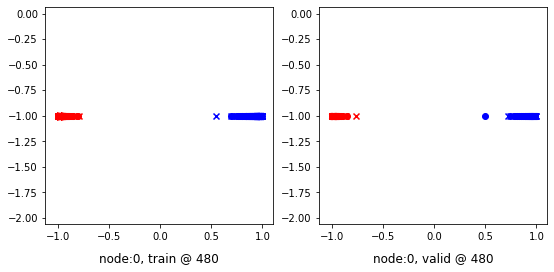

480 	 1 	 0.20703831 	 0.19698697 	 0.45928079 	 0.45666140 	 0.94554067 	 0.95282161


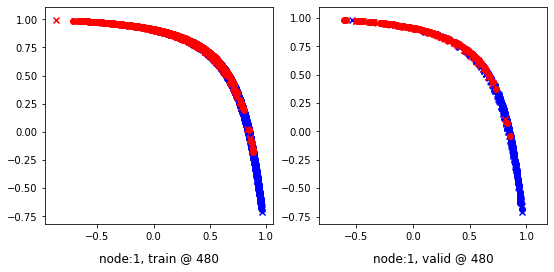

500 	 0 	 -0.19446029 	 -0.20620738 	 0.00004761 	 0.00005217 	 0.88765520 	 0.89940673


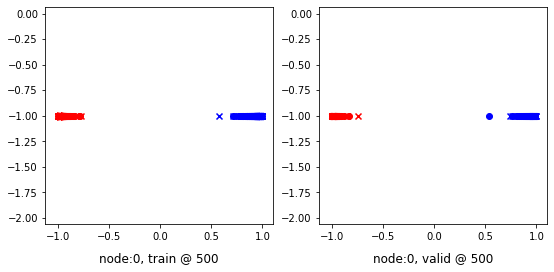

500 	 1 	 0.25597519 	 0.19948488 	 0.50466657 	 0.45895654 	 0.94311351 	 0.95261884


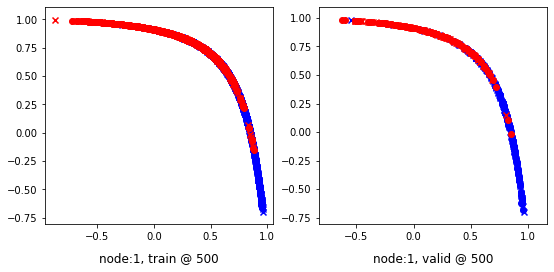

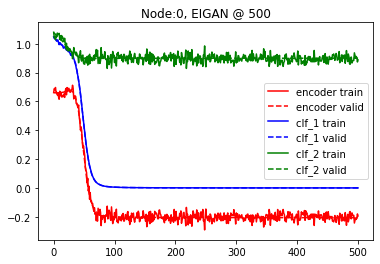

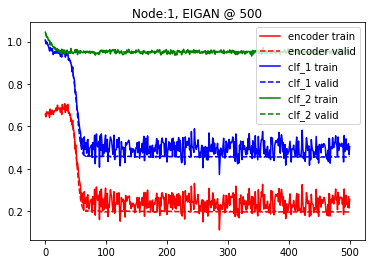

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.0 and delta=9
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.69100285 	 0.70062971 	 1.04657304 	 1.04487336 	 1.04888105 	 1.03739083


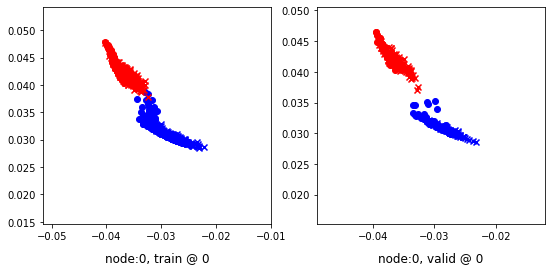

0 	 1 	 0.76009750 	 0.74454355 	 1.08647108 	 1.07067692 	 1.01962483 	 1.01928055


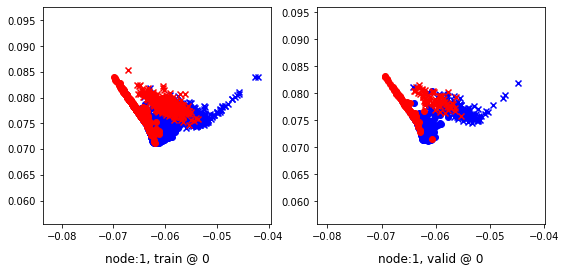

20 	 0 	 0.71889359 	 0.71848375 	 0.96337628 	 0.96271741 	 0.93783492 	 0.93738085


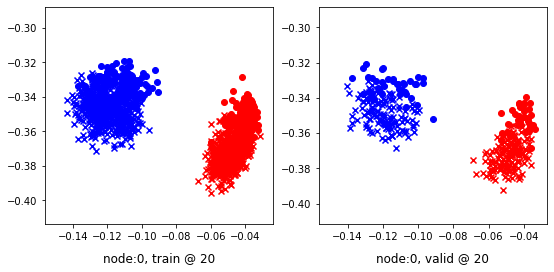

20 	 1 	 0.66365457 	 0.68734473 	 0.93439776 	 0.94432431 	 0.96414751 	 0.95012677


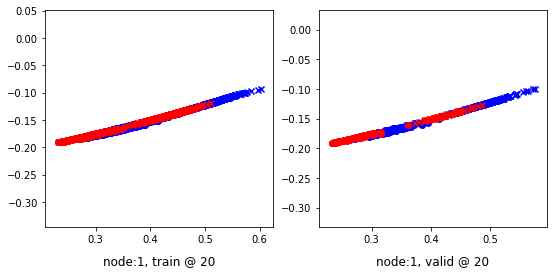

40 	 0 	 0.52851206 	 0.50938857 	 0.72277158 	 0.71568555 	 0.89150786 	 0.89944416


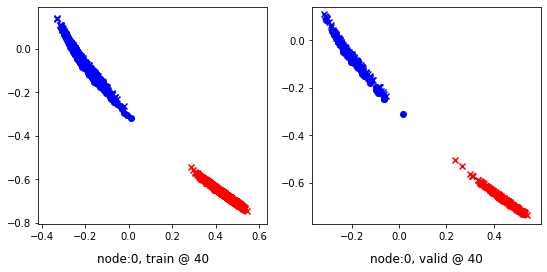

40 	 1 	 0.57975227 	 0.56714141 	 0.83883464 	 0.82944530 	 0.95523477 	 0.95545107


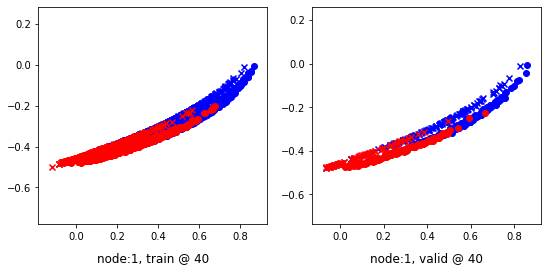

60 	 0 	 -0.08727514 	 -0.10155218 	 0.11420822 	 0.10481454 	 0.89532626 	 0.89951390


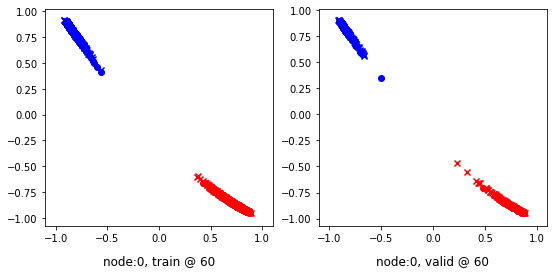

60 	 1 	 0.26759946 	 0.20525473 	 0.51276654 	 0.46458280 	 0.93865770 	 0.95247525


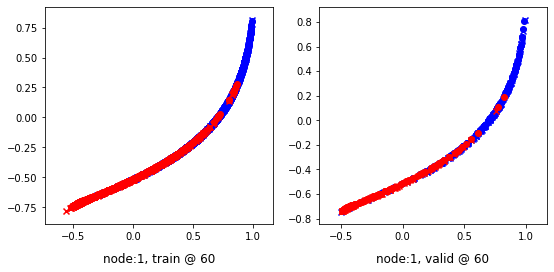

80 	 0 	 -0.21386963 	 -0.19199981 	 0.01396452 	 0.01437185 	 0.92101192 	 0.89951885


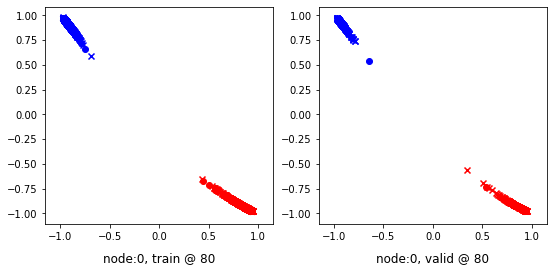

80 	 1 	 0.22240734 	 0.19773570 	 0.47826636 	 0.45562568 	 0.94996703 	 0.95103717


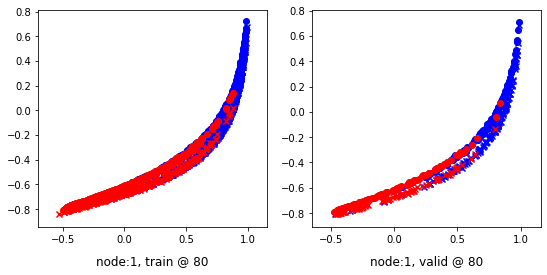

100 	 0 	 -0.17649496 	 -0.20148046 	 0.00472239 	 0.00492738 	 0.87437129 	 0.89955503


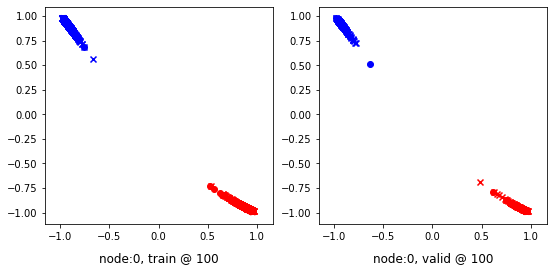

100 	 1 	 0.21734333 	 0.19507444 	 0.47072607 	 0.45472473 	 0.94689190 	 0.95279747


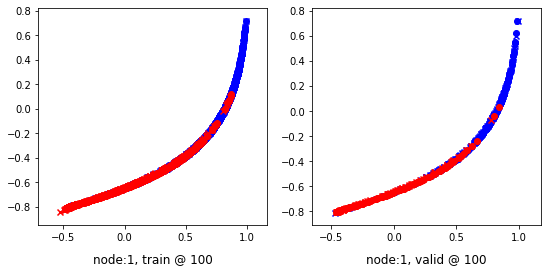

120 	 0 	 -0.20183402 	 -0.20398042 	 0.00252865 	 0.00263038 	 0.89751428 	 0.89975798


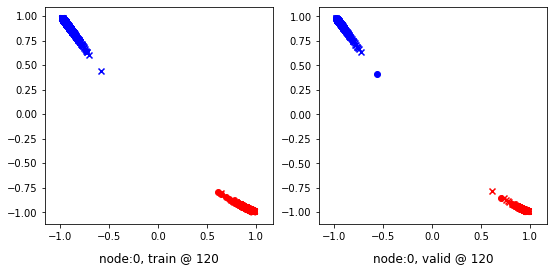

120 	 1 	 0.22844478 	 0.19570661 	 0.48767921 	 0.45575470 	 0.95360988 	 0.95319527


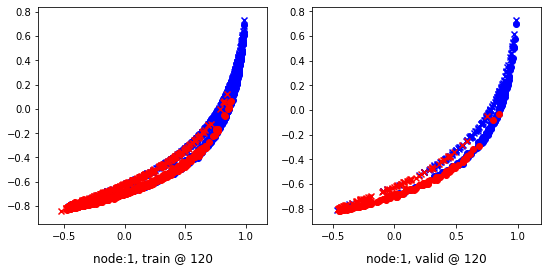

140 	 0 	 -0.21656719 	 -0.20488553 	 0.00159506 	 0.00169053 	 0.91131157 	 0.89972323


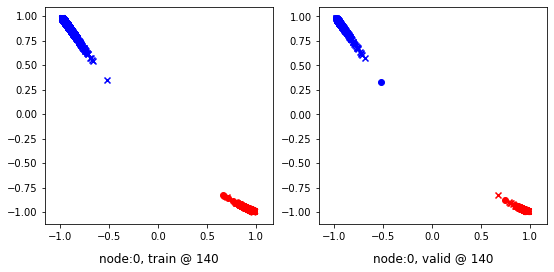

140 	 1 	 0.22566715 	 0.19895756 	 0.48476589 	 0.45588380 	 0.95231998 	 0.95007342


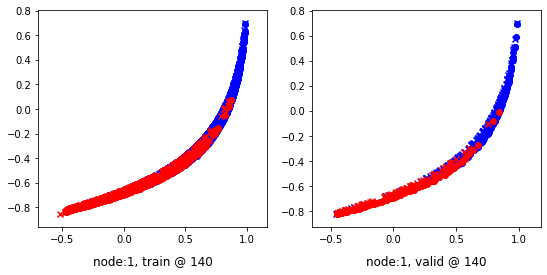

160 	 0 	 -0.21737194 	 -0.20513996 	 0.00103388 	 0.00110736 	 0.91155499 	 0.89939451


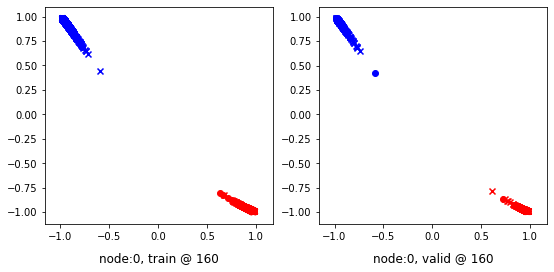

160 	 1 	 0.31006062 	 0.19539559 	 0.57109684 	 0.45580333 	 0.95449269 	 0.95355493


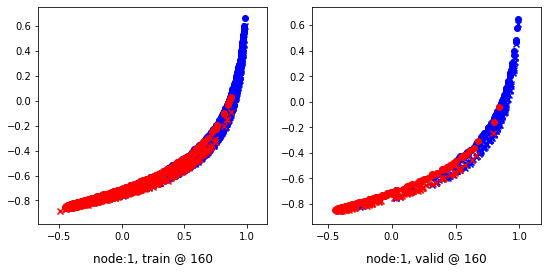

180 	 0 	 -0.22046418 	 -0.20554450 	 0.00079609 	 0.00082794 	 0.91440994 	 0.89951962


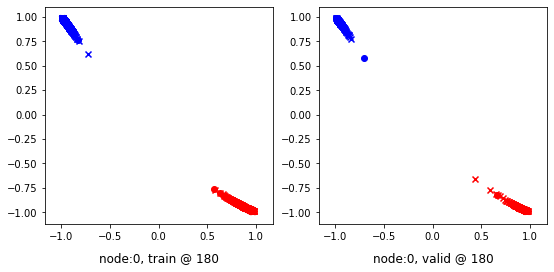

180 	 1 	 0.21932718 	 0.19572270 	 0.47000742 	 0.45425099 	 0.94432348 	 0.95167547


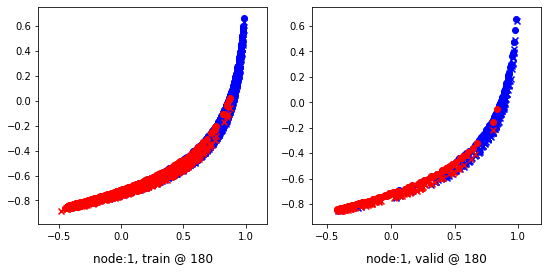

200 	 0 	 -0.18666992 	 -0.20571993 	 0.00065960 	 0.00087227 	 0.88047856 	 0.89973938


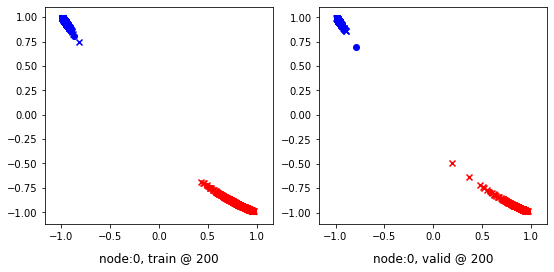

200 	 1 	 0.28787965 	 0.19444352 	 0.54867190 	 0.45662069 	 0.95418239 	 0.95532435


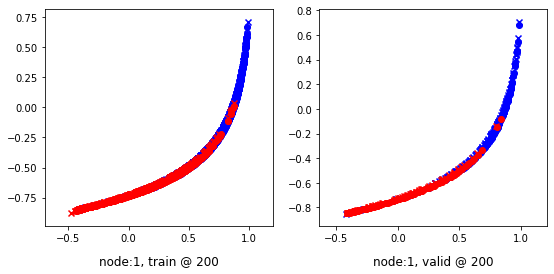

220 	 0 	 -0.23280893 	 -0.20571141 	 0.00046300 	 0.00049491 	 0.92642218 	 0.89935350


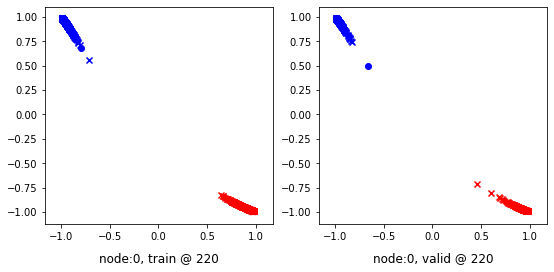

220 	 1 	 0.31253707 	 0.19595686 	 0.55744296 	 0.45492157 	 0.93835104 	 0.95211190


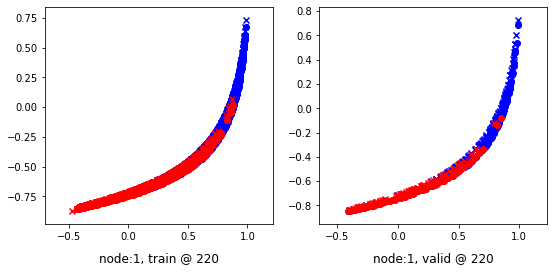

240 	 0 	 -0.22106008 	 -0.20578451 	 0.00038860 	 0.00041149 	 0.91459656 	 0.89934319


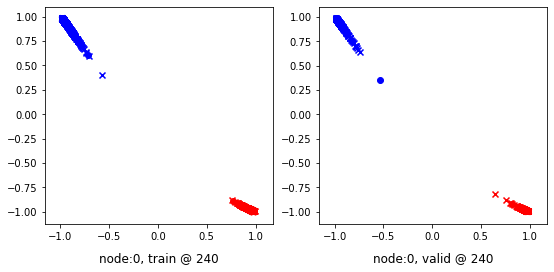

240 	 1 	 0.26869929 	 0.19785675 	 0.53307104 	 0.45737121 	 0.95756000 	 0.95266163


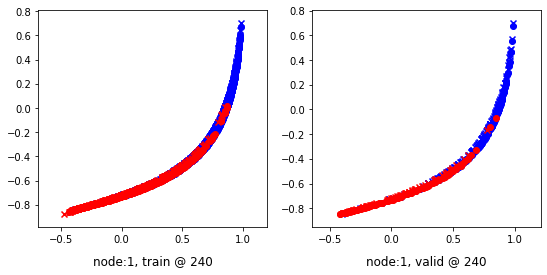

260 	 0 	 -0.21124583 	 -0.20583259 	 0.00031694 	 0.00033404 	 0.90471053 	 0.89931381


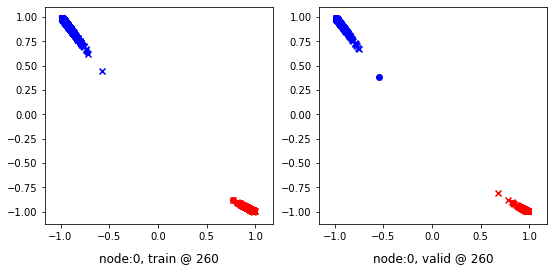

260 	 1 	 0.20951483 	 0.19759950 	 0.47021711 	 0.45739630 	 0.95359635 	 0.95294398


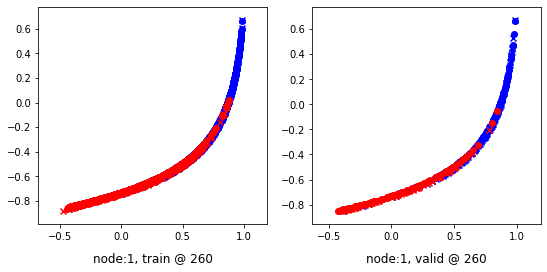

280 	 0 	 -0.22260764 	 -0.20589940 	 0.00025828 	 0.00027127 	 0.91601366 	 0.89931786


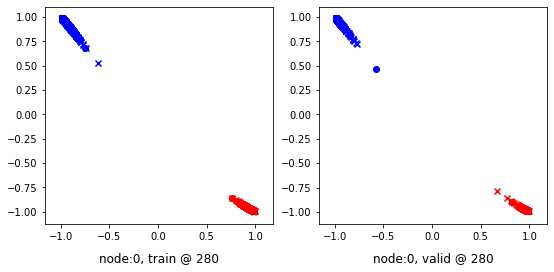

280 	 1 	 0.27824986 	 0.19676137 	 0.53588766 	 0.45696247 	 0.95191181 	 0.95334828


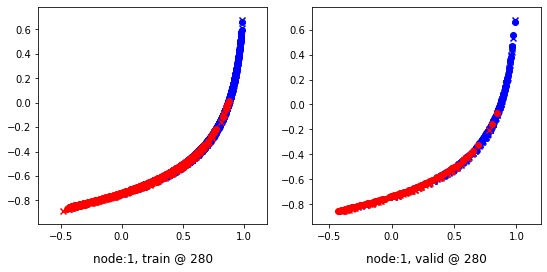

300 	 0 	 -0.15685895 	 -0.20597856 	 0.00021491 	 0.00022710 	 0.85022175 	 0.89935285


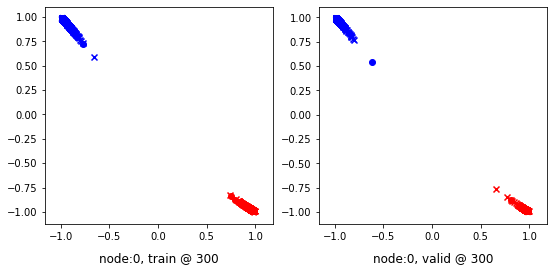

300 	 1 	 0.23438829 	 0.19592741 	 0.48852262 	 0.45657656 	 0.94694924 	 0.95379633


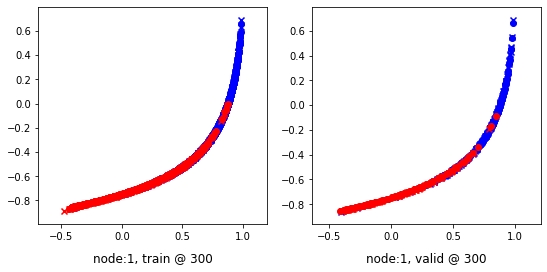

320 	 0 	 -0.19424152 	 -0.20607758 	 0.00018699 	 0.00019485 	 0.88757682 	 0.89941961


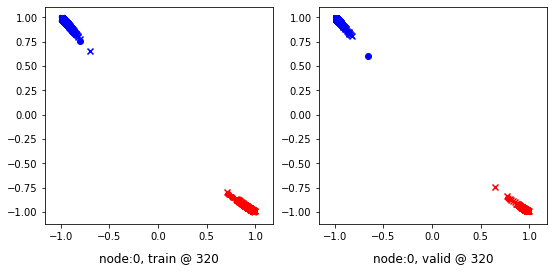

320 	 1 	 0.21594957 	 0.19830996 	 0.46132171 	 0.45746940 	 0.93847638 	 0.95230663


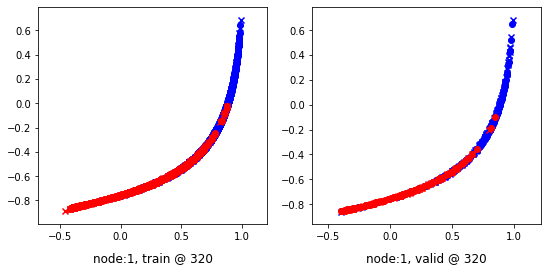

340 	 0 	 -0.18046574 	 -0.20616119 	 0.00016775 	 0.00017651 	 0.87378162 	 0.89948487


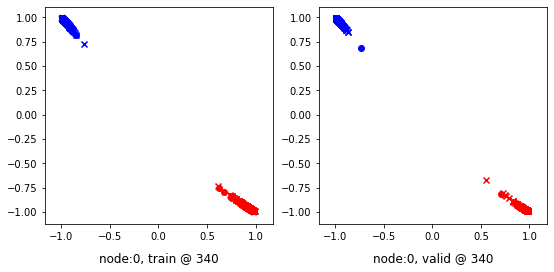

340 	 1 	 0.27206546 	 0.20058745 	 0.51980525 	 0.45955336 	 0.94142997 	 0.95211309


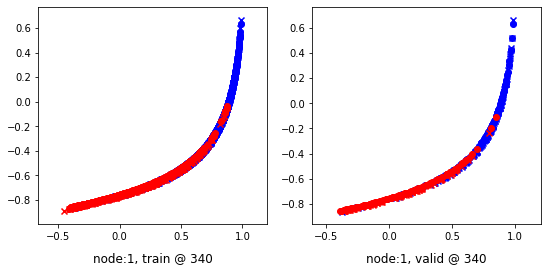

360 	 0 	 -0.19703344 	 -0.20623371 	 0.00017554 	 0.00018295 	 0.89035809 	 0.89956385


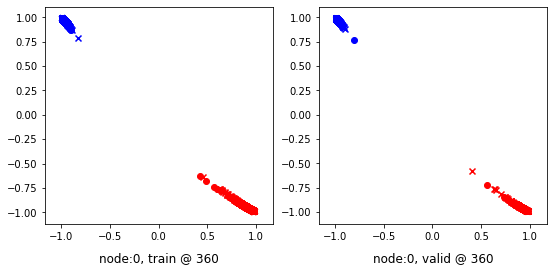

360 	 1 	 0.24332732 	 0.19987556 	 0.50100285 	 0.45939150 	 0.95156801 	 0.95266312


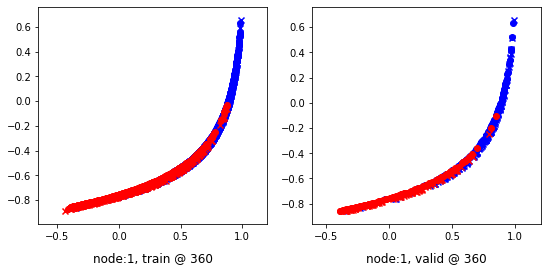

380 	 0 	 -0.20146753 	 -0.20607708 	 0.00014593 	 0.00016703 	 0.89476079 	 0.89939129


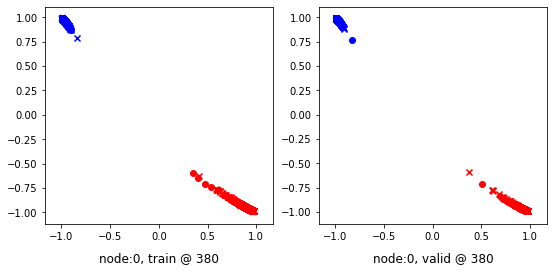

380 	 1 	 0.24770409 	 0.19684899 	 0.49441791 	 0.45689470 	 0.94008136 	 0.95319289


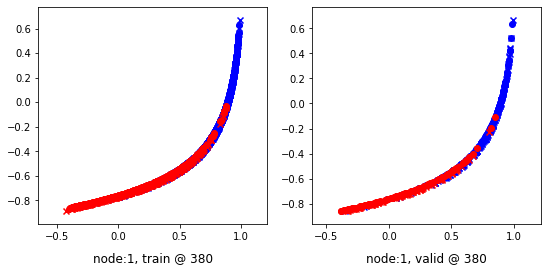

400 	 0 	 -0.14319274 	 -0.20603862 	 0.00011997 	 0.00012622 	 0.83646095 	 0.89931202


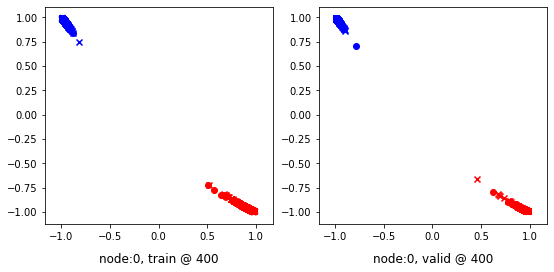

400 	 1 	 0.21570900 	 0.19509819 	 0.46938181 	 0.45556846 	 0.94765735 	 0.95361745


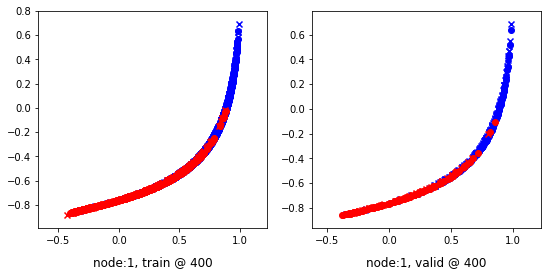

420 	 0 	 -0.18752241 	 -0.20617294 	 0.00010265 	 0.00011295 	 0.88077432 	 0.89943308


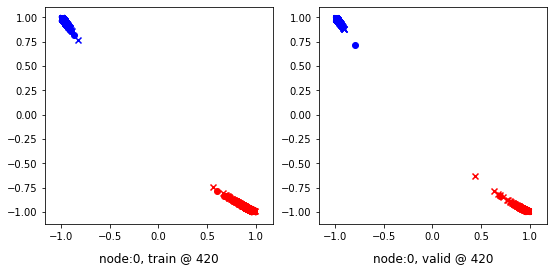

420 	 1 	 0.22442952 	 0.19822109 	 0.49079943 	 0.45826483 	 0.95959318 	 0.95319092


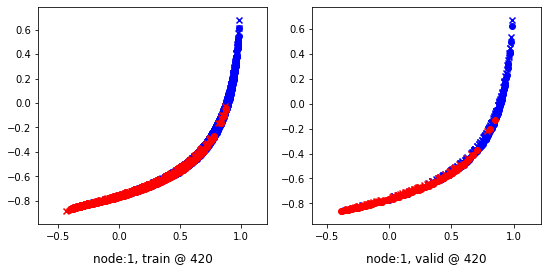

440 	 0 	 -0.20458162 	 -0.20572110 	 0.00012167 	 0.00074355 	 0.89785588 	 0.89961183


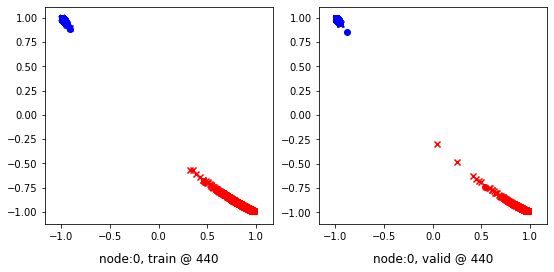

440 	 1 	 0.26886618 	 0.19795954 	 0.54097241 	 0.45751727 	 0.96526021 	 0.95270491


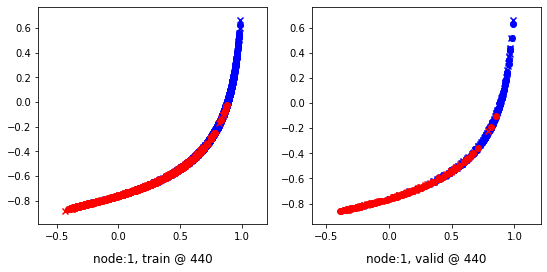

460 	 0 	 -0.19846171 	 -0.20606858 	 0.00008969 	 0.00015795 	 0.89170086 	 0.89937371


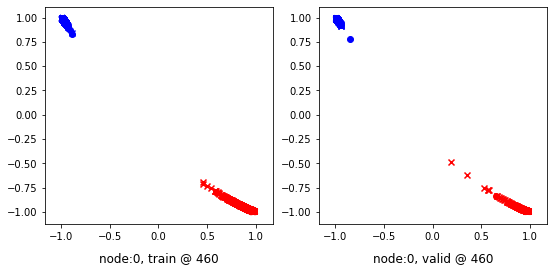

460 	 1 	 0.28619426 	 0.19618911 	 0.53945249 	 0.45602804 	 0.94611567 	 0.95298612


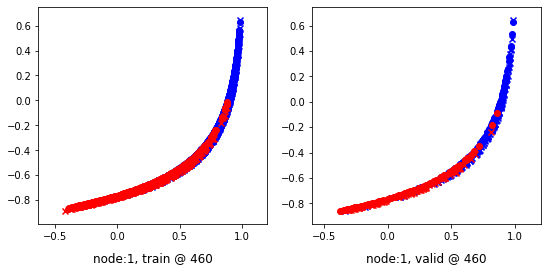

480 	 0 	 -0.22107227 	 -0.20618372 	 0.00007045 	 0.00007273 	 0.91429204 	 0.89940363


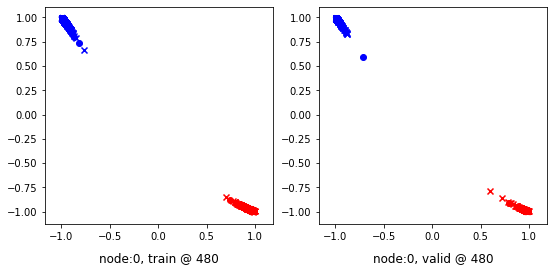

480 	 1 	 0.19446018 	 0.19893578 	 0.44613469 	 0.45935819 	 0.94500089 	 0.95356959


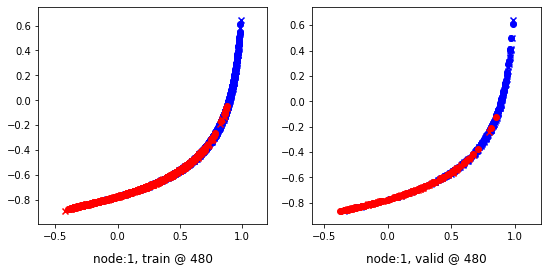

500 	 0 	 -0.22845080 	 -0.20632440 	 0.00007023 	 0.00007641 	 0.92167002 	 0.89954799


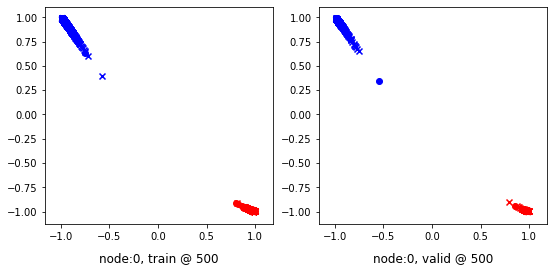

500 	 1 	 0.24569640 	 0.19626379 	 0.49152023 	 0.45674825 	 0.93985897 	 0.95363164


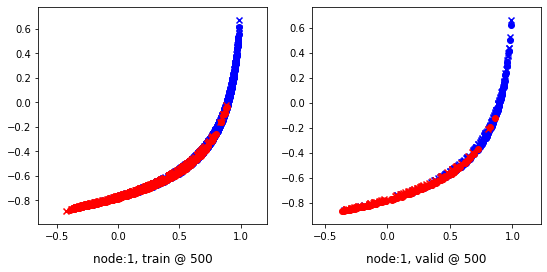

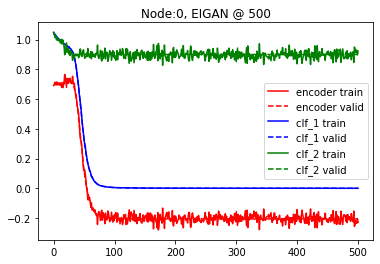

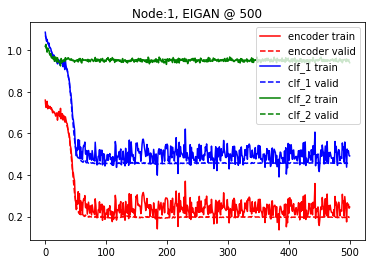

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.2 and delta=1
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.71771002 	 0.71279550 	 1.04253757 	 1.04016602 	 1.01826668 	 1.02051771


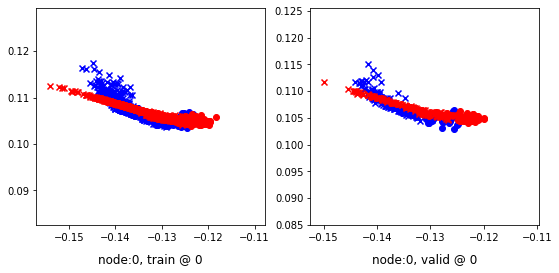

0 	 1 	 0.69917393 	 0.69824529 	 1.02571070 	 1.03029466 	 1.01994979 	 1.02519655


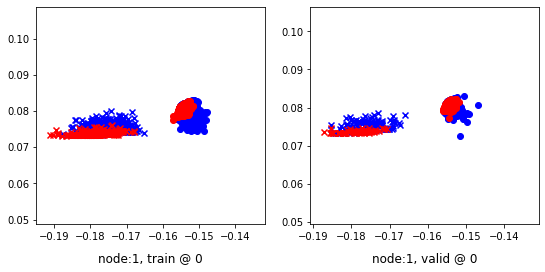

Aggregating on epoch: 1...
Aggregating on epoch: 2...
Aggregating on epoch: 3...
Aggregating on epoch: 4...
Aggregating on epoch: 5...
Aggregating on epoch: 6...
Aggregating on epoch: 7...
Aggregating on epoch: 8...
Aggregating on epoch: 9...
Aggregating on epoch: 10...
Aggregating on epoch: 11...
Aggregating on epoch: 12...
Aggregating on epoch: 13...
Aggregating on epoch: 14...
Aggregating on epoch: 15...
Aggregating on epoch: 16...
Aggregating on epoch: 17...
Aggregating on epoch: 18...
Aggregating on epoch: 19...
Aggregating on epoch: 20...
20 	 0 	 0.68389022 	 0.71615624 	 0.96084297 	 0.96091652 	 0.97014153 	 0.93790746


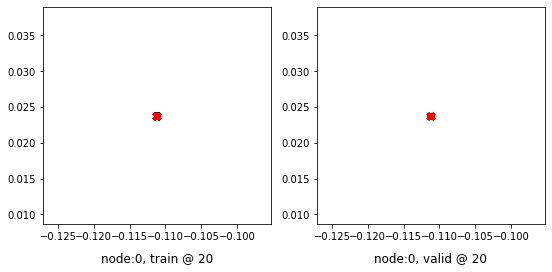

20 	 1 	 0.71584535 	 0.68694335 	 0.95444578 	 0.94564283 	 0.93175340 	 0.95184666


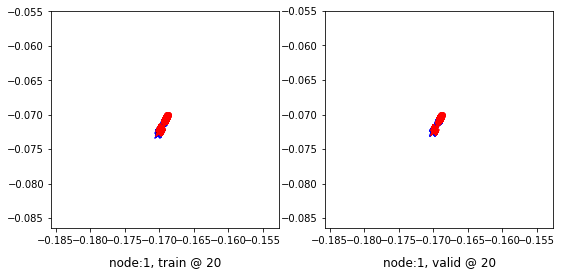

Aggregating on epoch: 21...
Aggregating on epoch: 22...
Aggregating on epoch: 23...
Aggregating on epoch: 24...
Aggregating on epoch: 25...
Aggregating on epoch: 26...
Aggregating on epoch: 27...
Aggregating on epoch: 28...
Aggregating on epoch: 29...
Aggregating on epoch: 30...
Aggregating on epoch: 31...
Aggregating on epoch: 32...
Aggregating on epoch: 33...
Aggregating on epoch: 34...
Aggregating on epoch: 35...
Aggregating on epoch: 36...
Aggregating on epoch: 37...
Aggregating on epoch: 38...
Aggregating on epoch: 39...
Aggregating on epoch: 40...
40 	 0 	 0.69778085 	 0.74625236 	 0.95224839 	 0.95394093 	 0.94763494 	 0.90083575


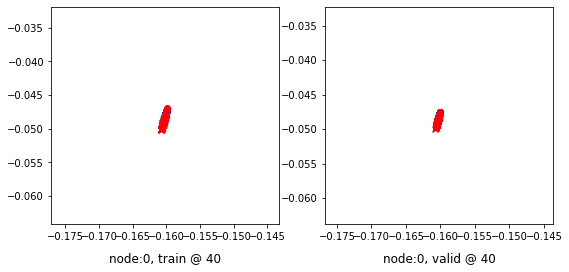

40 	 1 	 0.67055291 	 0.68655914 	 0.93729115 	 0.94523454 	 0.95988548 	 0.95182258


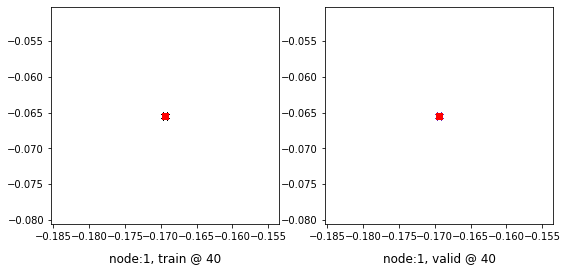

Aggregating on epoch: 41...
Aggregating on epoch: 42...
Aggregating on epoch: 43...
Aggregating on epoch: 44...
Aggregating on epoch: 45...
Aggregating on epoch: 46...
Aggregating on epoch: 47...
Aggregating on epoch: 48...
Aggregating on epoch: 49...
Aggregating on epoch: 50...
Aggregating on epoch: 51...
Aggregating on epoch: 52...
Aggregating on epoch: 53...
Aggregating on epoch: 54...
Aggregating on epoch: 55...
Aggregating on epoch: 56...
Aggregating on epoch: 57...
Aggregating on epoch: 58...
Aggregating on epoch: 59...
Aggregating on epoch: 60...
60 	 0 	 0.77374470 	 0.74768472 	 0.95773989 	 0.95394915 	 0.87714231 	 0.89941162


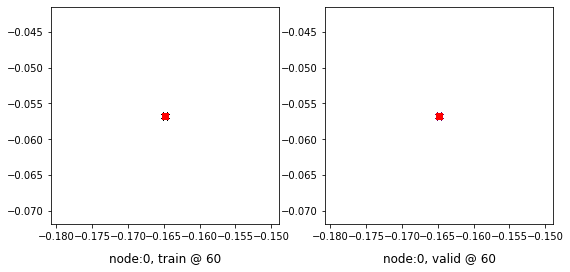

60 	 1 	 0.67746633 	 0.68655622 	 0.94505733 	 0.94523132 	 0.96073824 	 0.95182228


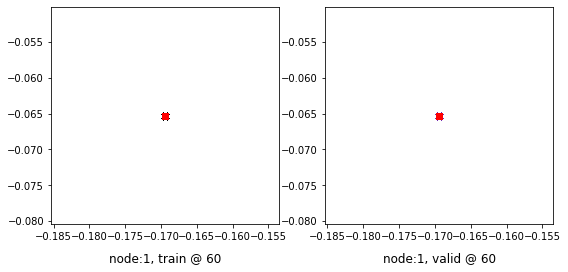

Aggregating on epoch: 61...
Aggregating on epoch: 62...
Aggregating on epoch: 63...
Aggregating on epoch: 64...
Aggregating on epoch: 65...
Aggregating on epoch: 66...
Aggregating on epoch: 67...
Aggregating on epoch: 68...
Aggregating on epoch: 69...
Aggregating on epoch: 70...
Aggregating on epoch: 71...
Aggregating on epoch: 72...
Aggregating on epoch: 73...
Aggregating on epoch: 74...
Aggregating on epoch: 75...
Aggregating on epoch: 76...
Aggregating on epoch: 77...
Aggregating on epoch: 78...
Aggregating on epoch: 79...
Aggregating on epoch: 80...
80 	 0 	 0.76549459 	 0.74768198 	 0.95294559 	 0.95394427 	 0.88059819 	 0.89940947


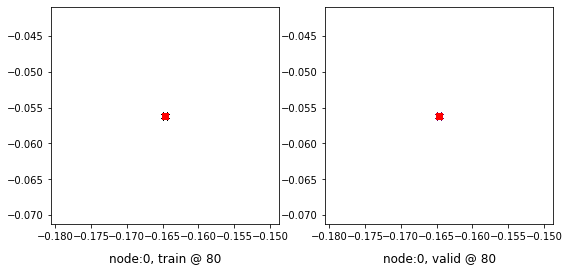

80 	 1 	 0.66431773 	 0.68654686 	 0.92455423 	 0.94522834 	 0.95338368 	 0.95182866


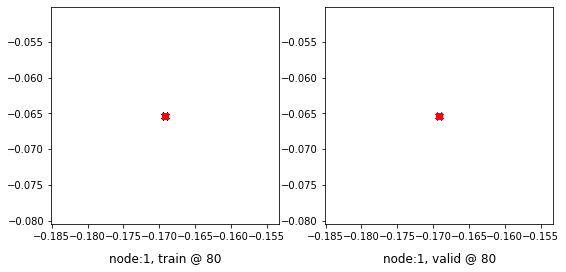

Aggregating on epoch: 81...
Aggregating on epoch: 82...
Aggregating on epoch: 83...
Aggregating on epoch: 84...
Aggregating on epoch: 85...
Aggregating on epoch: 86...
Aggregating on epoch: 87...
Aggregating on epoch: 88...
Aggregating on epoch: 89...
Aggregating on epoch: 90...
Aggregating on epoch: 91...
Aggregating on epoch: 92...
Aggregating on epoch: 93...
Aggregating on epoch: 94...
Aggregating on epoch: 95...
Aggregating on epoch: 96...
Aggregating on epoch: 97...
Aggregating on epoch: 98...
Aggregating on epoch: 99...
Aggregating on epoch: 100...
100 	 0 	 0.72493476 	 0.74768442 	 0.95367169 	 0.95394707 	 0.92188418 	 0.89940983


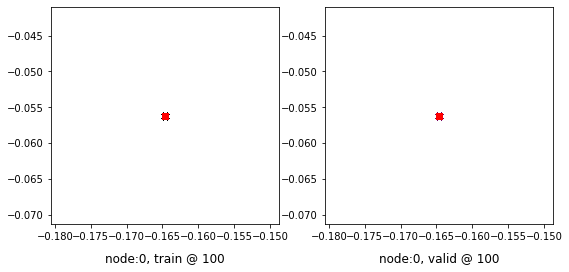

100 	 1 	 0.69987434 	 0.68657124 	 0.96470952 	 0.94524580 	 0.95798266 	 0.95182174


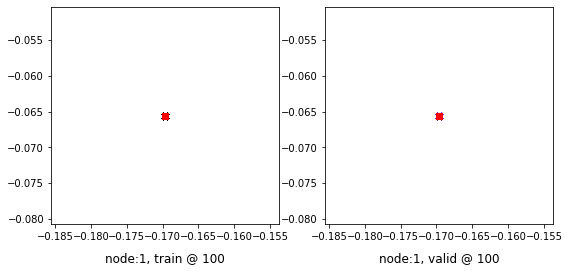

Aggregating on epoch: 101...
Aggregating on epoch: 102...
Aggregating on epoch: 103...
Aggregating on epoch: 104...
Aggregating on epoch: 105...
Aggregating on epoch: 106...
Aggregating on epoch: 107...
Aggregating on epoch: 108...
Aggregating on epoch: 109...
Aggregating on epoch: 110...
Aggregating on epoch: 111...
Aggregating on epoch: 112...
Aggregating on epoch: 113...
Aggregating on epoch: 114...
Aggregating on epoch: 115...
Aggregating on epoch: 116...
Aggregating on epoch: 117...
Aggregating on epoch: 118...
Aggregating on epoch: 119...
Aggregating on epoch: 120...
120 	 0 	 0.73584557 	 0.74768728 	 0.95076066 	 0.95394498 	 0.90806222 	 0.89940488


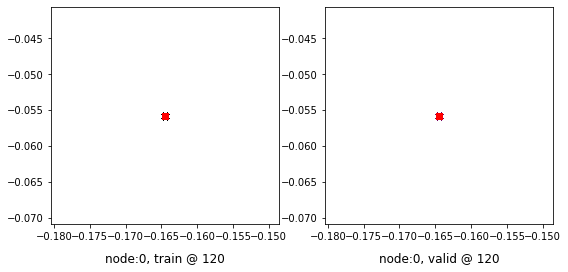

120 	 1 	 0.68986946 	 0.68654680 	 0.94505578 	 0.94522828 	 0.94833362 	 0.95182866


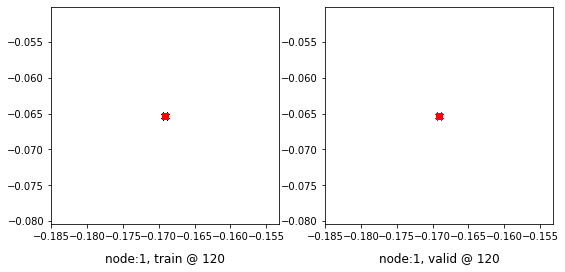

Aggregating on epoch: 121...
Aggregating on epoch: 122...
Aggregating on epoch: 123...
Aggregating on epoch: 124...
Aggregating on epoch: 125...
Aggregating on epoch: 126...
Aggregating on epoch: 127...
Aggregating on epoch: 128...
Aggregating on epoch: 129...
Aggregating on epoch: 130...
Aggregating on epoch: 131...
Aggregating on epoch: 132...
Aggregating on epoch: 133...
Aggregating on epoch: 134...
Aggregating on epoch: 135...
Aggregating on epoch: 136...
Aggregating on epoch: 137...
Aggregating on epoch: 138...
Aggregating on epoch: 139...
Aggregating on epoch: 140...
140 	 0 	 0.75012505 	 0.74768788 	 0.95477384 	 0.95394677 	 0.89779609 	 0.89940608


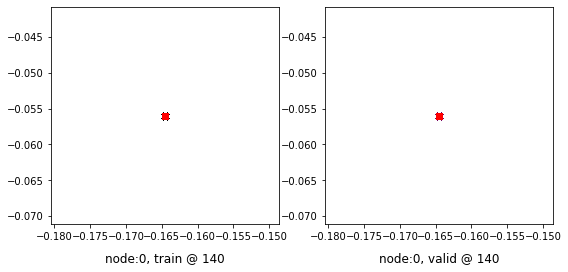

140 	 1 	 0.70659614 	 0.68654835 	 0.95931333 	 0.94523454 	 0.94586462 	 0.95183337


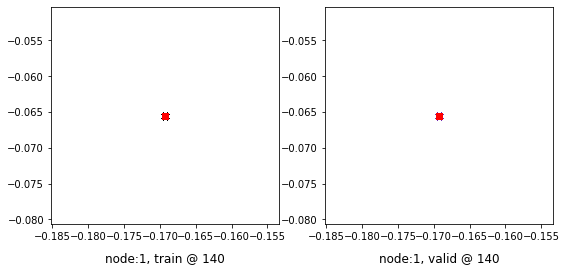

Aggregating on epoch: 141...
Aggregating on epoch: 142...
Aggregating on epoch: 143...
Aggregating on epoch: 144...
Aggregating on epoch: 145...
Aggregating on epoch: 146...
Aggregating on epoch: 147...
Aggregating on epoch: 148...
Aggregating on epoch: 149...
Aggregating on epoch: 150...
Aggregating on epoch: 151...
Aggregating on epoch: 152...
Aggregating on epoch: 153...
Aggregating on epoch: 154...
Aggregating on epoch: 155...
Aggregating on epoch: 156...
Aggregating on epoch: 157...
Aggregating on epoch: 158...
Aggregating on epoch: 159...
Aggregating on epoch: 160...
160 	 0 	 0.74115056 	 0.74768567 	 0.95954299 	 0.95394635 	 0.91153973 	 0.89940786


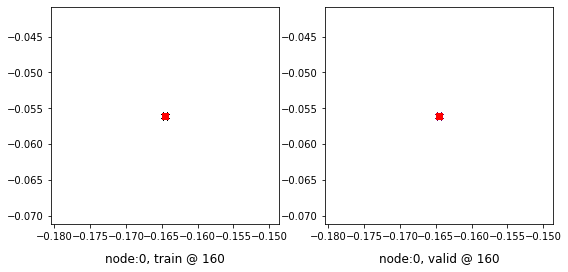

160 	 1 	 0.67977744 	 0.68655038 	 0.93362480 	 0.94522685 	 0.94699466 	 0.95182365


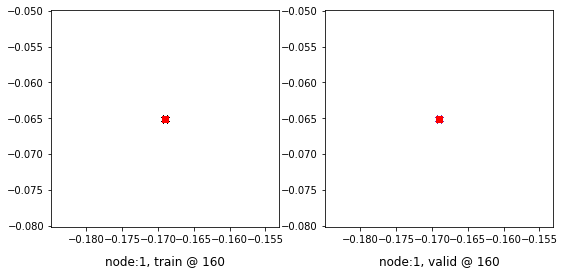

Aggregating on epoch: 161...
Aggregating on epoch: 162...
Aggregating on epoch: 163...
Aggregating on epoch: 164...
Aggregating on epoch: 165...
Aggregating on epoch: 166...
Aggregating on epoch: 167...
Aggregating on epoch: 168...
Aggregating on epoch: 169...
Aggregating on epoch: 170...
Aggregating on epoch: 171...
Aggregating on epoch: 172...
Aggregating on epoch: 173...
Aggregating on epoch: 174...
Aggregating on epoch: 175...
Aggregating on epoch: 176...
Aggregating on epoch: 177...
Aggregating on epoch: 178...
Aggregating on epoch: 179...
Aggregating on epoch: 180...
180 	 0 	 0.75087923 	 0.74767858 	 0.95553046 	 0.95395017 	 0.89779830 	 0.89941877


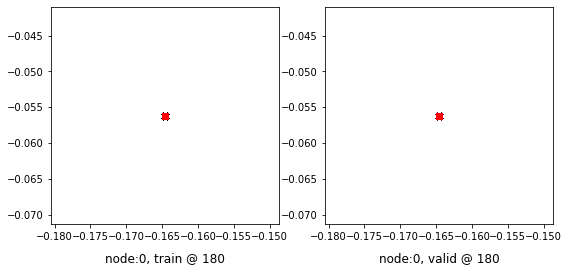

180 	 1 	 0.69255948 	 0.68654883 	 0.95406204 	 0.94522953 	 0.95464998 	 0.95182788


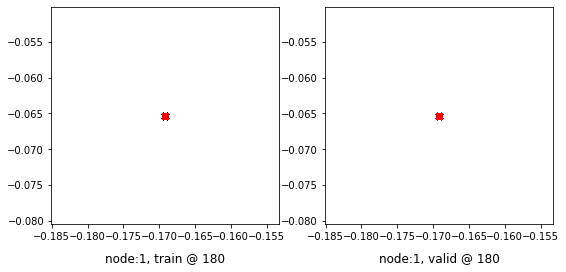

Aggregating on epoch: 181...
Aggregating on epoch: 182...
Aggregating on epoch: 183...
Aggregating on epoch: 184...
Aggregating on epoch: 185...
Aggregating on epoch: 186...
Aggregating on epoch: 187...
Aggregating on epoch: 188...
Aggregating on epoch: 189...
Aggregating on epoch: 190...
Aggregating on epoch: 191...
Aggregating on epoch: 192...
Aggregating on epoch: 193...
Aggregating on epoch: 194...
Aggregating on epoch: 195...
Aggregating on epoch: 196...
Aggregating on epoch: 197...
Aggregating on epoch: 198...
Aggregating on epoch: 199...
Aggregating on epoch: 200...
200 	 0 	 0.76985902 	 0.74768543 	 0.95733362 	 0.95394582 	 0.88062185 	 0.89940757


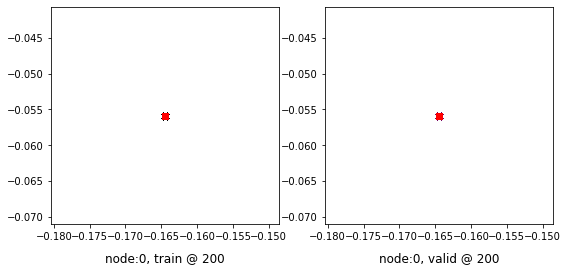

200 	 1 	 0.66705364 	 0.68654823 	 0.92602438 	 0.94522697 	 0.95211816 	 0.95182592


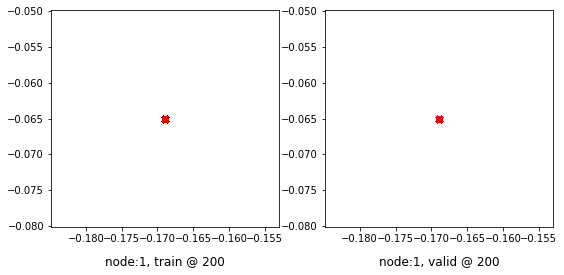

Aggregating on epoch: 201...
Aggregating on epoch: 202...
Aggregating on epoch: 203...
Aggregating on epoch: 204...
Aggregating on epoch: 205...
Aggregating on epoch: 206...
Aggregating on epoch: 207...
Aggregating on epoch: 208...
Aggregating on epoch: 209...
Aggregating on epoch: 210...
Aggregating on epoch: 211...
Aggregating on epoch: 212...
Aggregating on epoch: 213...
Aggregating on epoch: 214...
Aggregating on epoch: 215...
Aggregating on epoch: 216...
Aggregating on epoch: 217...
Aggregating on epoch: 218...
Aggregating on epoch: 219...
Aggregating on epoch: 220...
220 	 0 	 0.78910238 	 0.74769109 	 0.96294999 	 0.95394880 	 0.86699492 	 0.89940488


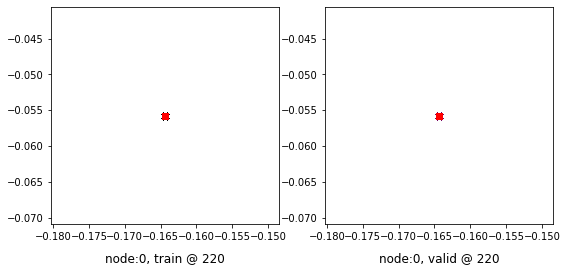

220 	 1 	 0.68409163 	 0.68656307 	 0.94115418 	 0.94524306 	 0.95020968 	 0.95182717


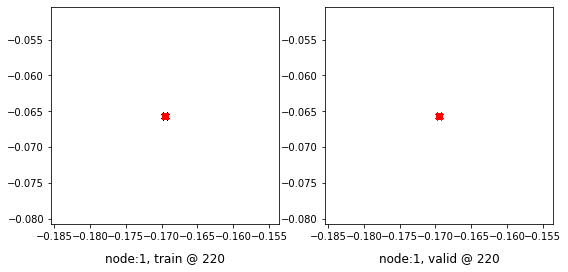

Aggregating on epoch: 221...
Aggregating on epoch: 222...
Aggregating on epoch: 223...
Aggregating on epoch: 224...
Aggregating on epoch: 225...
Aggregating on epoch: 226...
Aggregating on epoch: 227...
Aggregating on epoch: 228...
Aggregating on epoch: 229...
Aggregating on epoch: 230...
Aggregating on epoch: 231...
Aggregating on epoch: 232...
Aggregating on epoch: 233...
Aggregating on epoch: 234...
Aggregating on epoch: 235...
Aggregating on epoch: 236...
Aggregating on epoch: 237...
Aggregating on epoch: 238...
Aggregating on epoch: 239...
Aggregating on epoch: 240...
240 	 0 	 0.72885936 	 0.74769050 	 0.95404130 	 0.95394808 	 0.91832912 	 0.89940476


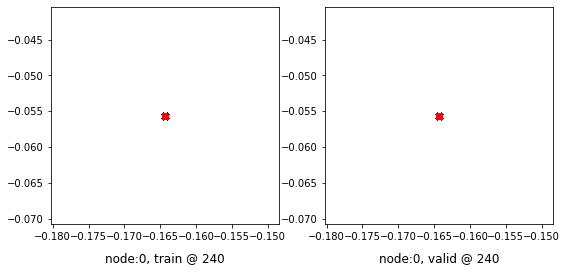

240 	 1 	 0.68812919 	 0.68657231 	 0.94901168 	 0.94525129 	 0.95402968 	 0.95182616


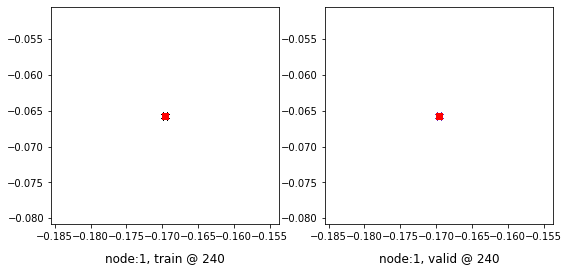

Aggregating on epoch: 241...
Aggregating on epoch: 242...
Aggregating on epoch: 243...
Aggregating on epoch: 244...
Aggregating on epoch: 245...
Aggregating on epoch: 246...
Aggregating on epoch: 247...
Aggregating on epoch: 248...
Aggregating on epoch: 249...
Aggregating on epoch: 250...
Aggregating on epoch: 251...
Aggregating on epoch: 252...
Aggregating on epoch: 253...
Aggregating on epoch: 254...
Aggregating on epoch: 255...
Aggregating on epoch: 256...
Aggregating on epoch: 257...
Aggregating on epoch: 258...
Aggregating on epoch: 259...
Aggregating on epoch: 260...
260 	 0 	 0.74693459 	 0.74768770 	 0.95843822 	 0.95394629 	 0.90465081 	 0.89940578


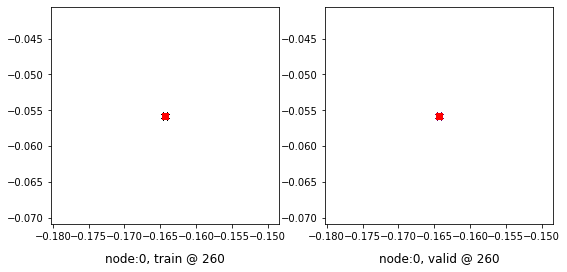

260 	 1 	 0.68027973 	 0.68654823 	 0.93862128 	 0.94523031 	 0.95148861 	 0.95182925


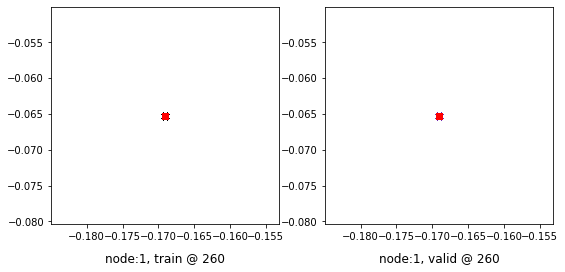

Aggregating on epoch: 261...
Aggregating on epoch: 262...
Aggregating on epoch: 263...
Aggregating on epoch: 264...
Aggregating on epoch: 265...
Aggregating on epoch: 266...
Aggregating on epoch: 267...
Aggregating on epoch: 268...
Aggregating on epoch: 269...
Aggregating on epoch: 270...
Aggregating on epoch: 271...
Aggregating on epoch: 272...
Aggregating on epoch: 273...
Aggregating on epoch: 274...
Aggregating on epoch: 275...
Aggregating on epoch: 276...
Aggregating on epoch: 277...
Aggregating on epoch: 278...
Aggregating on epoch: 279...
Aggregating on epoch: 280...
280 	 0 	 0.75331819 	 0.74768788 	 0.95110476 	 0.95394671 	 0.89093369 	 0.89940602


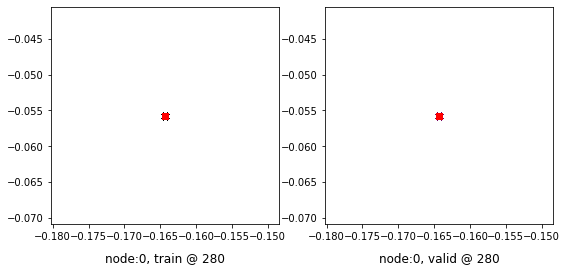

280 	 1 	 0.68599397 	 0.68654990 	 0.94118160 	 0.94523287 	 0.94833457 	 0.95183015


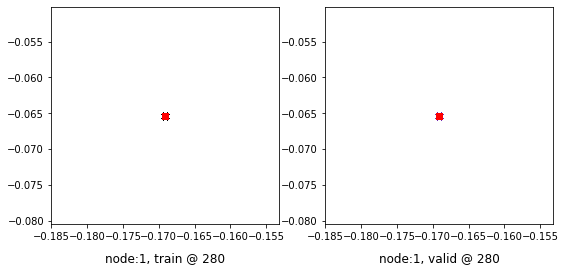

Aggregating on epoch: 281...
Aggregating on epoch: 282...
Aggregating on epoch: 283...
Aggregating on epoch: 284...
Aggregating on epoch: 285...
Aggregating on epoch: 286...
Aggregating on epoch: 287...
Aggregating on epoch: 288...
Aggregating on epoch: 289...
Aggregating on epoch: 290...
Aggregating on epoch: 291...
Aggregating on epoch: 292...
Aggregating on epoch: 293...
Aggregating on epoch: 294...
Aggregating on epoch: 295...
Aggregating on epoch: 296...
Aggregating on epoch: 297...
Aggregating on epoch: 298...
Aggregating on epoch: 299...
Aggregating on epoch: 300...
300 	 0 	 0.71316701 	 0.74767011 	 0.95585656 	 0.95394462 	 0.93583673 	 0.89942169


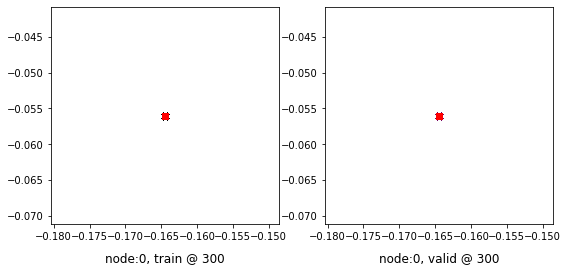

300 	 1 	 0.69060236 	 0.68656421 	 0.95156622 	 0.94523895 	 0.95411110 	 0.95182192


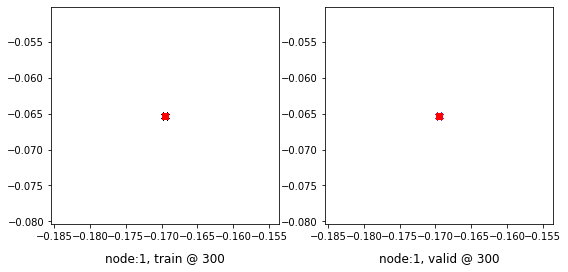

Aggregating on epoch: 301...
Aggregating on epoch: 302...
Aggregating on epoch: 303...
Aggregating on epoch: 304...
Aggregating on epoch: 305...
Aggregating on epoch: 306...
Aggregating on epoch: 307...
Aggregating on epoch: 308...
Aggregating on epoch: 309...
Aggregating on epoch: 310...
Aggregating on epoch: 311...
Aggregating on epoch: 312...
Aggregating on epoch: 313...
Aggregating on epoch: 314...
Aggregating on epoch: 315...
Aggregating on epoch: 316...
Aggregating on epoch: 317...
Aggregating on epoch: 318...
Aggregating on epoch: 319...
Aggregating on epoch: 320...
320 	 0 	 0.74485344 	 0.74767804 	 0.95294875 	 0.95394385 	 0.90124255 	 0.89941299


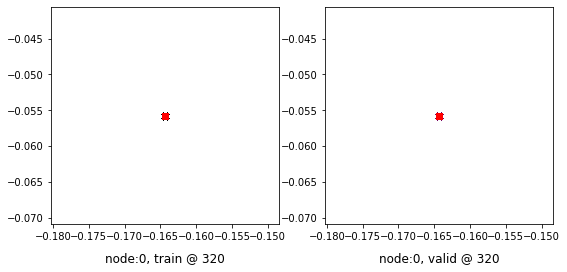

320 	 1 	 0.69371128 	 0.68655330 	 0.95528054 	 0.94522804 	 0.95471632 	 0.95182192


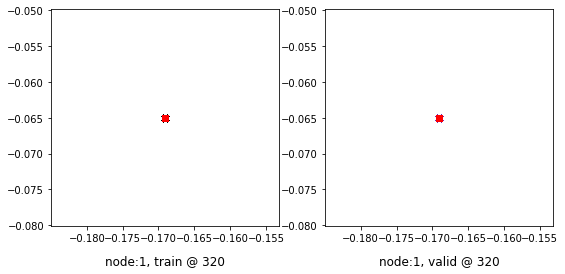

Aggregating on epoch: 321...
Aggregating on epoch: 322...
Aggregating on epoch: 323...
Aggregating on epoch: 324...
Aggregating on epoch: 325...
Aggregating on epoch: 326...
Aggregating on epoch: 327...
Aggregating on epoch: 328...
Aggregating on epoch: 329...
Aggregating on epoch: 330...
Aggregating on epoch: 331...
Aggregating on epoch: 332...
Aggregating on epoch: 333...
Aggregating on epoch: 334...
Aggregating on epoch: 335...
Aggregating on epoch: 336...
Aggregating on epoch: 337...
Aggregating on epoch: 338...
Aggregating on epoch: 339...
Aggregating on epoch: 340...
340 	 0 	 0.72906780 	 0.74767810 	 0.95439988 	 0.95394462 	 0.91847932 	 0.89941370


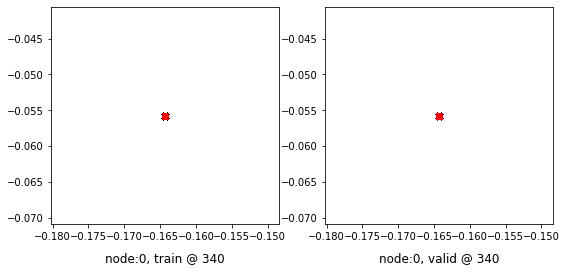

340 	 1 	 0.68351990 	 0.68655467 	 0.94634581 	 0.94523144 	 0.95597297 	 0.95182395


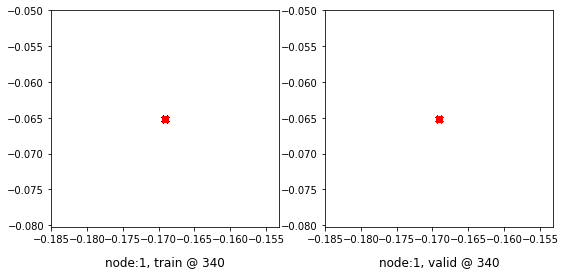

Aggregating on epoch: 341...
Aggregating on epoch: 342...
Aggregating on epoch: 343...
Aggregating on epoch: 344...
Aggregating on epoch: 345...
Aggregating on epoch: 346...
Aggregating on epoch: 347...
Aggregating on epoch: 348...
Aggregating on epoch: 349...
Aggregating on epoch: 350...
Aggregating on epoch: 351...
Aggregating on epoch: 352...
Aggregating on epoch: 353...
Aggregating on epoch: 354...
Aggregating on epoch: 355...
Aggregating on epoch: 356...
Aggregating on epoch: 357...
Aggregating on epoch: 358...
Aggregating on epoch: 359...
Aggregating on epoch: 360...
360 	 0 	 0.77179354 	 0.74768448 	 0.95585471 	 0.95394462 	 0.87720859 	 0.89940733


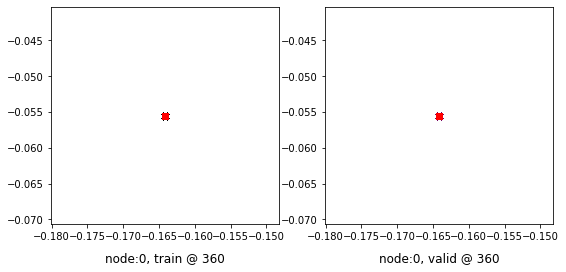

360 	 1 	 0.66555023 	 0.68655246 	 0.92965341 	 0.94522870 	 0.95725024 	 0.95182341


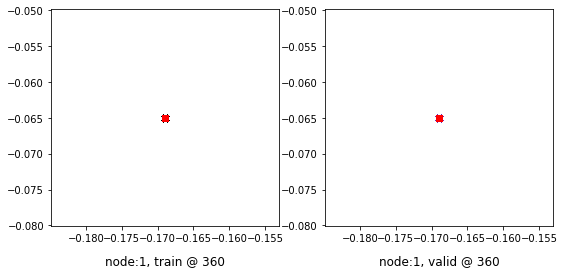

Aggregating on epoch: 361...
Aggregating on epoch: 362...
Aggregating on epoch: 363...
Aggregating on epoch: 364...
Aggregating on epoch: 365...
Aggregating on epoch: 366...
Aggregating on epoch: 367...
Aggregating on epoch: 368...
Aggregating on epoch: 369...
Aggregating on epoch: 370...
Aggregating on epoch: 371...
Aggregating on epoch: 372...
Aggregating on epoch: 373...
Aggregating on epoch: 374...
Aggregating on epoch: 375...
Aggregating on epoch: 376...
Aggregating on epoch: 377...
Aggregating on epoch: 378...
Aggregating on epoch: 379...
Aggregating on epoch: 380...
380 	 0 	 0.78291166 	 0.74769330 	 0.94995278 	 0.95395070 	 0.86018848 	 0.89940459


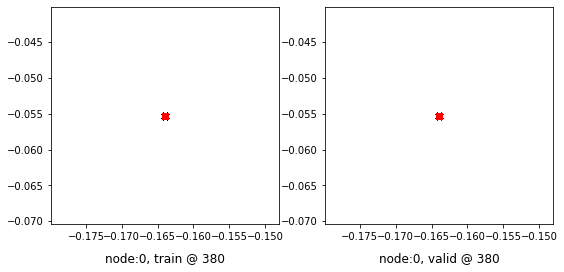

380 	 1 	 0.66812760 	 0.68655097 	 0.93347800 	 0.94523048 	 0.95849776 	 0.95182669


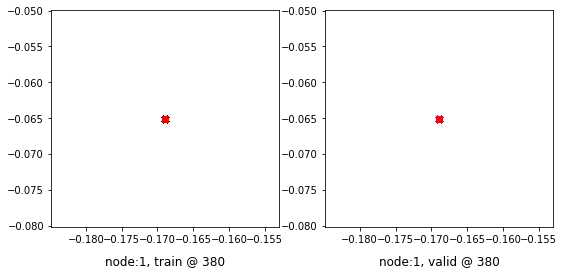

Aggregating on epoch: 381...
Aggregating on epoch: 382...
Aggregating on epoch: 383...
Aggregating on epoch: 384...
Aggregating on epoch: 385...
Aggregating on epoch: 386...
Aggregating on epoch: 387...
Aggregating on epoch: 388...
Aggregating on epoch: 389...
Aggregating on epoch: 390...
Aggregating on epoch: 391...
Aggregating on epoch: 392...
Aggregating on epoch: 393...
Aggregating on epoch: 394...
Aggregating on epoch: 395...
Aggregating on epoch: 396...
Aggregating on epoch: 397...
Aggregating on epoch: 398...
Aggregating on epoch: 399...
Aggregating on epoch: 400...
400 	 0 	 0.78856093 	 0.74768871 	 0.95220691 	 0.95394611 	 0.85679334 	 0.89940459


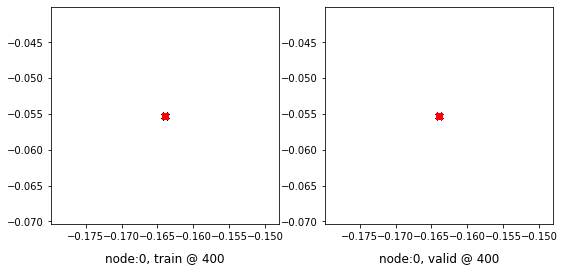

400 	 1 	 0.68860507 	 0.68654984 	 0.94120842 	 0.94522834 	 0.94575053 	 0.95182568


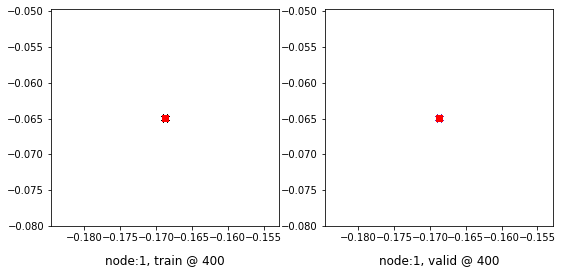

Aggregating on epoch: 401...
Aggregating on epoch: 402...
Aggregating on epoch: 403...
Aggregating on epoch: 404...
Aggregating on epoch: 405...
Aggregating on epoch: 406...
Aggregating on epoch: 407...
Aggregating on epoch: 408...
Aggregating on epoch: 409...
Aggregating on epoch: 410...
Aggregating on epoch: 411...
Aggregating on epoch: 412...
Aggregating on epoch: 413...
Aggregating on epoch: 414...
Aggregating on epoch: 415...
Aggregating on epoch: 416...
Aggregating on epoch: 417...
Aggregating on epoch: 418...
Aggregating on epoch: 419...
Aggregating on epoch: 420...
420 	 0 	 0.71466738 	 0.74768645 	 0.95367193 	 0.95394647 	 0.93215179 	 0.89940721


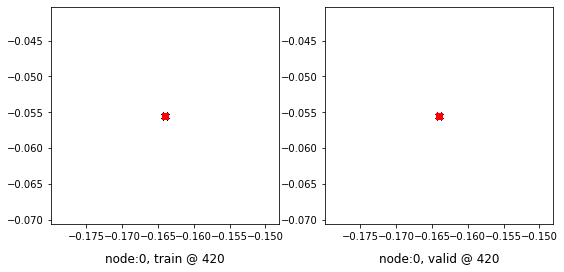

420 	 1 	 0.70436370 	 0.68655944 	 0.97887266 	 0.94523472 	 0.96765864 	 0.95182246


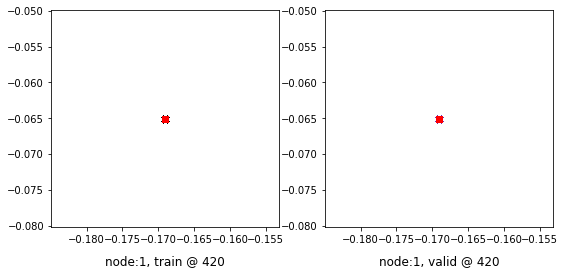

Aggregating on epoch: 421...
Aggregating on epoch: 422...
Aggregating on epoch: 423...
Aggregating on epoch: 424...
Aggregating on epoch: 425...
Aggregating on epoch: 426...
Aggregating on epoch: 427...
Aggregating on epoch: 428...
Aggregating on epoch: 429...
Aggregating on epoch: 430...
Aggregating on epoch: 431...
Aggregating on epoch: 432...
Aggregating on epoch: 433...
Aggregating on epoch: 434...
Aggregating on epoch: 435...
Aggregating on epoch: 436...
Aggregating on epoch: 437...
Aggregating on epoch: 438...
Aggregating on epoch: 439...
Aggregating on epoch: 440...
440 	 0 	 0.72653389 	 0.74768114 	 0.95185024 	 0.95394456 	 0.91846371 	 0.89941061


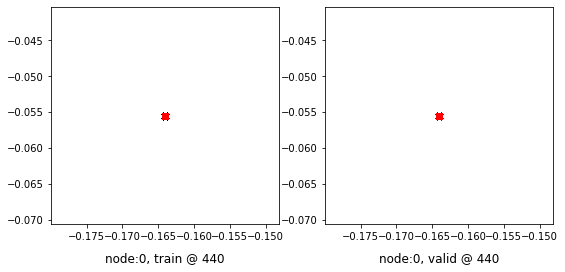

440 	 1 	 0.72152907 	 0.68654978 	 0.97240692 	 0.94523770 	 0.94402605 	 0.95183510


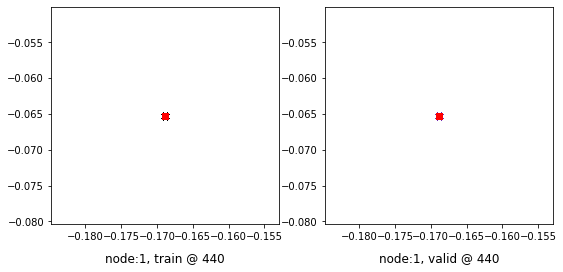

Aggregating on epoch: 441...
Aggregating on epoch: 442...
Aggregating on epoch: 443...
Aggregating on epoch: 444...
Aggregating on epoch: 445...
Aggregating on epoch: 446...
Aggregating on epoch: 447...
Aggregating on epoch: 448...
Aggregating on epoch: 449...
Aggregating on epoch: 450...
Aggregating on epoch: 451...
Aggregating on epoch: 452...
Aggregating on epoch: 453...
Aggregating on epoch: 454...
Aggregating on epoch: 455...
Aggregating on epoch: 456...
Aggregating on epoch: 457...
Aggregating on epoch: 458...
Aggregating on epoch: 459...
Aggregating on epoch: 460...
460 	 0 	 0.74662894 	 0.74768037 	 0.94783324 	 0.95394546 	 0.89435178 	 0.89941227


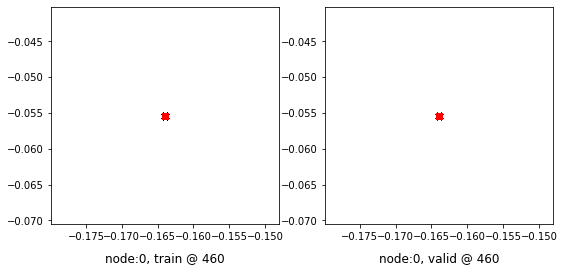

460 	 1 	 0.71942645 	 0.68656337 	 0.97525162 	 0.94524670 	 0.94897407 	 0.95183051


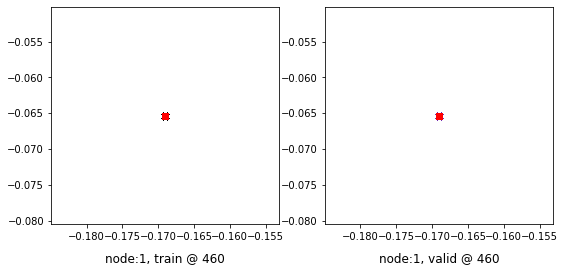

Aggregating on epoch: 461...
Aggregating on epoch: 462...
Aggregating on epoch: 463...
Aggregating on epoch: 464...
Aggregating on epoch: 465...
Aggregating on epoch: 466...
Aggregating on epoch: 467...
Aggregating on epoch: 468...
Aggregating on epoch: 469...
Aggregating on epoch: 470...
Aggregating on epoch: 471...
Aggregating on epoch: 472...
Aggregating on epoch: 473...
Aggregating on epoch: 474...
Aggregating on epoch: 475...
Aggregating on epoch: 476...
Aggregating on epoch: 477...
Aggregating on epoch: 478...
Aggregating on epoch: 479...
Aggregating on epoch: 480...
480 	 0 	 0.77668822 	 0.74768943 	 0.95403856 	 0.95394695 	 0.87049764 	 0.89940470


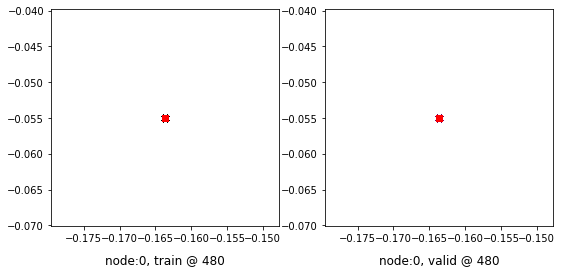

480 	 1 	 0.68610138 	 0.68656290 	 0.94896758 	 0.94523764 	 0.95601344 	 0.95182192


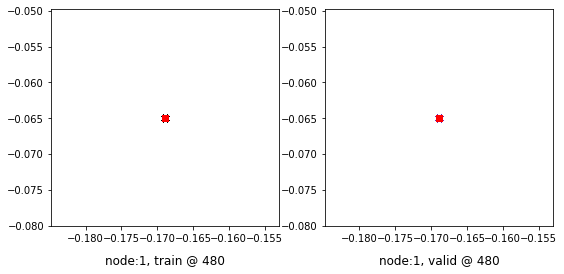

Aggregating on epoch: 481...
Aggregating on epoch: 482...
Aggregating on epoch: 483...
Aggregating on epoch: 484...
Aggregating on epoch: 485...
Aggregating on epoch: 486...
Aggregating on epoch: 487...
Aggregating on epoch: 488...
Aggregating on epoch: 489...
Aggregating on epoch: 490...
Aggregating on epoch: 491...
Aggregating on epoch: 492...
Aggregating on epoch: 493...
Aggregating on epoch: 494...
Aggregating on epoch: 495...
Aggregating on epoch: 496...
Aggregating on epoch: 497...
Aggregating on epoch: 498...
Aggregating on epoch: 499...
Aggregating on epoch: 500...
500 	 0 	 0.71129113 	 0.74768186 	 0.94686514 	 0.95394236 	 0.92872101 	 0.89940768


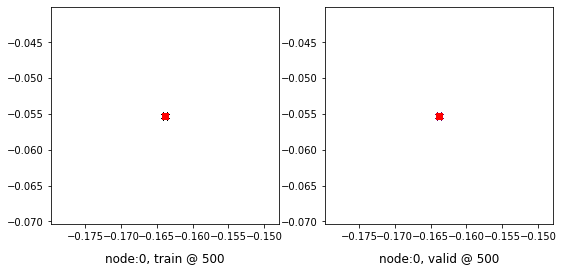

500 	 1 	 0.69695580 	 0.68655151 	 0.95015377 	 0.94522727 	 0.94634515 	 0.95182294


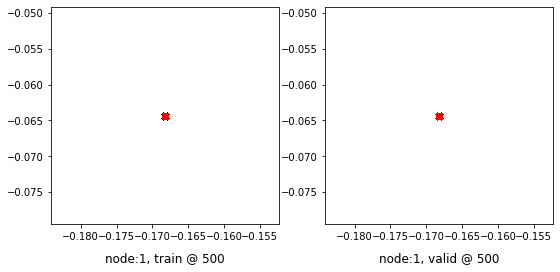

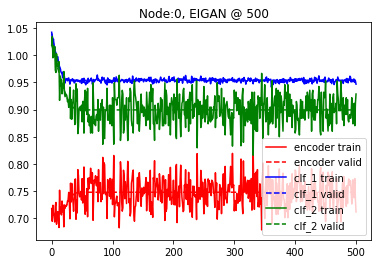

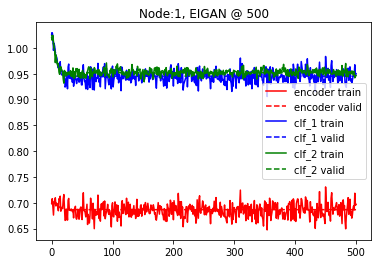

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.2 and delta=3
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.64274728 	 0.63985837 	 1.01001692 	 1.00929570 	 1.06050479 	 1.06258452


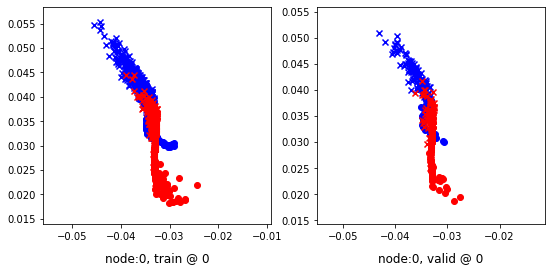

0 	 1 	 0.69573987 	 0.69591832 	 1.04773426 	 1.04580235 	 1.04542577 	 1.04303122


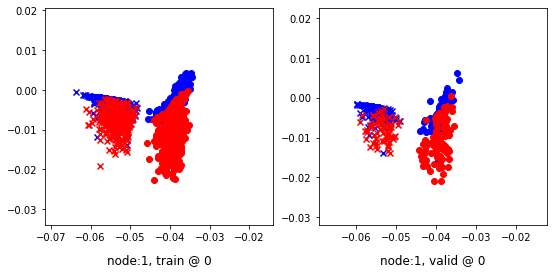

Aggregating on epoch: 3...
Aggregating on epoch: 6...
Aggregating on epoch: 9...
Aggregating on epoch: 12...
Aggregating on epoch: 15...
Aggregating on epoch: 18...
20 	 0 	 0.72340977 	 0.70616663 	 0.96486419 	 0.96635342 	 0.93464041 	 0.95333397


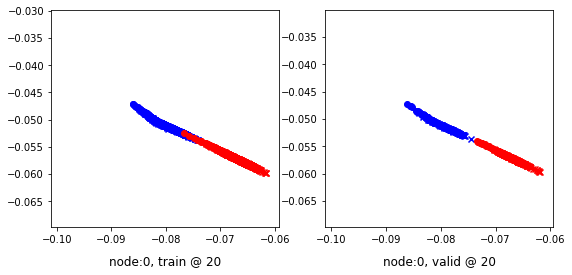

20 	 1 	 0.68404239 	 0.69136703 	 0.95306057 	 0.95645303 	 0.96229291 	 0.95823318


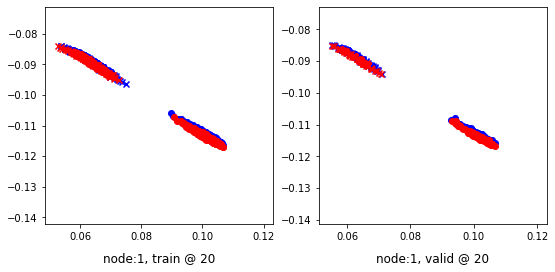

Aggregating on epoch: 21...
Aggregating on epoch: 24...
Aggregating on epoch: 27...
Aggregating on epoch: 30...
Aggregating on epoch: 33...
Aggregating on epoch: 36...
Aggregating on epoch: 39...
40 	 0 	 0.73299402 	 0.74443781 	 0.95357215 	 0.95382154 	 0.91374463 	 0.90253091


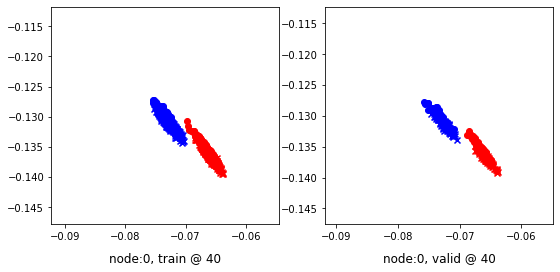

40 	 1 	 0.69515067 	 0.68647367 	 0.95927370 	 0.94521642 	 0.95728219 	 0.95188993


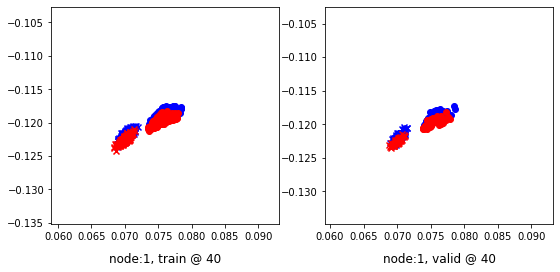

Aggregating on epoch: 42...
Aggregating on epoch: 45...
Aggregating on epoch: 48...
Aggregating on epoch: 51...
Aggregating on epoch: 54...
Aggregating on epoch: 57...
Aggregating on epoch: 60...
60 	 0 	 0.74137503 	 0.74689651 	 0.95628387 	 0.95313609 	 0.90812671 	 0.89938676


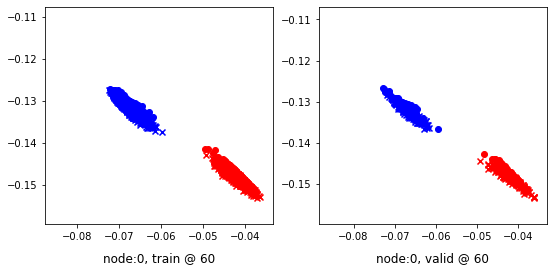

60 	 1 	 0.68263632 	 0.68634319 	 0.93964046 	 0.94496924 	 0.95017374 	 0.95177323


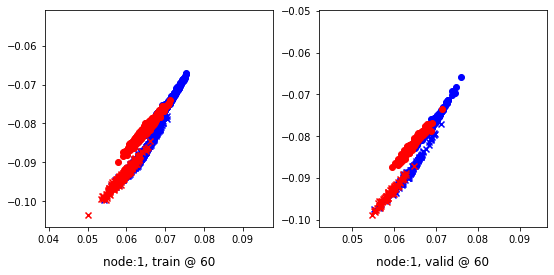

Aggregating on epoch: 63...
Aggregating on epoch: 66...
Aggregating on epoch: 69...
Aggregating on epoch: 72...
Aggregating on epoch: 75...
Aggregating on epoch: 78...
80 	 0 	 0.72366214 	 0.72480279 	 0.93352264 	 0.93115371 	 0.90468919 	 0.89949811


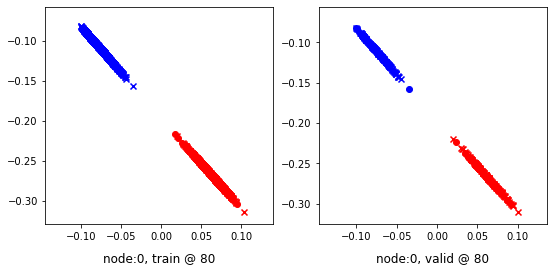

80 	 1 	 0.67727196 	 0.68239295 	 0.93464214 	 0.94105291 	 0.95080739 	 0.95180714


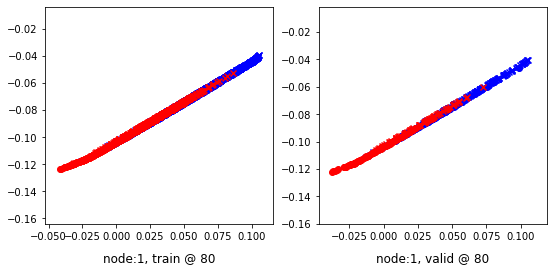

Aggregating on epoch: 81...
Aggregating on epoch: 84...
Aggregating on epoch: 87...
Aggregating on epoch: 90...
Aggregating on epoch: 93...
Aggregating on epoch: 96...
Aggregating on epoch: 99...
100 	 0 	 0.43980753 	 0.39732975 	 0.60336590 	 0.60358846 	 0.87021470 	 0.89940590


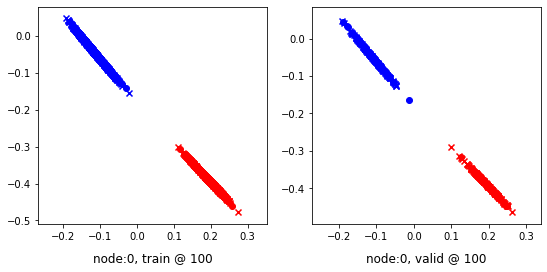

100 	 1 	 0.51310396 	 0.50820094 	 0.76474822 	 0.76551354 	 0.95017147 	 0.95045978


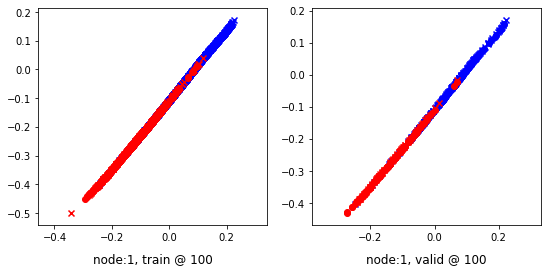

Aggregating on epoch: 102...
Aggregating on epoch: 105...
Aggregating on epoch: 108...
Aggregating on epoch: 111...
Aggregating on epoch: 114...
Aggregating on epoch: 117...
Aggregating on epoch: 120...
120 	 0 	 0.13031164 	 0.11252716 	 0.31799218 	 0.31853262 	 0.89745587 	 0.89915264


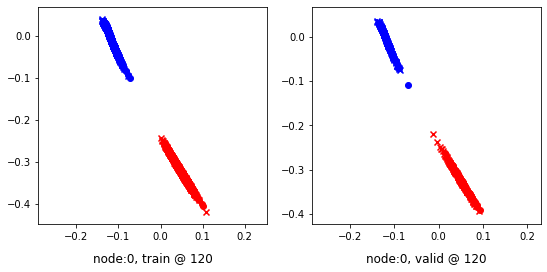

120 	 1 	 0.50905818 	 0.45444632 	 0.74341661 	 0.70959443 	 0.94577199 	 0.94829530


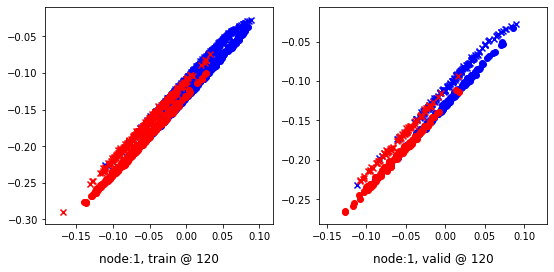

Aggregating on epoch: 123...
Aggregating on epoch: 126...
Aggregating on epoch: 129...
Aggregating on epoch: 132...
Aggregating on epoch: 135...
Aggregating on epoch: 138...
140 	 0 	 0.09521833 	 0.06370053 	 0.26647836 	 0.26963326 	 0.88295382 	 0.89907992


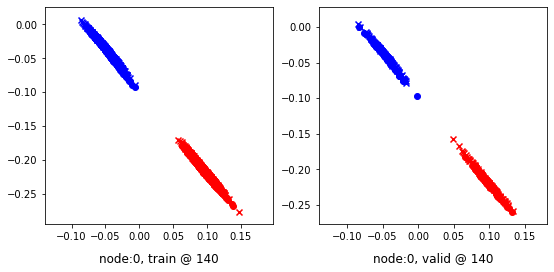

140 	 1 	 0.44673216 	 0.41459906 	 0.70206380 	 0.67335635 	 0.95357358 	 0.95190448


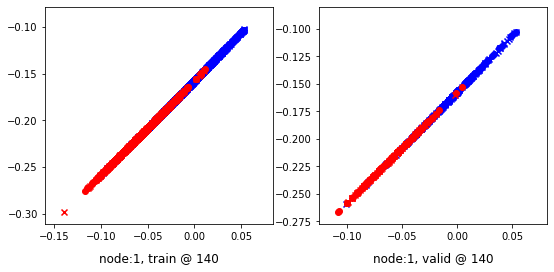

Aggregating on epoch: 141...
Aggregating on epoch: 144...
Aggregating on epoch: 147...
Aggregating on epoch: 150...
Aggregating on epoch: 153...
Aggregating on epoch: 156...
Aggregating on epoch: 159...
160 	 0 	 0.29503962 	 0.23596442 	 0.44135296 	 0.44202930 	 0.86998868 	 0.89921206


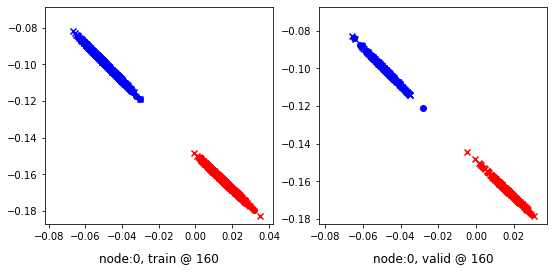

160 	 1 	 0.54954416 	 0.54775667 	 0.81711000 	 0.80605280 	 0.95248765 	 0.95144331


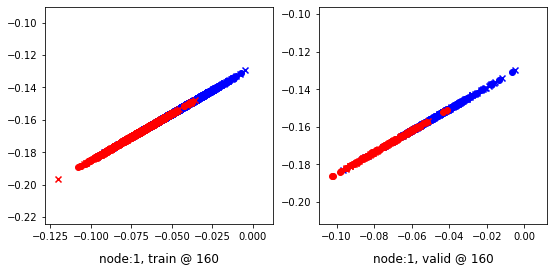

Aggregating on epoch: 162...
Aggregating on epoch: 165...
Aggregating on epoch: 168...
Aggregating on epoch: 171...
Aggregating on epoch: 174...
Aggregating on epoch: 177...
Aggregating on epoch: 180...
180 	 0 	 0.00888444 	 -0.00636469 	 0.19218652 	 0.19941957 	 0.89388472 	 0.89893144


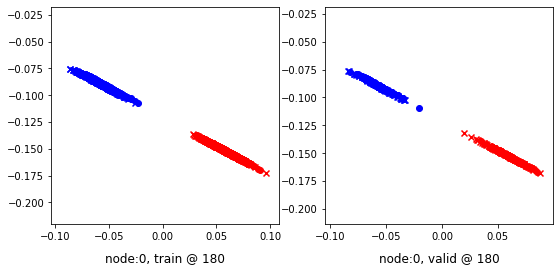

180 	 1 	 0.68068361 	 0.53401256 	 0.86362946 	 0.79209560 	 0.95064819 	 0.95123023


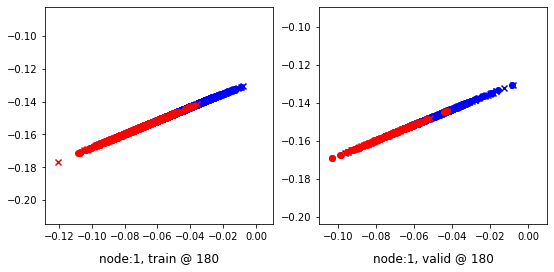

Aggregating on epoch: 183...
Aggregating on epoch: 186...
Aggregating on epoch: 189...
Aggregating on epoch: 192...
Aggregating on epoch: 195...
Aggregating on epoch: 198...
200 	 0 	 0.63902551 	 0.57322627 	 0.80590773 	 0.77964085 	 0.90461123 	 0.89956176


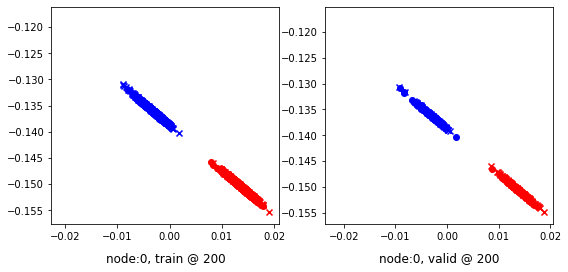

200 	 1 	 0.43437999 	 0.41454422 	 0.70004404 	 0.67214435 	 0.96208686 	 0.95074731


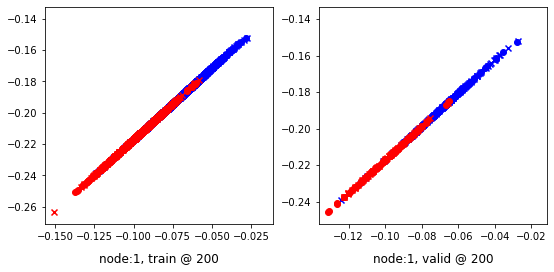

Aggregating on epoch: 201...
Aggregating on epoch: 204...
Aggregating on epoch: 207...
Aggregating on epoch: 210...
Aggregating on epoch: 213...
Aggregating on epoch: 216...
Aggregating on epoch: 219...
220 	 0 	 0.20024207 	 0.17367202 	 0.36254308 	 0.37981892 	 0.87660617 	 0.89929408


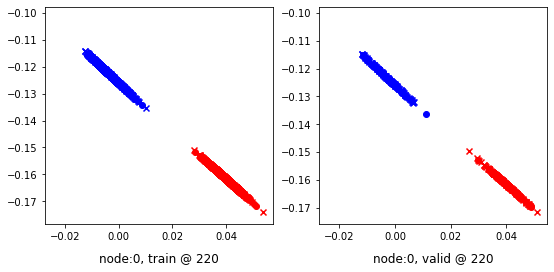

220 	 1 	 0.53288764 	 0.53851402 	 0.79982513 	 0.79721749 	 0.95623934 	 0.95185065


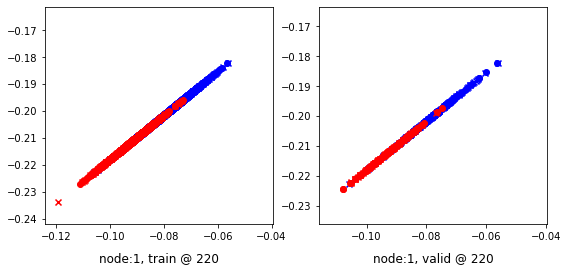

Aggregating on epoch: 222...
Aggregating on epoch: 225...
Aggregating on epoch: 228...
Aggregating on epoch: 231...
Aggregating on epoch: 234...
Aggregating on epoch: 237...
Aggregating on epoch: 240...
240 	 0 	 -0.00425671 	 0.01105075 	 0.21139546 	 0.21724592 	 0.92579794 	 0.89934236


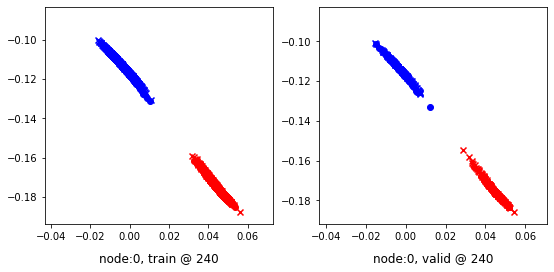

240 	 1 	 0.53428102 	 0.52992254 	 0.77743387 	 0.78777945 	 0.94248986 	 0.95100409


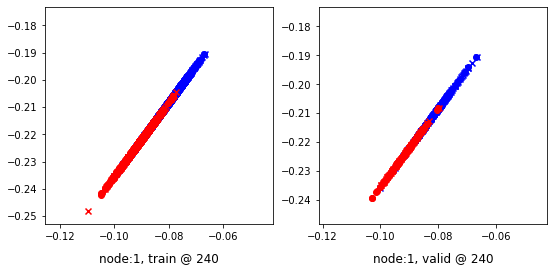

Aggregating on epoch: 243...
Aggregating on epoch: 246...
Aggregating on epoch: 249...
Aggregating on epoch: 252...
Aggregating on epoch: 255...
Aggregating on epoch: 258...
260 	 0 	 0.80675840 	 0.75223577 	 1.02136064 	 0.95870143 	 0.91804981 	 0.89961284


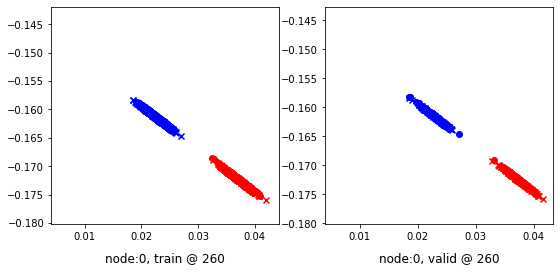

260 	 1 	 0.42270952 	 0.41773200 	 0.65540975 	 0.67644101 	 0.95306134 	 0.95185620


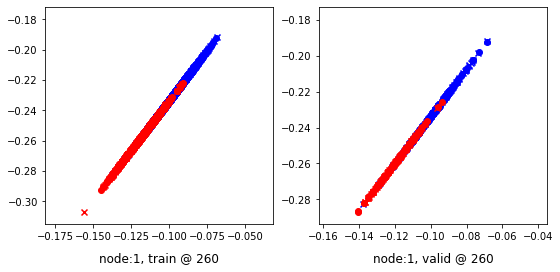

Aggregating on epoch: 261...
Aggregating on epoch: 264...
Aggregating on epoch: 267...
Aggregating on epoch: 270...
Aggregating on epoch: 273...
Aggregating on epoch: 276...
Aggregating on epoch: 279...
280 	 0 	 0.21249235 	 0.20699859 	 0.40494654 	 0.41310155 	 0.90418720 	 0.89925015


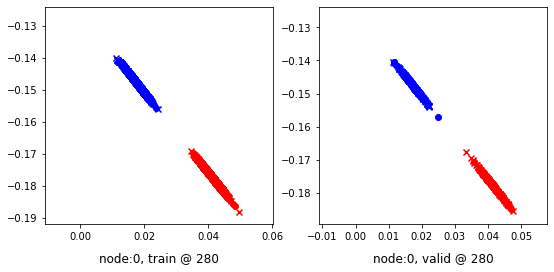

280 	 1 	 0.56730026 	 0.55541855 	 0.81564015 	 0.81424260 	 0.94432324 	 0.95197123


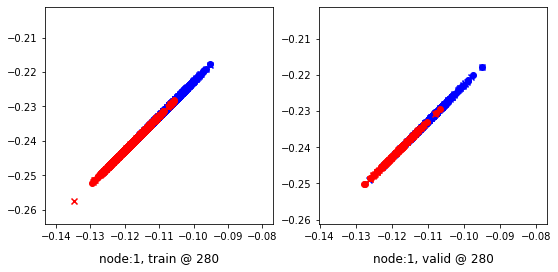

Aggregating on epoch: 282...
Aggregating on epoch: 285...
Aggregating on epoch: 288...
Aggregating on epoch: 291...
Aggregating on epoch: 294...
Aggregating on epoch: 297...
Aggregating on epoch: 300...
300 	 0 	 0.08972767 	 0.08570263 	 0.28246370 	 0.29183695 	 0.91854984 	 0.89928150


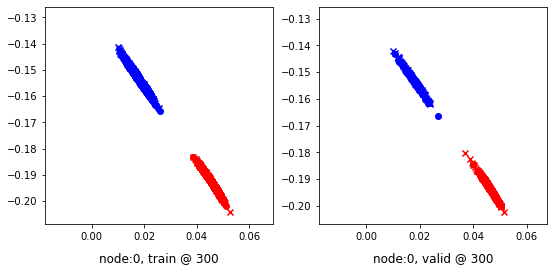

300 	 1 	 0.67526335 	 0.66034675 	 0.92696869 	 0.91897905 	 0.94945288 	 0.95177948


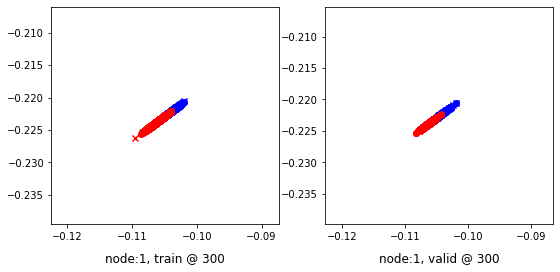

Aggregating on epoch: 303...
Aggregating on epoch: 306...
Aggregating on epoch: 309...
Aggregating on epoch: 312...
Aggregating on epoch: 315...
Aggregating on epoch: 318...
320 	 0 	 0.29906714 	 0.20055565 	 0.41762966 	 0.40672681 	 0.86751825 	 0.89931834


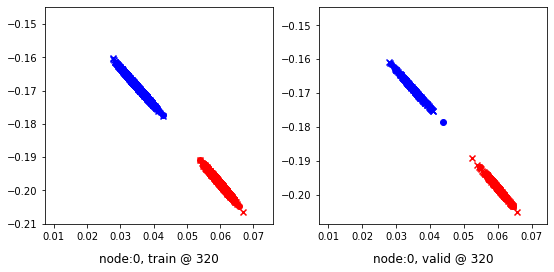

320 	 1 	 0.65366894 	 0.64487410 	 0.91223198 	 0.90331250 	 0.95379573 	 0.95158559


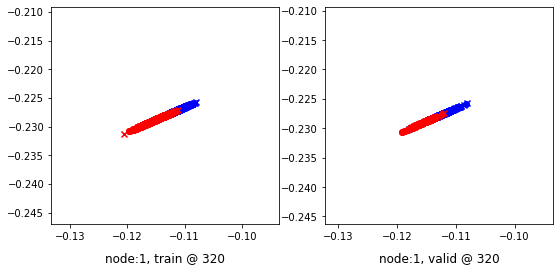

Aggregating on epoch: 321...
Aggregating on epoch: 324...
Aggregating on epoch: 327...
Aggregating on epoch: 330...
Aggregating on epoch: 333...
Aggregating on epoch: 336...
Aggregating on epoch: 339...
340 	 0 	 0.58990431 	 0.55878294 	 0.75882000 	 0.76504630 	 0.88067091 	 0.89941055


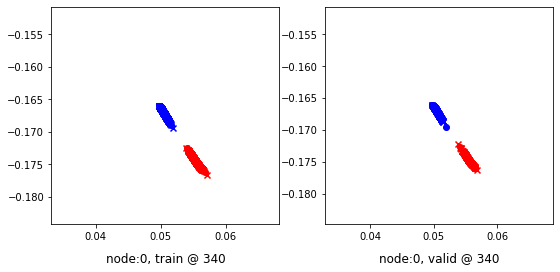

340 	 1 	 0.50568795 	 0.49842113 	 0.78071314 	 0.75557089 	 0.93807209 	 0.95029694


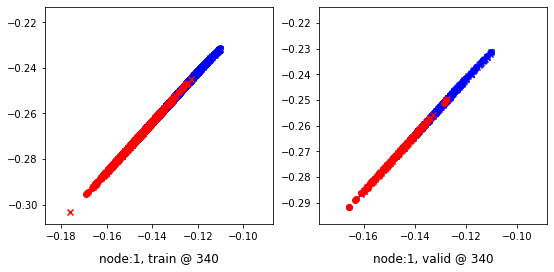

Aggregating on epoch: 342...
Aggregating on epoch: 345...
Aggregating on epoch: 348...
Aggregating on epoch: 351...
Aggregating on epoch: 354...
Aggregating on epoch: 357...
Aggregating on epoch: 360...
360 	 0 	 0.32014591 	 0.23580143 	 0.43842760 	 0.44186959 	 0.83293086 	 0.89921534


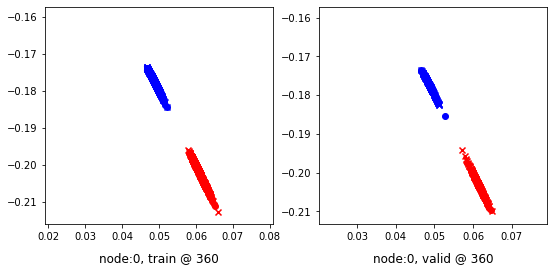

360 	 1 	 0.51967758 	 0.45929056 	 0.73001879 	 0.71711403 	 0.94881791 	 0.95097065


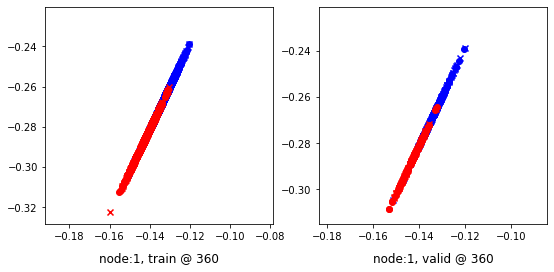

Aggregating on epoch: 363...
Aggregating on epoch: 366...
Aggregating on epoch: 369...
Aggregating on epoch: 372...
Aggregating on epoch: 375...
Aggregating on epoch: 378...
380 	 0 	 0.52172709 	 0.48604947 	 0.70452338 	 0.69227242 	 0.89103776 	 0.89937013


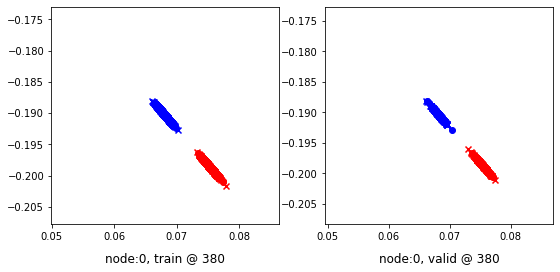

380 	 1 	 0.53925663 	 0.52216560 	 0.79275131 	 0.78071266 	 0.95067638 	 0.95169425


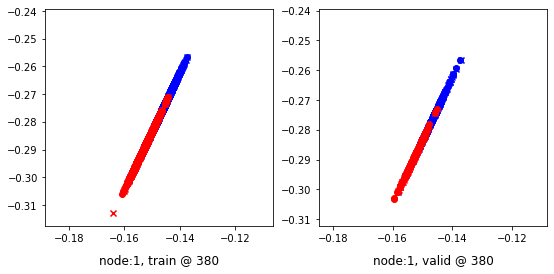

Aggregating on epoch: 381...
Aggregating on epoch: 384...
Aggregating on epoch: 387...
Aggregating on epoch: 390...
Aggregating on epoch: 393...
Aggregating on epoch: 396...
Aggregating on epoch: 399...
400 	 0 	 0.16317236 	 0.12613791 	 0.32570499 	 0.33242905 	 0.87719625 	 0.89943832


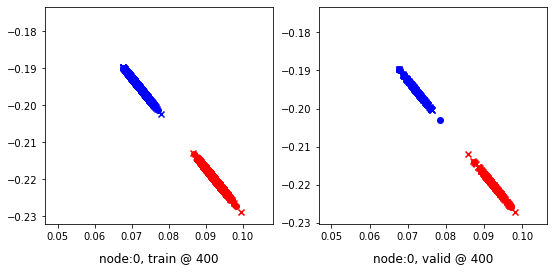

400 	 1 	 0.67370427 	 0.67209578 	 0.93516529 	 0.93060780 	 0.95513165 	 0.95165920


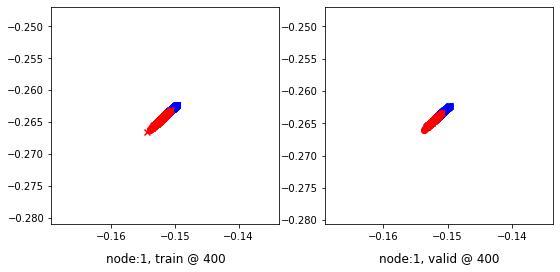

Aggregating on epoch: 402...
Aggregating on epoch: 405...
Aggregating on epoch: 408...
Aggregating on epoch: 411...
Aggregating on epoch: 414...
Aggregating on epoch: 417...
Aggregating on epoch: 420...
420 	 0 	 -0.09937384 	 -0.08013031 	 0.11448839 	 0.12616697 	 0.91455734 	 0.89944446


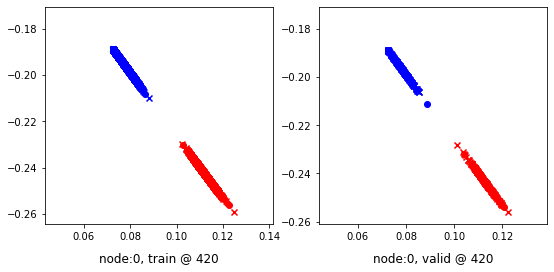

420 	 1 	 0.65930927 	 0.64069021 	 0.89763904 	 0.89917517 	 0.94203913 	 0.95163214


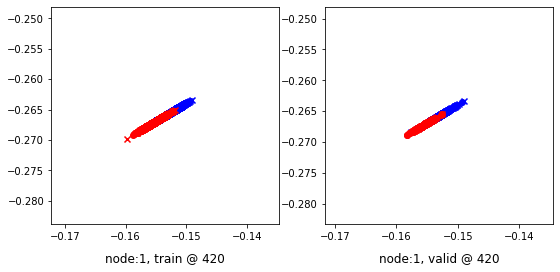

Aggregating on epoch: 423...
Aggregating on epoch: 426...
Aggregating on epoch: 429...
Aggregating on epoch: 432...
Aggregating on epoch: 435...
Aggregating on epoch: 438...
440 	 0 	 0.51905930 	 0.53056687 	 0.73575354 	 0.73686546 	 0.92532980 	 0.89944577


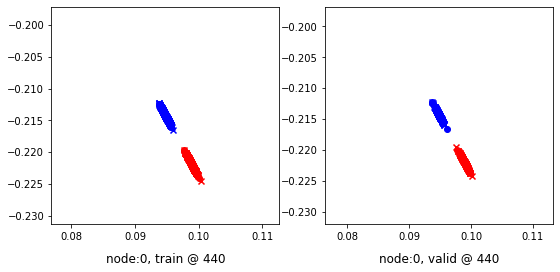

440 	 1 	 0.47635162 	 0.48344624 	 0.72592187 	 0.74048042 	 0.95254433 	 0.95018137


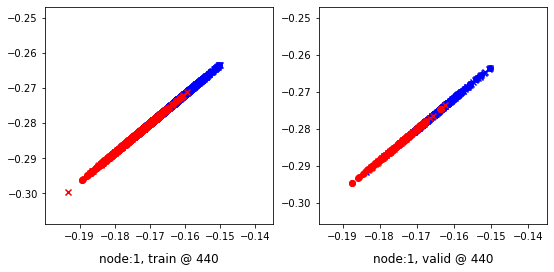

Aggregating on epoch: 441...
Aggregating on epoch: 444...
Aggregating on epoch: 447...
Aggregating on epoch: 450...
Aggregating on epoch: 453...
Aggregating on epoch: 456...
Aggregating on epoch: 459...
460 	 0 	 0.27839214 	 0.33271617 	 0.51708198 	 0.53902113 	 0.92883450 	 0.89945215


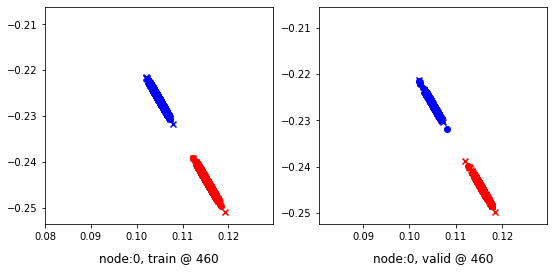

460 	 1 	 0.41139477 	 0.42765170 	 0.68526947 	 0.68593079 	 0.94659138 	 0.95142627


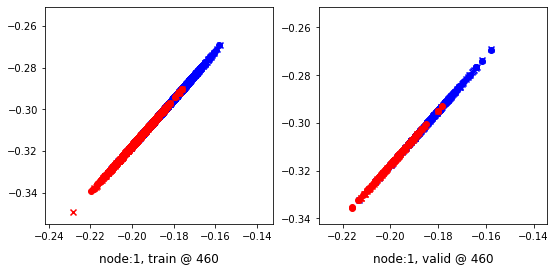

Aggregating on epoch: 462...
Aggregating on epoch: 465...
Aggregating on epoch: 468...
Aggregating on epoch: 471...
Aggregating on epoch: 474...
Aggregating on epoch: 477...
Aggregating on epoch: 480...
480 	 0 	 0.45512480 	 0.37474060 	 0.57569176 	 0.58101976 	 0.87054849 	 0.89942634


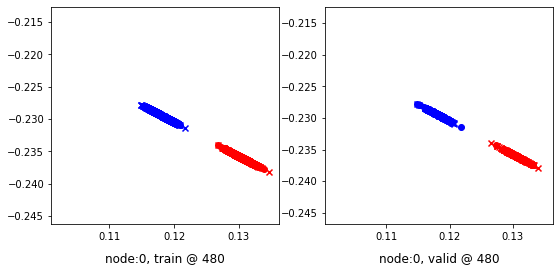

480 	 1 	 0.43701869 	 0.39568907 	 0.68324989 	 0.65387231 	 0.95610654 	 0.95133042


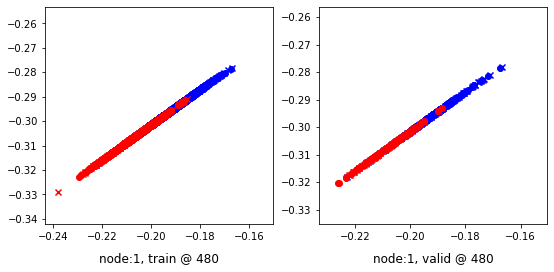

Aggregating on epoch: 483...
Aggregating on epoch: 486...
Aggregating on epoch: 489...
Aggregating on epoch: 492...
Aggregating on epoch: 495...
Aggregating on epoch: 498...
500 	 0 	 -0.05322284 	 -0.02947719 	 0.17050205 	 0.17678009 	 0.92497569 	 0.89940447


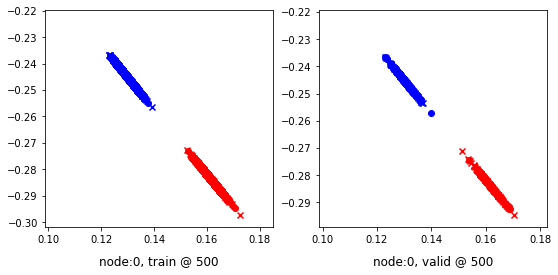

500 	 1 	 0.79956836 	 0.74100167 	 1.03237760 	 1.00008488 	 0.94319314 	 0.95223039


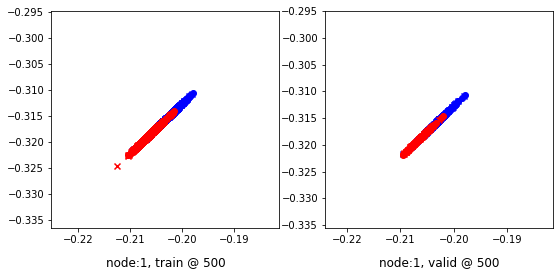

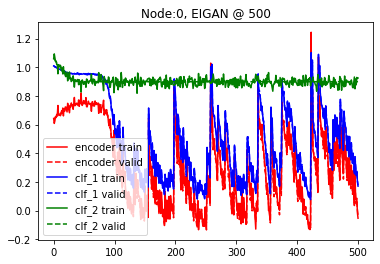

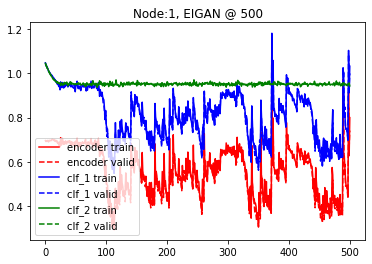

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.2 and delta=5
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.70674062 	 0.69562113 	 1.05211198 	 1.04996276 	 1.03880346 	 1.04748881


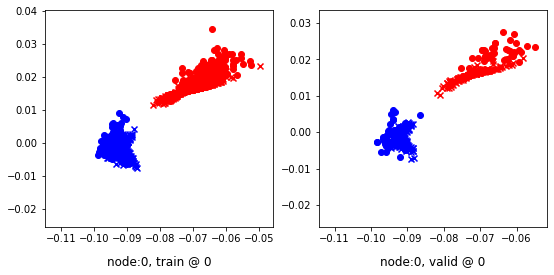

0 	 1 	 0.69147730 	 0.69095373 	 1.05333030 	 1.05175543 	 1.05514085 	 1.05394888


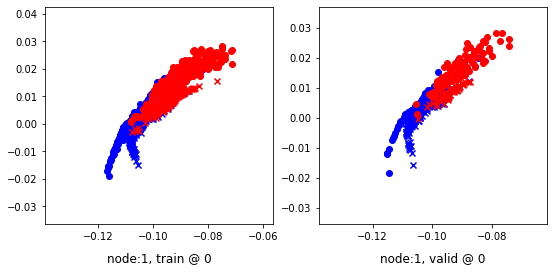

Aggregating on epoch: 5...
Aggregating on epoch: 10...
Aggregating on epoch: 15...
Aggregating on epoch: 20...
20 	 0 	 0.67478770 	 0.68449253 	 0.96269828 	 0.95842558 	 0.98155993 	 0.96708024


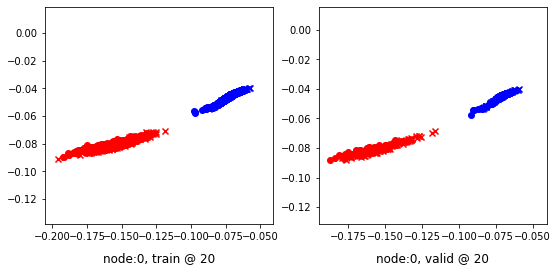

20 	 1 	 0.70063037 	 0.68268919 	 0.95770794 	 0.94569457 	 0.95027840 	 0.95615256


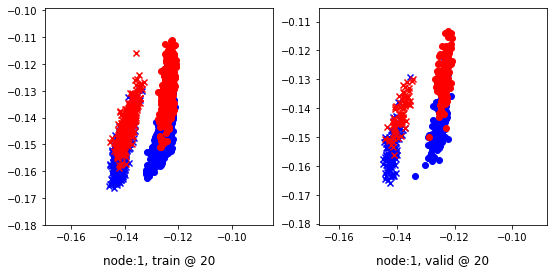

Aggregating on epoch: 25...
Aggregating on epoch: 30...
Aggregating on epoch: 35...
Aggregating on epoch: 40...
40 	 0 	 0.66946650 	 0.66790271 	 0.87791300 	 0.87763250 	 0.90501255 	 0.90287697


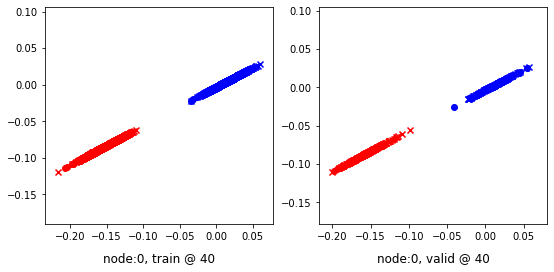

40 	 1 	 0.65074849 	 0.67843461 	 0.91585594 	 0.93738592 	 0.95858479 	 0.95209849


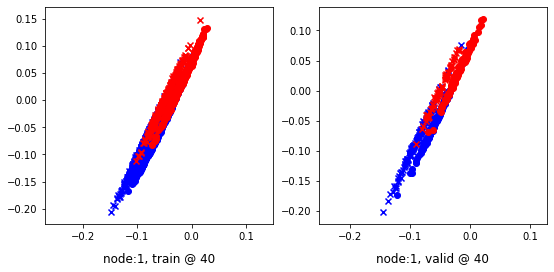

Aggregating on epoch: 45...
Aggregating on epoch: 50...
Aggregating on epoch: 55...
Aggregating on epoch: 60...
60 	 0 	 0.36357516 	 0.32280004 	 0.53272474 	 0.52943516 	 0.88441414 	 0.89978230


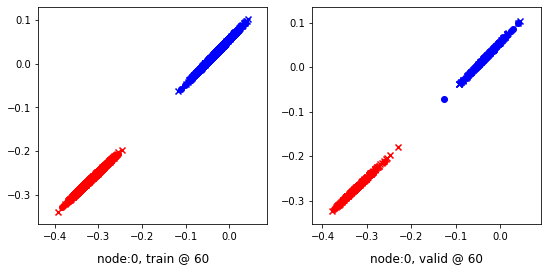

60 	 1 	 0.52584773 	 0.51882833 	 0.79090679 	 0.77902985 	 0.96137995 	 0.95334870


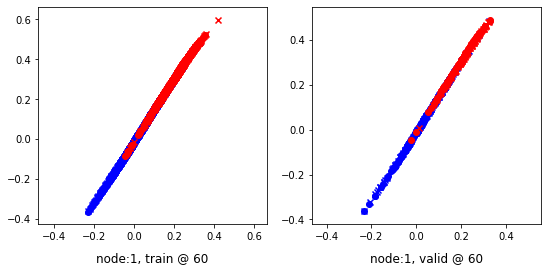

Aggregating on epoch: 65...
Aggregating on epoch: 70...
Aggregating on epoch: 75...
Aggregating on epoch: 80...
80 	 0 	 0.05340496 	 0.01583958 	 0.21575196 	 0.22230989 	 0.87053078 	 0.89961749


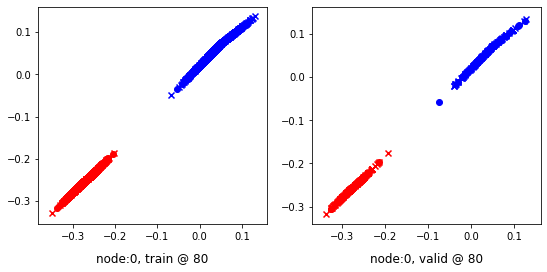

80 	 1 	 0.77669162 	 0.59964114 	 0.91544873 	 0.86064035 	 0.95728266 	 0.95414639


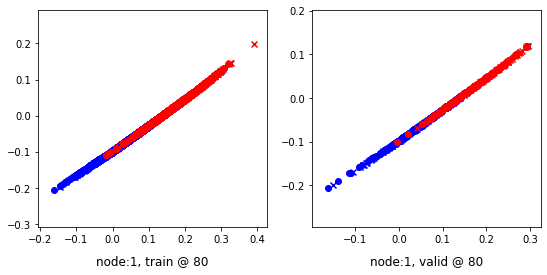

Aggregating on epoch: 85...
Aggregating on epoch: 90...
Aggregating on epoch: 95...
Aggregating on epoch: 100...
100 	 0 	 0.42681086 	 0.42885858 	 0.62643057 	 0.63446879 	 0.91399312 	 0.89875740


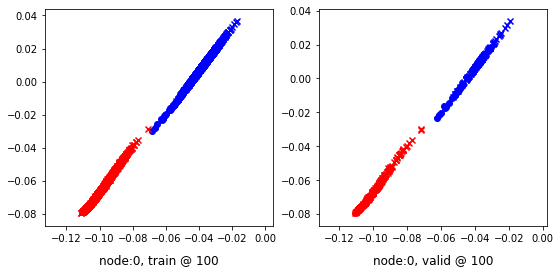

100 	 1 	 0.59738046 	 0.55656397 	 0.85109174 	 0.81511921 	 0.94944757 	 0.95170242


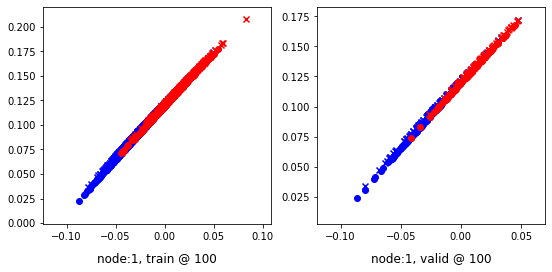

Aggregating on epoch: 105...
Aggregating on epoch: 110...
Aggregating on epoch: 115...
Aggregating on epoch: 120...
120 	 0 	 0.10193139 	 0.08464530 	 0.28231290 	 0.28974321 	 0.89359003 	 0.89824510


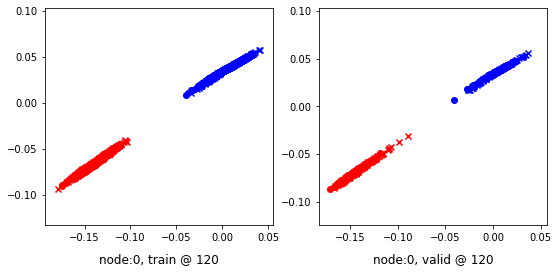

120 	 1 	 0.48244315 	 0.47284436 	 0.72799194 	 0.73199916 	 0.94679481 	 0.95230198


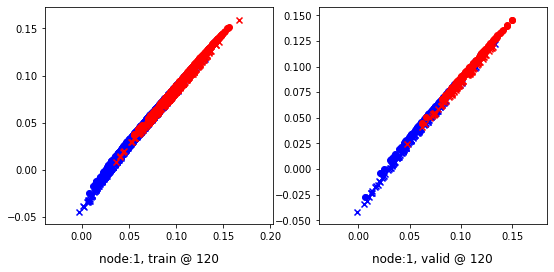

Aggregating on epoch: 125...
Aggregating on epoch: 130...
Aggregating on epoch: 135...
Aggregating on epoch: 140...
140 	 0 	 -0.05979292 	 -0.08057919 	 0.11638124 	 0.12563798 	 0.87829888 	 0.89936435


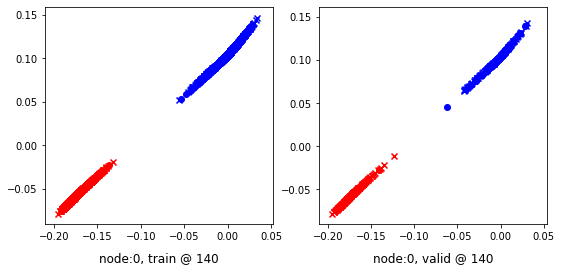

140 	 1 	 0.43739849 	 0.43032652 	 0.69533503 	 0.68876725 	 0.96139747 	 0.95158792


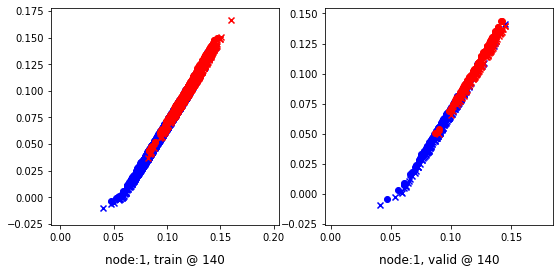

Aggregating on epoch: 145...
Aggregating on epoch: 150...
Aggregating on epoch: 155...
Aggregating on epoch: 160...
160 	 0 	 -0.06893885 	 -0.05512558 	 0.14187862 	 0.14990754 	 0.93809205 	 0.89818031


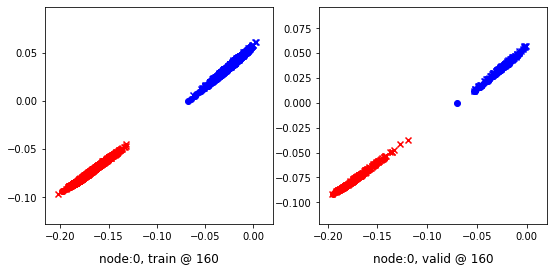

160 	 1 	 0.64995664 	 0.59467369 	 0.85961556 	 0.85285908 	 0.95969182 	 0.95133257


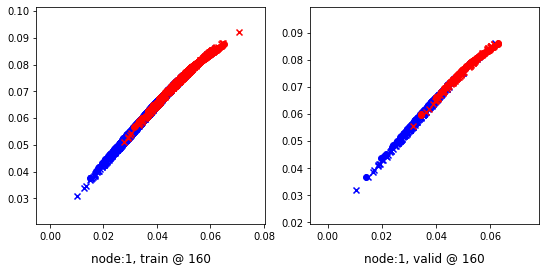

Aggregating on epoch: 165...
Aggregating on epoch: 170...
Aggregating on epoch: 175...
Aggregating on epoch: 180...
180 	 0 	 0.16049817 	 0.14143911 	 0.33959398 	 0.34736660 	 0.89594191 	 0.89907467


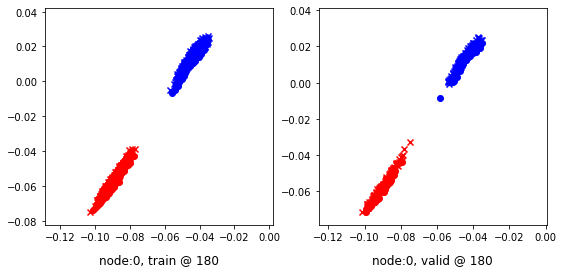

180 	 1 	 0.64889652 	 0.65402853 	 0.90880442 	 0.91284990 	 0.95732969 	 0.95196855


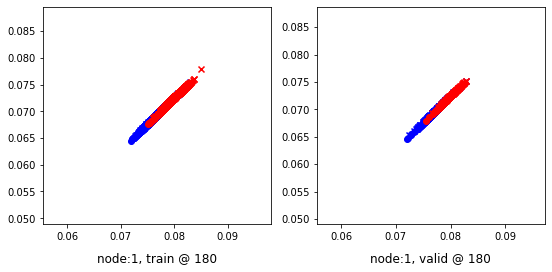

Aggregating on epoch: 185...
Aggregating on epoch: 190...
Aggregating on epoch: 195...
Aggregating on epoch: 200...
200 	 0 	 0.11896688 	 0.08781531 	 0.28300649 	 0.29452929 	 0.87943655 	 0.89986116


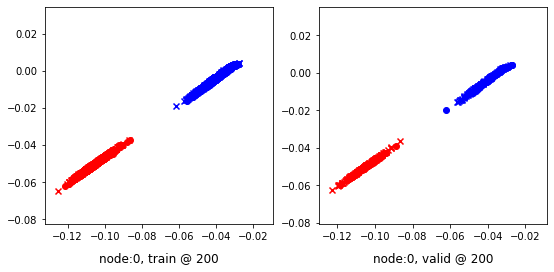

200 	 1 	 0.44075114 	 0.43109536 	 0.70065272 	 0.68916798 	 0.95090657 	 0.95121980


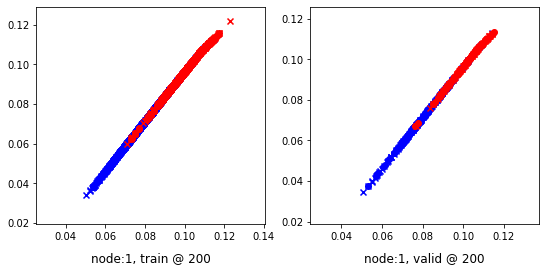

Aggregating on epoch: 205...
Aggregating on epoch: 210...
Aggregating on epoch: 215...
Aggregating on epoch: 220...
220 	 0 	 0.07837963 	 0.03091110 	 0.22826828 	 0.23681380 	 0.86363566 	 0.89904988


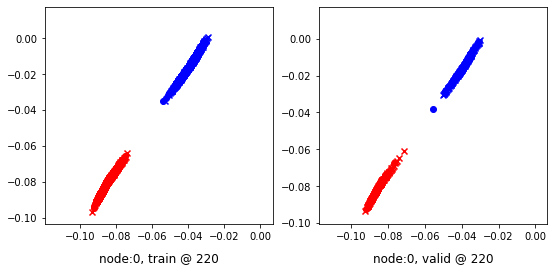

220 	 1 	 0.48910207 	 0.48772287 	 0.74467295 	 0.74735141 	 0.95744807 	 0.95277572


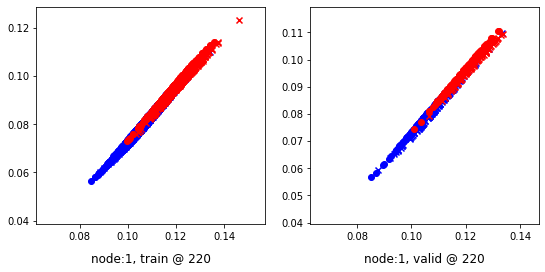

Aggregating on epoch: 225...
Aggregating on epoch: 230...
Aggregating on epoch: 235...
Aggregating on epoch: 240...
240 	 0 	 0.62865299 	 0.60649294 	 0.81163305 	 0.81272280 	 0.89087147 	 0.89937705


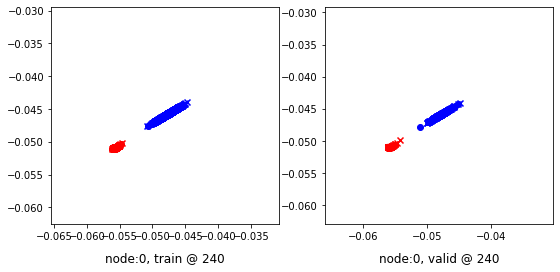

240 	 1 	 0.50128216 	 0.49988878 	 0.75824010 	 0.75821853 	 0.96247303 	 0.95147693


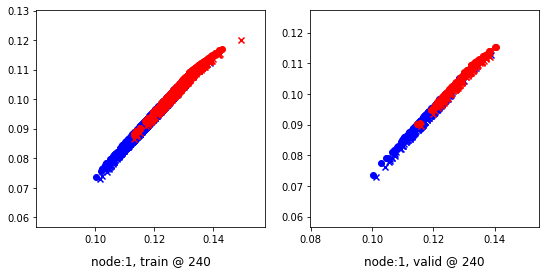

Aggregating on epoch: 245...
Aggregating on epoch: 250...
Aggregating on epoch: 255...
Aggregating on epoch: 260...
260 	 0 	 0.64337611 	 0.54064381 	 0.77367800 	 0.74644196 	 0.88374817 	 0.89894533


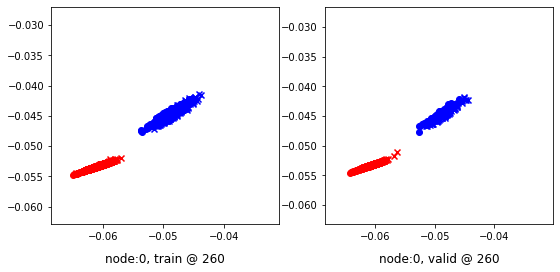

260 	 1 	 0.61955571 	 0.59271550 	 0.87500024 	 0.85112733 	 0.95396990 	 0.95155901


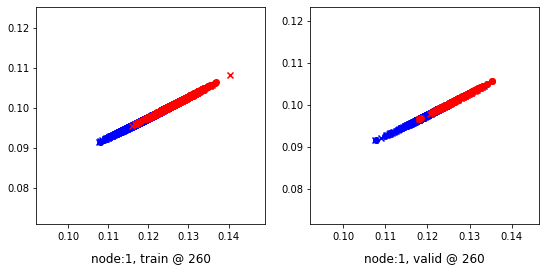

Aggregating on epoch: 265...
Aggregating on epoch: 270...
Aggregating on epoch: 275...
Aggregating on epoch: 280...
280 	 0 	 0.18230334 	 0.19331235 	 0.39534563 	 0.39926213 	 0.93667597 	 0.89909697


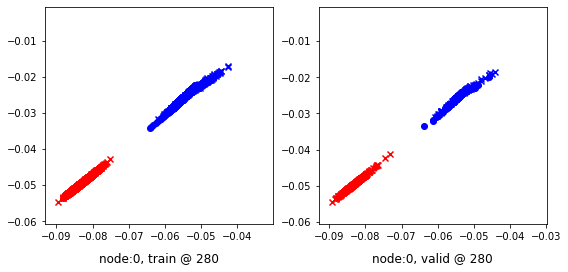

280 	 1 	 0.54519451 	 0.54922837 	 0.79459226 	 0.80707461 	 0.95251548 	 0.95099342


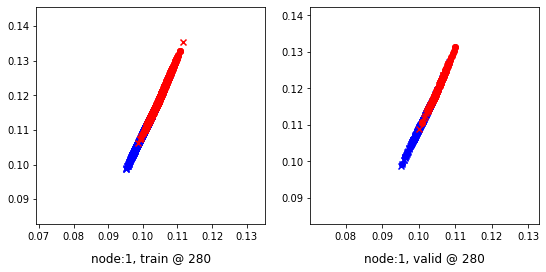

Aggregating on epoch: 285...
Aggregating on epoch: 290...
Aggregating on epoch: 295...
Aggregating on epoch: 300...
300 	 0 	 0.08274332 	 0.05724996 	 0.26057562 	 0.26322454 	 0.92125368 	 0.89912176


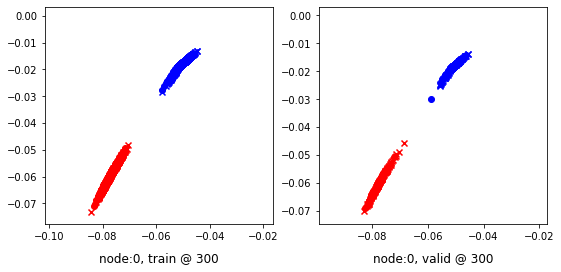

300 	 1 	 0.39714068 	 0.38998944 	 0.63260698 	 0.64781648 	 0.94571626 	 0.95097423


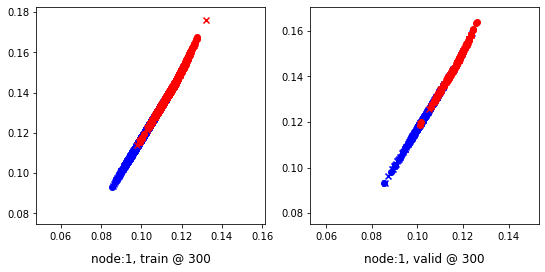

Aggregating on epoch: 305...
Aggregating on epoch: 310...
Aggregating on epoch: 315...
Aggregating on epoch: 320...
320 	 0 	 -0.06096296 	 -0.04128036 	 0.15296842 	 0.16529980 	 0.91474175 	 0.89972734


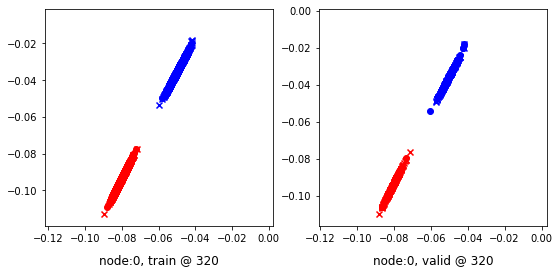

320 	 1 	 0.64580828 	 0.54050779 	 0.82510942 	 0.79853231 	 0.94746673 	 0.95117170


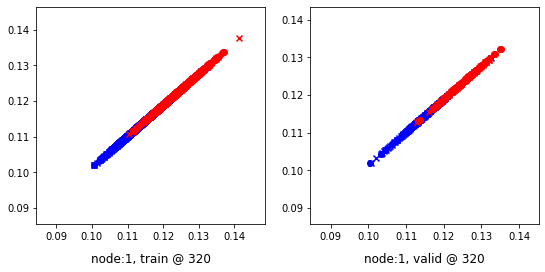

Aggregating on epoch: 325...
Aggregating on epoch: 330...
Aggregating on epoch: 335...
Aggregating on epoch: 340...
340 	 0 	 1.26916885 	 1.01003337 	 1.26881671 	 1.21623063 	 0.88715851 	 0.89934438


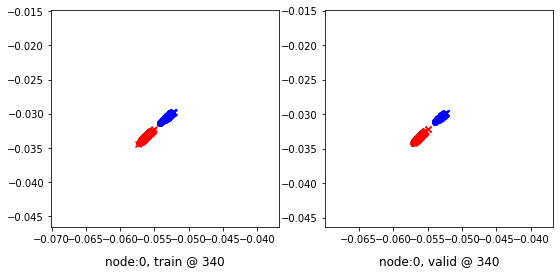

340 	 1 	 0.52821159 	 0.45448780 	 0.73534805 	 0.71186882 	 0.94041324 	 0.95052820


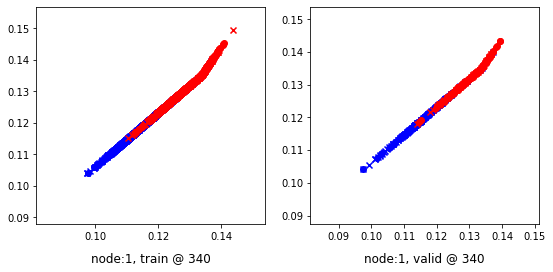

Aggregating on epoch: 345...
Aggregating on epoch: 350...
Aggregating on epoch: 355...
Aggregating on epoch: 360...
360 	 0 	 0.20965627 	 0.17170712 	 0.37038338 	 0.37776449 	 0.88036466 	 0.89920455


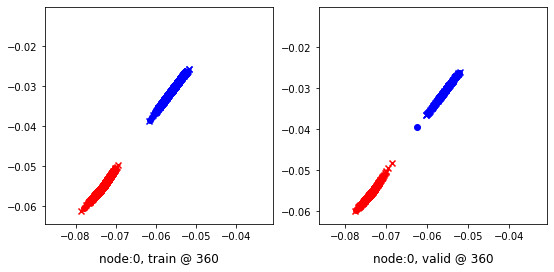

360 	 1 	 0.50269312 	 0.49301404 	 0.75188458 	 0.75020415 	 0.95723873 	 0.95033729


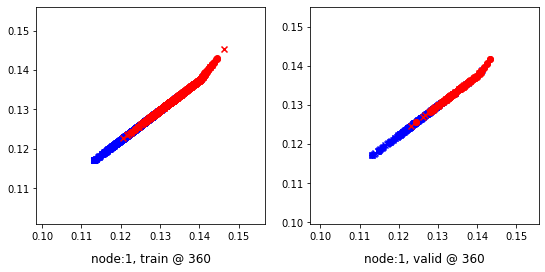

Aggregating on epoch: 365...
Aggregating on epoch: 370...
Aggregating on epoch: 375...
Aggregating on epoch: 380...
380 	 0 	 -0.04043588 	 -0.06410305 	 0.13852197 	 0.14178725 	 0.90783393 	 0.89903748


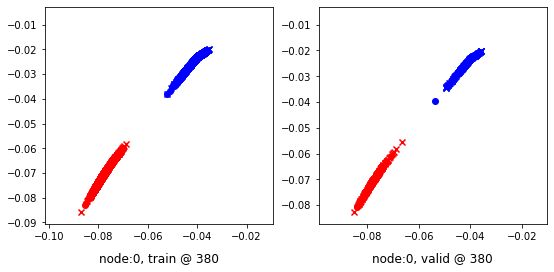

380 	 1 	 0.45573467 	 0.41528279 	 0.69504547 	 0.67329997 	 0.94067800 	 0.95116436


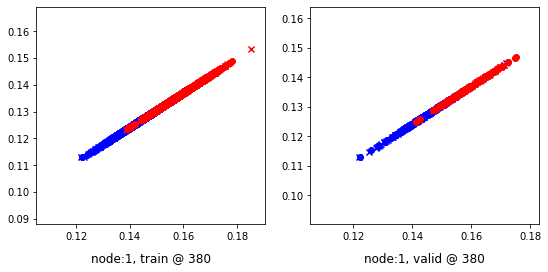

Aggregating on epoch: 385...
Aggregating on epoch: 390...
Aggregating on epoch: 395...
Aggregating on epoch: 400...
400 	 0 	 0.85382026 	 0.73766613 	 0.99449694 	 0.94361311 	 0.90430206 	 0.89909416


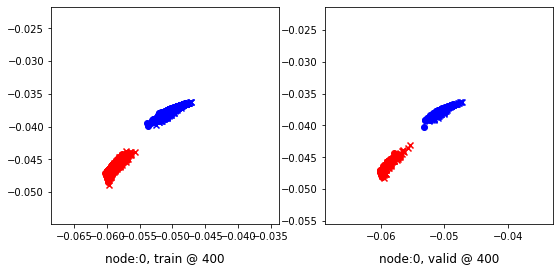

400 	 1 	 0.64881444 	 0.65214384 	 0.90137684 	 0.91040140 	 0.95034707 	 0.95140475


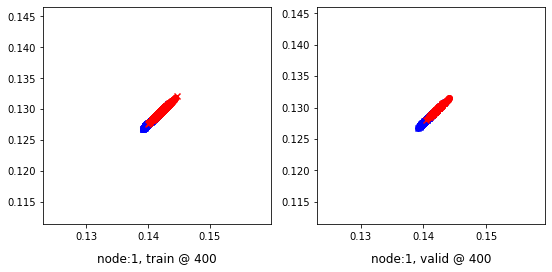

Aggregating on epoch: 405...
Aggregating on epoch: 410...
Aggregating on epoch: 415...
Aggregating on epoch: 420...
420 	 0 	 0.26926139 	 0.16721374 	 0.36389819 	 0.37289274 	 0.82885379 	 0.89882618


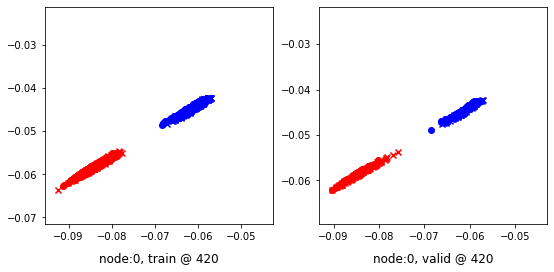

420 	 1 	 0.46057504 	 0.44212198 	 0.70586073 	 0.69912505 	 0.95322543 	 0.95015025


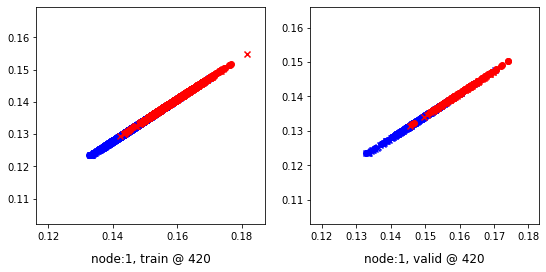

Aggregating on epoch: 425...
Aggregating on epoch: 430...
Aggregating on epoch: 435...
Aggregating on epoch: 440...
440 	 0 	 0.53214264 	 0.49662042 	 0.69508451 	 0.70248014 	 0.87668413 	 0.89900690


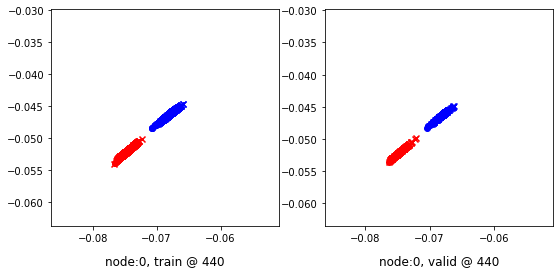

440 	 1 	 1.80948210 	 1.43762040 	 1.92524612 	 1.69686747 	 0.95602602 	 0.95239425


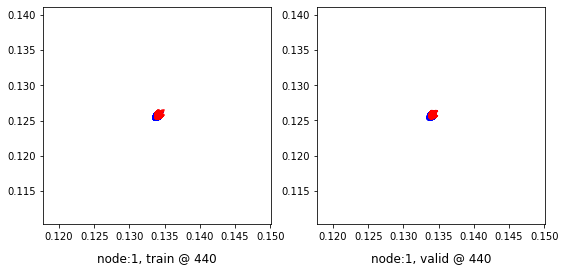

Aggregating on epoch: 445...
Aggregating on epoch: 450...
Aggregating on epoch: 455...
Aggregating on epoch: 460...
460 	 0 	 0.08252960 	 0.04978284 	 0.24848294 	 0.25571522 	 0.90366262 	 0.89907956


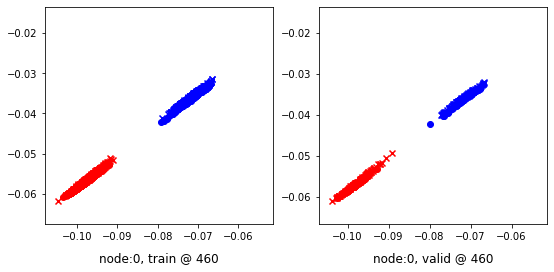

460 	 1 	 0.66119015 	 0.64208913 	 0.90940183 	 0.89945847 	 0.94464684 	 0.95051652


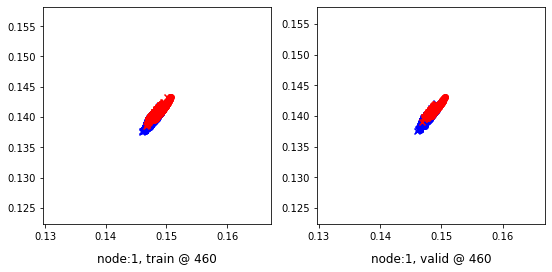

Aggregating on epoch: 465...
Aggregating on epoch: 470...
Aggregating on epoch: 475...
Aggregating on epoch: 480...
480 	 0 	 -0.07130103 	 -0.03790462 	 0.16664480 	 0.16818058 	 0.93561345 	 0.89923239


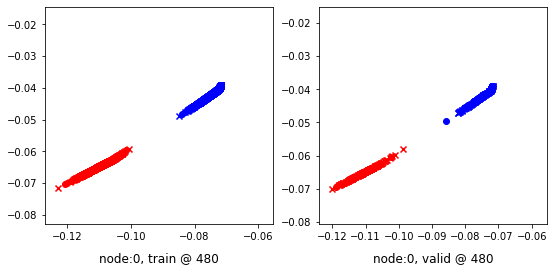

480 	 1 	 0.66505200 	 0.65242261 	 0.91712528 	 0.91131216 	 0.95652229 	 0.95203674


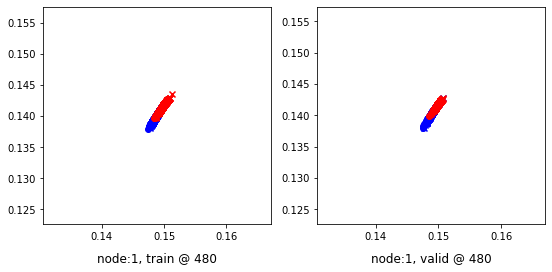

Aggregating on epoch: 485...
Aggregating on epoch: 490...
Aggregating on epoch: 495...
Aggregating on epoch: 500...
500 	 0 	 0.33746338 	 0.24401343 	 0.44917834 	 0.45003551 	 0.90759474 	 0.89916927


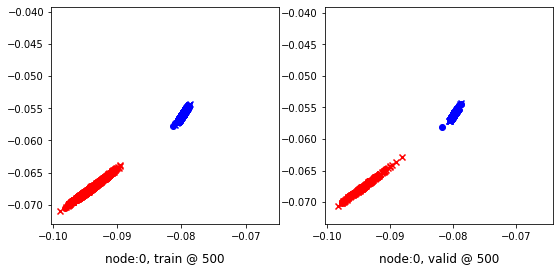

500 	 1 	 0.63724780 	 0.60145319 	 0.86526060 	 0.86046064 	 0.94483632 	 0.95215464


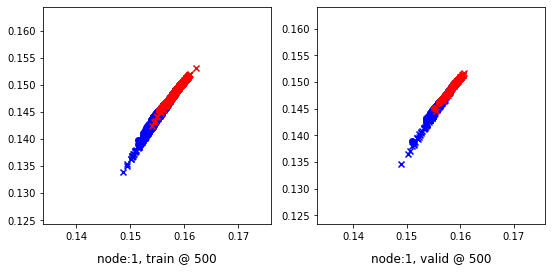

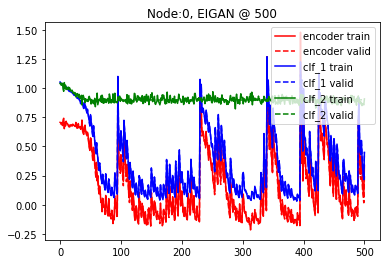

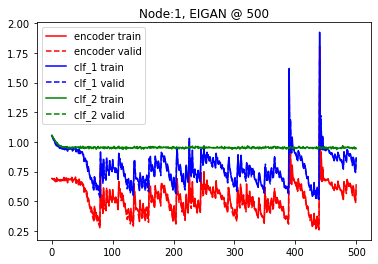

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.2 and delta=7
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.60791421 	 0.62347162 	 1.00221574 	 1.00072348 	 1.08766806 	 1.07039905


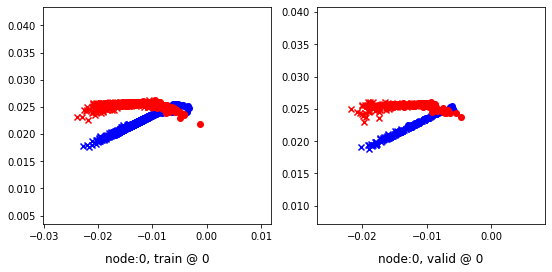

0 	 1 	 0.70460200 	 0.70431459 	 1.04863250 	 1.03663695 	 1.03725100 	 1.02546954


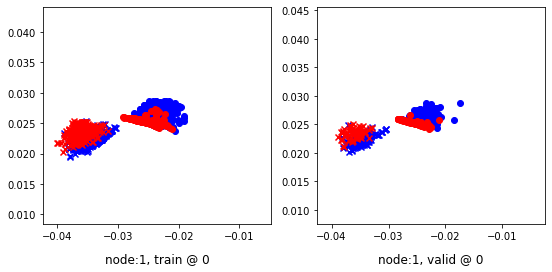

Aggregating on epoch: 7...
Aggregating on epoch: 14...
20 	 0 	 0.68804920 	 0.68631935 	 0.95299530 	 0.95288670 	 0.95816249 	 0.95971453


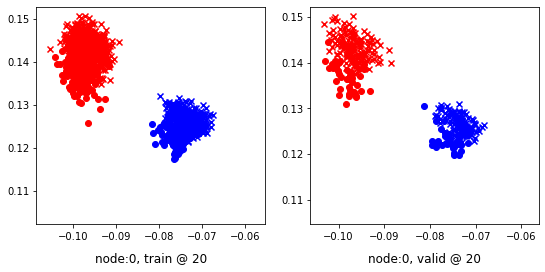

20 	 1 	 0.65464288 	 0.68314290 	 0.93579185 	 0.94559461 	 0.97432882 	 0.95559889


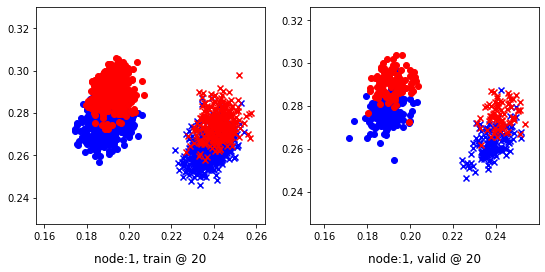

Aggregating on epoch: 21...
Aggregating on epoch: 28...
Aggregating on epoch: 35...
40 	 0 	 0.75899702 	 0.72716850 	 0.93564492 	 0.93710023 	 0.87078160 	 0.90307891


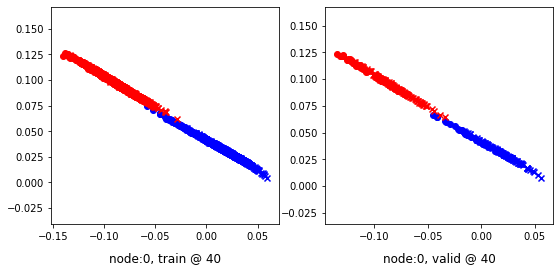

40 	 1 	 0.68900681 	 0.68631923 	 0.94100267 	 0.94503868 	 0.94515061 	 0.95186663


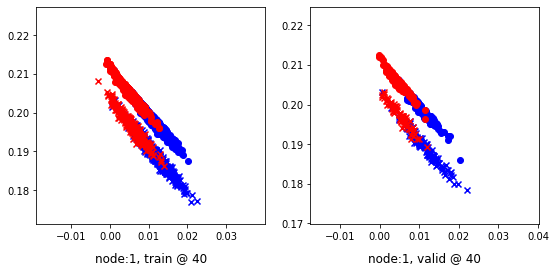

Aggregating on epoch: 42...
Aggregating on epoch: 49...
Aggregating on epoch: 56...
60 	 0 	 0.30416417 	 0.29848158 	 0.51457322 	 0.50416249 	 0.91507417 	 0.89882809


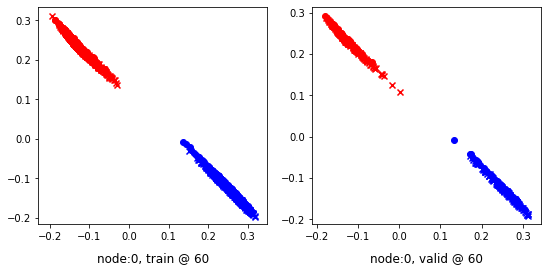

60 	 1 	 0.69678169 	 0.67385900 	 0.95285958 	 0.93254977 	 0.94961172 	 0.95183796


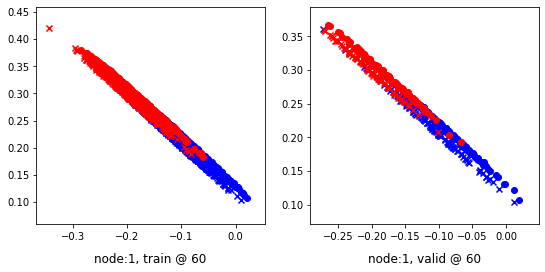

Aggregating on epoch: 63...
Aggregating on epoch: 70...
Aggregating on epoch: 77...
80 	 0 	 -0.08224091 	 -0.09386538 	 0.10823959 	 0.11185773 	 0.89189392 	 0.89887029


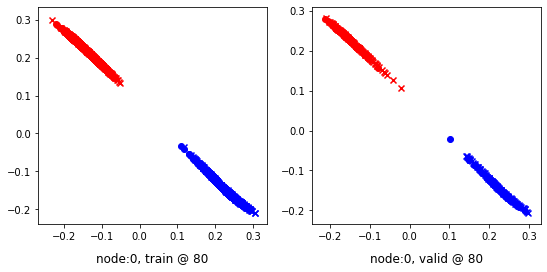

80 	 1 	 0.45236635 	 0.42597437 	 0.70735806 	 0.68434691 	 0.94844675 	 0.95151973


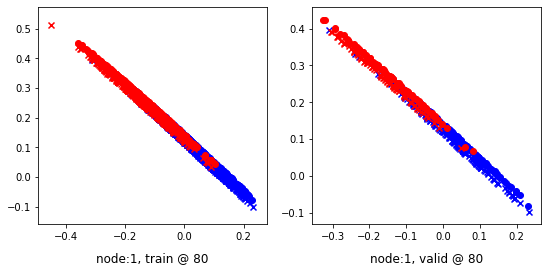

Aggregating on epoch: 84...
Aggregating on epoch: 91...
Aggregating on epoch: 98...
100 	 0 	 -0.05571149 	 -0.11910735 	 0.08249184 	 0.08783545 	 0.83316195 	 0.90008998


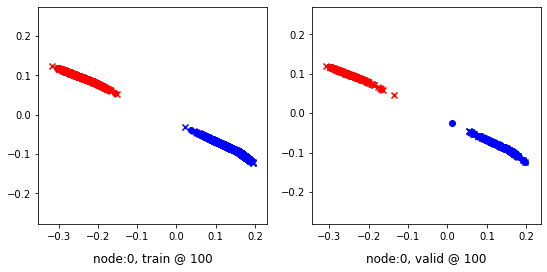

100 	 1 	 0.29531062 	 0.28919572 	 0.54652095 	 0.54534566 	 0.95080554 	 0.94929713


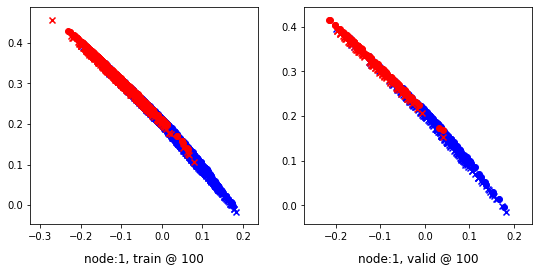

Aggregating on epoch: 105...
Aggregating on epoch: 112...
Aggregating on epoch: 119...
120 	 0 	 0.01063076 	 0.05553621 	 0.25636542 	 0.26168722 	 0.94925559 	 0.89929819


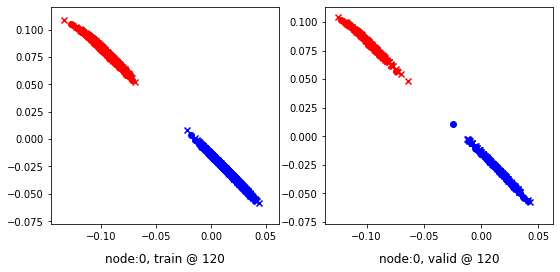

120 	 1 	 0.56610525 	 0.57405066 	 0.85635388 	 0.83381164 	 0.94126046 	 0.95290816


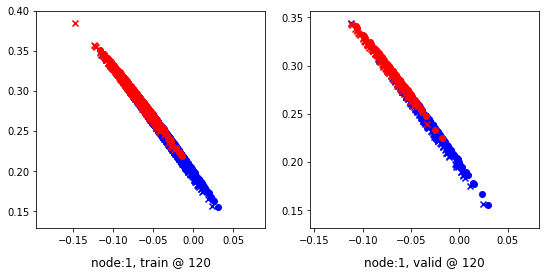

Aggregating on epoch: 126...
Aggregating on epoch: 133...
Aggregating on epoch: 140...
140 	 0 	 -0.12705961 	 -0.09694045 	 0.10518640 	 0.10898966 	 0.94266278 	 0.89907730


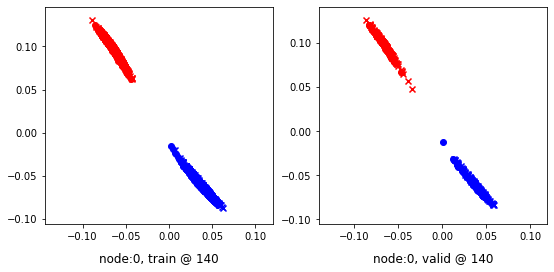

140 	 1 	 0.51901585 	 0.43614346 	 0.73897016 	 0.69532287 	 0.95115173 	 0.95232660


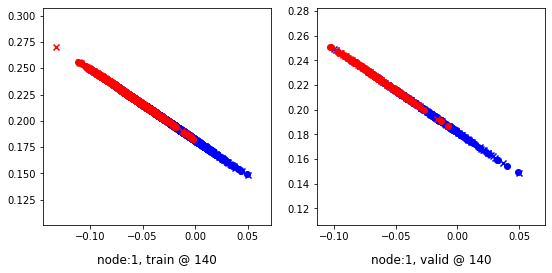

Aggregating on epoch: 147...
Aggregating on epoch: 154...
160 	 0 	 -0.10703317 	 -0.12430978 	 0.06807217 	 0.08138955 	 0.86834472 	 0.89884651


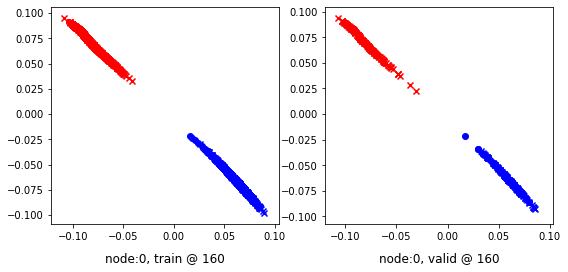

160 	 1 	 0.34542447 	 0.36302590 	 0.60557824 	 0.62110758 	 0.95052099 	 0.95122886


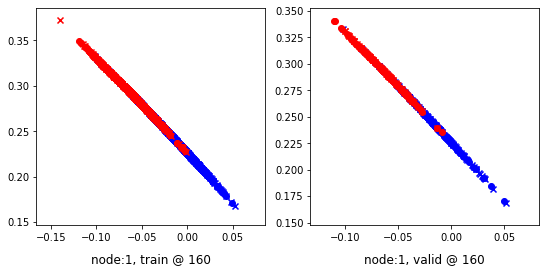

Aggregating on epoch: 161...
Aggregating on epoch: 168...
Aggregating on epoch: 175...
180 	 0 	 0.32319665 	 0.30558068 	 0.50416505 	 0.51172394 	 0.90463531 	 0.89929044


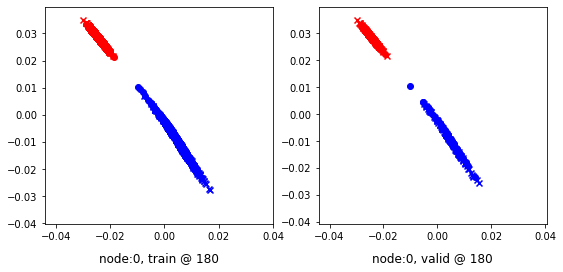

180 	 1 	 0.33844388 	 0.29487783 	 0.58680856 	 0.55265278 	 0.94177848 	 0.95092213


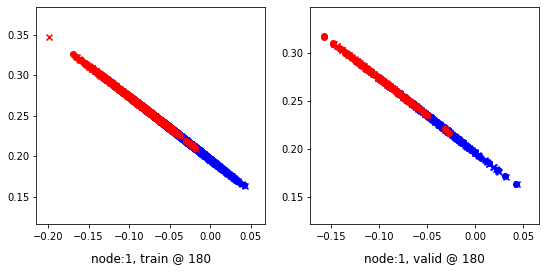

Aggregating on epoch: 182...
Aggregating on epoch: 189...
Aggregating on epoch: 196...
200 	 0 	 -0.09229049 	 -0.11482085 	 0.08974269 	 0.09098696 	 0.88398564 	 0.89895499


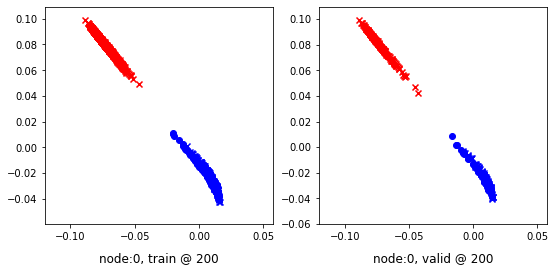

200 	 1 	 0.28764337 	 0.26362598 	 0.54129386 	 0.52198845 	 0.95048827 	 0.95150965


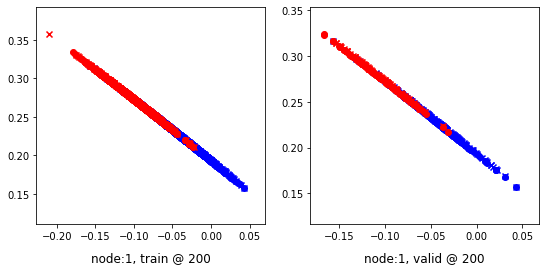

Aggregating on epoch: 203...
Aggregating on epoch: 210...
Aggregating on epoch: 217...
220 	 0 	 -0.08893624 	 -0.07206680 	 0.12572837 	 0.13452779 	 0.91840345 	 0.89974177


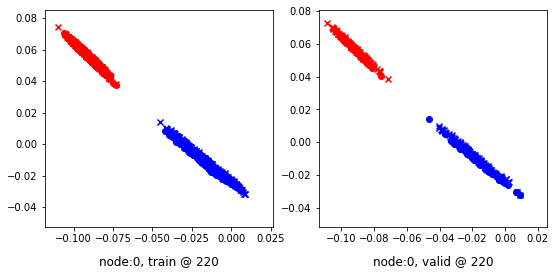

220 	 1 	 0.69316071 	 0.69271398 	 0.95243859 	 0.95310682 	 0.95246154 	 0.95354003


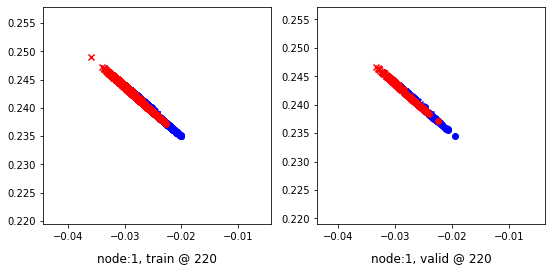

Aggregating on epoch: 224...
Aggregating on epoch: 231...
Aggregating on epoch: 238...
240 	 0 	 -0.08733517 	 -0.08652709 	 0.11407709 	 0.11963954 	 0.90656477 	 0.89931381


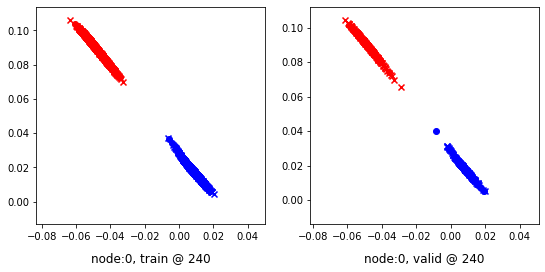

240 	 1 	 0.60076034 	 0.60165858 	 0.85610616 	 0.85936362 	 0.95235664 	 0.95085222


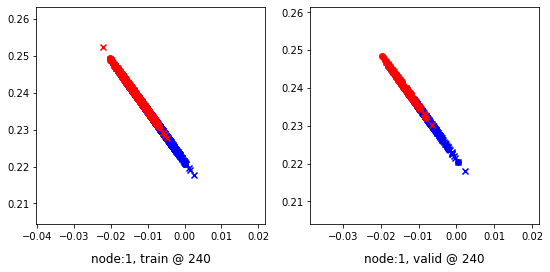

Aggregating on epoch: 245...
Aggregating on epoch: 252...
Aggregating on epoch: 259...
260 	 0 	 -0.11361153 	 -0.14023727 	 0.05965480 	 0.06611360 	 0.87067533 	 0.89949805


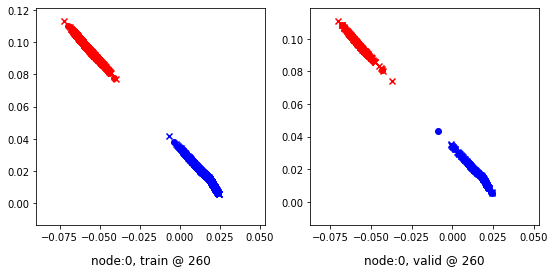

260 	 1 	 0.58120203 	 0.59453291 	 0.84679121 	 0.85358602 	 0.96192372 	 0.95220029


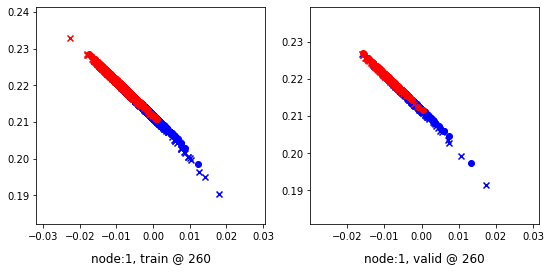

Aggregating on epoch: 266...
Aggregating on epoch: 273...
Aggregating on epoch: 280...
280 	 0 	 -0.13050476 	 -0.11716465 	 0.07938902 	 0.08914318 	 0.91787446 	 0.89945501


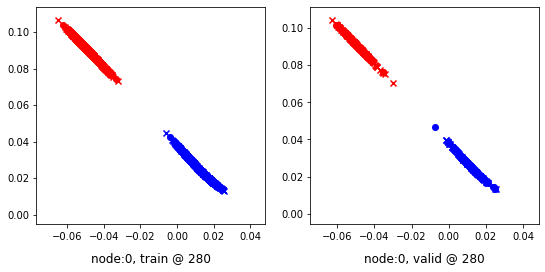

280 	 1 	 0.47096920 	 0.46239811 	 0.72559184 	 0.71567464 	 0.95009482 	 0.94642371


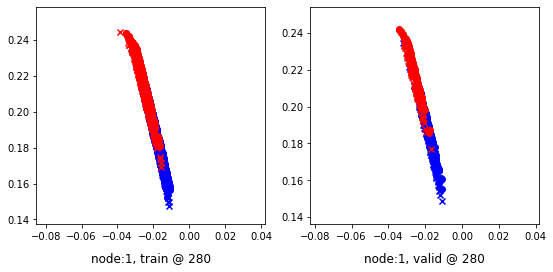

Aggregating on epoch: 287...
Aggregating on epoch: 294...
300 	 0 	 -0.23811397 	 -0.18477391 	 0.01824792 	 0.02120812 	 0.94999224 	 0.89912921


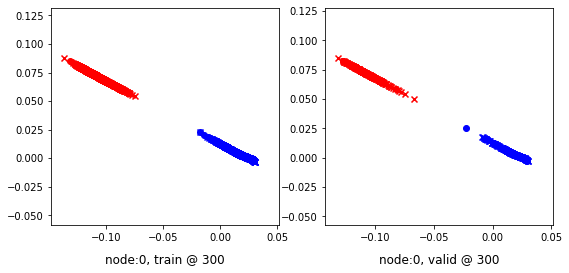

300 	 1 	 0.32069355 	 0.28830642 	 0.57358974 	 0.54648209 	 0.94897789 	 0.95132285


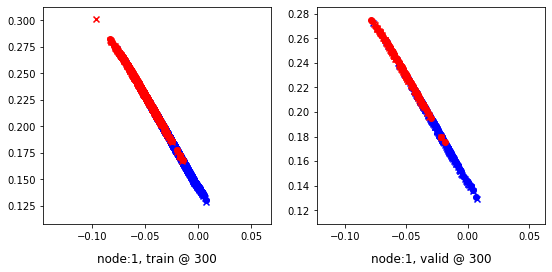

Aggregating on epoch: 301...
Aggregating on epoch: 308...
Aggregating on epoch: 315...
320 	 0 	 -0.18986185 	 -0.18407483 	 0.01927630 	 0.02204213 	 0.90387237 	 0.89926416


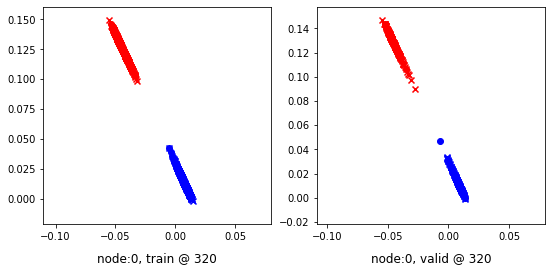

320 	 1 	 0.32441729 	 0.30261528 	 0.56855619 	 0.55999345 	 0.94215286 	 0.95052534


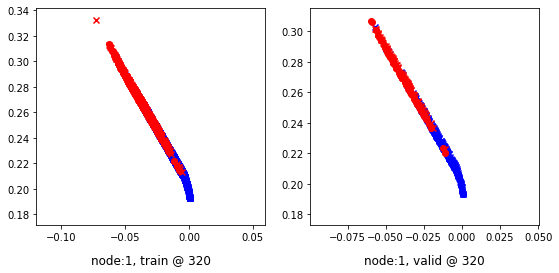

Aggregating on epoch: 322...
Aggregating on epoch: 329...
Aggregating on epoch: 336...
340 	 0 	 -0.13988134 	 -0.15250930 	 0.05043026 	 0.05385587 	 0.89122438 	 0.89951235


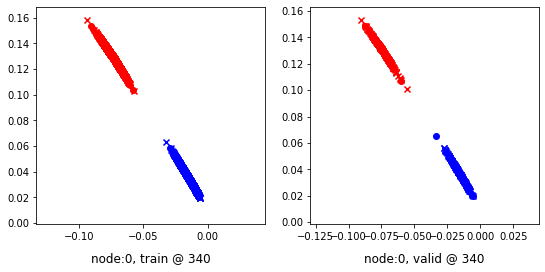

340 	 1 	 0.25750953 	 0.25843757 	 0.51888281 	 0.51572007 	 0.95408523 	 0.95042968


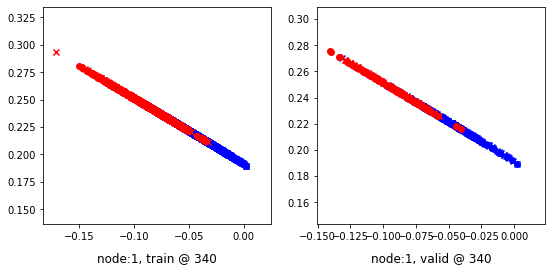

Aggregating on epoch: 343...
Aggregating on epoch: 350...
Aggregating on epoch: 357...
360 	 0 	 -0.09045737 	 -0.08550557 	 0.11361843 	 0.12075511 	 0.90446746 	 0.89940786


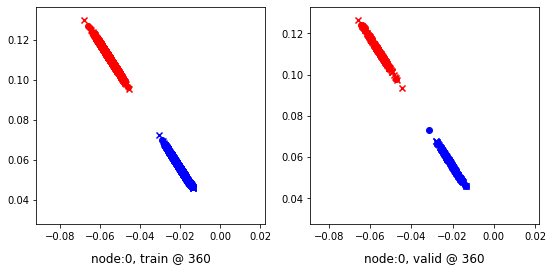

360 	 1 	 0.43458760 	 0.41424620 	 0.71021014 	 0.67313999 	 0.94212508 	 0.95204097


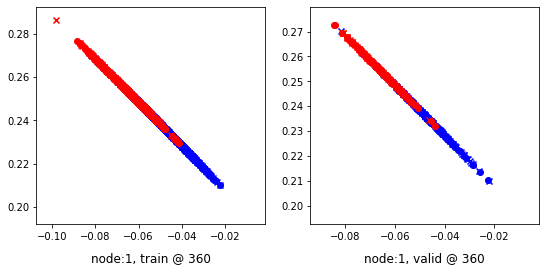

Aggregating on epoch: 364...
Aggregating on epoch: 371...
Aggregating on epoch: 378...
380 	 0 	 -0.11687671 	 -0.11677717 	 0.07576040 	 0.08953054 	 0.88478488 	 0.89945489


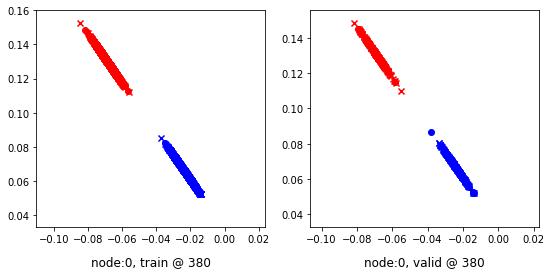

380 	 1 	 0.53609484 	 0.46007329 	 0.75196201 	 0.71942627 	 0.95650393 	 0.95250016


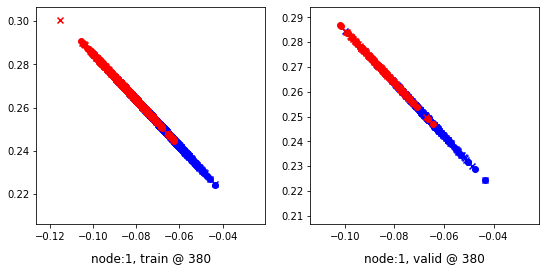

Aggregating on epoch: 385...
Aggregating on epoch: 392...
Aggregating on epoch: 399...
400 	 0 	 -0.11440579 	 -0.09601735 	 0.10415588 	 0.11032308 	 0.91813648 	 0.89948761


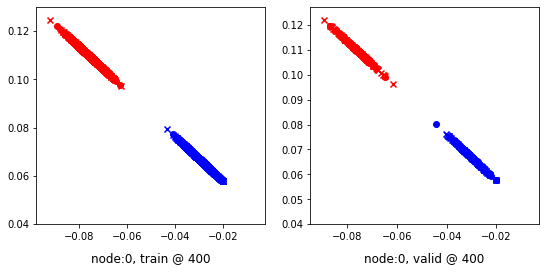

400 	 1 	 0.89781320 	 0.73536330 	 1.02911019 	 0.99442399 	 0.96205580 	 0.95220786


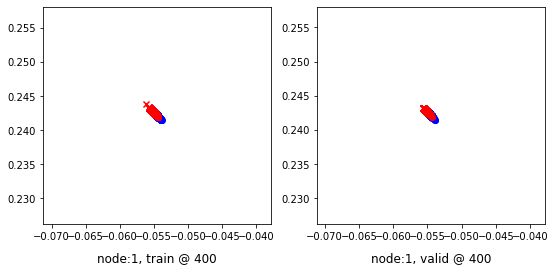

Aggregating on epoch: 406...
Aggregating on epoch: 413...
Aggregating on epoch: 420...
420 	 0 	 -0.11981613 	 -0.10570747 	 0.09987824 	 0.10059619 	 0.91927606 	 0.89945084


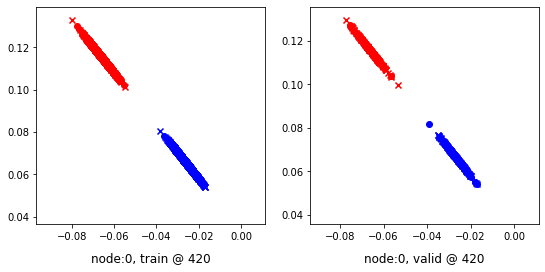

420 	 1 	 0.70762652 	 0.73183626 	 0.94887602 	 0.99076235 	 0.94910032 	 0.95207328


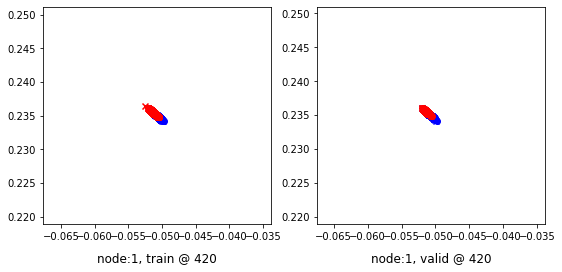

Aggregating on epoch: 427...
Aggregating on epoch: 434...
440 	 0 	 0.00376976 	 0.00531626 	 0.19693393 	 0.21155757 	 0.89428997 	 0.89938849


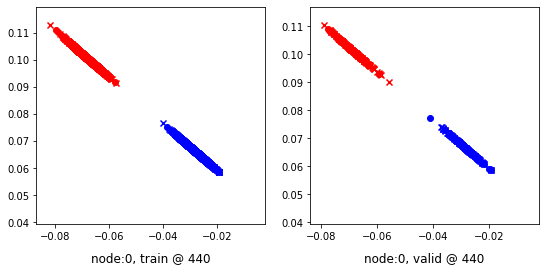

440 	 1 	 0.56862706 	 0.58735573 	 0.83444178 	 0.84559339 	 0.96090639 	 0.95138484


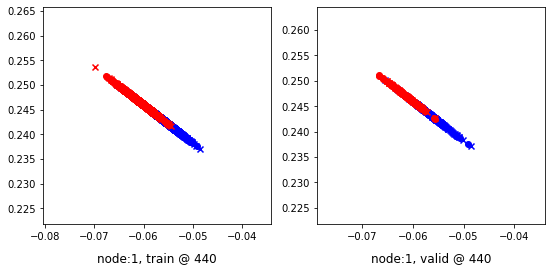

Aggregating on epoch: 441...
Aggregating on epoch: 448...
Aggregating on epoch: 455...
460 	 0 	 0.57272196 	 0.60702986 	 0.80606782 	 0.81326944 	 0.88400334 	 0.89938676


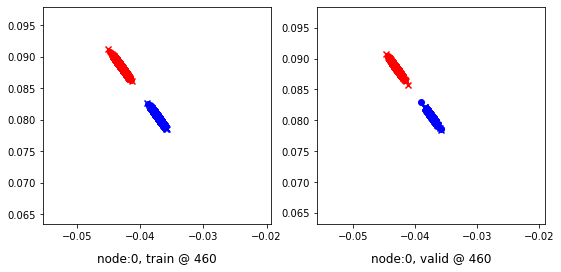

460 	 1 	 0.61423159 	 0.60464340 	 0.86810958 	 0.86313552 	 0.95224410 	 0.95163929


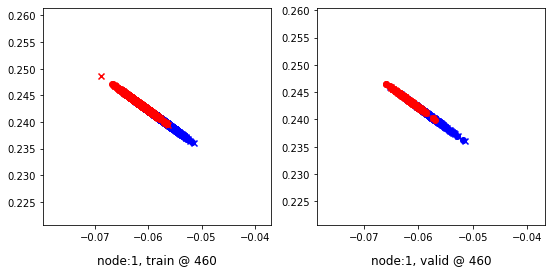

Aggregating on epoch: 462...
Aggregating on epoch: 469...
Aggregating on epoch: 476...
480 	 0 	 0.01937990 	 -0.00721100 	 0.19187826 	 0.19885704 	 0.88038945 	 0.89921522


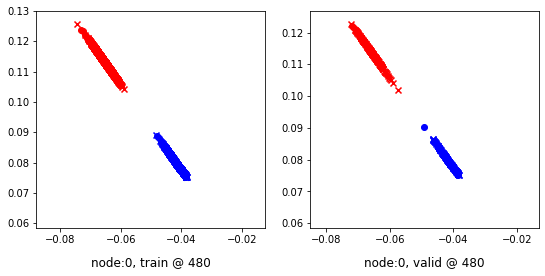

480 	 1 	 0.45484650 	 0.42784661 	 0.70741385 	 0.68476957 	 0.95742124 	 0.95007014


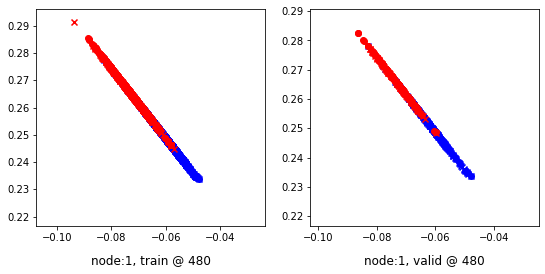

Aggregating on epoch: 483...
Aggregating on epoch: 490...
Aggregating on epoch: 497...
500 	 0 	 1.04319787 	 1.15428245 	 1.32313514 	 1.36054718 	 0.93873042 	 0.89941192


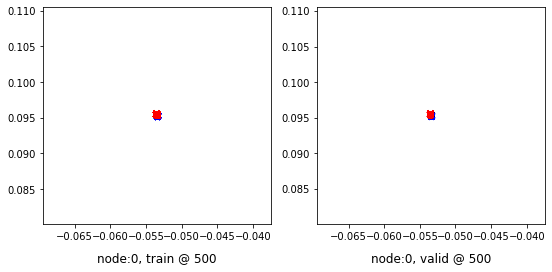

500 	 1 	 0.37177759 	 0.37165475 	 0.63852811 	 0.62878734 	 0.95564938 	 0.95027977


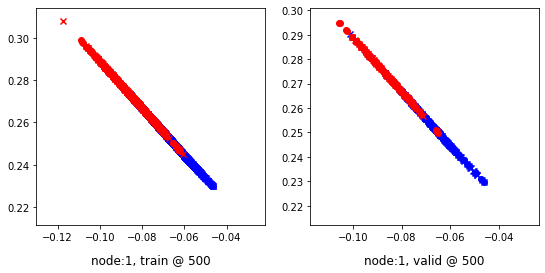

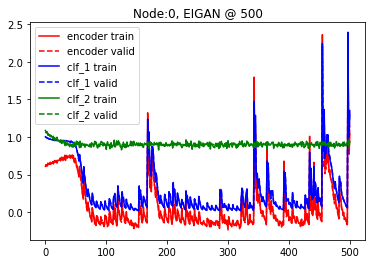

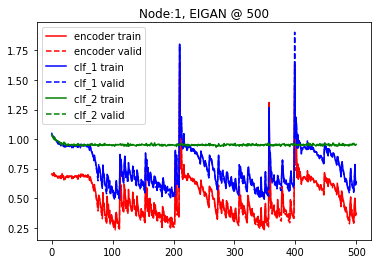

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.2 and delta=9
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.73655367 	 0.71404719 	 1.06161535 	 1.06112564 	 1.01848412 	 1.04022563


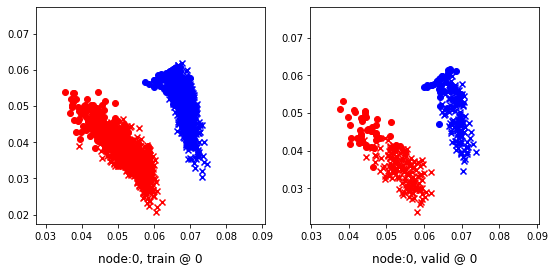

0 	 1 	 0.71674019 	 0.70868278 	 1.02297497 	 1.02502525 	 0.99950784 	 1.00948966


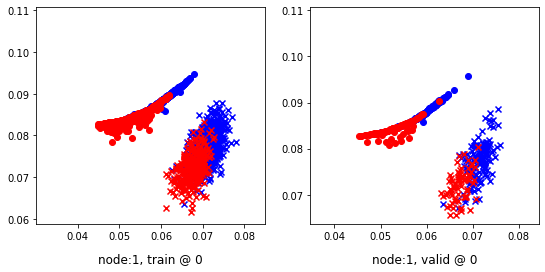

Aggregating on epoch: 9...
Aggregating on epoch: 18...
20 	 0 	 0.71790922 	 0.73091763 	 0.96372962 	 0.96645516 	 0.93918550 	 0.92868471


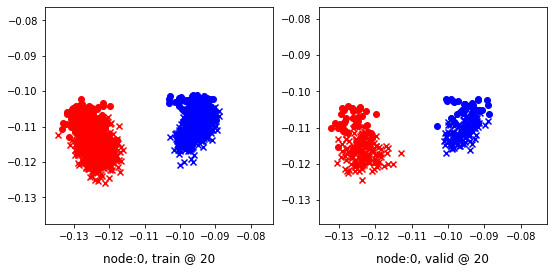

20 	 1 	 0.69437087 	 0.68638611 	 0.95136452 	 0.94557261 	 0.95017081 	 0.95233369


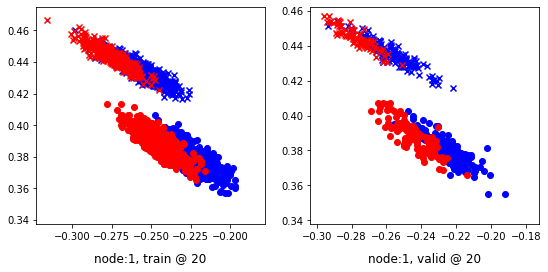

Aggregating on epoch: 27...
Aggregating on epoch: 36...
40 	 0 	 0.75057292 	 0.74027181 	 0.94575709 	 0.94742244 	 0.88864875 	 0.90029782


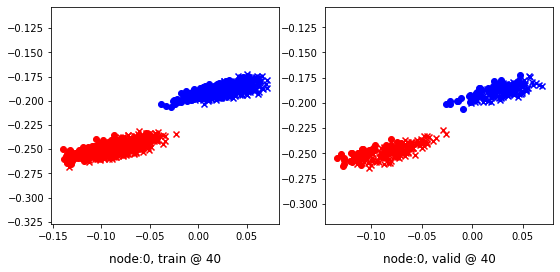

40 	 1 	 0.67764837 	 0.68520916 	 0.94311833 	 0.94460052 	 0.95867795 	 0.95253855


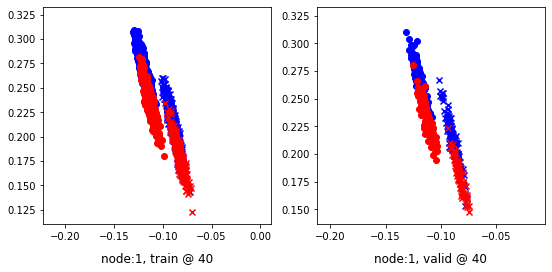

Aggregating on epoch: 45...
Aggregating on epoch: 54...
60 	 0 	 0.49791449 	 0.51480192 	 0.71985185 	 0.71356344 	 0.92028499 	 0.89190871


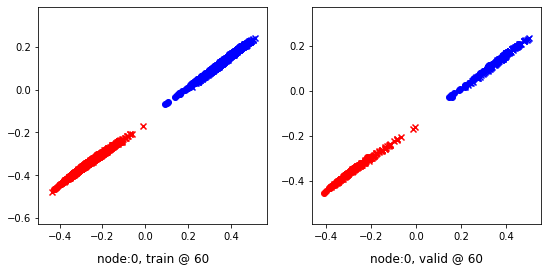

60 	 1 	 0.65518171 	 0.66444844 	 0.91460192 	 0.92251563 	 0.95328569 	 0.95121437


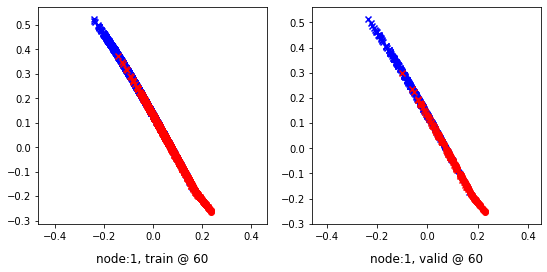

Aggregating on epoch: 63...
Aggregating on epoch: 72...
80 	 0 	 -0.14036539 	 -0.13219398 	 0.07491761 	 0.07569009 	 0.90946144 	 0.90103126


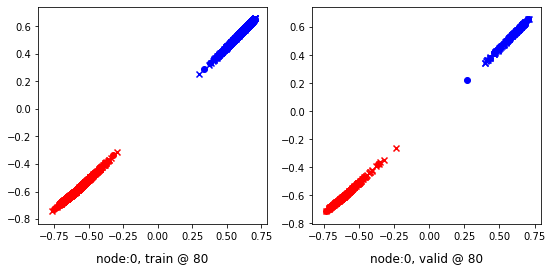

80 	 1 	 0.25786489 	 0.21206653 	 0.51216894 	 0.47004265 	 0.94759941 	 0.95112330


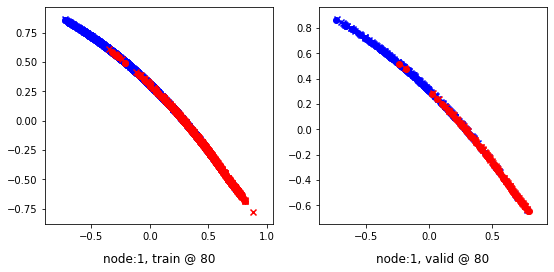

Aggregating on epoch: 81...
Aggregating on epoch: 90...
Aggregating on epoch: 99...
100 	 0 	 -0.07923736 	 -0.06798184 	 0.13440880 	 0.13843626 	 0.91455197 	 0.89956528


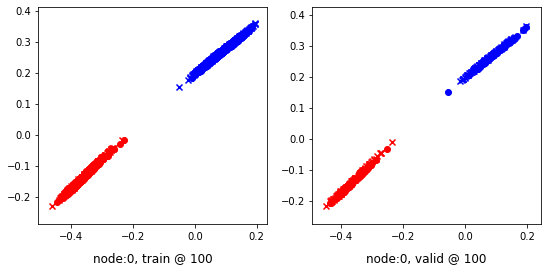

100 	 1 	 0.46387720 	 0.53923333 	 0.78851616 	 0.80152142 	 0.95969927 	 0.95543528


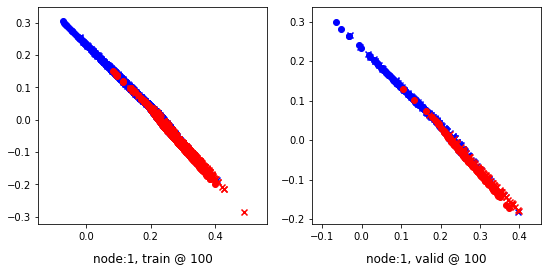

Aggregating on epoch: 108...
Aggregating on epoch: 117...
120 	 0 	 -0.09630862 	 -0.15009612 	 0.05459347 	 0.05626696 	 0.85343254 	 0.89951026


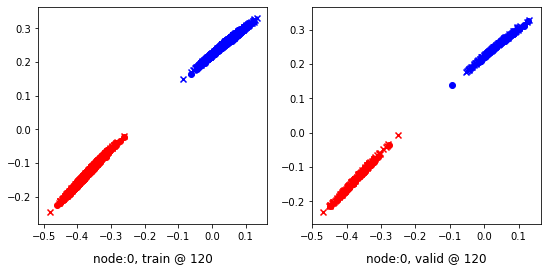

120 	 1 	 0.45062077 	 0.44257128 	 0.69553453 	 0.69834268 	 0.94536895 	 0.94891858


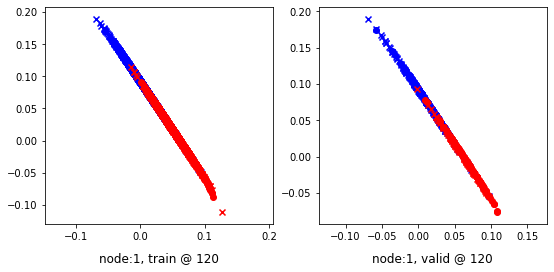

Aggregating on epoch: 126...
Aggregating on epoch: 135...
140 	 0 	 -0.10700733 	 -0.11408958 	 0.08738012 	 0.09216657 	 0.89450294 	 0.89940333


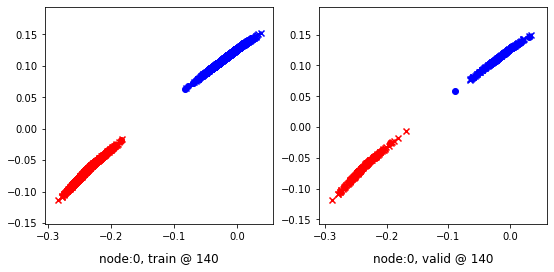

140 	 1 	 0.32173687 	 0.31889218 	 0.57481200 	 0.57820821 	 0.94914073 	 0.95246321


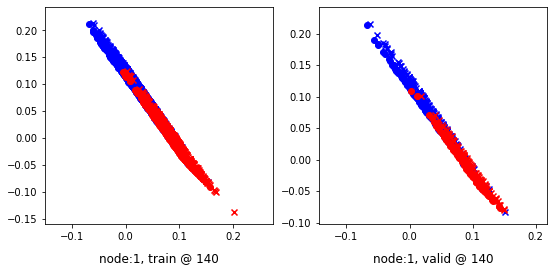

Aggregating on epoch: 144...
Aggregating on epoch: 153...
160 	 0 	 -0.20098323 	 -0.18719372 	 0.01630431 	 0.01873020 	 0.91133499 	 0.89907110


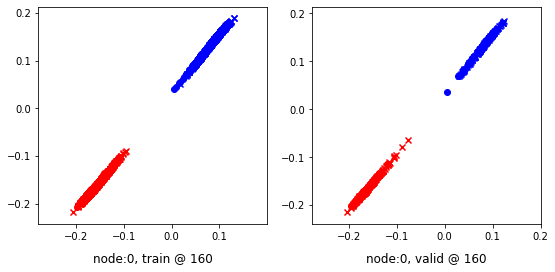

160 	 1 	 0.38183367 	 0.37954748 	 0.64179993 	 0.63750178 	 0.95699120 	 0.95110148


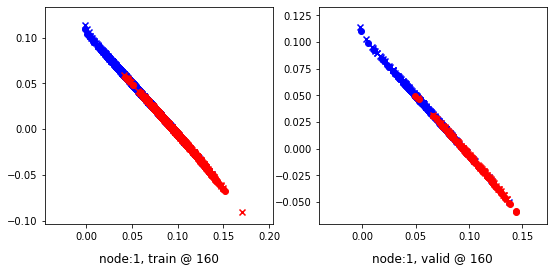

Aggregating on epoch: 162...
Aggregating on epoch: 171...
Aggregating on epoch: 180...
180 	 0 	 -0.16955641 	 -0.15341970 	 0.04986036 	 0.05309453 	 0.92867732 	 0.89966142


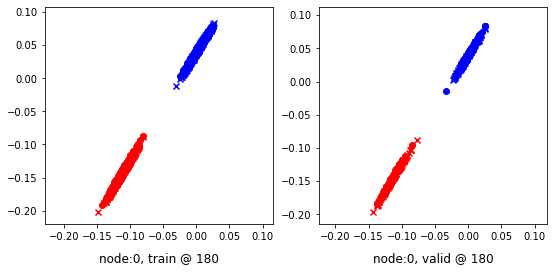

180 	 1 	 0.41288131 	 0.30386841 	 0.62407905 	 0.56083804 	 0.95314962 	 0.95011681


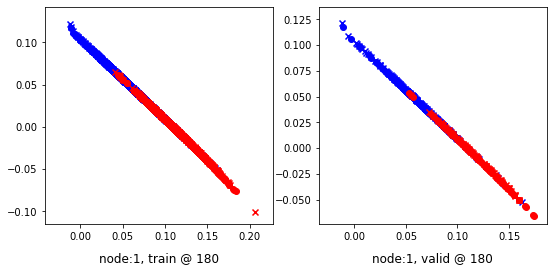

Aggregating on epoch: 189...
Aggregating on epoch: 198...
200 	 0 	 -0.09964824 	 -0.11223267 	 0.08828973 	 0.09402461 	 0.89072794 	 0.89940447


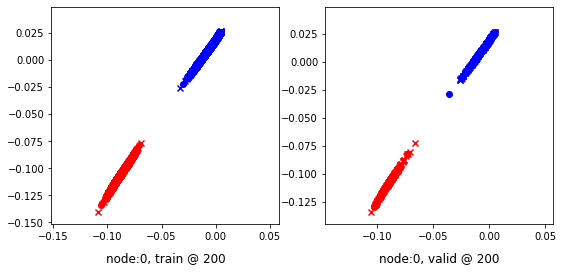

200 	 1 	 0.79314923 	 0.80483562 	 1.11008441 	 1.06659138 	 0.97874403 	 0.95490295


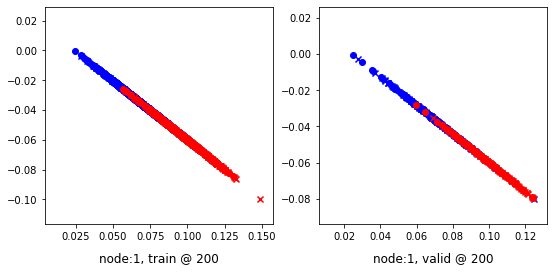

Aggregating on epoch: 207...
Aggregating on epoch: 216...
220 	 0 	 -0.14743906 	 -0.15194444 	 0.04981498 	 0.05432208 	 0.89092773 	 0.89941370


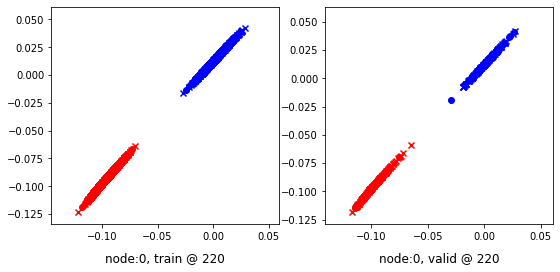

220 	 1 	 0.43685132 	 0.41385549 	 0.70799655 	 0.67223305 	 0.96022826 	 0.95152473


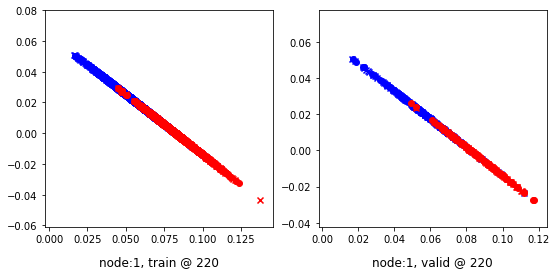

Aggregating on epoch: 225...
Aggregating on epoch: 234...
240 	 0 	 -0.13851878 	 -0.12945920 	 0.06985901 	 0.07663935 	 0.90451813 	 0.89924574


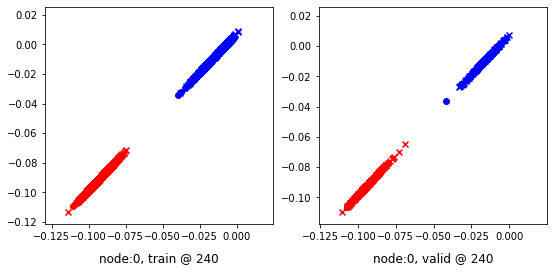

240 	 1 	 0.38343459 	 0.38000280 	 0.63381410 	 0.63851756 	 0.94185770 	 0.95166194


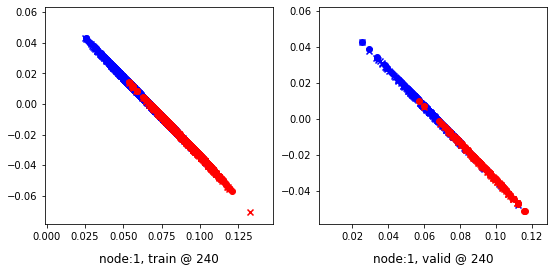

Aggregating on epoch: 243...
Aggregating on epoch: 252...
260 	 0 	 -0.16414756 	 -0.16719139 	 0.03570376 	 0.03905695 	 0.89424288 	 0.89939553


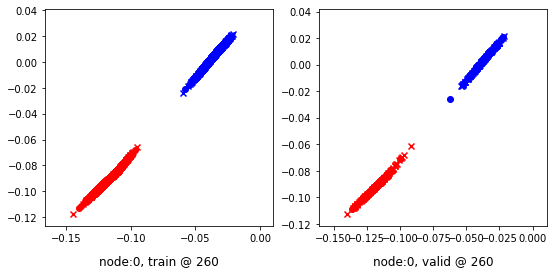

260 	 1 	 0.40479958 	 0.40299284 	 0.66362303 	 0.65902841 	 0.95637167 	 0.94918275


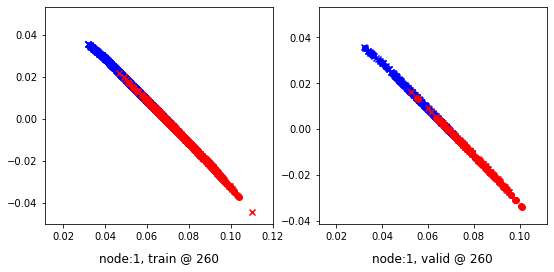

Aggregating on epoch: 261...
Aggregating on epoch: 270...
Aggregating on epoch: 279...
280 	 0 	 -0.20687802 	 -0.17614083 	 0.02664155 	 0.03020890 	 0.93173927 	 0.89949691


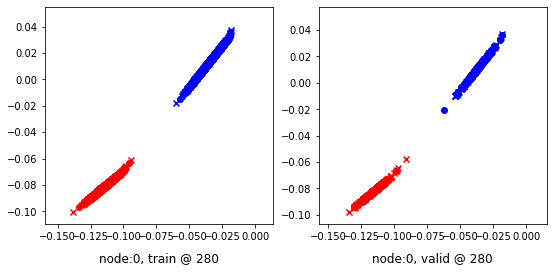

280 	 1 	 0.36703902 	 0.30378473 	 0.62585688 	 0.56325281 	 0.95805371 	 0.95261526


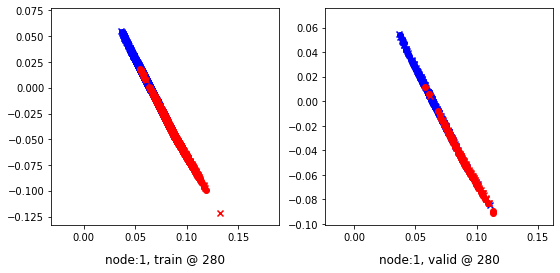

Aggregating on epoch: 288...
Aggregating on epoch: 297...
300 	 0 	 -0.14587222 	 -0.13708112 	 0.06526978 	 0.06909731 	 0.90780741 	 0.89932561


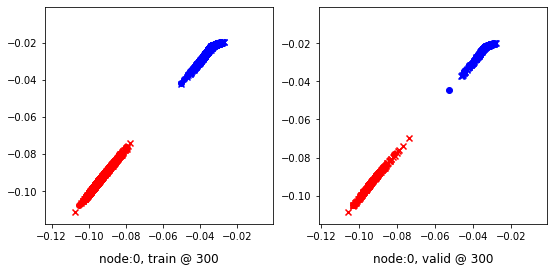

300 	 1 	 0.31311679 	 0.30788672 	 0.57746059 	 0.56809360 	 0.94495368 	 0.95335406


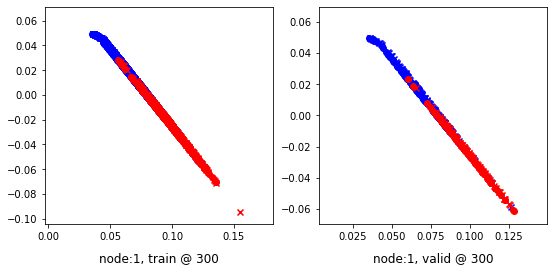

Aggregating on epoch: 306...
Aggregating on epoch: 315...
320 	 0 	 -0.16279066 	 -0.14348137 	 0.05906371 	 0.06282472 	 0.91816622 	 0.89945328


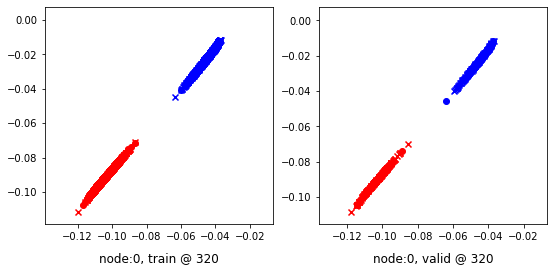

320 	 1 	 0.33227110 	 0.30734992 	 0.57513589 	 0.56539428 	 0.94451457 	 0.95119154


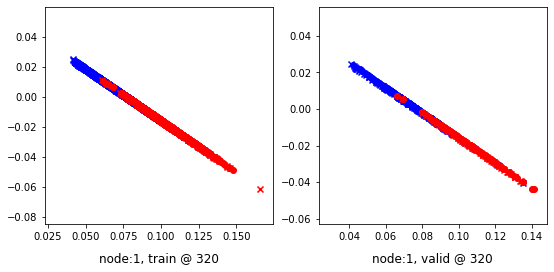

Aggregating on epoch: 324...
Aggregating on epoch: 333...
340 	 0 	 -0.16440578 	 -0.18127656 	 0.02297909 	 0.02492469 	 0.88055873 	 0.89934844


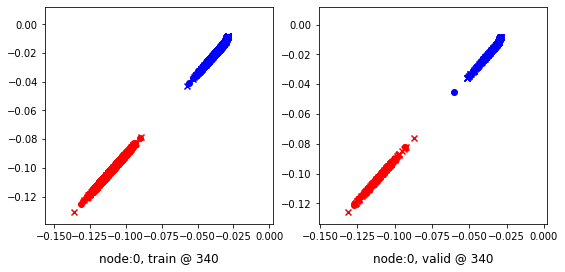

340 	 1 	 0.25961804 	 0.22094718 	 0.50190228 	 0.47935745 	 0.93626356 	 0.95155746


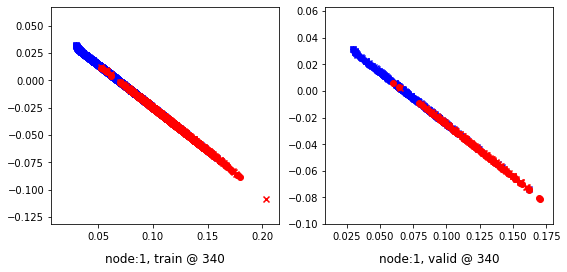

Aggregating on epoch: 342...
Aggregating on epoch: 351...
Aggregating on epoch: 360...
360 	 0 	 0.63649881 	 0.37516087 	 0.59305924 	 0.58141261 	 0.85352576 	 0.89939892


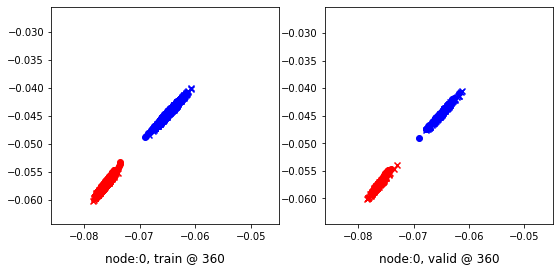

360 	 1 	 0.47001141 	 0.37477326 	 0.67266047 	 0.63364553 	 0.94513196 	 0.95201945


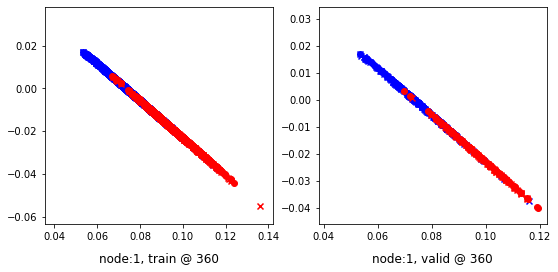

Aggregating on epoch: 369...
Aggregating on epoch: 378...
380 	 0 	 -0.13065118 	 -0.14084725 	 0.06219107 	 0.06510110 	 0.88779008 	 0.89909554


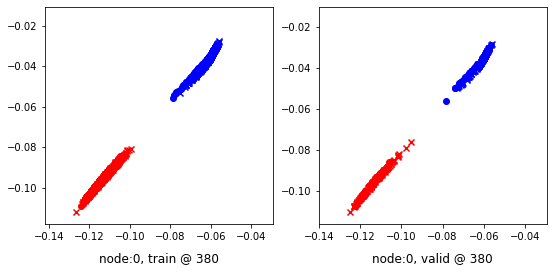

380 	 1 	 0.33236742 	 0.29135466 	 0.56281668 	 0.55029845 	 0.94866425 	 0.95209098


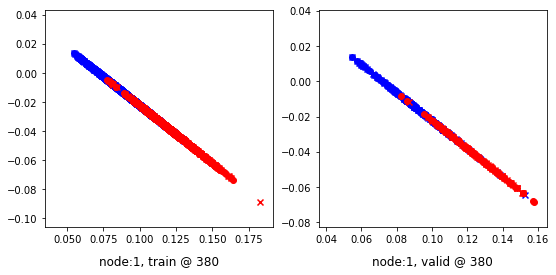

Aggregating on epoch: 387...
Aggregating on epoch: 396...
400 	 0 	 -0.11935072 	 -0.15371835 	 0.05002737 	 0.05248749 	 0.87025052 	 0.89935303


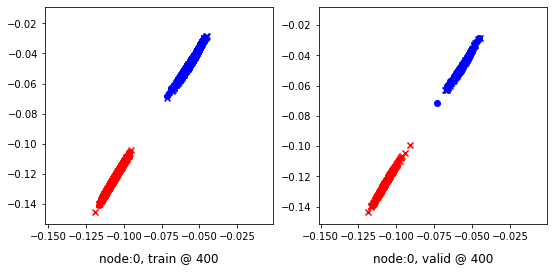

400 	 1 	 0.30051690 	 0.23896867 	 0.56164491 	 0.49765795 	 0.95674556 	 0.95183647


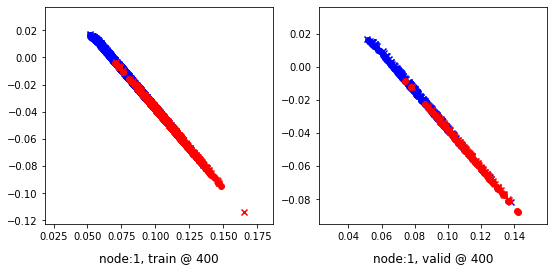

Aggregating on epoch: 405...
Aggregating on epoch: 414...
420 	 0 	 -0.13632742 	 -0.13222823 	 0.07053386 	 0.07357261 	 0.90383857 	 0.89894801


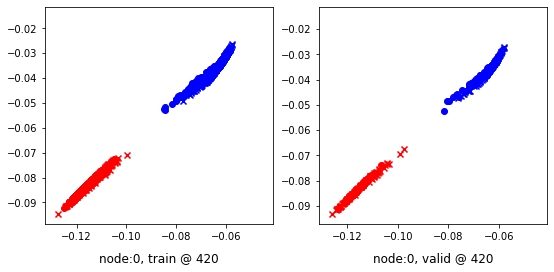

420 	 1 	 0.31116104 	 0.26919949 	 0.56026584 	 0.52649963 	 0.94452327 	 0.95044732


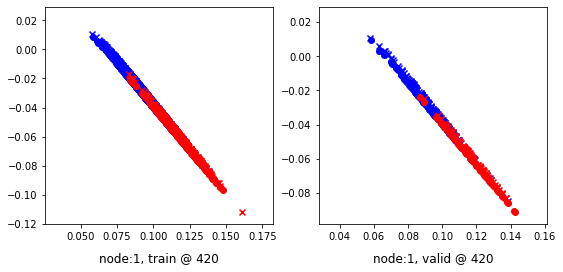

Aggregating on epoch: 423...
Aggregating on epoch: 432...
440 	 0 	 -0.20418473 	 -0.17424321 	 0.02692353 	 0.03118998 	 0.92466801 	 0.89858037


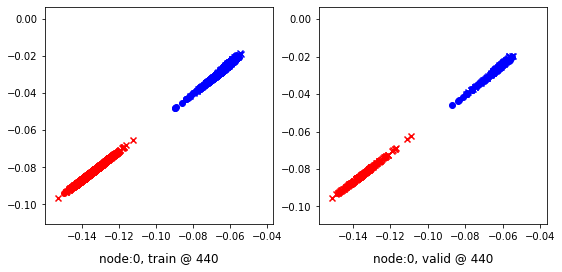

440 	 1 	 0.25716364 	 0.26429719 	 0.51663876 	 0.52229530 	 0.95423931 	 0.95114529


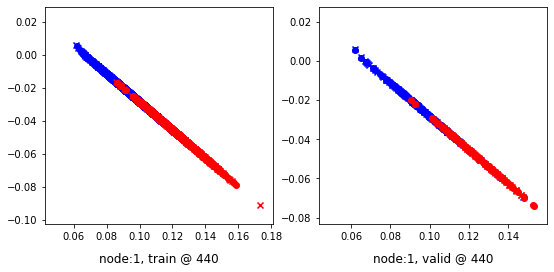

Aggregating on epoch: 441...
Aggregating on epoch: 450...
Aggregating on epoch: 459...
460 	 0 	 -0.10181922 	 -0.11439867 	 0.08506607 	 0.09206407 	 0.88118190 	 0.89960992


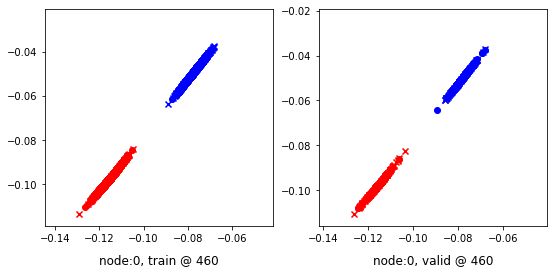

460 	 1 	 0.43747205 	 0.50315744 	 0.74402350 	 0.76299232 	 0.94797182 	 0.95298207


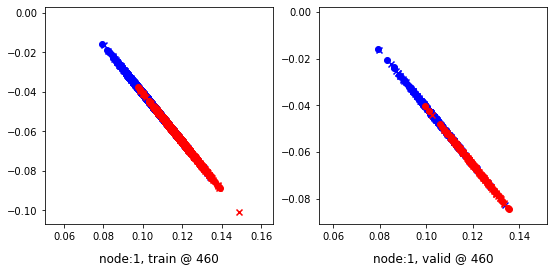

Aggregating on epoch: 468...
Aggregating on epoch: 477...
480 	 0 	 -0.17188156 	 -0.10339673 	 0.09682368 	 0.10334800 	 0.96295971 	 0.89989191


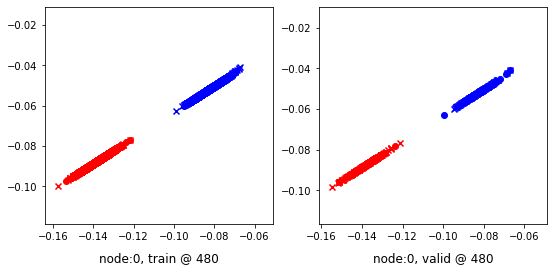

480 	 1 	 0.33886403 	 0.36174321 	 0.59994859 	 0.61981392 	 0.95825291 	 0.95121789


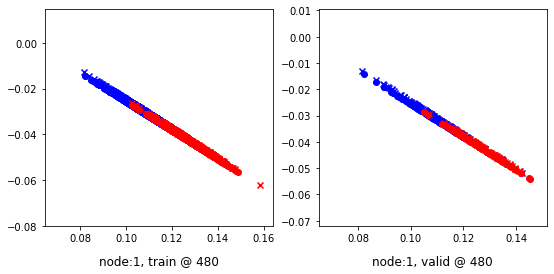

Aggregating on epoch: 486...
Aggregating on epoch: 495...
500 	 0 	 -0.17207067 	 -0.15341315 	 0.05075198 	 0.05309591 	 0.92157072 	 0.89965624


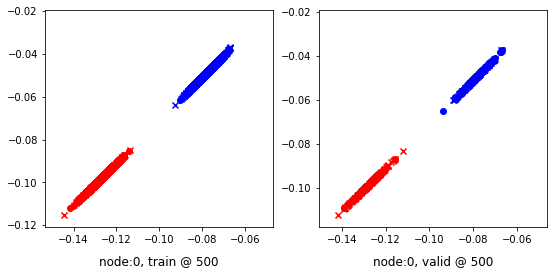

500 	 1 	 0.35164559 	 0.29477566 	 0.59133059 	 0.55259556 	 0.93935812 	 0.95096707


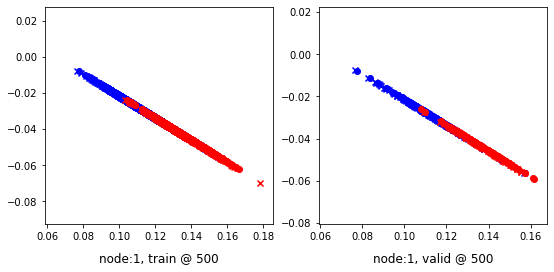

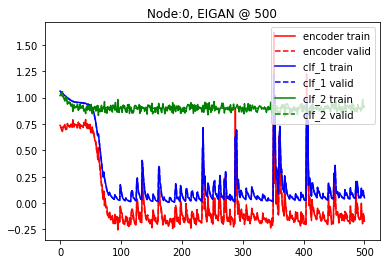

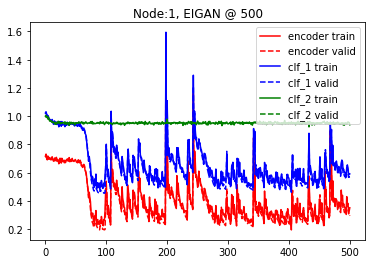

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.4 and delta=1
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.79126734 	 0.73724282 	 1.05547810 	 1.05389333 	 0.95752221 	 1.00979769


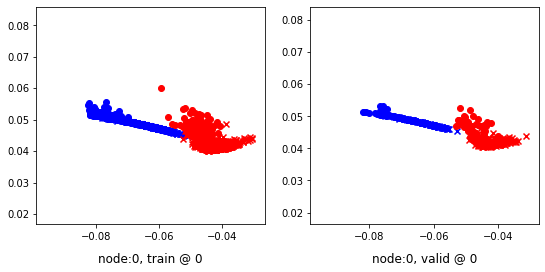

0 	 1 	 0.71278691 	 0.72156858 	 1.05915499 	 1.06581759 	 1.03965259 	 1.03739619


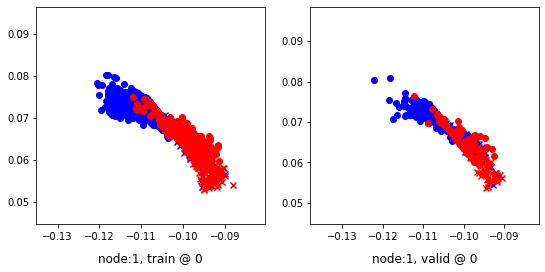

Aggregating on epoch: 1...
Aggregating on epoch: 2...
Aggregating on epoch: 3...
Aggregating on epoch: 4...
Aggregating on epoch: 5...
Aggregating on epoch: 6...
Aggregating on epoch: 7...
Aggregating on epoch: 8...
Aggregating on epoch: 9...
Aggregating on epoch: 10...
Aggregating on epoch: 11...
Aggregating on epoch: 12...
Aggregating on epoch: 13...
Aggregating on epoch: 14...
Aggregating on epoch: 15...
Aggregating on epoch: 16...
Aggregating on epoch: 17...
Aggregating on epoch: 18...
Aggregating on epoch: 19...
Aggregating on epoch: 20...
20 	 0 	 0.72670555 	 0.75881732 	 0.98021442 	 0.97989810 	 0.94667143 	 0.91422796


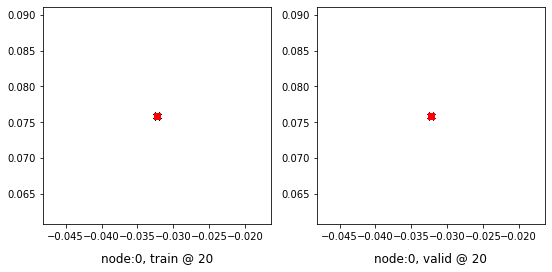

20 	 1 	 0.68967658 	 0.69198442 	 0.94783241 	 0.95092583 	 0.95131314 	 0.95208859


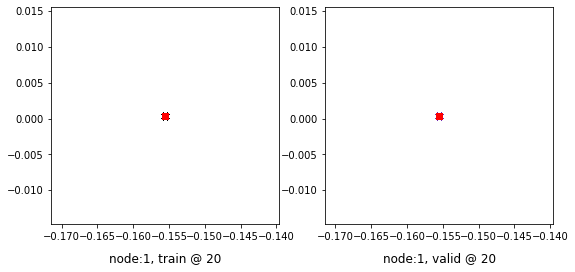

Aggregating on epoch: 21...
Aggregating on epoch: 22...
Aggregating on epoch: 23...
Aggregating on epoch: 24...
Aggregating on epoch: 25...
Aggregating on epoch: 26...
Aggregating on epoch: 27...
Aggregating on epoch: 28...
Aggregating on epoch: 29...
Aggregating on epoch: 30...
Aggregating on epoch: 31...
Aggregating on epoch: 32...
Aggregating on epoch: 33...
Aggregating on epoch: 34...
Aggregating on epoch: 35...
Aggregating on epoch: 36...
Aggregating on epoch: 37...
Aggregating on epoch: 38...
Aggregating on epoch: 39...
Aggregating on epoch: 40...
40 	 0 	 0.77593535 	 0.74770236 	 0.95332962 	 0.95396286 	 0.87054127 	 0.89940768


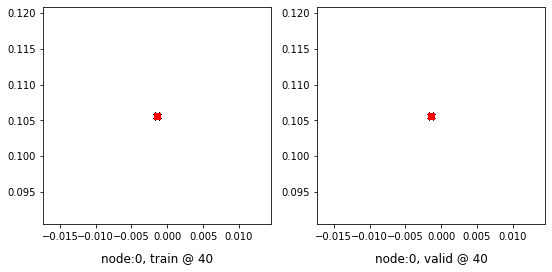

40 	 1 	 0.69133222 	 0.68656188 	 0.95805025 	 0.94523746 	 0.95986509 	 0.95182276


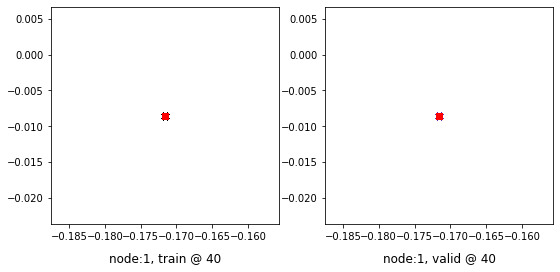

Aggregating on epoch: 41...
Aggregating on epoch: 42...
Aggregating on epoch: 43...
Aggregating on epoch: 44...
Aggregating on epoch: 45...
Aggregating on epoch: 46...
Aggregating on epoch: 47...
Aggregating on epoch: 48...
Aggregating on epoch: 49...
Aggregating on epoch: 50...
Aggregating on epoch: 51...
Aggregating on epoch: 52...
Aggregating on epoch: 53...
Aggregating on epoch: 54...
Aggregating on epoch: 55...
Aggregating on epoch: 56...
Aggregating on epoch: 57...
Aggregating on epoch: 58...
Aggregating on epoch: 59...
Aggregating on epoch: 60...
60 	 0 	 0.74143428 	 0.74768788 	 0.95293736 	 0.95394677 	 0.90465003 	 0.89940608


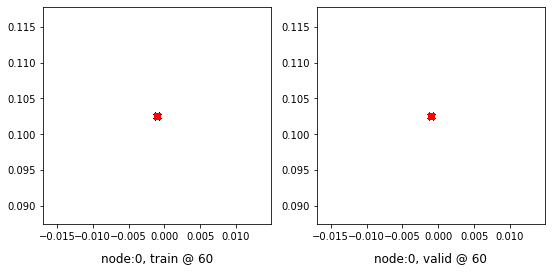

60 	 1 	 0.69449127 	 0.68656009 	 0.96060628 	 0.94523484 	 0.95926219 	 0.95182192


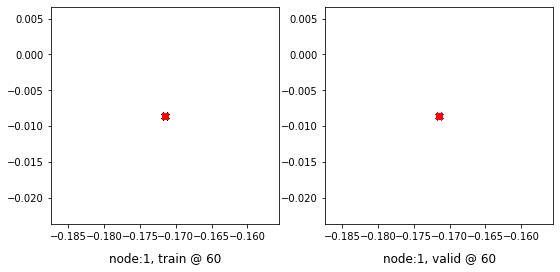

Aggregating on epoch: 61...
Aggregating on epoch: 62...
Aggregating on epoch: 63...
Aggregating on epoch: 64...
Aggregating on epoch: 65...
Aggregating on epoch: 66...
Aggregating on epoch: 67...
Aggregating on epoch: 68...
Aggregating on epoch: 69...
Aggregating on epoch: 70...
Aggregating on epoch: 71...
Aggregating on epoch: 72...
Aggregating on epoch: 73...
Aggregating on epoch: 74...
Aggregating on epoch: 75...
Aggregating on epoch: 76...
Aggregating on epoch: 77...
Aggregating on epoch: 78...
Aggregating on epoch: 79...
Aggregating on epoch: 80...
80 	 0 	 0.75697762 	 0.74768579 	 0.95476663 	 0.95394498 	 0.89093632 	 0.89940637


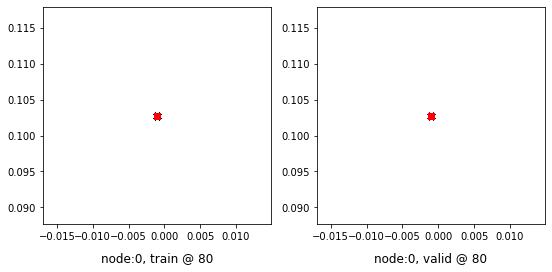

80 	 1 	 0.65974957 	 0.68655306 	 0.92191947 	 0.94523007 	 0.95531720 	 0.95182419


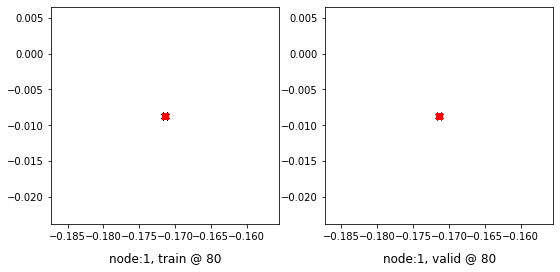

Aggregating on epoch: 81...
Aggregating on epoch: 82...
Aggregating on epoch: 83...
Aggregating on epoch: 84...
Aggregating on epoch: 85...
Aggregating on epoch: 86...
Aggregating on epoch: 87...
Aggregating on epoch: 88...
Aggregating on epoch: 89...
Aggregating on epoch: 90...
Aggregating on epoch: 91...
Aggregating on epoch: 92...
Aggregating on epoch: 93...
Aggregating on epoch: 94...
Aggregating on epoch: 95...
Aggregating on epoch: 96...
Aggregating on epoch: 97...
Aggregating on epoch: 98...
Aggregating on epoch: 99...
Aggregating on epoch: 100...
100 	 0 	 0.81180322 	 0.74768645 	 0.95149392 	 0.95394474 	 0.83283776 	 0.89940548


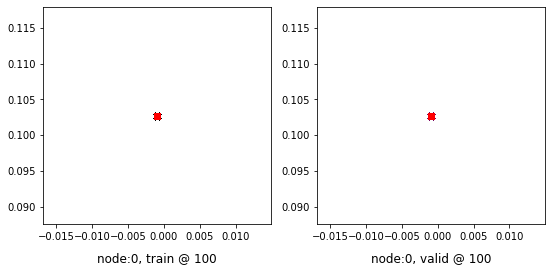

100 	 1 	 0.67393637 	 0.68654901 	 0.94123441 	 0.94522703 	 0.96044528 	 0.95182520


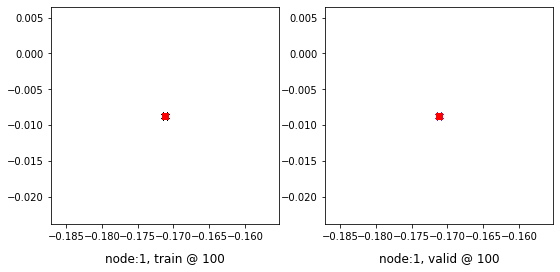

Aggregating on epoch: 101...
Aggregating on epoch: 102...
Aggregating on epoch: 103...
Aggregating on epoch: 104...
Aggregating on epoch: 105...
Aggregating on epoch: 106...
Aggregating on epoch: 107...
Aggregating on epoch: 108...
Aggregating on epoch: 109...
Aggregating on epoch: 110...
Aggregating on epoch: 111...
Aggregating on epoch: 112...
Aggregating on epoch: 113...
Aggregating on epoch: 114...
Aggregating on epoch: 115...
Aggregating on epoch: 116...
Aggregating on epoch: 117...
Aggregating on epoch: 118...
Aggregating on epoch: 119...
Aggregating on epoch: 120...
120 	 0 	 0.73994935 	 0.74768406 	 0.95147312 	 0.95394659 	 0.90467095 	 0.89940971


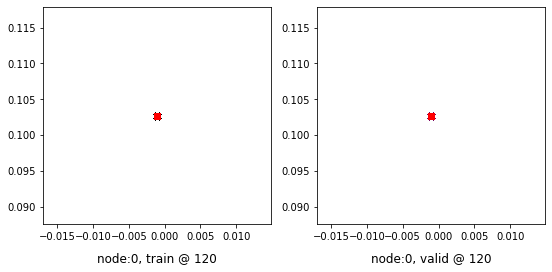

120 	 1 	 0.69252408 	 0.68655652 	 0.95409220 	 0.94523114 	 0.95471531 	 0.95182180


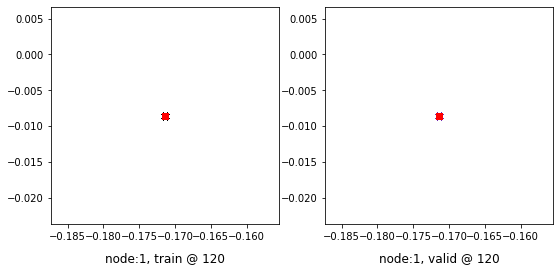

Aggregating on epoch: 121...
Aggregating on epoch: 122...
Aggregating on epoch: 123...
Aggregating on epoch: 124...
Aggregating on epoch: 125...
Aggregating on epoch: 126...
Aggregating on epoch: 127...
Aggregating on epoch: 128...
Aggregating on epoch: 129...
Aggregating on epoch: 130...
Aggregating on epoch: 131...
Aggregating on epoch: 132...
Aggregating on epoch: 133...
Aggregating on epoch: 134...
Aggregating on epoch: 135...
Aggregating on epoch: 136...
Aggregating on epoch: 137...
Aggregating on epoch: 138...
Aggregating on epoch: 139...
Aggregating on epoch: 140...
140 	 0 	 0.77570558 	 0.74768120 	 0.95623505 	 0.95394582 	 0.87367648 	 0.89941180


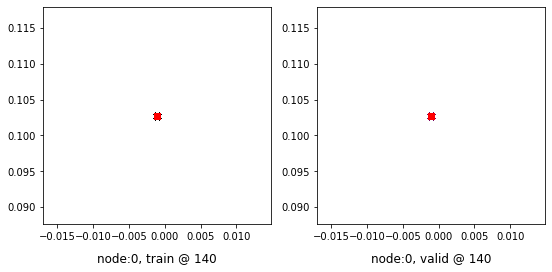

140 	 1 	 0.67715752 	 0.68654466 	 0.93865120 	 0.94522816 	 0.95464087 	 0.95183069


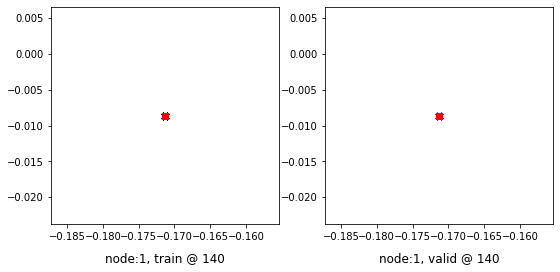

Aggregating on epoch: 141...
Aggregating on epoch: 142...
Aggregating on epoch: 143...
Aggregating on epoch: 144...
Aggregating on epoch: 145...
Aggregating on epoch: 146...
Aggregating on epoch: 147...
Aggregating on epoch: 148...
Aggregating on epoch: 149...
Aggregating on epoch: 150...
Aggregating on epoch: 151...
Aggregating on epoch: 152...
Aggregating on epoch: 153...
Aggregating on epoch: 154...
Aggregating on epoch: 155...
Aggregating on epoch: 156...
Aggregating on epoch: 157...
Aggregating on epoch: 158...
Aggregating on epoch: 159...
Aggregating on epoch: 160...
160 	 0 	 0.76667023 	 0.74768668 	 0.95076233 	 0.95394528 	 0.87723929 	 0.89940578


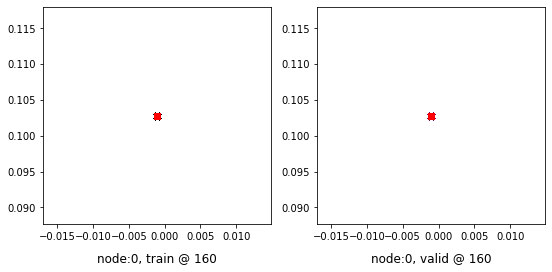

160 	 1 	 0.68027097 	 0.68655211 	 0.94377851 	 0.94522715 	 0.95665461 	 0.95182222


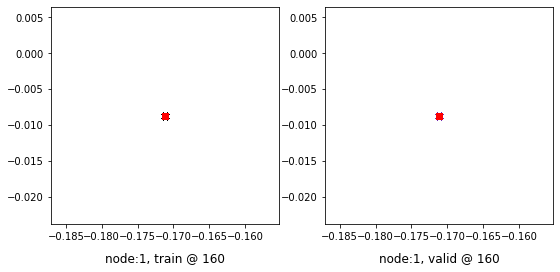

Aggregating on epoch: 161...
Aggregating on epoch: 162...
Aggregating on epoch: 163...
Aggregating on epoch: 164...
Aggregating on epoch: 165...
Aggregating on epoch: 166...
Aggregating on epoch: 167...
Aggregating on epoch: 168...
Aggregating on epoch: 169...
Aggregating on epoch: 170...
Aggregating on epoch: 171...
Aggregating on epoch: 172...
Aggregating on epoch: 173...
Aggregating on epoch: 174...
Aggregating on epoch: 175...
Aggregating on epoch: 176...
Aggregating on epoch: 177...
Aggregating on epoch: 178...
Aggregating on epoch: 179...
Aggregating on epoch: 180...
180 	 0 	 0.70710933 	 0.74768478 	 0.95987195 	 0.95394528 	 0.94591004 	 0.89940768


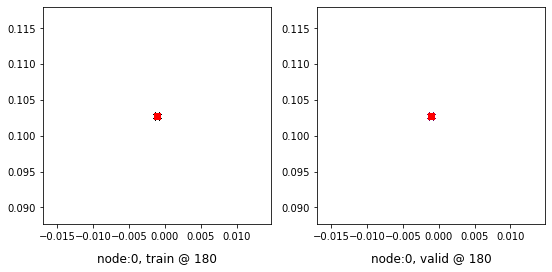

180 	 1 	 0.70757025 	 0.68656725 	 0.96080482 	 0.94524556 	 0.94638211 	 0.95182550


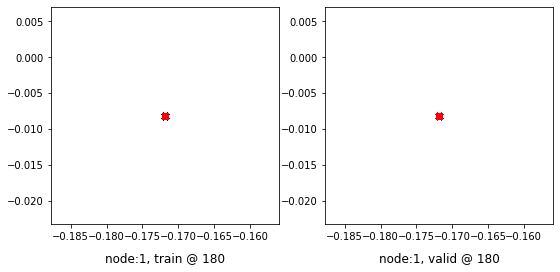

Aggregating on epoch: 181...
Aggregating on epoch: 182...
Aggregating on epoch: 183...
Aggregating on epoch: 184...
Aggregating on epoch: 185...
Aggregating on epoch: 186...
Aggregating on epoch: 187...
Aggregating on epoch: 188...
Aggregating on epoch: 189...
Aggregating on epoch: 190...
Aggregating on epoch: 191...
Aggregating on epoch: 192...
Aggregating on epoch: 193...
Aggregating on epoch: 194...
Aggregating on epoch: 195...
Aggregating on epoch: 196...
Aggregating on epoch: 197...
Aggregating on epoch: 198...
Aggregating on epoch: 199...
Aggregating on epoch: 200...
200 	 0 	 0.74594945 	 0.74768335 	 0.95403844 	 0.95394582 	 0.90123618 	 0.89940965


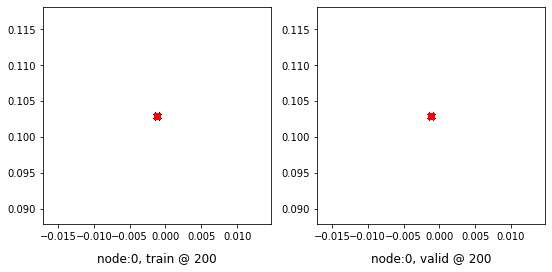

200 	 1 	 0.68417901 	 0.68655199 	 0.93481928 	 0.94522804 	 0.94378757 	 0.95182323


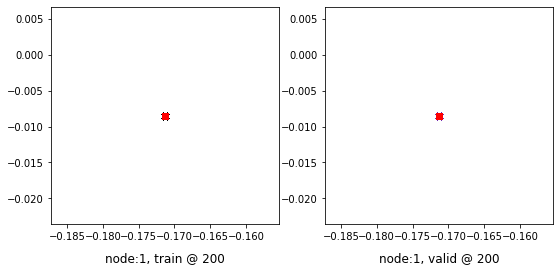

Aggregating on epoch: 201...
Aggregating on epoch: 202...
Aggregating on epoch: 203...
Aggregating on epoch: 204...
Aggregating on epoch: 205...
Aggregating on epoch: 206...
Aggregating on epoch: 207...
Aggregating on epoch: 208...
Aggregating on epoch: 209...
Aggregating on epoch: 210...
Aggregating on epoch: 211...
Aggregating on epoch: 212...
Aggregating on epoch: 213...
Aggregating on epoch: 214...
Aggregating on epoch: 215...
Aggregating on epoch: 216...
Aggregating on epoch: 217...
Aggregating on epoch: 218...
Aggregating on epoch: 219...
Aggregating on epoch: 220...
220 	 0 	 0.70777786 	 0.74769002 	 0.95367187 	 0.95395070 	 0.93904138 	 0.89940786


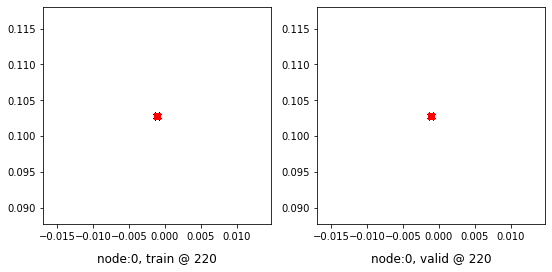

220 	 1 	 0.68735528 	 0.68655056 	 0.94632596 	 0.94522703 	 0.95211786 	 0.95182365


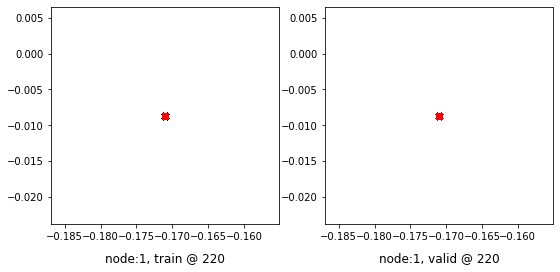

Aggregating on epoch: 221...
Aggregating on epoch: 222...
Aggregating on epoch: 223...
Aggregating on epoch: 224...
Aggregating on epoch: 225...
Aggregating on epoch: 226...
Aggregating on epoch: 227...
Aggregating on epoch: 228...
Aggregating on epoch: 229...
Aggregating on epoch: 230...
Aggregating on epoch: 231...
Aggregating on epoch: 232...
Aggregating on epoch: 233...
Aggregating on epoch: 234...
Aggregating on epoch: 235...
Aggregating on epoch: 236...
Aggregating on epoch: 237...
Aggregating on epoch: 238...
Aggregating on epoch: 239...
Aggregating on epoch: 240...
240 	 0 	 0.79017240 	 0.74769020 	 0.95035541 	 0.95394790 	 0.85333019 	 0.89940488


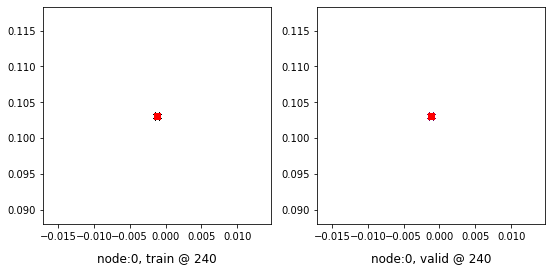

240 	 1 	 0.67131412 	 0.68655187 	 0.93738049 	 0.94522798 	 0.95921367 	 0.95182329


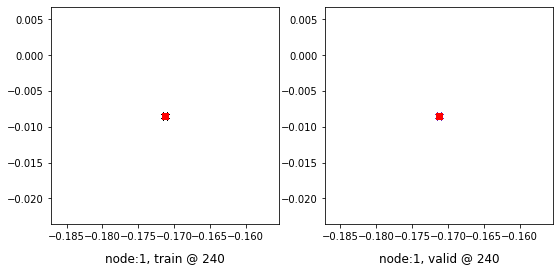

Aggregating on epoch: 241...
Aggregating on epoch: 242...
Aggregating on epoch: 243...
Aggregating on epoch: 244...
Aggregating on epoch: 245...
Aggregating on epoch: 246...
Aggregating on epoch: 247...
Aggregating on epoch: 248...
Aggregating on epoch: 249...
Aggregating on epoch: 250...
Aggregating on epoch: 251...
Aggregating on epoch: 252...
Aggregating on epoch: 253...
Aggregating on epoch: 254...
Aggregating on epoch: 255...
Aggregating on epoch: 256...
Aggregating on epoch: 257...
Aggregating on epoch: 258...
Aggregating on epoch: 259...
Aggregating on epoch: 260...
260 	 0 	 0.75783002 	 0.74768800 	 0.95219928 	 0.95394707 	 0.88751632 	 0.89940625


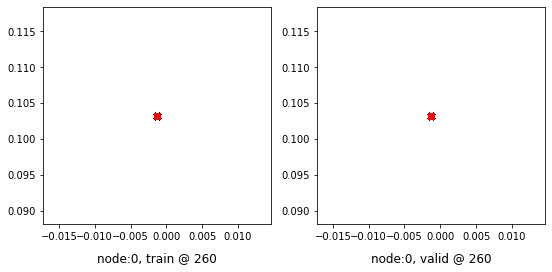

260 	 1 	 0.70348835 	 0.68655533 	 0.95538783 	 0.94523144 	 0.94504696 	 0.95182329


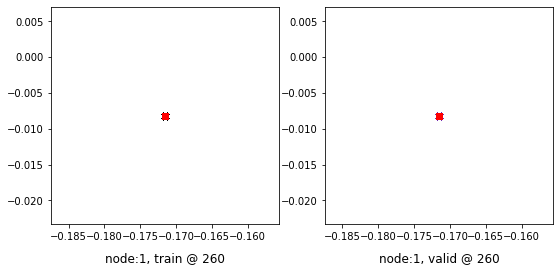

Aggregating on epoch: 261...
Aggregating on epoch: 262...
Aggregating on epoch: 263...
Aggregating on epoch: 264...
Aggregating on epoch: 265...
Aggregating on epoch: 266...
Aggregating on epoch: 267...
Aggregating on epoch: 268...
Aggregating on epoch: 269...
Aggregating on epoch: 270...
Aggregating on epoch: 271...
Aggregating on epoch: 272...
Aggregating on epoch: 273...
Aggregating on epoch: 274...
Aggregating on epoch: 275...
Aggregating on epoch: 276...
Aggregating on epoch: 277...
Aggregating on epoch: 278...
Aggregating on epoch: 279...
Aggregating on epoch: 280...
280 	 0 	 0.78465360 	 0.74768960 	 0.95514524 	 0.95394742 	 0.86363876 	 0.89940500


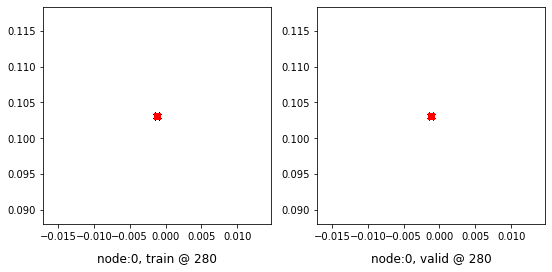

280 	 1 	 0.67583209 	 0.68654871 	 0.93480301 	 0.94522828 	 0.95211816 	 0.95182675


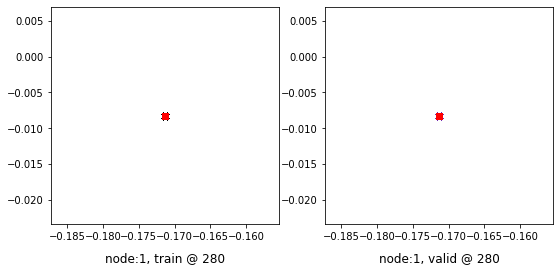

Aggregating on epoch: 281...
Aggregating on epoch: 282...
Aggregating on epoch: 283...
Aggregating on epoch: 284...
Aggregating on epoch: 285...
Aggregating on epoch: 286...
Aggregating on epoch: 287...
Aggregating on epoch: 288...
Aggregating on epoch: 289...
Aggregating on epoch: 290...
Aggregating on epoch: 291...
Aggregating on epoch: 292...
Aggregating on epoch: 293...
Aggregating on epoch: 294...
Aggregating on epoch: 295...
Aggregating on epoch: 296...
Aggregating on epoch: 297...
Aggregating on epoch: 298...
Aggregating on epoch: 299...
Aggregating on epoch: 300...
300 	 0 	 0.75974900 	 0.74769109 	 0.95069742 	 0.95394951 	 0.88409543 	 0.89940560


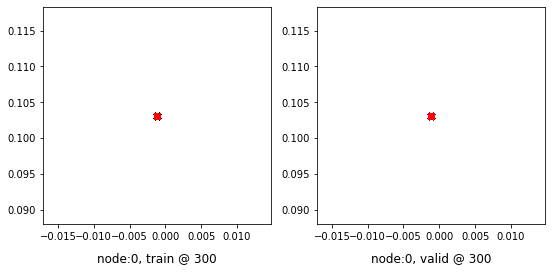

300 	 1 	 0.67462361 	 0.68655133 	 0.93101782 	 0.94522727 	 0.94954157 	 0.95182312


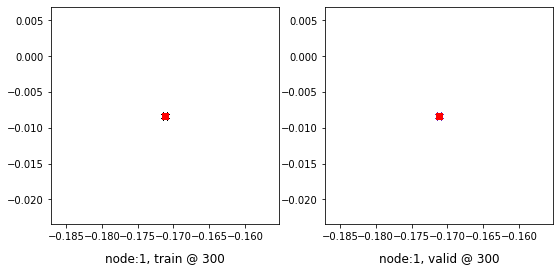

Aggregating on epoch: 301...
Aggregating on epoch: 302...
Aggregating on epoch: 303...
Aggregating on epoch: 304...
Aggregating on epoch: 305...
Aggregating on epoch: 306...
Aggregating on epoch: 307...
Aggregating on epoch: 308...
Aggregating on epoch: 309...
Aggregating on epoch: 310...
Aggregating on epoch: 311...
Aggregating on epoch: 312...
Aggregating on epoch: 313...
Aggregating on epoch: 314...
Aggregating on epoch: 315...
Aggregating on epoch: 316...
Aggregating on epoch: 317...
Aggregating on epoch: 318...
Aggregating on epoch: 319...
Aggregating on epoch: 320...
320 	 0 	 0.68277830 	 0.74767607 	 0.94965088 	 0.95394582 	 0.96001989 	 0.89941692


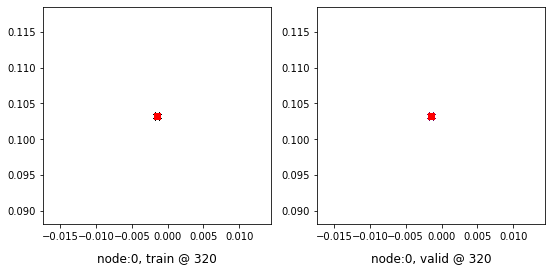

320 	 1 	 0.70151490 	 0.68655151 	 0.96176368 	 0.94522911 	 0.95339620 	 0.95182478


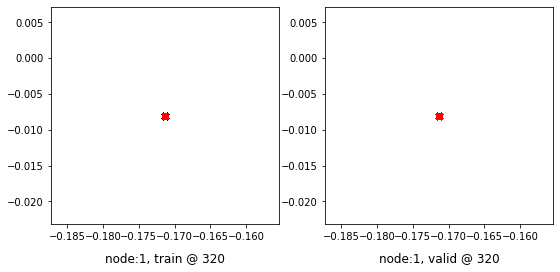

Aggregating on epoch: 321...
Aggregating on epoch: 322...
Aggregating on epoch: 323...
Aggregating on epoch: 324...
Aggregating on epoch: 325...
Aggregating on epoch: 326...
Aggregating on epoch: 327...
Aggregating on epoch: 328...
Aggregating on epoch: 329...
Aggregating on epoch: 330...
Aggregating on epoch: 331...
Aggregating on epoch: 332...
Aggregating on epoch: 333...
Aggregating on epoch: 334...
Aggregating on epoch: 335...
Aggregating on epoch: 336...
Aggregating on epoch: 337...
Aggregating on epoch: 338...
Aggregating on epoch: 339...
Aggregating on epoch: 340...
340 	 0 	 0.69434291 	 0.74767751 	 0.95075136 	 0.95394528 	 0.94955575 	 0.89941496


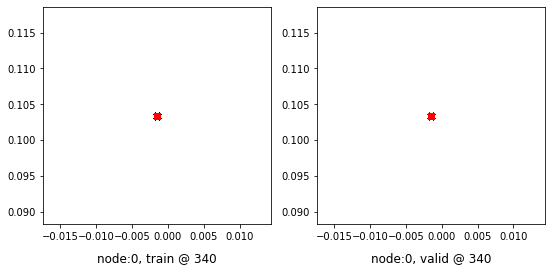

340 	 1 	 0.67644888 	 0.68655324 	 0.94248903 	 0.94522953 	 0.95918733 	 0.95182347


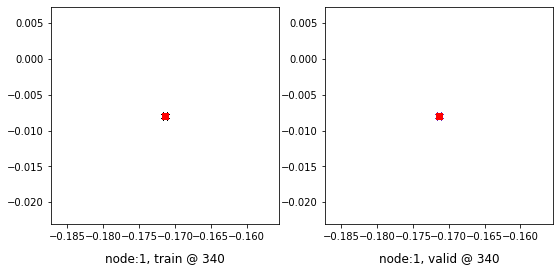

Aggregating on epoch: 341...
Aggregating on epoch: 342...
Aggregating on epoch: 343...
Aggregating on epoch: 344...
Aggregating on epoch: 345...
Aggregating on epoch: 346...
Aggregating on epoch: 347...
Aggregating on epoch: 348...
Aggregating on epoch: 349...
Aggregating on epoch: 350...
Aggregating on epoch: 351...
Aggregating on epoch: 352...
Aggregating on epoch: 353...
Aggregating on epoch: 354...
Aggregating on epoch: 355...
Aggregating on epoch: 356...
Aggregating on epoch: 357...
Aggregating on epoch: 358...
Aggregating on epoch: 359...
Aggregating on epoch: 360...
360 	 0 	 0.73669565 	 0.74768013 	 0.95513129 	 0.95394504 	 0.91158295 	 0.89941210


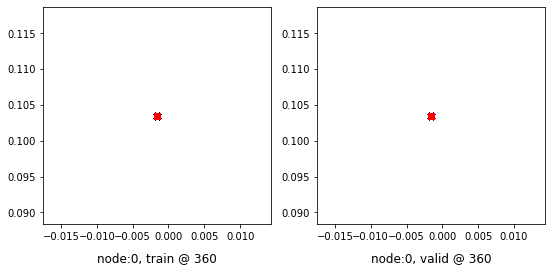

360 	 1 	 0.66008073 	 0.68654913 	 0.92097002 	 0.94522691 	 0.95403683 	 0.95182496


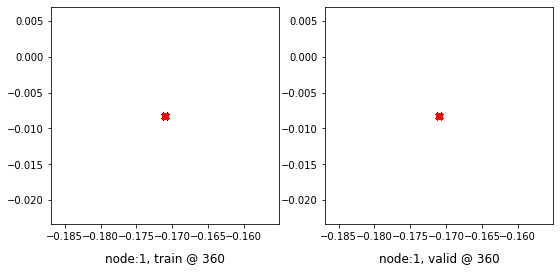

Aggregating on epoch: 361...
Aggregating on epoch: 362...
Aggregating on epoch: 363...
Aggregating on epoch: 364...
Aggregating on epoch: 365...
Aggregating on epoch: 366...
Aggregating on epoch: 367...
Aggregating on epoch: 368...
Aggregating on epoch: 369...
Aggregating on epoch: 370...
Aggregating on epoch: 371...
Aggregating on epoch: 372...
Aggregating on epoch: 373...
Aggregating on epoch: 374...
Aggregating on epoch: 375...
Aggregating on epoch: 376...
Aggregating on epoch: 377...
Aggregating on epoch: 378...
Aggregating on epoch: 379...
Aggregating on epoch: 380...
380 	 0 	 0.74299330 	 0.74768764 	 0.95107919 	 0.95394921 	 0.90123308 	 0.89940876


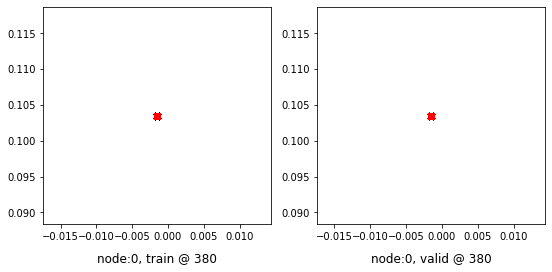

380 	 1 	 0.68865138 	 0.68655276 	 0.94635820 	 0.94523484 	 0.95085382 	 0.95182925


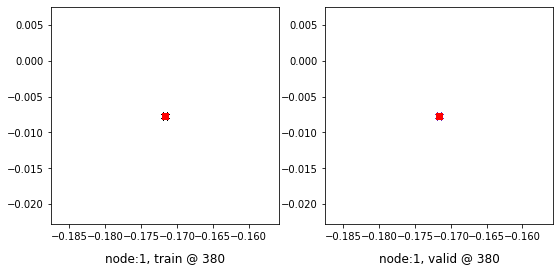

Aggregating on epoch: 381...
Aggregating on epoch: 382...
Aggregating on epoch: 383...
Aggregating on epoch: 384...
Aggregating on epoch: 385...
Aggregating on epoch: 386...
Aggregating on epoch: 387...
Aggregating on epoch: 388...
Aggregating on epoch: 389...
Aggregating on epoch: 390...
Aggregating on epoch: 391...
Aggregating on epoch: 392...
Aggregating on epoch: 393...
Aggregating on epoch: 394...
Aggregating on epoch: 395...
Aggregating on epoch: 396...
Aggregating on epoch: 397...
Aggregating on epoch: 398...
Aggregating on epoch: 399...
Aggregating on epoch: 400...
400 	 0 	 0.75427842 	 0.74768639 	 0.95550108 	 0.95394552 	 0.89437014 	 0.89940631


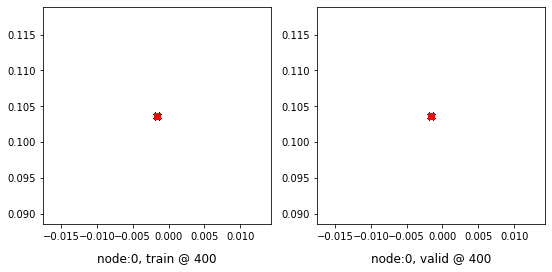

400 	 1 	 0.68671924 	 0.68655688 	 0.94376665 	 0.94523263 	 0.95019460 	 0.95182294


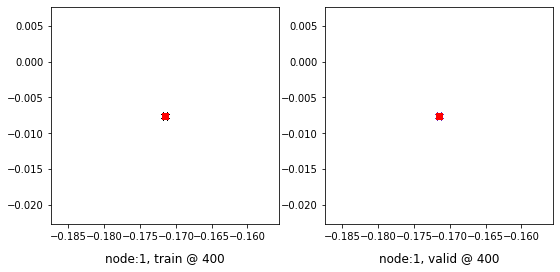

Aggregating on epoch: 401...
Aggregating on epoch: 402...
Aggregating on epoch: 403...
Aggregating on epoch: 404...
Aggregating on epoch: 405...
Aggregating on epoch: 406...
Aggregating on epoch: 407...
Aggregating on epoch: 408...
Aggregating on epoch: 409...
Aggregating on epoch: 410...
Aggregating on epoch: 411...
Aggregating on epoch: 412...
Aggregating on epoch: 413...
Aggregating on epoch: 414...
Aggregating on epoch: 415...
Aggregating on epoch: 416...
Aggregating on epoch: 417...
Aggregating on epoch: 418...
Aggregating on epoch: 419...
Aggregating on epoch: 420...
420 	 0 	 0.81239098 	 0.74769044 	 0.95219249 	 0.95394850 	 0.83294886 	 0.89940524


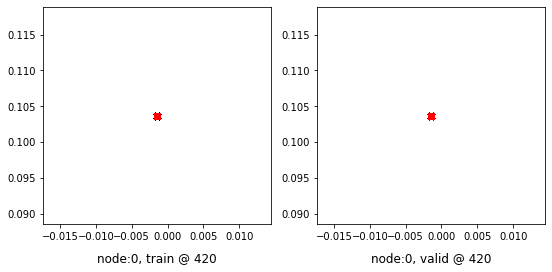

420 	 1 	 0.68877143 	 0.68656093 	 0.95286185 	 0.94523805 	 0.95723754 	 0.95182431


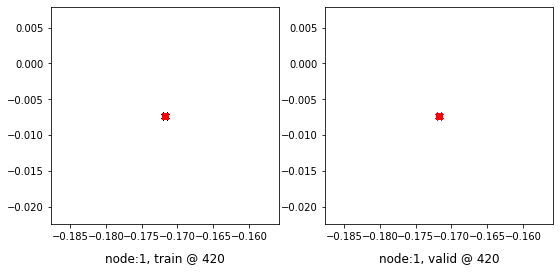

Aggregating on epoch: 421...
Aggregating on epoch: 422...
Aggregating on epoch: 423...
Aggregating on epoch: 424...
Aggregating on epoch: 425...
Aggregating on epoch: 426...
Aggregating on epoch: 427...
Aggregating on epoch: 428...
Aggregating on epoch: 429...
Aggregating on epoch: 430...
Aggregating on epoch: 431...
Aggregating on epoch: 432...
Aggregating on epoch: 433...
Aggregating on epoch: 434...
Aggregating on epoch: 435...
Aggregating on epoch: 436...
Aggregating on epoch: 437...
Aggregating on epoch: 438...
Aggregating on epoch: 439...
Aggregating on epoch: 440...
440 	 0 	 0.77497566 	 0.74768955 	 0.95219588 	 0.95394814 	 0.87036741 	 0.89940578


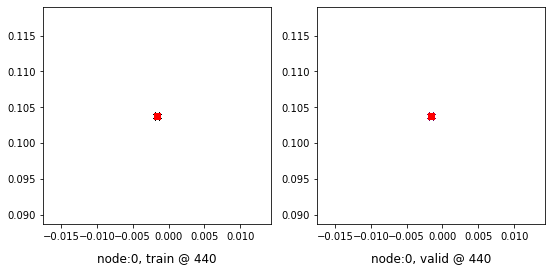

440 	 1 	 0.70546401 	 0.68655908 	 0.96838659 	 0.94523329 	 0.95607018 	 0.95182139


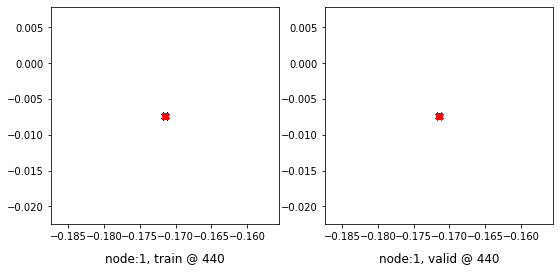

Aggregating on epoch: 441...
Aggregating on epoch: 442...
Aggregating on epoch: 443...
Aggregating on epoch: 444...
Aggregating on epoch: 445...
Aggregating on epoch: 446...
Aggregating on epoch: 447...
Aggregating on epoch: 448...
Aggregating on epoch: 449...
Aggregating on epoch: 450...
Aggregating on epoch: 451...
Aggregating on epoch: 452...
Aggregating on epoch: 453...
Aggregating on epoch: 454...
Aggregating on epoch: 455...
Aggregating on epoch: 456...
Aggregating on epoch: 457...
Aggregating on epoch: 458...
Aggregating on epoch: 459...
Aggregating on epoch: 460...
460 	 0 	 0.76193774 	 0.74768817 	 0.95627636 	 0.95395100 	 0.88748580 	 0.89941001


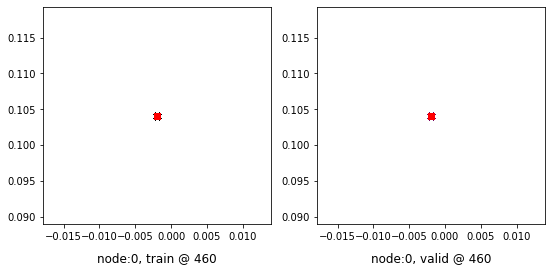

460 	 1 	 0.69825411 	 0.68654889 	 0.95279312 	 0.94523066 	 0.94768614 	 0.95182896


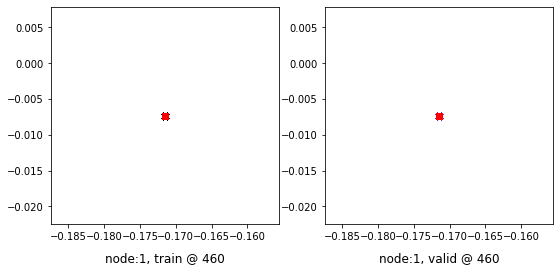

Aggregating on epoch: 461...
Aggregating on epoch: 462...
Aggregating on epoch: 463...
Aggregating on epoch: 464...
Aggregating on epoch: 465...
Aggregating on epoch: 466...
Aggregating on epoch: 467...
Aggregating on epoch: 468...
Aggregating on epoch: 469...
Aggregating on epoch: 470...
Aggregating on epoch: 471...
Aggregating on epoch: 472...
Aggregating on epoch: 473...
Aggregating on epoch: 474...
Aggregating on epoch: 475...
Aggregating on epoch: 476...
Aggregating on epoch: 477...
Aggregating on epoch: 478...
Aggregating on epoch: 479...
Aggregating on epoch: 480...
480 	 0 	 0.72643465 	 0.74768269 	 0.94824237 	 0.95394337 	 0.91495478 	 0.89940786


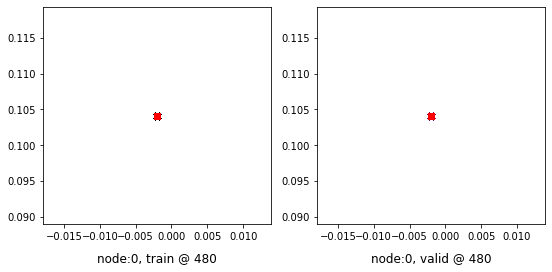

480 	 1 	 0.68673688 	 0.68656427 	 0.94766396 	 0.94523871 	 0.95407432 	 0.95182163


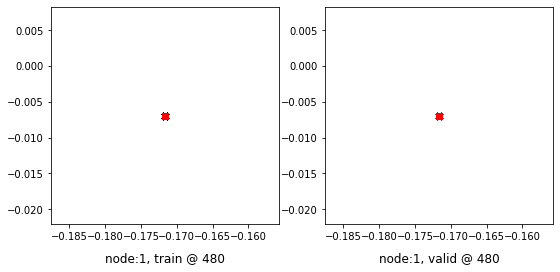

Aggregating on epoch: 481...
Aggregating on epoch: 482...
Aggregating on epoch: 483...
Aggregating on epoch: 484...
Aggregating on epoch: 485...
Aggregating on epoch: 486...
Aggregating on epoch: 487...
Aggregating on epoch: 488...
Aggregating on epoch: 489...
Aggregating on epoch: 490...
Aggregating on epoch: 491...
Aggregating on epoch: 492...
Aggregating on epoch: 493...
Aggregating on epoch: 494...
Aggregating on epoch: 495...
Aggregating on epoch: 496...
Aggregating on epoch: 497...
Aggregating on epoch: 498...
Aggregating on epoch: 499...
Aggregating on epoch: 500...
500 	 0 	 0.75269580 	 0.74769175 	 0.96077025 	 0.95395035 	 0.90122169 	 0.89940578


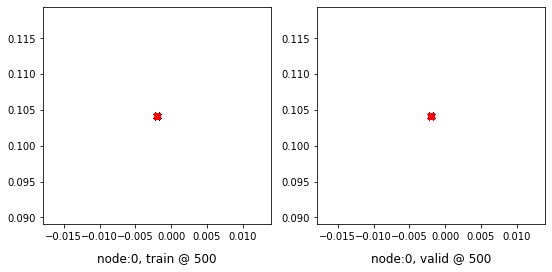

500 	 1 	 0.69375962 	 0.68655068 	 0.94888389 	 0.94522703 	 0.94827110 	 0.95182353


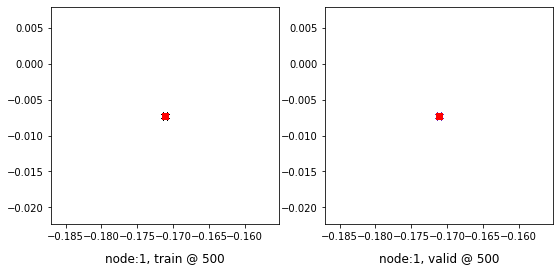

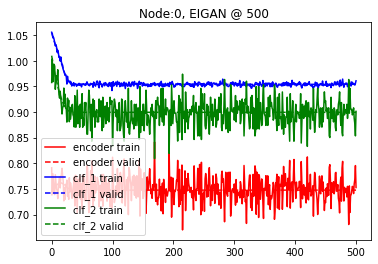

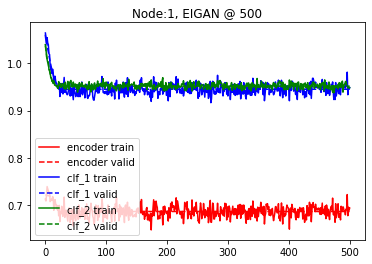

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.4 and delta=3
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.74039102 	 0.70062459 	 1.03284943 	 1.03169632 	 0.98569655 	 1.02421892


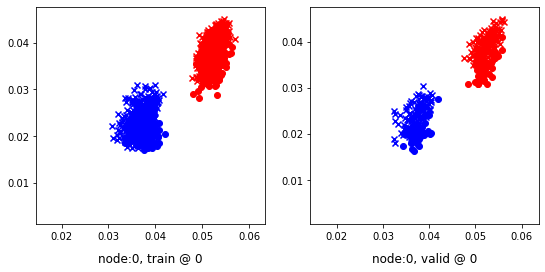

0 	 1 	 0.71720135 	 0.72016692 	 1.02145135 	 1.02116179 	 0.99768162 	 0.99414206


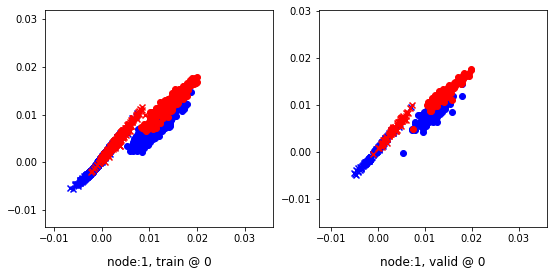

Aggregating on epoch: 3...
Aggregating on epoch: 6...
Aggregating on epoch: 9...
Aggregating on epoch: 12...
Aggregating on epoch: 15...
Aggregating on epoch: 18...
20 	 0 	 0.76388544 	 0.74257427 	 0.96481842 	 0.96731263 	 0.89408696 	 0.91788554


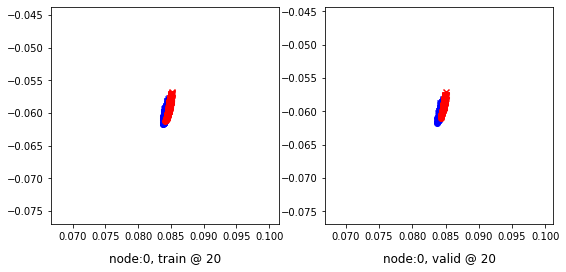

20 	 1 	 0.69705927 	 0.69350594 	 0.95444536 	 0.95261997 	 0.95054001 	 0.95226121


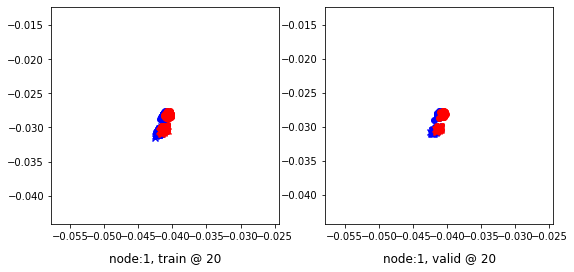

Aggregating on epoch: 21...
Aggregating on epoch: 24...
Aggregating on epoch: 27...
Aggregating on epoch: 30...
Aggregating on epoch: 33...
Aggregating on epoch: 36...
Aggregating on epoch: 39...
40 	 0 	 0.74146348 	 0.74766856 	 0.95300084 	 0.95394254 	 0.90468591 	 0.89942116


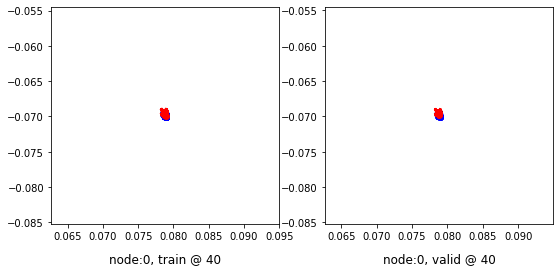

40 	 1 	 0.68029875 	 0.68655187 	 0.93863010 	 0.94522983 	 0.95147866 	 0.95182514


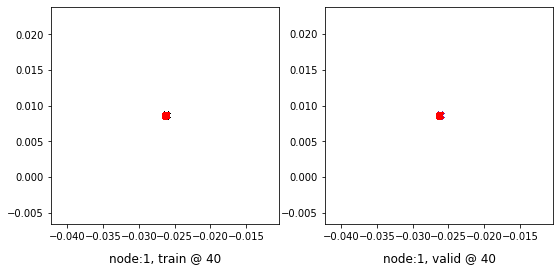

Aggregating on epoch: 42...
Aggregating on epoch: 45...
Aggregating on epoch: 48...
Aggregating on epoch: 51...
Aggregating on epoch: 54...
Aggregating on epoch: 57...
Aggregating on epoch: 60...
60 	 0 	 0.75527561 	 0.74768269 	 0.94962037 	 0.95394385 	 0.88749248 	 0.89940834


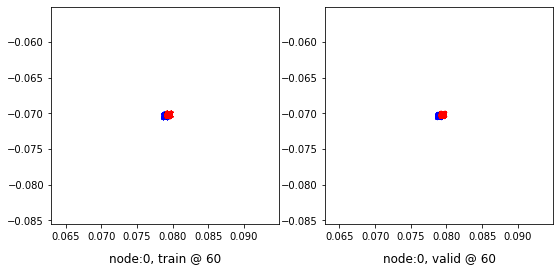

60 	 1 	 0.69941515 	 0.68654555 	 0.95149499 	 0.94523084 	 0.94522715 	 0.95183247


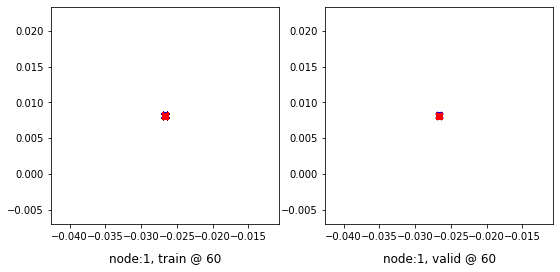

Aggregating on epoch: 63...
Aggregating on epoch: 66...
Aggregating on epoch: 69...
Aggregating on epoch: 72...
Aggregating on epoch: 75...
Aggregating on epoch: 78...
80 	 0 	 0.80511457 	 0.74768484 	 0.95845616 	 0.95394588 	 0.84648919 	 0.89940822


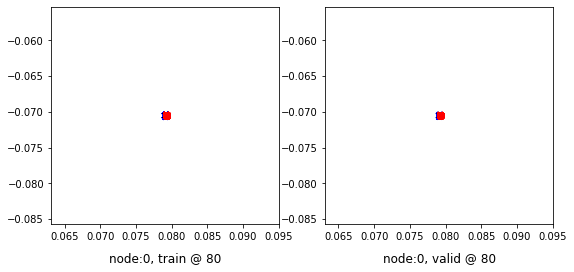

80 	 1 	 0.68871415 	 0.68655270 	 0.94120890 	 0.94522768 	 0.94564205 	 0.95182216


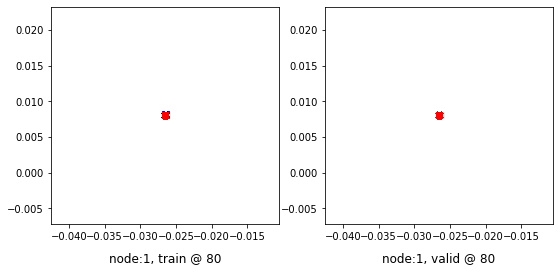

Aggregating on epoch: 81...
Aggregating on epoch: 84...
Aggregating on epoch: 87...
Aggregating on epoch: 90...
Aggregating on epoch: 93...
Aggregating on epoch: 96...
Aggregating on epoch: 99...
100 	 0 	 0.79066092 	 0.74768221 	 0.95075911 	 0.95394140 	 0.85324615 	 0.89940637


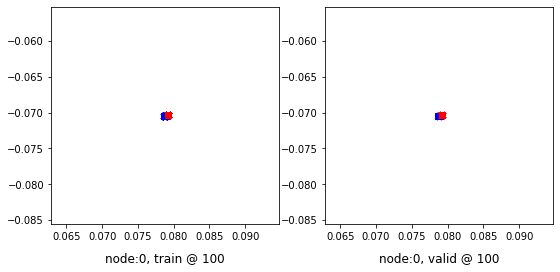

100 	 1 	 0.69302875 	 0.68655050 	 0.95913339 	 0.94522512 	 0.95925230 	 0.95182180


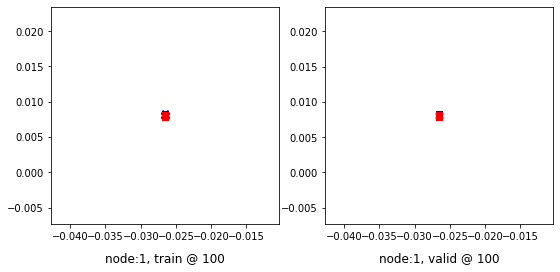

Aggregating on epoch: 102...
Aggregating on epoch: 105...
Aggregating on epoch: 108...
Aggregating on epoch: 111...
Aggregating on epoch: 114...
Aggregating on epoch: 117...
Aggregating on epoch: 120...
120 	 0 	 0.72177362 	 0.74766541 	 0.95738035 	 0.95394140 	 0.92875880 	 0.89942318


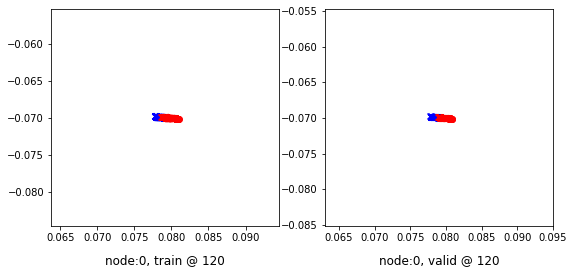

120 	 1 	 0.67711598 	 0.68654668 	 0.92972028 	 0.94522488 	 0.94575185 	 0.95182538


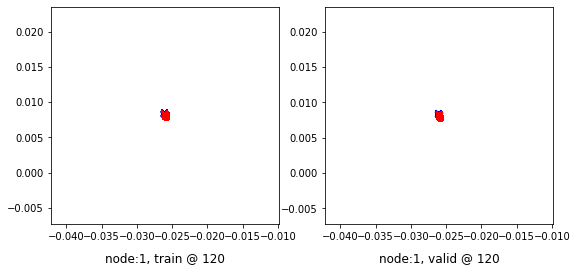

Aggregating on epoch: 123...
Aggregating on epoch: 126...
Aggregating on epoch: 129...
Aggregating on epoch: 132...
Aggregating on epoch: 135...
Aggregating on epoch: 138...
140 	 0 	 0.69810611 	 0.74735481 	 0.95102185 	 0.95386755 	 0.94610882 	 0.89965993


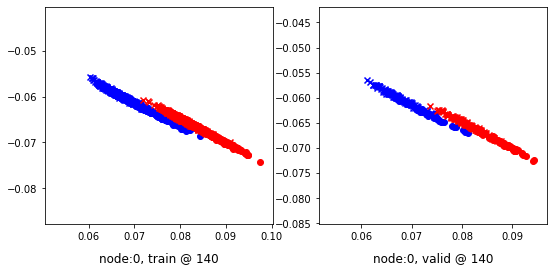

140 	 1 	 0.69757336 	 0.68649304 	 0.95141661 	 0.94517022 	 0.94699681 	 0.95182437


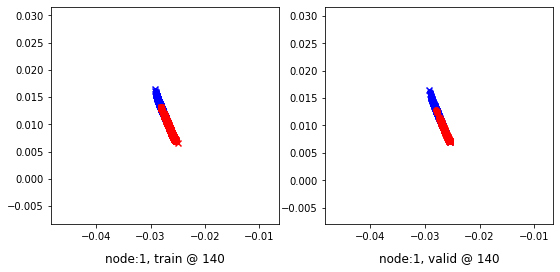

Aggregating on epoch: 141...
Aggregating on epoch: 144...
Aggregating on epoch: 147...
Aggregating on epoch: 150...
Aggregating on epoch: 153...
Aggregating on epoch: 156...
Aggregating on epoch: 159...
160 	 0 	 0.77064288 	 0.74743652 	 0.94805700 	 0.95387900 	 0.87059015 	 0.89958966


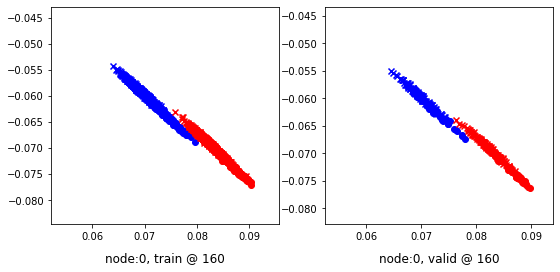

160 	 1 	 0.69212180 	 0.68523359 	 0.94651413 	 0.94388574 	 0.94764620 	 0.95179933


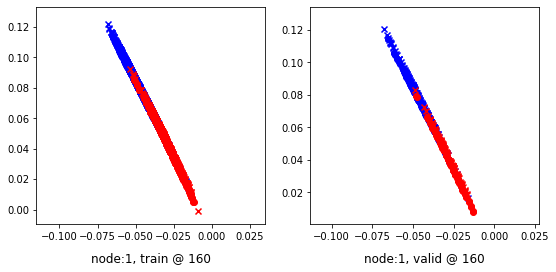

Aggregating on epoch: 162...
Aggregating on epoch: 165...
Aggregating on epoch: 168...
Aggregating on epoch: 171...
Aggregating on epoch: 174...
Aggregating on epoch: 177...
Aggregating on epoch: 180...
180 	 0 	 0.70989197 	 0.74724996 	 0.95602858 	 0.95363486 	 0.93935668 	 0.89953208


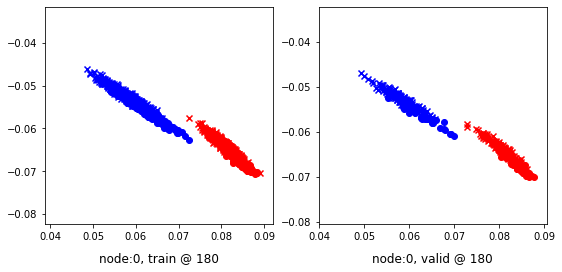

180 	 1 	 0.65711421 	 0.66985548 	 0.91570371 	 0.92841911 	 0.95328027 	 0.95171082


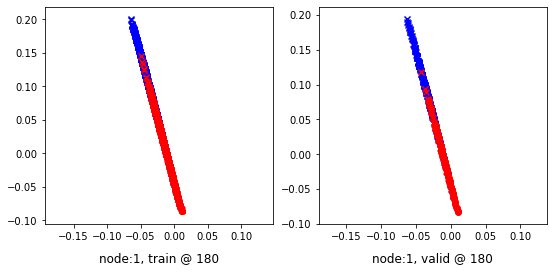

Aggregating on epoch: 183...
Aggregating on epoch: 186...
Aggregating on epoch: 189...
Aggregating on epoch: 192...
Aggregating on epoch: 195...
Aggregating on epoch: 198...
200 	 0 	 0.75230551 	 0.72161162 	 0.92993206 	 0.92746216 	 0.87311649 	 0.89899772


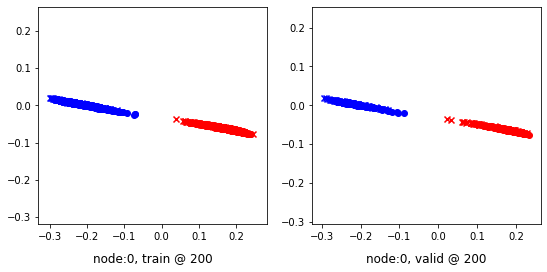

200 	 1 	 0.39461416 	 0.35241771 	 0.64583862 	 0.61122549 	 0.95392996 	 0.95195496


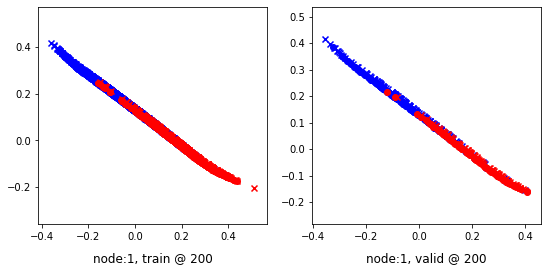

Aggregating on epoch: 201...
Aggregating on epoch: 204...
Aggregating on epoch: 207...
Aggregating on epoch: 210...
Aggregating on epoch: 213...
Aggregating on epoch: 216...
Aggregating on epoch: 219...
220 	 0 	 0.61918950 	 0.64529908 	 0.85509700 	 0.85146189 	 0.94256037 	 0.89930999


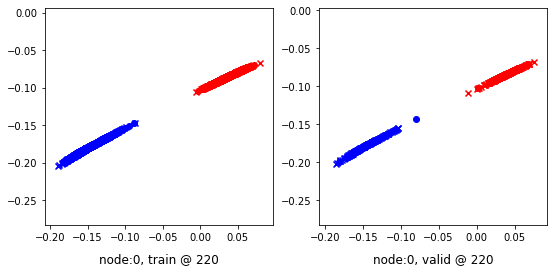

220 	 1 	 0.62107080 	 0.61086255 	 0.87492853 	 0.86987203 	 0.95305252 	 0.95215666


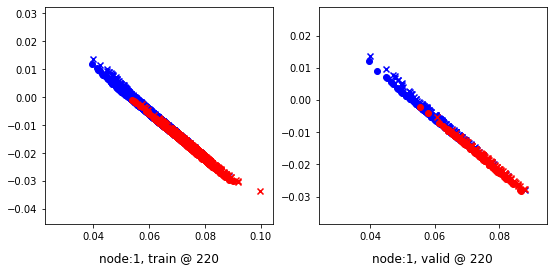

Aggregating on epoch: 222...
Aggregating on epoch: 225...
Aggregating on epoch: 228...
Aggregating on epoch: 231...
Aggregating on epoch: 234...
Aggregating on epoch: 237...
Aggregating on epoch: 240...
240 	 0 	 0.55316961 	 0.51345879 	 0.71550417 	 0.71890152 	 0.88575602 	 0.89858991


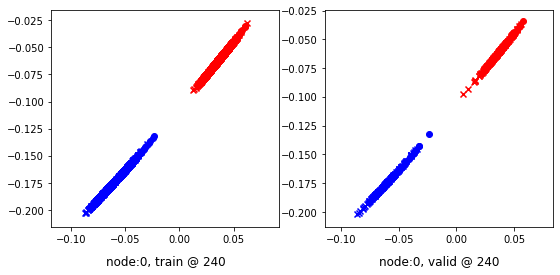

240 	 1 	 0.64451200 	 0.63077569 	 0.89164162 	 0.88912201 	 0.95304483 	 0.95149350


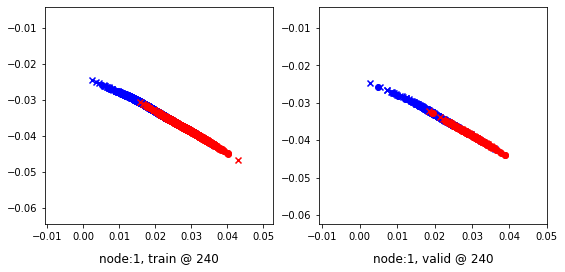

Aggregating on epoch: 243...
Aggregating on epoch: 246...
Aggregating on epoch: 249...
Aggregating on epoch: 252...
Aggregating on epoch: 255...
Aggregating on epoch: 258...
260 	 0 	 0.12980637 	 0.11348188 	 0.31664258 	 0.31690890 	 0.90582430 	 0.89657420


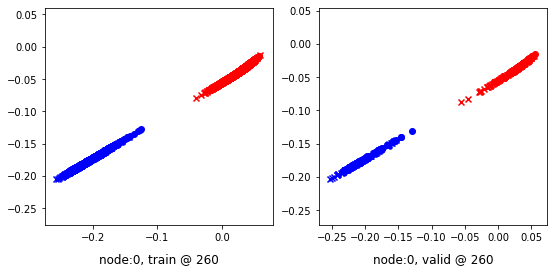

260 	 1 	 0.56524903 	 0.55064434 	 0.81868875 	 0.80796975 	 0.95346737 	 0.95047259


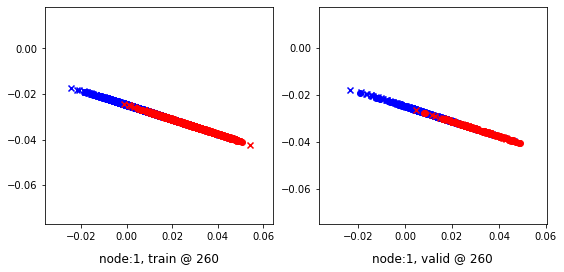

Aggregating on epoch: 261...
Aggregating on epoch: 264...
Aggregating on epoch: 267...
Aggregating on epoch: 270...
Aggregating on epoch: 273...
Aggregating on epoch: 276...
Aggregating on epoch: 279...
280 	 0 	 0.33575296 	 0.29635584 	 0.49922675 	 0.50250024 	 0.89314514 	 0.89929157


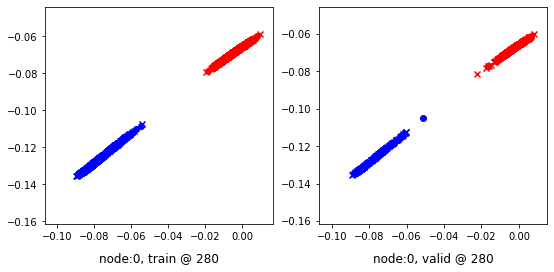

280 	 1 	 0.62253350 	 0.63166708 	 0.87731546 	 0.88989395 	 0.95305854 	 0.95137405


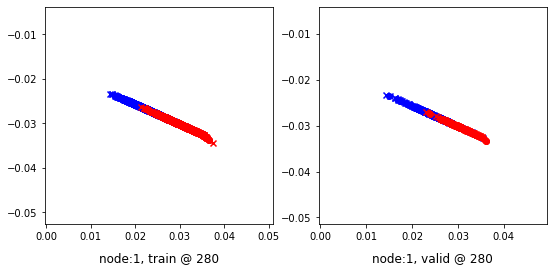

Aggregating on epoch: 282...
Aggregating on epoch: 285...
Aggregating on epoch: 288...
Aggregating on epoch: 291...
Aggregating on epoch: 294...
Aggregating on epoch: 297...
Aggregating on epoch: 300...
300 	 0 	 0.42361516 	 0.39711535 	 0.59430736 	 0.60286772 	 0.91348648 	 0.89889956


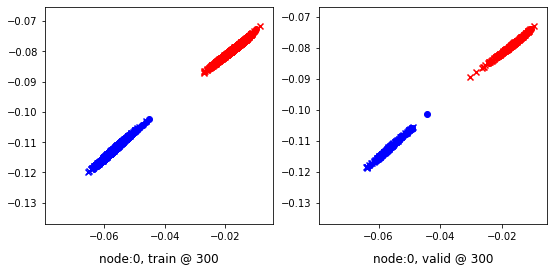

300 	 1 	 0.53583348 	 0.52266371 	 0.77736723 	 0.77932113 	 0.95025390 	 0.94980460


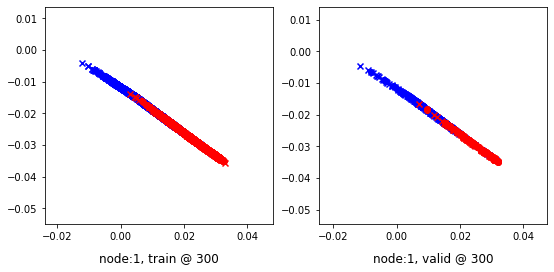

Aggregating on epoch: 303...
Aggregating on epoch: 306...
Aggregating on epoch: 309...
Aggregating on epoch: 312...
Aggregating on epoch: 315...
Aggregating on epoch: 318...
320 	 0 	 0.23001680 	 0.18060651 	 0.37824732 	 0.38621369 	 0.87294364 	 0.89875436


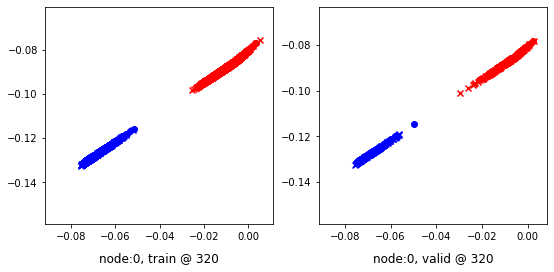

320 	 1 	 0.64373881 	 0.63179797 	 0.88618201 	 0.88963252 	 0.94068623 	 0.95098174


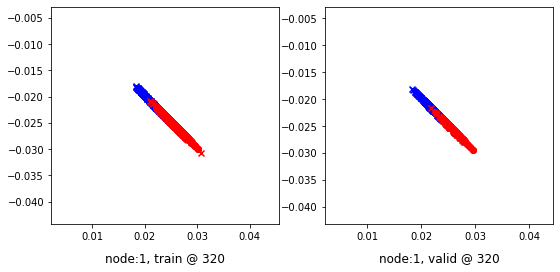

Aggregating on epoch: 321...
Aggregating on epoch: 324...
Aggregating on epoch: 327...
Aggregating on epoch: 330...
Aggregating on epoch: 333...
Aggregating on epoch: 336...
Aggregating on epoch: 339...
340 	 0 	 0.61723530 	 0.58455771 	 0.78979003 	 0.79053676 	 0.88383472 	 0.89912623


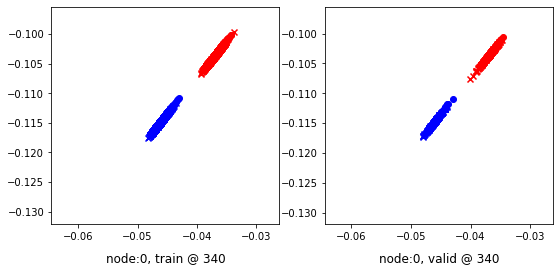

340 	 1 	 0.60340214 	 0.61169851 	 0.85712677 	 0.86975509 	 0.95351195 	 0.95120376


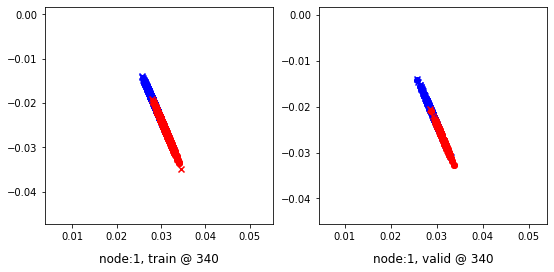

Aggregating on epoch: 342...
Aggregating on epoch: 345...
Aggregating on epoch: 348...
Aggregating on epoch: 351...
Aggregating on epoch: 354...
Aggregating on epoch: 357...
Aggregating on epoch: 360...
360 	 0 	 0.62376696 	 0.63716096 	 0.82936859 	 0.84331852 	 0.91474670 	 0.89930475


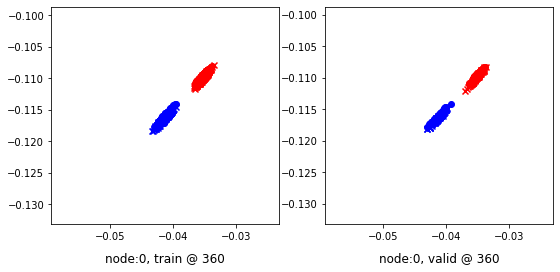

360 	 1 	 0.58918542 	 0.55299366 	 0.82800746 	 0.81111264 	 0.96321058 	 0.95126617


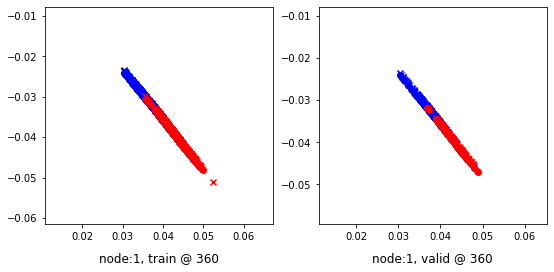

Aggregating on epoch: 363...
Aggregating on epoch: 366...
Aggregating on epoch: 369...
Aggregating on epoch: 372...
Aggregating on epoch: 375...
Aggregating on epoch: 378...
380 	 0 	 0.69498539 	 0.67338246 	 0.87805521 	 0.87915826 	 0.88691723 	 0.89892298


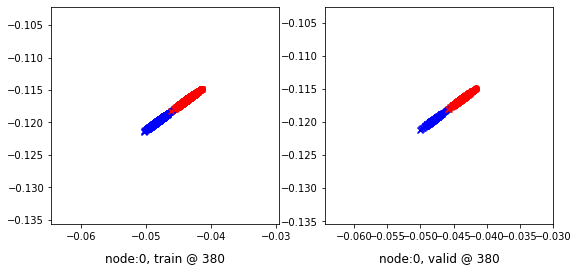

380 	 1 	 0.50449520 	 0.45968705 	 0.73963386 	 0.71529400 	 0.93553615 	 0.94875413


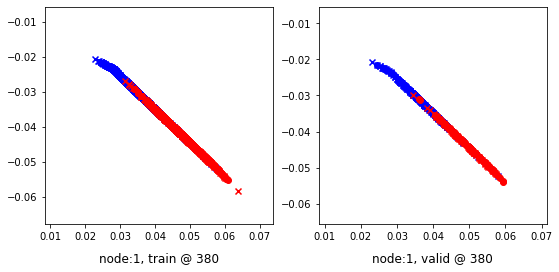

Aggregating on epoch: 381...
Aggregating on epoch: 384...
Aggregating on epoch: 387...
Aggregating on epoch: 390...
Aggregating on epoch: 393...
Aggregating on epoch: 396...
Aggregating on epoch: 399...
400 	 0 	 0.67298847 	 0.69527328 	 0.90604925 	 0.90138185 	 0.93207139 	 0.89925575


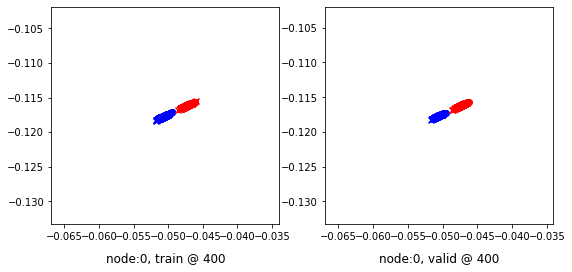

400 	 1 	 0.64651853 	 0.64033651 	 0.89682698 	 0.89879155 	 0.94664669 	 0.95160222


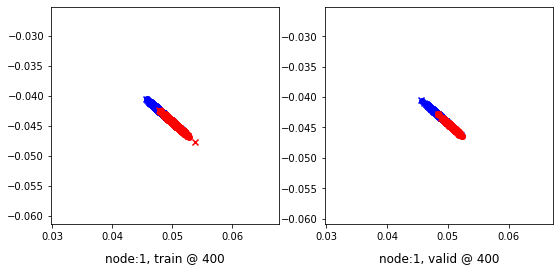

Aggregating on epoch: 402...
Aggregating on epoch: 405...
Aggregating on epoch: 408...
Aggregating on epoch: 411...
Aggregating on epoch: 414...
Aggregating on epoch: 417...
Aggregating on epoch: 420...
420 	 0 	 0.69460130 	 0.65819514 	 0.85904211 	 0.86441642 	 0.87016881 	 0.89936846


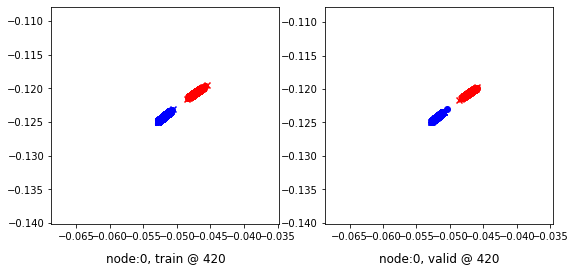

420 	 1 	 0.62565666 	 0.61206025 	 0.87431204 	 0.87004763 	 0.94827878 	 0.95113456


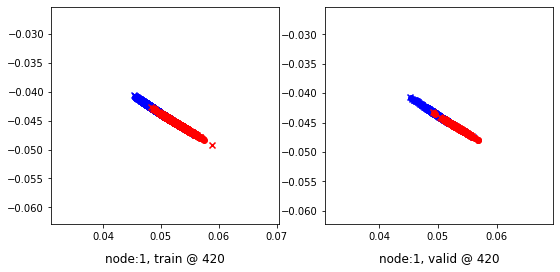

Aggregating on epoch: 423...
Aggregating on epoch: 426...
Aggregating on epoch: 429...
Aggregating on epoch: 432...
Aggregating on epoch: 435...
Aggregating on epoch: 438...
440 	 0 	 0.47465169 	 0.46218115 	 0.66213703 	 0.66846335 	 0.91507024 	 0.89942938


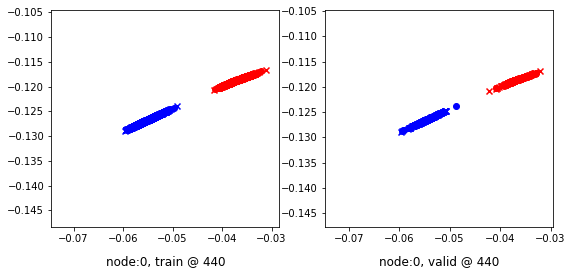

440 	 1 	 0.45947540 	 0.40223962 	 0.69852883 	 0.65990943 	 0.95029283 	 0.95081699


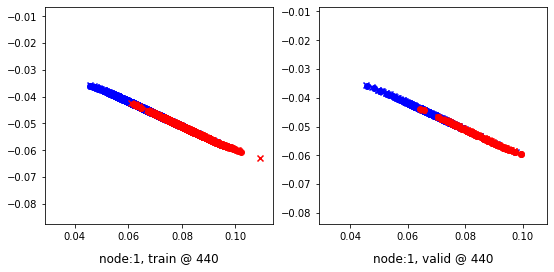

Aggregating on epoch: 441...
Aggregating on epoch: 444...
Aggregating on epoch: 447...
Aggregating on epoch: 450...
Aggregating on epoch: 453...
Aggregating on epoch: 456...
Aggregating on epoch: 459...
460 	 0 	 -0.09233016 	 -0.06599632 	 0.13664676 	 0.13925299 	 0.93867171 	 0.89839649


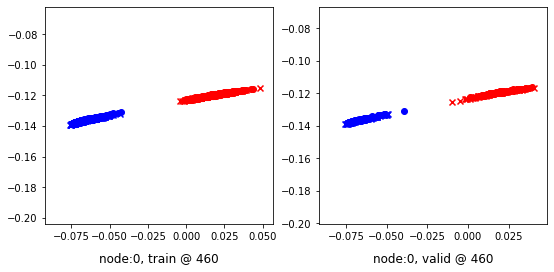

460 	 1 	 0.64855450 	 0.68927532 	 0.93018311 	 0.94793028 	 0.95348072 	 0.95180213


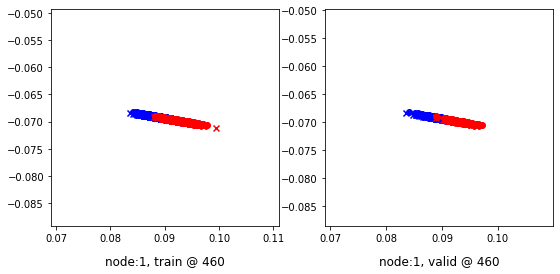

Aggregating on epoch: 462...
Aggregating on epoch: 465...
Aggregating on epoch: 468...
Aggregating on epoch: 471...
Aggregating on epoch: 474...
Aggregating on epoch: 477...
Aggregating on epoch: 480...
480 	 0 	 0.72114408 	 0.68798214 	 0.89379108 	 0.89431602 	 0.89781499 	 0.89948106


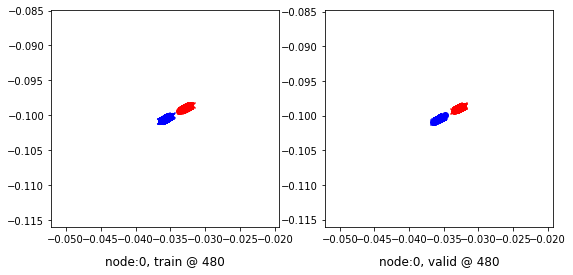

480 	 1 	 0.67266220 	 0.68556750 	 0.93414003 	 0.94422114 	 0.95468509 	 0.95180082


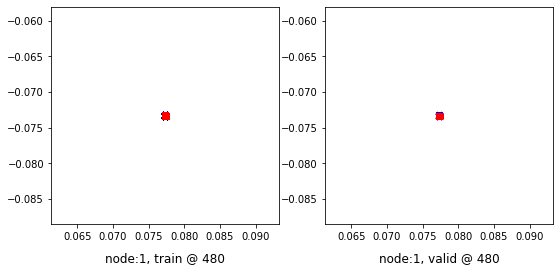

Aggregating on epoch: 483...
Aggregating on epoch: 486...
Aggregating on epoch: 489...
Aggregating on epoch: 492...
Aggregating on epoch: 495...
Aggregating on epoch: 498...
500 	 0 	 0.71040708 	 0.73558336 	 0.93783170 	 0.94184470 	 0.92185283 	 0.89940852


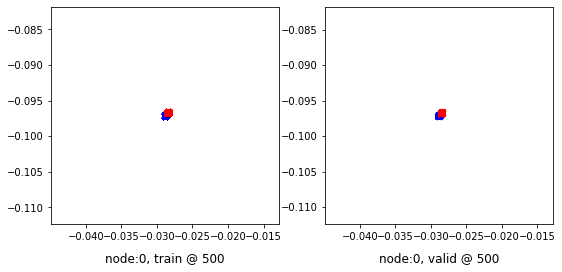

500 	 1 	 0.69067901 	 0.68623561 	 0.95424420 	 0.94491631 	 0.95687479 	 0.95182788


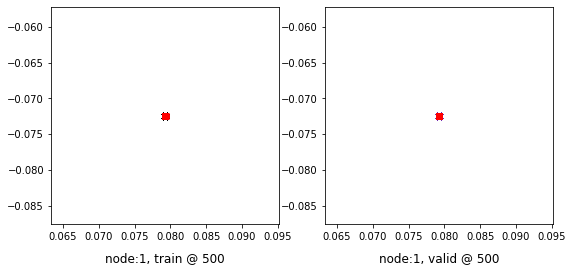

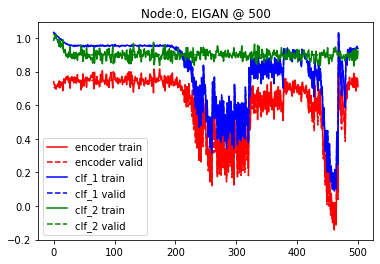

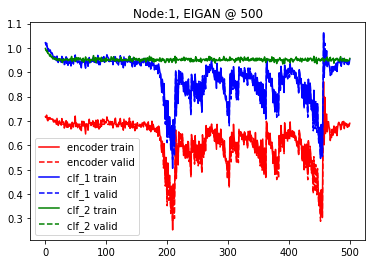

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.4 and delta=5
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.55340528 	 0.58764625 	 0.98211598 	 0.98242676 	 1.12198055 	 1.08792770


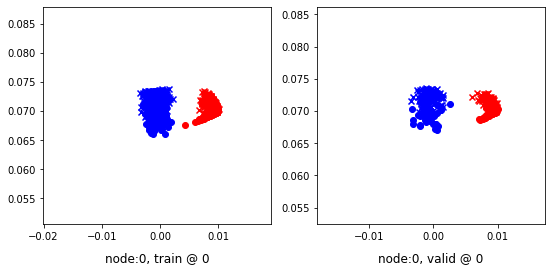

0 	 1 	 0.69049859 	 0.69134510 	 1.01348090 	 1.00925875 	 1.01617873 	 1.01106083


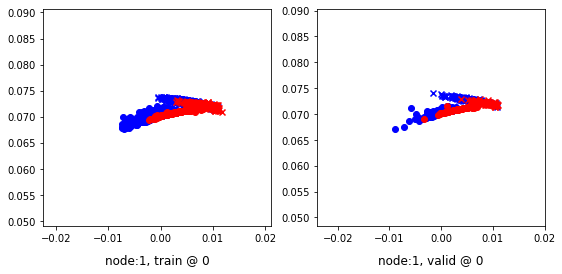

Aggregating on epoch: 5...
Aggregating on epoch: 10...
Aggregating on epoch: 15...
Aggregating on epoch: 20...
20 	 0 	 0.70902520 	 0.68159419 	 0.95086741 	 0.95393115 	 0.93514568 	 0.96548414


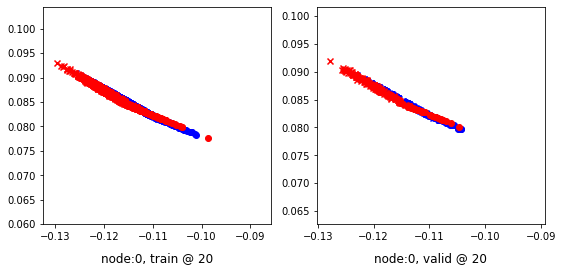

20 	 1 	 0.67261547 	 0.68691176 	 0.93145829 	 0.94548237 	 0.95201880 	 0.95171779


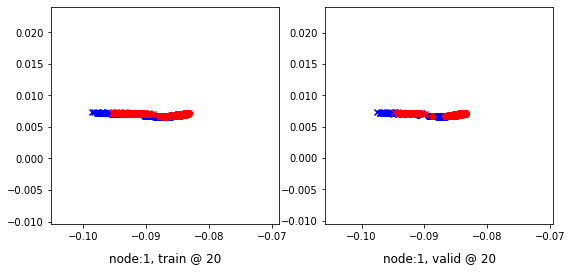

Aggregating on epoch: 25...
Aggregating on epoch: 30...
Aggregating on epoch: 35...
Aggregating on epoch: 40...
40 	 0 	 0.78050929 	 0.74056172 	 0.95790917 	 0.95374781 	 0.87057745 	 0.90633327


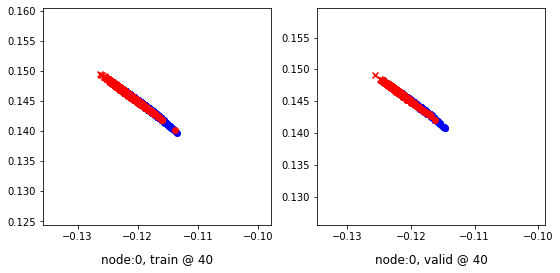

40 	 1 	 0.68469107 	 0.68646008 	 0.94235617 	 0.94509095 	 0.95082247 	 0.95177805


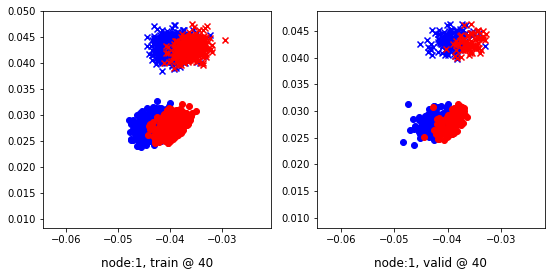

Aggregating on epoch: 45...
Aggregating on epoch: 50...
Aggregating on epoch: 55...
Aggregating on epoch: 60...
60 	 0 	 0.75539166 	 0.74627936 	 0.95305383 	 0.95256299 	 0.89102292 	 0.89943081


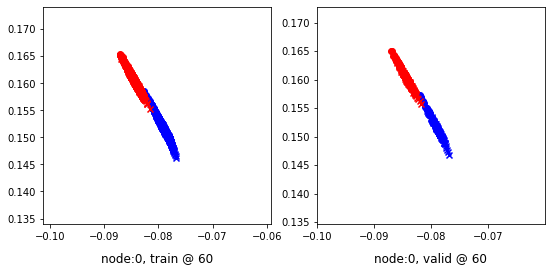

60 	 1 	 0.70668465 	 0.68635809 	 0.96172863 	 0.94504929 	 0.94822156 	 0.95183837


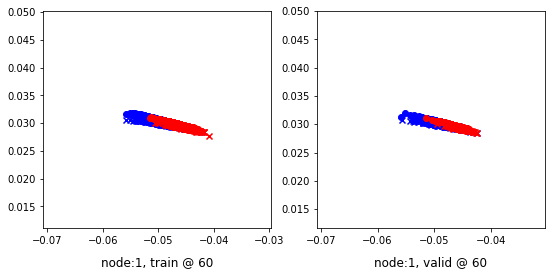

Aggregating on epoch: 65...
Aggregating on epoch: 70...
Aggregating on epoch: 75...
Aggregating on epoch: 80...
80 	 0 	 0.71404374 	 0.71831805 	 0.92776245 	 0.92464072 	 0.91160947 	 0.89946985


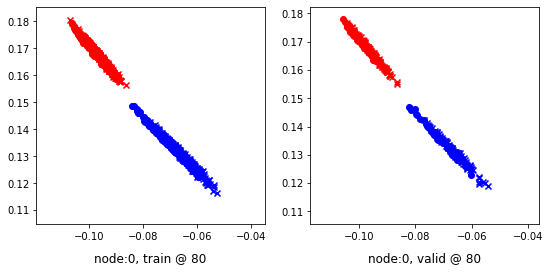

80 	 1 	 0.66591513 	 0.68490219 	 0.93034816 	 0.94354898 	 0.95776063 	 0.95179397


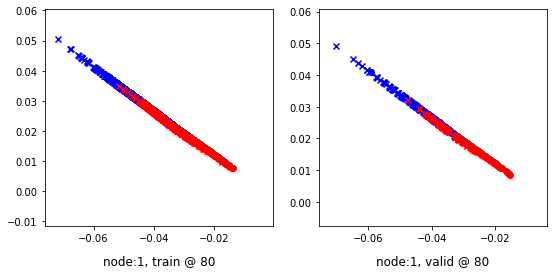

Aggregating on epoch: 85...
Aggregating on epoch: 90...
Aggregating on epoch: 95...
Aggregating on epoch: 100...
100 	 0 	 0.41632140 	 0.33342558 	 0.54232836 	 0.53971541 	 0.85651666 	 0.89943701


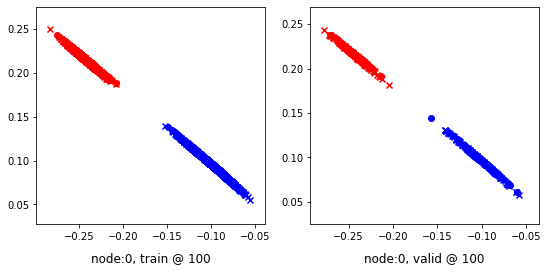

100 	 1 	 0.41201127 	 0.39336914 	 0.66329807 	 0.65051740 	 0.95209408 	 0.95029545


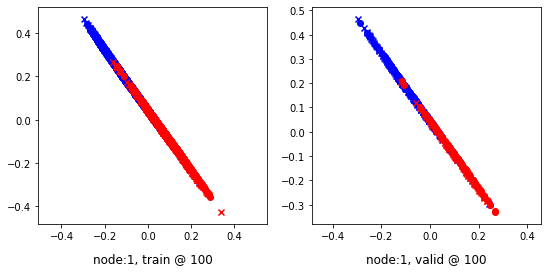

Aggregating on epoch: 105...
Aggregating on epoch: 110...
Aggregating on epoch: 115...
Aggregating on epoch: 120...
120 	 0 	 0.56930250 	 0.41837180 	 0.64968717 	 0.62468344 	 0.90819782 	 0.89945883


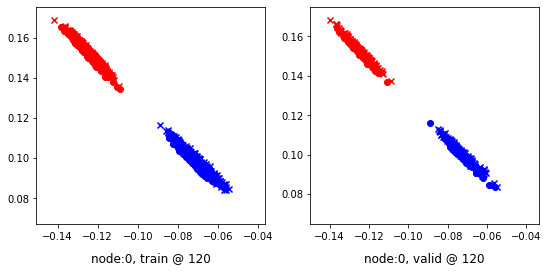

120 	 1 	 0.45348066 	 0.41680610 	 0.69399846 	 0.67489213 	 0.94369125 	 0.95123321


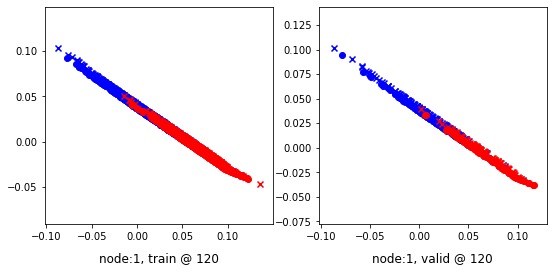

Aggregating on epoch: 125...
Aggregating on epoch: 130...
Aggregating on epoch: 135...
Aggregating on epoch: 140...
140 	 0 	 0.71540713 	 0.67129481 	 0.87496638 	 0.87755877 	 0.87373245 	 0.89941114


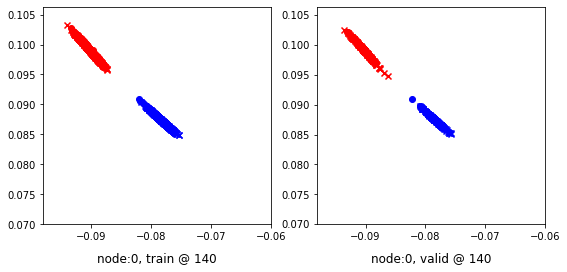

140 	 1 	 0.58392507 	 0.56545281 	 0.83940876 	 0.82386589 	 0.95762330 	 0.95156026


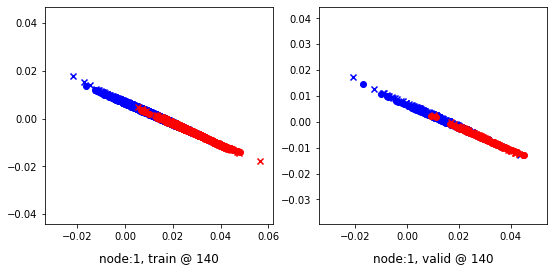

Aggregating on epoch: 145...
Aggregating on epoch: 150...
Aggregating on epoch: 155...
Aggregating on epoch: 160...
160 	 0 	 0.53624582 	 0.47649217 	 0.67982650 	 0.68274993 	 0.88060695 	 0.89940494


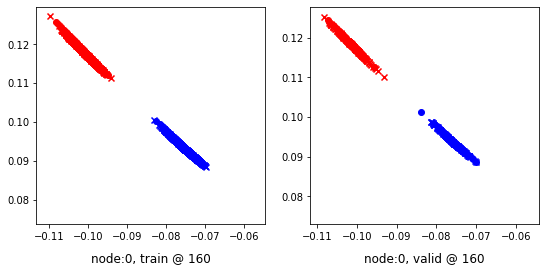

160 	 1 	 0.49042708 	 0.49564165 	 0.74600410 	 0.75396323 	 0.96008170 	 0.95146877


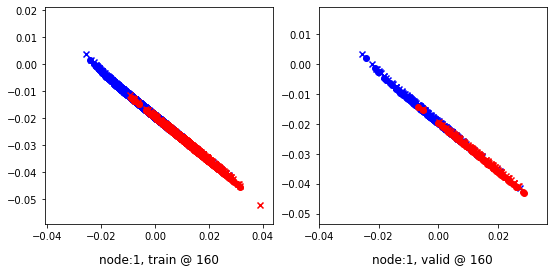

Aggregating on epoch: 165...
Aggregating on epoch: 170...
Aggregating on epoch: 175...
Aggregating on epoch: 180...
180 	 0 	 0.50537491 	 0.56699061 	 0.76744312 	 0.77325892 	 0.97368324 	 0.89941549


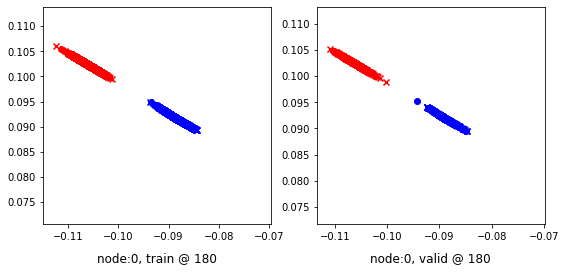

180 	 1 	 0.32955587 	 0.28431249 	 0.57585615 	 0.54148740 	 0.94711643 	 0.95032209


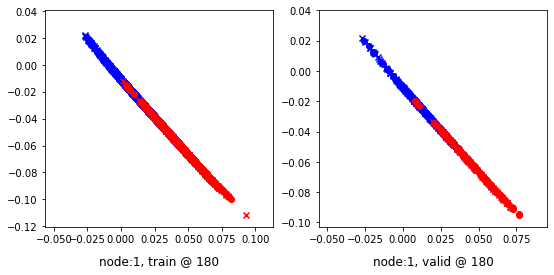

Aggregating on epoch: 185...
Aggregating on epoch: 190...
Aggregating on epoch: 195...
Aggregating on epoch: 200...
200 	 0 	 0.70496243 	 0.70922488 	 0.90937912 	 0.91549039 	 0.90124220 	 0.89941269


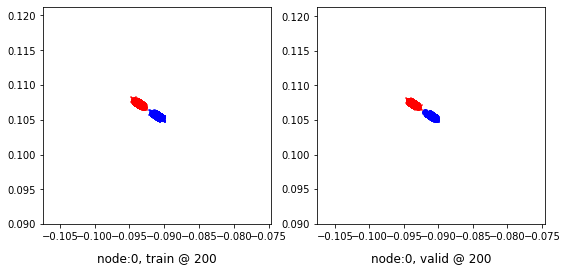

200 	 1 	 0.72059888 	 0.67230725 	 0.96023393 	 0.93092227 	 0.94785261 	 0.95176220


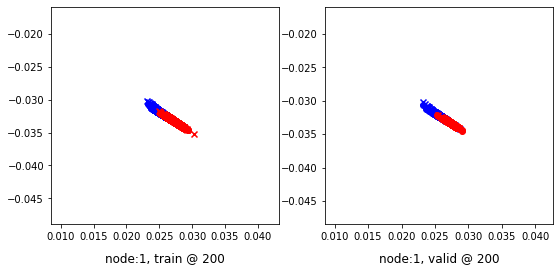

Aggregating on epoch: 205...
Aggregating on epoch: 210...
Aggregating on epoch: 215...
Aggregating on epoch: 220...
220 	 0 	 0.65781933 	 0.65847474 	 0.86131722 	 0.86473024 	 0.90464997 	 0.89940268


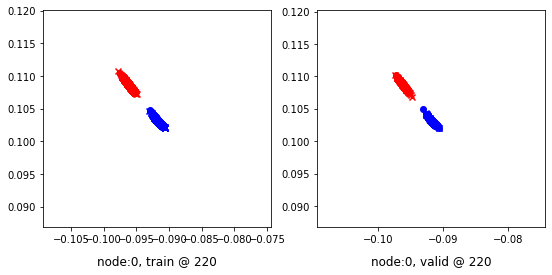

220 	 1 	 0.71415663 	 0.67519790 	 0.96787930 	 0.93382043 	 0.95203447 	 0.95176971


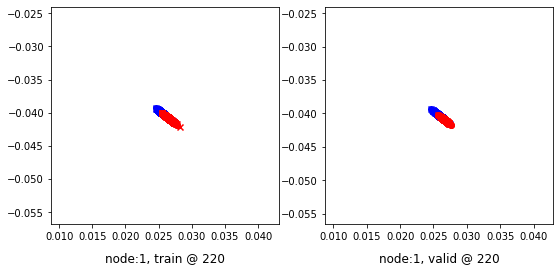

Aggregating on epoch: 225...
Aggregating on epoch: 230...
Aggregating on epoch: 235...
Aggregating on epoch: 240...
240 	 0 	 0.58464432 	 0.57536352 	 0.77531302 	 0.78161669 	 0.90806764 	 0.89940035


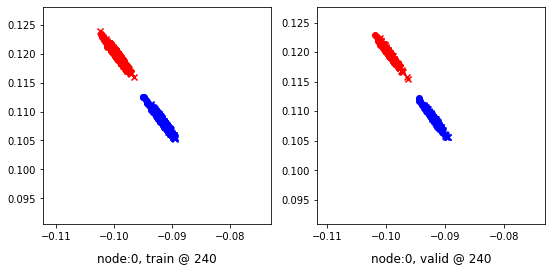

240 	 1 	 0.63779640 	 0.65322757 	 0.89151126 	 0.91209364 	 0.94956362 	 0.95201325


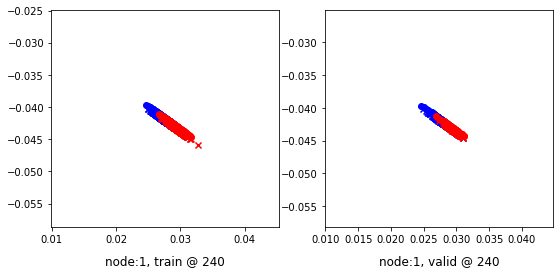

Aggregating on epoch: 245...
Aggregating on epoch: 250...
Aggregating on epoch: 255...
Aggregating on epoch: 260...
260 	 0 	 0.67465442 	 0.59446031 	 0.82846856 	 0.80072230 	 0.92877662 	 0.89940917


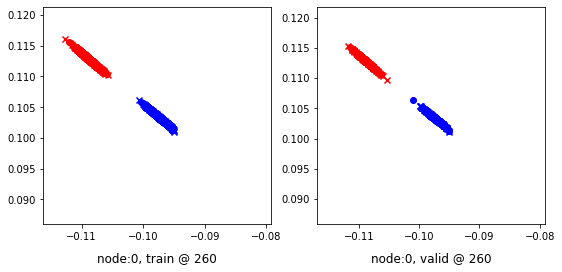

260 	 1 	 0.57282597 	 0.48287022 	 0.76954919 	 0.74121845 	 0.94904232 	 0.95149541


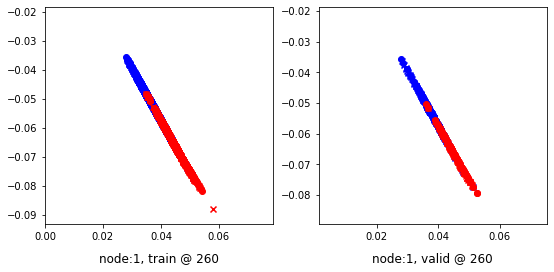

Aggregating on epoch: 265...
Aggregating on epoch: 270...
Aggregating on epoch: 275...
Aggregating on epoch: 280...
280 	 0 	 0.67352623 	 0.57961518 	 0.79067761 	 0.78587073 	 0.84653437 	 0.89940274


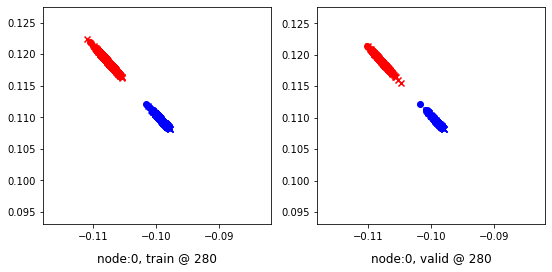

280 	 1 	 0.60255158 	 0.55467594 	 0.82142973 	 0.81322896 	 0.95757467 	 0.95170021


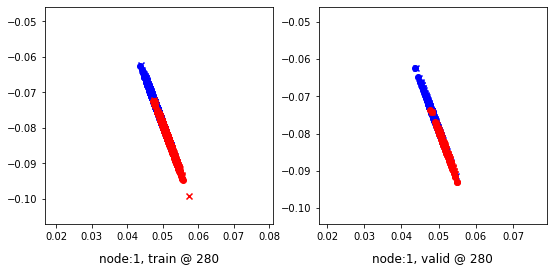

Aggregating on epoch: 285...
Aggregating on epoch: 290...
Aggregating on epoch: 295...
Aggregating on epoch: 300...
300 	 0 	 0.70289540 	 0.59445035 	 0.83800530 	 0.80071306 	 0.92191470 	 0.89940989


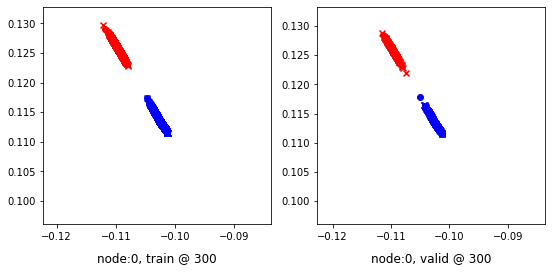

300 	 1 	 0.62989295 	 0.54262060 	 0.82150960 	 0.80168229 	 0.94509351 	 0.95220888


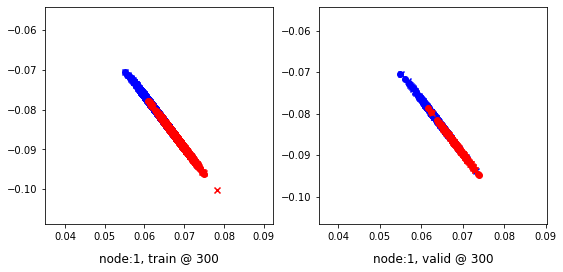

Aggregating on epoch: 305...
Aggregating on epoch: 310...
Aggregating on epoch: 315...
Aggregating on epoch: 320...
320 	 0 	 0.56598884 	 0.45780647 	 0.67382371 	 0.66406095 	 0.90120667 	 0.89940166


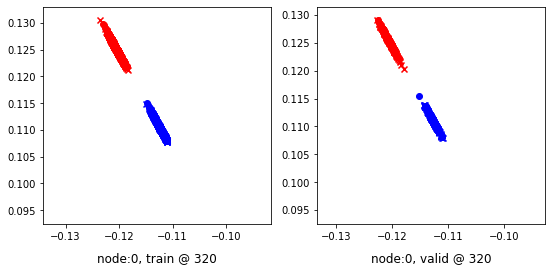

320 	 1 	 0.66418010 	 0.70953947 	 0.89490426 	 0.96800083 	 0.95365441 	 0.95160854


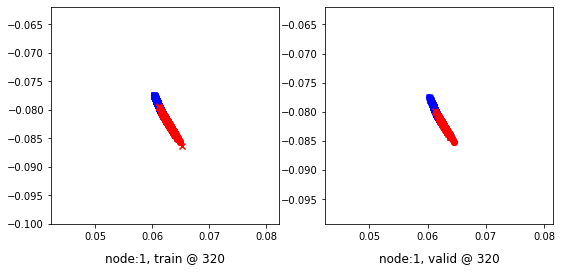

Aggregating on epoch: 325...
Aggregating on epoch: 330...
Aggregating on epoch: 335...
Aggregating on epoch: 340...
340 	 0 	 0.25367364 	 0.18408361 	 0.39576140 	 0.39034244 	 0.92523336 	 0.89940602


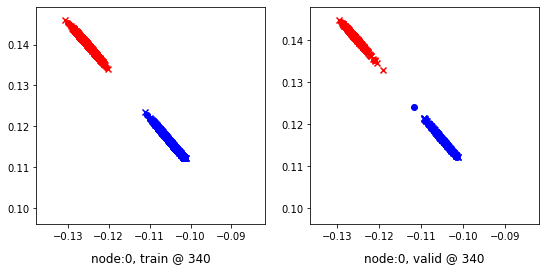

340 	 1 	 0.59201312 	 0.52453774 	 0.81861973 	 0.78192067 	 0.94433945 	 0.95053011


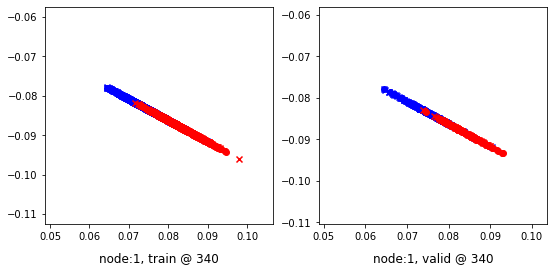

Aggregating on epoch: 345...
Aggregating on epoch: 350...
Aggregating on epoch: 355...
Aggregating on epoch: 360...
360 	 0 	 0.62300342 	 0.55204302 	 0.77680182 	 0.75830042 	 0.90122247 	 0.89940459


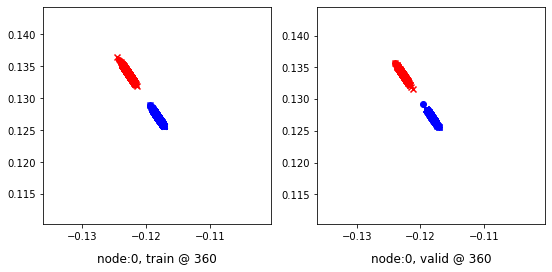

360 	 1 	 0.59670645 	 0.61404318 	 0.84017843 	 0.87214422 	 0.94200587 	 0.95124823


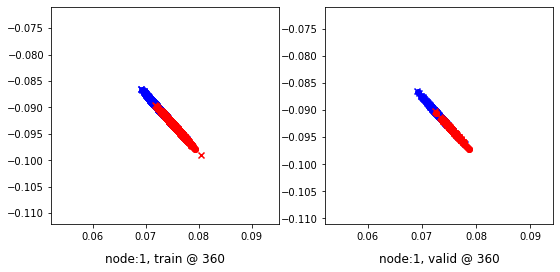

Aggregating on epoch: 365...
Aggregating on epoch: 370...
Aggregating on epoch: 375...
Aggregating on epoch: 380...
380 	 0 	 0.51103461 	 0.39585304 	 0.61100966 	 0.60211408 	 0.87374657 	 0.89940822


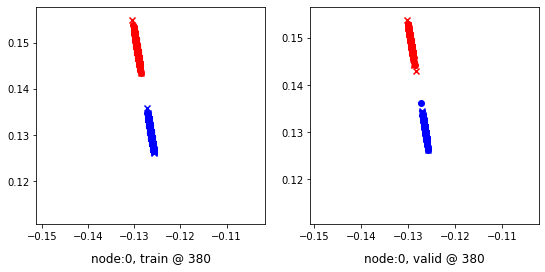

380 	 1 	 0.44488525 	 0.43069506 	 0.70049065 	 0.68911040 	 0.95472515 	 0.95156252


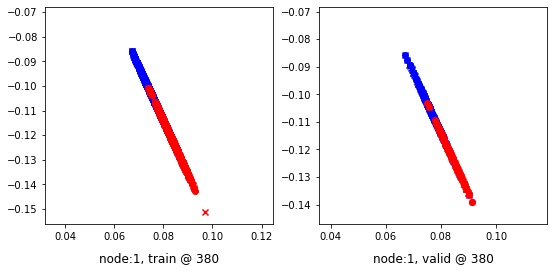

Aggregating on epoch: 385...
Aggregating on epoch: 390...
Aggregating on epoch: 395...
Aggregating on epoch: 400...
400 	 0 	 0.62027180 	 0.57951826 	 0.78979200 	 0.78578496 	 0.93922889 	 0.89941388


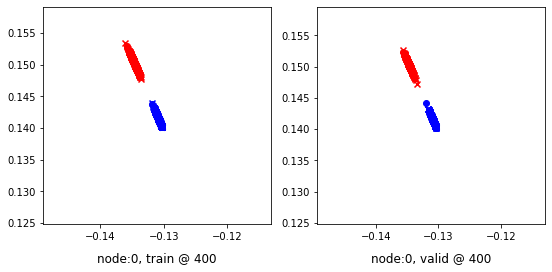

400 	 1 	 0.61338848 	 0.59639496 	 0.85636413 	 0.85489357 	 0.94822210 	 0.95164579


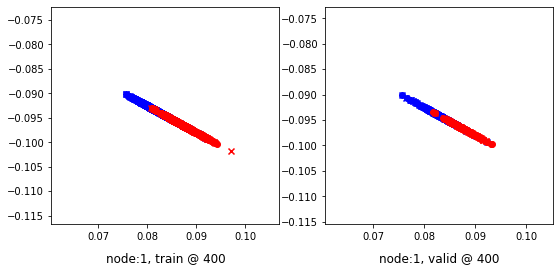

Aggregating on epoch: 405...
Aggregating on epoch: 410...
Aggregating on epoch: 415...
Aggregating on epoch: 420...
420 	 0 	 0.16900977 	 0.21168891 	 0.40927345 	 0.41796634 	 0.96368885 	 0.89942461


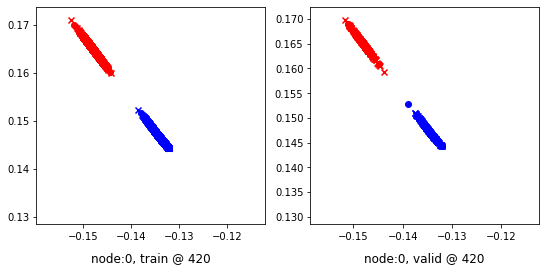

420 	 1 	 0.66554904 	 0.66074473 	 0.89839286 	 0.91942108 	 0.94531131 	 0.95182353


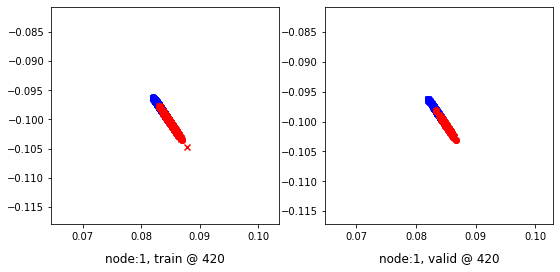

Aggregating on epoch: 425...
Aggregating on epoch: 430...
Aggregating on epoch: 435...
Aggregating on epoch: 440...
440 	 0 	 0.75393724 	 0.49877775 	 0.74410027 	 0.70504427 	 0.89780092 	 0.89941370


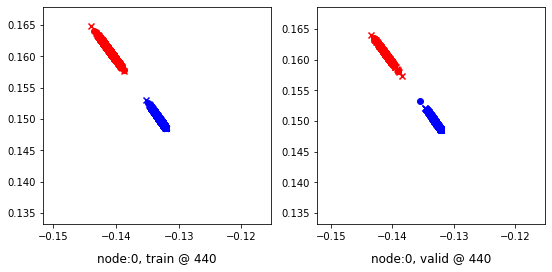

440 	 1 	 0.74875426 	 0.67681879 	 0.97649205 	 0.93562573 	 0.95743966 	 0.95195413


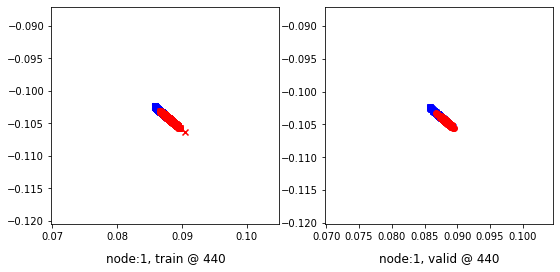

Aggregating on epoch: 445...
Aggregating on epoch: 450...
Aggregating on epoch: 455...
Aggregating on epoch: 460...
460 	 0 	 0.66810757 	 0.63613427 	 0.84041750 	 0.84239340 	 0.88064671 	 0.89940631


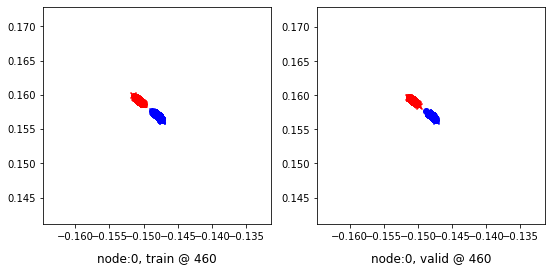

460 	 1 	 0.71383876 	 0.68588048 	 0.97145849 	 0.94454652 	 0.95211238 	 0.95181322


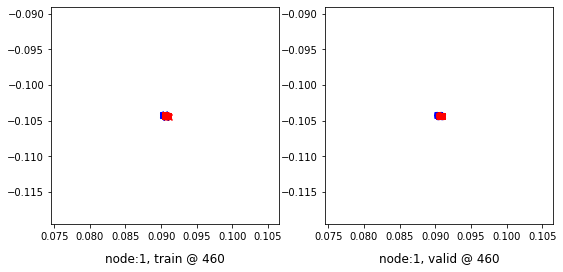

Aggregating on epoch: 465...
Aggregating on epoch: 470...
Aggregating on epoch: 475...
Aggregating on epoch: 480...
480 	 0 	 0.29543766 	 0.21974087 	 0.42296168 	 0.42599732 	 0.86701995 	 0.89940363


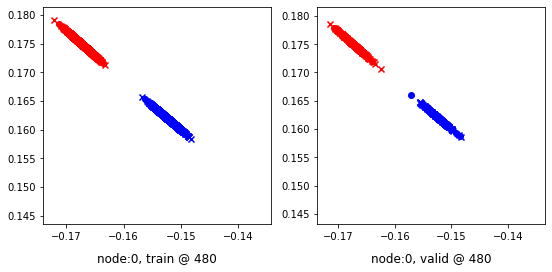

480 	 1 	 0.67605579 	 0.68318003 	 0.93996853 	 0.94184756 	 0.95738989 	 0.95181471


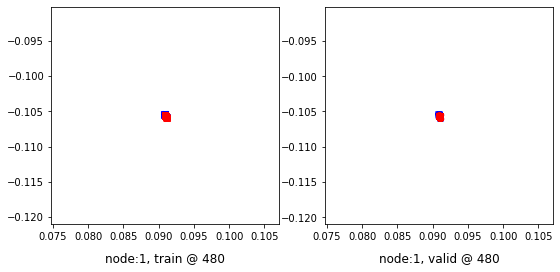

Aggregating on epoch: 485...
Aggregating on epoch: 490...
Aggregating on epoch: 495...
Aggregating on epoch: 500...
500 	 0 	 0.70778632 	 0.64783943 	 0.86962360 	 0.85409611 	 0.88069141 	 0.89940387


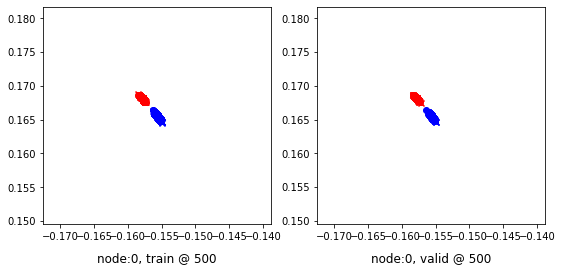

500 	 1 	 0.65862691 	 0.68729037 	 0.92703760 	 0.94596213 	 0.96156967 	 0.95181894


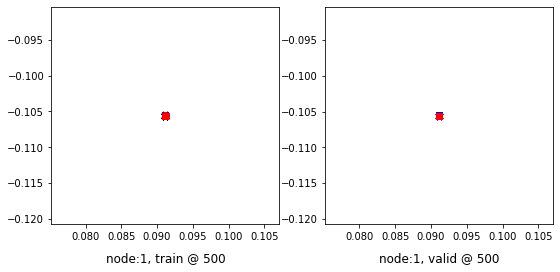

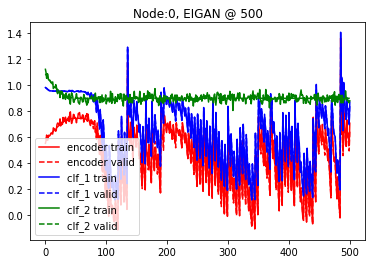

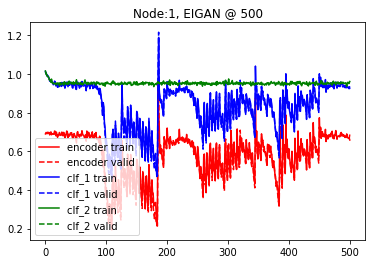

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.4 and delta=7
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.69671512 	 0.68255782 	 1.07625604 	 1.07317686 	 1.07283592 	 1.08376622


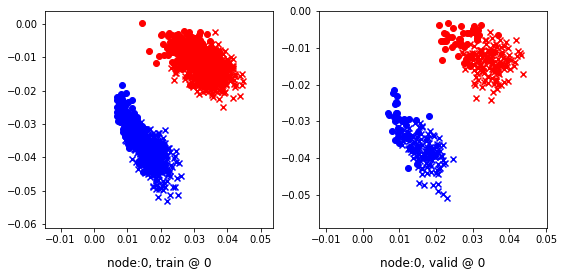

0 	 1 	 0.66081440 	 0.67776084 	 1.03120327 	 1.04514253 	 1.06362462 	 1.06052887


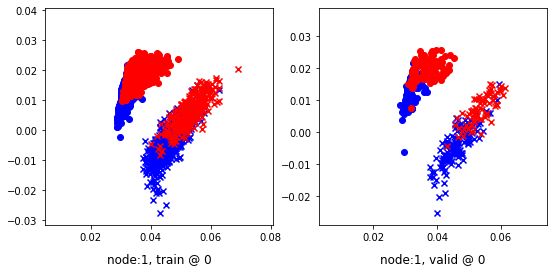

Aggregating on epoch: 7...
Aggregating on epoch: 14...
20 	 0 	 0.68632871 	 0.68734002 	 0.96879625 	 0.96707809 	 0.97566909 	 0.97288525


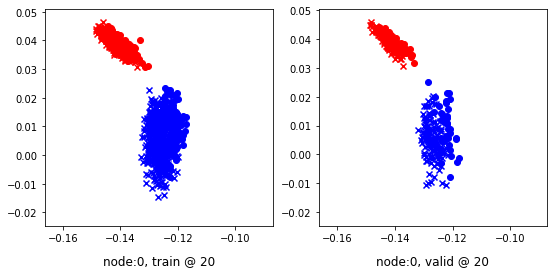

20 	 1 	 0.67669749 	 0.66675615 	 0.95735878 	 0.94753736 	 0.97385371 	 0.97392839


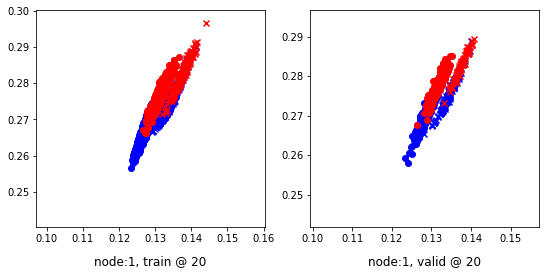

Aggregating on epoch: 21...
Aggregating on epoch: 28...
Aggregating on epoch: 35...
40 	 0 	 0.72081065 	 0.73557186 	 0.95482379 	 0.95368034 	 0.92725205 	 0.91125566


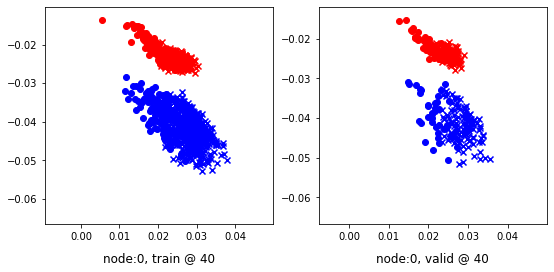

40 	 1 	 0.69948149 	 0.68644476 	 0.95669037 	 0.94523531 	 0.95036340 	 0.95193774


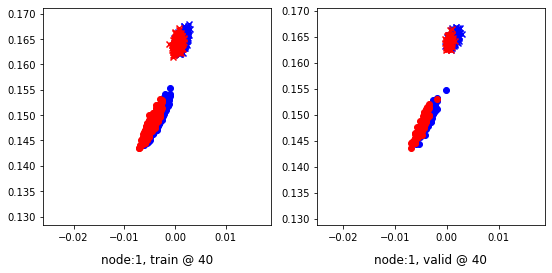

Aggregating on epoch: 42...
Aggregating on epoch: 49...
Aggregating on epoch: 56...
60 	 0 	 0.74805874 	 0.74643278 	 0.95626932 	 0.95291704 	 0.90144062 	 0.89963144


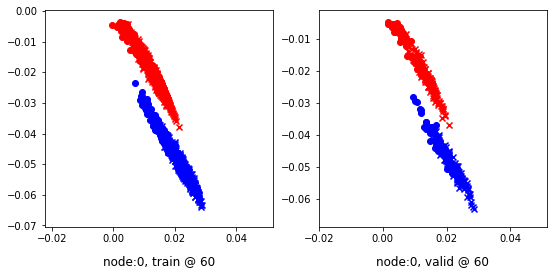

60 	 1 	 0.68544340 	 0.68657815 	 0.94244593 	 0.94520503 	 0.95015049 	 0.95177406


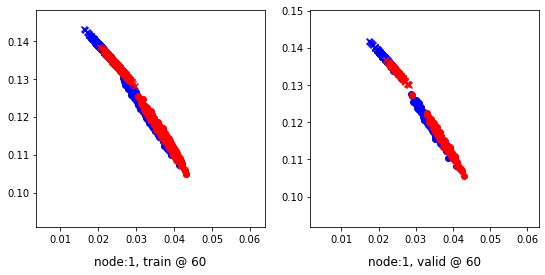

Aggregating on epoch: 63...
Aggregating on epoch: 70...
Aggregating on epoch: 77...
80 	 0 	 0.74965233 	 0.73898512 	 0.94335371 	 0.94530845 	 0.88757497 	 0.89947051


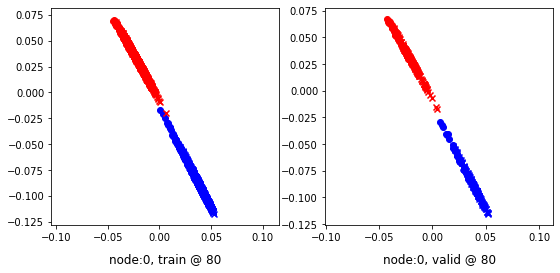

80 	 1 	 0.68791628 	 0.68649262 	 0.94377959 	 0.94522727 	 0.94901848 	 0.95188183


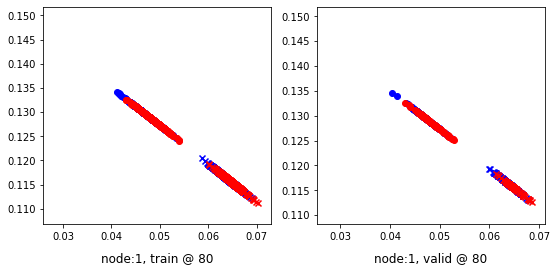

Aggregating on epoch: 84...
Aggregating on epoch: 91...
Aggregating on epoch: 98...
100 	 0 	 0.53394210 	 0.49331510 	 0.70480949 	 0.69932234 	 0.88070995 	 0.89915442


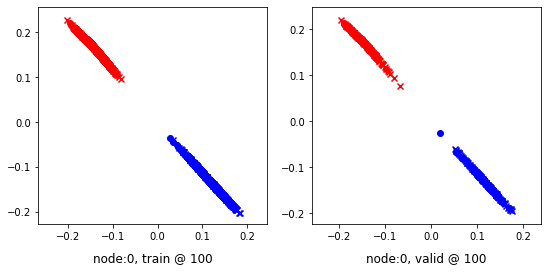

100 	 1 	 0.65921128 	 0.68633103 	 0.93070251 	 0.94494396 	 0.96465421 	 0.95176011


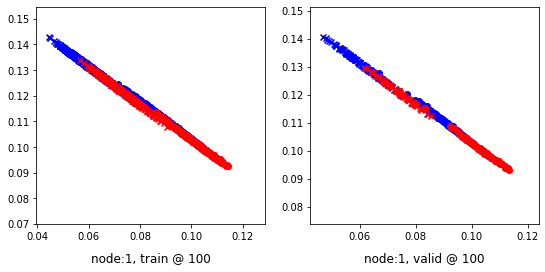

Aggregating on epoch: 105...
Aggregating on epoch: 112...
Aggregating on epoch: 119...
120 	 0 	 0.05568102 	 0.05555847 	 0.25683656 	 0.26135293 	 0.90415537 	 0.89894164


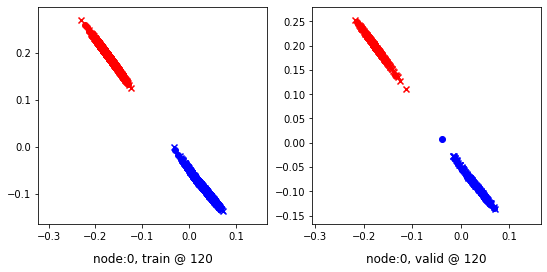

120 	 1 	 0.64072305 	 0.64473349 	 0.89932996 	 0.90430945 	 0.95495719 	 0.95272315


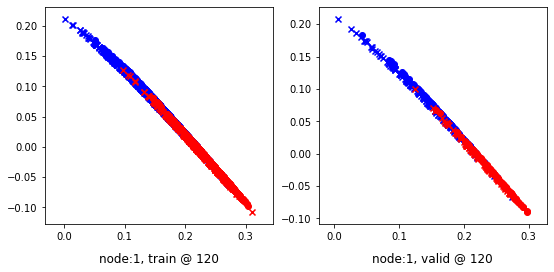

Aggregating on epoch: 126...
Aggregating on epoch: 133...
Aggregating on epoch: 140...
140 	 0 	 0.55405742 	 0.43095475 	 0.67305315 	 0.63719463 	 0.92526132 	 0.89938706


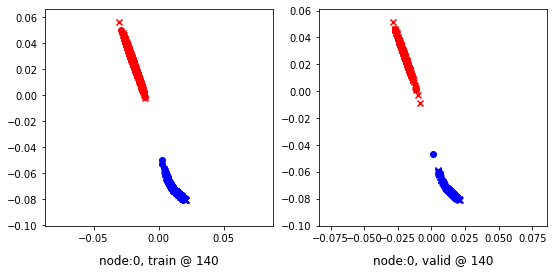

140 	 1 	 0.42930156 	 0.39593053 	 0.66820872 	 0.65713876 	 0.94697374 	 0.95435542


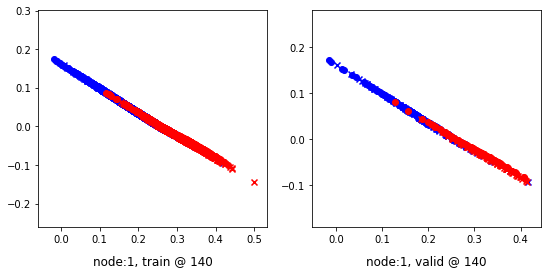

Aggregating on epoch: 147...
Aggregating on epoch: 154...
160 	 0 	 -0.07563122 	 -0.10121856 	 0.10264316 	 0.10417136 	 0.87944627 	 0.89853710


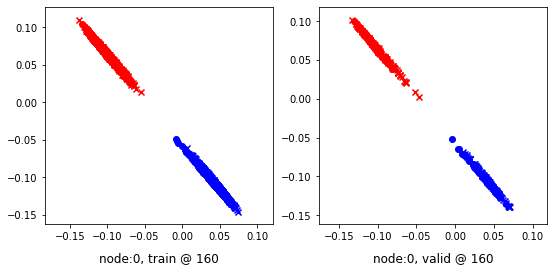

160 	 1 	 0.43244588 	 0.42841399 	 0.68967921 	 0.68651563 	 0.95782697 	 0.95124882


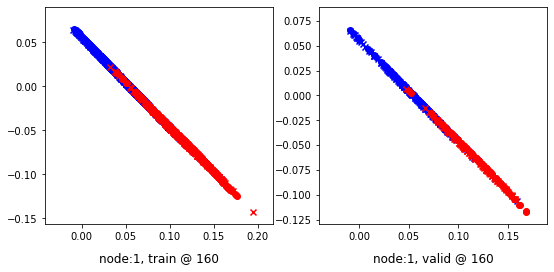

Aggregating on epoch: 161...
Aggregating on epoch: 168...
Aggregating on epoch: 175...
180 	 0 	 -0.11918674 	 -0.13352570 	 0.06737678 	 0.07250784 	 0.88741213 	 0.89918071


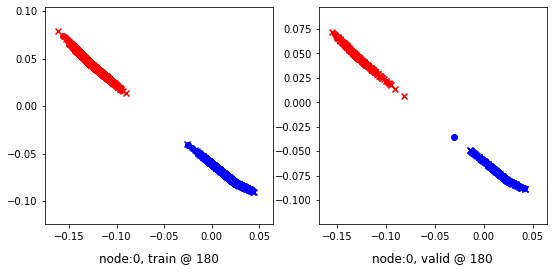

180 	 1 	 0.32021070 	 0.30237198 	 0.57009780 	 0.56024969 	 0.95046365 	 0.95102489


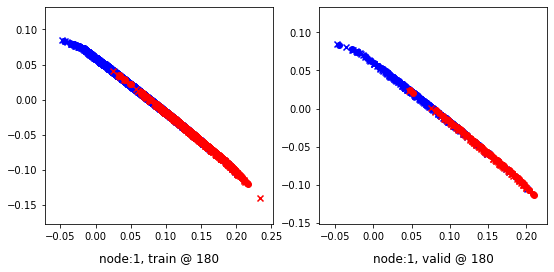

Aggregating on epoch: 182...
Aggregating on epoch: 189...
Aggregating on epoch: 196...
200 	 0 	 0.05015349 	 -0.02755104 	 0.18466471 	 0.17868020 	 0.85970771 	 0.89937842


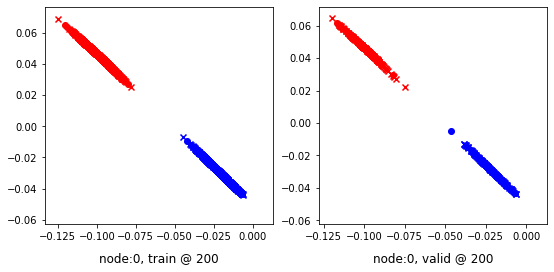

200 	 1 	 0.46130580 	 0.46625316 	 0.70792353 	 0.72452712 	 0.94389236 	 0.95142114


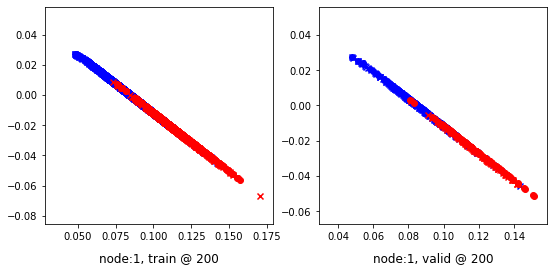

Aggregating on epoch: 203...
Aggregating on epoch: 210...
Aggregating on epoch: 217...
220 	 0 	 0.40397996 	 0.39651024 	 0.58569378 	 0.60273397 	 0.87387890 	 0.89937091


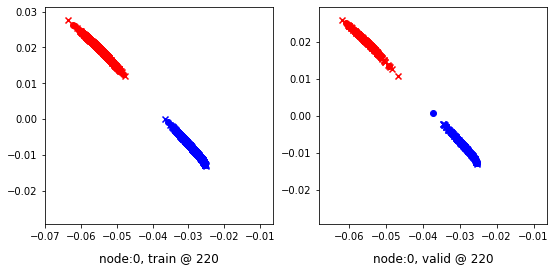

220 	 1 	 0.41039741 	 0.40223235 	 0.65679973 	 0.65989876 	 0.94226891 	 0.95081359


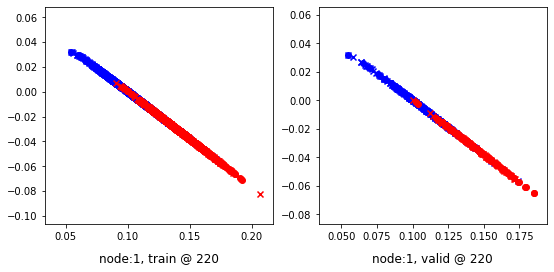

Aggregating on epoch: 224...
Aggregating on epoch: 231...
Aggregating on epoch: 238...
240 	 0 	 0.05357659 	 0.06906423 	 0.26407340 	 0.27512440 	 0.90500498 	 0.89920735


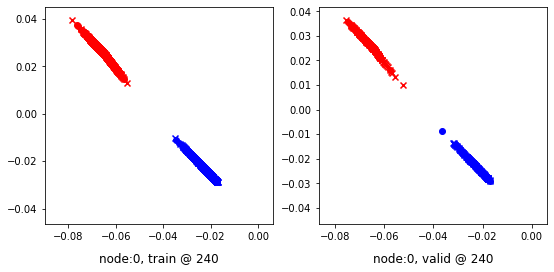

240 	 1 	 0.55186486 	 0.54138273 	 0.79935735 	 0.79929668 	 0.94019365 	 0.95106113


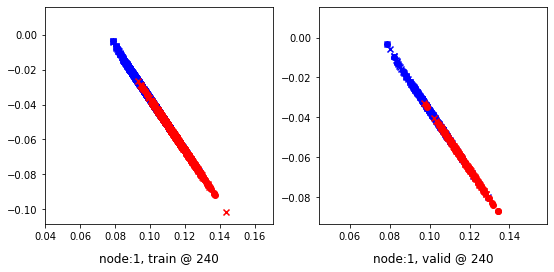

Aggregating on epoch: 245...
Aggregating on epoch: 252...
Aggregating on epoch: 259...
260 	 0 	 0.64137131 	 0.59469259 	 0.80093855 	 0.80095017 	 0.89430106 	 0.89940476


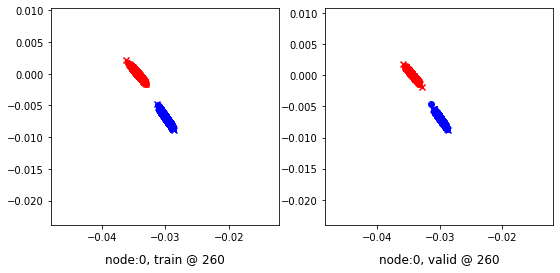

260 	 1 	 0.67321944 	 0.67340064 	 0.92952704 	 0.93201506 	 0.95081204 	 0.95176160


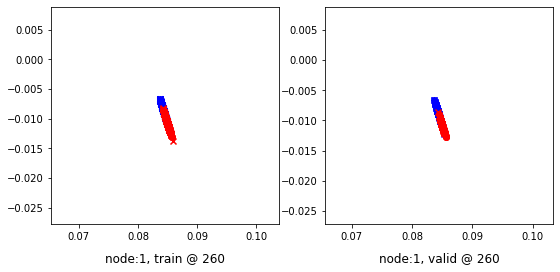

Aggregating on epoch: 266...
Aggregating on epoch: 273...
Aggregating on epoch: 280...
280 	 0 	 0.29489541 	 0.25733563 	 0.45599785 	 0.46359941 	 0.90109771 	 0.89941096


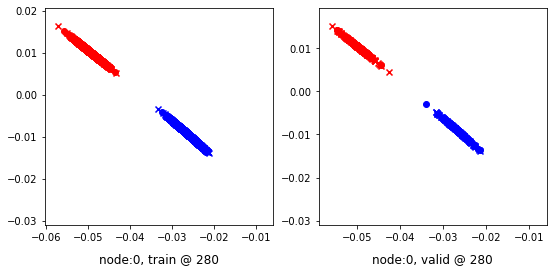

280 	 1 	 0.61633354 	 0.59795600 	 0.87588429 	 0.85592204 	 0.96116072 	 0.95111322


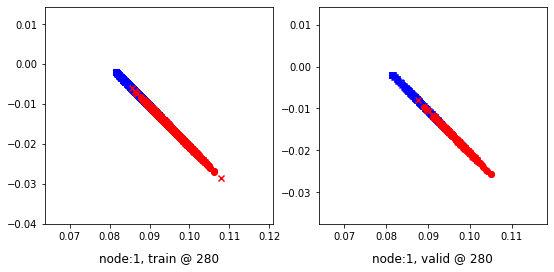

Aggregating on epoch: 287...
Aggregating on epoch: 294...
300 	 0 	 -0.08346114 	 -0.12004539 	 0.07953999 	 0.08569822 	 0.86515141 	 0.89889079


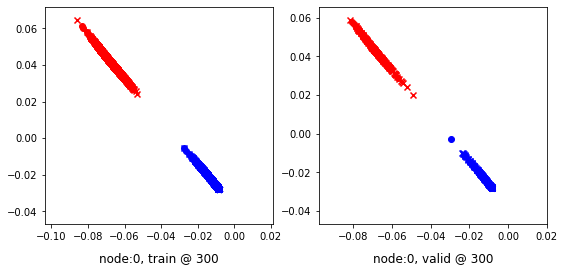

300 	 1 	 0.61413336 	 0.63529813 	 0.88198626 	 0.89372253 	 0.96287793 	 0.95157158


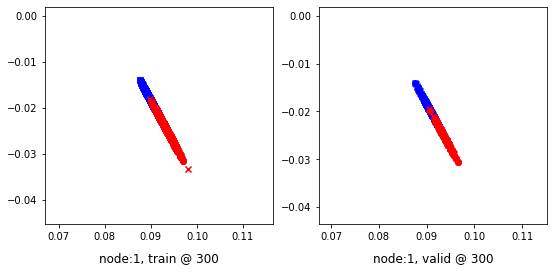

Aggregating on epoch: 301...
Aggregating on epoch: 308...
Aggregating on epoch: 315...
320 	 0 	 -0.06558231 	 -0.10355736 	 0.09472267 	 0.10248069 	 0.85634810 	 0.89918524


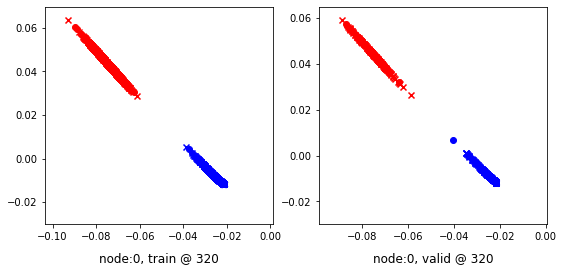

320 	 1 	 0.40502632 	 0.39255011 	 0.65992975 	 0.64945066 	 0.95115954 	 0.95004773


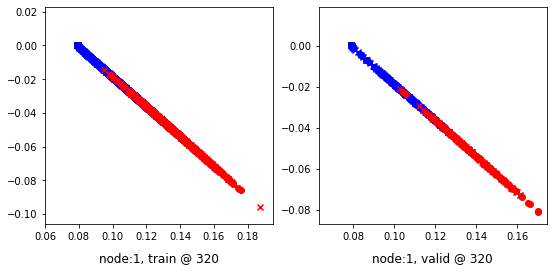

Aggregating on epoch: 322...
Aggregating on epoch: 329...
Aggregating on epoch: 336...
340 	 0 	 -0.09149434 	 -0.08873165 	 0.10704152 	 0.11758077 	 0.89576882 	 0.89945960


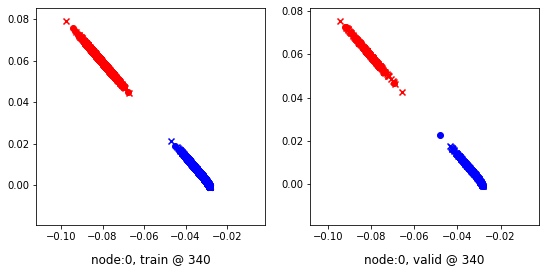

340 	 1 	 0.42854071 	 0.41336405 	 0.68603045 	 0.67073208 	 0.94602221 	 0.95051521


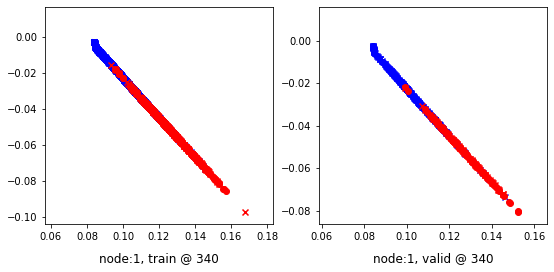

Aggregating on epoch: 343...
Aggregating on epoch: 350...
Aggregating on epoch: 357...
360 	 0 	 0.19910005 	 0.22287866 	 0.41424030 	 0.42915902 	 0.90765005 	 0.89942753


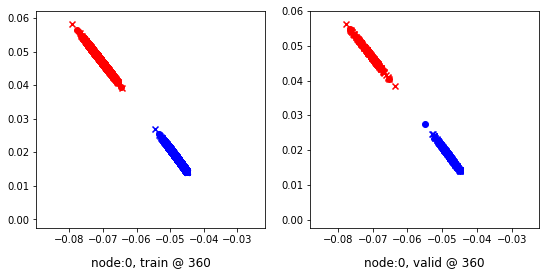

360 	 1 	 0.39848679 	 0.38181299 	 0.66171128 	 0.63959128 	 0.95220804 	 0.95092547


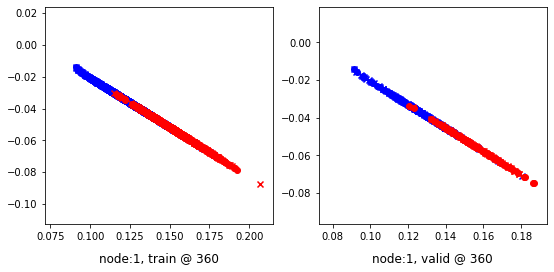

Aggregating on epoch: 364...
Aggregating on epoch: 371...
Aggregating on epoch: 378...
380 	 0 	 0.11231756 	 0.11477605 	 0.31895888 	 0.32106897 	 0.89476299 	 0.89944011


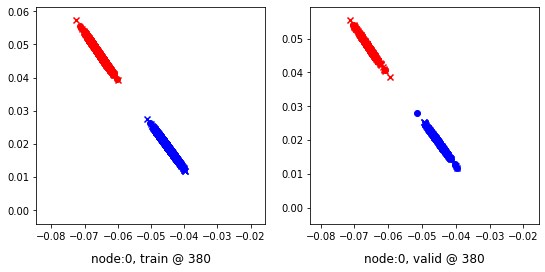

380 	 1 	 0.46837610 	 0.45365548 	 0.72039115 	 0.71171522 	 0.95222843 	 0.95120692


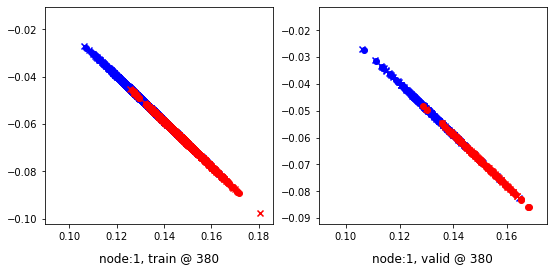

Aggregating on epoch: 385...
Aggregating on epoch: 392...
Aggregating on epoch: 399...
400 	 0 	 0.34759480 	 0.31711078 	 0.51233584 	 0.52338028 	 0.89766395 	 0.89941669


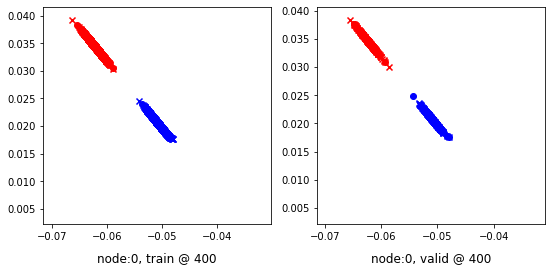

400 	 1 	 0.51991683 	 0.55728763 	 0.80181724 	 0.81631637 	 0.95325446 	 0.95217592


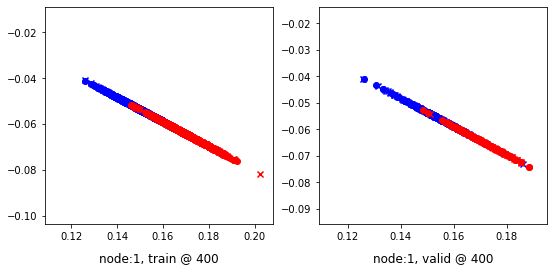

Aggregating on epoch: 406...
Aggregating on epoch: 413...
Aggregating on epoch: 420...
420 	 0 	 0.08587423 	 0.01364009 	 0.21392657 	 0.21986572 	 0.87299532 	 0.89937282


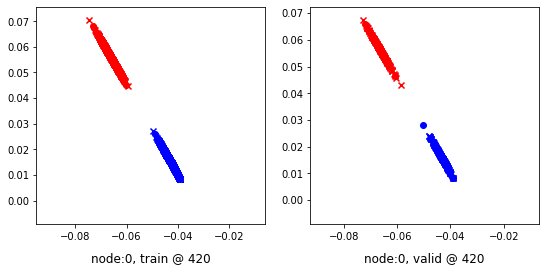

420 	 1 	 0.82328260 	 0.62822616 	 0.97900420 	 0.88678956 	 0.95528543 	 0.95171058


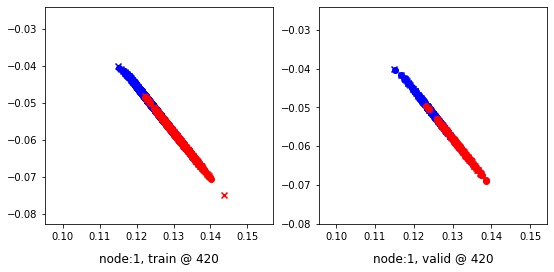

Aggregating on epoch: 427...
Aggregating on epoch: 434...
440 	 0 	 0.69660699 	 0.71210378 	 0.90075648 	 0.91834515 	 0.90118927 	 0.89938855


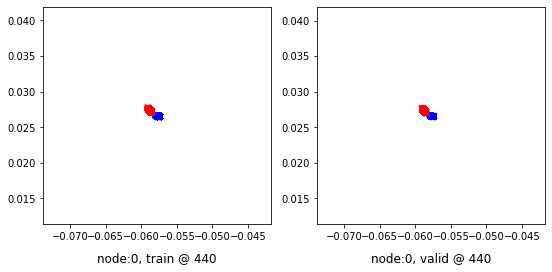

440 	 1 	 0.33031559 	 0.33503169 	 0.57827365 	 0.59175092 	 0.94322461 	 0.94986641


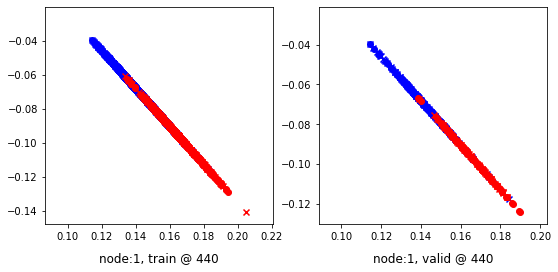

Aggregating on epoch: 441...
Aggregating on epoch: 448...
Aggregating on epoch: 455...
460 	 0 	 0.05964687 	 0.05259490 	 0.24589072 	 0.25873792 	 0.89087456 	 0.89929020


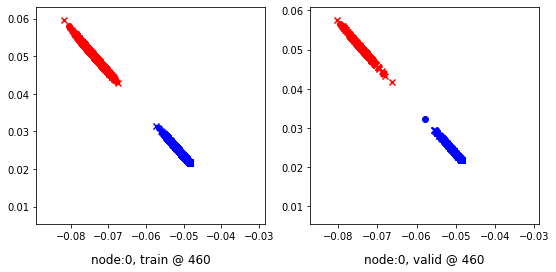

460 	 1 	 0.66725612 	 0.66695505 	 0.92004436 	 0.92585057 	 0.94666010 	 0.95204270


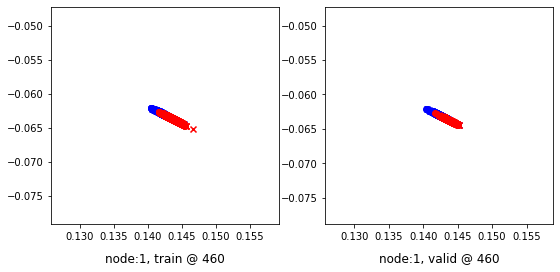

Aggregating on epoch: 462...
Aggregating on epoch: 469...
Aggregating on epoch: 476...
480 	 0 	 0.12010637 	 0.03691182 	 0.25451541 	 0.24297330 	 0.86987656 	 0.89920866


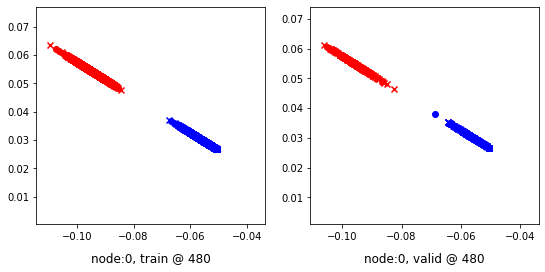

480 	 1 	 0.59786195 	 0.58655167 	 0.84234589 	 0.84431112 	 0.94075596 	 0.95090663


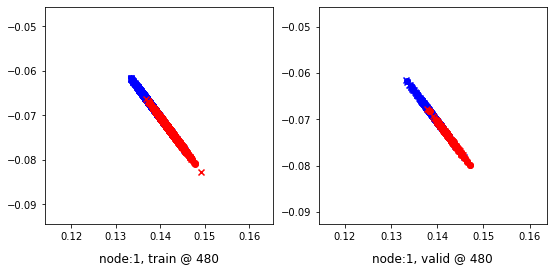

Aggregating on epoch: 483...
Aggregating on epoch: 490...
Aggregating on epoch: 497...
500 	 0 	 0.04692432 	 0.04468498 	 0.25174364 	 0.25085583 	 0.91495413 	 0.89931804


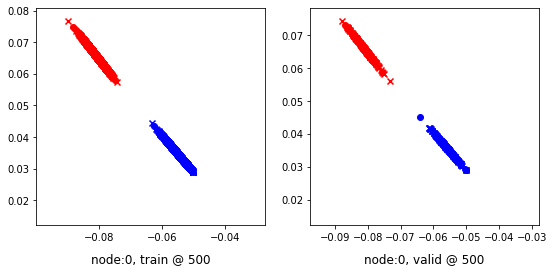

500 	 1 	 0.46392816 	 0.46185839 	 0.72645098 	 0.72065407 	 0.96227926 	 0.95194286


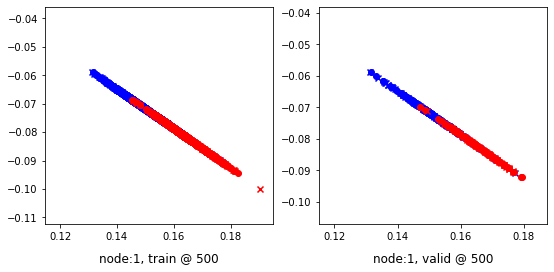

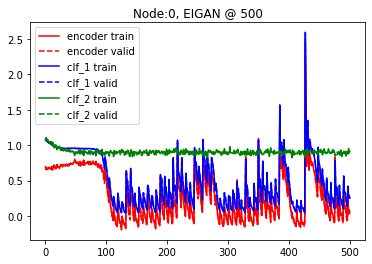

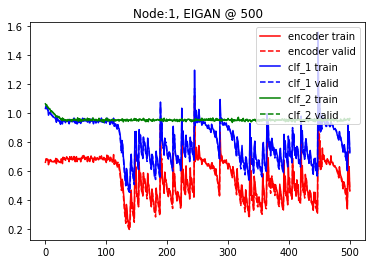

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.4 and delta=9
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.68271160 	 0.70699573 	 1.03638089 	 1.03434157 	 1.04710031 	 1.02049303


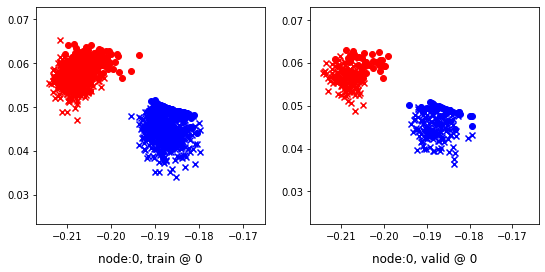

0 	 1 	 0.65606791 	 0.67800343 	 0.99350715 	 1.01647425 	 1.03085196 	 1.03161800


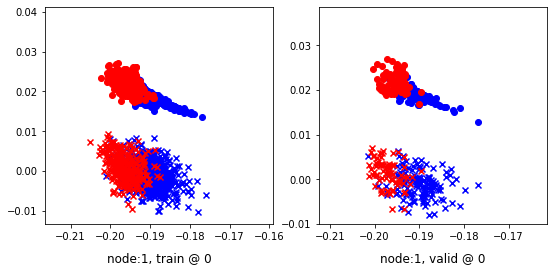

Aggregating on epoch: 9...
Aggregating on epoch: 18...
20 	 0 	 0.70625979 	 0.69382888 	 0.95221466 	 0.95365524 	 0.93930584 	 0.95297354


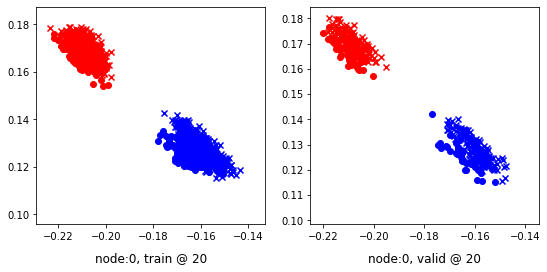

20 	 1 	 0.66452903 	 0.67588264 	 0.93602657 	 0.94461590 	 0.96475083 	 0.96188045


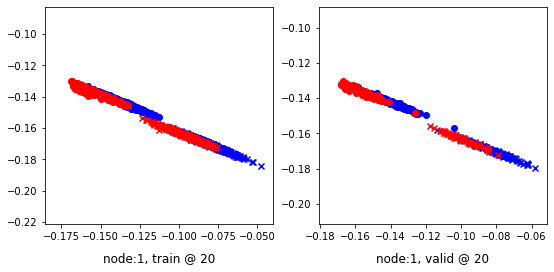

Aggregating on epoch: 27...
Aggregating on epoch: 36...
40 	 0 	 0.74746746 	 0.72311848 	 0.94072294 	 0.93858260 	 0.88741213 	 0.90861130


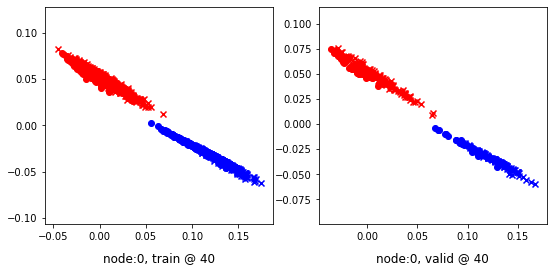

40 	 1 	 0.68746877 	 0.68091303 	 0.94097698 	 0.93978769 	 0.94701731 	 0.95202184


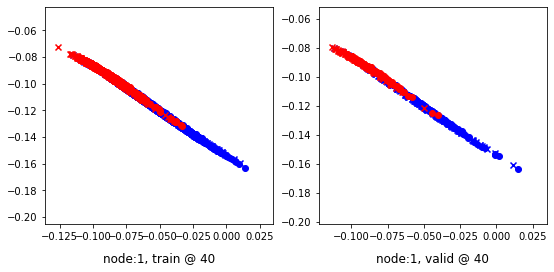

Aggregating on epoch: 45...
Aggregating on epoch: 54...
60 	 0 	 0.38267398 	 0.34831434 	 0.55989021 	 0.55511749 	 0.87715924 	 0.89995033


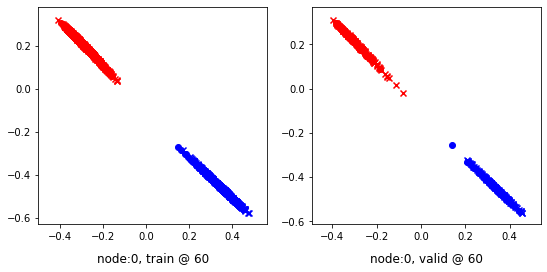

60 	 1 	 0.52789283 	 0.49255514 	 0.76912433 	 0.75073427 	 0.93859160 	 0.95132631


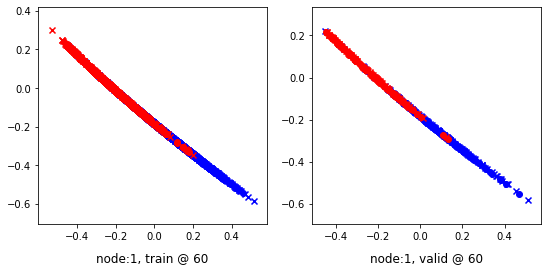

Aggregating on epoch: 63...
Aggregating on epoch: 72...
80 	 0 	 -0.12100921 	 -0.12532189 	 0.07924297 	 0.07901075 	 0.89511287 	 0.89747983


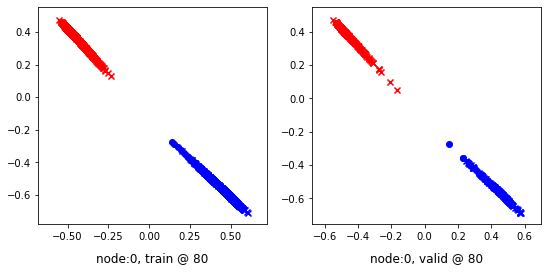

80 	 1 	 0.26333702 	 0.20833009 	 0.52180851 	 0.46808791 	 0.95091629 	 0.95290500


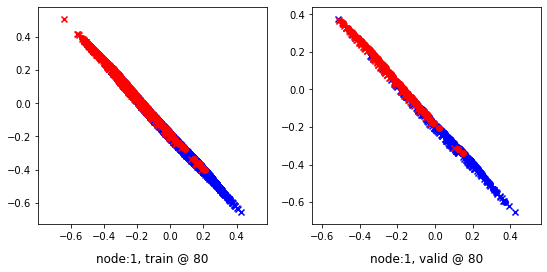

Aggregating on epoch: 81...
Aggregating on epoch: 90...
Aggregating on epoch: 99...
100 	 0 	 0.03700426 	 0.03888449 	 0.23878722 	 0.24423584 	 0.91596162 	 0.89849854


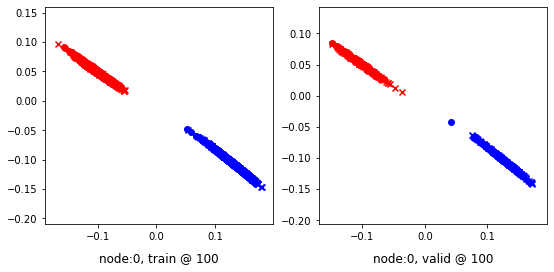

100 	 1 	 0.35500193 	 0.35396057 	 0.60021943 	 0.60821337 	 0.94725007 	 0.94739997


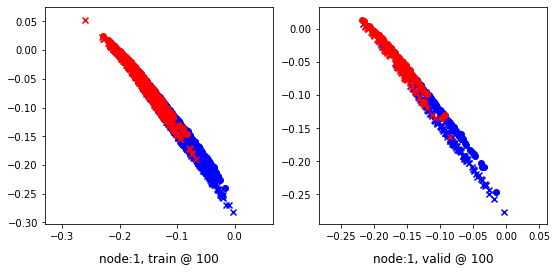

Aggregating on epoch: 108...
Aggregating on epoch: 117...
120 	 0 	 -0.10053696 	 -0.13634568 	 0.06762661 	 0.06900376 	 0.86666268 	 0.89849663


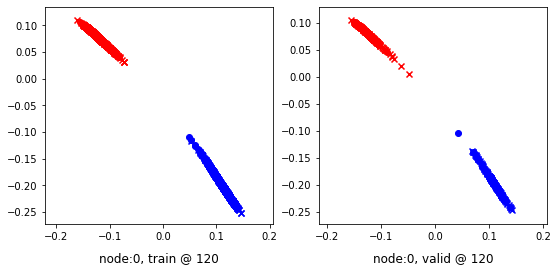

120 	 1 	 0.31111771 	 0.26201195 	 0.57035667 	 0.52108335 	 0.95445442 	 0.95221859


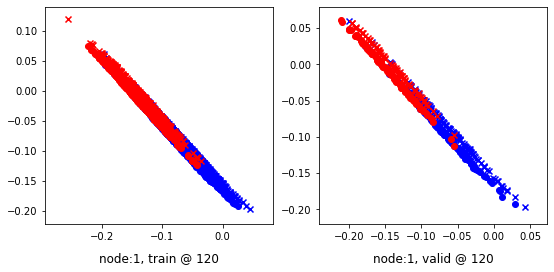

Aggregating on epoch: 126...
Aggregating on epoch: 135...
140 	 0 	 -0.14729050 	 -0.16611893 	 0.03682925 	 0.03955530 	 0.87841564 	 0.89882141


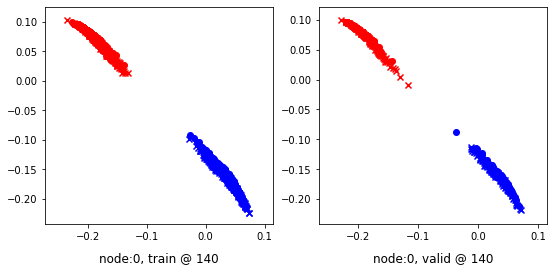

140 	 1 	 0.52340227 	 0.53635579 	 0.78966397 	 0.79654324 	 0.95954925 	 0.95333463


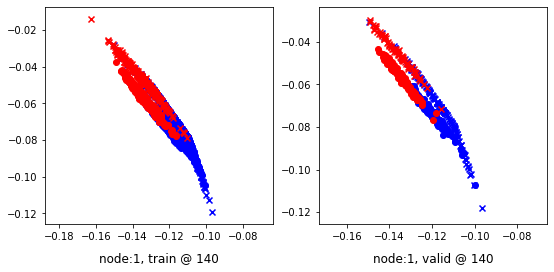

Aggregating on epoch: 144...
Aggregating on epoch: 153...
160 	 0 	 -0.09924072 	 -0.08880235 	 0.11412916 	 0.11723356 	 0.91790360 	 0.89918309


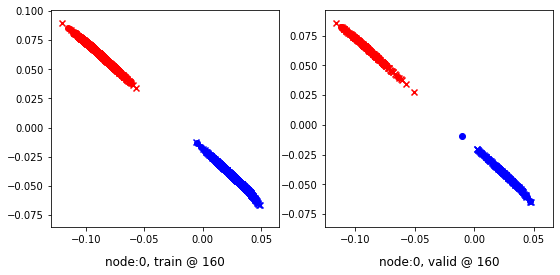

160 	 1 	 0.26142794 	 0.26468664 	 0.52695745 	 0.52209419 	 0.96289176 	 0.95055473


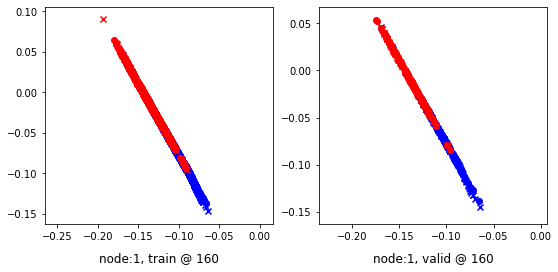

Aggregating on epoch: 162...
Aggregating on epoch: 171...
Aggregating on epoch: 180...
180 	 0 	 0.06902802 	 0.07856357 	 0.27766997 	 0.28382599 	 0.94016916 	 0.89840961


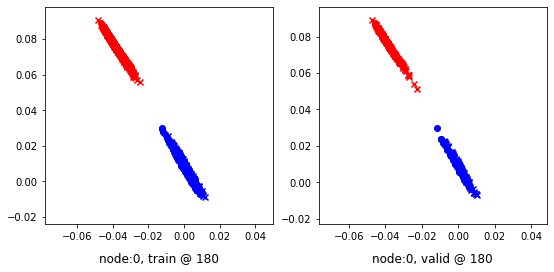

180 	 1 	 0.73626179 	 0.62409085 	 0.91849095 	 0.88321072 	 0.94995832 	 0.95226705


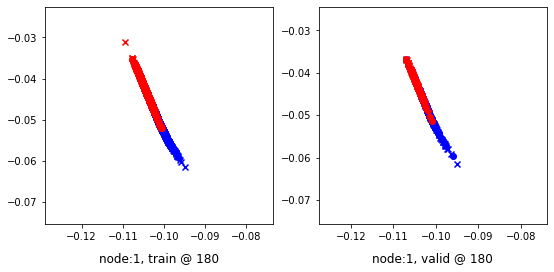

Aggregating on epoch: 189...
Aggregating on epoch: 198...
200 	 0 	 0.10711581 	 0.02672710 	 0.24468531 	 0.23210974 	 0.88587236 	 0.89852983


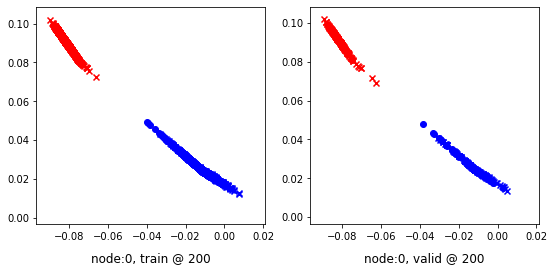

200 	 1 	 0.38873953 	 0.36884189 	 0.63713837 	 0.62273896 	 0.94656110 	 0.94704425


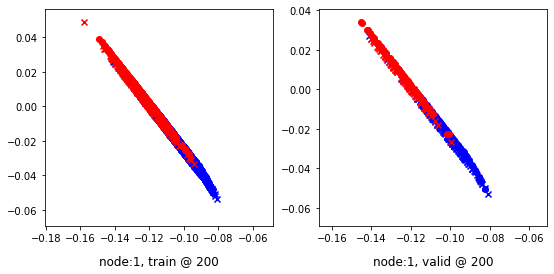

Aggregating on epoch: 207...
Aggregating on epoch: 216...
220 	 0 	 -0.11324135 	 -0.09830661 	 0.09954093 	 0.10561405 	 0.91074318 	 0.89706784


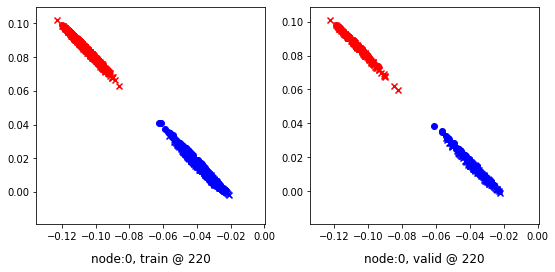

220 	 1 	 0.38013542 	 0.38464767 	 0.63222694 	 0.63957256 	 0.94912922 	 0.94807208


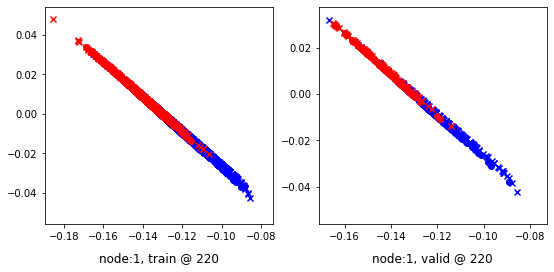

Aggregating on epoch: 225...
Aggregating on epoch: 234...
240 	 0 	 -0.15550813 	 -0.14693215 	 0.05668951 	 0.06177881 	 0.91297811 	 0.90185815


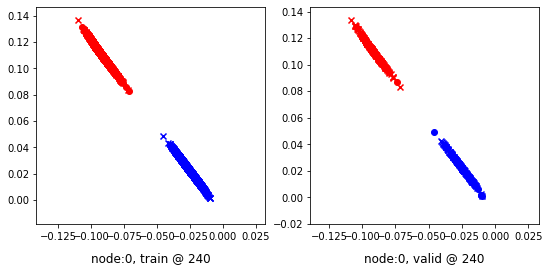

240 	 1 	 0.29285711 	 0.28065383 	 0.55307776 	 0.53921258 	 0.94893950 	 0.95170593


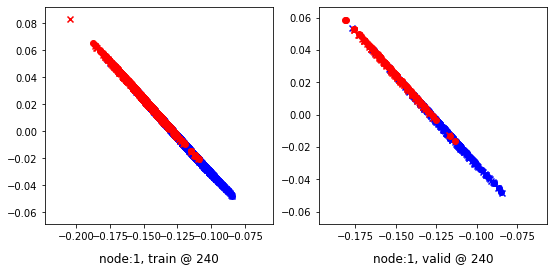

Aggregating on epoch: 243...
Aggregating on epoch: 252...
260 	 0 	 0.09231660 	 0.09723791 	 0.29529151 	 0.30355850 	 0.91463184 	 0.89946777


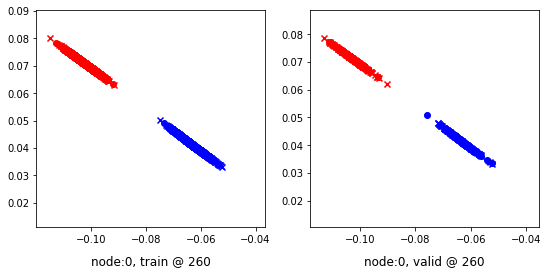

260 	 1 	 0.36335611 	 0.30651528 	 0.61603808 	 0.56311309 	 0.94719827 	 0.94974500


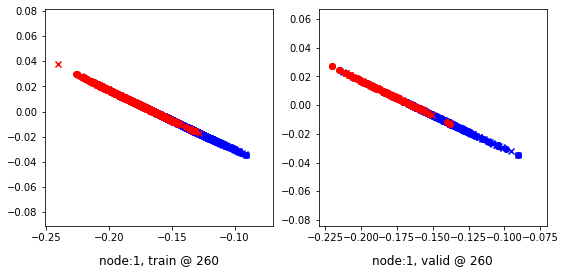

Aggregating on epoch: 261...
Aggregating on epoch: 270...
Aggregating on epoch: 279...
280 	 0 	 -0.07959457 	 -0.07727537 	 0.11665003 	 0.12917539 	 0.88622421 	 0.89959794


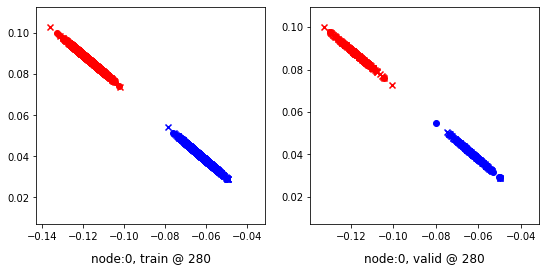

280 	 1 	 0.45024556 	 0.54720026 	 0.76816124 	 0.80675691 	 0.95813555 	 0.95270383


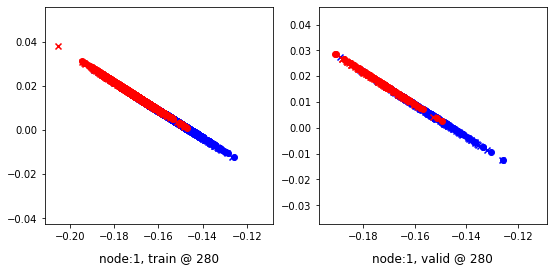

Aggregating on epoch: 288...
Aggregating on epoch: 297...
300 	 0 	 0.32734299 	 0.20351857 	 0.44138691 	 0.41002375 	 0.92901027 	 0.89965236


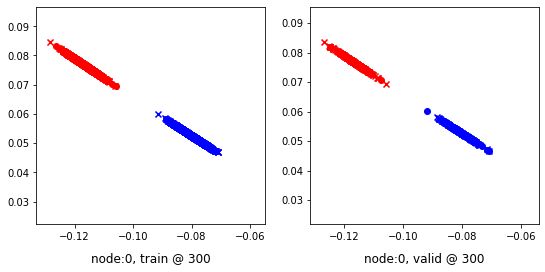

300 	 1 	 0.39025110 	 0.36784899 	 0.64637655 	 0.62616205 	 0.95292830 	 0.95146024


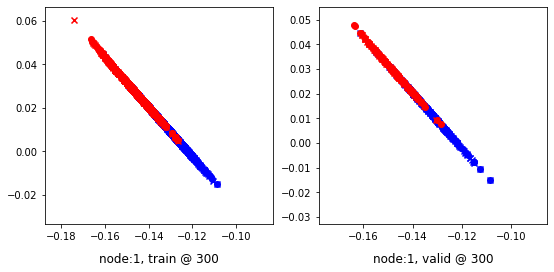

Aggregating on epoch: 306...
Aggregating on epoch: 315...
320 	 0 	 -0.05954971 	 -0.09734679 	 0.10387146 	 0.10890769 	 0.85926640 	 0.89940166


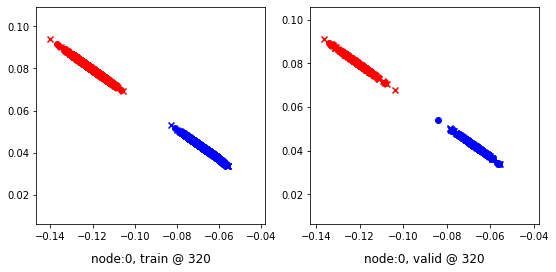

320 	 1 	 0.36161739 	 0.38557869 	 0.62156039 	 0.64349067 	 0.95632434 	 0.95105916


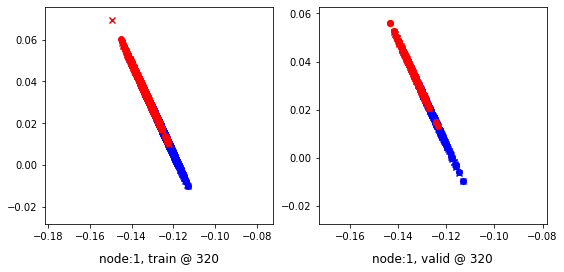

Aggregating on epoch: 324...
Aggregating on epoch: 333...
340 	 0 	 0.28162539 	 0.24967280 	 0.45243299 	 0.45615807 	 0.88419354 	 0.89963245


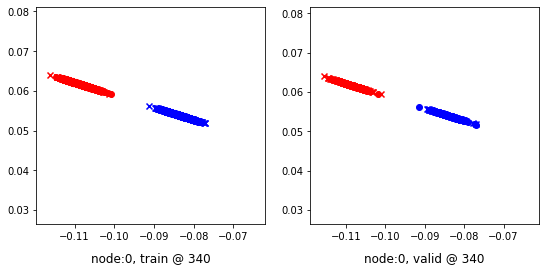

340 	 1 	 0.55463731 	 0.54828417 	 0.81038398 	 0.80682540 	 0.95313227 	 0.95168841


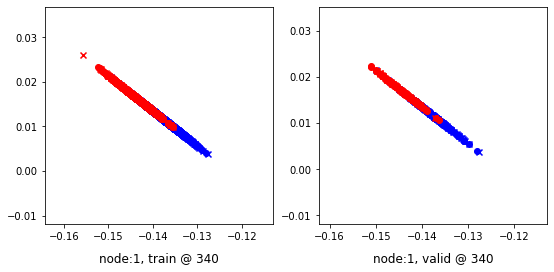

Aggregating on epoch: 342...
Aggregating on epoch: 351...
Aggregating on epoch: 360...
360 	 0 	 0.44032311 	 0.25085688 	 0.48008448 	 0.45732588 	 0.91491389 	 0.89961618


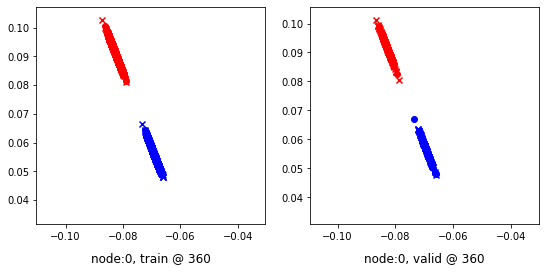

360 	 1 	 0.88533616 	 0.81965941 	 1.03982699 	 1.07869244 	 0.95525748 	 0.95218021


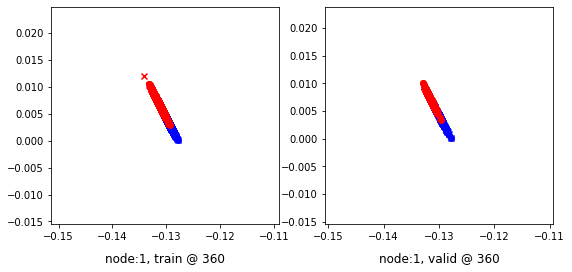

Aggregating on epoch: 369...
Aggregating on epoch: 378...
380 	 0 	 -0.01140498 	 -0.04669112 	 0.14982079 	 0.15982771 	 0.84748518 	 0.89966601


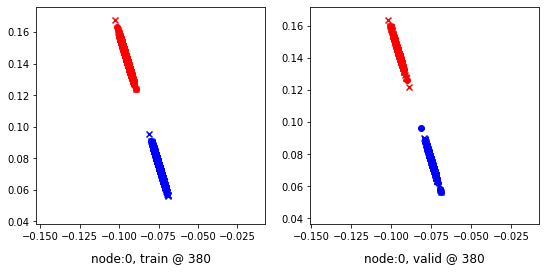

380 	 1 	 0.50847477 	 0.48640037 	 0.75030100 	 0.74536526 	 0.95815539 	 0.95211208


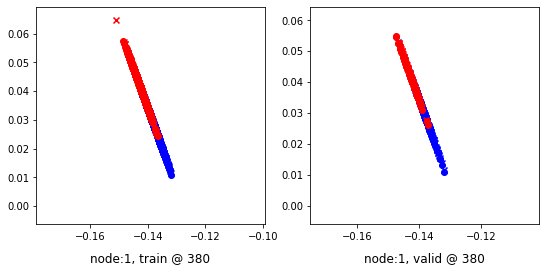

Aggregating on epoch: 387...
Aggregating on epoch: 396...
400 	 0 	 -0.06283270 	 -0.05959988 	 0.13405323 	 0.14680630 	 0.91470689 	 0.89955336


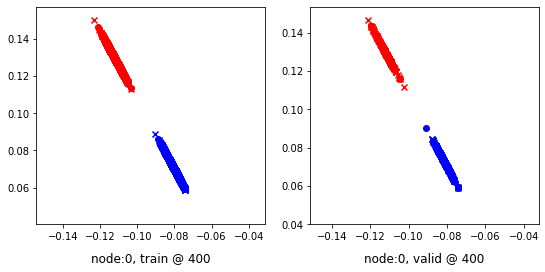

400 	 1 	 0.32921332 	 0.31575918 	 0.58367592 	 0.57494467 	 0.95240325 	 0.95233268


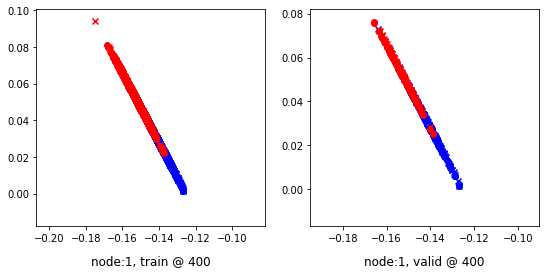

Aggregating on epoch: 405...
Aggregating on epoch: 414...
420 	 0 	 0.06770828 	 0.08441040 	 0.27362400 	 0.29071477 	 0.91473907 	 0.89945155


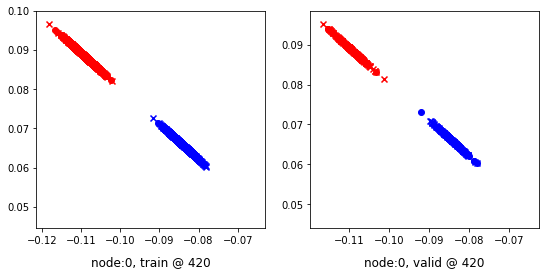

420 	 1 	 0.31886309 	 0.25607383 	 0.56569833 	 0.51399744 	 0.94257075 	 0.95107079


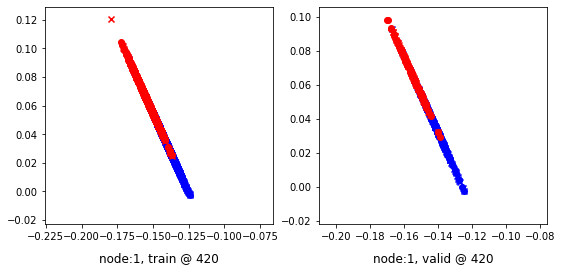

Aggregating on epoch: 423...
Aggregating on epoch: 432...
440 	 0 	 -0.11338367 	 -0.08784280 	 0.11114521 	 0.11844578 	 0.92533255 	 0.89943576


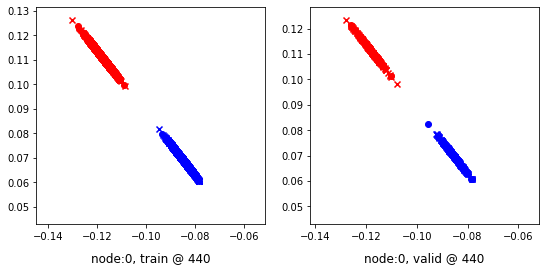

440 	 1 	 0.69190627 	 0.69877392 	 0.95031667 	 0.95743853 	 0.94747096 	 0.95181179


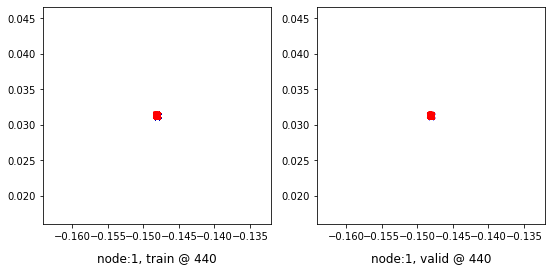

Aggregating on epoch: 441...
Aggregating on epoch: 450...
Aggregating on epoch: 459...
460 	 0 	 0.46879292 	 0.45215946 	 0.64859837 	 0.65850872 	 0.88761085 	 0.89949644


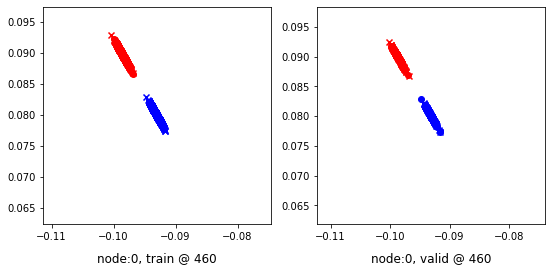

460 	 1 	 0.66265625 	 0.67824638 	 0.92522460 	 0.93701422 	 0.95289689 	 0.95191503


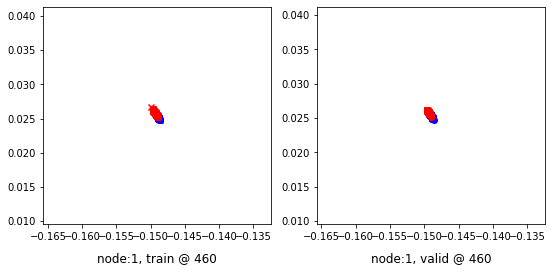

Aggregating on epoch: 468...
Aggregating on epoch: 477...
480 	 0 	 0.15744695 	 0.14734909 	 0.35838103 	 0.35370353 	 0.92176998 	 0.89950162


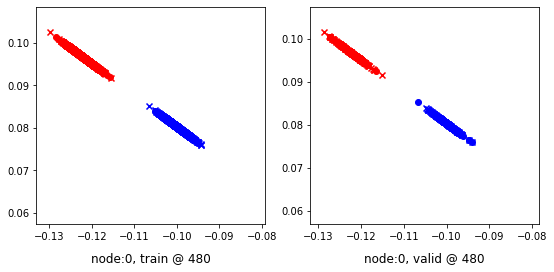

480 	 1 	 0.67951858 	 0.66229630 	 0.92139935 	 0.92094558 	 0.93623978 	 0.95179647


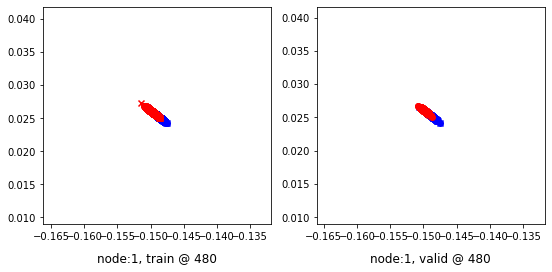

Aggregating on epoch: 486...
Aggregating on epoch: 495...
500 	 0 	 0.25332302 	 0.31569737 	 0.50611043 	 0.52207541 	 0.95642573 	 0.89952523


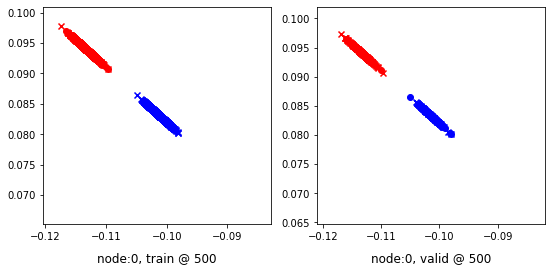

500 	 1 	 0.57989115 	 0.59820396 	 0.84103543 	 0.85665447 	 0.95821911 	 0.95159769


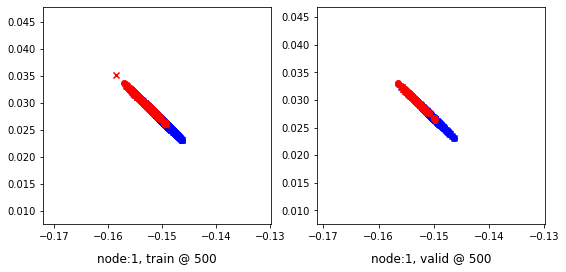

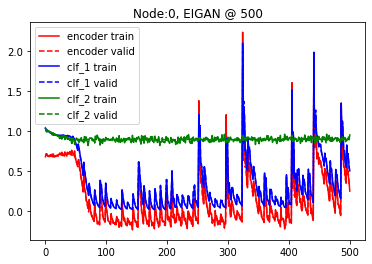

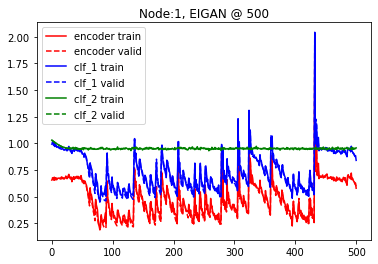

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.6 and delta=1
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.67447495 	 0.66549599 	 1.04288304 	 1.03498554 	 1.06189048 	 1.06263673


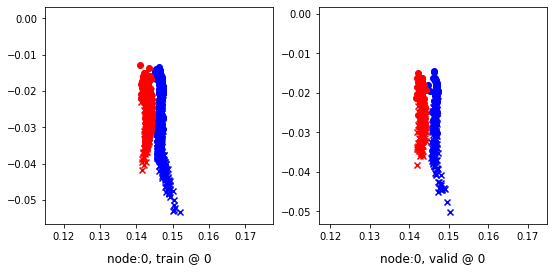

0 	 1 	 0.68036067 	 0.67232704 	 1.01222265 	 1.00944304 	 1.02520132 	 1.03026319


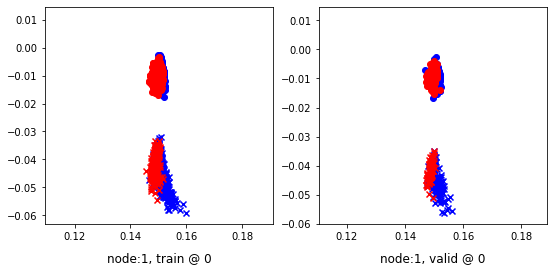

Aggregating on epoch: 1...
Aggregating on epoch: 2...
Aggregating on epoch: 3...
Aggregating on epoch: 4...
Aggregating on epoch: 5...
Aggregating on epoch: 6...
Aggregating on epoch: 7...
Aggregating on epoch: 8...
Aggregating on epoch: 9...
Aggregating on epoch: 10...
Aggregating on epoch: 11...
Aggregating on epoch: 12...
Aggregating on epoch: 13...
Aggregating on epoch: 14...
Aggregating on epoch: 15...
Aggregating on epoch: 16...
Aggregating on epoch: 17...
Aggregating on epoch: 18...
Aggregating on epoch: 19...
Aggregating on epoch: 20...
20 	 0 	 0.68770939 	 0.69932276 	 0.96794534 	 0.96594077 	 0.97340590 	 0.95976520


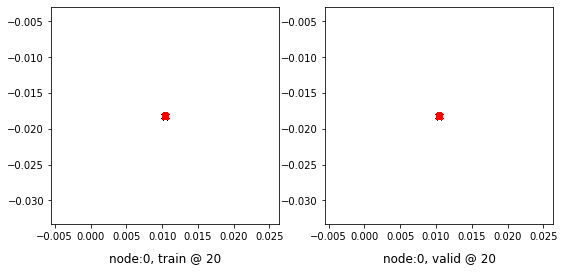

20 	 1 	 0.68155712 	 0.68520534 	 0.94762325 	 0.94537246 	 0.95921838 	 0.95331430


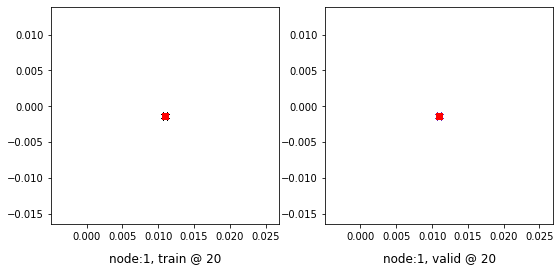

Aggregating on epoch: 21...
Aggregating on epoch: 22...
Aggregating on epoch: 23...
Aggregating on epoch: 24...
Aggregating on epoch: 25...
Aggregating on epoch: 26...
Aggregating on epoch: 27...
Aggregating on epoch: 28...
Aggregating on epoch: 29...
Aggregating on epoch: 30...
Aggregating on epoch: 31...
Aggregating on epoch: 32...
Aggregating on epoch: 33...
Aggregating on epoch: 34...
Aggregating on epoch: 35...
Aggregating on epoch: 36...
Aggregating on epoch: 37...
Aggregating on epoch: 38...
Aggregating on epoch: 39...
Aggregating on epoch: 40...
40 	 0 	 0.71376532 	 0.74431670 	 0.95292342 	 0.95396823 	 0.93231028 	 0.90279871


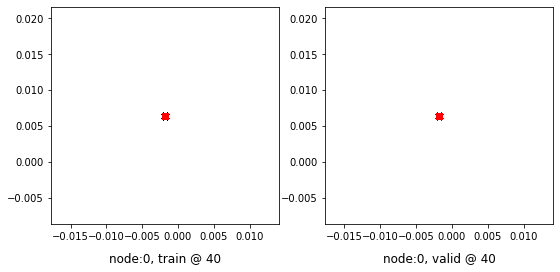

40 	 1 	 0.67193067 	 0.68655282 	 0.93737793 	 0.94522792 	 0.95859456 	 0.95182228


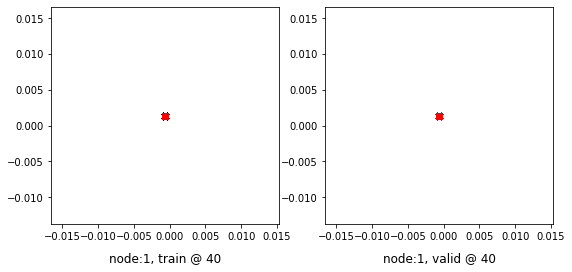

Aggregating on epoch: 41...
Aggregating on epoch: 42...
Aggregating on epoch: 43...
Aggregating on epoch: 44...
Aggregating on epoch: 45...
Aggregating on epoch: 46...
Aggregating on epoch: 47...
Aggregating on epoch: 48...
Aggregating on epoch: 49...
Aggregating on epoch: 50...
Aggregating on epoch: 51...
Aggregating on epoch: 52...
Aggregating on epoch: 53...
Aggregating on epoch: 54...
Aggregating on epoch: 55...
Aggregating on epoch: 56...
Aggregating on epoch: 57...
Aggregating on epoch: 58...
Aggregating on epoch: 59...
Aggregating on epoch: 60...
60 	 0 	 0.70342177 	 0.74767435 	 0.95294046 	 0.95394570 	 0.94266599 	 0.89941853


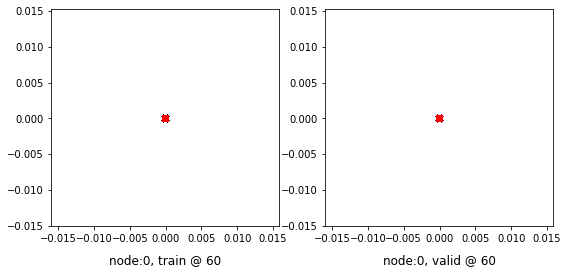

60 	 1 	 0.69057739 	 0.68655765 	 0.95150495 	 0.94523203 	 0.95407474 	 0.95182157


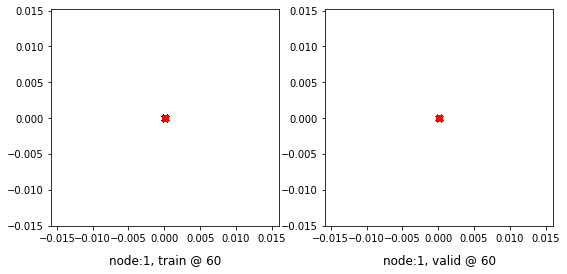

Aggregating on epoch: 61...
Aggregating on epoch: 62...
Aggregating on epoch: 63...
Aggregating on epoch: 64...
Aggregating on epoch: 65...
Aggregating on epoch: 66...
Aggregating on epoch: 67...
Aggregating on epoch: 68...
Aggregating on epoch: 69...
Aggregating on epoch: 70...
Aggregating on epoch: 71...
Aggregating on epoch: 72...
Aggregating on epoch: 73...
Aggregating on epoch: 74...
Aggregating on epoch: 75...
Aggregating on epoch: 76...
Aggregating on epoch: 77...
Aggregating on epoch: 78...
Aggregating on epoch: 79...
Aggregating on epoch: 80...
80 	 0 	 0.73328042 	 0.74768353 	 0.95514083 	 0.95394707 	 0.91500759 	 0.89941072


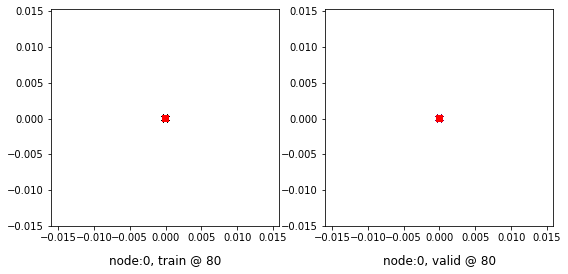

80 	 1 	 0.67391878 	 0.68655241 	 0.93990701 	 0.94523132 	 0.95913535 	 0.95182610


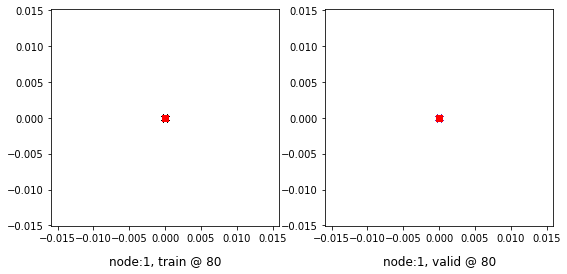

Aggregating on epoch: 81...
Aggregating on epoch: 82...
Aggregating on epoch: 83...
Aggregating on epoch: 84...
Aggregating on epoch: 85...
Aggregating on epoch: 86...
Aggregating on epoch: 87...
Aggregating on epoch: 88...
Aggregating on epoch: 89...
Aggregating on epoch: 90...
Aggregating on epoch: 91...
Aggregating on epoch: 92...
Aggregating on epoch: 93...
Aggregating on epoch: 94...
Aggregating on epoch: 95...
Aggregating on epoch: 96...
Aggregating on epoch: 97...
Aggregating on epoch: 98...
Aggregating on epoch: 99...
Aggregating on epoch: 100...
100 	 0 	 0.72060388 	 0.74768347 	 0.95625591 	 0.95394832 	 0.92879933 	 0.89941204


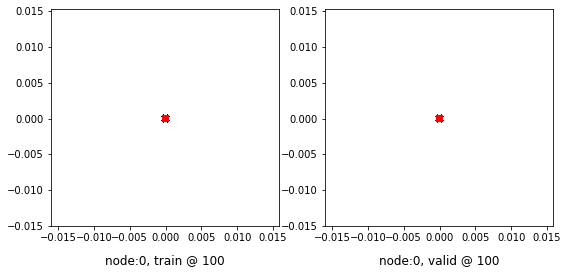

100 	 1 	 0.66580540 	 0.68654525 	 0.92477685 	 0.94522697 	 0.95211869 	 0.95182890


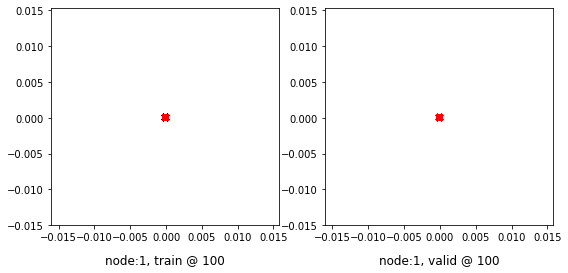

Aggregating on epoch: 101...
Aggregating on epoch: 102...
Aggregating on epoch: 103...
Aggregating on epoch: 104...
Aggregating on epoch: 105...
Aggregating on epoch: 106...
Aggregating on epoch: 107...
Aggregating on epoch: 108...
Aggregating on epoch: 109...
Aggregating on epoch: 110...
Aggregating on epoch: 111...
Aggregating on epoch: 112...
Aggregating on epoch: 113...
Aggregating on epoch: 114...
Aggregating on epoch: 115...
Aggregating on epoch: 116...
Aggregating on epoch: 117...
Aggregating on epoch: 118...
Aggregating on epoch: 119...
Aggregating on epoch: 120...
120 	 0 	 0.72102922 	 0.74768156 	 0.94973969 	 0.95394224 	 0.92185760 	 0.89940786


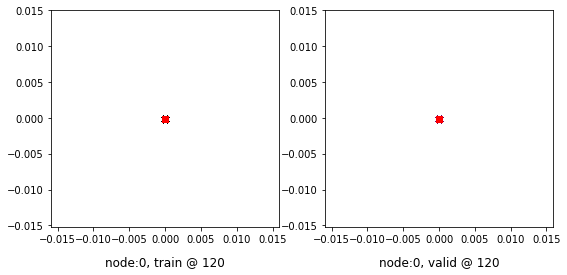

120 	 1 	 0.67393517 	 0.68655056 	 0.92587507 	 0.94522762 	 0.94508713 	 0.95182425


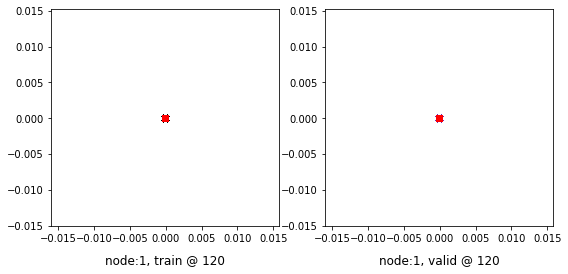

Aggregating on epoch: 121...
Aggregating on epoch: 122...
Aggregating on epoch: 123...
Aggregating on epoch: 124...
Aggregating on epoch: 125...
Aggregating on epoch: 126...
Aggregating on epoch: 127...
Aggregating on epoch: 128...
Aggregating on epoch: 129...
Aggregating on epoch: 130...
Aggregating on epoch: 131...
Aggregating on epoch: 132...
Aggregating on epoch: 133...
Aggregating on epoch: 134...
Aggregating on epoch: 135...
Aggregating on epoch: 136...
Aggregating on epoch: 137...
Aggregating on epoch: 138...
Aggregating on epoch: 139...
Aggregating on epoch: 140...
140 	 0 	 0.76276773 	 0.74768484 	 0.95367193 	 0.95394546 	 0.88405144 	 0.89940780


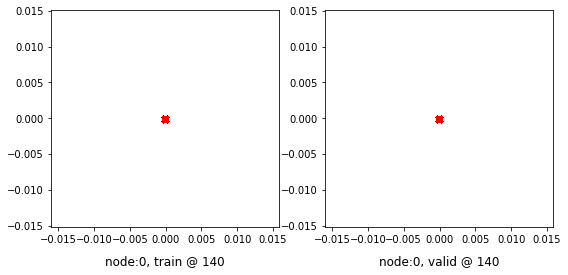

140 	 1 	 0.68557268 	 0.68654668 	 0.95149028 	 0.94522989 	 0.95906490 	 0.95183039


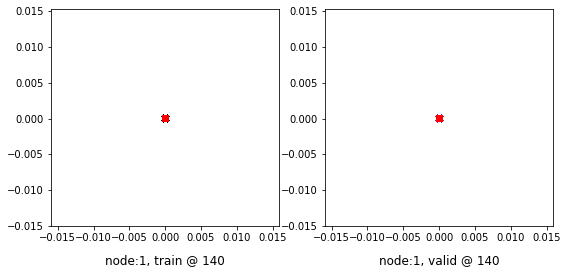

Aggregating on epoch: 141...
Aggregating on epoch: 142...
Aggregating on epoch: 143...
Aggregating on epoch: 144...
Aggregating on epoch: 145...
Aggregating on epoch: 146...
Aggregating on epoch: 147...
Aggregating on epoch: 148...
Aggregating on epoch: 149...
Aggregating on epoch: 150...
Aggregating on epoch: 151...
Aggregating on epoch: 152...
Aggregating on epoch: 153...
Aggregating on epoch: 154...
Aggregating on epoch: 155...
Aggregating on epoch: 156...
Aggregating on epoch: 157...
Aggregating on epoch: 158...
Aggregating on epoch: 159...
Aggregating on epoch: 160...
160 	 0 	 0.73886371 	 0.74768752 	 0.96066427 	 0.95394647 	 0.91494793 	 0.89940614


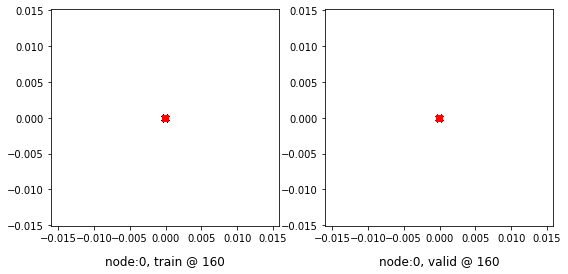

160 	 1 	 0.67988950 	 0.68655270 	 0.93493205 	 0.94522709 	 0.94818968 	 0.95182157


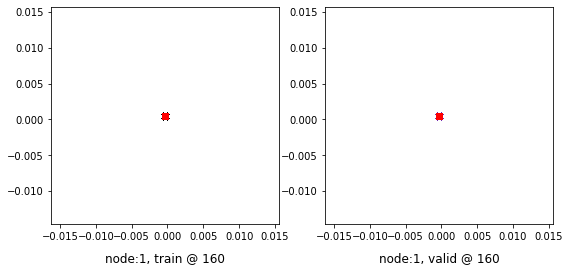

Aggregating on epoch: 161...
Aggregating on epoch: 162...
Aggregating on epoch: 163...
Aggregating on epoch: 164...
Aggregating on epoch: 165...
Aggregating on epoch: 166...
Aggregating on epoch: 167...
Aggregating on epoch: 168...
Aggregating on epoch: 169...
Aggregating on epoch: 170...
Aggregating on epoch: 171...
Aggregating on epoch: 172...
Aggregating on epoch: 173...
Aggregating on epoch: 174...
Aggregating on epoch: 175...
Aggregating on epoch: 176...
Aggregating on epoch: 177...
Aggregating on epoch: 178...
Aggregating on epoch: 179...
Aggregating on epoch: 180...
180 	 0 	 0.78133273 	 0.74768454 	 0.94822329 	 0.95394492 	 0.86003822 	 0.89940757


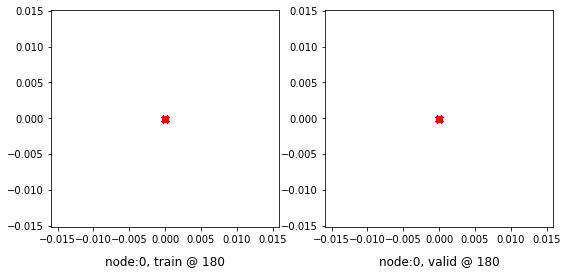

180 	 1 	 0.69569075 	 0.68655080 	 0.95150697 	 0.94523239 	 0.94896328 	 0.95182878


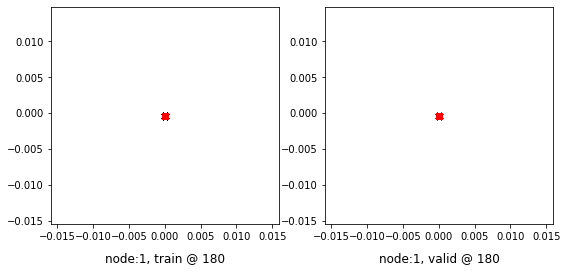

Aggregating on epoch: 181...
Aggregating on epoch: 182...
Aggregating on epoch: 183...
Aggregating on epoch: 184...
Aggregating on epoch: 185...
Aggregating on epoch: 186...
Aggregating on epoch: 187...
Aggregating on epoch: 188...
Aggregating on epoch: 189...
Aggregating on epoch: 190...
Aggregating on epoch: 191...
Aggregating on epoch: 192...
Aggregating on epoch: 193...
Aggregating on epoch: 194...
Aggregating on epoch: 195...
Aggregating on epoch: 196...
Aggregating on epoch: 197...
Aggregating on epoch: 198...
Aggregating on epoch: 199...
Aggregating on epoch: 200...
200 	 0 	 0.76999021 	 0.74768871 	 0.95404208 	 0.95394915 	 0.87719893 	 0.89940763


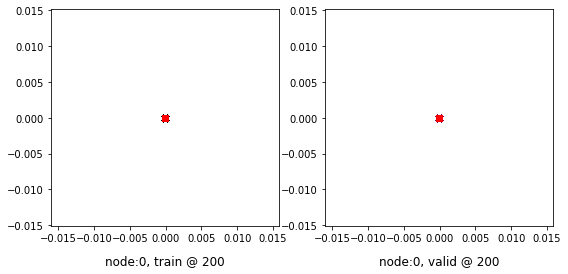

200 	 1 	 0.67841262 	 0.68654841 	 0.93738329 	 0.94522762 	 0.95211786 	 0.95182639


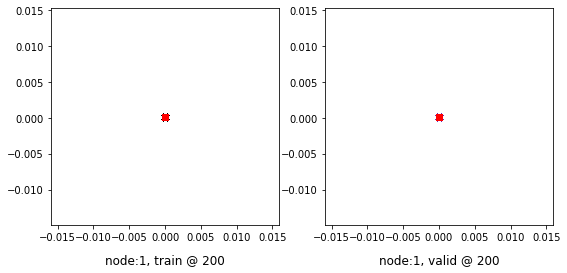

Aggregating on epoch: 201...
Aggregating on epoch: 202...
Aggregating on epoch: 203...
Aggregating on epoch: 204...
Aggregating on epoch: 205...
Aggregating on epoch: 206...
Aggregating on epoch: 207...
Aggregating on epoch: 208...
Aggregating on epoch: 209...
Aggregating on epoch: 210...
Aggregating on epoch: 211...
Aggregating on epoch: 212...
Aggregating on epoch: 213...
Aggregating on epoch: 214...
Aggregating on epoch: 215...
Aggregating on epoch: 216...
Aggregating on epoch: 217...
Aggregating on epoch: 218...
Aggregating on epoch: 219...
Aggregating on epoch: 220...
220 	 0 	 0.73226684 	 0.74768817 	 0.95403808 	 0.95394611 	 0.91491842 	 0.89940512


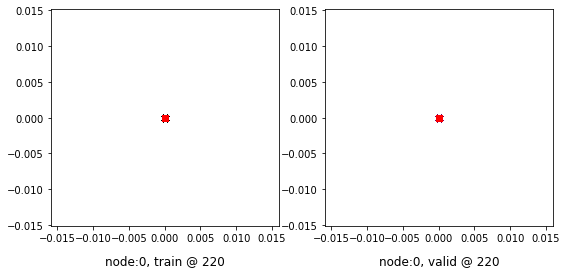

220 	 1 	 0.66954792 	 0.68654531 	 0.92725432 	 0.94522697 	 0.95085388 	 0.95182884


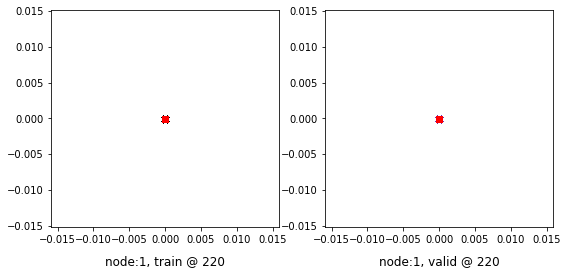

Aggregating on epoch: 221...
Aggregating on epoch: 222...
Aggregating on epoch: 223...
Aggregating on epoch: 224...
Aggregating on epoch: 225...
Aggregating on epoch: 226...
Aggregating on epoch: 227...
Aggregating on epoch: 228...
Aggregating on epoch: 229...
Aggregating on epoch: 230...
Aggregating on epoch: 231...
Aggregating on epoch: 232...
Aggregating on epoch: 233...
Aggregating on epoch: 234...
Aggregating on epoch: 235...
Aggregating on epoch: 236...
Aggregating on epoch: 237...
Aggregating on epoch: 238...
Aggregating on epoch: 239...
Aggregating on epoch: 240...
240 	 0 	 0.76675785 	 0.74768901 	 0.94746244 	 0.95394695 	 0.87385219 	 0.89940512


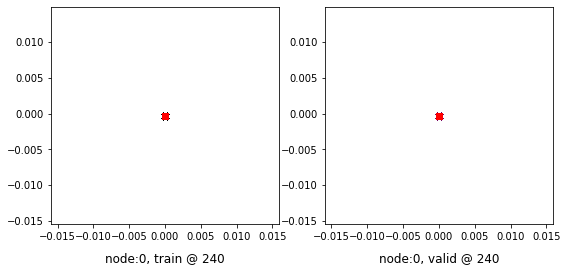

240 	 1 	 0.67025167 	 0.68653864 	 0.92985052 	 0.94522703 	 0.95274609 	 0.95183557


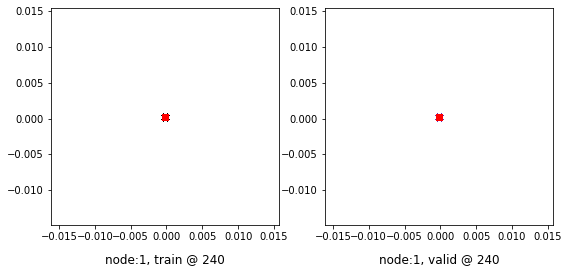

Aggregating on epoch: 241...
Aggregating on epoch: 242...
Aggregating on epoch: 243...
Aggregating on epoch: 244...
Aggregating on epoch: 245...
Aggregating on epoch: 246...
Aggregating on epoch: 247...
Aggregating on epoch: 248...
Aggregating on epoch: 249...
Aggregating on epoch: 250...
Aggregating on epoch: 251...
Aggregating on epoch: 252...
Aggregating on epoch: 253...
Aggregating on epoch: 254...
Aggregating on epoch: 255...
Aggregating on epoch: 256...
Aggregating on epoch: 257...
Aggregating on epoch: 258...
Aggregating on epoch: 259...
Aggregating on epoch: 260...
260 	 0 	 0.75598693 	 0.74768835 	 0.95037246 	 0.95394611 	 0.88753253 	 0.89940494


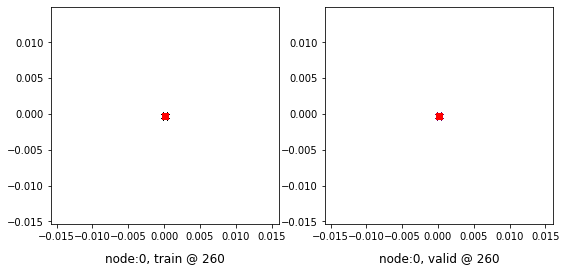

260 	 1 	 0.68087816 	 0.68654823 	 0.93732256 	 0.94523227 	 0.94959164 	 0.95183122


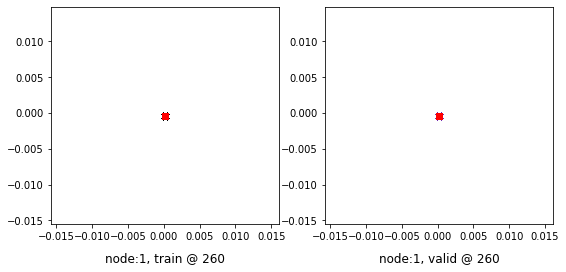

Aggregating on epoch: 261...
Aggregating on epoch: 262...
Aggregating on epoch: 263...
Aggregating on epoch: 264...
Aggregating on epoch: 265...
Aggregating on epoch: 266...
Aggregating on epoch: 267...
Aggregating on epoch: 268...
Aggregating on epoch: 269...
Aggregating on epoch: 270...
Aggregating on epoch: 271...
Aggregating on epoch: 272...
Aggregating on epoch: 273...
Aggregating on epoch: 274...
Aggregating on epoch: 275...
Aggregating on epoch: 276...
Aggregating on epoch: 277...
Aggregating on epoch: 278...
Aggregating on epoch: 279...
Aggregating on epoch: 280...
280 	 0 	 0.76715493 	 0.74769229 	 0.95812273 	 0.95394987 	 0.88411492 	 0.89940476


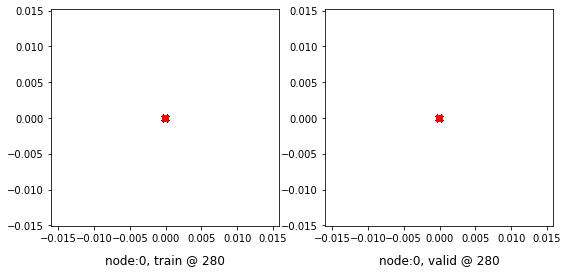

280 	 1 	 0.68219376 	 0.68655080 	 0.93734831 	 0.94523025 	 0.94830179 	 0.95182663


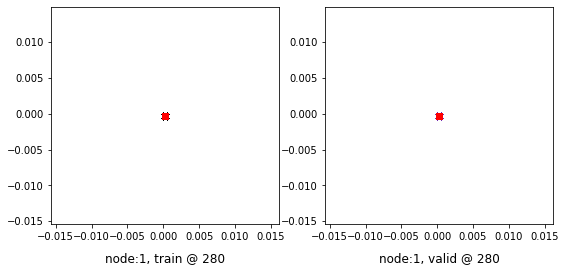

Aggregating on epoch: 281...
Aggregating on epoch: 282...
Aggregating on epoch: 283...
Aggregating on epoch: 284...
Aggregating on epoch: 285...
Aggregating on epoch: 286...
Aggregating on epoch: 287...
Aggregating on epoch: 288...
Aggregating on epoch: 289...
Aggregating on epoch: 290...
Aggregating on epoch: 291...
Aggregating on epoch: 292...
Aggregating on epoch: 293...
Aggregating on epoch: 294...
Aggregating on epoch: 295...
Aggregating on epoch: 296...
Aggregating on epoch: 297...
Aggregating on epoch: 298...
Aggregating on epoch: 299...
Aggregating on epoch: 300...
300 	 0 	 0.75100964 	 0.74768186 	 0.95221645 	 0.95394433 	 0.89435393 	 0.89940965


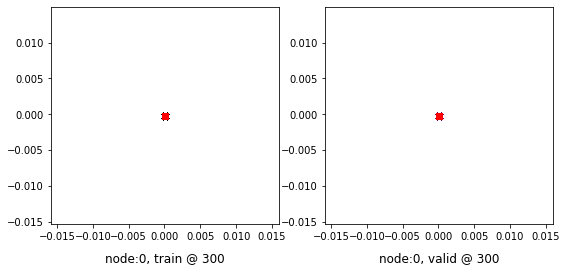

300 	 1 	 0.69773507 	 0.68655843 	 0.95414233 	 0.94523543 	 0.94955438 	 0.95182419


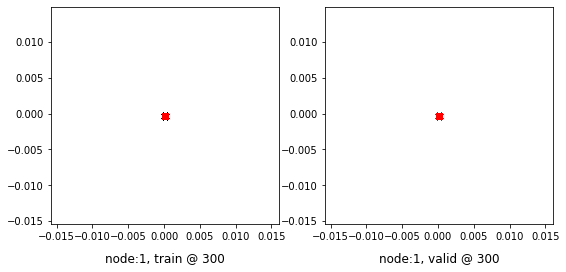

Aggregating on epoch: 301...
Aggregating on epoch: 302...
Aggregating on epoch: 303...
Aggregating on epoch: 304...
Aggregating on epoch: 305...
Aggregating on epoch: 306...
Aggregating on epoch: 307...
Aggregating on epoch: 308...
Aggregating on epoch: 309...
Aggregating on epoch: 310...
Aggregating on epoch: 311...
Aggregating on epoch: 312...
Aggregating on epoch: 313...
Aggregating on epoch: 314...
Aggregating on epoch: 315...
Aggregating on epoch: 316...
Aggregating on epoch: 317...
Aggregating on epoch: 318...
Aggregating on epoch: 319...
Aggregating on epoch: 320...
320 	 0 	 0.77755368 	 0.74768412 	 0.94787687 	 0.95394433 	 0.86347067 	 0.89940739


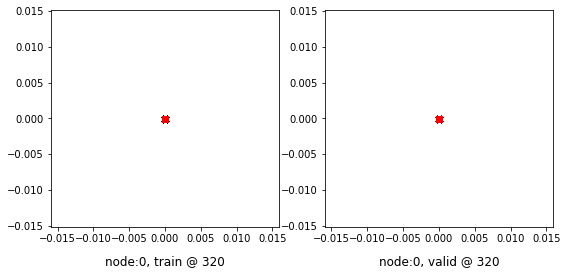

320 	 1 	 0.67595172 	 0.68655020 	 0.93107319 	 0.94522691 	 0.94826883 	 0.95182389


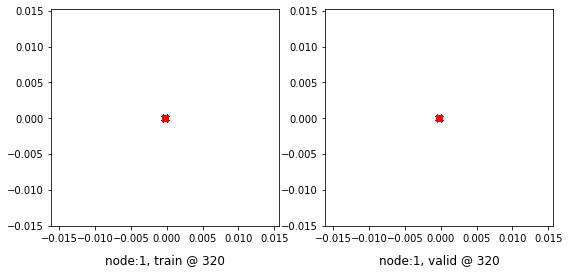

Aggregating on epoch: 321...
Aggregating on epoch: 322...
Aggregating on epoch: 323...
Aggregating on epoch: 324...
Aggregating on epoch: 325...
Aggregating on epoch: 326...
Aggregating on epoch: 327...
Aggregating on epoch: 328...
Aggregating on epoch: 329...
Aggregating on epoch: 330...
Aggregating on epoch: 331...
Aggregating on epoch: 332...
Aggregating on epoch: 333...
Aggregating on epoch: 334...
Aggregating on epoch: 335...
Aggregating on epoch: 336...
Aggregating on epoch: 337...
Aggregating on epoch: 338...
Aggregating on epoch: 339...
Aggregating on epoch: 340...
340 	 0 	 0.75824076 	 0.74768531 	 0.95257324 	 0.95394737 	 0.88747990 	 0.89940923


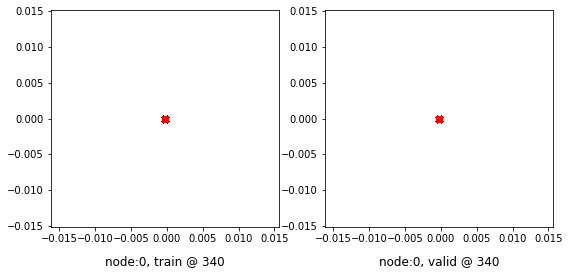

340 	 1 	 0.68287539 	 0.68654978 	 0.93481976 	 0.94522774 	 0.94509143 	 0.95182514


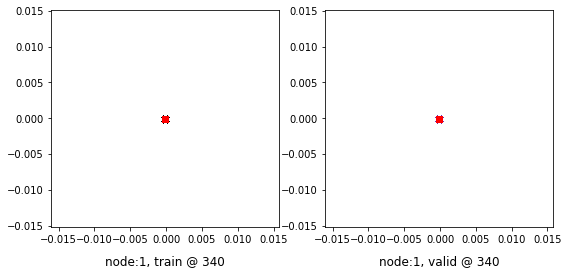

Aggregating on epoch: 341...
Aggregating on epoch: 342...
Aggregating on epoch: 343...
Aggregating on epoch: 344...
Aggregating on epoch: 345...
Aggregating on epoch: 346...
Aggregating on epoch: 347...
Aggregating on epoch: 348...
Aggregating on epoch: 349...
Aggregating on epoch: 350...
Aggregating on epoch: 351...
Aggregating on epoch: 352...
Aggregating on epoch: 353...
Aggregating on epoch: 354...
Aggregating on epoch: 355...
Aggregating on epoch: 356...
Aggregating on epoch: 357...
Aggregating on epoch: 358...
Aggregating on epoch: 359...
Aggregating on epoch: 360...
360 	 0 	 0.73004824 	 0.74768364 	 0.94500041 	 0.95394415 	 0.90809965 	 0.89940768


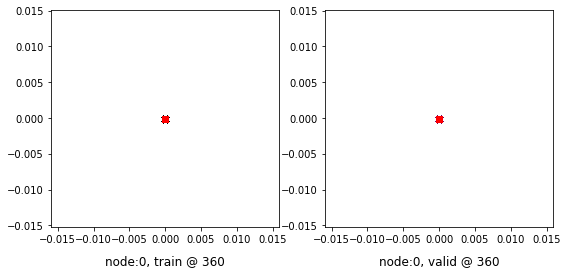

360 	 1 	 0.69314504 	 0.68655199 	 0.94891000 	 0.94522858 	 0.94891238 	 0.95182377


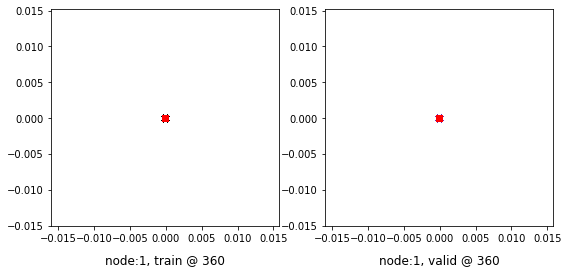

Aggregating on epoch: 361...
Aggregating on epoch: 362...
Aggregating on epoch: 363...
Aggregating on epoch: 364...
Aggregating on epoch: 365...
Aggregating on epoch: 366...
Aggregating on epoch: 367...
Aggregating on epoch: 368...
Aggregating on epoch: 369...
Aggregating on epoch: 370...
Aggregating on epoch: 371...
Aggregating on epoch: 372...
Aggregating on epoch: 373...
Aggregating on epoch: 374...
Aggregating on epoch: 375...
Aggregating on epoch: 376...
Aggregating on epoch: 377...
Aggregating on epoch: 378...
Aggregating on epoch: 379...
Aggregating on epoch: 380...
380 	 0 	 0.75844437 	 0.74769074 	 0.95625257 	 0.95394826 	 0.89095545 	 0.89940470


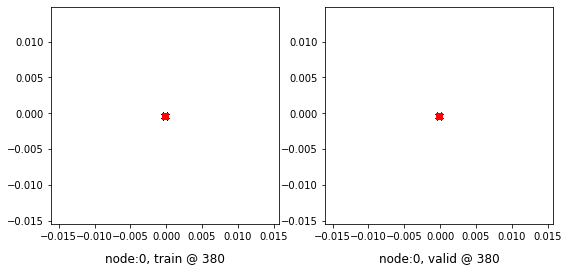

380 	 1 	 0.67461574 	 0.68654013 	 0.93608570 	 0.94522792 	 0.95461720 	 0.95183498


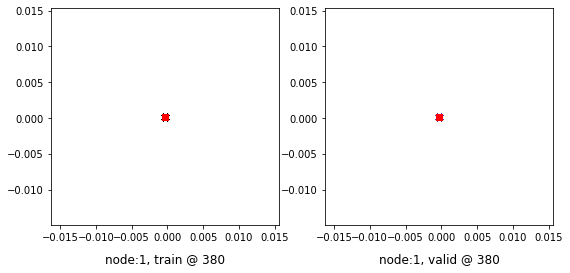

Aggregating on epoch: 381...
Aggregating on epoch: 382...
Aggregating on epoch: 383...
Aggregating on epoch: 384...
Aggregating on epoch: 385...
Aggregating on epoch: 386...
Aggregating on epoch: 387...
Aggregating on epoch: 388...
Aggregating on epoch: 389...
Aggregating on epoch: 390...
Aggregating on epoch: 391...
Aggregating on epoch: 392...
Aggregating on epoch: 393...
Aggregating on epoch: 394...
Aggregating on epoch: 395...
Aggregating on epoch: 396...
Aggregating on epoch: 397...
Aggregating on epoch: 398...
Aggregating on epoch: 399...
Aggregating on epoch: 400...
400 	 0 	 0.74088472 	 0.74768126 	 0.95587432 	 0.95394683 	 0.90813667 	 0.89941275


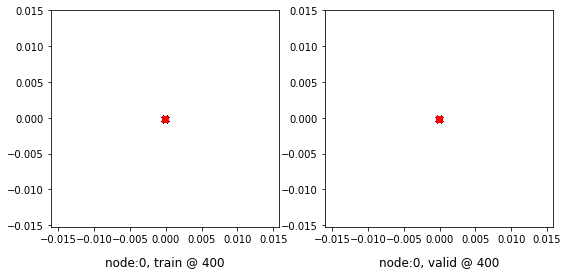

400 	 1 	 0.66101378 	 0.68655598 	 0.92819691 	 0.94523782 	 0.96033043 	 0.95182902


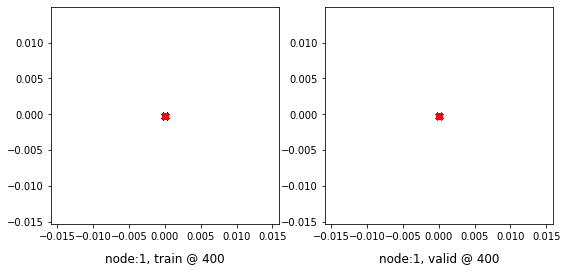

Aggregating on epoch: 401...
Aggregating on epoch: 402...
Aggregating on epoch: 403...
Aggregating on epoch: 404...
Aggregating on epoch: 405...
Aggregating on epoch: 406...
Aggregating on epoch: 407...
Aggregating on epoch: 408...
Aggregating on epoch: 409...
Aggregating on epoch: 410...
Aggregating on epoch: 411...
Aggregating on epoch: 412...
Aggregating on epoch: 413...
Aggregating on epoch: 414...
Aggregating on epoch: 415...
Aggregating on epoch: 416...
Aggregating on epoch: 417...
Aggregating on epoch: 418...
Aggregating on epoch: 419...
Aggregating on epoch: 420...
420 	 0 	 0.79387081 	 0.74769032 	 0.95072496 	 0.95394766 	 0.85000145 	 0.89940453


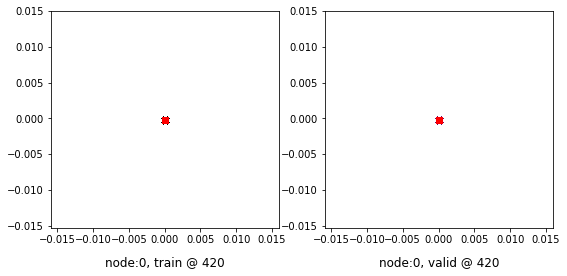

420 	 1 	 0.67144006 	 0.68655103 	 0.92976797 	 0.94522750 	 0.95147544 	 0.95182365


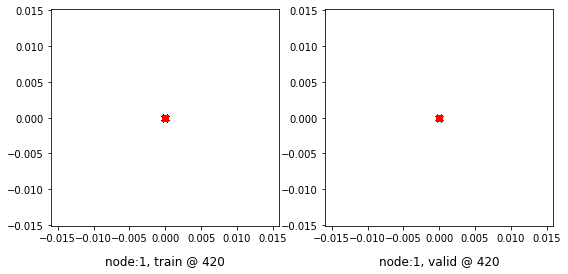

Aggregating on epoch: 421...
Aggregating on epoch: 422...
Aggregating on epoch: 423...
Aggregating on epoch: 424...
Aggregating on epoch: 425...
Aggregating on epoch: 426...
Aggregating on epoch: 427...
Aggregating on epoch: 428...
Aggregating on epoch: 429...
Aggregating on epoch: 430...
Aggregating on epoch: 431...
Aggregating on epoch: 432...
Aggregating on epoch: 433...
Aggregating on epoch: 434...
Aggregating on epoch: 435...
Aggregating on epoch: 436...
Aggregating on epoch: 437...
Aggregating on epoch: 438...
Aggregating on epoch: 439...
Aggregating on epoch: 440...
440 	 0 	 0.74069816 	 0.74768490 	 0.95221680 	 0.95394474 	 0.90466565 	 0.89940703


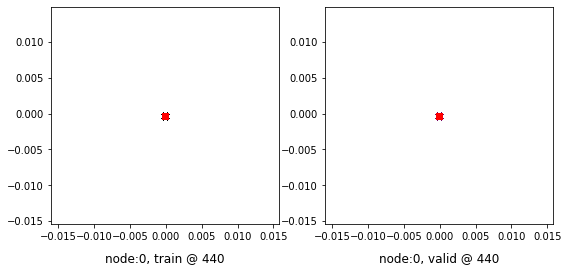

440 	 1 	 0.69062042 	 0.68653834 	 0.95021838 	 0.94523150 	 0.95274502 	 0.95184034


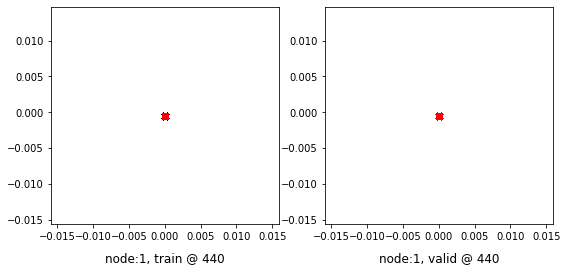

Aggregating on epoch: 441...
Aggregating on epoch: 442...
Aggregating on epoch: 443...
Aggregating on epoch: 444...
Aggregating on epoch: 445...
Aggregating on epoch: 446...
Aggregating on epoch: 447...
Aggregating on epoch: 448...
Aggregating on epoch: 449...
Aggregating on epoch: 450...
Aggregating on epoch: 451...
Aggregating on epoch: 452...
Aggregating on epoch: 453...
Aggregating on epoch: 454...
Aggregating on epoch: 455...
Aggregating on epoch: 456...
Aggregating on epoch: 457...
Aggregating on epoch: 458...
Aggregating on epoch: 459...
Aggregating on epoch: 460...
460 	 0 	 0.73127323 	 0.74768269 	 0.94967890 	 0.95394498 	 0.91155303 	 0.89940947


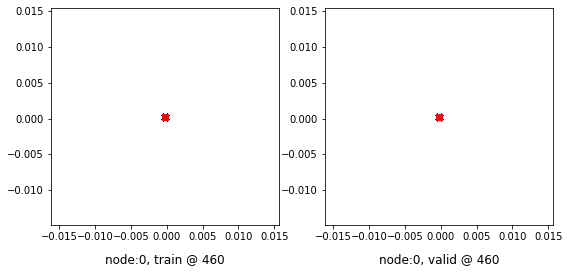

460 	 1 	 0.68064499 	 0.68655539 	 0.95148981 	 0.94522977 	 0.96399194 	 0.95182157


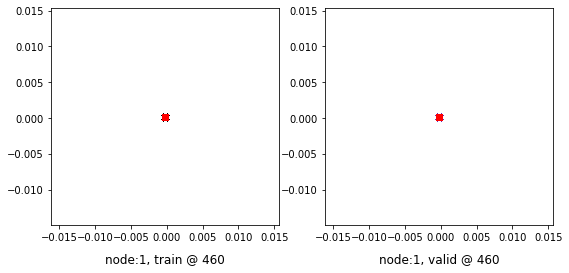

Aggregating on epoch: 461...
Aggregating on epoch: 462...
Aggregating on epoch: 463...
Aggregating on epoch: 464...
Aggregating on epoch: 465...
Aggregating on epoch: 466...
Aggregating on epoch: 467...
Aggregating on epoch: 468...
Aggregating on epoch: 469...
Aggregating on epoch: 470...
Aggregating on epoch: 471...
Aggregating on epoch: 472...
Aggregating on epoch: 473...
Aggregating on epoch: 474...
Aggregating on epoch: 475...
Aggregating on epoch: 476...
Aggregating on epoch: 477...
Aggregating on epoch: 478...
Aggregating on epoch: 479...
Aggregating on epoch: 480...
480 	 0 	 0.72547942 	 0.74768788 	 0.95072502 	 0.95394808 	 0.91839290 	 0.89940739


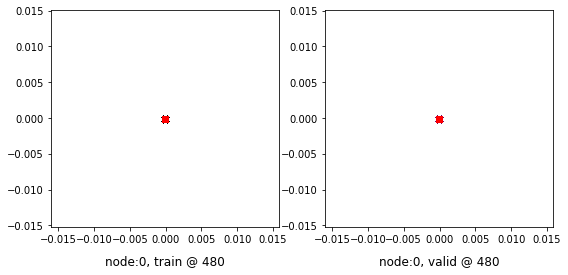

480 	 1 	 0.66635156 	 0.68654835 	 0.92214423 	 0.94522691 	 0.94893962 	 0.95182574


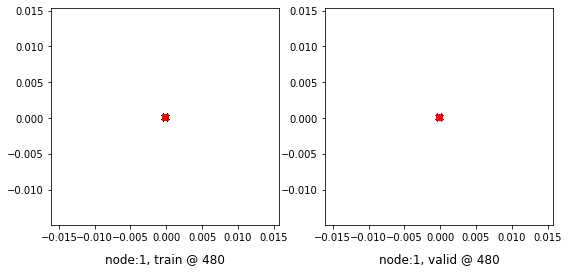

Aggregating on epoch: 481...
Aggregating on epoch: 482...
Aggregating on epoch: 483...
Aggregating on epoch: 484...
Aggregating on epoch: 485...
Aggregating on epoch: 486...
Aggregating on epoch: 487...
Aggregating on epoch: 488...
Aggregating on epoch: 489...
Aggregating on epoch: 490...
Aggregating on epoch: 491...
Aggregating on epoch: 492...
Aggregating on epoch: 493...
Aggregating on epoch: 494...
Aggregating on epoch: 495...
Aggregating on epoch: 496...
Aggregating on epoch: 497...
Aggregating on epoch: 498...
Aggregating on epoch: 499...
Aggregating on epoch: 500...
500 	 0 	 0.74888831 	 0.74769092 	 0.96040785 	 0.95395118 	 0.90466714 	 0.89940745


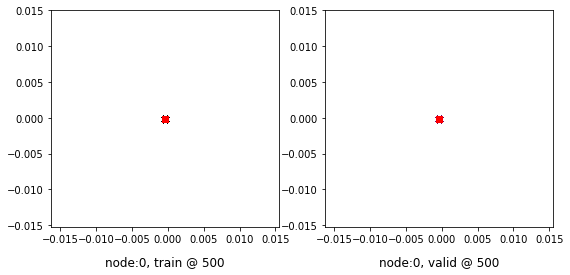

500 	 1 	 0.65066051 	 0.68654746 	 0.91843677 	 0.94522691 	 0.96092516 	 0.95182663


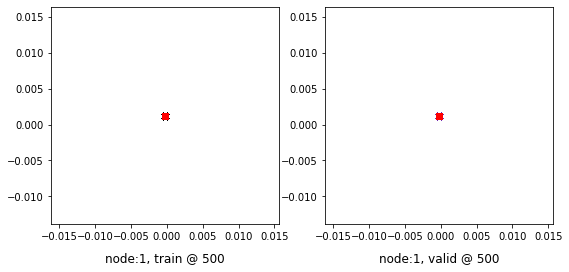

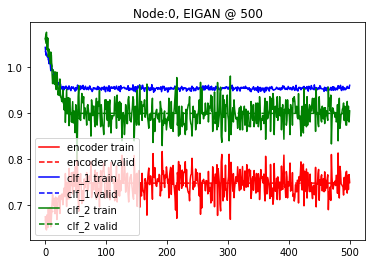

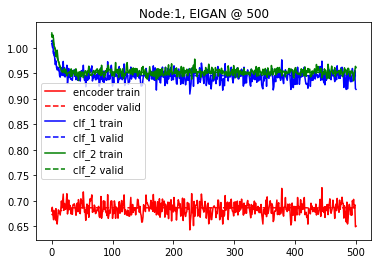

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.6 and delta=3
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.72295189 	 0.70439661 	 1.05144060 	 1.04903996 	 1.02186847 	 1.03779054


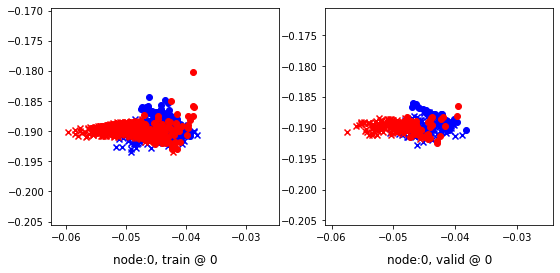

0 	 1 	 0.71069729 	 0.70160067 	 1.02257967 	 1.01648688 	 1.00534761 	 1.00803339


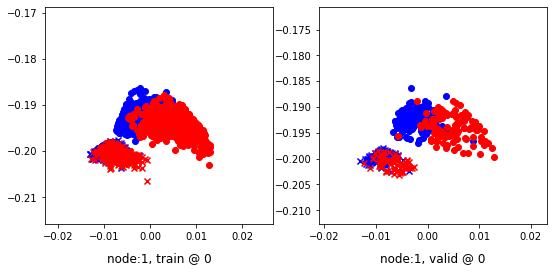

Aggregating on epoch: 3...
Aggregating on epoch: 6...
Aggregating on epoch: 9...
Aggregating on epoch: 12...
Aggregating on epoch: 15...
Aggregating on epoch: 18...
20 	 0 	 0.73859519 	 0.73503399 	 0.97442693 	 0.97385132 	 0.92912042 	 0.93196452


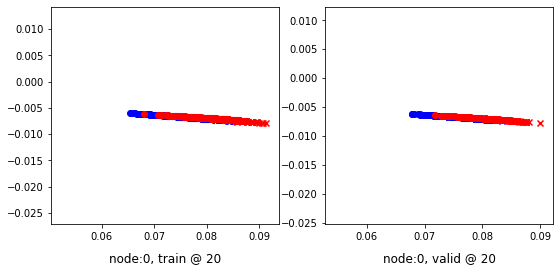

20 	 1 	 0.70100254 	 0.69587290 	 0.96129376 	 0.95457959 	 0.95356035 	 0.95185387


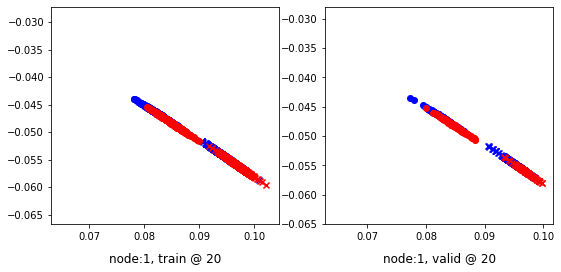

Aggregating on epoch: 21...
Aggregating on epoch: 24...
Aggregating on epoch: 27...
Aggregating on epoch: 30...
Aggregating on epoch: 33...
Aggregating on epoch: 36...
Aggregating on epoch: 39...
40 	 0 	 0.72966367 	 0.74802810 	 0.95465618 	 0.95434731 	 0.91814137 	 0.89946640


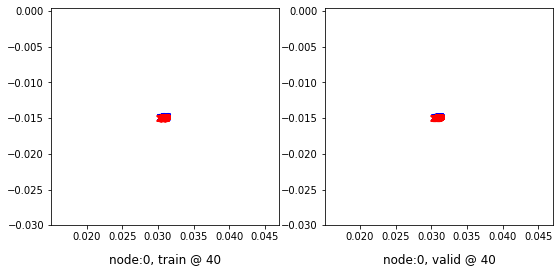

40 	 1 	 0.68337196 	 0.68650925 	 0.94883794 	 0.94523561 	 0.95861745 	 0.95187354


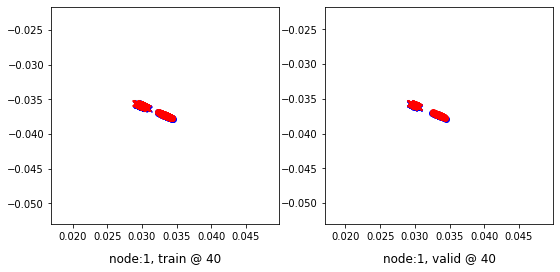

Aggregating on epoch: 42...
Aggregating on epoch: 45...
Aggregating on epoch: 48...
Aggregating on epoch: 51...
Aggregating on epoch: 54...
Aggregating on epoch: 57...
Aggregating on epoch: 60...
60 	 0 	 0.76887548 	 0.74767226 	 0.94933516 	 0.95394403 	 0.87360686 	 0.89941895


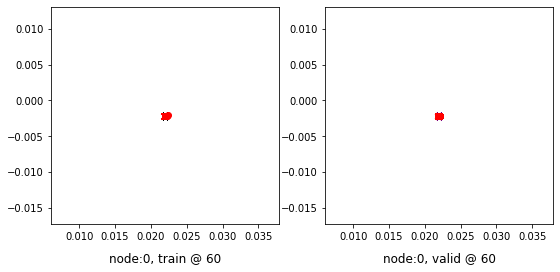

60 	 1 	 0.67707014 	 0.68655241 	 0.93860418 	 0.94523185 	 0.95468163 	 0.95182663


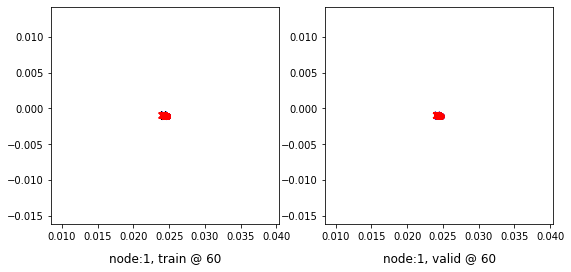

Aggregating on epoch: 63...
Aggregating on epoch: 66...
Aggregating on epoch: 69...
Aggregating on epoch: 72...
Aggregating on epoch: 75...
Aggregating on epoch: 78...
80 	 0 	 0.74274045 	 0.74768317 	 0.95771402 	 0.95394629 	 0.90812081 	 0.89941031


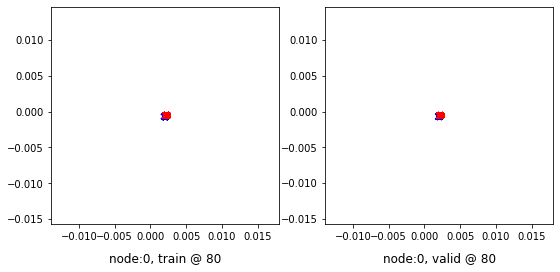

80 	 1 	 0.68345273 	 0.68655509 	 0.94634867 	 0.94523060 	 0.95604324 	 0.95182270


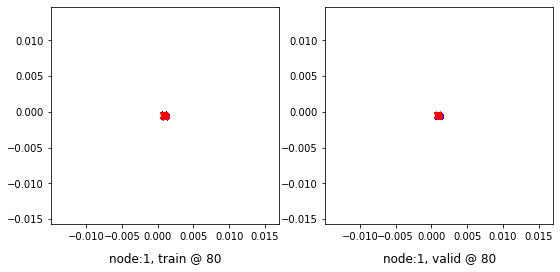

Aggregating on epoch: 81...
Aggregating on epoch: 84...
Aggregating on epoch: 87...
Aggregating on epoch: 90...
Aggregating on epoch: 93...
Aggregating on epoch: 96...
Aggregating on epoch: 99...
100 	 0 	 0.73713183 	 0.74768806 	 0.95552963 	 0.95394987 	 0.91154504 	 0.89940900


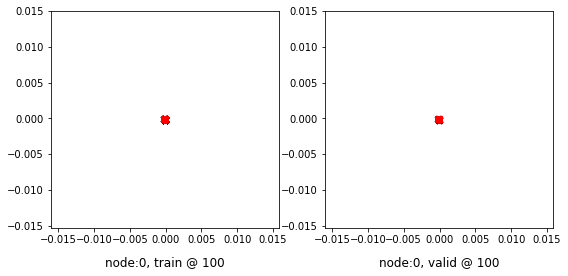

100 	 1 	 0.67205042 	 0.68654740 	 0.93102342 	 0.94522536 	 0.95212048 	 0.95182514


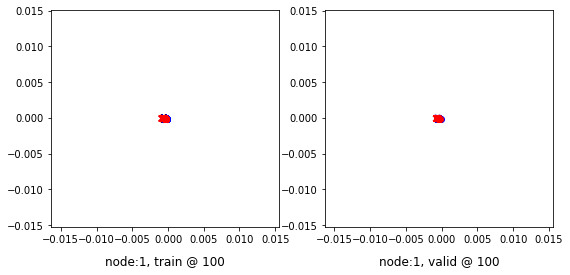

Aggregating on epoch: 102...
Aggregating on epoch: 105...
Aggregating on epoch: 108...
Aggregating on epoch: 111...
Aggregating on epoch: 114...
Aggregating on epoch: 117...
Aggregating on epoch: 120...
120 	 0 	 0.75530404 	 0.74768585 	 0.94963682 	 0.95394701 	 0.88747996 	 0.89940834


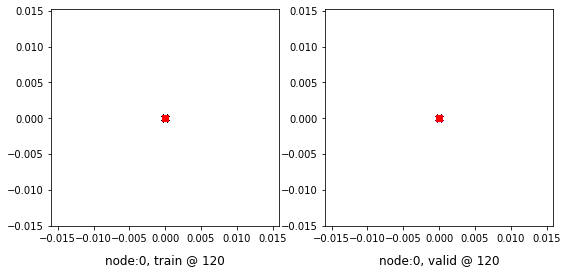

120 	 1 	 0.66803032 	 0.68655586 	 0.93217891 	 0.94523060 	 0.95729578 	 0.95182192


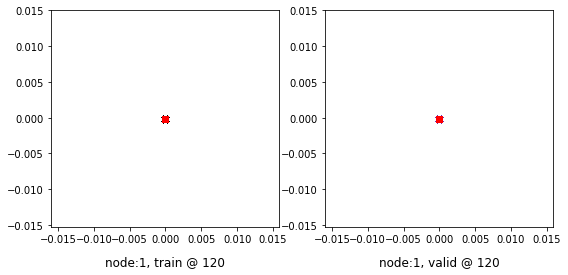

Aggregating on epoch: 123...
Aggregating on epoch: 126...
Aggregating on epoch: 129...
Aggregating on epoch: 132...
Aggregating on epoch: 135...
Aggregating on epoch: 138...
140 	 0 	 0.74159753 	 0.74768674 	 0.94967270 	 0.95394480 	 0.90122247 	 0.89940524


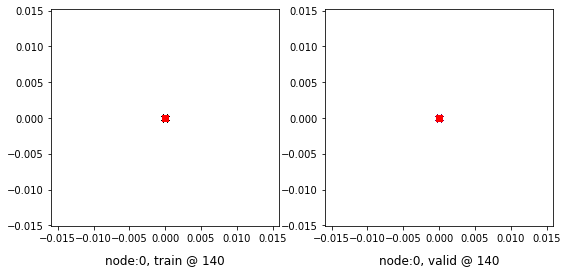

140 	 1 	 0.69570023 	 0.68655097 	 0.95017731 	 0.94522774 	 0.94762409 	 0.95182395


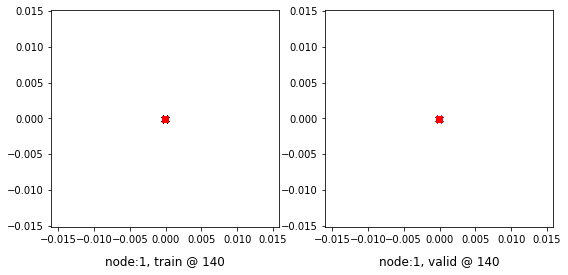

Aggregating on epoch: 141...
Aggregating on epoch: 144...
Aggregating on epoch: 147...
Aggregating on epoch: 150...
Aggregating on epoch: 153...
Aggregating on epoch: 156...
Aggregating on epoch: 159...
160 	 0 	 0.68371207 	 0.74767888 	 0.95733875 	 0.95394593 	 0.96677381 	 0.89941424


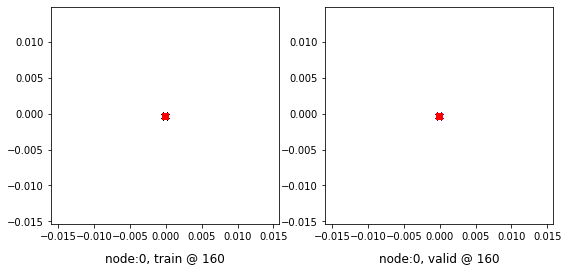

160 	 1 	 0.68968606 	 0.68654644 	 0.93607122 	 0.94522953 	 0.93953240 	 0.95183027


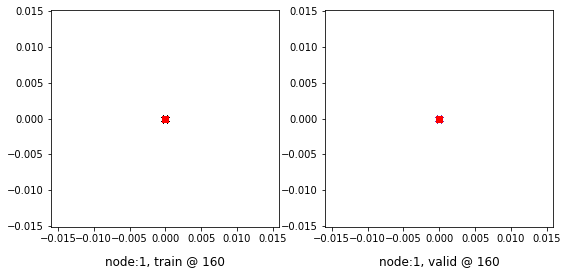

Aggregating on epoch: 162...
Aggregating on epoch: 165...
Aggregating on epoch: 168...
Aggregating on epoch: 171...
Aggregating on epoch: 174...
Aggregating on epoch: 177...
Aggregating on epoch: 180...
180 	 0 	 0.75877994 	 0.74768347 	 0.94967198 	 0.95394462 	 0.88403928 	 0.89940834


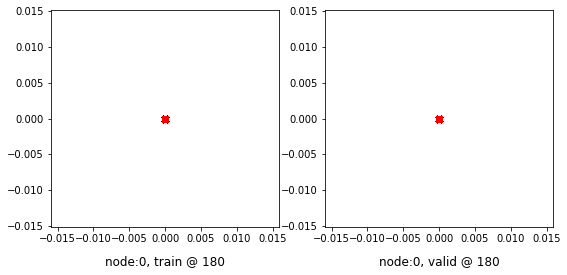

180 	 1 	 0.67907816 	 0.68654597 	 0.94119465 	 0.94523114 	 0.95526361 	 0.95183235


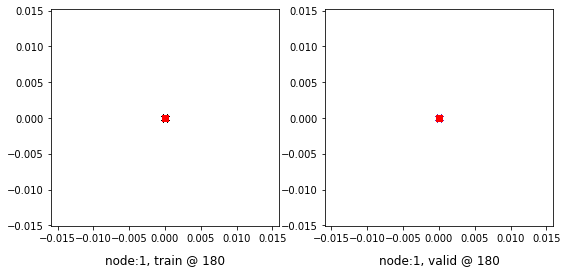

Aggregating on epoch: 183...
Aggregating on epoch: 186...
Aggregating on epoch: 189...
Aggregating on epoch: 192...
Aggregating on epoch: 195...
Aggregating on epoch: 198...
200 	 0 	 0.75378329 	 0.74768853 	 0.95843571 	 0.95394593 	 0.89779955 	 0.89940459


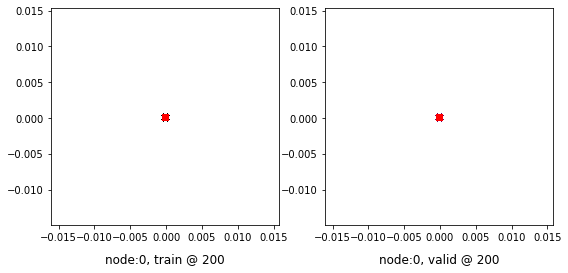

200 	 1 	 0.69250047 	 0.68655193 	 0.94890785 	 0.94522893 	 0.94955456 	 0.95182419


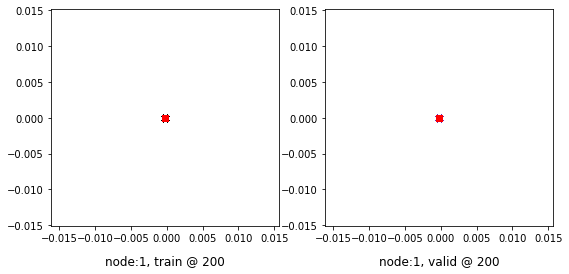

Aggregating on epoch: 201...
Aggregating on epoch: 204...
Aggregating on epoch: 207...
Aggregating on epoch: 210...
Aggregating on epoch: 213...
Aggregating on epoch: 216...
Aggregating on epoch: 219...
220 	 0 	 0.74738151 	 0.74768233 	 0.94858783 	 0.95394462 	 0.89435357 	 0.89940947


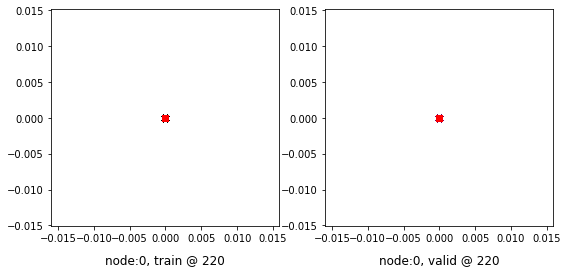

220 	 1 	 0.69449800 	 0.68655491 	 0.94762838 	 0.94522923 	 0.94627762 	 0.95182151


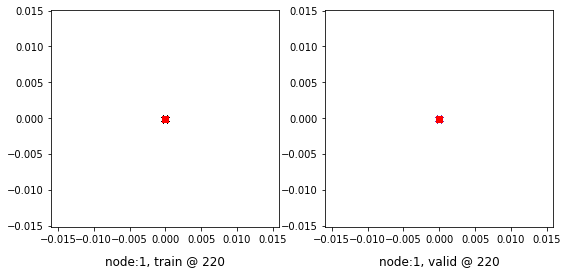

Aggregating on epoch: 222...
Aggregating on epoch: 225...
Aggregating on epoch: 228...
Aggregating on epoch: 231...
Aggregating on epoch: 234...
Aggregating on epoch: 237...
Aggregating on epoch: 240...
240 	 0 	 0.74485803 	 0.74769109 	 0.95293164 	 0.95394886 	 0.90122080 	 0.89940494


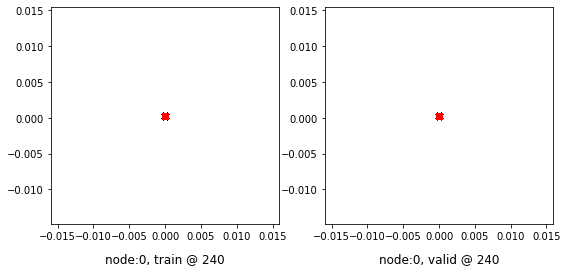

240 	 1 	 0.70529389 	 0.68654644 	 0.95923191 	 0.94523066 	 0.94708508 	 0.95183140


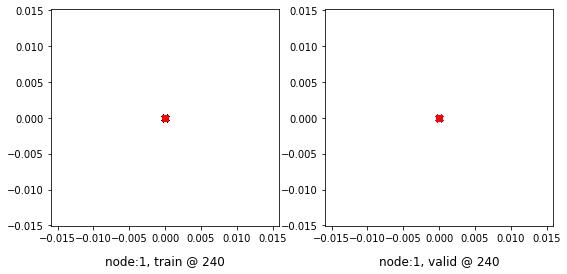

Aggregating on epoch: 243...
Aggregating on epoch: 246...
Aggregating on epoch: 249...
Aggregating on epoch: 252...
Aggregating on epoch: 255...
Aggregating on epoch: 258...
260 	 0 	 0.75442129 	 0.74768722 	 0.95219898 	 0.95394772 	 0.89092475 	 0.89940768


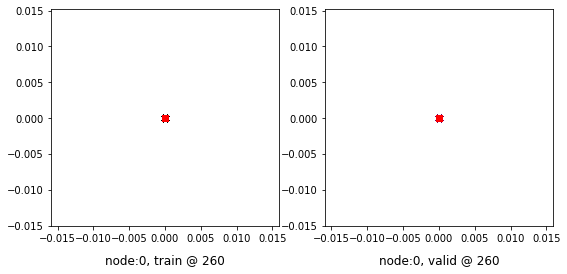

260 	 1 	 0.67205238 	 0.68654126 	 0.93353105 	 0.94522792 	 0.95462573 	 0.95183384


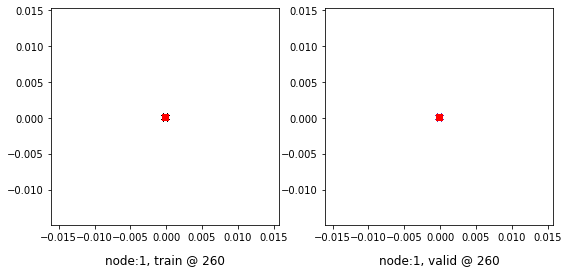

Aggregating on epoch: 261...
Aggregating on epoch: 264...
Aggregating on epoch: 267...
Aggregating on epoch: 270...
Aggregating on epoch: 273...
Aggregating on epoch: 276...
Aggregating on epoch: 279...
280 	 0 	 0.75354886 	 0.74768436 	 0.95476377 	 0.95394450 	 0.89436215 	 0.89940733


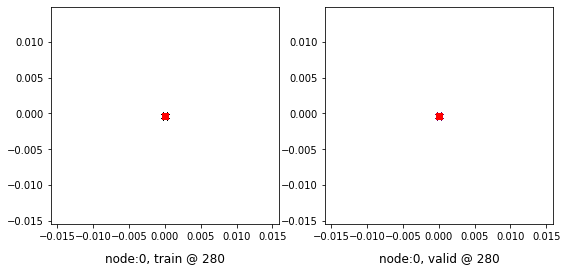

280 	 1 	 0.70088643 	 0.68655568 	 0.95412177 	 0.94523436 	 0.94638258 	 0.95182586


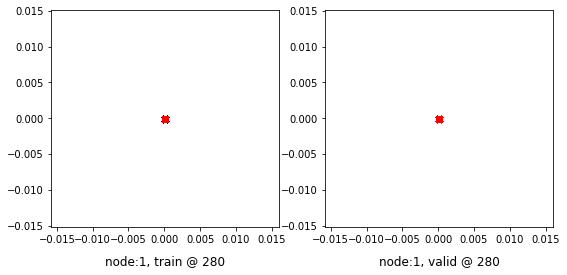

Aggregating on epoch: 282...
Aggregating on epoch: 285...
Aggregating on epoch: 288...
Aggregating on epoch: 291...
Aggregating on epoch: 294...
Aggregating on epoch: 297...
Aggregating on epoch: 300...
300 	 0 	 0.72935688 	 0.74768484 	 0.95802784 	 0.95394403 	 0.92181808 	 0.89940637


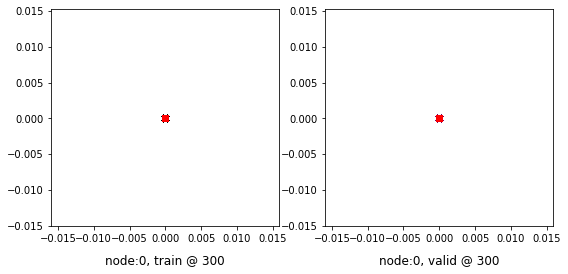

300 	 1 	 0.67499554 	 0.68655467 	 0.94377232 	 0.94522899 	 0.96192414 	 0.95182151


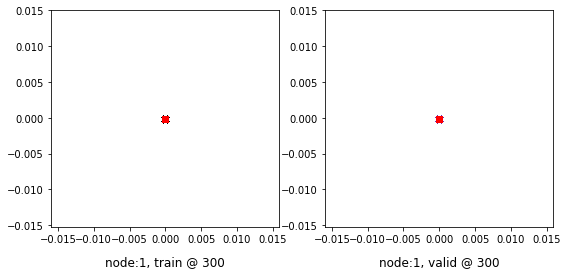

Aggregating on epoch: 303...
Aggregating on epoch: 306...
Aggregating on epoch: 309...
Aggregating on epoch: 312...
Aggregating on epoch: 315...
Aggregating on epoch: 318...
320 	 0 	 0.73012733 	 0.74768400 	 0.94853610 	 0.95394695 	 0.91155607 	 0.89941013


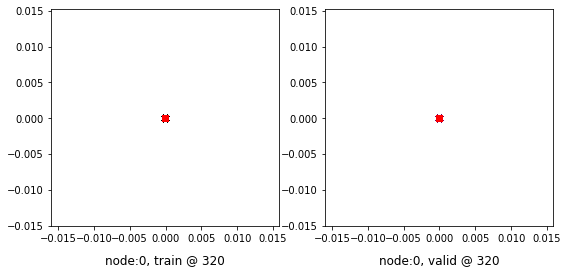

320 	 1 	 0.68857670 	 0.68655103 	 0.93991715 	 0.94523031 	 0.94448763 	 0.95182645


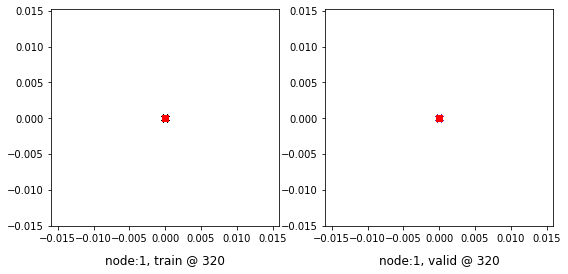

Aggregating on epoch: 321...
Aggregating on epoch: 324...
Aggregating on epoch: 327...
Aggregating on epoch: 330...
Aggregating on epoch: 333...
Aggregating on epoch: 336...
Aggregating on epoch: 339...
340 	 0 	 0.78616852 	 0.74769253 	 0.95664316 	 0.95394987 	 0.86362201 	 0.89940453


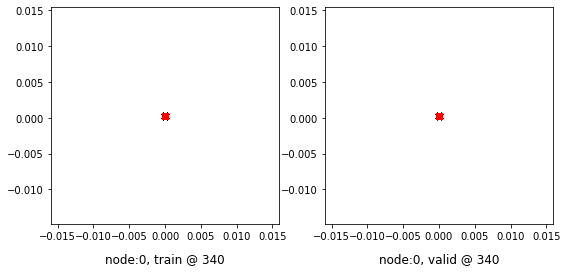

340 	 1 	 0.69182295 	 0.68655318 	 0.95274282 	 0.94522780 	 0.95406687 	 0.95182180


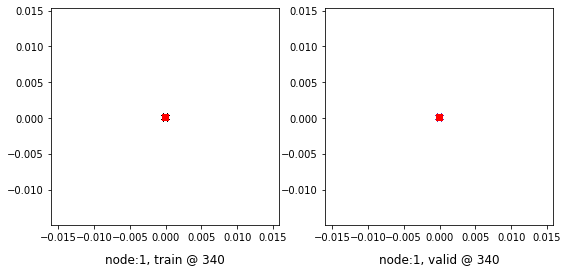

Aggregating on epoch: 342...
Aggregating on epoch: 345...
Aggregating on epoch: 348...
Aggregating on epoch: 351...
Aggregating on epoch: 354...
Aggregating on epoch: 357...
Aggregating on epoch: 360...
360 	 0 	 0.71509504 	 0.74768454 	 0.94717711 	 0.95394373 	 0.92522937 	 0.89940637


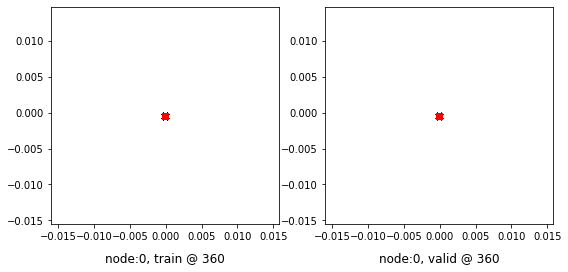

360 	 1 	 0.67889220 	 0.68655288 	 0.94505548 	 0.94522721 	 0.95931047 	 0.95182151


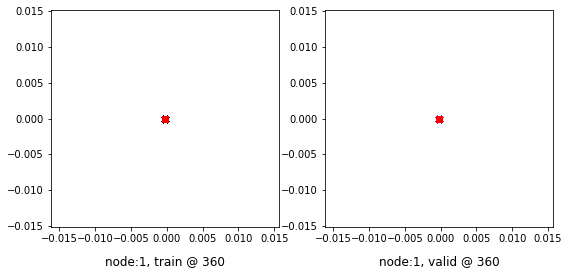

Aggregating on epoch: 363...
Aggregating on epoch: 366...
Aggregating on epoch: 369...
Aggregating on epoch: 372...
Aggregating on epoch: 375...
Aggregating on epoch: 378...
380 	 0 	 0.75159234 	 0.74768740 	 0.95624107 	 0.95394659 	 0.89779598 	 0.89940637


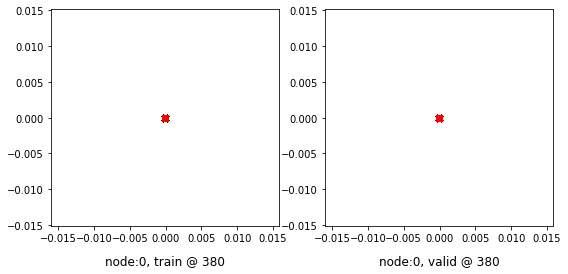

380 	 1 	 0.68545032 	 0.68655425 	 0.94505894 	 0.94523233 	 0.95275575 	 0.95182526


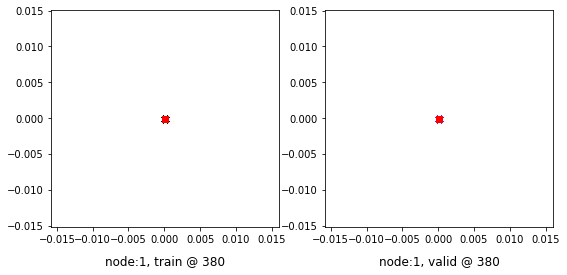

Aggregating on epoch: 381...
Aggregating on epoch: 384...
Aggregating on epoch: 387...
Aggregating on epoch: 390...
Aggregating on epoch: 393...
Aggregating on epoch: 396...
Aggregating on epoch: 399...
400 	 0 	 0.78324091 	 0.74768847 	 0.95367175 	 0.95394605 	 0.86357808 	 0.89940476


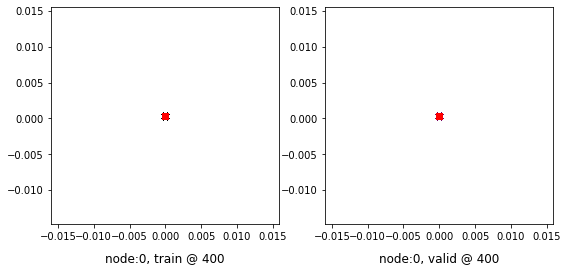

400 	 1 	 0.69639266 	 0.68655372 	 0.95408511 	 0.94523114 	 0.95083982 	 0.95182461


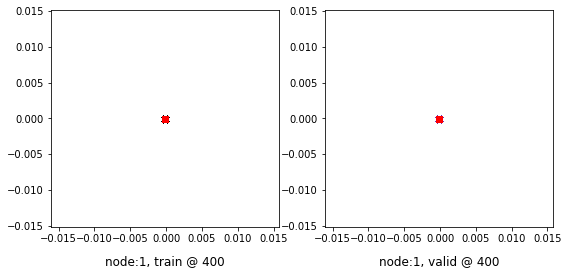

Aggregating on epoch: 402...
Aggregating on epoch: 405...
Aggregating on epoch: 408...
Aggregating on epoch: 411...
Aggregating on epoch: 414...
Aggregating on epoch: 417...
Aggregating on epoch: 420...
420 	 0 	 0.75784892 	 0.74768609 	 0.95222288 	 0.95394403 	 0.88752115 	 0.89940512


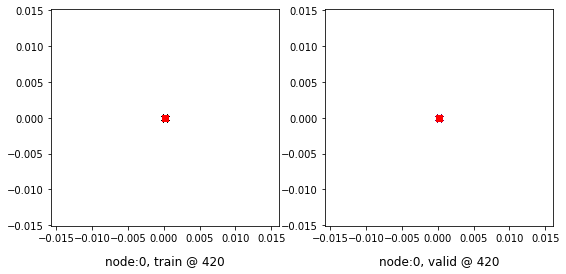

420 	 1 	 0.70999259 	 0.68655407 	 0.96304053 	 0.94522876 	 0.94619507 	 0.95182186


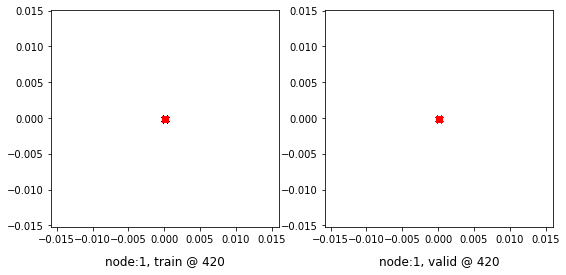

Aggregating on epoch: 423...
Aggregating on epoch: 426...
Aggregating on epoch: 429...
Aggregating on epoch: 432...
Aggregating on epoch: 435...
Aggregating on epoch: 438...
440 	 0 	 0.78647751 	 0.74768919 	 0.96030354 	 0.95394725 	 0.86697334 	 0.89940524


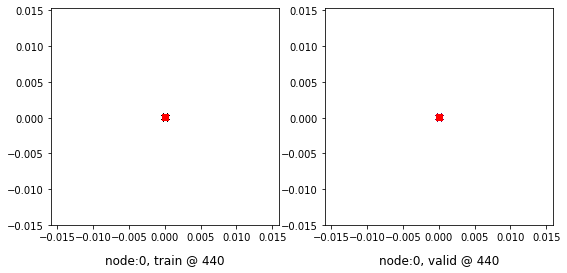

440 	 1 	 0.67331362 	 0.68654680 	 0.92722839 	 0.94522715 	 0.94706225 	 0.95182753


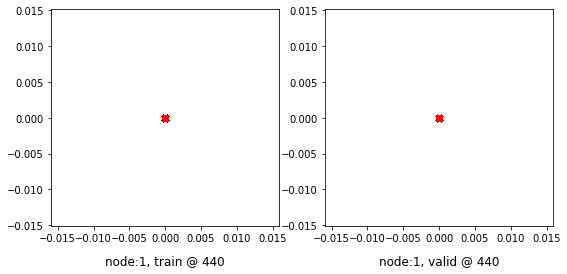

Aggregating on epoch: 441...
Aggregating on epoch: 444...
Aggregating on epoch: 447...
Aggregating on epoch: 450...
Aggregating on epoch: 453...
Aggregating on epoch: 456...
Aggregating on epoch: 459...
460 	 0 	 0.77981067 	 0.74768513 	 0.95696867 	 0.95394629 	 0.87030530 	 0.89940834


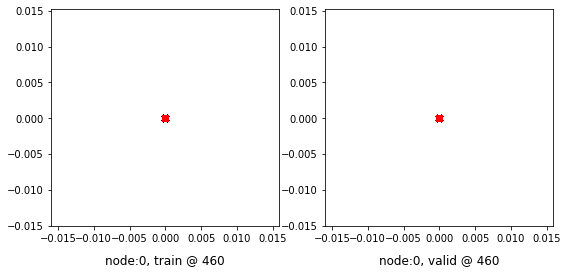

460 	 1 	 0.69306844 	 0.68653774 	 0.95018399 	 0.94522864 	 0.95026261 	 0.95183808


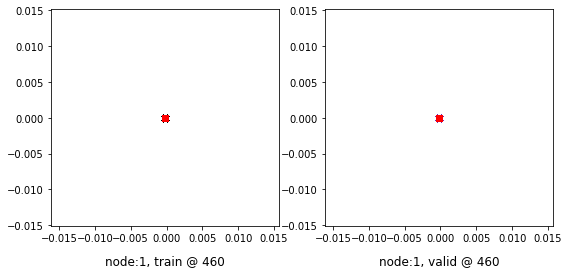

Aggregating on epoch: 462...
Aggregating on epoch: 465...
Aggregating on epoch: 468...
Aggregating on epoch: 471...
Aggregating on epoch: 474...
Aggregating on epoch: 477...
Aggregating on epoch: 480...
480 	 0 	 0.75730836 	 0.74768716 	 0.95512509 	 0.95394456 	 0.89096379 	 0.89940459


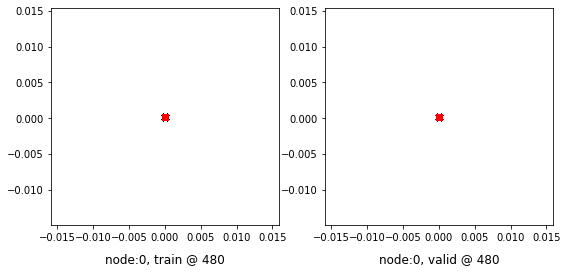

480 	 1 	 0.71450067 	 0.68655622 	 0.96448207 	 0.94523275 	 0.94312876 	 0.95182371


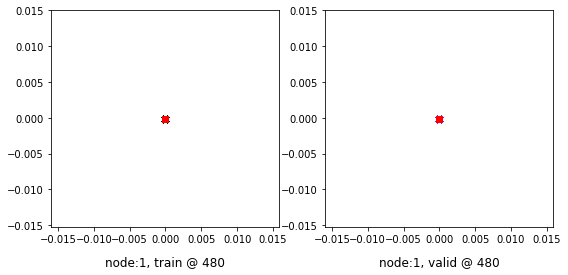

Aggregating on epoch: 483...
Aggregating on epoch: 486...
Aggregating on epoch: 489...
Aggregating on epoch: 492...
Aggregating on epoch: 495...
Aggregating on epoch: 498...
500 	 0 	 0.76879436 	 0.74768662 	 0.95294875 	 0.95394403 	 0.87730175 	 0.89940459


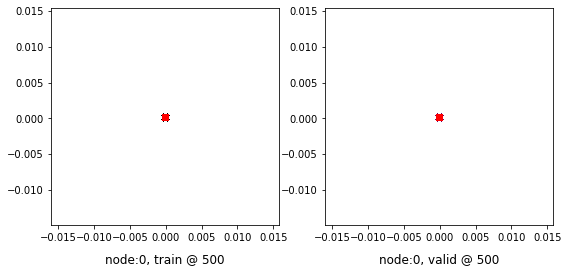

500 	 1 	 0.71903801 	 0.68655711 	 0.96844965 	 0.94523555 	 0.94255888 	 0.95182562


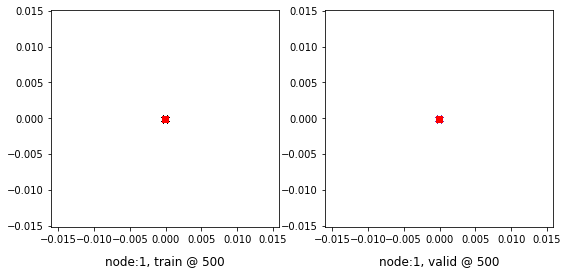

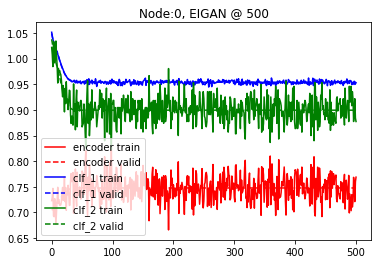

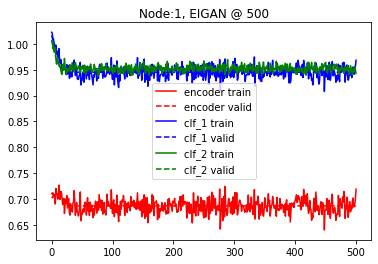

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.6 and delta=5
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.68394244 	 0.70339596 	 1.03650236 	 1.03516531 	 1.04590642 	 1.02491653


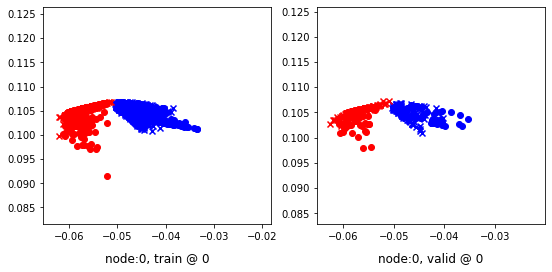

0 	 1 	 0.68285191 	 0.69721878 	 1.00689125 	 1.01852131 	 1.01749277 	 1.01444972


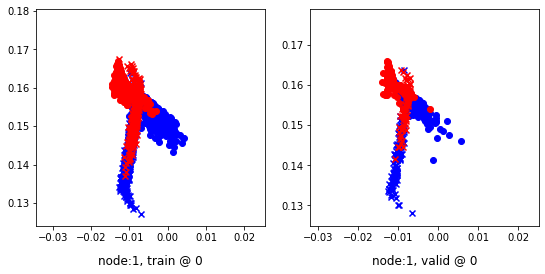

Aggregating on epoch: 5...
Aggregating on epoch: 10...
Aggregating on epoch: 15...
Aggregating on epoch: 20...
20 	 0 	 0.70360845 	 0.71119964 	 0.94936401 	 0.95456940 	 0.93894655 	 0.93651694


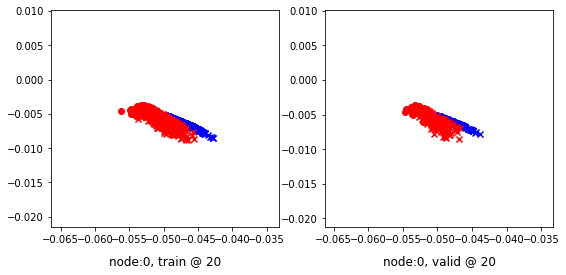

20 	 1 	 0.66829580 	 0.68873066 	 0.93637753 	 0.94745761 	 0.96124804 	 0.95187414


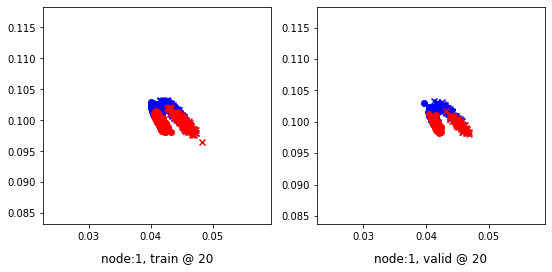

Aggregating on epoch: 25...
Aggregating on epoch: 30...
Aggregating on epoch: 35...
Aggregating on epoch: 40...
40 	 0 	 0.73391616 	 0.74657667 	 0.95930350 	 0.95393258 	 0.91853666 	 0.90050310


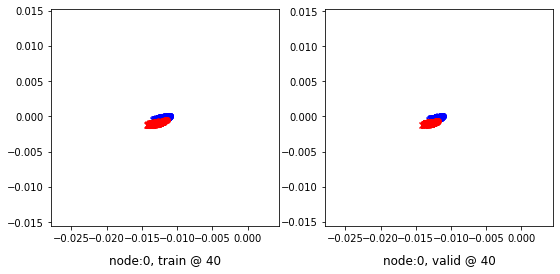

40 	 1 	 0.67122674 	 0.68651748 	 0.92956364 	 0.94520265 	 0.95148641 	 0.95183235


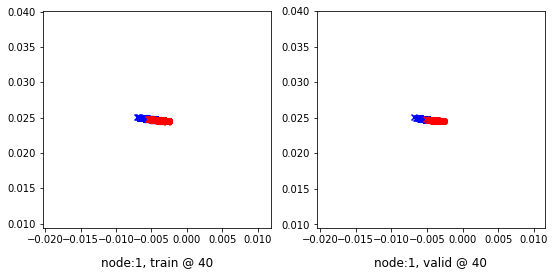

Aggregating on epoch: 45...
Aggregating on epoch: 50...
Aggregating on epoch: 55...
Aggregating on epoch: 60...
60 	 0 	 0.74119818 	 0.74764407 	 0.95617270 	 0.95391077 	 0.90813118 	 0.89941388


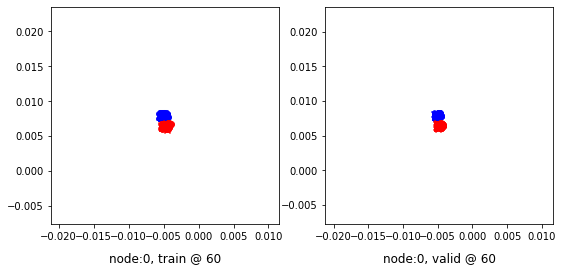

60 	 1 	 0.68345386 	 0.68647712 	 0.94241416 	 0.94514900 	 0.95211434 	 0.95181906


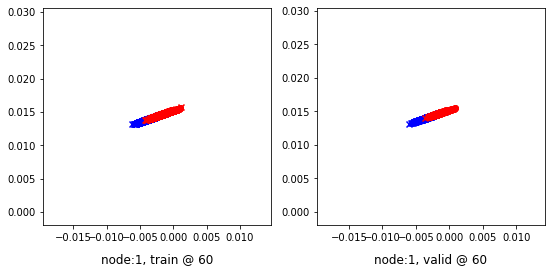

Aggregating on epoch: 65...
Aggregating on epoch: 70...
Aggregating on epoch: 75...
Aggregating on epoch: 80...
80 	 0 	 0.77318794 	 0.74768209 	 0.95033401 	 0.95394212 	 0.87033468 	 0.89940721


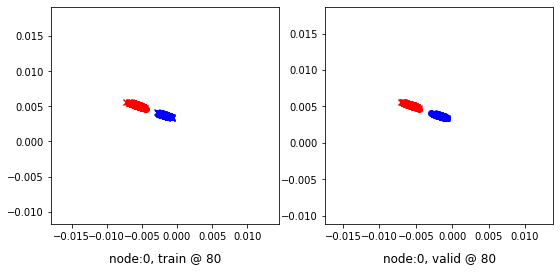

80 	 1 	 0.68230718 	 0.68584615 	 0.93799669 	 0.94452769 	 0.94888645 	 0.95182872


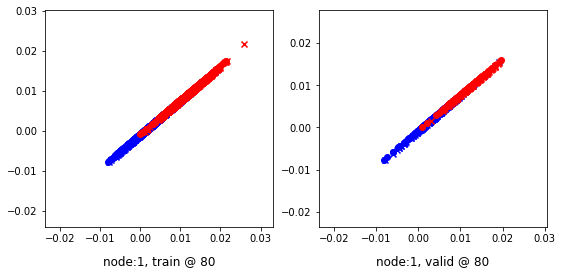

Aggregating on epoch: 85...
Aggregating on epoch: 90...
Aggregating on epoch: 95...
Aggregating on epoch: 100...
100 	 0 	 0.75216514 	 0.74727684 	 0.95325589 	 0.95354110 	 0.89435619 	 0.89941144


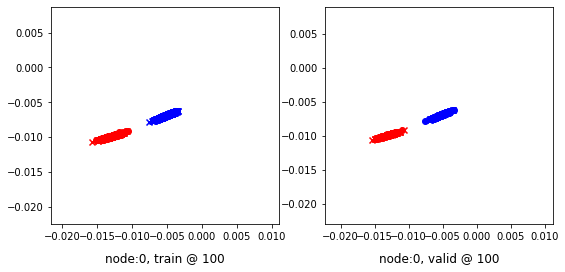

100 	 1 	 0.67621422 	 0.68107581 	 0.94340926 	 0.93968064 	 0.96094817 	 0.95175201


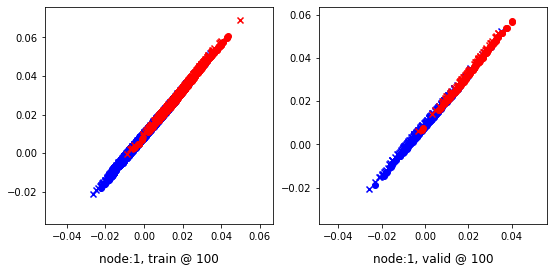

Aggregating on epoch: 105...
Aggregating on epoch: 110...
Aggregating on epoch: 115...
Aggregating on epoch: 120...
120 	 0 	 0.75208724 	 0.74308801 	 0.94516873 	 0.94942510 	 0.88755029 	 0.89948428


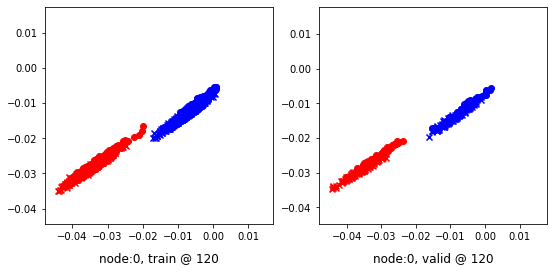

120 	 1 	 0.55184197 	 0.55279875 	 0.81105995 	 0.81137431 	 0.95861828 	 0.95172274


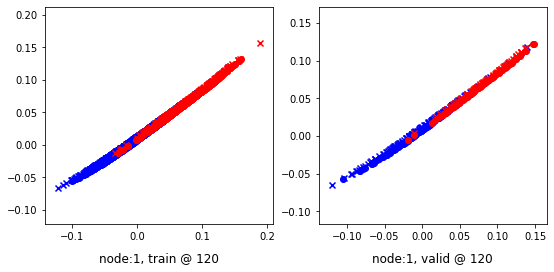

Aggregating on epoch: 125...
Aggregating on epoch: 130...
Aggregating on epoch: 135...
Aggregating on epoch: 140...
140 	 0 	 0.74517286 	 0.69491708 	 0.90150142 	 0.90117669 	 0.86009735 	 0.89940679


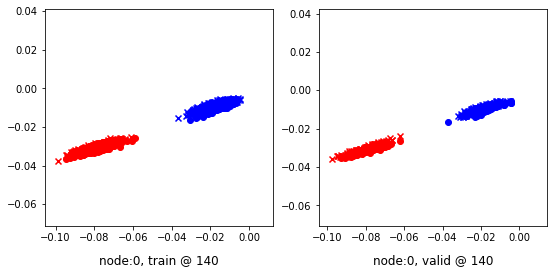

140 	 1 	 0.59491301 	 0.56190580 	 0.83201551 	 0.81972927 	 0.95599294 	 0.95097065


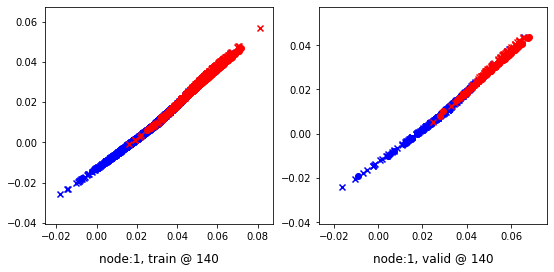

Aggregating on epoch: 145...
Aggregating on epoch: 150...
Aggregating on epoch: 155...
Aggregating on epoch: 160...
160 	 0 	 0.66410124 	 0.60519958 	 0.80941373 	 0.81145537 	 0.87375933 	 0.89940298


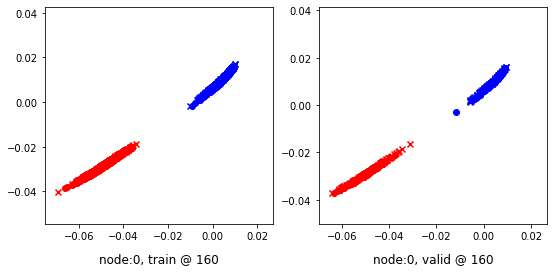

160 	 1 	 0.72052544 	 0.66439021 	 0.95689404 	 0.92358428 	 0.95306748 	 0.95234126


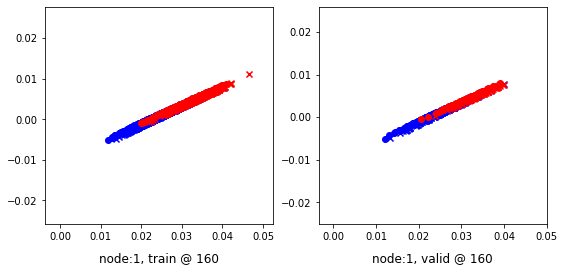

Aggregating on epoch: 165...
Aggregating on epoch: 170...
Aggregating on epoch: 175...
Aggregating on epoch: 180...
180 	 0 	 0.59725511 	 0.55376798 	 0.75589275 	 0.76002955 	 0.88402146 	 0.89940876


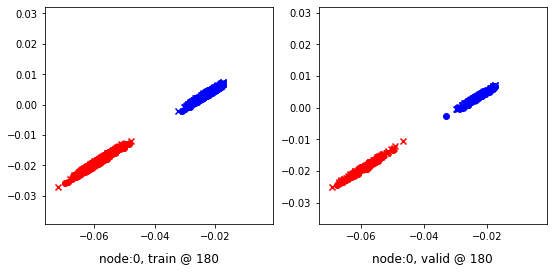

180 	 1 	 0.68022507 	 0.66937494 	 0.93274182 	 0.92800468 	 0.95019084 	 0.95177692


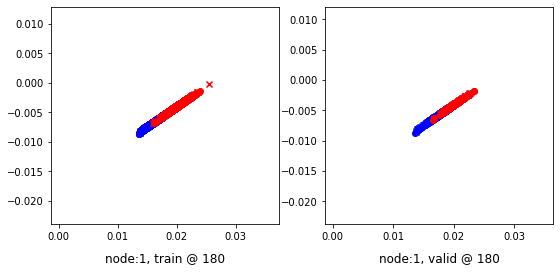

Aggregating on epoch: 185...
Aggregating on epoch: 190...
Aggregating on epoch: 195...
Aggregating on epoch: 200...
200 	 0 	 0.67712533 	 0.65253985 	 0.86251056 	 0.85881341 	 0.93240535 	 0.89942074


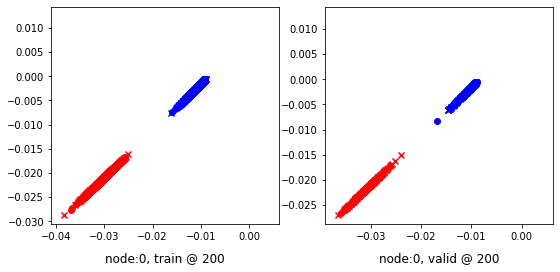

200 	 1 	 0.77072984 	 0.75012505 	 1.01265383 	 1.00883329 	 0.95153898 	 0.95185542


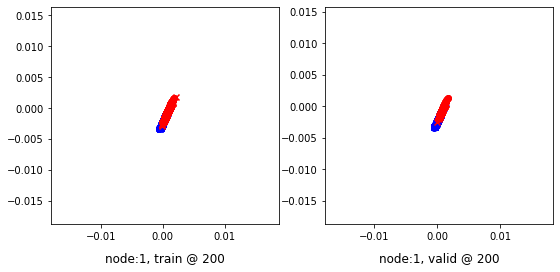

Aggregating on epoch: 205...
Aggregating on epoch: 210...
Aggregating on epoch: 215...
Aggregating on epoch: 220...
220 	 0 	 0.66100317 	 0.63590312 	 0.84012061 	 0.84216225 	 0.90467173 	 0.89940631


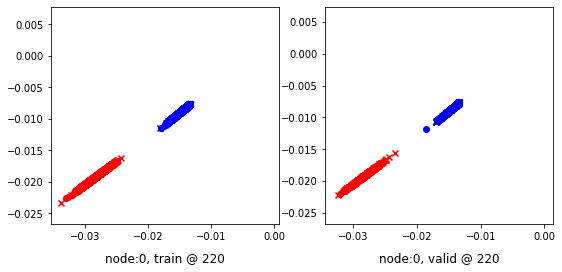

220 	 1 	 0.67749250 	 0.68086618 	 0.93994695 	 0.93951732 	 0.95652270 	 0.95179832


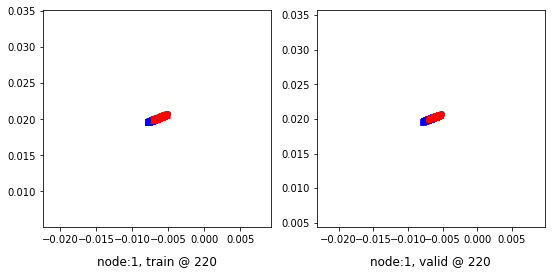

Aggregating on epoch: 225...
Aggregating on epoch: 230...
Aggregating on epoch: 235...
Aggregating on epoch: 240...
240 	 0 	 0.72451931 	 0.68009877 	 0.87630767 	 0.88635457 	 0.86018425 	 0.89940298


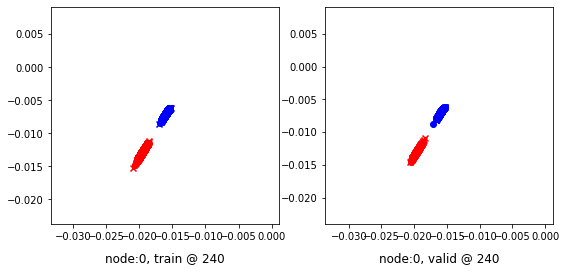

240 	 1 	 0.66063070 	 0.65995735 	 0.90471011 	 0.91840625 	 0.94301254 	 0.95159608


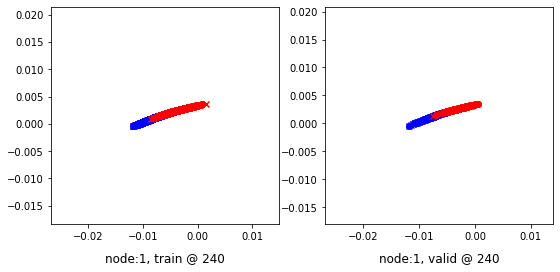

Aggregating on epoch: 245...
Aggregating on epoch: 250...
Aggregating on epoch: 255...
Aggregating on epoch: 260...
260 	 0 	 0.82041687 	 0.74023938 	 0.94794303 	 0.94649625 	 0.90464383 	 0.89940405


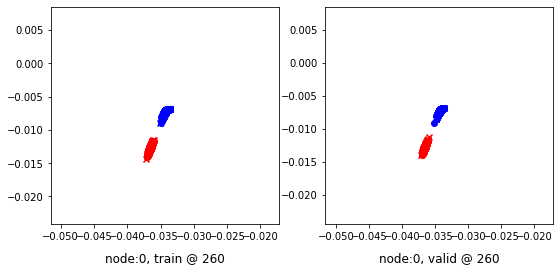

260 	 1 	 0.45773977 	 0.44723600 	 0.71157187 	 0.70397741 	 0.95816571 	 0.94988859


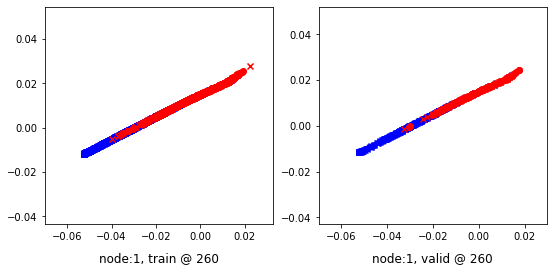

Aggregating on epoch: 265...
Aggregating on epoch: 270...
Aggregating on epoch: 275...
Aggregating on epoch: 280...
280 	 0 	 0.88833529 	 0.76310283 	 0.99334383 	 0.96935952 	 0.90465224 	 0.89940387


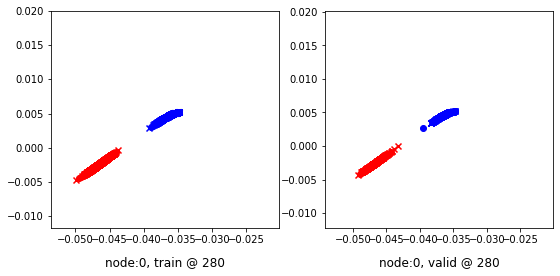

280 	 1 	 0.72245067 	 0.68952739 	 0.94072402 	 0.94825679 	 0.94776064 	 0.95187658


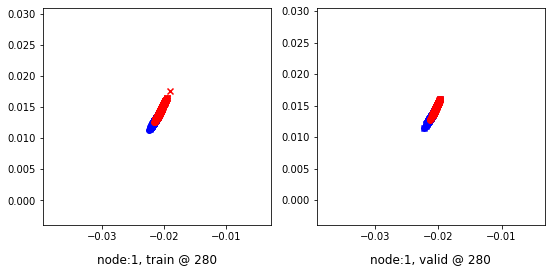

Aggregating on epoch: 285...
Aggregating on epoch: 290...
Aggregating on epoch: 295...
Aggregating on epoch: 300...
300 	 0 	 0.83503711 	 0.81436175 	 1.01868439 	 1.02062738 	 0.89779609 	 0.89941281


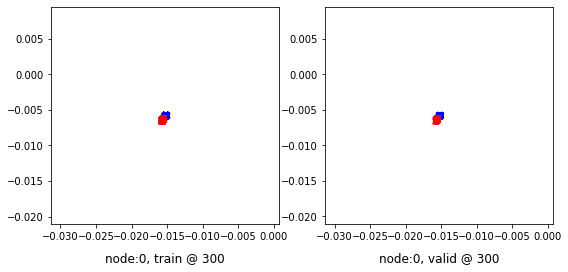

300 	 1 	 0.72684455 	 0.70395827 	 0.97335786 	 0.96268082 	 0.94855946 	 0.95186973


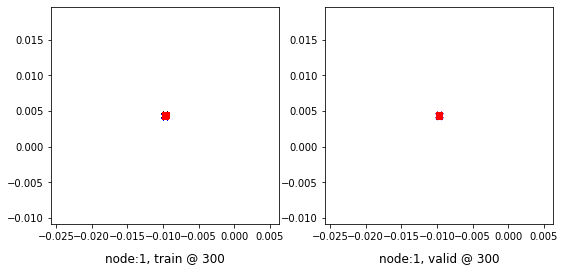

Aggregating on epoch: 305...
Aggregating on epoch: 310...
Aggregating on epoch: 315...
Aggregating on epoch: 320...
320 	 0 	 0.75453162 	 0.74114859 	 0.94716001 	 0.94740683 	 0.88752407 	 0.89940542


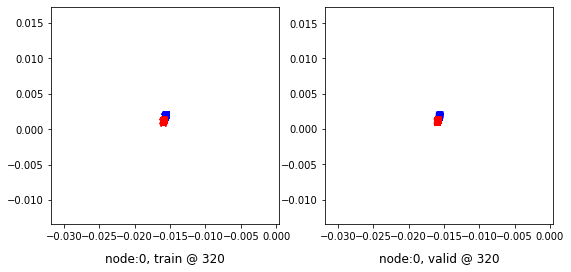

320 	 1 	 0.68995047 	 0.68655717 	 0.94651812 	 0.94523680 	 0.95011204 	 0.95182681


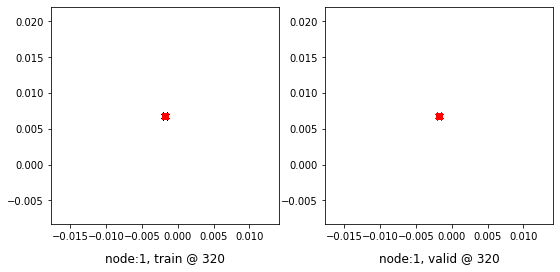

Aggregating on epoch: 325...
Aggregating on epoch: 330...
Aggregating on epoch: 335...
Aggregating on epoch: 340...
340 	 0 	 0.70128667 	 0.74706173 	 0.95418602 	 0.95333004 	 0.94611073 	 0.89941549


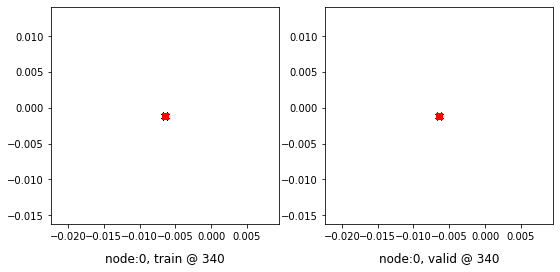

340 	 1 	 0.69942468 	 0.68661582 	 0.94652927 	 0.94533408 	 0.94027209 	 0.95186543


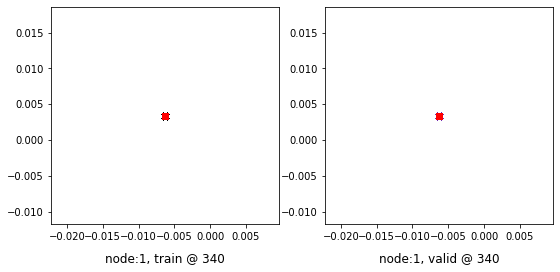

Aggregating on epoch: 345...
Aggregating on epoch: 350...
Aggregating on epoch: 355...
Aggregating on epoch: 360...
360 	 0 	 0.77948350 	 0.74768347 	 0.95988941 	 0.95394206 	 0.87380916 	 0.89940578


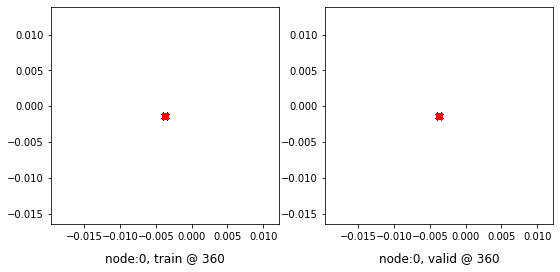

360 	 1 	 0.68294996 	 0.68721223 	 0.93123400 	 0.94588649 	 0.94180721 	 0.95182145


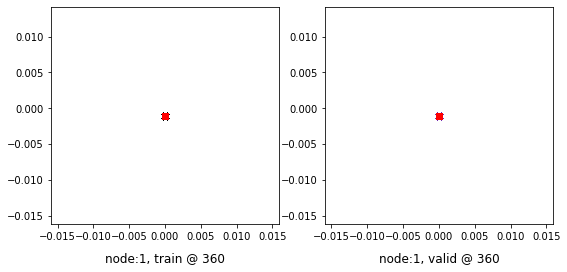

Aggregating on epoch: 365...
Aggregating on epoch: 370...
Aggregating on epoch: 375...
Aggregating on epoch: 380...
380 	 0 	 0.77188081 	 0.74767959 	 0.95946574 	 0.95394075 	 0.88061082 	 0.89940834


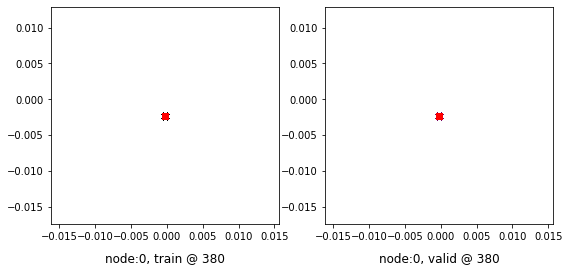

380 	 1 	 0.69588989 	 0.68657970 	 0.95300031 	 0.94526350 	 0.95024163 	 0.95183098


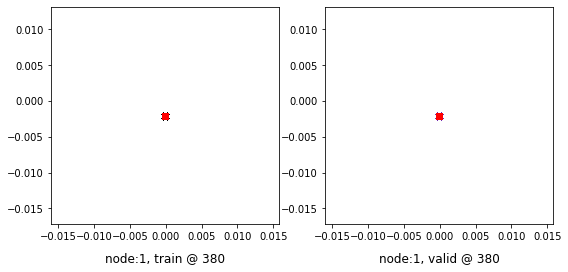

Aggregating on epoch: 385...
Aggregating on epoch: 390...
Aggregating on epoch: 395...
Aggregating on epoch: 400...
400 	 0 	 0.72995961 	 0.74769443 	 0.95519179 	 0.95395440 	 0.91839188 	 0.89940715


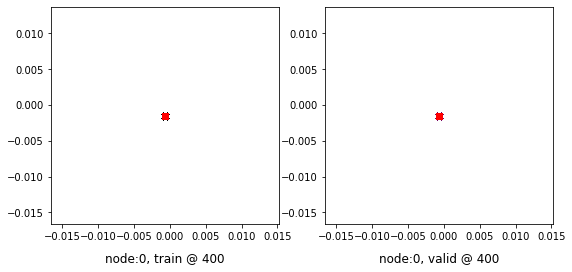

400 	 1 	 0.69344252 	 0.68656427 	 0.95427650 	 0.94523853 	 0.95408255 	 0.95182145


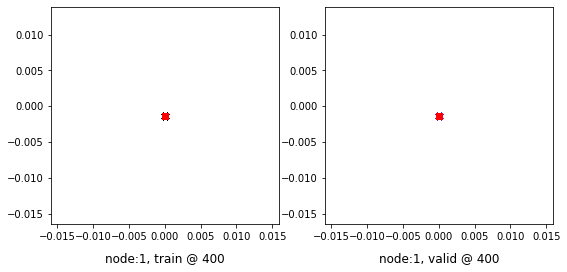

Aggregating on epoch: 405...
Aggregating on epoch: 410...
Aggregating on epoch: 415...
Aggregating on epoch: 420...
420 	 0 	 0.75246781 	 0.74769109 	 0.95706475 	 0.95394939 	 0.89779764 	 0.89940548


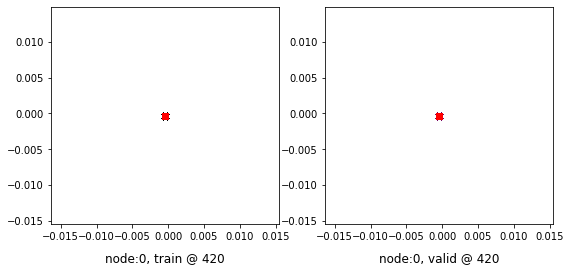

420 	 1 	 0.68797767 	 0.68661541 	 0.95854044 	 0.94529277 	 0.96375507 	 0.95182455


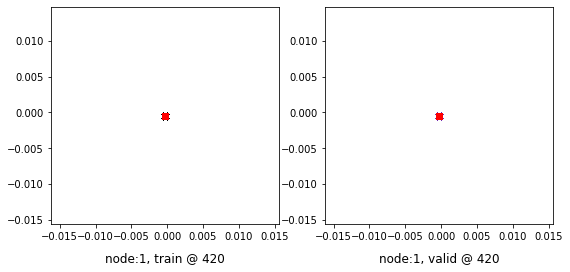

Aggregating on epoch: 425...
Aggregating on epoch: 430...
Aggregating on epoch: 435...
Aggregating on epoch: 440...
440 	 0 	 0.73766458 	 0.74768466 	 0.95604789 	 0.95394325 	 0.91151559 	 0.89940578


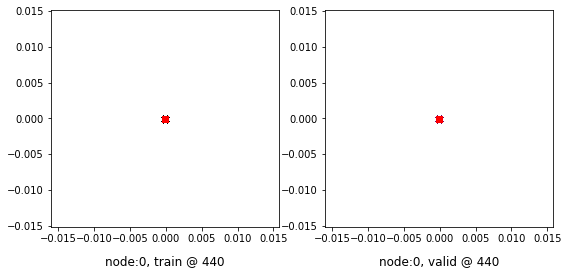

440 	 1 	 0.71065944 	 0.68657023 	 0.96634340 	 0.94525713 	 0.94899613 	 0.95183408


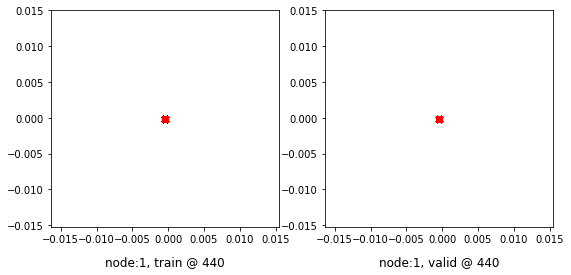

Aggregating on epoch: 445...
Aggregating on epoch: 450...
Aggregating on epoch: 455...
Aggregating on epoch: 460...
460 	 0 	 0.73608112 	 0.74768054 	 0.95103526 	 0.95394450 	 0.90812868 	 0.89941114


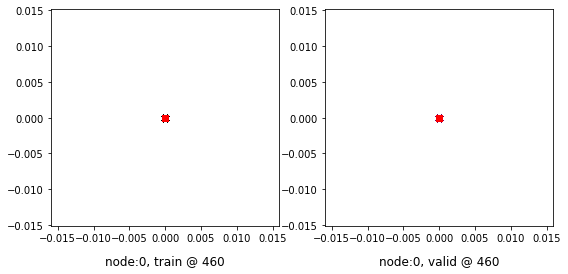

460 	 1 	 0.69730455 	 0.68653286 	 0.95035201 	 0.94525683 	 0.94619721 	 0.95187116


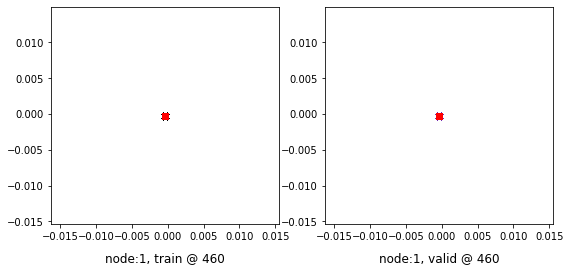

Aggregating on epoch: 465...
Aggregating on epoch: 470...
Aggregating on epoch: 475...
Aggregating on epoch: 480...
480 	 0 	 0.74003446 	 0.74775964 	 0.95495319 	 0.95401758 	 0.90807289 	 0.89940512


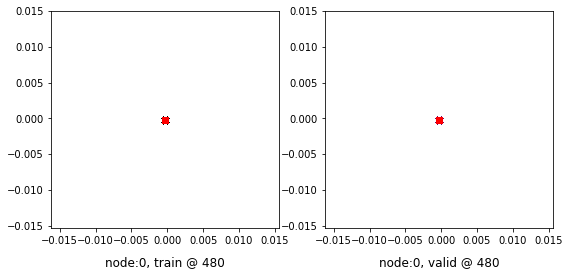

480 	 1 	 0.69780958 	 0.68655217 	 0.95538443 	 0.94522804 	 0.95079780 	 0.95182306


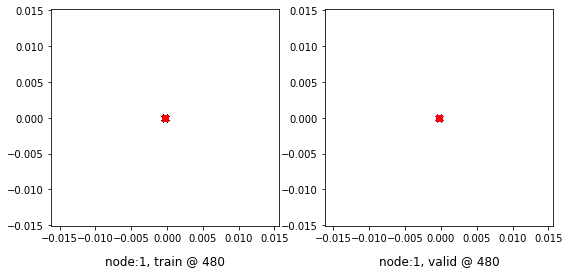

Aggregating on epoch: 485...
Aggregating on epoch: 490...
Aggregating on epoch: 495...
Aggregating on epoch: 500...
500 	 0 	 0.75105596 	 0.74767965 	 0.95228374 	 0.95394099 	 0.89435935 	 0.89940852


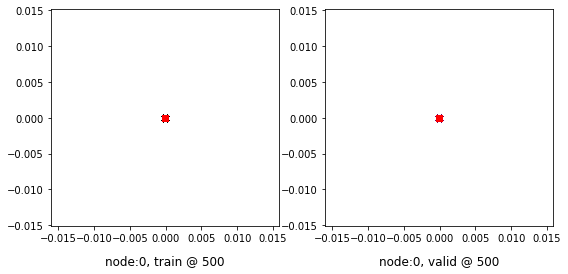

500 	 1 	 0.68483353 	 0.68654746 	 0.94757217 	 0.94523114 	 0.95588523 	 0.95183086


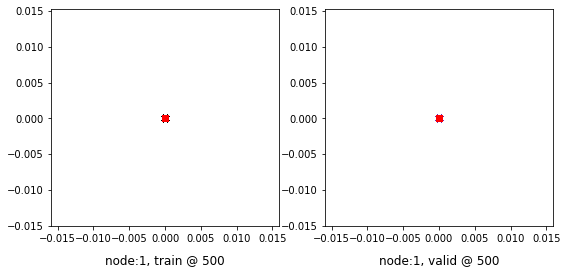

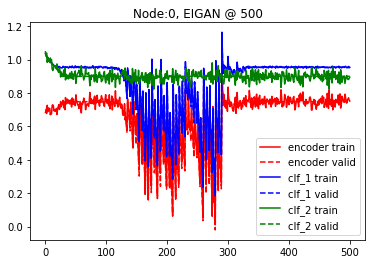

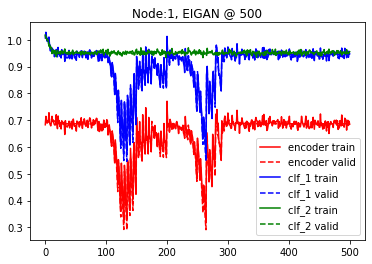

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.6 and delta=7
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.68953311 	 0.66786754 	 1.07077730 	 1.05633128 	 1.07462192 	 1.08161092


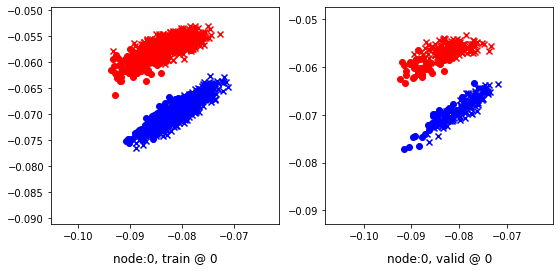

0 	 1 	 0.75225782 	 0.72825897 	 1.09640002 	 1.07796812 	 1.03740299 	 1.04285634


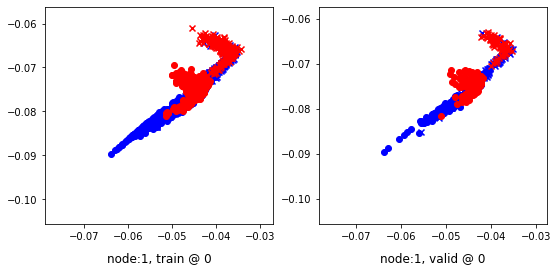

Aggregating on epoch: 7...
Aggregating on epoch: 14...
20 	 0 	 0.71370327 	 0.70947355 	 0.97437221 	 0.97644824 	 0.95392805 	 0.96012187


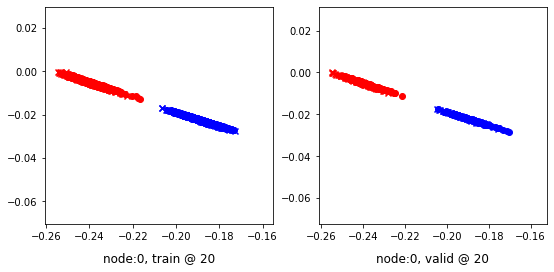

20 	 1 	 0.74106961 	 0.71978188 	 1.00294936 	 0.98369908 	 0.95515484 	 0.95706439


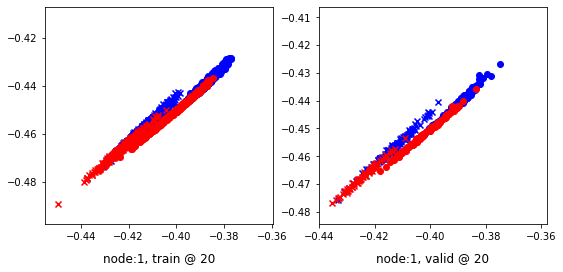

Aggregating on epoch: 21...
Aggregating on epoch: 28...
Aggregating on epoch: 35...
40 	 0 	 0.70972735 	 0.74002969 	 0.94668967 	 0.95078027 	 0.93033844 	 0.90389776


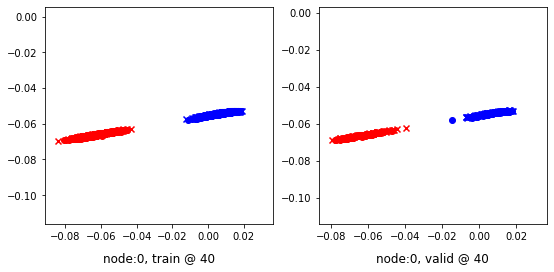

40 	 1 	 0.67064369 	 0.68699956 	 0.93248910 	 0.94546050 	 0.95499426 	 0.95160812


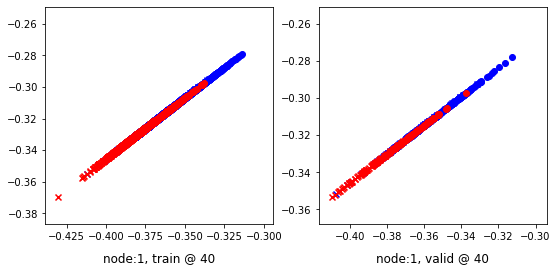

Aggregating on epoch: 42...
Aggregating on epoch: 49...
Aggregating on epoch: 56...
60 	 0 	 0.77719873 	 0.72241932 	 0.92201412 	 0.92888916 	 0.83996779 	 0.89961702


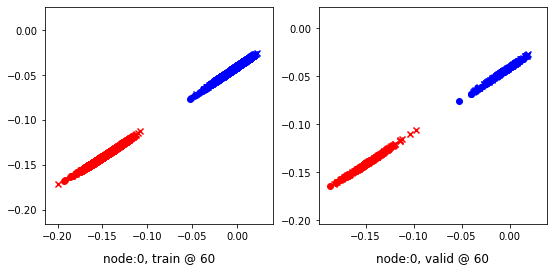

60 	 1 	 0.69684815 	 0.68645567 	 0.95271677 	 0.94527042 	 0.94902968 	 0.95196193


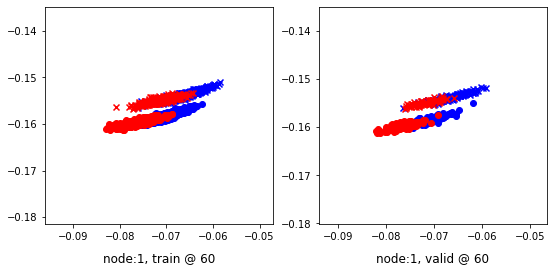

Aggregating on epoch: 63...
Aggregating on epoch: 70...
Aggregating on epoch: 77...
80 	 0 	 0.57326651 	 0.56548595 	 0.77848655 	 0.77184033 	 0.90819979 	 0.89950156


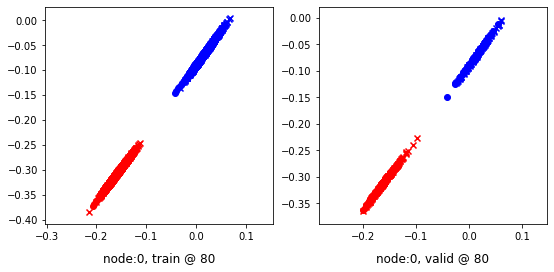

80 	 1 	 0.70902175 	 0.68645245 	 0.96549016 	 0.94517493 	 0.94962114 	 0.95186967


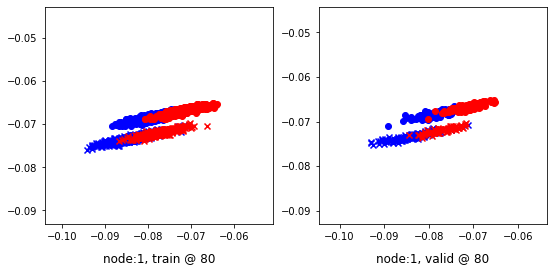

Aggregating on epoch: 84...
Aggregating on epoch: 91...
Aggregating on epoch: 98...
100 	 0 	 0.32390034 	 0.32990342 	 0.53376615 	 0.53607160 	 0.91777313 	 0.89931536


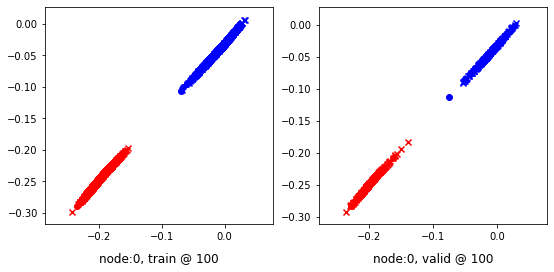

100 	 1 	 0.68010551 	 0.68644410 	 0.94236612 	 0.94513279 	 0.95541906 	 0.95183587


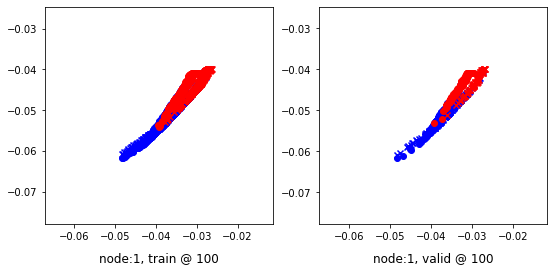

Aggregating on epoch: 105...
Aggregating on epoch: 112...
Aggregating on epoch: 119...
120 	 0 	 0.33218557 	 0.31895250 	 0.52482933 	 0.52508068 	 0.92149663 	 0.89927536


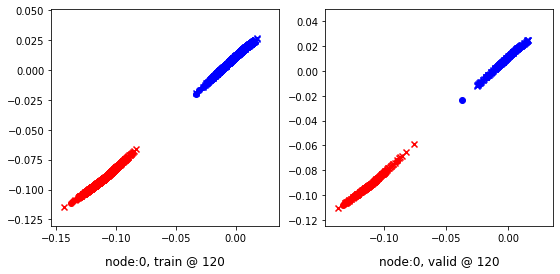

120 	 1 	 0.68273848 	 0.68596500 	 0.93425089 	 0.94486541 	 0.94474530 	 0.95204759


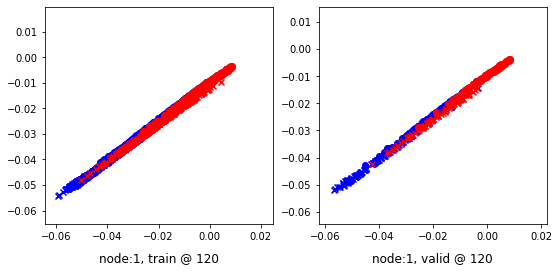

Aggregating on epoch: 126...
Aggregating on epoch: 133...
Aggregating on epoch: 140...
140 	 0 	 0.45001316 	 0.41215187 	 0.62235838 	 0.61823589 	 0.90820801 	 0.89923120


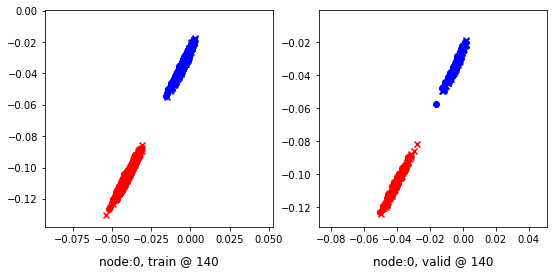

140 	 1 	 0.69714314 	 0.68639076 	 0.95400983 	 0.94478732 	 0.95008081 	 0.95154375


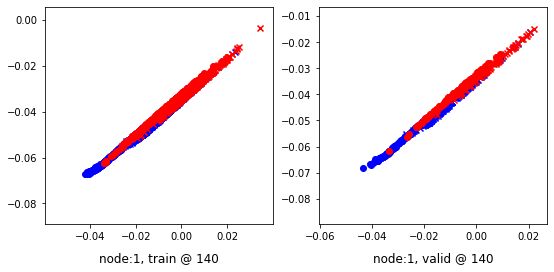

Aggregating on epoch: 147...
Aggregating on epoch: 154...
160 	 0 	 0.15319723 	 0.16631004 	 0.36187392 	 0.37241730 	 0.91536576 	 0.89925444


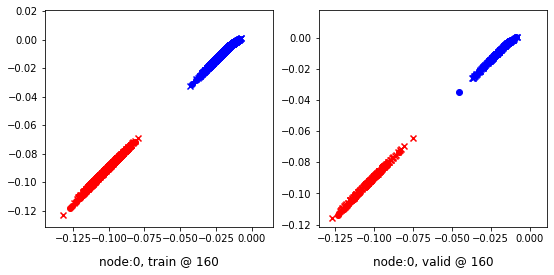

160 	 1 	 0.67965966 	 0.68558288 	 0.92684031 	 0.94402528 	 0.94038540 	 0.95158958


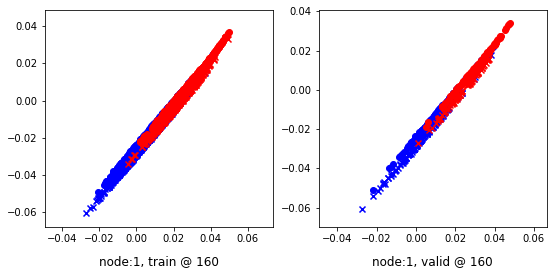

Aggregating on epoch: 161...
Aggregating on epoch: 168...
Aggregating on epoch: 175...
180 	 0 	 0.21166512 	 0.23032266 	 0.42866090 	 0.43647057 	 0.93559188 	 0.89929509


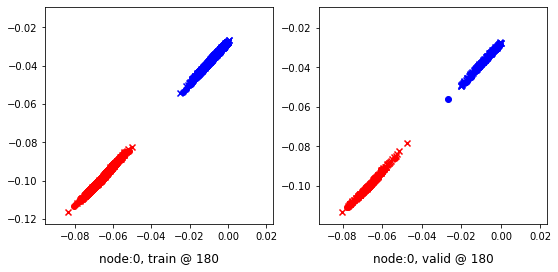

180 	 1 	 0.68030119 	 0.68427700 	 0.94694728 	 0.94315767 	 0.95990491 	 0.95202786


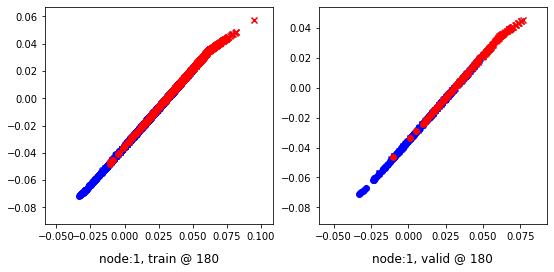

Aggregating on epoch: 182...
Aggregating on epoch: 189...
Aggregating on epoch: 196...
200 	 0 	 0.16681483 	 0.14008778 	 0.34797201 	 0.34537661 	 0.91117316 	 0.89843601


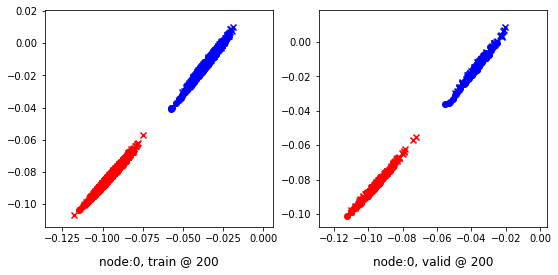

200 	 1 	 0.62368149 	 0.64870822 	 0.88480651 	 0.91127008 	 0.95643741 	 0.95570904


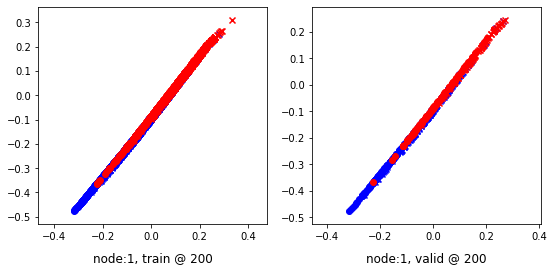

Aggregating on epoch: 203...
Aggregating on epoch: 210...
Aggregating on epoch: 217...
220 	 0 	 0.48487544 	 0.32453221 	 0.56213069 	 0.53099829 	 0.89097428 	 0.89961326


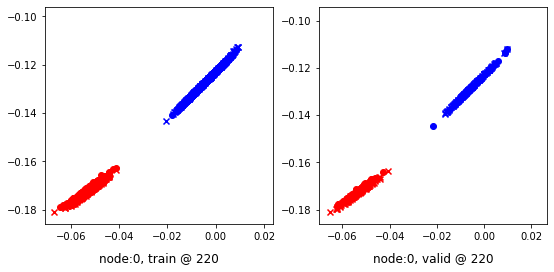

220 	 1 	 0.30274612 	 0.25650305 	 0.56493014 	 0.51450205 	 0.95386362 	 0.95114619


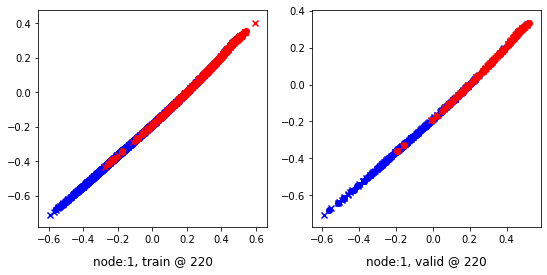

Aggregating on epoch: 224...
Aggregating on epoch: 231...
Aggregating on epoch: 238...
240 	 0 	 0.62249249 	 0.63765979 	 0.84776539 	 0.84415412 	 0.90145856 	 0.89964151


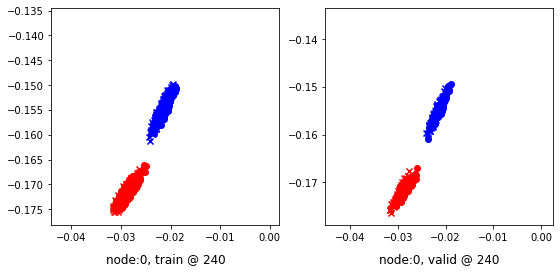

240 	 1 	 0.40782183 	 0.33703727 	 0.65402621 	 0.59553689 	 0.95324218 	 0.95164680


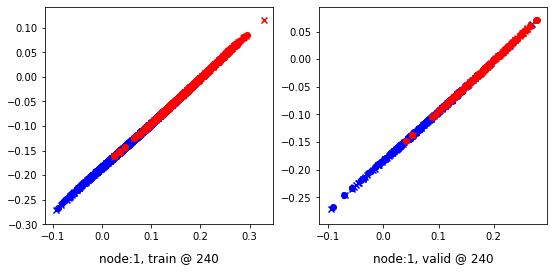

Aggregating on epoch: 245...
Aggregating on epoch: 252...
Aggregating on epoch: 259...
260 	 0 	 1.12035298 	 1.00813591 	 1.24379754 	 1.21454227 	 0.89096123 	 0.89955354


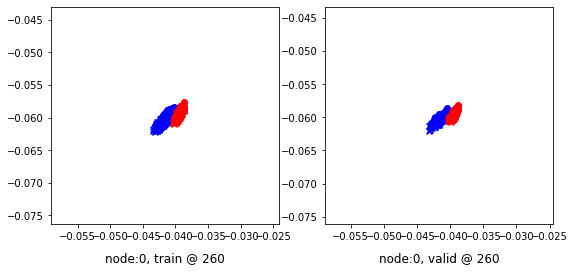

260 	 1 	 0.57276565 	 0.58354771 	 0.82816172 	 0.84257978 	 0.94893593 	 0.95217925


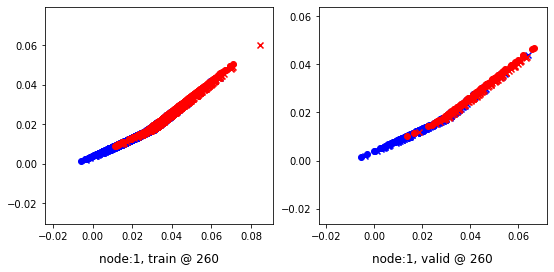

Aggregating on epoch: 266...
Aggregating on epoch: 273...
Aggregating on epoch: 280...
280 	 0 	 1.18780100 	 1.14733732 	 1.38380384 	 1.35374475 	 0.91550517 	 0.89955461


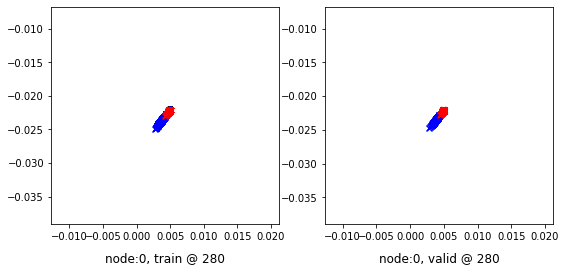

280 	 1 	 0.64159977 	 0.64002812 	 0.88794869 	 0.89797997 	 0.94423008 	 0.95109904


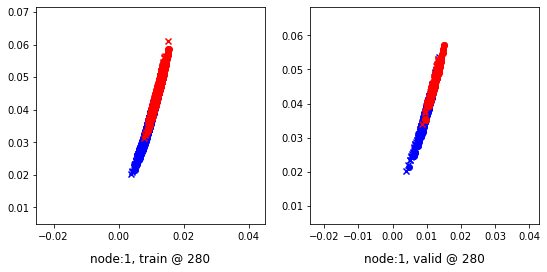

Aggregating on epoch: 287...
Aggregating on epoch: 294...
300 	 0 	 0.76503330 	 0.75420481 	 0.96345866 	 0.96047056 	 0.89102393 	 0.89941293


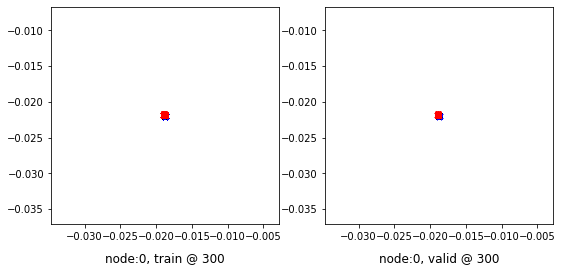

300 	 1 	 0.55516708 	 0.55716628 	 0.80599362 	 0.81521159 	 0.94816071 	 0.95119250


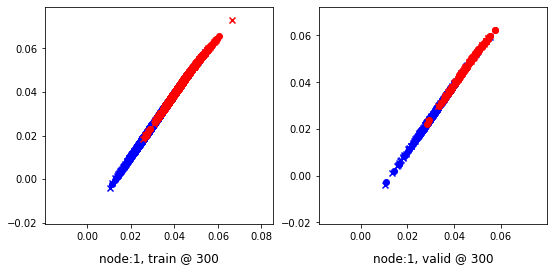

Aggregating on epoch: 301...
Aggregating on epoch: 308...
Aggregating on epoch: 315...
320 	 0 	 0.76255798 	 0.74428296 	 0.94970447 	 0.95054144 	 0.88062572 	 0.89940566


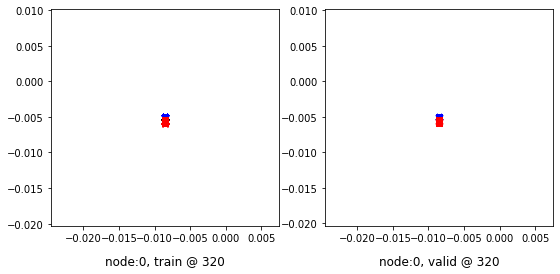

320 	 1 	 0.49046522 	 0.48110360 	 0.73288947 	 0.73865002 	 0.94241643 	 0.95069361


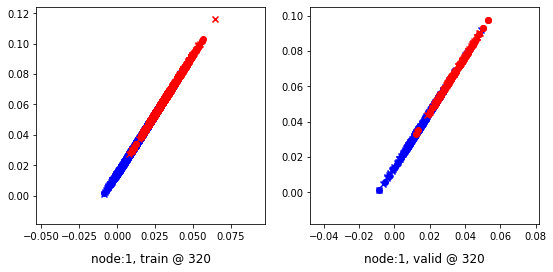

Aggregating on epoch: 322...
Aggregating on epoch: 329...
Aggregating on epoch: 336...
340 	 0 	 0.77986324 	 0.75911838 	 0.96994072 	 0.96538574 	 0.88751984 	 0.89941454


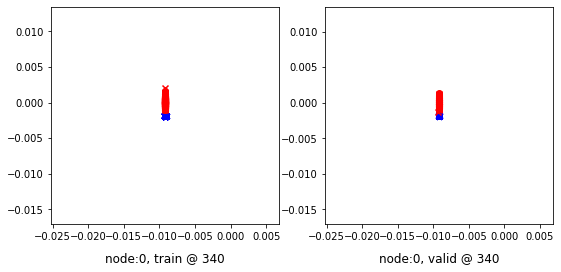

340 	 1 	 0.55070347 	 0.56376761 	 0.81111664 	 0.82225931 	 0.95761847 	 0.95163888


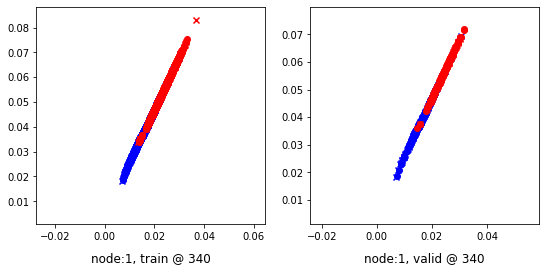

Aggregating on epoch: 343...
Aggregating on epoch: 350...
Aggregating on epoch: 357...
360 	 0 	 0.72380424 	 0.74153030 	 0.94494563 	 0.94779766 	 0.91505951 	 0.89941454


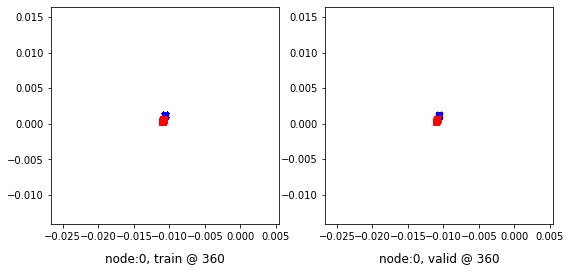

360 	 1 	 0.55771476 	 0.54979545 	 0.80851817 	 0.80982715 	 0.95638514 	 0.95317888


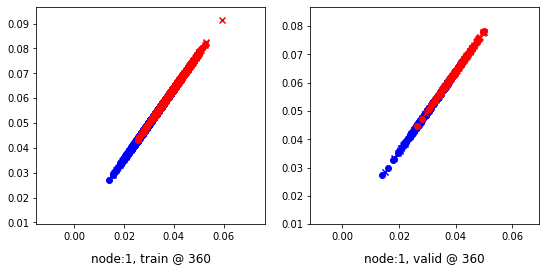

Aggregating on epoch: 364...
Aggregating on epoch: 371...
Aggregating on epoch: 378...
380 	 0 	 0.72944057 	 0.74087894 	 0.94026947 	 0.94713867 	 0.90466297 	 0.89940691


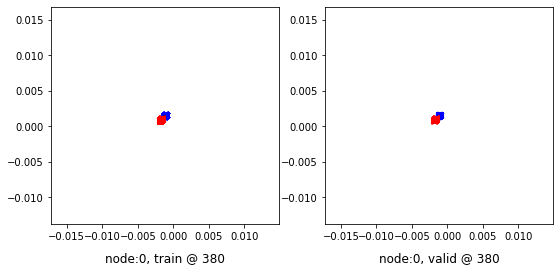

380 	 1 	 0.62006599 	 0.63575763 	 0.89394307 	 0.89514714 	 0.95845759 	 0.95253670


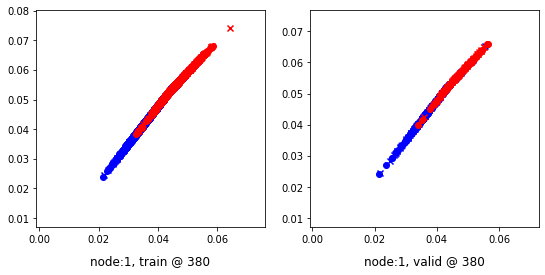

Aggregating on epoch: 385...
Aggregating on epoch: 392...
Aggregating on epoch: 399...
400 	 0 	 0.76425678 	 0.75082254 	 0.95843852 	 0.95708036 	 0.88752598 	 0.89940500


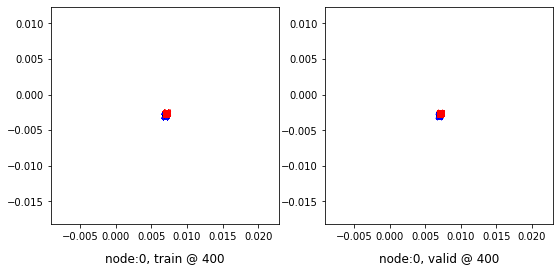

400 	 1 	 0.68003786 	 0.65603751 	 0.92353231 	 0.91476822 	 0.95152187 	 0.95187789


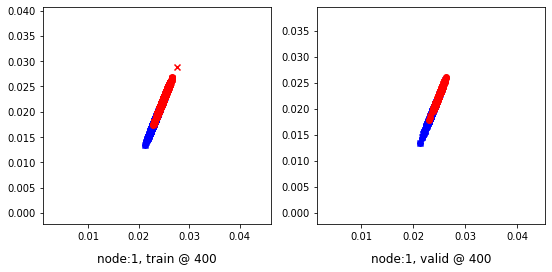

Aggregating on epoch: 406...
Aggregating on epoch: 413...
Aggregating on epoch: 420...
420 	 0 	 0.76503921 	 0.74841249 	 0.95244515 	 0.95467234 	 0.88061821 	 0.89940703


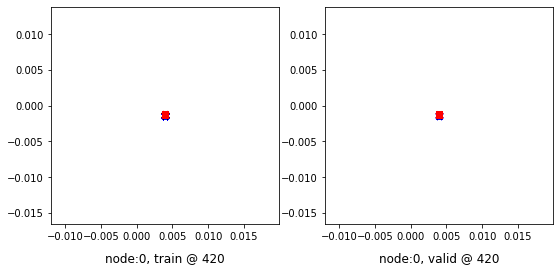

420 	 1 	 0.69829458 	 0.68302846 	 0.95427322 	 0.94167227 	 0.95023620 	 0.95179099


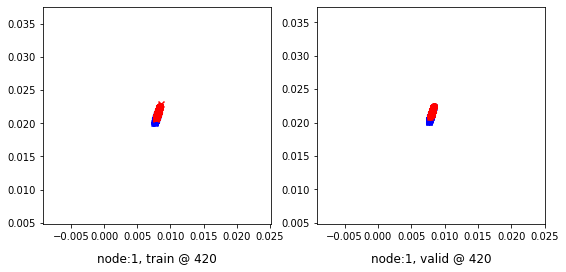

Aggregating on epoch: 427...
Aggregating on epoch: 434...
440 	 0 	 0.71967649 	 0.70383435 	 0.90322483 	 0.91010463 	 0.88055521 	 0.89941746


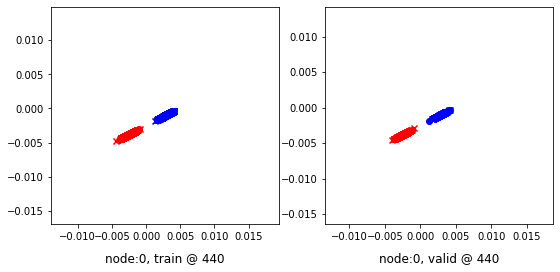

440 	 1 	 0.64587951 	 0.62631011 	 0.89683133 	 0.88453078 	 0.94808567 	 0.95136786


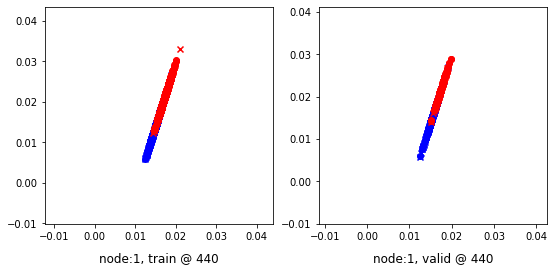

Aggregating on epoch: 441...
Aggregating on epoch: 448...
Aggregating on epoch: 455...
460 	 0 	 0.75170594 	 0.74683732 	 0.94945627 	 0.95309490 	 0.89094853 	 0.89940476


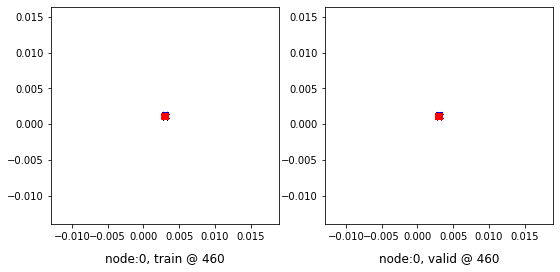

460 	 1 	 0.61465234 	 0.59641570 	 0.86627531 	 0.85419339 	 0.94748807 	 0.95092487


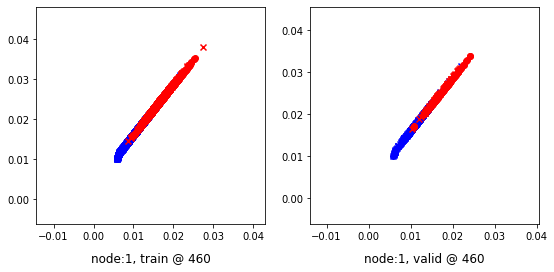

Aggregating on epoch: 462...
Aggregating on epoch: 469...
Aggregating on epoch: 476...
480 	 0 	 0.76227319 	 0.73484713 	 0.94476753 	 0.94110417 	 0.87727028 	 0.89940423


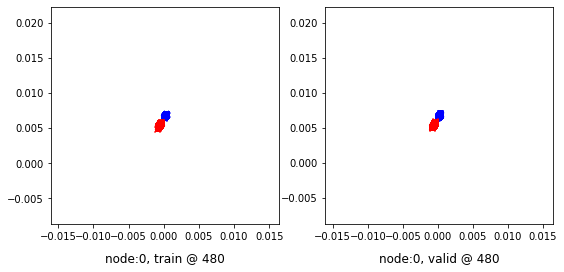

480 	 1 	 0.55657887 	 0.55569720 	 0.80425936 	 0.81338990 	 0.94686168 	 0.95083988


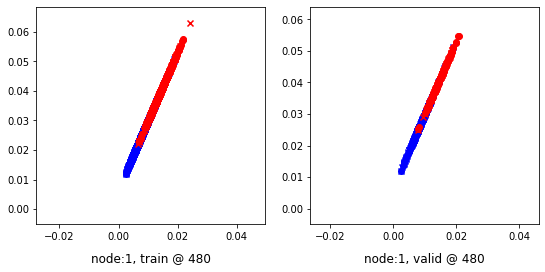

Aggregating on epoch: 483...
Aggregating on epoch: 490...
Aggregating on epoch: 497...
500 	 0 	 0.69870114 	 0.68395686 	 0.88667691 	 0.89020330 	 0.88748825 	 0.89939362


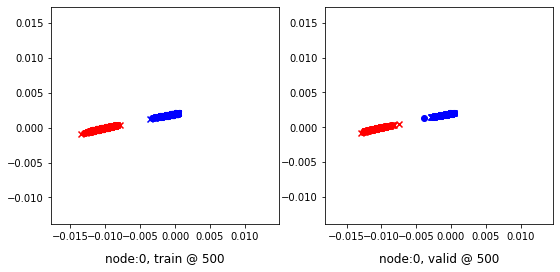

500 	 1 	 0.52228075 	 0.49258888 	 0.76769191 	 0.75111097 	 0.94886971 	 0.95166928


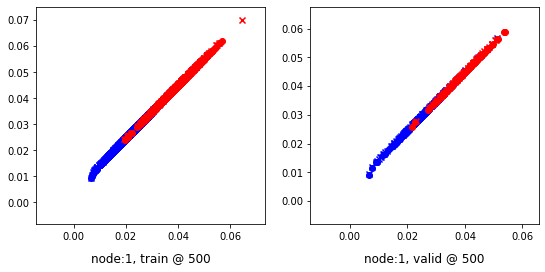

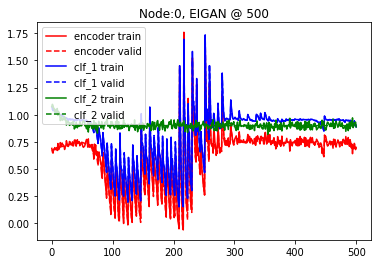

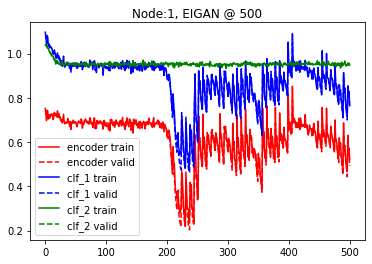

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.6 and delta=9
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.70098257 	 0.68429959 	 1.02698064 	 1.02575719 	 1.01926124 	 1.03460479


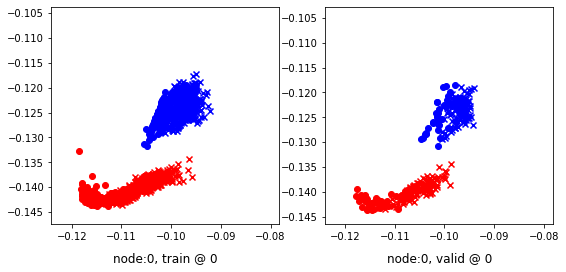

0 	 1 	 0.68572497 	 0.68695736 	 1.01002276 	 1.00966990 	 1.01759315 	 1.01585972


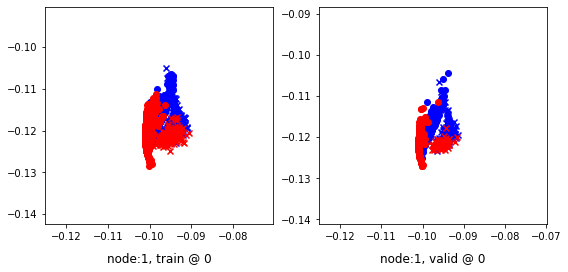

Aggregating on epoch: 9...
Aggregating on epoch: 18...
20 	 0 	 0.72075462 	 0.68747789 	 0.95759052 	 0.95721757 	 0.93046635 	 0.96288687


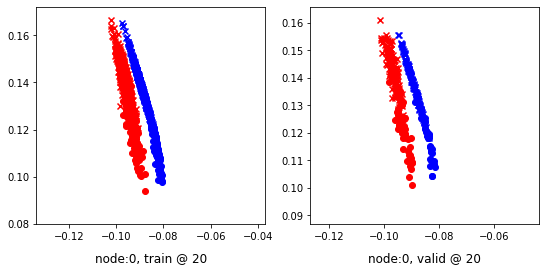

20 	 1 	 0.67832917 	 0.68583393 	 0.93983287 	 0.94492722 	 0.95471251 	 0.95224047


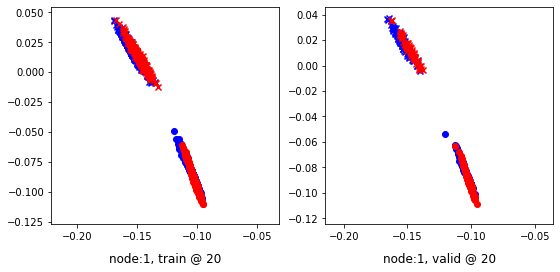

Aggregating on epoch: 27...
Aggregating on epoch: 36...
40 	 0 	 0.72924191 	 0.73593873 	 0.94889599 	 0.95366436 	 0.91296542 	 0.91087282


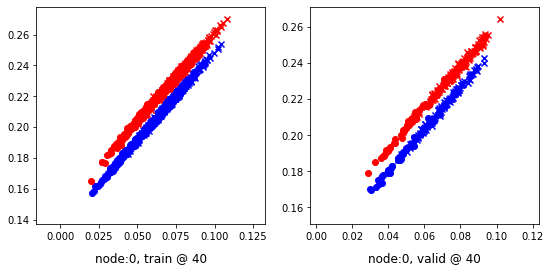

40 	 1 	 0.67212325 	 0.67934167 	 0.92372507 	 0.93935061 	 0.94516587 	 0.95315611


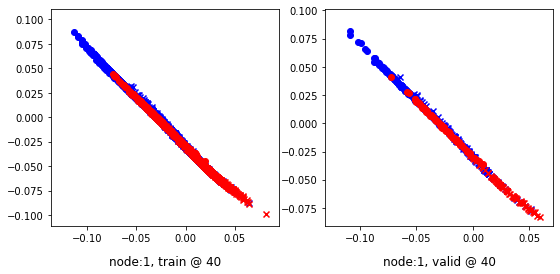

Aggregating on epoch: 45...
Aggregating on epoch: 54...
60 	 0 	 0.74450201 	 0.74207026 	 0.94847888 	 0.94808072 	 0.89754796 	 0.89915764


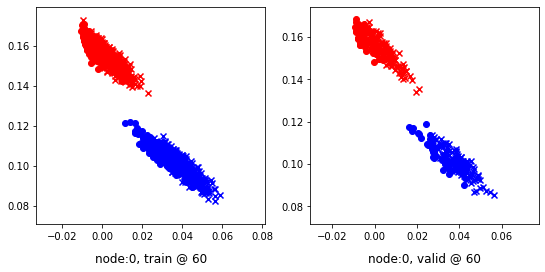

60 	 1 	 0.43162388 	 0.40857625 	 0.68459904 	 0.66690999 	 0.95187503 	 0.95148093


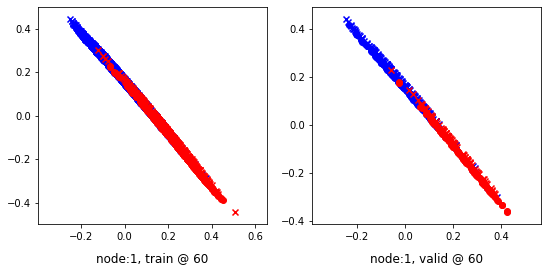

Aggregating on epoch: 63...
Aggregating on epoch: 72...
80 	 0 	 0.61612672 	 0.54629230 	 0.75574481 	 0.75158644 	 0.84122312 	 0.89844131


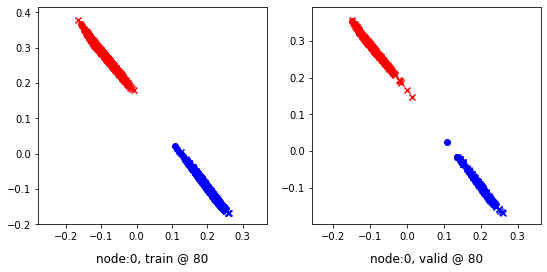

80 	 1 	 0.26559210 	 0.19947919 	 0.51883632 	 0.45788017 	 0.94935977 	 0.95154816


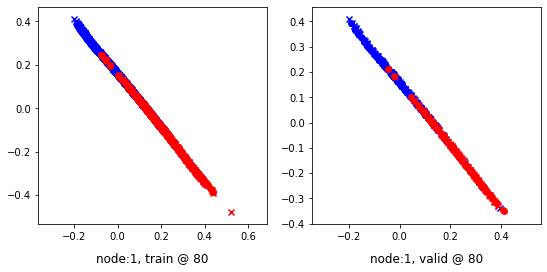

Aggregating on epoch: 81...
Aggregating on epoch: 90...
Aggregating on epoch: 99...
100 	 0 	 0.39465737 	 0.36811590 	 0.57034409 	 0.57279927 	 0.88547456 	 0.89783055


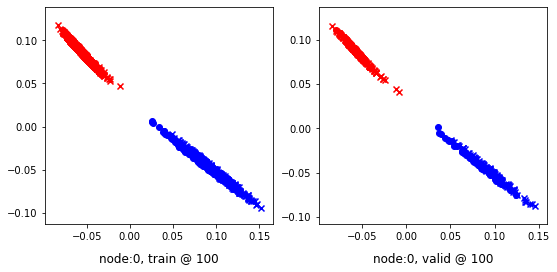

100 	 1 	 0.45232904 	 0.45253056 	 0.70474726 	 0.71098524 	 0.95394266 	 0.95160186


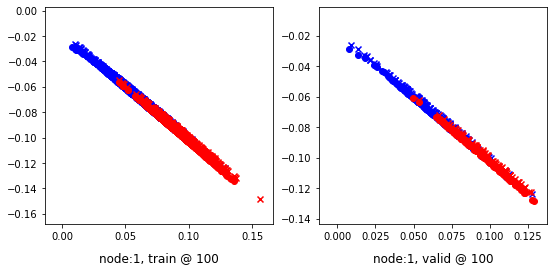

Aggregating on epoch: 108...
Aggregating on epoch: 117...
120 	 0 	 0.16003865 	 0.15107071 	 0.35793680 	 0.35180020 	 0.93380529 	 0.89387667


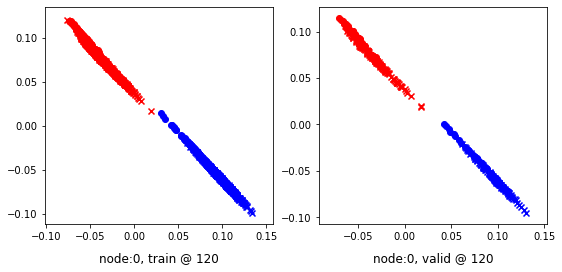

120 	 1 	 0.41827613 	 0.42932951 	 0.68004924 	 0.68512511 	 0.95043856 	 0.94894278


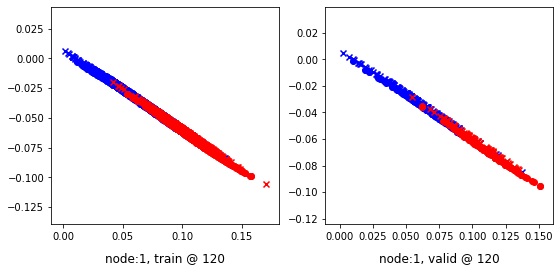

Aggregating on epoch: 126...
Aggregating on epoch: 135...
140 	 0 	 -0.15107696 	 -0.14813757 	 0.05346576 	 0.05877626 	 0.90259111 	 0.90006101


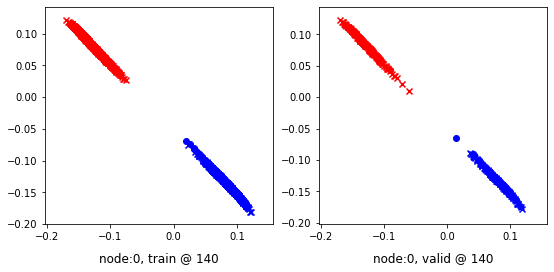

140 	 1 	 0.40525526 	 0.39134234 	 0.65140545 	 0.64679152 	 0.94436347 	 0.94859636


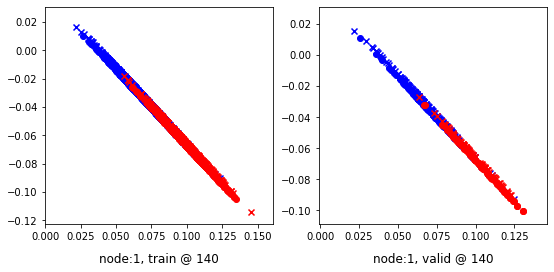

Aggregating on epoch: 144...
Aggregating on epoch: 153...
160 	 0 	 0.10353261 	 0.05718958 	 0.25958598 	 0.26340467 	 0.87395030 	 0.89936227


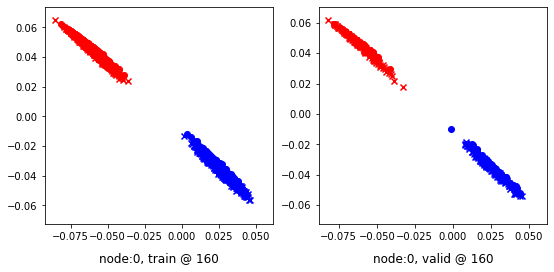

160 	 1 	 0.44023108 	 0.44872451 	 0.69075447 	 0.70918256 	 0.95134324 	 0.95360523


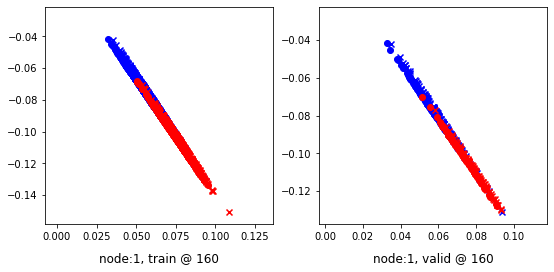

Aggregating on epoch: 162...
Aggregating on epoch: 171...
Aggregating on epoch: 180...
180 	 0 	 0.55012226 	 0.40376949 	 0.62798411 	 0.61018431 	 0.91936773 	 0.89956200


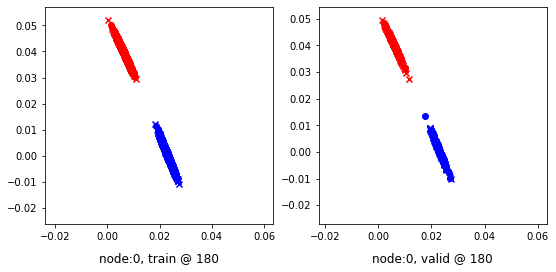

180 	 1 	 0.81434858 	 0.69648933 	 1.01529181 	 0.95515192 	 0.95106137 	 0.95180976


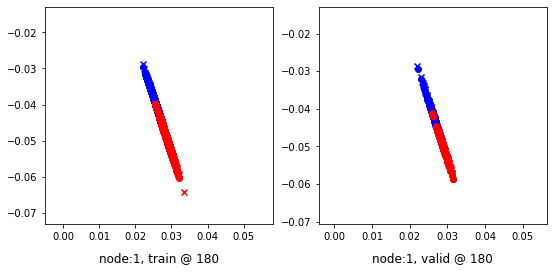

Aggregating on epoch: 189...
Aggregating on epoch: 198...
200 	 0 	 0.32374400 	 0.29864687 	 0.50769913 	 0.50453615 	 0.90424776 	 0.89903647


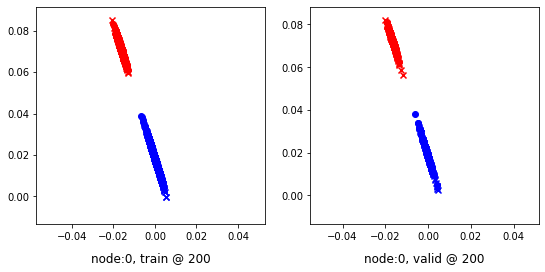

200 	 1 	 0.63146514 	 0.62992871 	 0.89387596 	 0.88928080 	 0.95301956 	 0.95249927


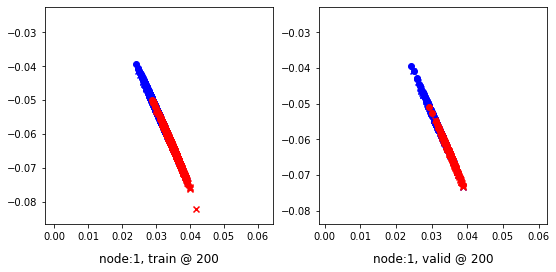

Aggregating on epoch: 207...
Aggregating on epoch: 216...
220 	 0 	 0.17665309 	 0.17270780 	 0.36728120 	 0.37640405 	 0.90465975 	 0.89684343


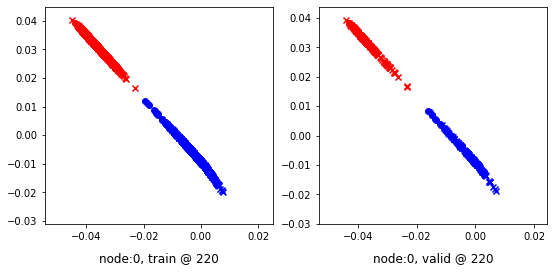

220 	 1 	 0.66128355 	 0.62999380 	 0.90634578 	 0.88856834 	 0.93986595 	 0.95172173


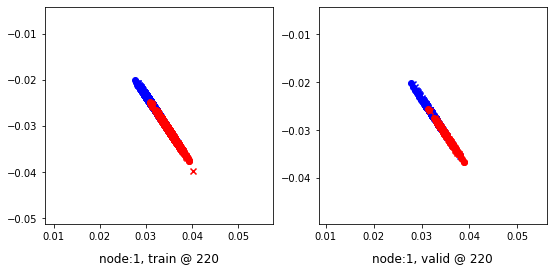

Aggregating on epoch: 225...
Aggregating on epoch: 234...
240 	 0 	 0.03923126 	 0.00926778 	 0.21355709 	 0.21521142 	 0.88800430 	 0.89909083


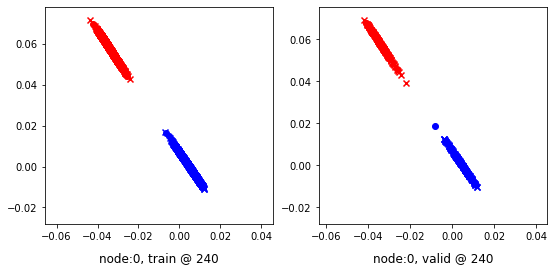

240 	 1 	 0.61076003 	 0.58592576 	 0.85981047 	 0.84346801 	 0.94774258 	 0.95068944


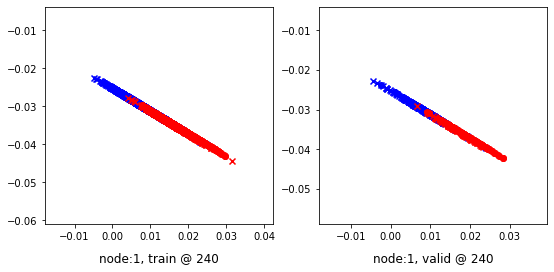

Aggregating on epoch: 243...
Aggregating on epoch: 252...
260 	 0 	 -0.07741278 	 -0.08803492 	 0.11107991 	 0.11831612 	 0.88550347 	 0.89949822


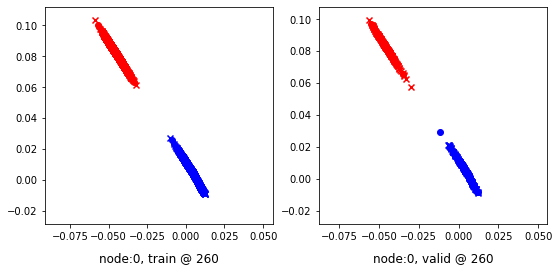

260 	 1 	 0.40413314 	 0.36091405 	 0.64273441 	 0.61671394 	 0.93693012 	 0.94894707


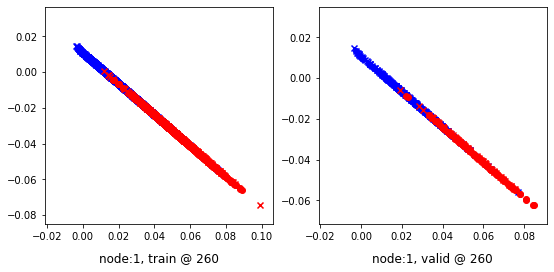

Aggregating on epoch: 261...
Aggregating on epoch: 270...
Aggregating on epoch: 279...
280 	 0 	 0.64912856 	 0.55214715 	 0.75721848 	 0.75852972 	 0.87360871 	 0.89952976


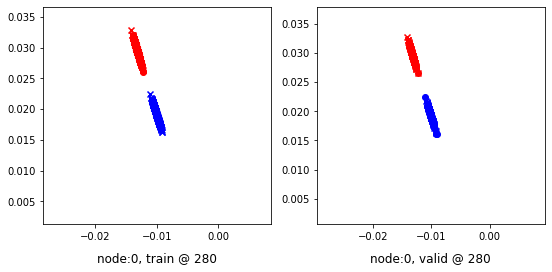

280 	 1 	 0.61309969 	 0.61941475 	 0.87907249 	 0.87842017 	 0.96244311 	 0.95215261


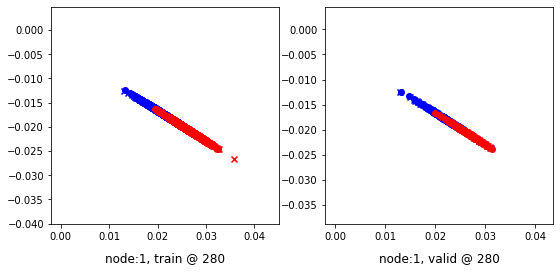

Aggregating on epoch: 288...
Aggregating on epoch: 297...
300 	 0 	 0.37540877 	 0.35885018 	 0.56092638 	 0.56555295 	 0.90497792 	 0.89984995


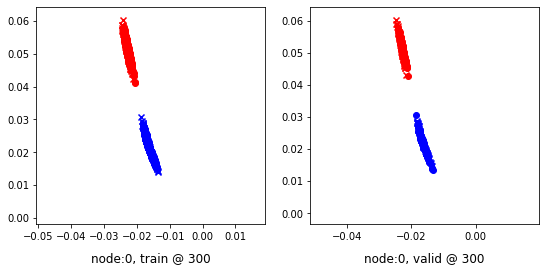

300 	 1 	 0.42853314 	 0.46207070 	 0.68371308 	 0.71901900 	 0.95348161 	 0.95009547


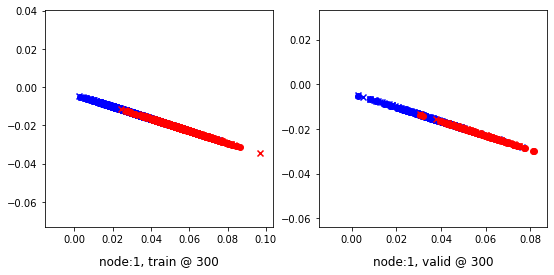

Aggregating on epoch: 306...
Aggregating on epoch: 315...
320 	 0 	 0.43926507 	 0.38792008 	 0.59656048 	 0.59444565 	 0.88094997 	 0.89967275


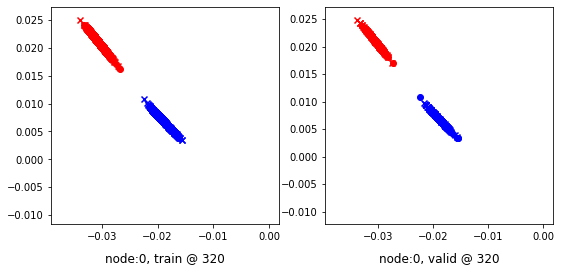

320 	 1 	 0.46390414 	 0.44093609 	 0.71187288 	 0.69816786 	 0.94849825 	 0.95037895


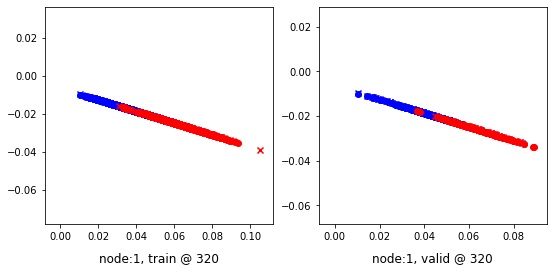

Aggregating on epoch: 324...
Aggregating on epoch: 333...
340 	 0 	 0.18398705 	 0.13571307 	 0.33264634 	 0.34189734 	 0.87688190 	 0.89933145


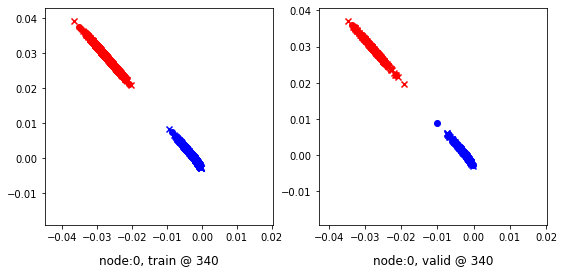

340 	 1 	 0.33029187 	 0.33299464 	 0.57611901 	 0.59033668 	 0.94118202 	 0.95048922


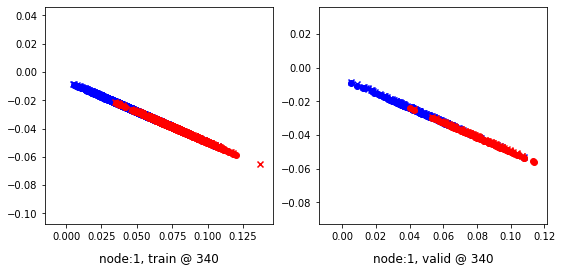

Aggregating on epoch: 342...
Aggregating on epoch: 351...
Aggregating on epoch: 360...
360 	 0 	 0.43423933 	 0.41235393 	 0.62012702 	 0.61896384 	 0.92910516 	 0.89975709


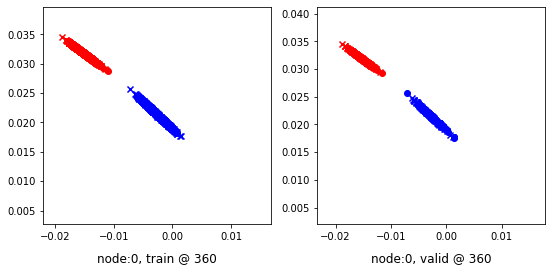

360 	 1 	 0.63343650 	 0.52286589 	 0.81763244 	 0.78064054 	 0.95226026 	 0.95092183


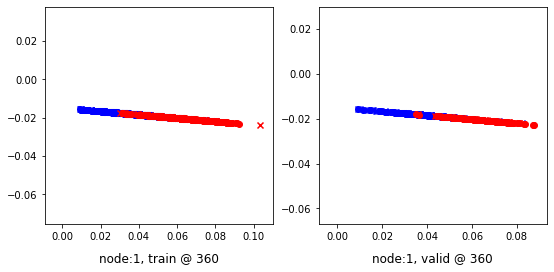

Aggregating on epoch: 369...
Aggregating on epoch: 378...
380 	 0 	 0.54165083 	 0.59256852 	 0.77837509 	 0.79880828 	 0.88732916 	 0.89938694


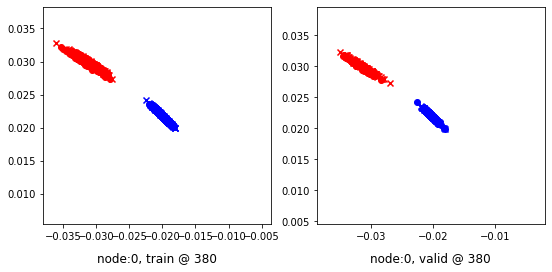

380 	 1 	 0.66379005 	 0.65821600 	 0.93483710 	 0.91846150 	 0.95364660 	 0.95339268


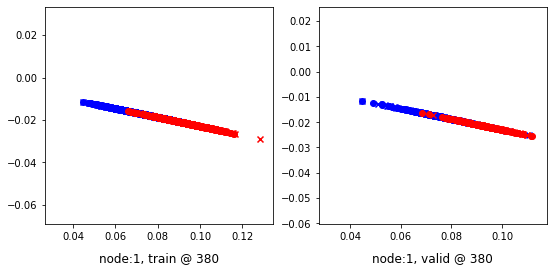

Aggregating on epoch: 387...
Aggregating on epoch: 396...
400 	 0 	 0.21620694 	 0.16965765 	 0.37406409 	 0.37618494 	 0.91117746 	 0.89967448


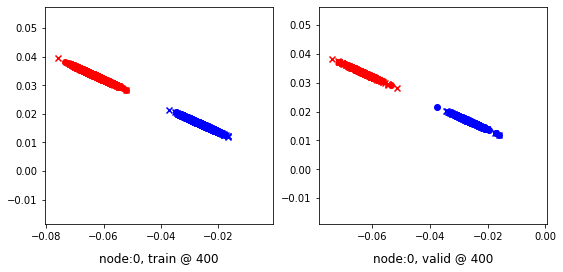

400 	 1 	 0.63550317 	 0.61609137 	 0.88173693 	 0.87485462 	 0.95302147 	 0.95191044


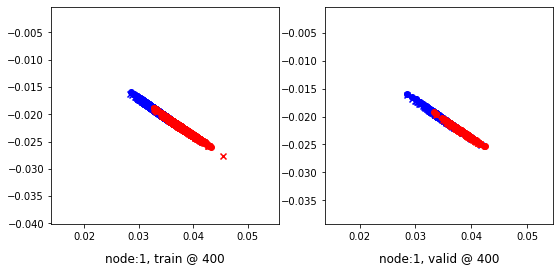

Aggregating on epoch: 405...
Aggregating on epoch: 414...
420 	 0 	 0.21849677 	 0.19651568 	 0.39155823 	 0.40270442 	 0.87351274 	 0.89933592


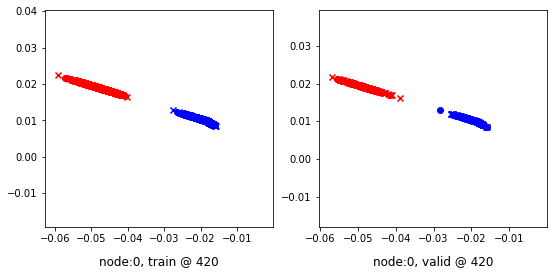

420 	 1 	 0.60731232 	 0.60166806 	 0.85855579 	 0.86035860 	 0.94797575 	 0.95183772


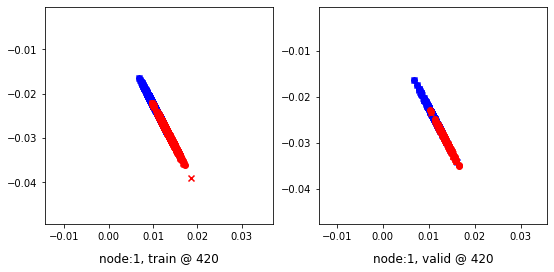

Aggregating on epoch: 423...
Aggregating on epoch: 432...
440 	 0 	 0.13827589 	 0.15154666 	 0.34470594 	 0.35771525 	 0.91823167 	 0.89931577


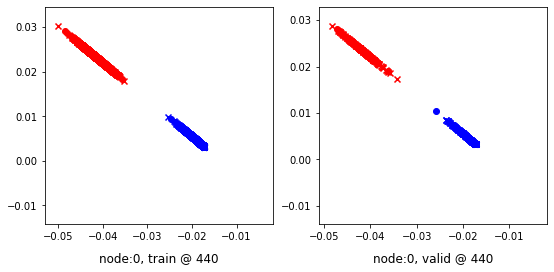

440 	 1 	 0.41299504 	 0.41282862 	 0.67650080 	 0.66921002 	 0.96300554 	 0.94952857


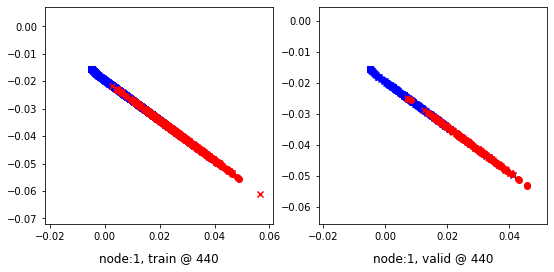

Aggregating on epoch: 441...
Aggregating on epoch: 450...
Aggregating on epoch: 459...
460 	 0 	 0.38265729 	 0.24120057 	 0.45091954 	 0.44748664 	 0.88674718 	 0.89943326


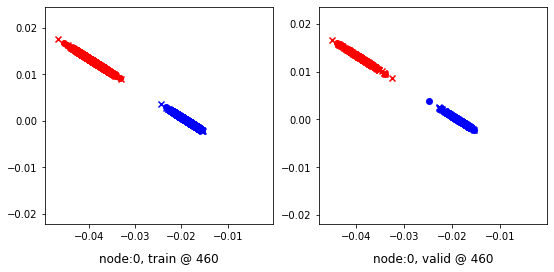

460 	 1 	 0.50776535 	 0.49428999 	 0.74026638 	 0.75276935 	 0.94046533 	 0.95162654


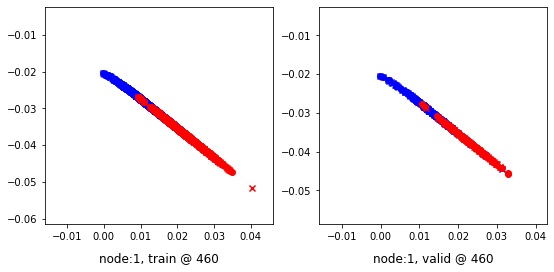

Aggregating on epoch: 468...
Aggregating on epoch: 477...
480 	 0 	 0.24207404 	 0.24181685 	 0.44121298 	 0.44791463 	 0.89106673 	 0.89924496


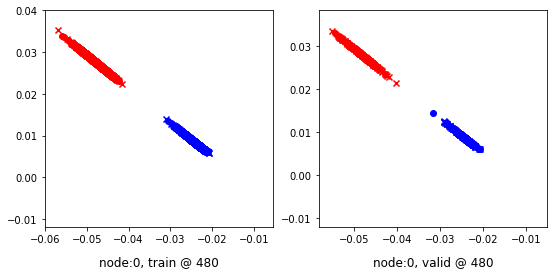

480 	 1 	 0.34407204 	 0.33330423 	 0.60605955 	 0.59213221 	 0.94698673 	 0.95197517


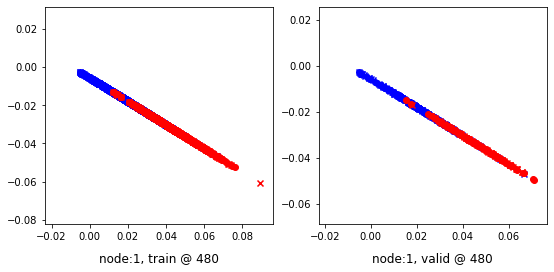

Aggregating on epoch: 486...
Aggregating on epoch: 495...
500 	 0 	 -0.08974542 	 -0.07186063 	 0.13203453 	 0.13393025 	 0.93171781 	 0.89893806


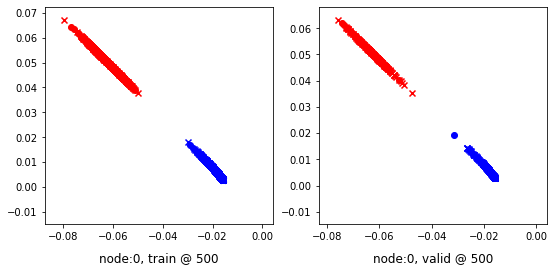

500 	 1 	 0.51994914 	 0.51531994 	 0.77077168 	 0.77410096 	 0.94798499 	 0.95192820


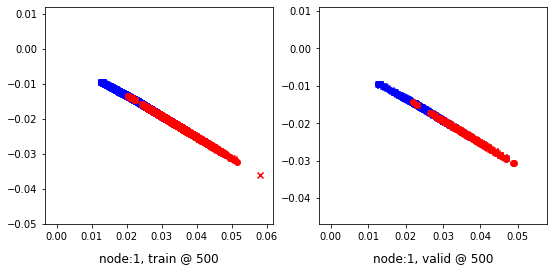

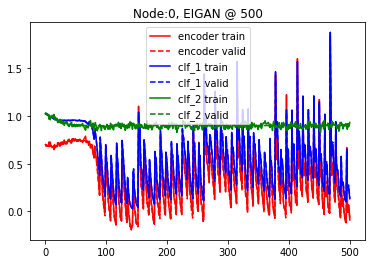

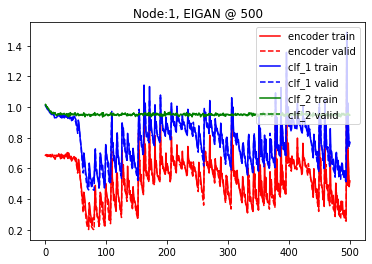

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.8 and delta=1
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.64267254 	 0.63668728 	 1.03639400 	 1.03698778 	 1.08693218 	 1.09344769


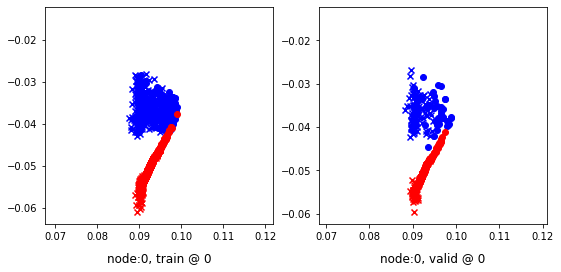

0 	 1 	 0.74975669 	 0.74754477 	 1.08222508 	 1.07775664 	 1.02581310 	 1.02335906


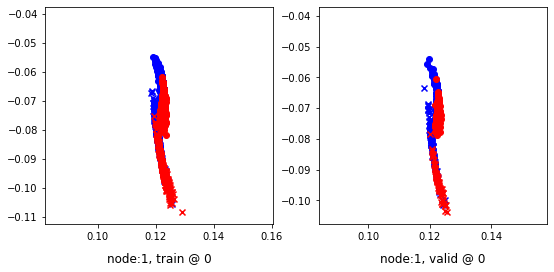

Aggregating on epoch: 1...
Aggregating on epoch: 2...
Aggregating on epoch: 3...
Aggregating on epoch: 4...
Aggregating on epoch: 5...
Aggregating on epoch: 6...
Aggregating on epoch: 7...
Aggregating on epoch: 8...
Aggregating on epoch: 9...
Aggregating on epoch: 10...
Aggregating on epoch: 11...
Aggregating on epoch: 12...
Aggregating on epoch: 13...
Aggregating on epoch: 14...
Aggregating on epoch: 15...
Aggregating on epoch: 16...
Aggregating on epoch: 17...
Aggregating on epoch: 18...
Aggregating on epoch: 19...
Aggregating on epoch: 20...
20 	 0 	 0.66393048 	 0.67995000 	 0.95542198 	 0.95991647 	 0.98467398 	 0.97311366


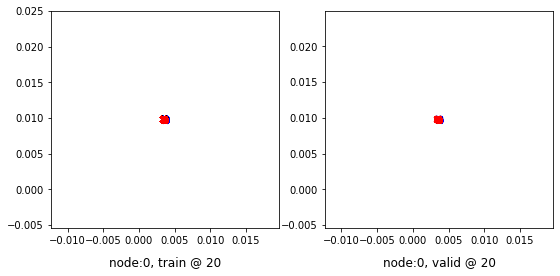

20 	 1 	 0.70187873 	 0.70196438 	 0.95934951 	 0.96450752 	 0.95070946 	 0.95569032


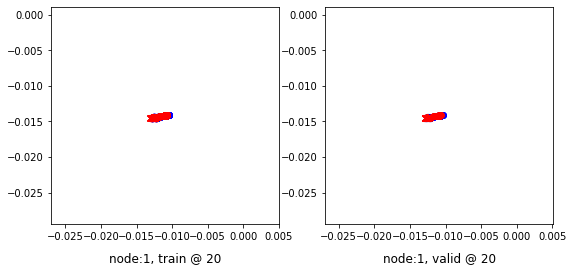

Aggregating on epoch: 21...
Aggregating on epoch: 22...
Aggregating on epoch: 23...
Aggregating on epoch: 24...
Aggregating on epoch: 25...
Aggregating on epoch: 26...
Aggregating on epoch: 27...
Aggregating on epoch: 28...
Aggregating on epoch: 29...
Aggregating on epoch: 30...
Aggregating on epoch: 31...
Aggregating on epoch: 32...
Aggregating on epoch: 33...
Aggregating on epoch: 34...
Aggregating on epoch: 35...
Aggregating on epoch: 36...
Aggregating on epoch: 37...
Aggregating on epoch: 38...
Aggregating on epoch: 39...
Aggregating on epoch: 40...
40 	 0 	 0.71293885 	 0.73972034 	 0.94985849 	 0.95396256 	 0.93008125 	 0.90738940


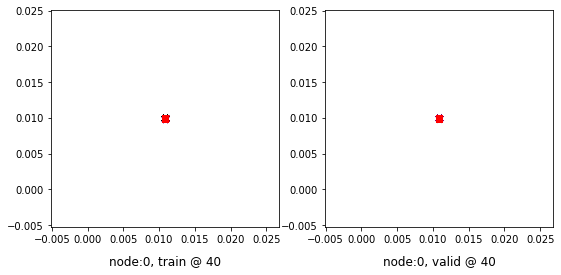

40 	 1 	 0.67716098 	 0.68656057 	 0.94004303 	 0.94523710 	 0.95602953 	 0.95182371


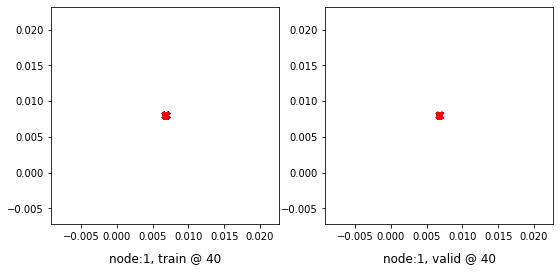

Aggregating on epoch: 41...
Aggregating on epoch: 42...
Aggregating on epoch: 43...
Aggregating on epoch: 44...
Aggregating on epoch: 45...
Aggregating on epoch: 46...
Aggregating on epoch: 47...
Aggregating on epoch: 48...
Aggregating on epoch: 49...
Aggregating on epoch: 50...
Aggregating on epoch: 51...
Aggregating on epoch: 52...
Aggregating on epoch: 53...
Aggregating on epoch: 54...
Aggregating on epoch: 55...
Aggregating on epoch: 56...
Aggregating on epoch: 57...
Aggregating on epoch: 58...
Aggregating on epoch: 59...
Aggregating on epoch: 60...
60 	 0 	 0.74914998 	 0.74766952 	 0.95042408 	 0.95394337 	 0.89442158 	 0.89942104


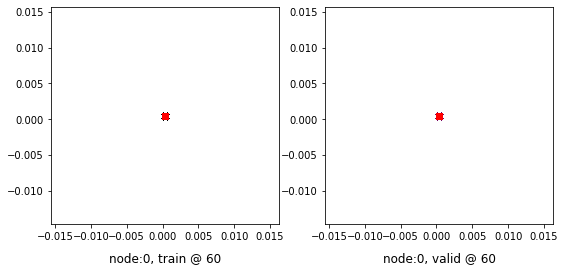

60 	 1 	 0.67071825 	 0.68655026 	 0.93863845 	 0.94522864 	 0.96106744 	 0.95182556


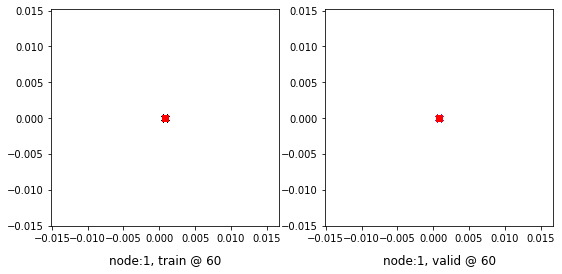

Aggregating on epoch: 61...
Aggregating on epoch: 62...
Aggregating on epoch: 63...
Aggregating on epoch: 64...
Aggregating on epoch: 65...
Aggregating on epoch: 66...
Aggregating on epoch: 67...
Aggregating on epoch: 68...
Aggregating on epoch: 69...
Aggregating on epoch: 70...
Aggregating on epoch: 71...
Aggregating on epoch: 72...
Aggregating on epoch: 73...
Aggregating on epoch: 74...
Aggregating on epoch: 75...
Aggregating on epoch: 76...
Aggregating on epoch: 77...
Aggregating on epoch: 78...
Aggregating on epoch: 79...
Aggregating on epoch: 80...
80 	 0 	 0.80793345 	 0.74768674 	 0.95440108 	 0.95394516 	 0.83961475 	 0.89940560


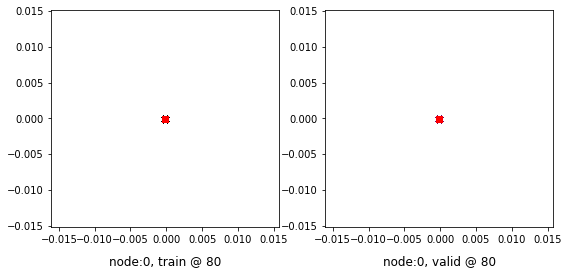

80 	 1 	 0.67838222 	 0.68655139 	 0.93735296 	 0.94522887 	 0.95211786 	 0.95182467


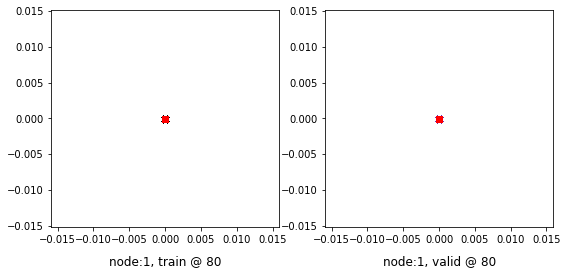

Aggregating on epoch: 81...
Aggregating on epoch: 82...
Aggregating on epoch: 83...
Aggregating on epoch: 84...
Aggregating on epoch: 85...
Aggregating on epoch: 86...
Aggregating on epoch: 87...
Aggregating on epoch: 88...
Aggregating on epoch: 89...
Aggregating on epoch: 90...
Aggregating on epoch: 91...
Aggregating on epoch: 92...
Aggregating on epoch: 93...
Aggregating on epoch: 94...
Aggregating on epoch: 95...
Aggregating on epoch: 96...
Aggregating on epoch: 97...
Aggregating on epoch: 98...
Aggregating on epoch: 99...
Aggregating on epoch: 100...
100 	 0 	 0.68495119 	 0.74768311 	 0.95515728 	 0.95395017 	 0.96335346 	 0.89941424


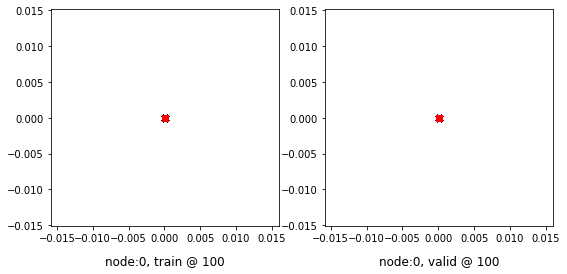

100 	 1 	 0.67838484 	 0.68655354 	 0.93735653 	 0.94522876 	 0.95211875 	 0.95182240


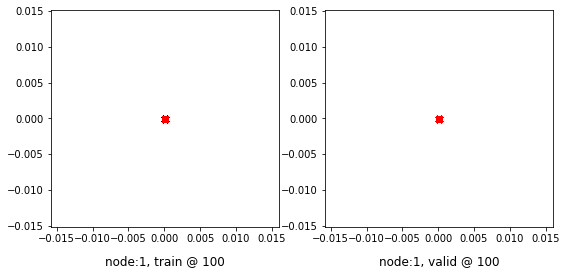

Aggregating on epoch: 101...
Aggregating on epoch: 102...
Aggregating on epoch: 103...
Aggregating on epoch: 104...
Aggregating on epoch: 105...
Aggregating on epoch: 106...
Aggregating on epoch: 107...
Aggregating on epoch: 108...
Aggregating on epoch: 109...
Aggregating on epoch: 110...
Aggregating on epoch: 111...
Aggregating on epoch: 112...
Aggregating on epoch: 113...
Aggregating on epoch: 114...
Aggregating on epoch: 115...
Aggregating on epoch: 116...
Aggregating on epoch: 117...
Aggregating on epoch: 118...
Aggregating on epoch: 119...
Aggregating on epoch: 120...
120 	 0 	 0.79328662 	 0.74768668 	 0.96023971 	 0.95394528 	 0.86010021 	 0.89940578


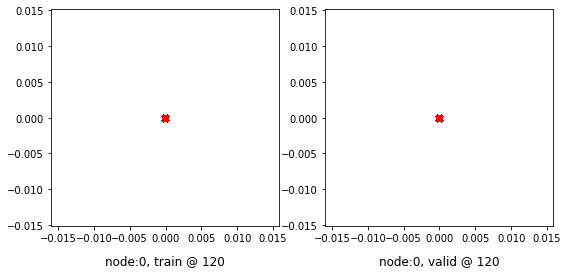

120 	 1 	 0.70595574 	 0.68655008 	 0.96556503 	 0.94522798 	 0.95275664 	 0.95182508


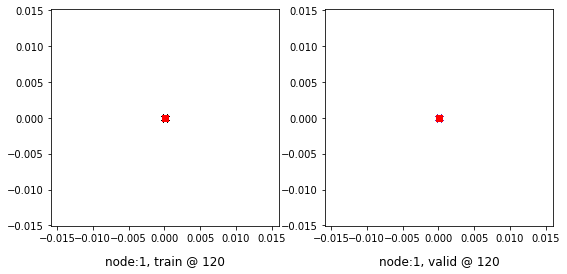

Aggregating on epoch: 121...
Aggregating on epoch: 122...
Aggregating on epoch: 123...
Aggregating on epoch: 124...
Aggregating on epoch: 125...
Aggregating on epoch: 126...
Aggregating on epoch: 127...
Aggregating on epoch: 128...
Aggregating on epoch: 129...
Aggregating on epoch: 130...
Aggregating on epoch: 131...
Aggregating on epoch: 132...
Aggregating on epoch: 133...
Aggregating on epoch: 134...
Aggregating on epoch: 135...
Aggregating on epoch: 136...
Aggregating on epoch: 137...
Aggregating on epoch: 138...
Aggregating on epoch: 139...
Aggregating on epoch: 140...
140 	 0 	 0.73872119 	 0.74768728 	 0.95367175 	 0.95394748 	 0.90809774 	 0.89940739


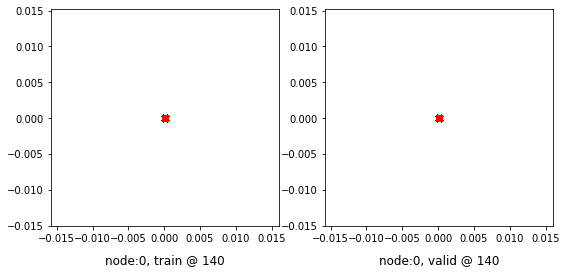

140 	 1 	 0.66806465 	 0.68655533 	 0.93473572 	 0.94523233 	 0.95981842 	 0.95182419


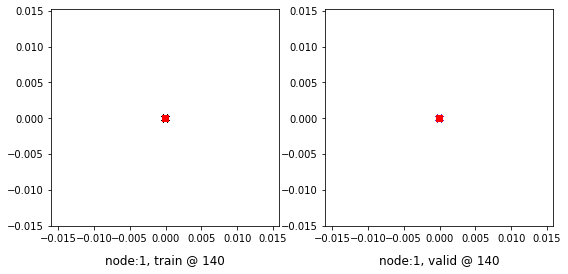

Aggregating on epoch: 141...
Aggregating on epoch: 142...
Aggregating on epoch: 143...
Aggregating on epoch: 144...
Aggregating on epoch: 145...
Aggregating on epoch: 146...
Aggregating on epoch: 147...
Aggregating on epoch: 148...
Aggregating on epoch: 149...
Aggregating on epoch: 150...
Aggregating on epoch: 151...
Aggregating on epoch: 152...
Aggregating on epoch: 153...
Aggregating on epoch: 154...
Aggregating on epoch: 155...
Aggregating on epoch: 156...
Aggregating on epoch: 157...
Aggregating on epoch: 158...
Aggregating on epoch: 159...
Aggregating on epoch: 160...
160 	 0 	 0.69736159 	 0.74768472 	 0.95367187 	 0.95394874 	 0.94945741 	 0.89941120


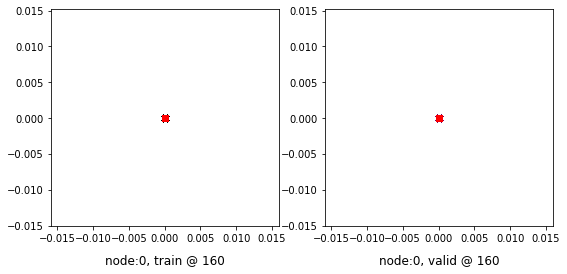

160 	 1 	 0.69734877 	 0.68656617 	 0.96466893 	 0.94524330 	 0.96046758 	 0.95182431


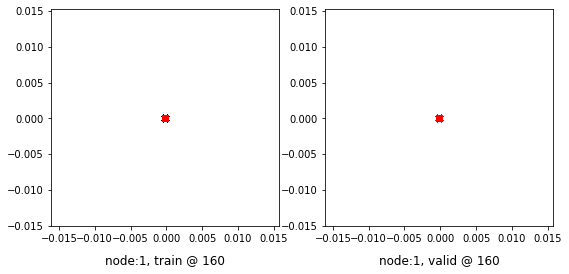

Aggregating on epoch: 161...
Aggregating on epoch: 162...
Aggregating on epoch: 163...
Aggregating on epoch: 164...
Aggregating on epoch: 165...
Aggregating on epoch: 166...
Aggregating on epoch: 167...
Aggregating on epoch: 168...
Aggregating on epoch: 169...
Aggregating on epoch: 170...
Aggregating on epoch: 171...
Aggregating on epoch: 172...
Aggregating on epoch: 173...
Aggregating on epoch: 174...
Aggregating on epoch: 175...
Aggregating on epoch: 176...
Aggregating on epoch: 177...
Aggregating on epoch: 178...
Aggregating on epoch: 179...
Aggregating on epoch: 180...
180 	 0 	 0.75895059 	 0.74768722 	 0.95330352 	 0.95394701 	 0.88750017 	 0.89940697


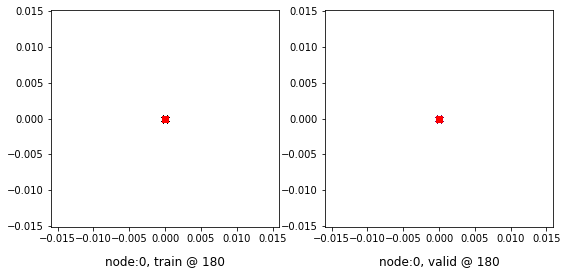

180 	 1 	 0.66691887 	 0.68655276 	 0.92848945 	 0.94522727 	 0.95471776 	 0.95182168


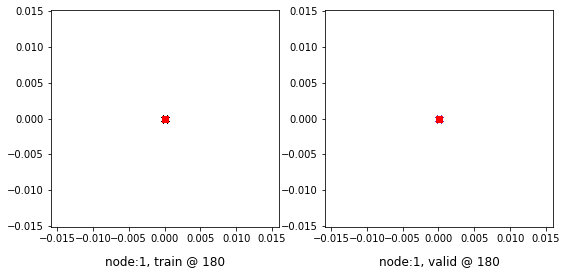

Aggregating on epoch: 181...
Aggregating on epoch: 182...
Aggregating on epoch: 183...
Aggregating on epoch: 184...
Aggregating on epoch: 185...
Aggregating on epoch: 186...
Aggregating on epoch: 187...
Aggregating on epoch: 188...
Aggregating on epoch: 189...
Aggregating on epoch: 190...
Aggregating on epoch: 191...
Aggregating on epoch: 192...
Aggregating on epoch: 193...
Aggregating on epoch: 194...
Aggregating on epoch: 195...
Aggregating on epoch: 196...
Aggregating on epoch: 197...
Aggregating on epoch: 198...
Aggregating on epoch: 199...
Aggregating on epoch: 200...
200 	 0 	 0.74338669 	 0.74768537 	 0.95147175 	 0.95394647 	 0.90123218 	 0.89940828


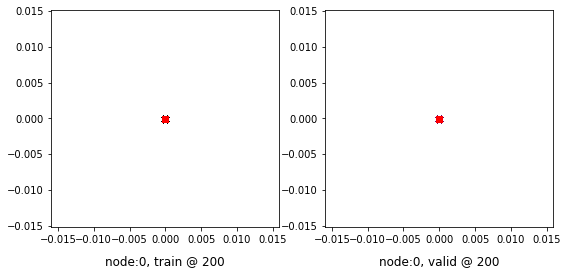

200 	 1 	 0.67460114 	 0.68655252 	 0.93617523 	 0.94522703 	 0.95472115 	 0.95182168


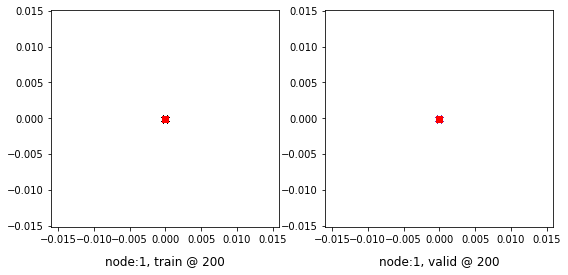

Aggregating on epoch: 201...
Aggregating on epoch: 202...
Aggregating on epoch: 203...
Aggregating on epoch: 204...
Aggregating on epoch: 205...
Aggregating on epoch: 206...
Aggregating on epoch: 207...
Aggregating on epoch: 208...
Aggregating on epoch: 209...
Aggregating on epoch: 210...
Aggregating on epoch: 211...
Aggregating on epoch: 212...
Aggregating on epoch: 213...
Aggregating on epoch: 214...
Aggregating on epoch: 215...
Aggregating on epoch: 216...
Aggregating on epoch: 217...
Aggregating on epoch: 218...
Aggregating on epoch: 219...
Aggregating on epoch: 220...
220 	 0 	 0.72478157 	 0.74768323 	 0.95698512 	 0.95394790 	 0.92535067 	 0.89941186


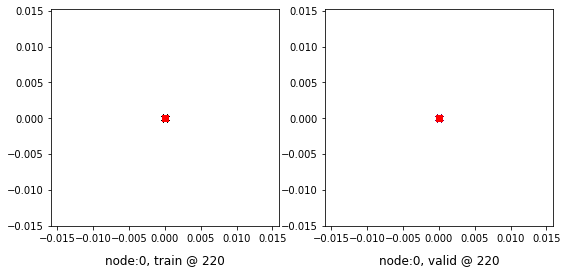

220 	 1 	 0.69448525 	 0.68656033 	 0.95931262 	 0.94523495 	 0.95797467 	 0.95182180


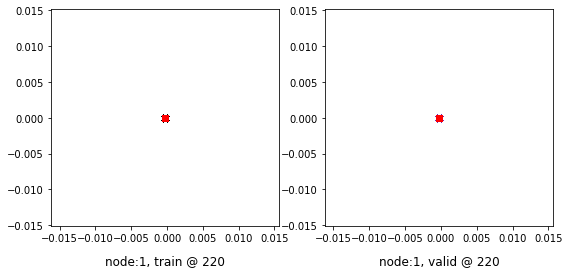

Aggregating on epoch: 221...
Aggregating on epoch: 222...
Aggregating on epoch: 223...
Aggregating on epoch: 224...
Aggregating on epoch: 225...
Aggregating on epoch: 226...
Aggregating on epoch: 227...
Aggregating on epoch: 228...
Aggregating on epoch: 229...
Aggregating on epoch: 230...
Aggregating on epoch: 231...
Aggregating on epoch: 232...
Aggregating on epoch: 233...
Aggregating on epoch: 234...
Aggregating on epoch: 235...
Aggregating on epoch: 236...
Aggregating on epoch: 237...
Aggregating on epoch: 238...
Aggregating on epoch: 239...
Aggregating on epoch: 240...
240 	 0 	 0.75896335 	 0.74768358 	 0.95330948 	 0.95394403 	 0.88749343 	 0.89940763


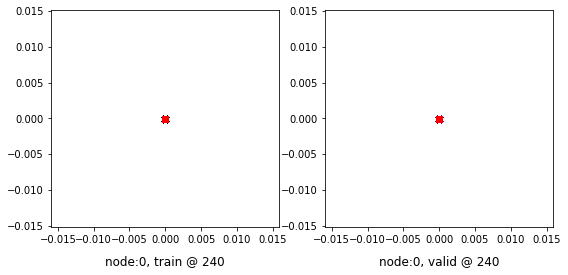

240 	 1 	 0.69951367 	 0.68655372 	 0.96043861 	 0.94522804 	 0.95407242 	 0.95182151


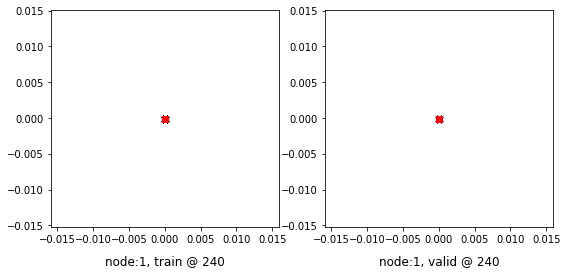

Aggregating on epoch: 241...
Aggregating on epoch: 242...
Aggregating on epoch: 243...
Aggregating on epoch: 244...
Aggregating on epoch: 245...
Aggregating on epoch: 246...
Aggregating on epoch: 247...
Aggregating on epoch: 248...
Aggregating on epoch: 249...
Aggregating on epoch: 250...
Aggregating on epoch: 251...
Aggregating on epoch: 252...
Aggregating on epoch: 253...
Aggregating on epoch: 254...
Aggregating on epoch: 255...
Aggregating on epoch: 256...
Aggregating on epoch: 257...
Aggregating on epoch: 258...
Aggregating on epoch: 259...
Aggregating on epoch: 260...
260 	 0 	 0.76880437 	 0.74769133 	 0.95628458 	 0.95395172 	 0.88062751 	 0.89940757


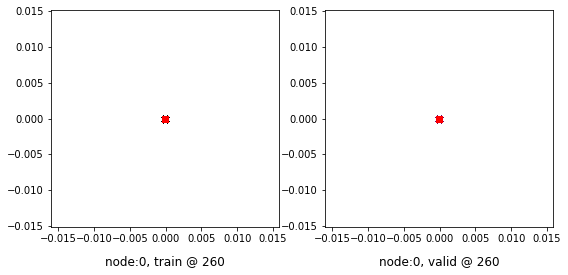

260 	 1 	 0.65339351 	 0.68655241 	 0.92210042 	 0.94522715 	 0.96185422 	 0.95182192


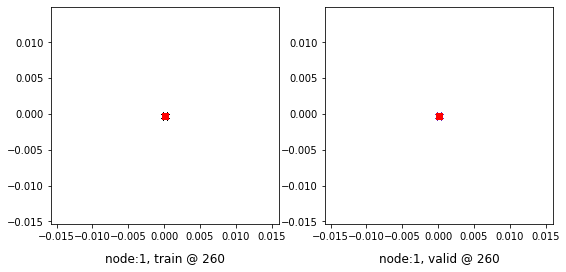

Aggregating on epoch: 261...
Aggregating on epoch: 262...
Aggregating on epoch: 263...
Aggregating on epoch: 264...
Aggregating on epoch: 265...
Aggregating on epoch: 266...
Aggregating on epoch: 267...
Aggregating on epoch: 268...
Aggregating on epoch: 269...
Aggregating on epoch: 270...
Aggregating on epoch: 271...
Aggregating on epoch: 272...
Aggregating on epoch: 273...
Aggregating on epoch: 274...
Aggregating on epoch: 275...
Aggregating on epoch: 276...
Aggregating on epoch: 277...
Aggregating on epoch: 278...
Aggregating on epoch: 279...
Aggregating on epoch: 280...
280 	 0 	 0.75661373 	 0.74768716 	 0.95440364 	 0.95394647 	 0.89093703 	 0.89940649


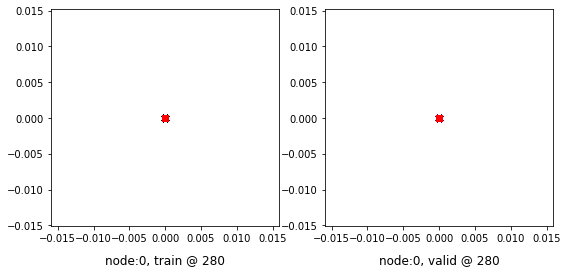

280 	 1 	 0.68675309 	 0.68654823 	 0.94762725 	 0.94522870 	 0.95402145 	 0.95182765


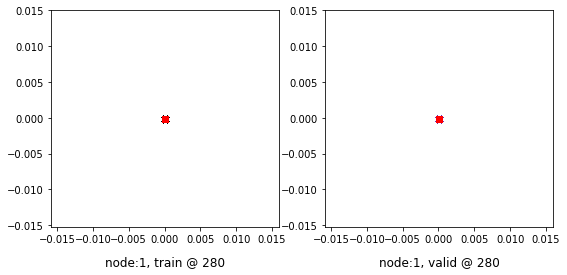

Aggregating on epoch: 281...
Aggregating on epoch: 282...
Aggregating on epoch: 283...
Aggregating on epoch: 284...
Aggregating on epoch: 285...
Aggregating on epoch: 286...
Aggregating on epoch: 287...
Aggregating on epoch: 288...
Aggregating on epoch: 289...
Aggregating on epoch: 290...
Aggregating on epoch: 291...
Aggregating on epoch: 292...
Aggregating on epoch: 293...
Aggregating on epoch: 294...
Aggregating on epoch: 295...
Aggregating on epoch: 296...
Aggregating on epoch: 297...
Aggregating on epoch: 298...
Aggregating on epoch: 299...
Aggregating on epoch: 300...
300 	 0 	 0.77227199 	 0.74768555 	 0.95294702 	 0.95394385 	 0.87382233 	 0.89940548


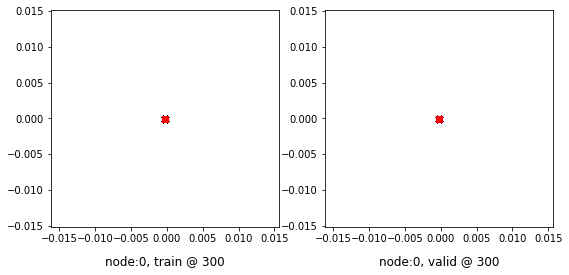

300 	 1 	 0.67134488 	 0.68654782 	 0.92206138 	 0.94522750 	 0.94386405 	 0.95182687


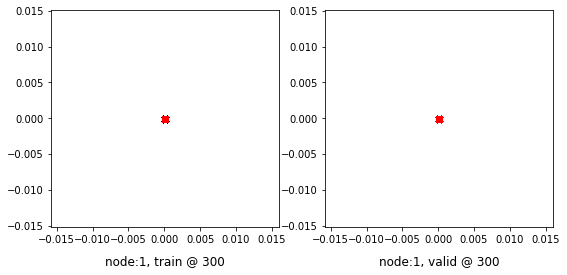

Aggregating on epoch: 301...
Aggregating on epoch: 302...
Aggregating on epoch: 303...
Aggregating on epoch: 304...
Aggregating on epoch: 305...
Aggregating on epoch: 306...
Aggregating on epoch: 307...
Aggregating on epoch: 308...
Aggregating on epoch: 309...
Aggregating on epoch: 310...
Aggregating on epoch: 311...
Aggregating on epoch: 312...
Aggregating on epoch: 313...
Aggregating on epoch: 314...
Aggregating on epoch: 315...
Aggregating on epoch: 316...
Aggregating on epoch: 317...
Aggregating on epoch: 318...
Aggregating on epoch: 319...
Aggregating on epoch: 320...
320 	 0 	 0.79484719 	 0.74768466 	 0.95150942 	 0.95394325 	 0.84980941 	 0.89940578


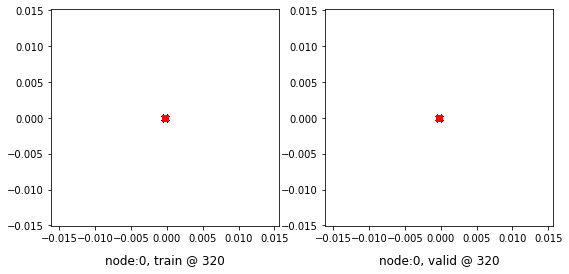

320 	 1 	 0.67643011 	 0.68655092 	 0.93603826 	 0.94522977 	 0.95275509 	 0.95182604


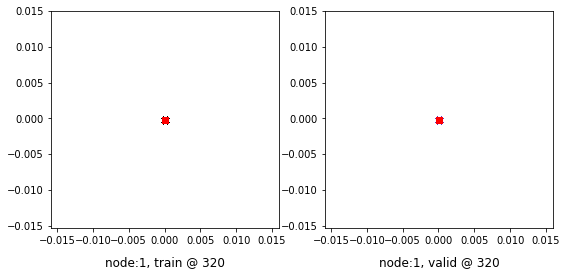

Aggregating on epoch: 321...
Aggregating on epoch: 322...
Aggregating on epoch: 323...
Aggregating on epoch: 324...
Aggregating on epoch: 325...
Aggregating on epoch: 326...
Aggregating on epoch: 327...
Aggregating on epoch: 328...
Aggregating on epoch: 329...
Aggregating on epoch: 330...
Aggregating on epoch: 331...
Aggregating on epoch: 332...
Aggregating on epoch: 333...
Aggregating on epoch: 334...
Aggregating on epoch: 335...
Aggregating on epoch: 336...
Aggregating on epoch: 337...
Aggregating on epoch: 338...
Aggregating on epoch: 339...
Aggregating on epoch: 340...
340 	 0 	 0.71802086 	 0.74768364 	 0.95367175 	 0.95394742 	 0.92879838 	 0.89941096


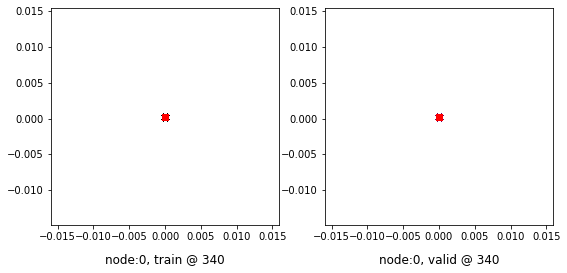

340 	 1 	 0.68097591 	 0.68655217 	 0.95149314 	 0.94523001 	 0.96366453 	 0.95182502


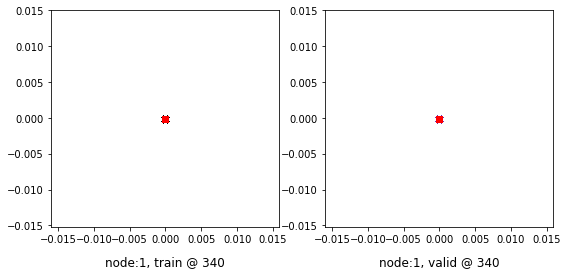

Aggregating on epoch: 341...
Aggregating on epoch: 342...
Aggregating on epoch: 343...
Aggregating on epoch: 344...
Aggregating on epoch: 345...
Aggregating on epoch: 346...
Aggregating on epoch: 347...
Aggregating on epoch: 348...
Aggregating on epoch: 349...
Aggregating on epoch: 350...
Aggregating on epoch: 351...
Aggregating on epoch: 352...
Aggregating on epoch: 353...
Aggregating on epoch: 354...
Aggregating on epoch: 355...
Aggregating on epoch: 356...
Aggregating on epoch: 357...
Aggregating on epoch: 358...
Aggregating on epoch: 359...
Aggregating on epoch: 360...
360 	 0 	 0.68676400 	 0.74768001 	 0.95697993 	 0.95394760 	 0.96336341 	 0.89941478


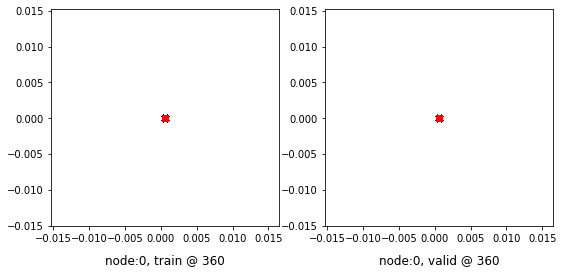

360 	 1 	 0.68421572 	 0.68655264 	 0.94764578 	 0.94523275 	 0.95657730 	 0.95182729


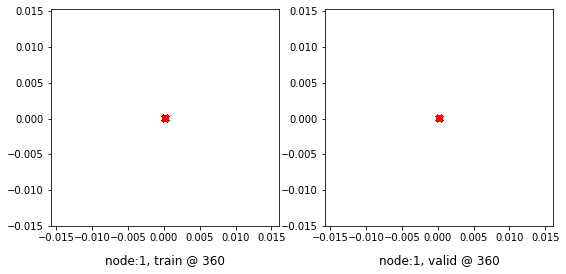

Aggregating on epoch: 361...
Aggregating on epoch: 362...
Aggregating on epoch: 363...
Aggregating on epoch: 364...
Aggregating on epoch: 365...
Aggregating on epoch: 366...
Aggregating on epoch: 367...
Aggregating on epoch: 368...
Aggregating on epoch: 369...
Aggregating on epoch: 370...
Aggregating on epoch: 371...
Aggregating on epoch: 372...
Aggregating on epoch: 373...
Aggregating on epoch: 374...
Aggregating on epoch: 375...
Aggregating on epoch: 376...
Aggregating on epoch: 377...
Aggregating on epoch: 378...
Aggregating on epoch: 379...
Aggregating on epoch: 380...
380 	 0 	 0.82301247 	 0.74769002 	 0.95587558 	 0.95394742 	 0.82601064 	 0.89940459


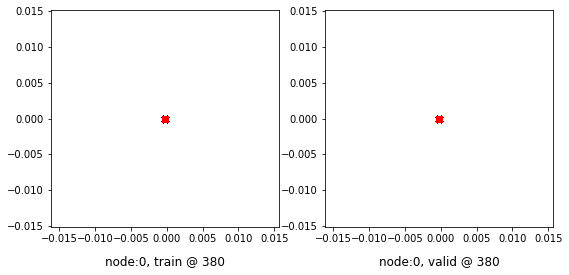

380 	 1 	 0.67711794 	 0.68654603 	 0.93355852 	 0.94522715 	 0.94958752 	 0.95182830


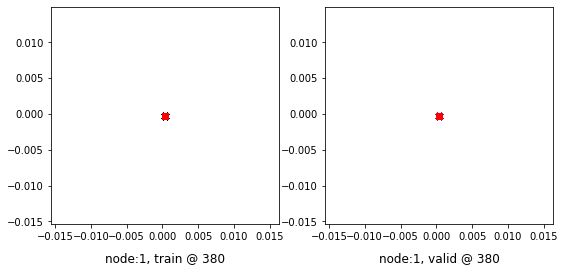

Aggregating on epoch: 381...
Aggregating on epoch: 382...
Aggregating on epoch: 383...
Aggregating on epoch: 384...
Aggregating on epoch: 385...
Aggregating on epoch: 386...
Aggregating on epoch: 387...
Aggregating on epoch: 388...
Aggregating on epoch: 389...
Aggregating on epoch: 390...
Aggregating on epoch: 391...
Aggregating on epoch: 392...
Aggregating on epoch: 393...
Aggregating on epoch: 394...
Aggregating on epoch: 395...
Aggregating on epoch: 396...
Aggregating on epoch: 397...
Aggregating on epoch: 398...
Aggregating on epoch: 399...
Aggregating on epoch: 400...
400 	 0 	 0.75792778 	 0.74768209 	 0.95913440 	 0.95394504 	 0.89435375 	 0.89941013


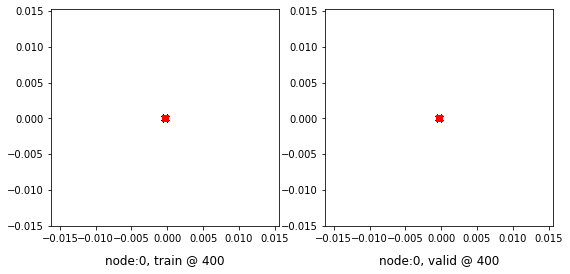

400 	 1 	 0.69132572 	 0.68655521 	 0.94377393 	 0.94522941 	 0.94559526 	 0.95182139


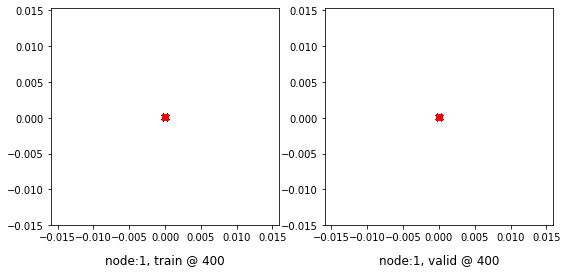

Aggregating on epoch: 401...
Aggregating on epoch: 402...
Aggregating on epoch: 403...
Aggregating on epoch: 404...
Aggregating on epoch: 405...
Aggregating on epoch: 406...
Aggregating on epoch: 407...
Aggregating on epoch: 408...
Aggregating on epoch: 409...
Aggregating on epoch: 410...
Aggregating on epoch: 411...
Aggregating on epoch: 412...
Aggregating on epoch: 413...
Aggregating on epoch: 414...
Aggregating on epoch: 415...
Aggregating on epoch: 416...
Aggregating on epoch: 417...
Aggregating on epoch: 418...
Aggregating on epoch: 419...
Aggregating on epoch: 420...
420 	 0 	 0.75355524 	 0.74769264 	 0.95478714 	 0.95395005 	 0.89437926 	 0.89940459


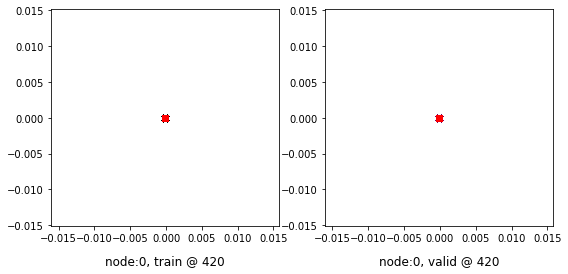

420 	 1 	 0.68045944 	 0.68655241 	 0.93614024 	 0.94522703 	 0.94882798 	 0.95182180


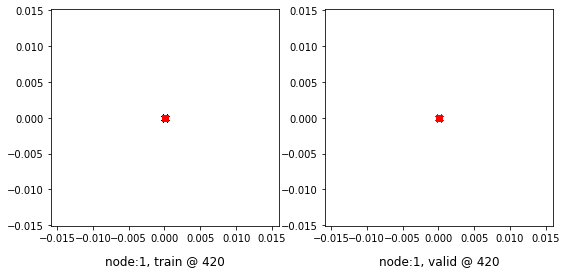

Aggregating on epoch: 421...
Aggregating on epoch: 422...
Aggregating on epoch: 423...
Aggregating on epoch: 424...
Aggregating on epoch: 425...
Aggregating on epoch: 426...
Aggregating on epoch: 427...
Aggregating on epoch: 428...
Aggregating on epoch: 429...
Aggregating on epoch: 430...
Aggregating on epoch: 431...
Aggregating on epoch: 432...
Aggregating on epoch: 433...
Aggregating on epoch: 434...
Aggregating on epoch: 435...
Aggregating on epoch: 436...
Aggregating on epoch: 437...
Aggregating on epoch: 438...
Aggregating on epoch: 439...
Aggregating on epoch: 440...
440 	 0 	 0.77141535 	 0.74769408 	 0.95554203 	 0.95395166 	 0.87727398 	 0.89940476


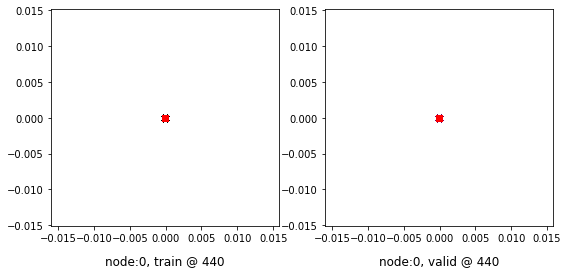

440 	 1 	 0.67766464 	 0.68653971 	 0.93352091 	 0.94522876 	 0.94900346 	 0.95183623


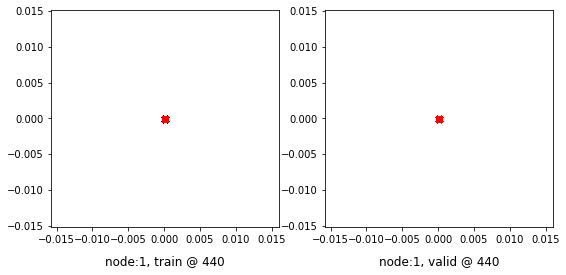

Aggregating on epoch: 441...
Aggregating on epoch: 442...
Aggregating on epoch: 443...
Aggregating on epoch: 444...
Aggregating on epoch: 445...
Aggregating on epoch: 446...
Aggregating on epoch: 447...
Aggregating on epoch: 448...
Aggregating on epoch: 449...
Aggregating on epoch: 450...
Aggregating on epoch: 451...
Aggregating on epoch: 452...
Aggregating on epoch: 453...
Aggregating on epoch: 454...
Aggregating on epoch: 455...
Aggregating on epoch: 456...
Aggregating on epoch: 457...
Aggregating on epoch: 458...
Aggregating on epoch: 459...
Aggregating on epoch: 460...
460 	 0 	 0.73974603 	 0.74768955 	 0.95811075 	 0.95394838 	 0.91151184 	 0.89940602


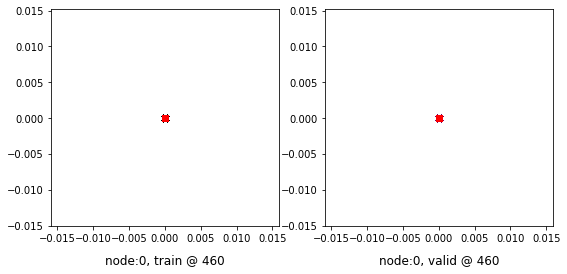

460 	 1 	 0.69439411 	 0.68654871 	 0.95022607 	 0.94523275 	 0.94897914 	 0.95183122


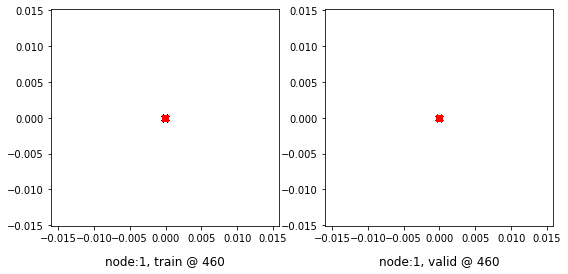

Aggregating on epoch: 461...
Aggregating on epoch: 462...
Aggregating on epoch: 463...
Aggregating on epoch: 464...
Aggregating on epoch: 465...
Aggregating on epoch: 466...
Aggregating on epoch: 467...
Aggregating on epoch: 468...
Aggregating on epoch: 469...
Aggregating on epoch: 470...
Aggregating on epoch: 471...
Aggregating on epoch: 472...
Aggregating on epoch: 473...
Aggregating on epoch: 474...
Aggregating on epoch: 475...
Aggregating on epoch: 476...
Aggregating on epoch: 477...
Aggregating on epoch: 478...
Aggregating on epoch: 479...
Aggregating on epoch: 480...
480 	 0 	 0.75060719 	 0.74768883 	 0.95183265 	 0.95394659 	 0.89437264 	 0.89940494


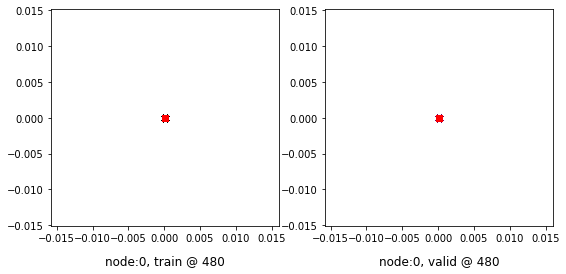

480 	 1 	 0.67693871 	 0.68656814 	 0.93854064 	 0.94524246 	 0.95474905 	 0.95182151


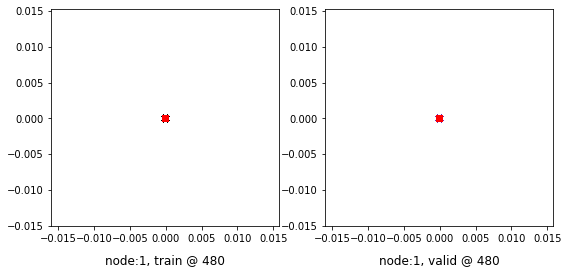

Aggregating on epoch: 481...
Aggregating on epoch: 482...
Aggregating on epoch: 483...
Aggregating on epoch: 484...
Aggregating on epoch: 485...
Aggregating on epoch: 486...
Aggregating on epoch: 487...
Aggregating on epoch: 488...
Aggregating on epoch: 489...
Aggregating on epoch: 490...
Aggregating on epoch: 491...
Aggregating on epoch: 492...
Aggregating on epoch: 493...
Aggregating on epoch: 494...
Aggregating on epoch: 495...
Aggregating on epoch: 496...
Aggregating on epoch: 497...
Aggregating on epoch: 498...
Aggregating on epoch: 499...
Aggregating on epoch: 500...
500 	 0 	 0.78062010 	 0.74769402 	 0.95441991 	 0.95395207 	 0.86694688 	 0.89940524


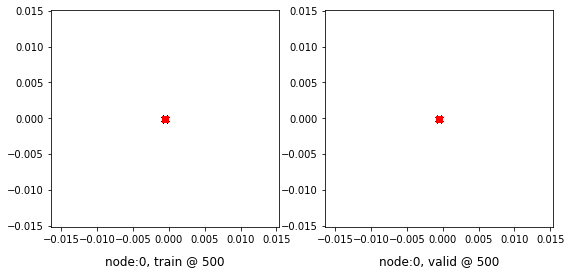

500 	 1 	 0.66441500 	 0.68655014 	 0.92594421 	 0.94522703 	 0.95467657 	 0.95182407


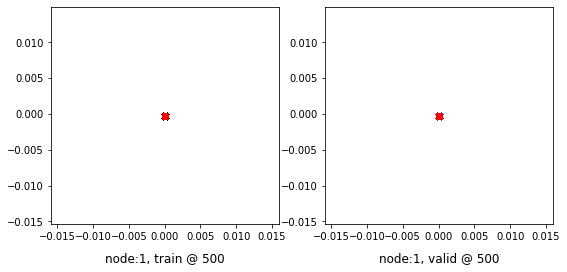

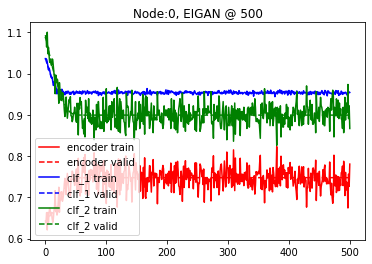

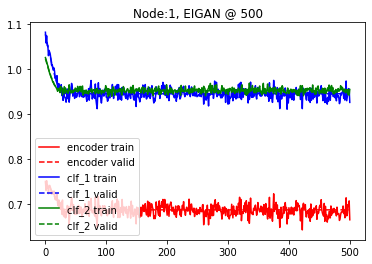

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.8 and delta=3
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.69258714 	 0.71180725 	 1.05525398 	 1.05788553 	 1.05605304 	 1.03922546


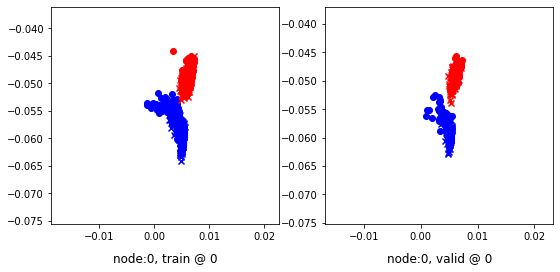

0 	 1 	 0.67306566 	 0.68139291 	 1.05212176 	 1.05343533 	 1.07253635 	 1.06518960


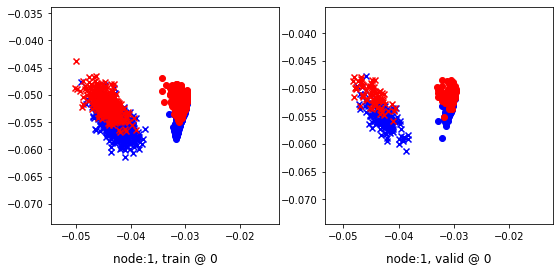

Aggregating on epoch: 3...
Aggregating on epoch: 6...
Aggregating on epoch: 9...
Aggregating on epoch: 12...
Aggregating on epoch: 15...
Aggregating on epoch: 18...
20 	 0 	 0.73317218 	 0.73078460 	 0.98214102 	 0.97979957 	 0.94217569 	 0.94216216


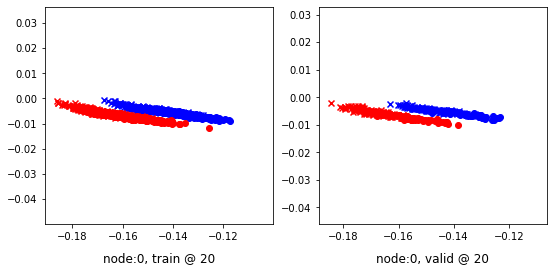

20 	 1 	 0.66858482 	 0.68727666 	 0.94322330 	 0.95855832 	 0.96791542 	 0.96442884


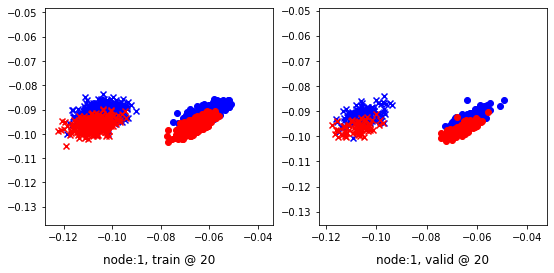

Aggregating on epoch: 21...
Aggregating on epoch: 24...
Aggregating on epoch: 27...
Aggregating on epoch: 30...
Aggregating on epoch: 33...
Aggregating on epoch: 36...
Aggregating on epoch: 39...
40 	 0 	 0.78226650 	 0.74491477 	 0.95738930 	 0.95314437 	 0.86833042 	 0.90137678


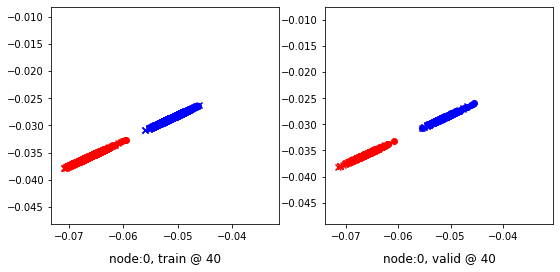

40 	 1 	 0.67199236 	 0.68659115 	 0.92660093 	 0.94529313 	 0.94775957 	 0.95184916


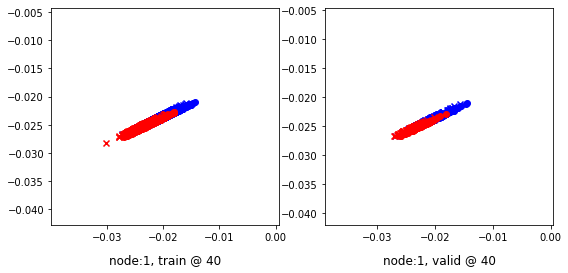

Aggregating on epoch: 42...
Aggregating on epoch: 45...
Aggregating on epoch: 48...
Aggregating on epoch: 51...
Aggregating on epoch: 54...
Aggregating on epoch: 57...
Aggregating on epoch: 60...
60 	 0 	 0.71516824 	 0.74760431 	 0.94718856 	 0.95386344 	 0.92517740 	 0.89940631


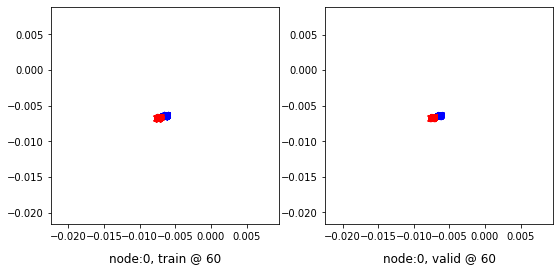

60 	 1 	 0.68800336 	 0.68655032 	 0.94505703 	 0.94522989 	 0.95020127 	 0.95182675


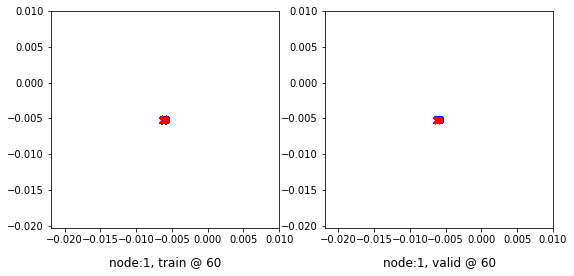

Aggregating on epoch: 63...
Aggregating on epoch: 66...
Aggregating on epoch: 69...
Aggregating on epoch: 72...
Aggregating on epoch: 75...
Aggregating on epoch: 78...
80 	 0 	 0.71987623 	 0.74758184 	 0.95208591 	 0.95384520 	 0.92536342 	 0.89941055


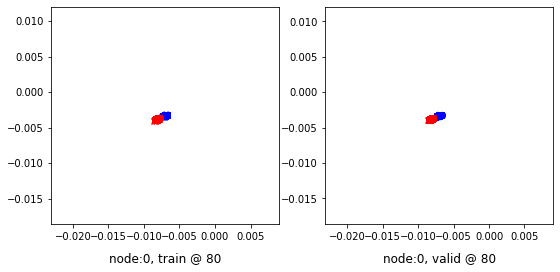

80 	 1 	 0.67901373 	 0.68654245 	 0.93351316 	 0.94522870 	 0.94764751 	 0.95183343


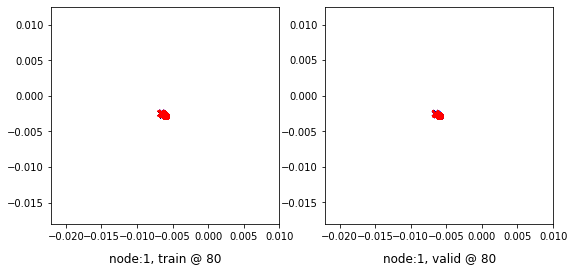

Aggregating on epoch: 81...
Aggregating on epoch: 84...
Aggregating on epoch: 87...
Aggregating on epoch: 90...
Aggregating on epoch: 93...
Aggregating on epoch: 96...
Aggregating on epoch: 99...
100 	 0 	 0.77662140 	 0.74761671 	 0.95033664 	 0.95387721 	 0.86686915 	 0.89940768


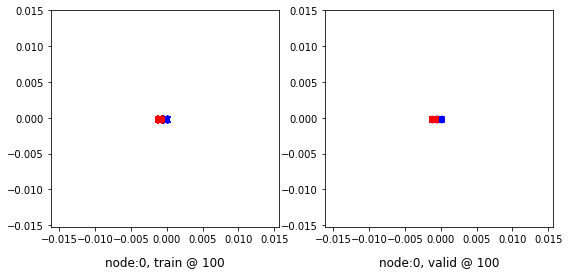

100 	 1 	 0.66287905 	 0.68654341 	 0.93350017 	 0.94522911 	 0.96376997 	 0.95183289


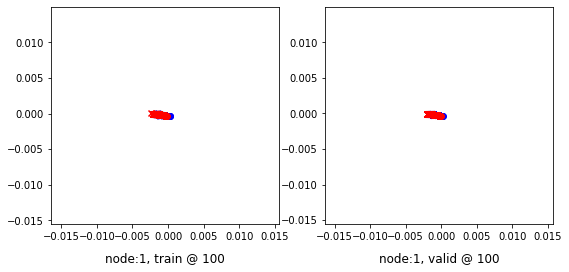

Aggregating on epoch: 102...
Aggregating on epoch: 105...
Aggregating on epoch: 108...
Aggregating on epoch: 111...
Aggregating on epoch: 114...
Aggregating on epoch: 117...
Aggregating on epoch: 120...
120 	 0 	 0.73253512 	 0.74762040 	 0.95433223 	 0.95387238 	 0.91495466 	 0.89939916


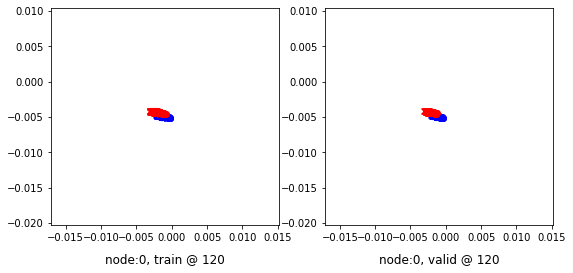

120 	 1 	 0.67831212 	 0.68645382 	 0.93863952 	 0.94522315 	 0.95348632 	 0.95191652


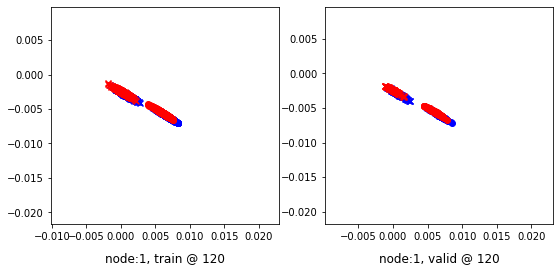

Aggregating on epoch: 123...
Aggregating on epoch: 126...
Aggregating on epoch: 129...
Aggregating on epoch: 132...
Aggregating on epoch: 135...
Aggregating on epoch: 138...
140 	 0 	 0.76052016 	 0.74646699 	 0.95129257 	 0.95271915 	 0.88405836 	 0.89939934


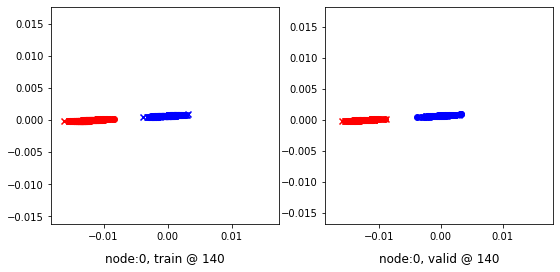

140 	 1 	 0.69117981 	 0.68648750 	 0.95146662 	 0.94520426 	 0.95343965 	 0.95186394


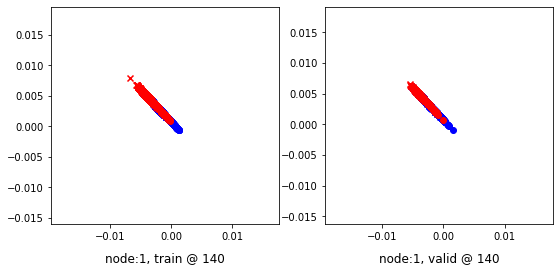

Aggregating on epoch: 141...
Aggregating on epoch: 144...
Aggregating on epoch: 147...
Aggregating on epoch: 150...
Aggregating on epoch: 153...
Aggregating on epoch: 156...
Aggregating on epoch: 159...
160 	 0 	 0.75412631 	 0.74657863 	 0.95179319 	 0.95282859 	 0.89093924 	 0.89939713


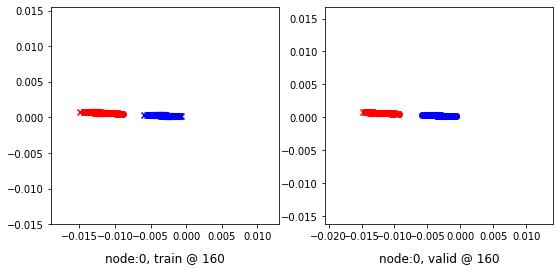

160 	 1 	 0.67198479 	 0.68651104 	 0.93992507 	 0.94521326 	 0.96109056 	 0.95184940


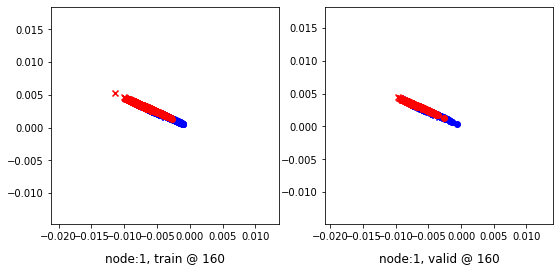

Aggregating on epoch: 162...
Aggregating on epoch: 165...
Aggregating on epoch: 168...
Aggregating on epoch: 171...
Aggregating on epoch: 174...
Aggregating on epoch: 177...
Aggregating on epoch: 180...
180 	 0 	 0.73338628 	 0.74602139 	 0.94802403 	 0.95226693 	 0.90806073 	 0.89939272


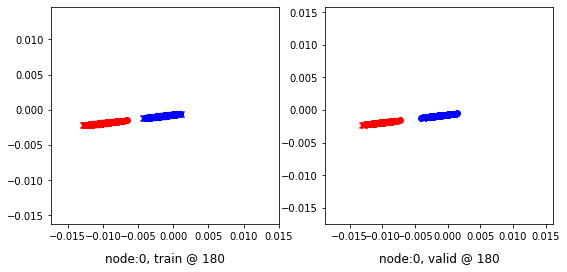

180 	 1 	 0.66989744 	 0.68654191 	 0.92951107 	 0.94523335 	 0.95276225 	 0.95183861


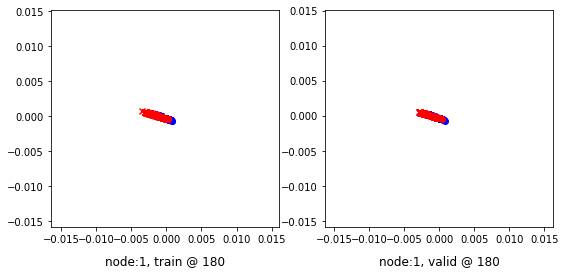

Aggregating on epoch: 183...
Aggregating on epoch: 186...
Aggregating on epoch: 189...
Aggregating on epoch: 192...
Aggregating on epoch: 195...
Aggregating on epoch: 198...
200 	 0 	 0.73387730 	 0.72125626 	 0.92494667 	 0.92752248 	 0.88751930 	 0.89941341


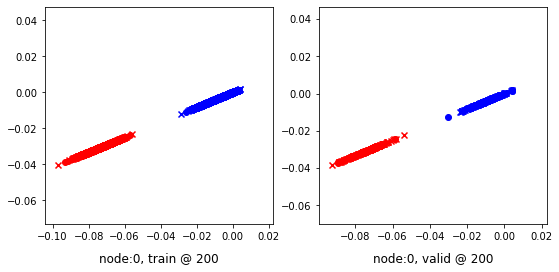

200 	 1 	 0.69313872 	 0.68650419 	 0.94887328 	 0.94518948 	 0.94888562 	 0.95183247


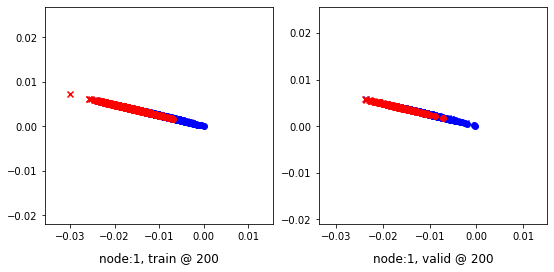

Aggregating on epoch: 201...
Aggregating on epoch: 204...
Aggregating on epoch: 207...
Aggregating on epoch: 210...
Aggregating on epoch: 213...
Aggregating on epoch: 216...
Aggregating on epoch: 219...
220 	 0 	 0.59627467 	 0.58620143 	 0.79119354 	 0.79250079 	 0.90469950 	 0.89944655


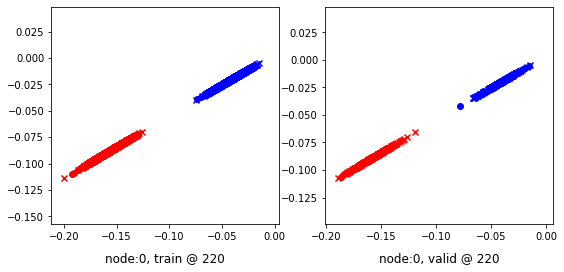

220 	 1 	 0.67901671 	 0.68655169 	 0.93864650 	 0.94525552 	 0.95278007 	 0.95185101


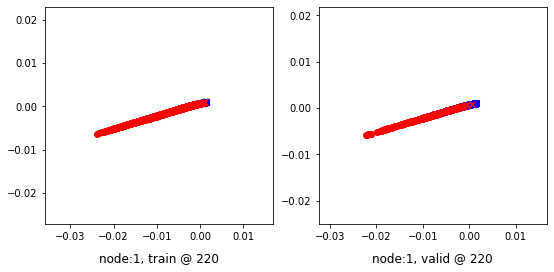

Aggregating on epoch: 222...
Aggregating on epoch: 225...
Aggregating on epoch: 228...
Aggregating on epoch: 231...
Aggregating on epoch: 234...
Aggregating on epoch: 237...
Aggregating on epoch: 240...
240 	 0 	 0.61688626 	 0.55896771 	 0.76337421 	 0.76517856 	 0.88407642 	 0.89935803


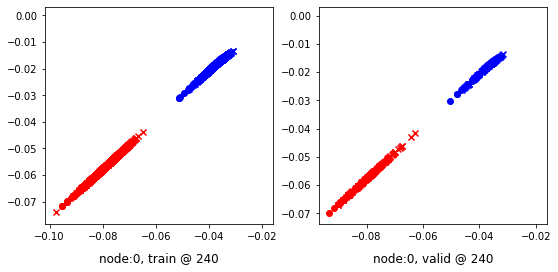

240 	 1 	 0.67657900 	 0.68659657 	 0.94001812 	 0.94529504 	 0.95659113 	 0.95184565


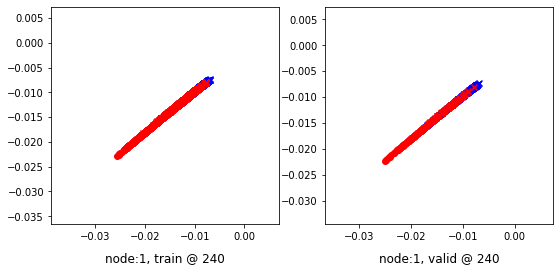

Aggregating on epoch: 243...
Aggregating on epoch: 246...
Aggregating on epoch: 249...
Aggregating on epoch: 252...
Aggregating on epoch: 255...
Aggregating on epoch: 258...
260 	 0 	 0.63301933 	 0.63895553 	 0.83558500 	 0.84525162 	 0.90468878 	 0.89944327


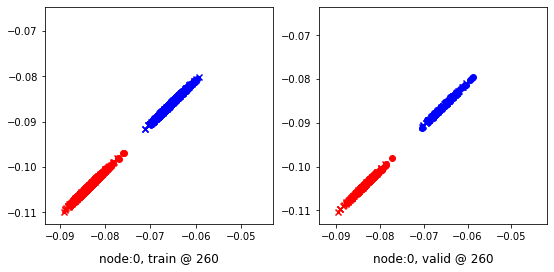

260 	 1 	 0.69443864 	 0.68653345 	 0.95406598 	 0.94521505 	 0.95277703 	 0.95182878


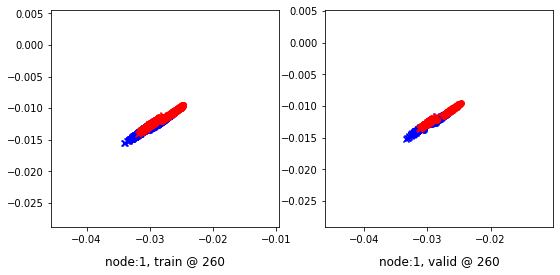

Aggregating on epoch: 261...
Aggregating on epoch: 264...
Aggregating on epoch: 267...
Aggregating on epoch: 270...
Aggregating on epoch: 273...
Aggregating on epoch: 276...
Aggregating on epoch: 279...
280 	 0 	 0.76938134 	 0.74214184 	 0.94907773 	 0.94839764 	 0.87721050 	 0.89940298


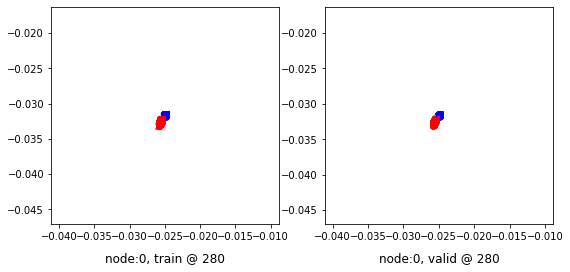

280 	 1 	 0.69752544 	 0.68649733 	 0.95400530 	 0.94519931 	 0.94962895 	 0.95184916


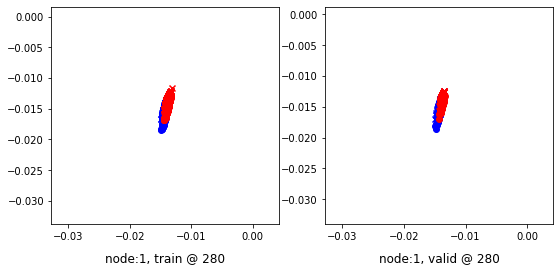

Aggregating on epoch: 282...
Aggregating on epoch: 285...
Aggregating on epoch: 288...
Aggregating on epoch: 291...
Aggregating on epoch: 294...
Aggregating on epoch: 297...
Aggregating on epoch: 300...
300 	 0 	 0.77110887 	 0.74708354 	 0.95168537 	 0.95334244 	 0.87379700 	 0.89940608


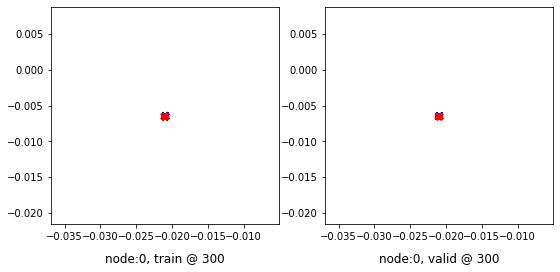

300 	 1 	 0.69889772 	 0.68654734 	 0.95407814 	 0.94523042 	 0.94832772 	 0.95183027


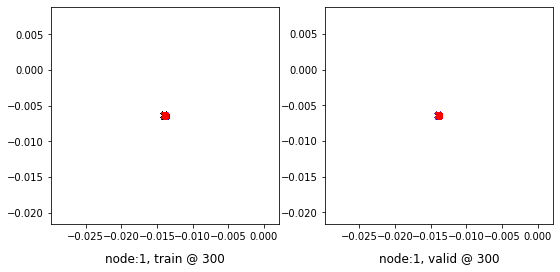

Aggregating on epoch: 303...
Aggregating on epoch: 306...
Aggregating on epoch: 309...
Aggregating on epoch: 312...
Aggregating on epoch: 315...
Aggregating on epoch: 318...
320 	 0 	 0.73960394 	 0.74755520 	 0.95456100 	 0.95381439 	 0.90809011 	 0.89940637


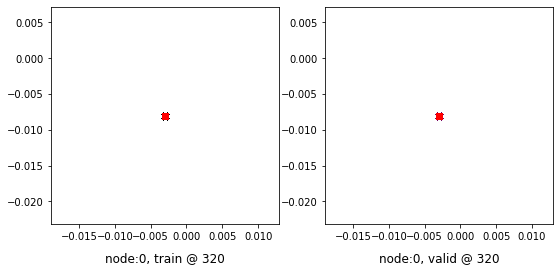

320 	 1 	 0.69445193 	 0.68655008 	 0.95664603 	 0.94522846 	 0.95534182 	 0.95182556


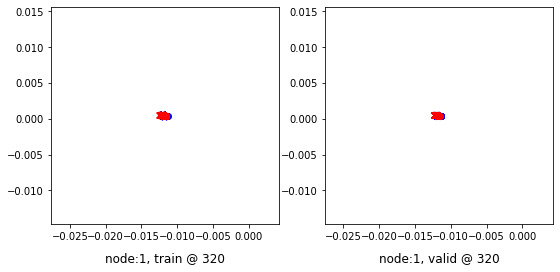

Aggregating on epoch: 321...
Aggregating on epoch: 324...
Aggregating on epoch: 327...
Aggregating on epoch: 330...
Aggregating on epoch: 333...
Aggregating on epoch: 336...
Aggregating on epoch: 339...
340 	 0 	 0.71469438 	 0.74773568 	 0.95044410 	 0.95400506 	 0.92889118 	 0.89941657


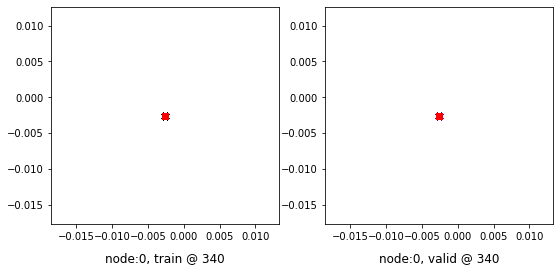

340 	 1 	 0.68984658 	 0.68654978 	 0.94248080 	 0.94523102 	 0.94578153 	 0.95182842


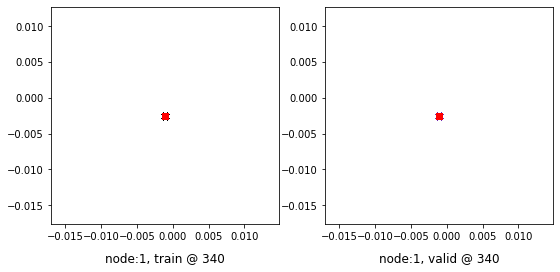

Aggregating on epoch: 342...
Aggregating on epoch: 345...
Aggregating on epoch: 348...
Aggregating on epoch: 351...
Aggregating on epoch: 354...
Aggregating on epoch: 357...
Aggregating on epoch: 360...
360 	 0 	 0.75629157 	 0.74768800 	 0.94709110 	 0.95395082 	 0.88403124 	 0.89941001


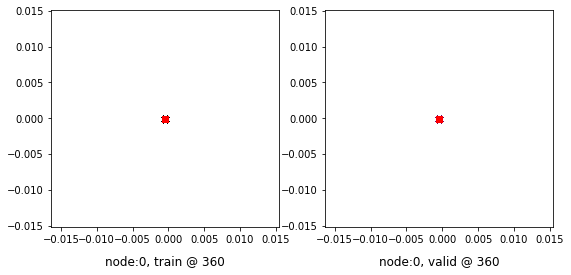

360 	 1 	 0.67592090 	 0.68655014 	 0.93103725 	 0.94522709 	 0.94826370 	 0.95182413


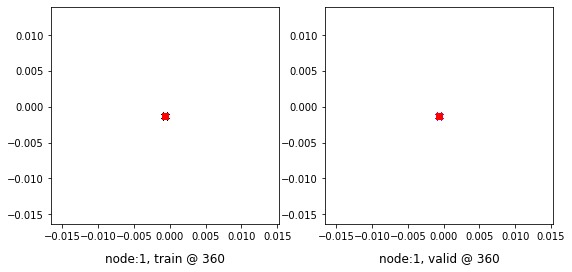

Aggregating on epoch: 363...
Aggregating on epoch: 366...
Aggregating on epoch: 369...
Aggregating on epoch: 372...
Aggregating on epoch: 375...
Aggregating on epoch: 378...
380 	 0 	 0.72963732 	 0.74768192 	 0.94798398 	 0.95394260 	 0.91153860 	 0.89940786


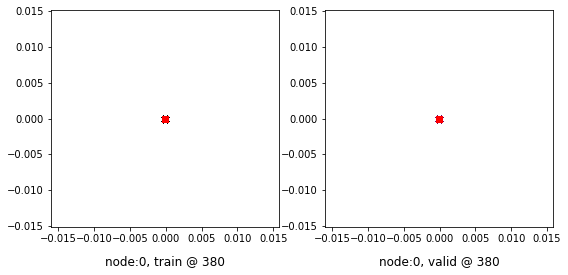

380 	 1 	 0.69247174 	 0.68654966 	 0.94763315 	 0.94523072 	 0.94830847 	 0.95182824


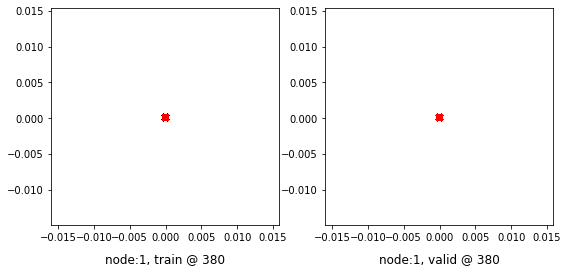

Aggregating on epoch: 381...
Aggregating on epoch: 384...
Aggregating on epoch: 387...
Aggregating on epoch: 390...
Aggregating on epoch: 393...
Aggregating on epoch: 396...
Aggregating on epoch: 399...
400 	 0 	 0.72036505 	 0.74768043 	 0.95258296 	 0.95394617 	 0.92537224 	 0.89941293


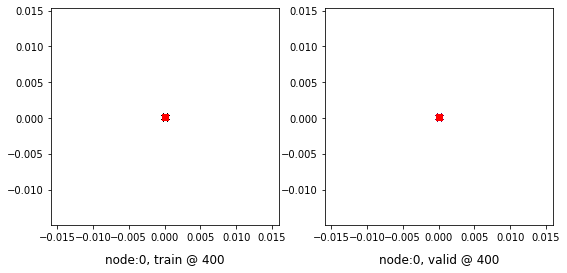

400 	 1 	 0.69572061 	 0.68655449 	 0.95404363 	 0.94522917 	 0.95147020 	 0.95182186


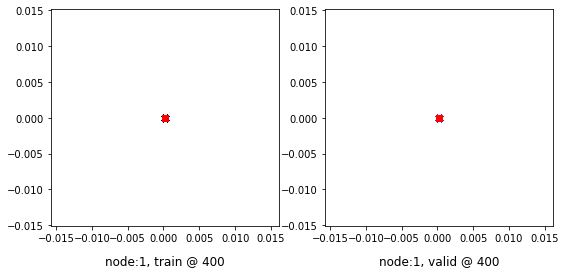

Aggregating on epoch: 402...
Aggregating on epoch: 405...
Aggregating on epoch: 408...
Aggregating on epoch: 411...
Aggregating on epoch: 414...
Aggregating on epoch: 417...
Aggregating on epoch: 420...
420 	 0 	 0.74796122 	 0.74770242 	 0.95946169 	 0.95396376 	 0.90467024 	 0.89940852


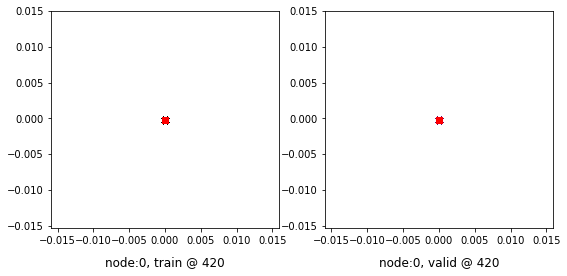

420 	 1 	 0.68030828 	 0.68655252 	 0.94123048 	 0.94522727 	 0.95406932 	 0.95182192


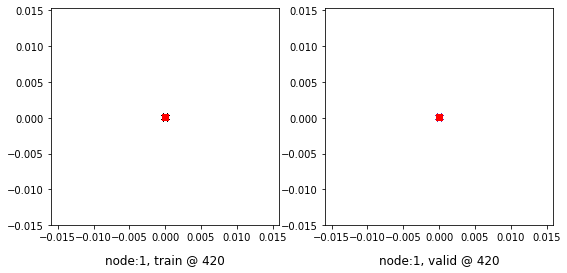

Aggregating on epoch: 423...
Aggregating on epoch: 426...
Aggregating on epoch: 429...
Aggregating on epoch: 432...
Aggregating on epoch: 435...
Aggregating on epoch: 438...
440 	 0 	 0.68561196 	 0.74769324 	 0.95906782 	 0.95395732 	 0.96667391 	 0.89941126


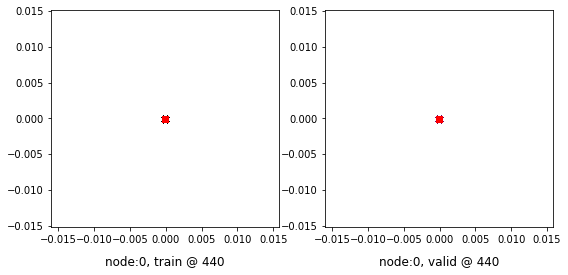

440 	 1 	 0.69382471 	 0.68655413 	 0.95152920 	 0.94523448 	 0.95085186 	 0.95182753


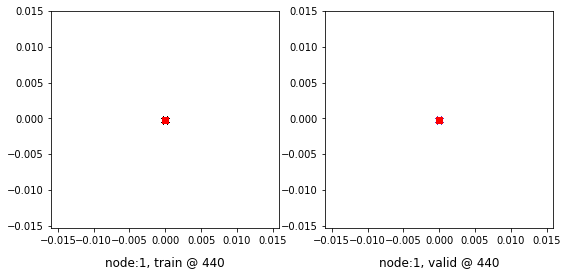

Aggregating on epoch: 441...
Aggregating on epoch: 444...
Aggregating on epoch: 447...
Aggregating on epoch: 450...
Aggregating on epoch: 453...
Aggregating on epoch: 456...
Aggregating on epoch: 459...
460 	 0 	 0.71492463 	 0.74769020 	 0.95039356 	 0.95394880 	 0.92865199 	 0.89940578


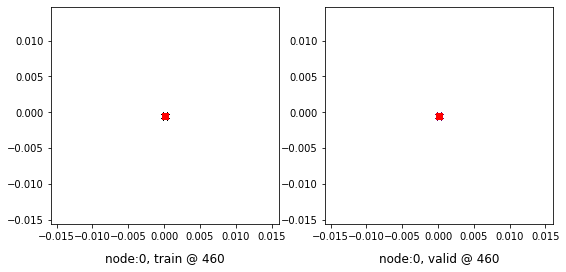

460 	 1 	 0.70088613 	 0.68655181 	 0.95668995 	 0.94523275 	 0.94895118 	 0.95182812


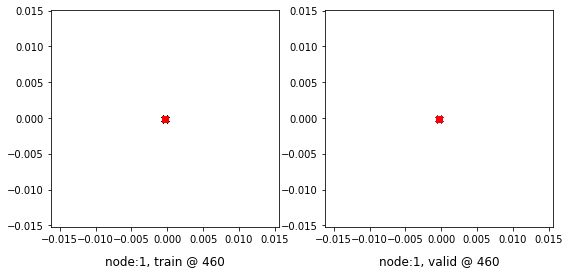

Aggregating on epoch: 462...
Aggregating on epoch: 465...
Aggregating on epoch: 468...
Aggregating on epoch: 471...
Aggregating on epoch: 474...
Aggregating on epoch: 477...
Aggregating on epoch: 480...
480 	 0 	 0.76587760 	 0.74768096 	 0.95334250 	 0.95394224 	 0.88060945 	 0.89940846


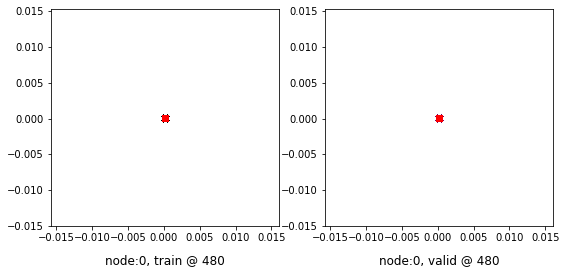

480 	 1 	 0.67516816 	 0.68655360 	 0.93608689 	 0.94522834 	 0.95406586 	 0.95182192


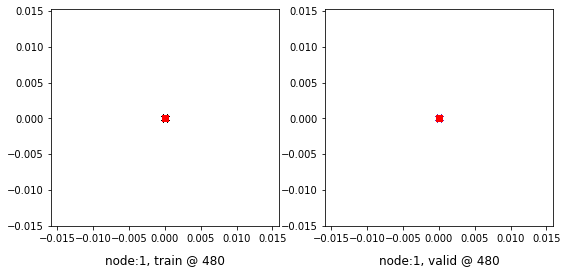

Aggregating on epoch: 483...
Aggregating on epoch: 486...
Aggregating on epoch: 489...
Aggregating on epoch: 492...
Aggregating on epoch: 495...
Aggregating on epoch: 498...
500 	 0 	 0.74214804 	 0.74770248 	 0.95367837 	 0.95396429 	 0.90467876 	 0.89940900


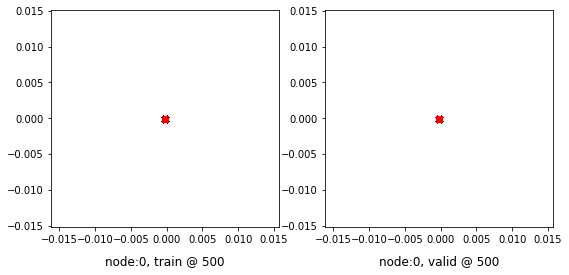

500 	 1 	 0.68518865 	 0.68653160 	 0.93739092 	 0.94522750 	 0.94534963 	 0.95184308


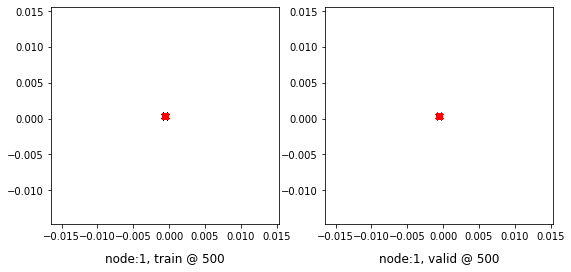

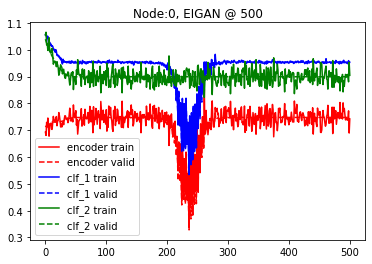

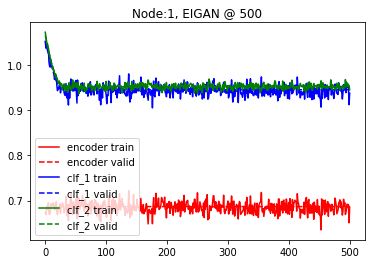

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.8 and delta=5
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.63351023 	 0.63576508 	 1.02233768 	 1.02183473 	 1.08218861 	 1.07921684


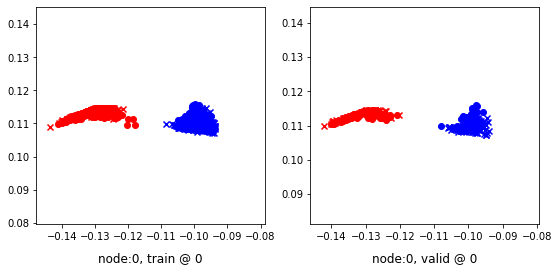

0 	 1 	 0.72137666 	 0.71510053 	 1.06009674 	 1.05620861 	 1.03215277 	 1.03425527


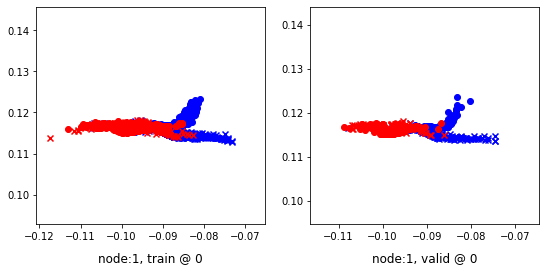

Aggregating on epoch: 5...
Aggregating on epoch: 10...
Aggregating on epoch: 15...
Aggregating on epoch: 20...
20 	 0 	 0.66172767 	 0.64769602 	 0.95397848 	 0.95277196 	 0.98556042 	 0.99822313


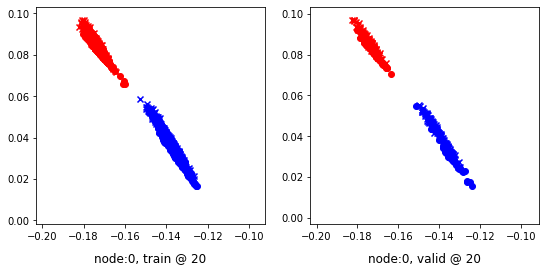

20 	 1 	 0.70192826 	 0.70538336 	 0.95959449 	 0.96406567 	 0.95090765 	 0.95182949


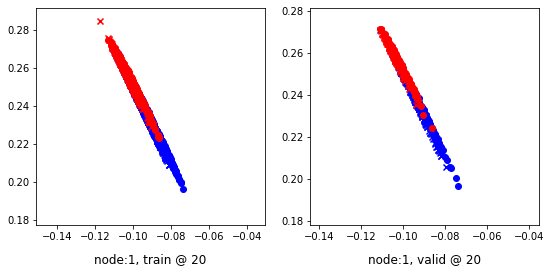

Aggregating on epoch: 25...
Aggregating on epoch: 30...
Aggregating on epoch: 35...
Aggregating on epoch: 40...
40 	 0 	 0.70993274 	 0.70881754 	 0.94790918 	 0.94750905 	 0.93164372 	 0.93183869


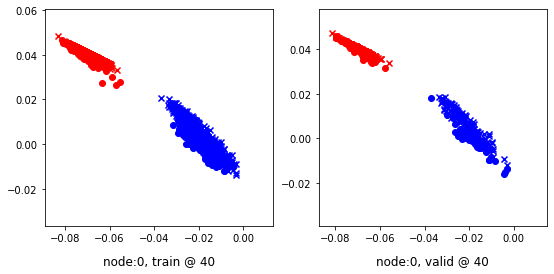

40 	 1 	 0.70073712 	 0.68737930 	 0.95984679 	 0.94621319 	 0.95228004 	 0.95198107


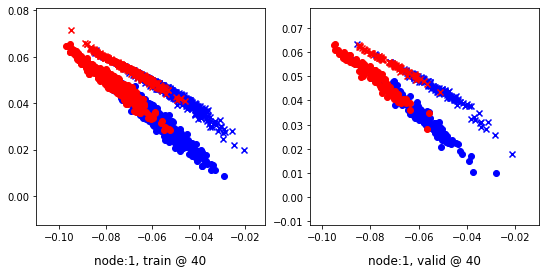

Aggregating on epoch: 45...
Aggregating on epoch: 50...
Aggregating on epoch: 55...
Aggregating on epoch: 60...
60 	 0 	 0.69242460 	 0.70834470 	 0.91508347 	 0.91625243 	 0.91853708 	 0.90105492


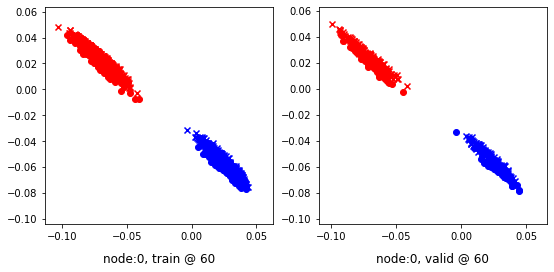

60 	 1 	 0.70322514 	 0.68621761 	 0.95348305 	 0.94489473 	 0.94341469 	 0.95182431


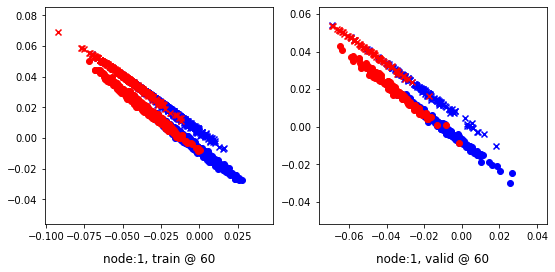

Aggregating on epoch: 65...
Aggregating on epoch: 70...
Aggregating on epoch: 75...
Aggregating on epoch: 80...
80 	 0 	 0.52884626 	 0.49497610 	 0.70463109 	 0.70162541 	 0.88482511 	 0.89979649


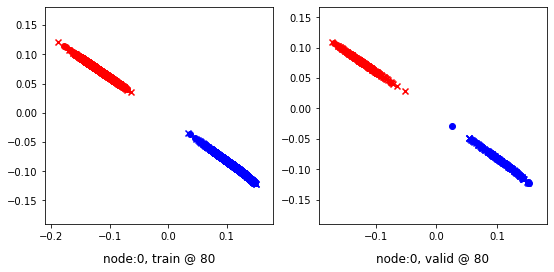

80 	 1 	 0.65768147 	 0.68122530 	 0.92340875 	 0.93973947 	 0.95917541 	 0.95166135


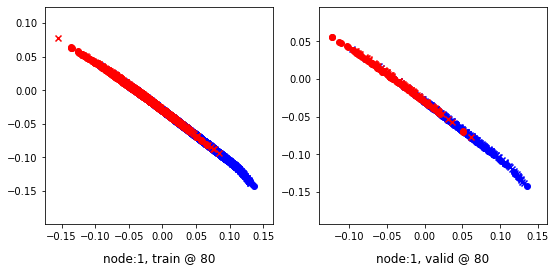

Aggregating on epoch: 85...
Aggregating on epoch: 90...
Aggregating on epoch: 95...
Aggregating on epoch: 100...
100 	 0 	 0.08005404 	 0.08122060 	 0.28915489 	 0.28763267 	 0.91161835 	 0.89955926


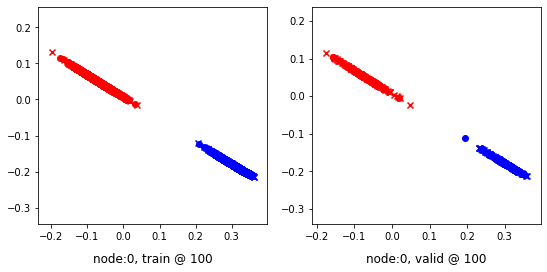

100 	 1 	 0.58220828 	 0.56559235 	 0.82960999 	 0.82314479 	 0.94886297 	 0.95069963


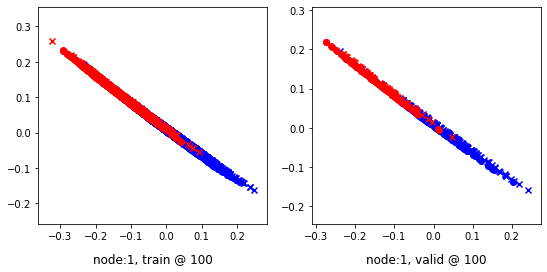

Aggregating on epoch: 105...
Aggregating on epoch: 110...
Aggregating on epoch: 115...
Aggregating on epoch: 120...
120 	 0 	 0.45799136 	 0.31556195 	 0.53556353 	 0.52198786 	 0.88105839 	 0.89957309


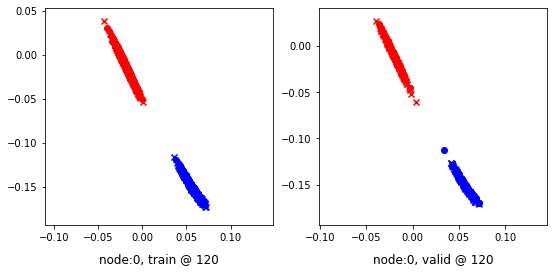

120 	 1 	 0.57858479 	 0.45556265 	 0.74622637 	 0.71564233 	 0.94676185 	 0.95322686


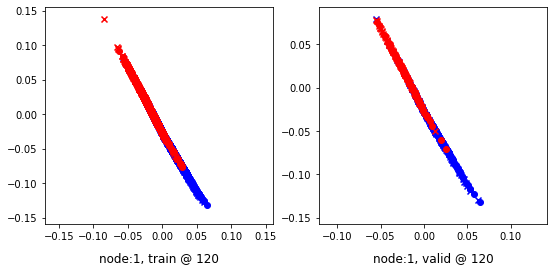

Aggregating on epoch: 125...
Aggregating on epoch: 130...
Aggregating on epoch: 135...
Aggregating on epoch: 140...
140 	 0 	 0.23403829 	 0.22821701 	 0.43117806 	 0.43447608 	 0.90807766 	 0.89940625


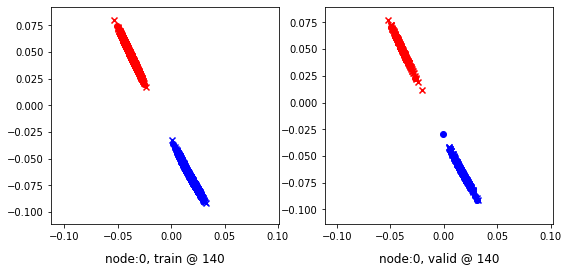

140 	 1 	 0.43340737 	 0.43293911 	 0.69063592 	 0.68896979 	 0.95393866 	 0.94917786


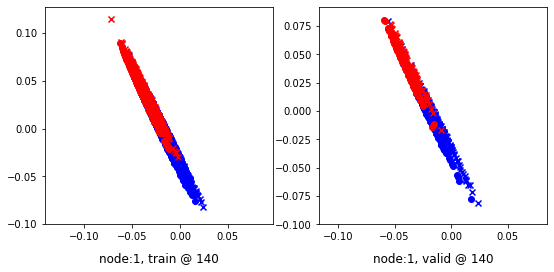

Aggregating on epoch: 145...
Aggregating on epoch: 150...
Aggregating on epoch: 155...
Aggregating on epoch: 160...
160 	 0 	 0.39248818 	 0.33711219 	 0.54731739 	 0.54331344 	 0.89437068 	 0.89934844


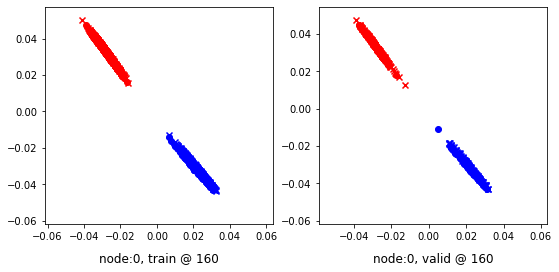

160 	 1 	 0.75400305 	 0.61629432 	 0.91966975 	 0.87633693 	 0.95338535 	 0.95318979


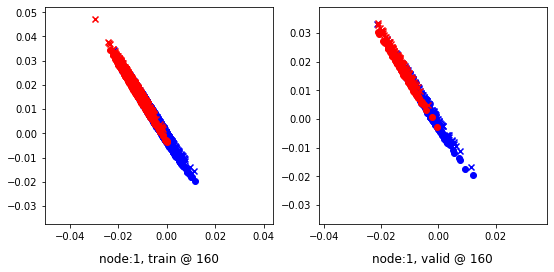

Aggregating on epoch: 165...
Aggregating on epoch: 170...
Aggregating on epoch: 175...
Aggregating on epoch: 180...
180 	 0 	 0.28343624 	 0.24869660 	 0.44809580 	 0.45475885 	 0.88714069 	 0.89920944


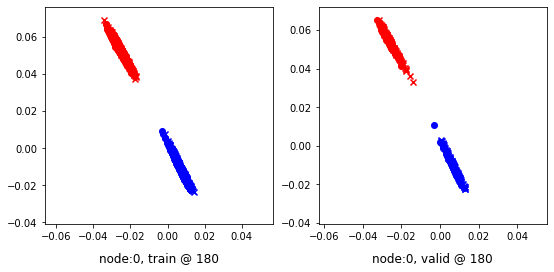

180 	 1 	 0.49314910 	 0.51049560 	 0.74370962 	 0.76722556 	 0.95123267 	 0.94987714


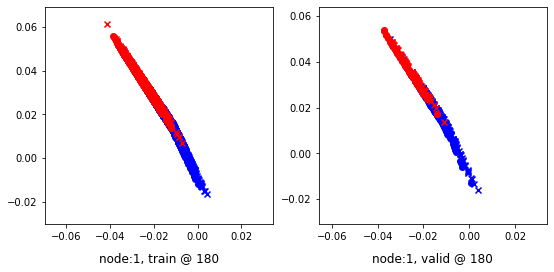

Aggregating on epoch: 185...
Aggregating on epoch: 190...
Aggregating on epoch: 195...
Aggregating on epoch: 200...
200 	 0 	 0.04986730 	 0.04282267 	 0.23839116 	 0.24927087 	 0.91202569 	 0.89959538


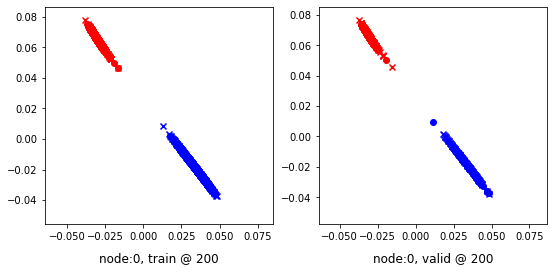

200 	 1 	 0.39541060 	 0.40099794 	 0.65678674 	 0.66102630 	 0.95809048 	 0.95317554


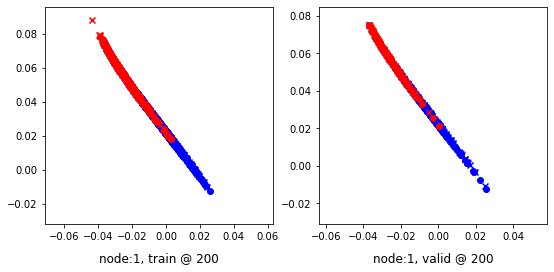

Aggregating on epoch: 205...
Aggregating on epoch: 210...
Aggregating on epoch: 215...
Aggregating on epoch: 220...
220 	 0 	 0.00717726 	 -0.02912836 	 0.16615485 	 0.17694052 	 0.86906368 	 0.89921606


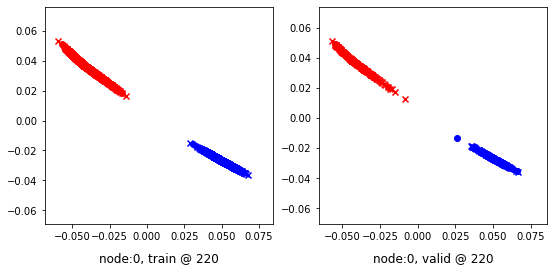

220 	 1 	 0.35370773 	 0.34772605 	 0.62163222 	 0.60746312 	 0.94736814 	 0.95288426


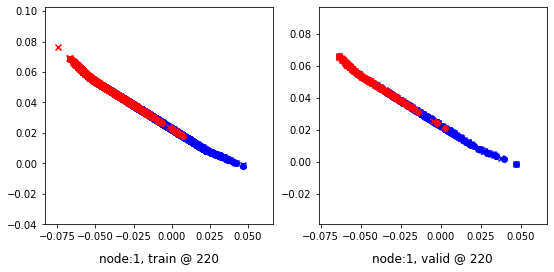

Aggregating on epoch: 225...
Aggregating on epoch: 230...
Aggregating on epoch: 235...
Aggregating on epoch: 240...
240 	 0 	 0.19637448 	 0.14421776 	 0.35417491 	 0.35049555 	 0.89069068 	 0.89942497


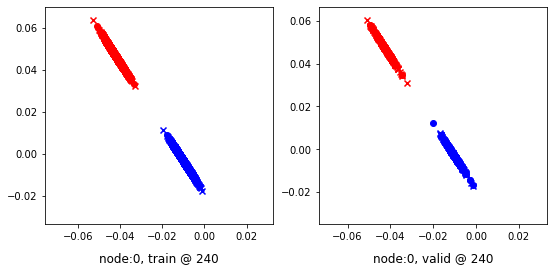

240 	 1 	 0.45312816 	 0.43120629 	 0.71342212 	 0.69022101 	 0.95336467 	 0.95216191


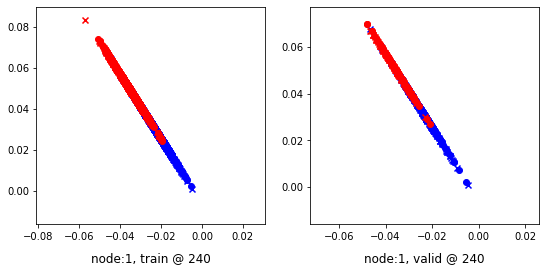

Aggregating on epoch: 245...
Aggregating on epoch: 250...
Aggregating on epoch: 255...
Aggregating on epoch: 260...
260 	 0 	 0.09006464 	 0.01604266 	 0.22497311 	 0.22248603 	 0.88281858 	 0.89959055


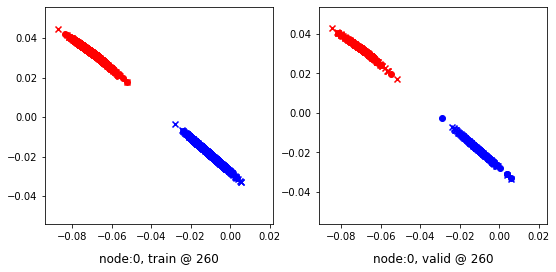

260 	 1 	 0.32591122 	 0.31152177 	 0.57335460 	 0.57074088 	 0.95961595 	 0.95236629


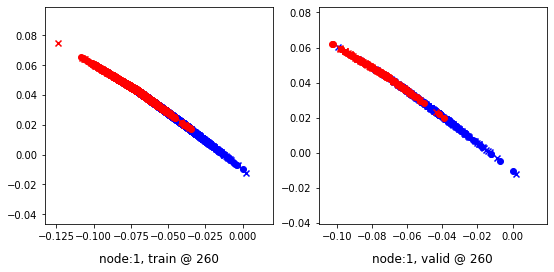

Aggregating on epoch: 265...
Aggregating on epoch: 270...
Aggregating on epoch: 275...
Aggregating on epoch: 280...
280 	 0 	 0.38625997 	 0.23660773 	 0.44054961 	 0.44289917 	 0.87019658 	 0.89943862


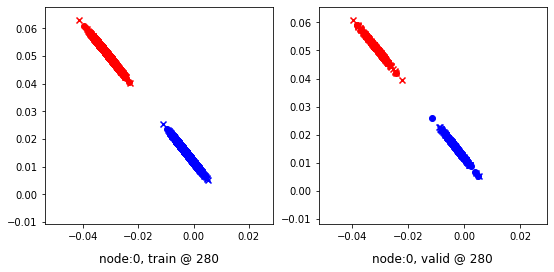

280 	 1 	 0.74156785 	 0.48994613 	 0.80196124 	 0.74889594 	 0.94501299 	 0.95209700


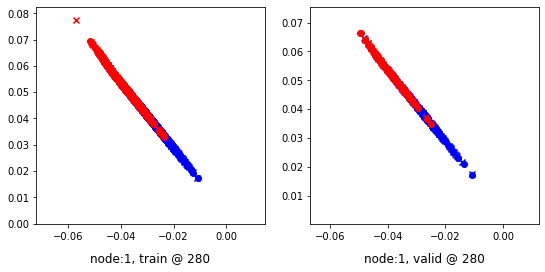

Aggregating on epoch: 285...
Aggregating on epoch: 290...
Aggregating on epoch: 295...
Aggregating on epoch: 300...
300 	 0 	 1.05698526 	 0.84814656 	 1.12606394 	 1.05438900 	 0.89783269 	 0.89938962


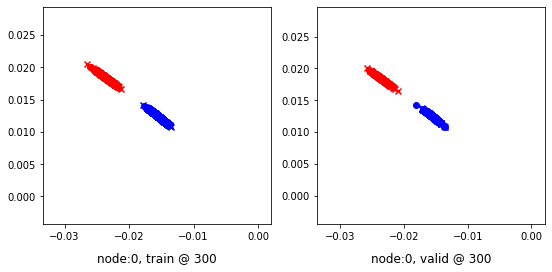

300 	 1 	 0.70536876 	 0.70410788 	 0.93479139 	 0.96252358 	 0.94622940 	 0.95156288


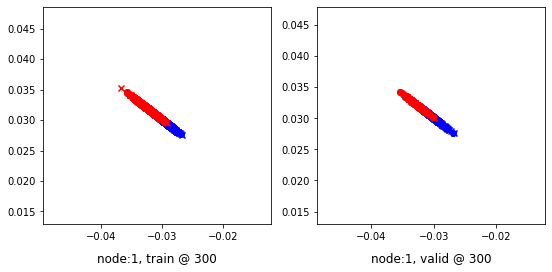

Aggregating on epoch: 305...
Aggregating on epoch: 310...
Aggregating on epoch: 315...
Aggregating on epoch: 320...
320 	 0 	 0.54546958 	 0.50647593 	 0.72009820 	 0.71277475 	 0.92551023 	 0.89944601


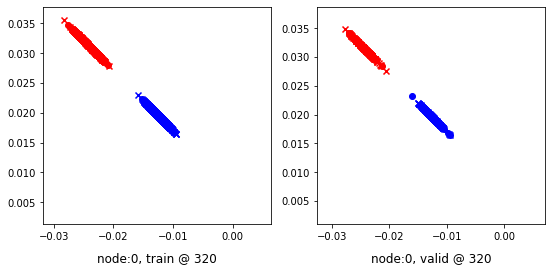

320 	 1 	 0.67068523 	 0.64340287 	 0.92732251 	 0.90188360 	 0.95504194 	 0.95162791


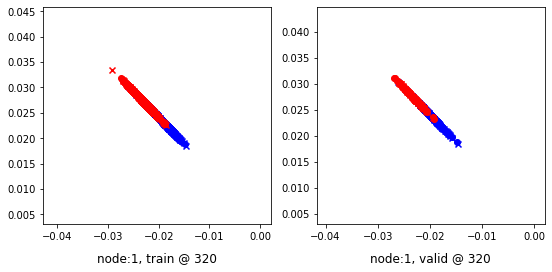

Aggregating on epoch: 325...
Aggregating on epoch: 330...
Aggregating on epoch: 335...
Aggregating on epoch: 340...
340 	 0 	 1.50386488 	 1.19888496 	 1.55496144 	 1.40517068 	 0.89780712 	 0.89943296


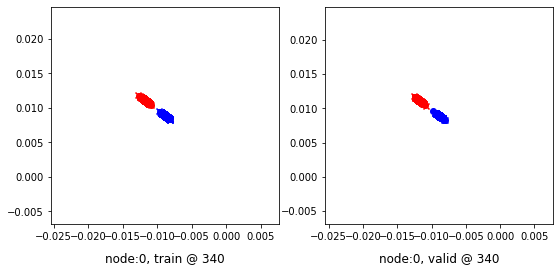

340 	 1 	 0.56939369 	 0.54721624 	 0.82311809 	 0.80550951 	 0.96080369 	 0.95144045


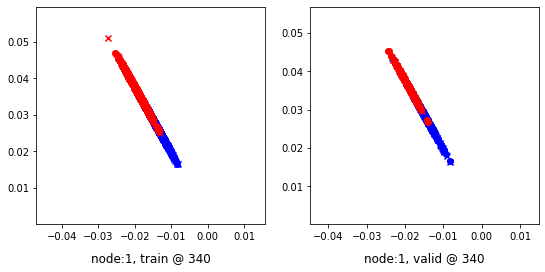

Aggregating on epoch: 345...
Aggregating on epoch: 350...
Aggregating on epoch: 355...
Aggregating on epoch: 360...
360 	 0 	 0.90888041 	 0.84479821 	 1.09426403 	 1.05107665 	 0.93230385 	 0.89942563


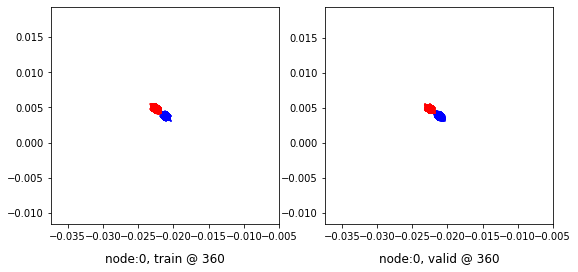

360 	 1 	 0.83526069 	 0.80487263 	 1.06433046 	 1.06372643 	 0.94713646 	 0.95200098


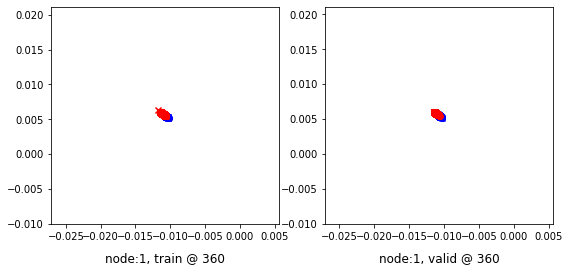

Aggregating on epoch: 365...
Aggregating on epoch: 370...
Aggregating on epoch: 375...
Aggregating on epoch: 380...
380 	 0 	 0.60260433 	 0.58164012 	 0.78673518 	 0.78791112 	 0.88404548 	 0.89941818


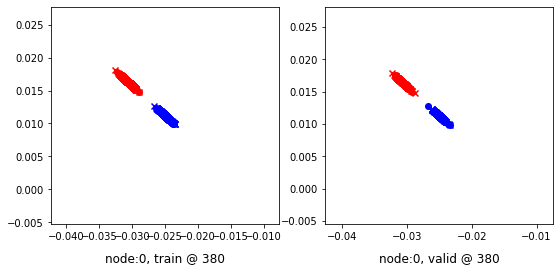

380 	 1 	 0.70273012 	 0.67647576 	 0.95976198 	 0.93517637 	 0.95344299 	 0.95184779


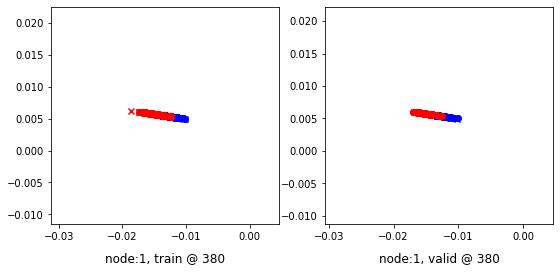

Aggregating on epoch: 385...
Aggregating on epoch: 390...
Aggregating on epoch: 395...
Aggregating on epoch: 400...
400 	 0 	 0.40084970 	 0.36207116 	 0.55903834 	 0.56829304 	 0.87733561 	 0.89936906


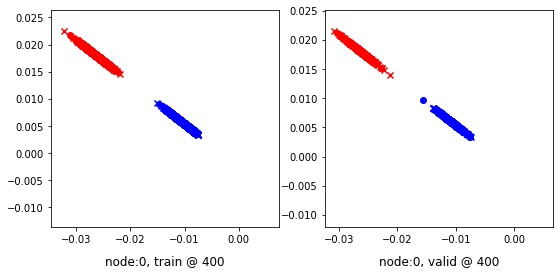

400 	 1 	 0.58905131 	 0.58326560 	 0.84009701 	 0.84152305 	 0.95394689 	 0.95140463


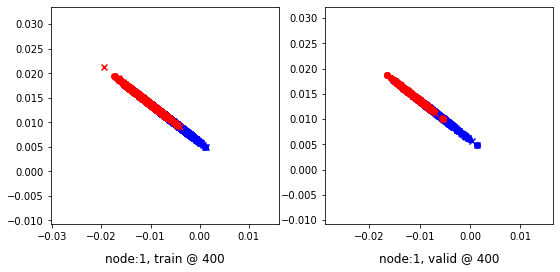

Aggregating on epoch: 405...
Aggregating on epoch: 410...
Aggregating on epoch: 415...
Aggregating on epoch: 420...
420 	 0 	 0.36407399 	 0.26038441 	 0.47957957 	 0.46654883 	 0.91487211 	 0.89931160


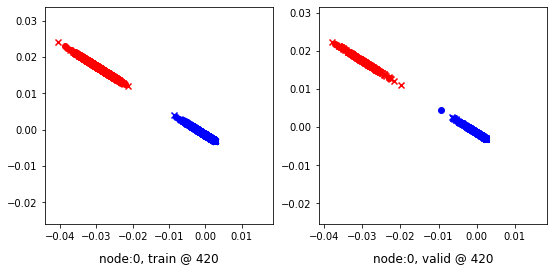

420 	 1 	 0.42021924 	 0.42496598 	 0.67210275 	 0.68201900 	 0.95287013 	 0.95020020


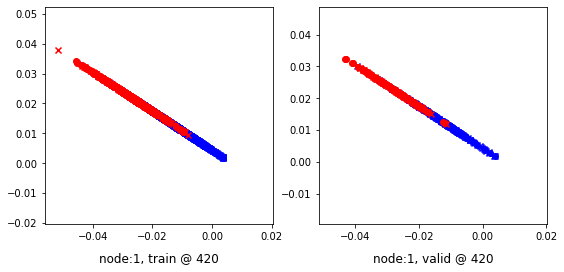

Aggregating on epoch: 425...
Aggregating on epoch: 430...
Aggregating on epoch: 435...
Aggregating on epoch: 440...
440 	 0 	 0.70353818 	 0.68689752 	 0.88508707 	 0.89315706 	 0.88751447 	 0.89940673


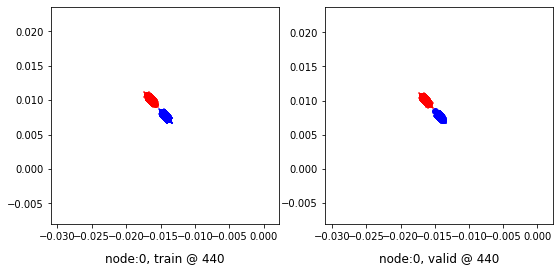

440 	 1 	 0.73056233 	 0.71340996 	 0.98286247 	 0.97208720 	 0.95847625 	 0.95182443


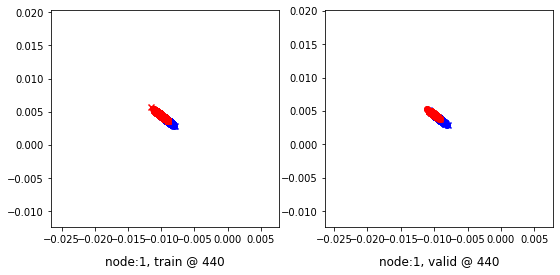

Aggregating on epoch: 445...
Aggregating on epoch: 450...
Aggregating on epoch: 455...
Aggregating on epoch: 460...
460 	 0 	 0.55718696 	 0.47469705 	 0.68984902 	 0.68093765 	 0.87027806 	 0.89938778


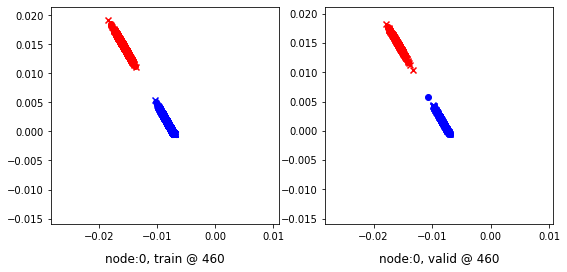

460 	 1 	 0.61785907 	 0.61144674 	 0.87190259 	 0.86980909 	 0.95409888 	 0.95150954


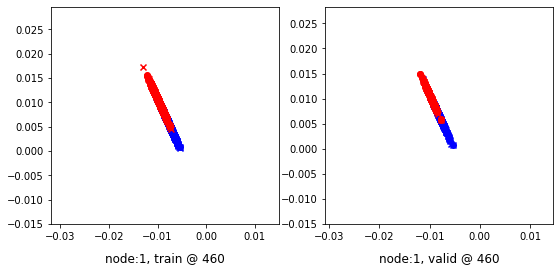

Aggregating on epoch: 465...
Aggregating on epoch: 470...
Aggregating on epoch: 475...
Aggregating on epoch: 480...
480 	 0 	 0.80157578 	 0.51966625 	 0.77054077 	 0.72589958 	 0.89761859 	 0.89938051


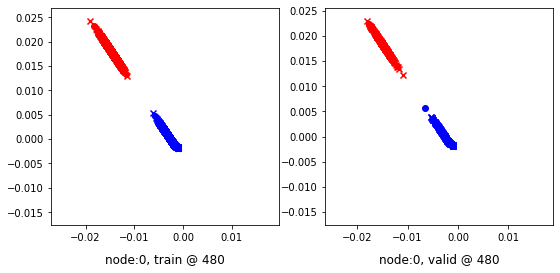

480 	 1 	 0.75511050 	 0.65005839 	 0.90167511 	 0.90814555 	 0.94822860 	 0.95123434


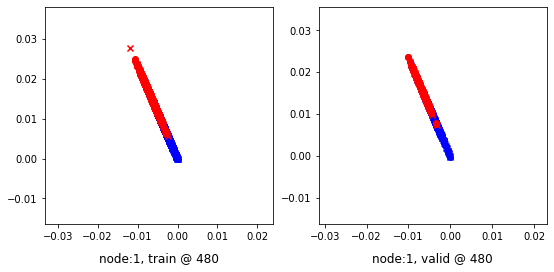

Aggregating on epoch: 485...
Aggregating on epoch: 490...
Aggregating on epoch: 495...
Aggregating on epoch: 500...
500 	 0 	 0.54521871 	 0.51523697 	 0.72594839 	 0.72141212 	 0.91494507 	 0.89932233


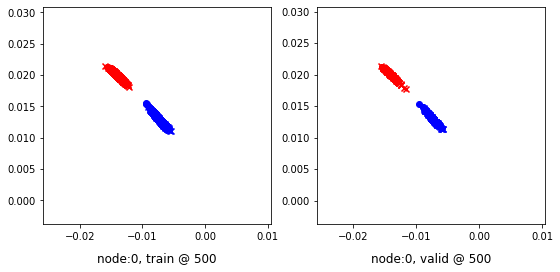

500 	 1 	 0.65247566 	 0.61583656 	 0.89468062 	 0.87293506 	 0.94540334 	 0.95024568


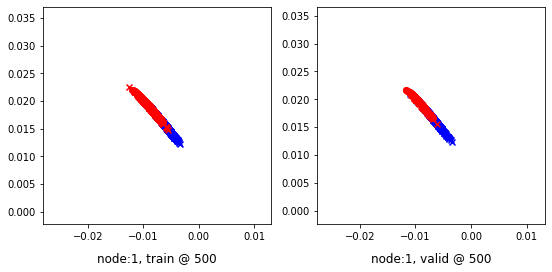

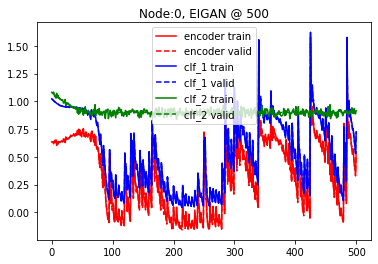

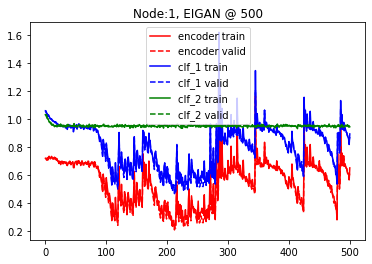

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.8 and delta=7
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.69832850 	 0.70974028 	 1.03936410 	 1.03689039 	 1.03431106 	 1.02029729


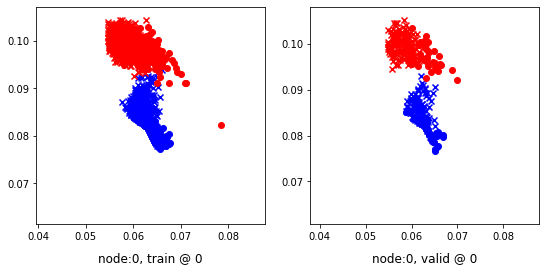

0 	 1 	 0.65938187 	 0.65598083 	 1.00871444 	 0.99954534 	 1.04254377 	 1.03671169


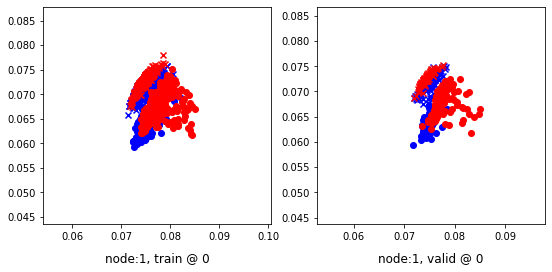

Aggregating on epoch: 7...
Aggregating on epoch: 14...
20 	 0 	 0.68201798 	 0.70902866 	 0.95857316 	 0.96357810 	 0.97008359 	 0.94769663


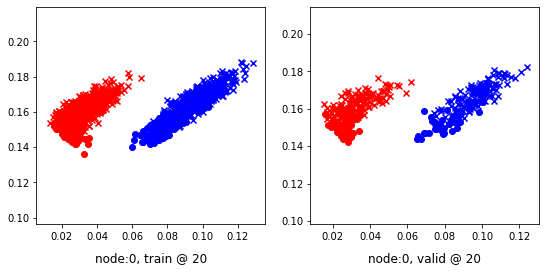

20 	 1 	 0.66181570 	 0.68136978 	 0.93061441 	 0.94509727 	 0.96196377 	 0.95687467


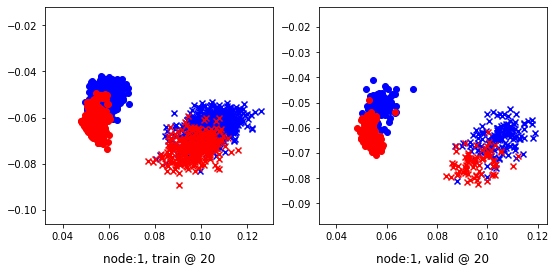

Aggregating on epoch: 21...
Aggregating on epoch: 28...
Aggregating on epoch: 35...
40 	 0 	 0.73696798 	 0.71254951 	 0.92164624 	 0.92382705 	 0.87951905 	 0.90442473


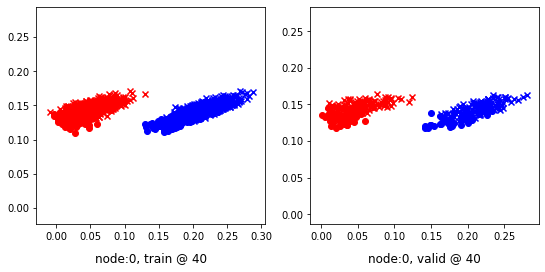

40 	 1 	 0.69176781 	 0.67645800 	 0.94599056 	 0.93550324 	 0.94779950 	 0.95219243


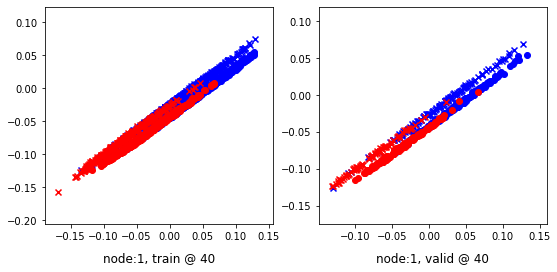

Aggregating on epoch: 42...
Aggregating on epoch: 49...
Aggregating on epoch: 56...
60 	 0 	 0.27238852 	 0.31306136 	 0.52288806 	 0.51988924 	 0.95346969 	 0.89997506


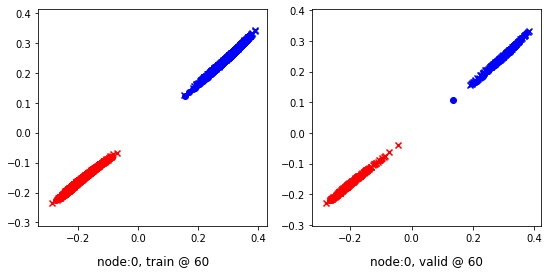

60 	 1 	 0.55818826 	 0.56404841 	 0.81189007 	 0.82442737 	 0.95131713 	 0.95352614


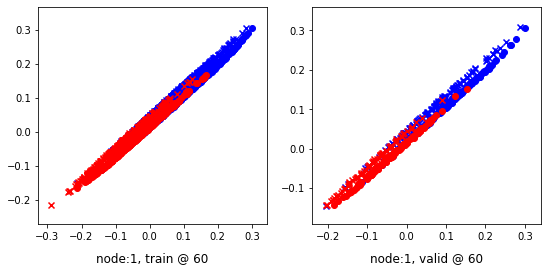

Aggregating on epoch: 63...
Aggregating on epoch: 70...
Aggregating on epoch: 77...
80 	 0 	 -0.11093765 	 -0.06404734 	 0.13025877 	 0.14265507 	 0.93322110 	 0.89984959


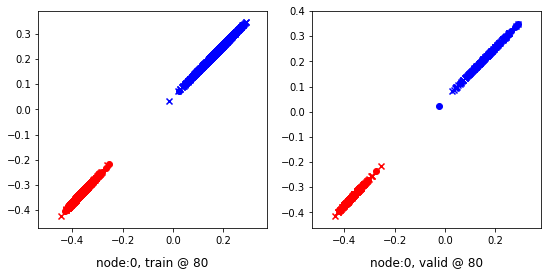

80 	 1 	 0.32466781 	 0.27227956 	 0.56312776 	 0.52469045 	 0.93478847 	 0.94555807


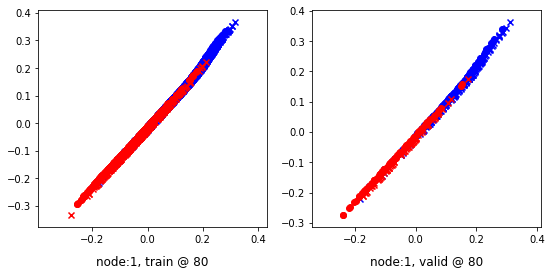

Aggregating on epoch: 84...
Aggregating on epoch: 91...
Aggregating on epoch: 98...
100 	 0 	 -0.04570523 	 -0.05235361 	 0.15013225 	 0.15389307 	 0.89751613 	 0.89939386


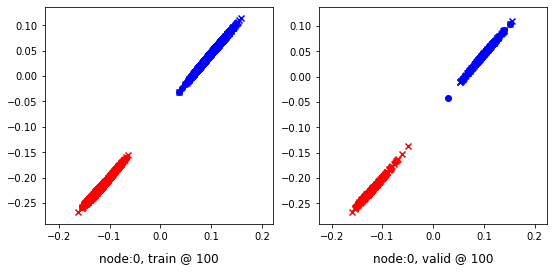

100 	 1 	 0.35462821 	 0.33774275 	 0.60719955 	 0.59344107 	 0.95019317 	 0.94884551


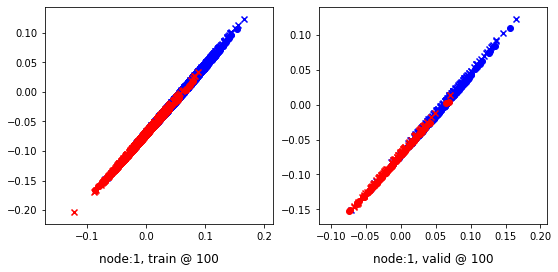

Aggregating on epoch: 105...
Aggregating on epoch: 112...
Aggregating on epoch: 119...
120 	 0 	 0.05408436 	 0.04600397 	 0.25179422 	 0.25224724 	 0.91511559 	 0.89939046


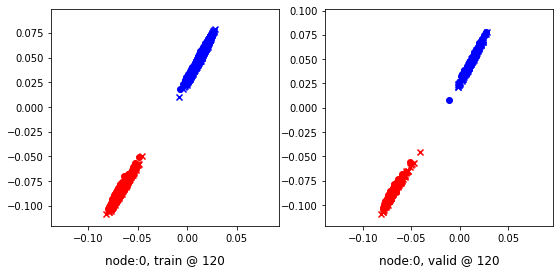

120 	 1 	 0.37691855 	 0.39444566 	 0.64731222 	 0.65407604 	 0.96300626 	 0.95277756


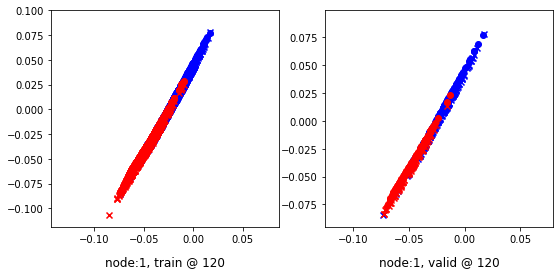

Aggregating on epoch: 126...
Aggregating on epoch: 133...
Aggregating on epoch: 140...
140 	 0 	 0.01898137 	 -0.01547486 	 0.17733186 	 0.19086862 	 0.86696130 	 0.89949065


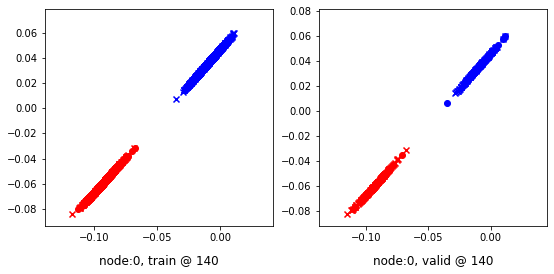

140 	 1 	 0.34745020 	 0.34611154 	 0.60348821 	 0.60171676 	 0.95485461 	 0.94875240


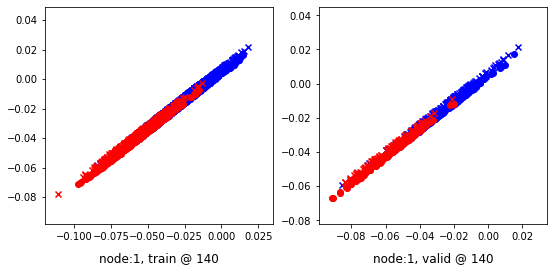

Aggregating on epoch: 147...
Aggregating on epoch: 154...
160 	 0 	 -0.16108844 	 -0.15038981 	 0.04972268 	 0.05584173 	 0.90811908 	 0.89937872


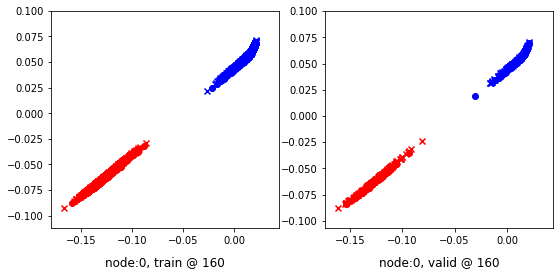

160 	 1 	 0.31764245 	 0.25039560 	 0.58511841 	 0.50892586 	 0.95612097 	 0.95167744


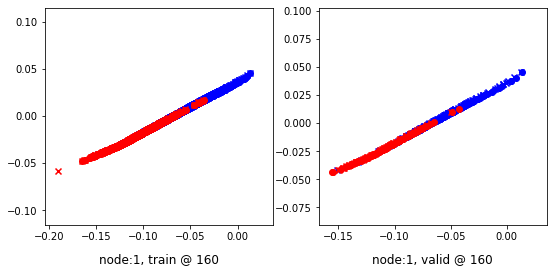

Aggregating on epoch: 161...
Aggregating on epoch: 168...
Aggregating on epoch: 175...
180 	 0 	 -0.16036199 	 -0.13807489 	 0.05939851 	 0.06817602 	 0.91480929 	 0.89939809


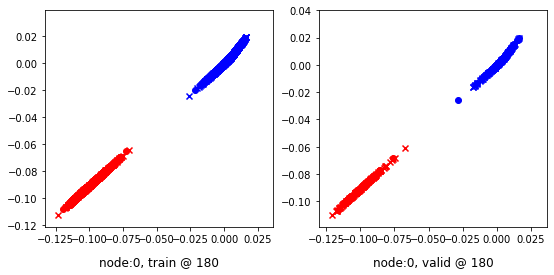

180 	 1 	 0.40359819 	 0.37456179 	 0.66112590 	 0.63354570 	 0.95457697 	 0.95213109


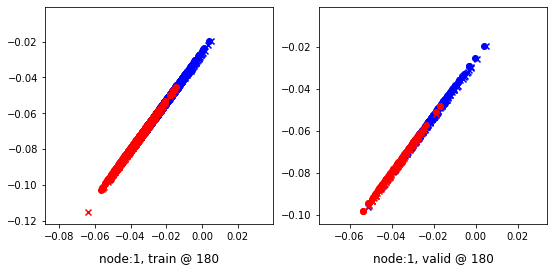

Aggregating on epoch: 182...
Aggregating on epoch: 189...
Aggregating on epoch: 196...
200 	 0 	 -0.13032115 	 -0.11134373 	 0.09120845 	 0.09486056 	 0.92841691 	 0.89935148


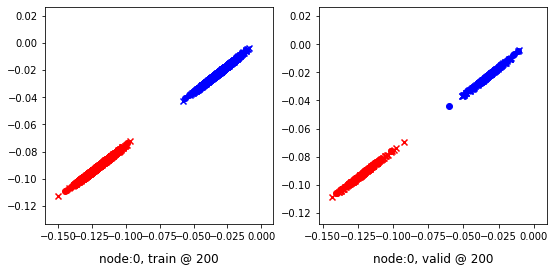

200 	 1 	 0.32973289 	 0.27858919 	 0.58510232 	 0.53498077 	 0.95295727 	 0.94953877


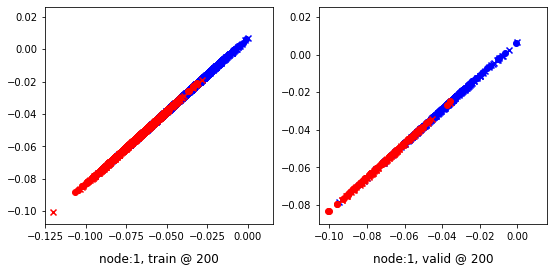

Aggregating on epoch: 203...
Aggregating on epoch: 210...
Aggregating on epoch: 217...
220 	 0 	 0.41054082 	 0.36962652 	 0.57413143 	 0.57590902 	 0.88746190 	 0.89942968


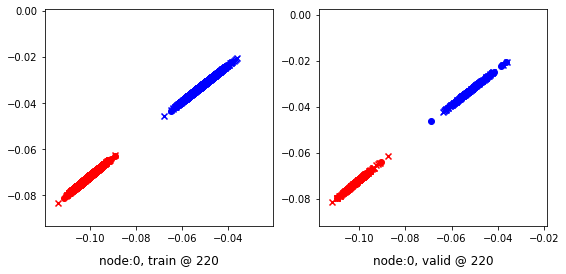

220 	 1 	 0.42891306 	 0.38444251 	 0.66607994 	 0.64209360 	 0.94487309 	 0.95079827


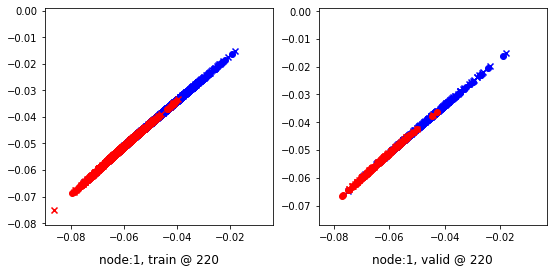

Aggregating on epoch: 224...
Aggregating on epoch: 231...
Aggregating on epoch: 238...
240 	 0 	 0.15310615 	 0.13990843 	 0.33810851 	 0.34614819 	 0.88761997 	 0.89938694


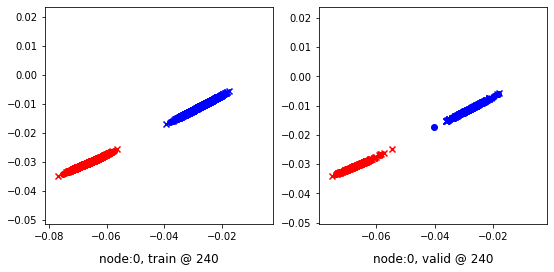

240 	 1 	 0.49549943 	 0.50309837 	 0.75337082 	 0.76089895 	 0.95421392 	 0.95094776


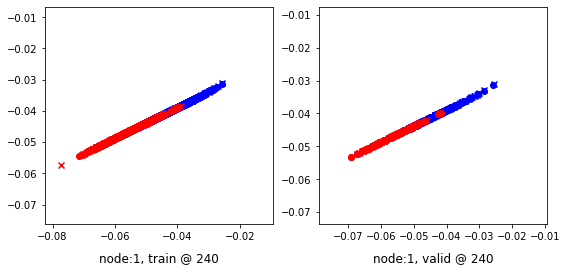

Aggregating on epoch: 245...
Aggregating on epoch: 252...
Aggregating on epoch: 259...
260 	 0 	 0.31554943 	 0.22467503 	 0.42585188 	 0.43095604 	 0.89435422 	 0.89942819


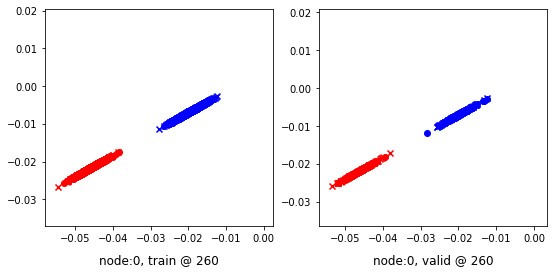

260 	 1 	 0.57563281 	 0.70220089 	 0.95567012 	 0.96625149 	 0.97296673 	 0.95719779


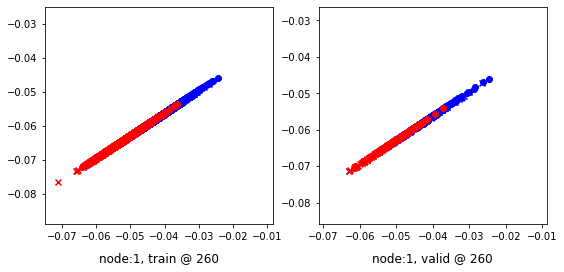

Aggregating on epoch: 266...
Aggregating on epoch: 273...
Aggregating on epoch: 280...
280 	 0 	 0.28401840 	 0.27715757 	 0.48187432 	 0.48339579 	 0.90819883 	 0.89938539


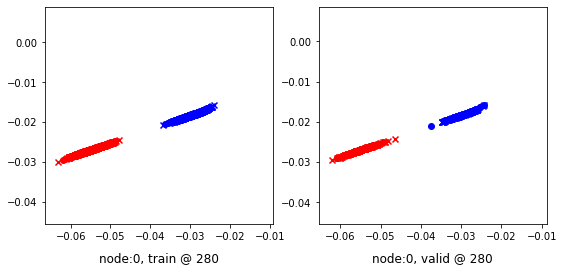

280 	 1 	 0.59195817 	 0.53874552 	 0.81947494 	 0.79726201 	 0.94882935 	 0.95166367


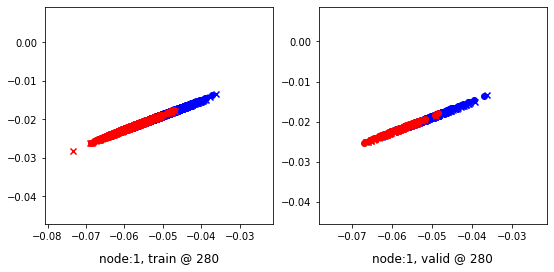

Aggregating on epoch: 287...
Aggregating on epoch: 294...
300 	 0 	 -0.06122942 	 -0.05121362 	 0.14275059 	 0.15500623 	 0.90111190 	 0.89936703


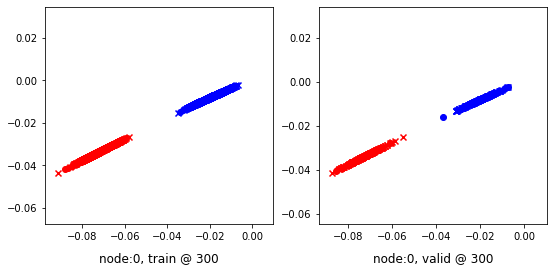

300 	 1 	 0.37697977 	 0.39119571 	 0.63382256 	 0.64848810 	 0.95157278 	 0.95043957


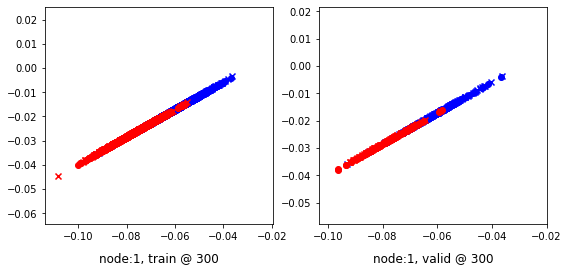

Aggregating on epoch: 301...
Aggregating on epoch: 308...
Aggregating on epoch: 315...
320 	 0 	 0.55767208 	 0.52194762 	 0.74283761 	 0.72820848 	 0.89435244 	 0.89940804


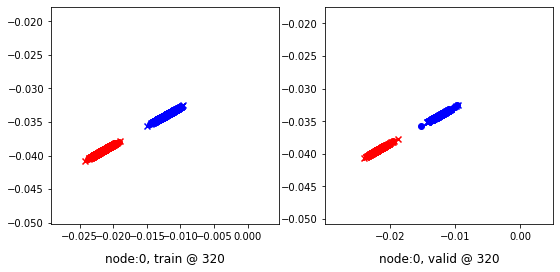

320 	 1 	 0.59703499 	 0.61998969 	 0.85765159 	 0.87835705 	 0.95435709 	 0.95151454


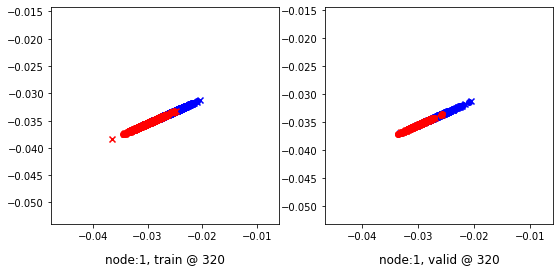

Aggregating on epoch: 322...
Aggregating on epoch: 329...
Aggregating on epoch: 336...
340 	 0 	 0.44966054 	 0.48535544 	 0.69702190 	 0.69161451 	 0.95970780 	 0.89940625


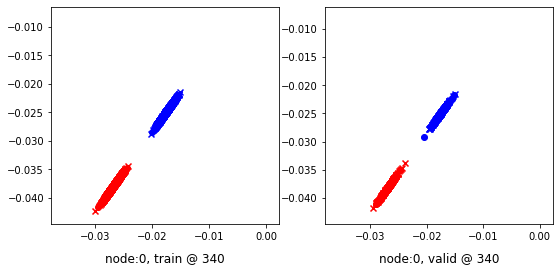

340 	 1 	 0.64317501 	 0.66092944 	 0.90072870 	 0.91879940 	 0.95595747 	 0.95101714


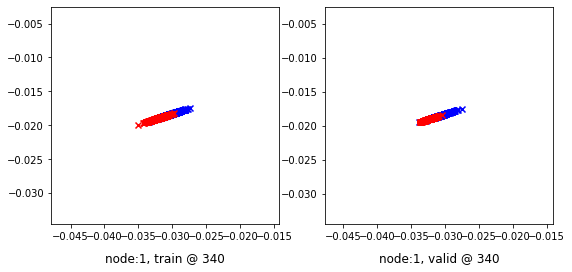

Aggregating on epoch: 343...
Aggregating on epoch: 350...
Aggregating on epoch: 357...
360 	 0 	 0.30768383 	 0.29613698 	 0.47337905 	 0.50239813 	 0.89084977 	 0.89940834


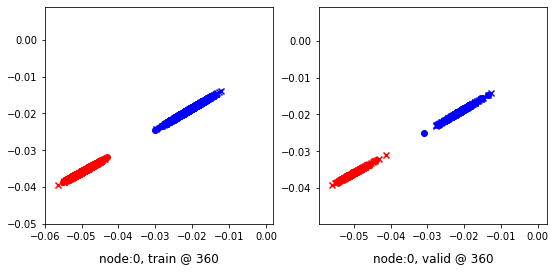

360 	 1 	 0.43511355 	 0.41013682 	 0.69567627 	 0.66558993 	 0.95390761 	 0.94860029


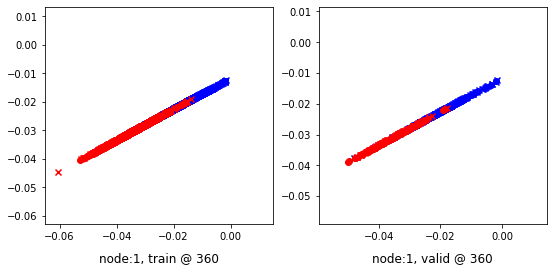

Aggregating on epoch: 364...
Aggregating on epoch: 371...
Aggregating on epoch: 378...
380 	 0 	 0.15644211 	 0.17739001 	 0.35727659 	 0.38364354 	 0.88067031 	 0.89940071


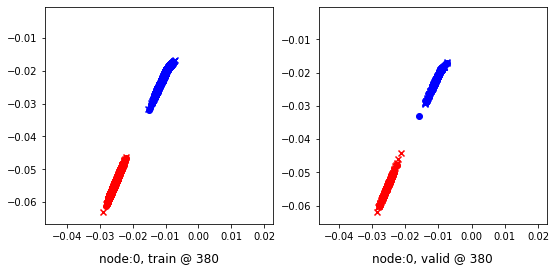

380 	 1 	 0.59640712 	 0.60406435 	 0.84680474 	 0.86034900 	 0.94892168 	 0.94943184


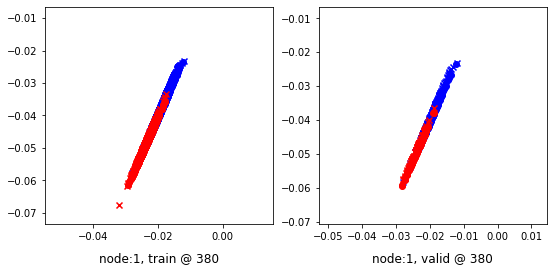

Aggregating on epoch: 385...
Aggregating on epoch: 392...
Aggregating on epoch: 399...
400 	 0 	 0.92779648 	 0.61406779 	 0.87380457 	 0.82033545 	 0.87374061 	 0.89941484


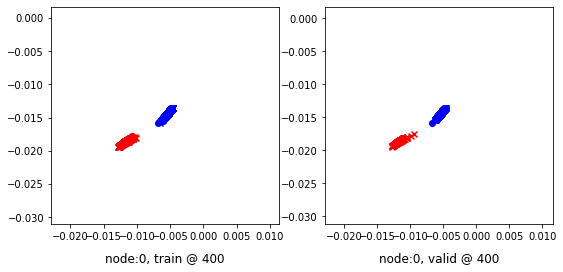

400 	 1 	 0.74854100 	 0.66094846 	 0.94778168 	 0.91963702 	 0.95986563 	 0.95183575


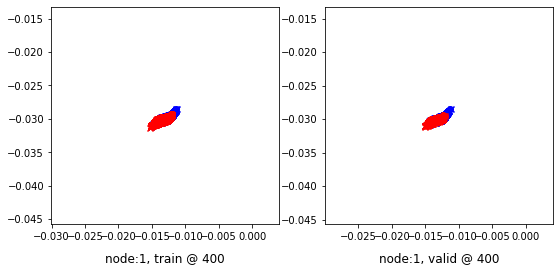

Aggregating on epoch: 406...
Aggregating on epoch: 413...
Aggregating on epoch: 420...
420 	 0 	 0.30783740 	 0.24244112 	 0.44557822 	 0.44868106 	 0.85657543 	 0.89938712


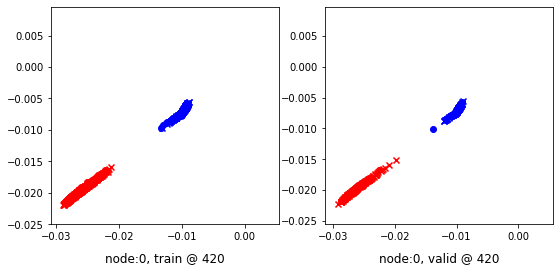

420 	 1 	 0.61138493 	 0.55479610 	 0.84070975 	 0.81261003 	 0.95077771 	 0.95096111


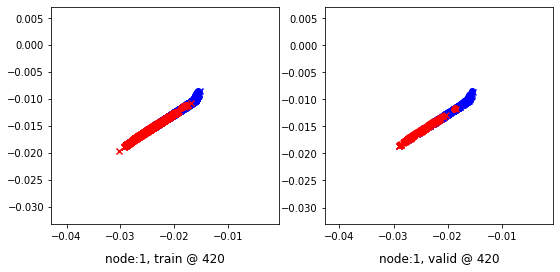

Aggregating on epoch: 427...
Aggregating on epoch: 434...
440 	 0 	 0.42343307 	 0.38854063 	 0.58461988 	 0.59483910 	 0.87727368 	 0.89944565


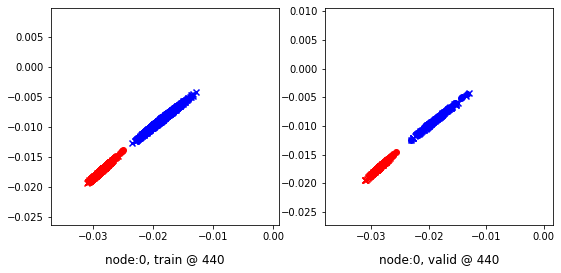

440 	 1 	 0.62803811 	 0.61258912 	 0.89035332 	 0.87600744 	 0.95855790 	 0.95656550


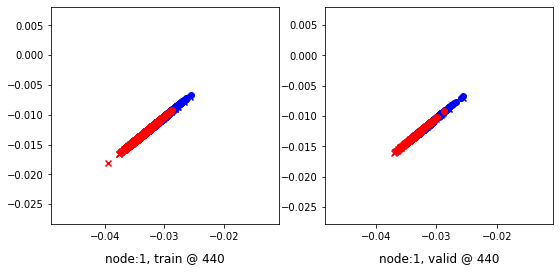

Aggregating on epoch: 441...
Aggregating on epoch: 448...
Aggregating on epoch: 455...
460 	 0 	 0.11387816 	 0.07737422 	 0.27332178 	 0.28357565 	 0.86357129 	 0.89934862


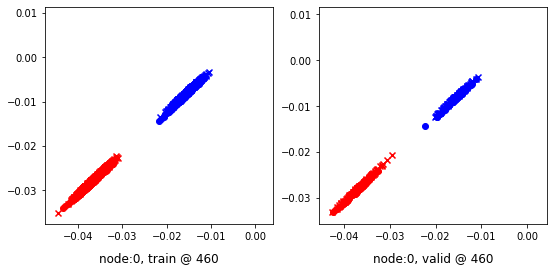

460 	 1 	 0.47807056 	 0.50442547 	 0.74014109 	 0.76264465 	 0.95804065 	 0.95136636


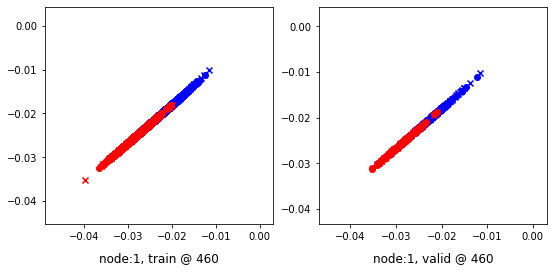

Aggregating on epoch: 462...
Aggregating on epoch: 469...
Aggregating on epoch: 476...
480 	 0 	 -0.07773480 	 -0.09775667 	 0.09877504 	 0.10848351 	 0.88418776 	 0.89938736


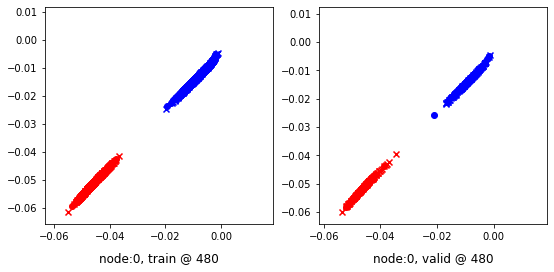

480 	 1 	 0.35529196 	 0.32954359 	 0.61471325 	 0.58576030 	 0.96585280 	 0.94936389


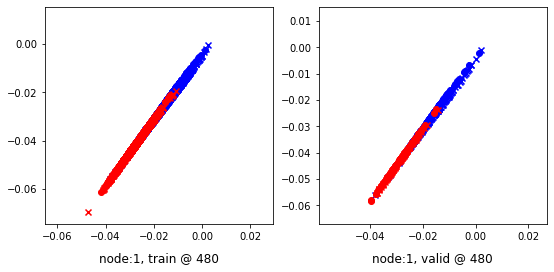

Aggregating on epoch: 483...
Aggregating on epoch: 490...
Aggregating on epoch: 497...
500 	 0 	 0.06763810 	 0.05061144 	 0.25363389 	 0.25688833 	 0.89777297 	 0.89942408


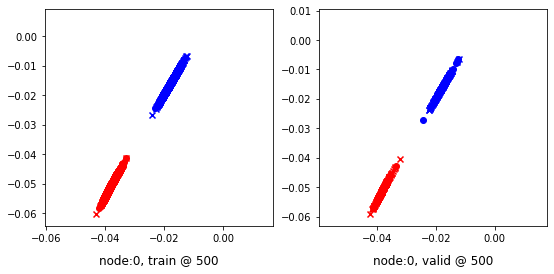

500 	 1 	 0.40775204 	 0.41638279 	 0.67835212 	 0.67434418 	 0.95783830 	 0.95110857


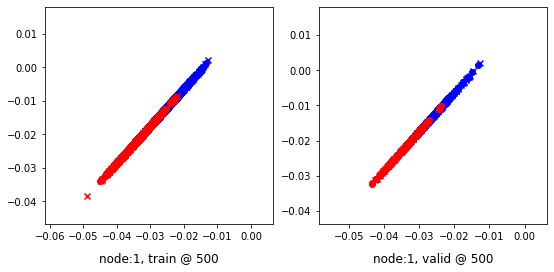

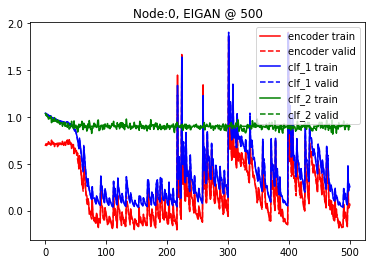

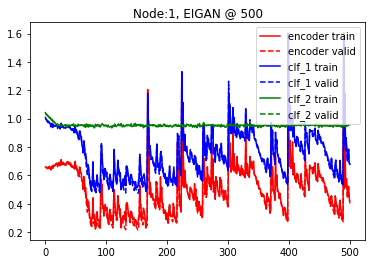

--------------------------------------------------------------------------------
EIGAN Training w/ phi=0.8 and delta=9
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.71146071 	 0.71156144 	 1.02644145 	 1.03332555 	 1.00839400 	 1.01491129


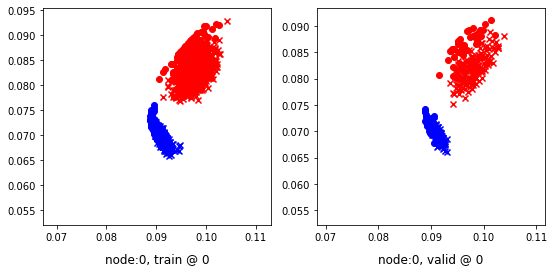

0 	 1 	 0.68419158 	 0.67749524 	 1.04821658 	 1.03685868 	 1.05729592 	 1.05251062


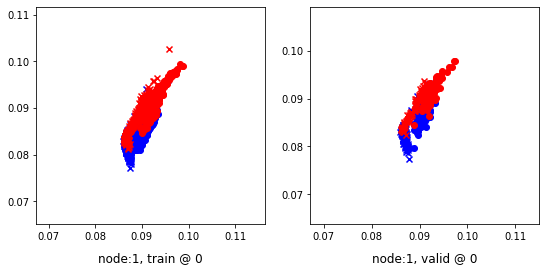

Aggregating on epoch: 9...
Aggregating on epoch: 18...
20 	 0 	 0.75945723 	 0.73797572 	 0.95416814 	 0.95382333 	 0.88801014 	 0.90899479


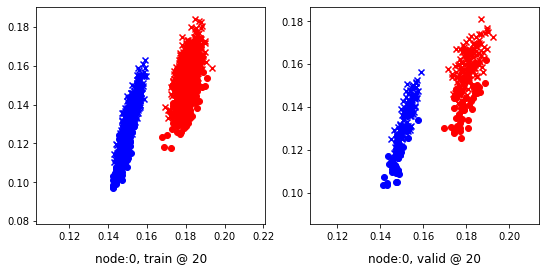

20 	 1 	 0.66637295 	 0.68441677 	 0.93215811 	 0.94629681 	 0.95902753 	 0.95502722


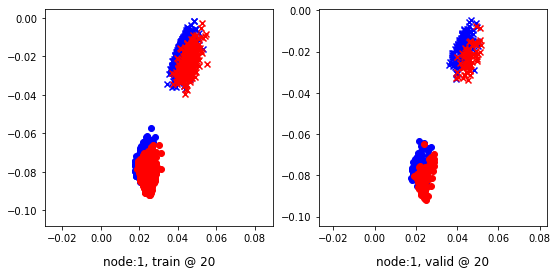

Aggregating on epoch: 27...
Aggregating on epoch: 36...
40 	 0 	 0.69984889 	 0.73551649 	 0.93782794 	 0.94108623 	 0.93178028 	 0.89871693


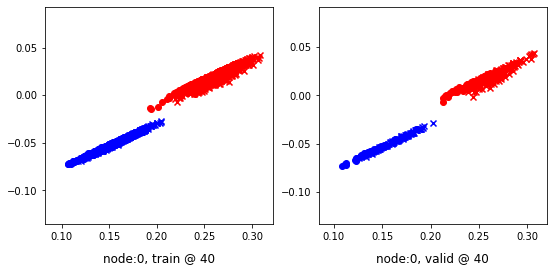

40 	 1 	 0.68535864 	 0.68648624 	 0.94211233 	 0.94490510 	 0.95008117 	 0.95156604


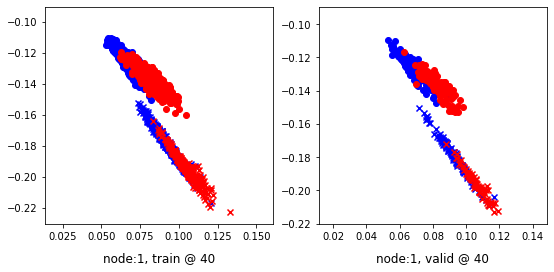

Aggregating on epoch: 45...
Aggregating on epoch: 54...
60 	 0 	 0.59659159 	 0.60350794 	 0.81487167 	 0.81132078 	 0.91748822 	 0.90096003


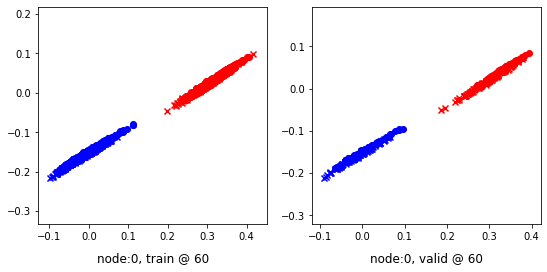

60 	 1 	 0.67030656 	 0.68402314 	 0.91994524 	 0.93845391 	 0.94303793 	 0.94757795


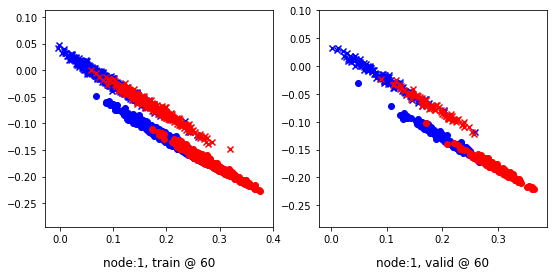

Aggregating on epoch: 63...
Aggregating on epoch: 72...
80 	 0 	 -0.05916269 	 -0.05127649 	 0.15375906 	 0.15340002 	 0.90832585 	 0.89782369


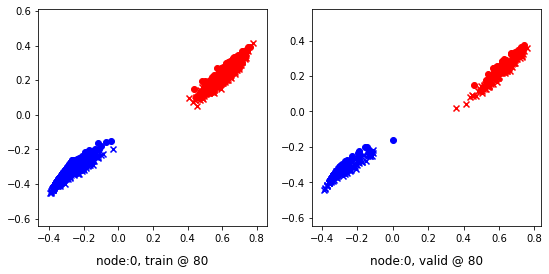

80 	 1 	 0.41066575 	 0.40737462 	 0.65455639 	 0.66217393 	 0.94060832 	 0.94794649


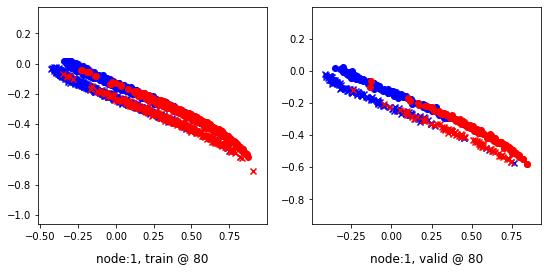

Aggregating on epoch: 81...
Aggregating on epoch: 90...
Aggregating on epoch: 99...
100 	 0 	 0.38585585 	 0.31883192 	 0.52686101 	 0.52509677 	 0.87050188 	 0.89941204


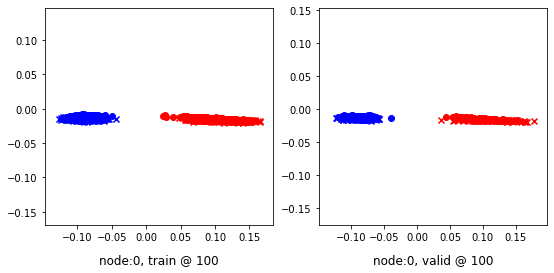

100 	 1 	 0.55374616 	 0.55808306 	 0.81397682 	 0.81754625 	 0.94582099 	 0.95261037


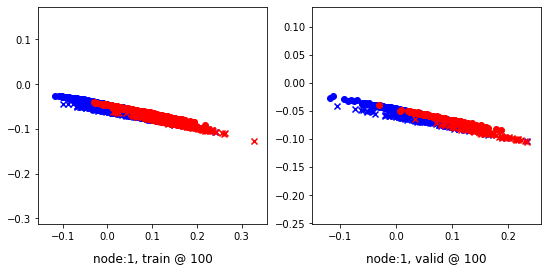

Aggregating on epoch: 108...
Aggregating on epoch: 117...
120 	 0 	 -0.08321653 	 -0.05586536 	 0.14731941 	 0.15043102 	 0.93910217 	 0.89944357


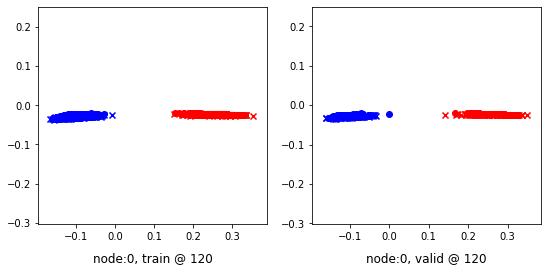

120 	 1 	 0.41330427 	 0.39140385 	 0.68074387 	 0.64965916 	 0.95901972 	 0.95140249


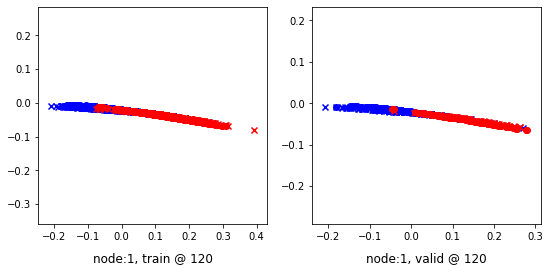

Aggregating on epoch: 126...
Aggregating on epoch: 135...
140 	 0 	 -0.05129910 	 -0.08602935 	 0.11388616 	 0.12005442 	 0.86360246 	 0.89923096


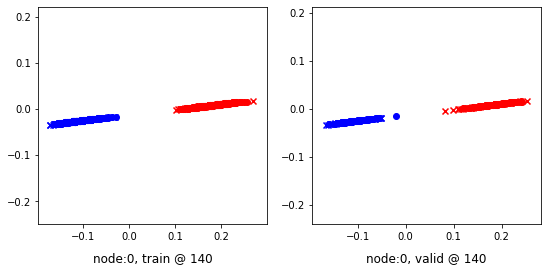

140 	 1 	 0.34587026 	 0.33464211 	 0.60325676 	 0.59151912 	 0.95082372 	 0.95002419


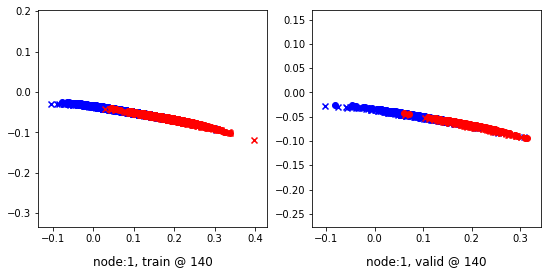

Aggregating on epoch: 144...
Aggregating on epoch: 153...
160 	 0 	 -0.15519151 	 -0.13651529 	 0.06388203 	 0.06952193 	 0.91488779 	 0.89918441


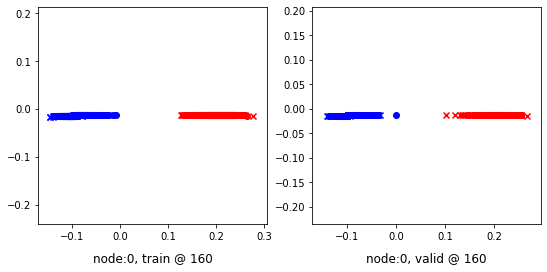

160 	 1 	 0.37313920 	 0.35209262 	 0.62180650 	 0.60841548 	 0.94526839 	 0.94947004


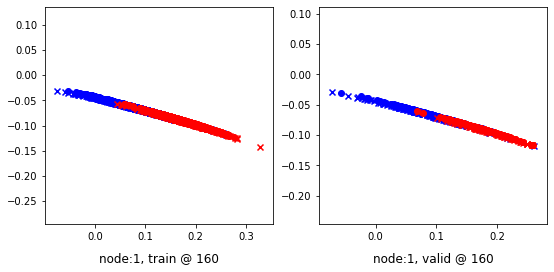

Aggregating on epoch: 162...
Aggregating on epoch: 171...
Aggregating on epoch: 180...
180 	 0 	 -0.06203030 	 -0.08824461 	 0.11826415 	 0.11812121 	 0.88765085 	 0.89951301


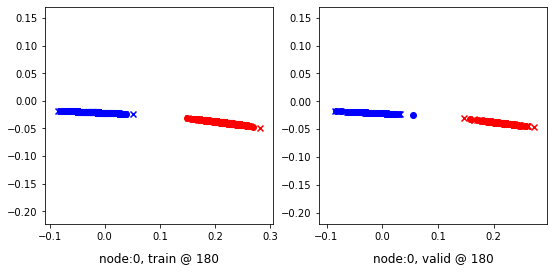

180 	 1 	 0.36412454 	 0.30512094 	 0.60523403 	 0.56442010 	 0.94323444 	 0.95244634


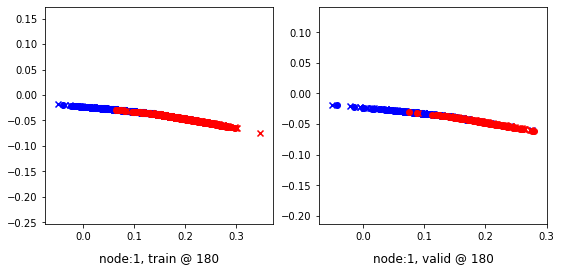

Aggregating on epoch: 189...
Aggregating on epoch: 198...
200 	 0 	 -0.09285765 	 -0.11373258 	 0.08743372 	 0.09242826 	 0.87734818 	 0.89930803


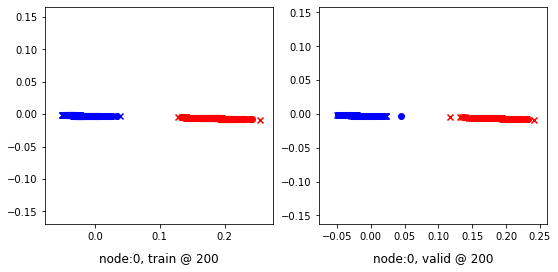

200 	 1 	 0.34479785 	 0.32271761 	 0.56673539 	 0.58020043 	 0.95096064 	 0.95063001


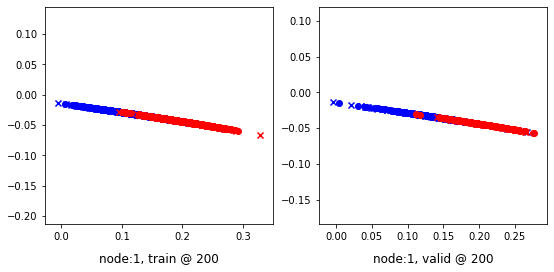

Aggregating on epoch: 207...
Aggregating on epoch: 216...
220 	 0 	 -0.14512756 	 -0.15723056 	 0.04383158 	 0.04899662 	 0.88425809 	 0.89937437


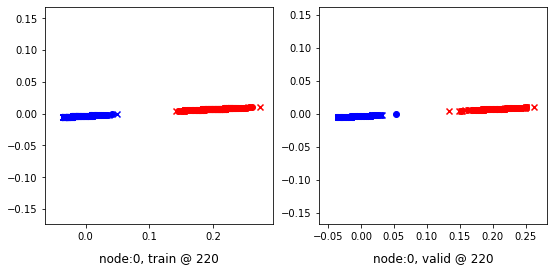

220 	 1 	 0.33774078 	 0.33762312 	 0.60246283 	 0.59541231 	 0.95621789 	 0.95093638


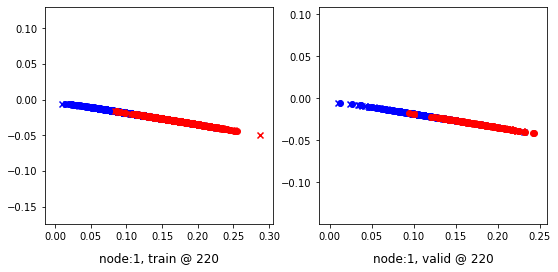

Aggregating on epoch: 225...
Aggregating on epoch: 234...
240 	 0 	 -0.19712874 	 -0.17681552 	 0.02681995 	 0.02934603 	 0.91798580 	 0.89930874


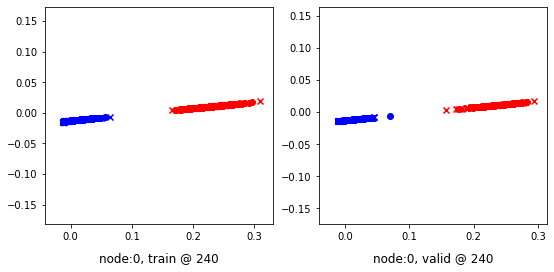

240 	 1 	 0.29599571 	 0.23073339 	 0.55684680 	 0.48837227 	 0.95377481 	 0.95078605


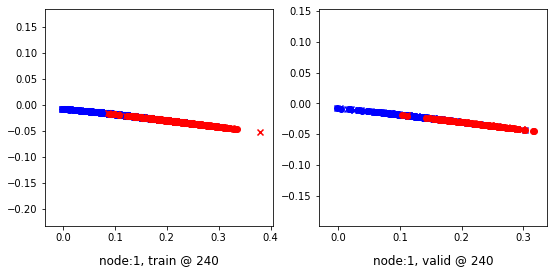

Aggregating on epoch: 243...
Aggregating on epoch: 252...
260 	 0 	 -0.16827483 	 -0.18883242 	 0.01533355 	 0.01730733 	 0.87706161 	 0.89928693


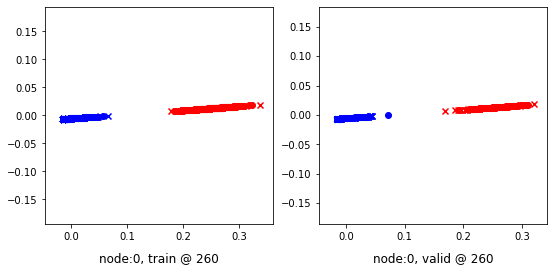

260 	 1 	 0.26033258 	 0.22512746 	 0.51475269 	 0.48266125 	 0.94777757 	 0.95068097


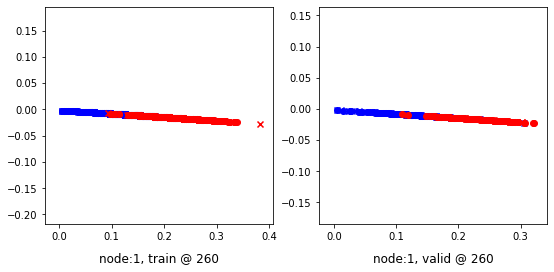

Aggregating on epoch: 261...
Aggregating on epoch: 270...
Aggregating on epoch: 279...
280 	 0 	 -0.14939997 	 -0.13109247 	 0.06994683 	 0.07528998 	 0.91528028 	 0.89952964


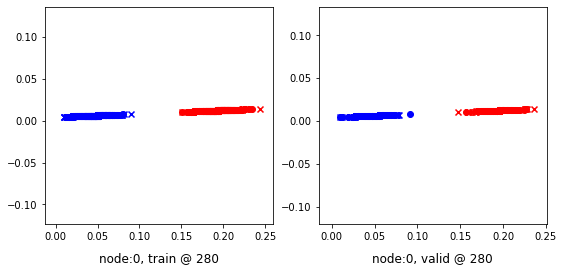

280 	 1 	 0.35463399 	 0.34201163 	 0.62925452 	 0.60172921 	 0.95315808 	 0.95286477


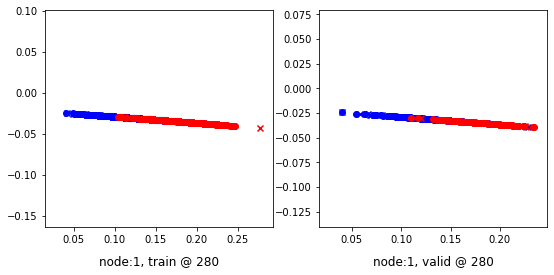

Aggregating on epoch: 288...
Aggregating on epoch: 297...
300 	 0 	 1.11995316 	 0.96967858 	 1.25507164 	 1.17606091 	 0.93875670 	 0.89952952


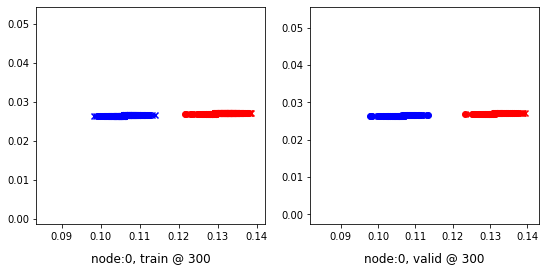

300 	 1 	 0.83109981 	 0.88554567 	 1.13562346 	 1.14639926 	 0.94143087 	 0.95400077


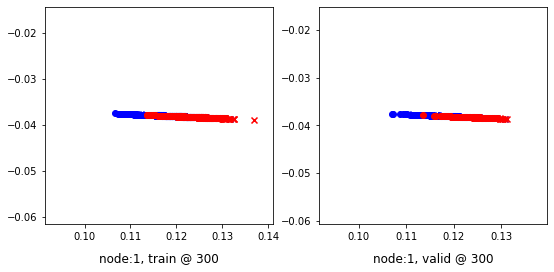

Aggregating on epoch: 306...
Aggregating on epoch: 315...
320 	 0 	 0.14811251 	 0.14999267 	 0.34418100 	 0.35622469 	 0.89435518 	 0.89937919


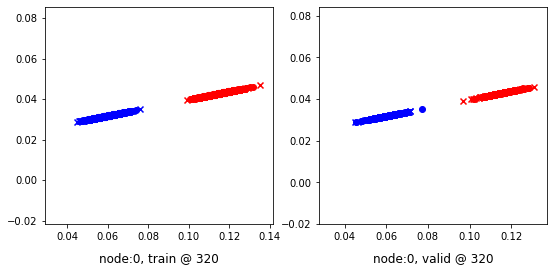

320 	 1 	 0.58357984 	 0.58132726 	 0.84110081 	 0.84008467 	 0.95212084 	 0.95190459


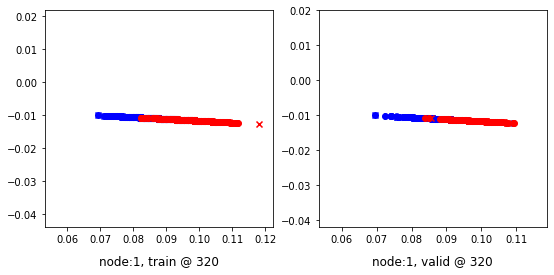

Aggregating on epoch: 324...
Aggregating on epoch: 333...
340 	 0 	 0.01916029 	 0.01354663 	 0.21554065 	 0.21976565 	 0.90798485 	 0.89936620


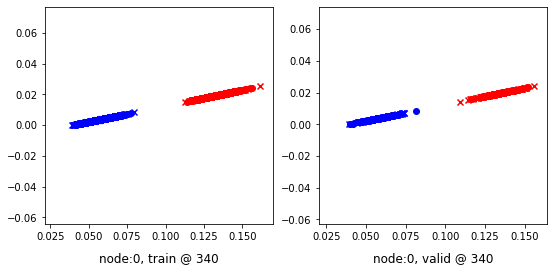

340 	 1 	 0.48027098 	 0.48214883 	 0.73650068 	 0.74024272 	 0.95053470 	 0.95124108


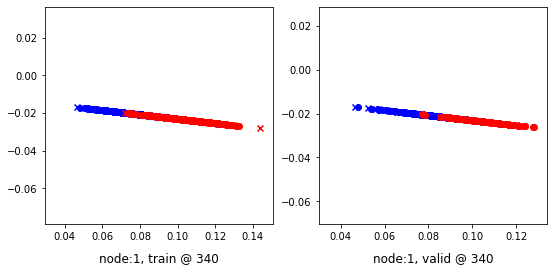

Aggregating on epoch: 342...
Aggregating on epoch: 351...
Aggregating on epoch: 360...
360 	 0 	 1.89730597 	 1.46704924 	 1.79994154 	 1.67334378 	 0.91887629 	 0.89944172


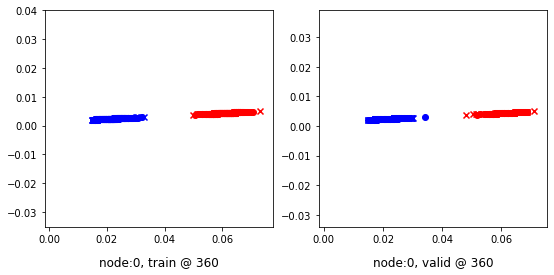

360 	 1 	 0.78748280 	 0.69251508 	 0.96312177 	 0.95081925 	 0.94324356 	 0.95145136


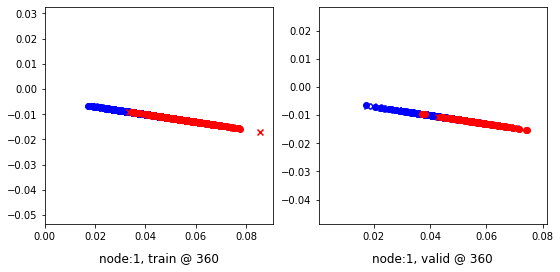

Aggregating on epoch: 369...
Aggregating on epoch: 378...
380 	 0 	 0.05302951 	 0.09981960 	 0.28587529 	 0.30611819 	 0.90458024 	 0.89944577


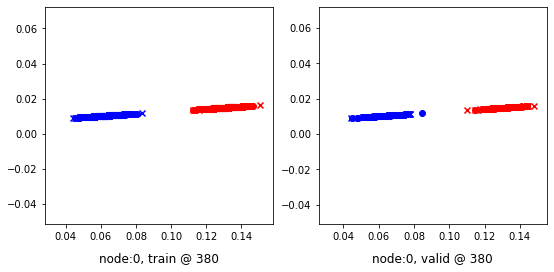

380 	 1 	 0.60964626 	 0.62218380 	 0.87633818 	 0.88006371 	 0.95136851 	 0.95102710


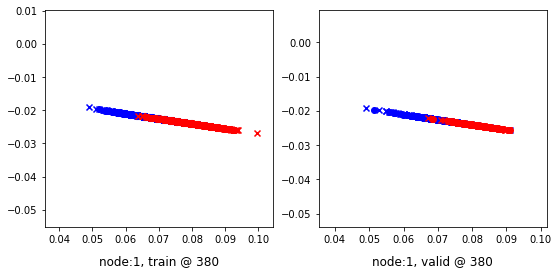

Aggregating on epoch: 387...
Aggregating on epoch: 396...
400 	 0 	 0.16428813 	 0.11380348 	 0.31218454 	 0.32016411 	 0.86046720 	 0.89950782


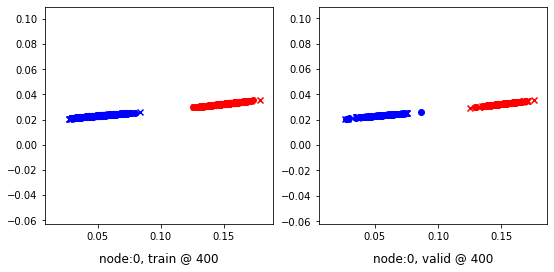

400 	 1 	 0.40441322 	 0.38167268 	 0.65304637 	 0.63680041 	 0.93962735 	 0.94827491


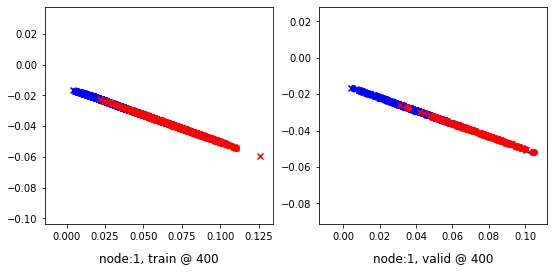

Aggregating on epoch: 405...
Aggregating on epoch: 414...
420 	 0 	 -0.17999251 	 -0.15842201 	 0.04114899 	 0.04789875 	 0.91492981 	 0.89946795


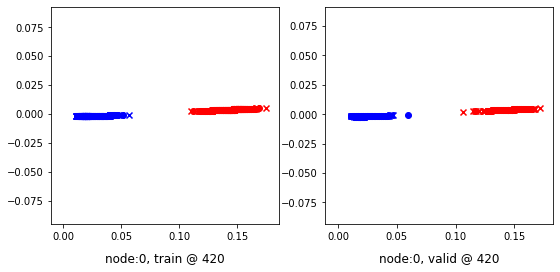

420 	 1 	 0.45659953 	 0.45775992 	 0.70944566 	 0.71525103 	 0.95416898 	 0.95063829


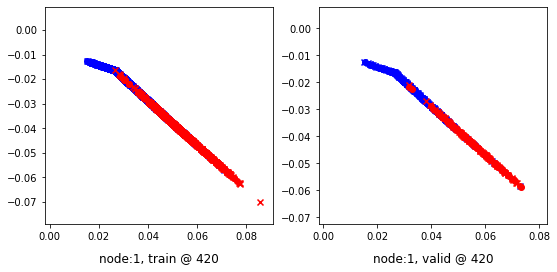

Aggregating on epoch: 423...
Aggregating on epoch: 432...
440 	 0 	 -0.12122209 	 -0.11905055 	 0.07979237 	 0.08714862 	 0.89463067 	 0.89934635


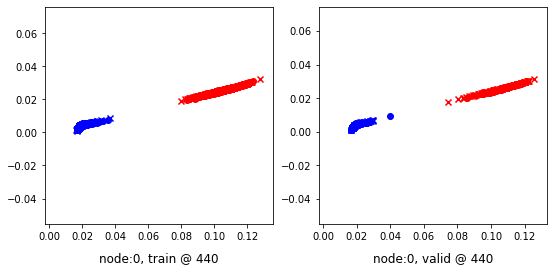

440 	 1 	 0.33225262 	 0.28090763 	 0.58673280 	 0.53929102 	 0.94945359 	 0.95153058


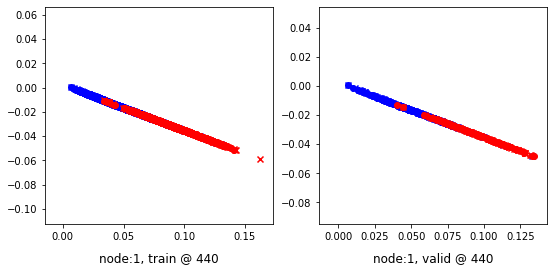

Aggregating on epoch: 441...
Aggregating on epoch: 450...
Aggregating on epoch: 459...
460 	 0 	 0.53881919 	 0.41397750 	 0.63289398 	 0.62030494 	 0.89437658 	 0.89947462


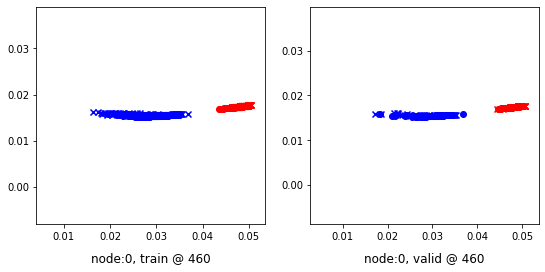

460 	 1 	 0.55738050 	 0.61463732 	 0.86595362 	 0.87824458 	 0.95505607 	 0.95675445


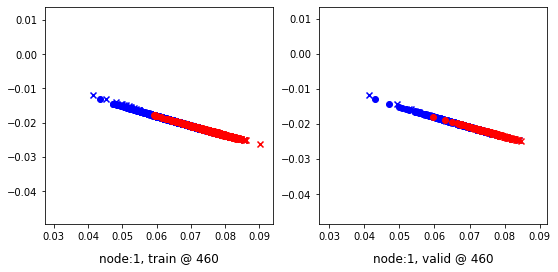

Aggregating on epoch: 468...
Aggregating on epoch: 477...
480 	 0 	 0.02155131 	 0.01562898 	 0.21642135 	 0.22164099 	 0.90425462 	 0.89915919


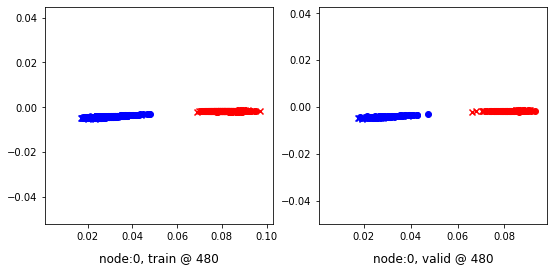

480 	 1 	 0.50175846 	 0.48515528 	 0.74517739 	 0.74116623 	 0.94844794 	 0.94915813


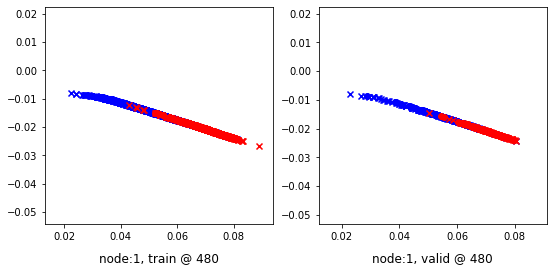

Aggregating on epoch: 486...
Aggregating on epoch: 495...
500 	 0 	 -0.04374839 	 -0.06970057 	 0.13287219 	 0.13661513 	 0.87701428 	 0.89946288


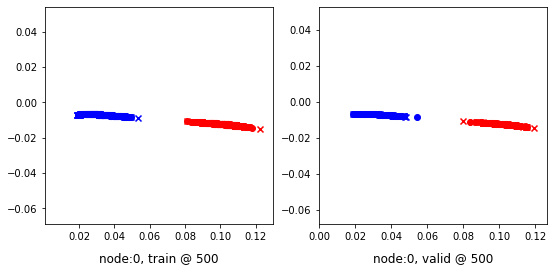

500 	 1 	 0.33770174 	 0.34003580 	 0.59285665 	 0.59855974 	 0.95142138 	 0.95167112


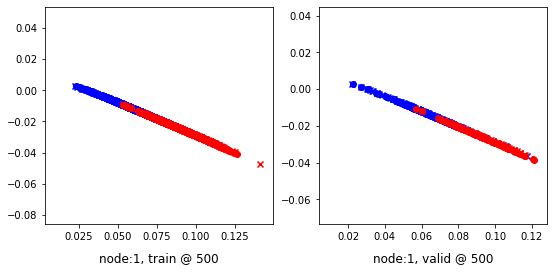

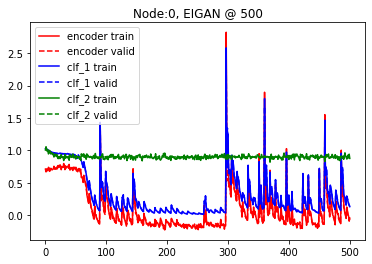

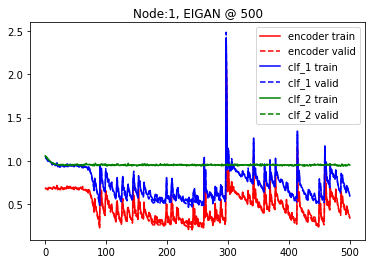

--------------------------------------------------------------------------------
EIGAN Training w/ phi=1.0 and delta=1
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.68206978 	 0.68597007 	 1.06087184 	 1.05731392 	 1.07214165 	 1.06449103


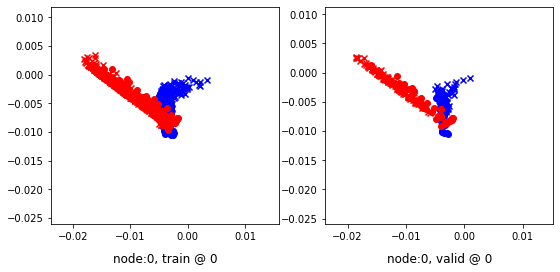

0 	 1 	 0.72278297 	 0.71389461 	 1.03370452 	 1.03013742 	 1.00419462 	 1.00939000


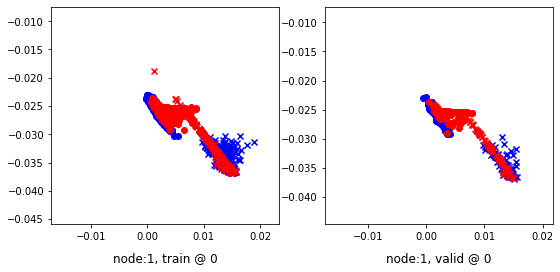

Aggregating on epoch: 1...
Aggregating on epoch: 2...
Aggregating on epoch: 3...
Aggregating on epoch: 4...
Aggregating on epoch: 5...
Aggregating on epoch: 6...
Aggregating on epoch: 7...
Aggregating on epoch: 8...
Aggregating on epoch: 9...
Aggregating on epoch: 10...
Aggregating on epoch: 11...
Aggregating on epoch: 12...
Aggregating on epoch: 13...
Aggregating on epoch: 14...
Aggregating on epoch: 15...
Aggregating on epoch: 16...
Aggregating on epoch: 17...
Aggregating on epoch: 18...
Aggregating on epoch: 19...
Aggregating on epoch: 20...
20 	 0 	 0.73121250 	 0.72653168 	 0.96864045 	 0.96894544 	 0.93098623 	 0.93556094


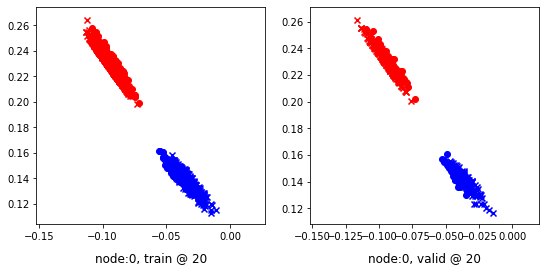

20 	 1 	 0.70478886 	 0.70394862 	 0.96026552 	 0.96359134 	 0.94869465 	 0.95278990


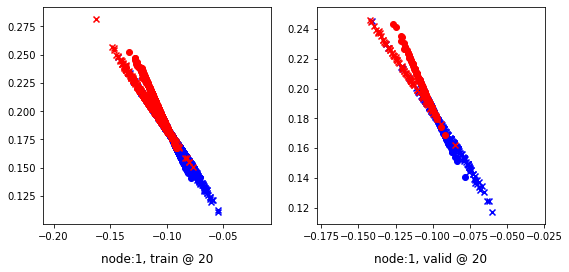

Aggregating on epoch: 21...
Aggregating on epoch: 22...
Aggregating on epoch: 23...
Aggregating on epoch: 24...
Aggregating on epoch: 25...
Aggregating on epoch: 26...
Aggregating on epoch: 27...
Aggregating on epoch: 28...
Aggregating on epoch: 29...
Aggregating on epoch: 30...
Aggregating on epoch: 31...
Aggregating on epoch: 32...
Aggregating on epoch: 33...
Aggregating on epoch: 34...
Aggregating on epoch: 35...
Aggregating on epoch: 36...
Aggregating on epoch: 37...
Aggregating on epoch: 38...
Aggregating on epoch: 39...
Aggregating on epoch: 40...
40 	 0 	 0.58003622 	 0.57832581 	 0.78910321 	 0.78594166 	 0.90662915 	 0.90076303


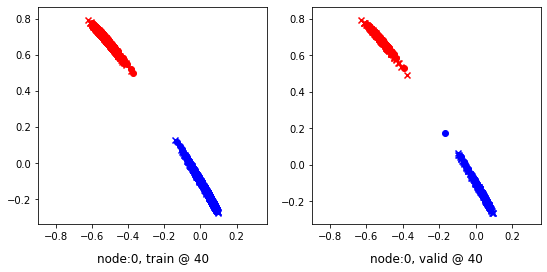

40 	 1 	 0.61538231 	 0.61471486 	 0.87197524 	 0.87217999 	 0.95139432 	 0.95061231


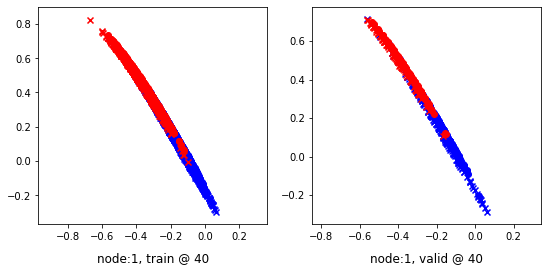

Aggregating on epoch: 41...
Aggregating on epoch: 42...
Aggregating on epoch: 43...
Aggregating on epoch: 44...
Aggregating on epoch: 45...
Aggregating on epoch: 46...
Aggregating on epoch: 47...
Aggregating on epoch: 48...
Aggregating on epoch: 49...
Aggregating on epoch: 50...
Aggregating on epoch: 51...
Aggregating on epoch: 52...
Aggregating on epoch: 53...
Aggregating on epoch: 54...
Aggregating on epoch: 55...
Aggregating on epoch: 56...
Aggregating on epoch: 57...
Aggregating on epoch: 58...
Aggregating on epoch: 59...
Aggregating on epoch: 60...
60 	 0 	 0.02299696 	 -0.01947132 	 0.18808809 	 0.18610290 	 0.85989523 	 0.89872140


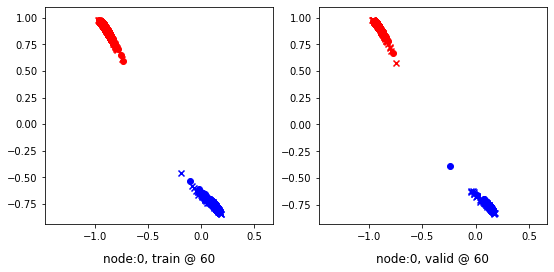

60 	 1 	 0.23584726 	 0.22994629 	 0.49724135 	 0.48315433 	 0.95450509 	 0.94635522


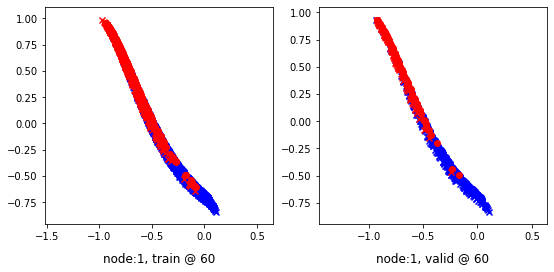

Aggregating on epoch: 61...
Aggregating on epoch: 62...
Aggregating on epoch: 63...
Aggregating on epoch: 64...
Aggregating on epoch: 65...
Aggregating on epoch: 66...
Aggregating on epoch: 67...
Aggregating on epoch: 68...
Aggregating on epoch: 69...
Aggregating on epoch: 70...
Aggregating on epoch: 71...
Aggregating on epoch: 72...
Aggregating on epoch: 73...
Aggregating on epoch: 74...
Aggregating on epoch: 75...
Aggregating on epoch: 76...
Aggregating on epoch: 77...
Aggregating on epoch: 78...
Aggregating on epoch: 79...
Aggregating on epoch: 80...
80 	 0 	 -0.11484562 	 -0.15328583 	 0.05331581 	 0.05244401 	 0.86174375 	 0.89887702


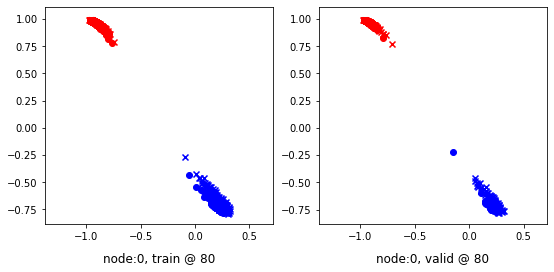

80 	 1 	 0.24965006 	 0.21072450 	 0.51231658 	 0.46901175 	 0.95531511 	 0.95143443


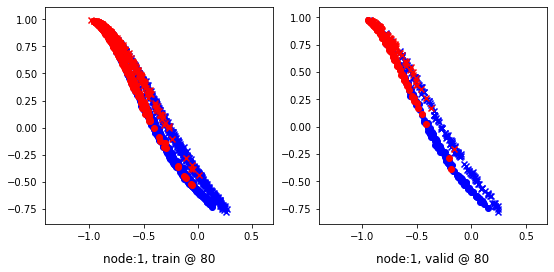

Aggregating on epoch: 81...
Aggregating on epoch: 82...
Aggregating on epoch: 83...
Aggregating on epoch: 84...
Aggregating on epoch: 85...
Aggregating on epoch: 86...
Aggregating on epoch: 87...
Aggregating on epoch: 88...
Aggregating on epoch: 89...
Aggregating on epoch: 90...
Aggregating on epoch: 91...
Aggregating on epoch: 92...
Aggregating on epoch: 93...
Aggregating on epoch: 94...
Aggregating on epoch: 95...
Aggregating on epoch: 96...
Aggregating on epoch: 97...
Aggregating on epoch: 98...
Aggregating on epoch: 99...
Aggregating on epoch: 100...
100 	 0 	 -0.18349636 	 -0.18303630 	 0.02417604 	 0.02508239 	 0.90124500 	 0.90126586


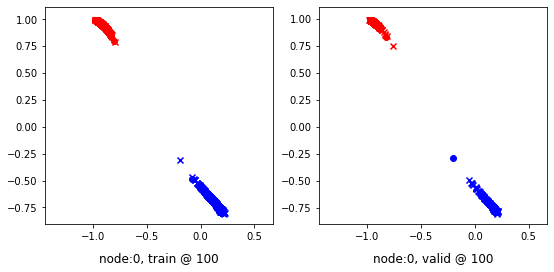

100 	 1 	 0.22073066 	 0.20397875 	 0.48335215 	 0.46321973 	 0.95488495 	 0.95238817


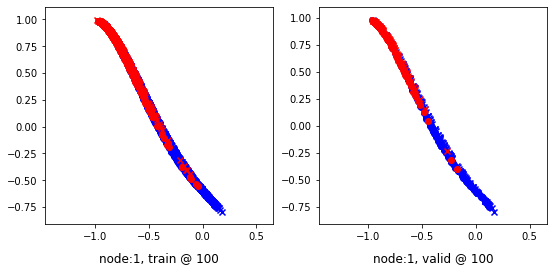

Aggregating on epoch: 101...
Aggregating on epoch: 102...
Aggregating on epoch: 103...
Aggregating on epoch: 104...
Aggregating on epoch: 105...
Aggregating on epoch: 106...
Aggregating on epoch: 107...
Aggregating on epoch: 108...
Aggregating on epoch: 109...
Aggregating on epoch: 110...
Aggregating on epoch: 111...
Aggregating on epoch: 112...
Aggregating on epoch: 113...
Aggregating on epoch: 114...
Aggregating on epoch: 115...
Aggregating on epoch: 116...
Aggregating on epoch: 117...
Aggregating on epoch: 118...
Aggregating on epoch: 119...
Aggregating on epoch: 120...
120 	 0 	 -0.19506687 	 -0.19305274 	 0.01260888 	 0.01372258 	 0.90096557 	 0.89992249


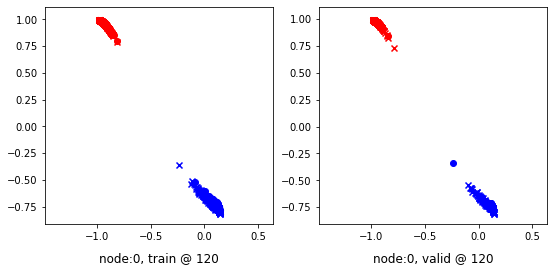

120 	 1 	 0.19833153 	 0.19711709 	 0.46808344 	 0.45758778 	 0.96229488 	 0.95361787


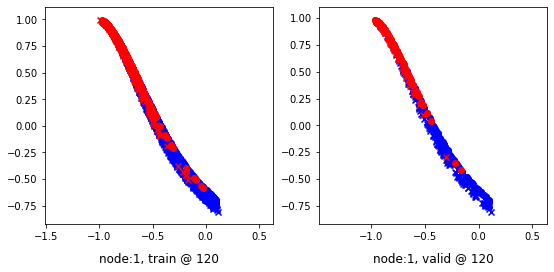

Aggregating on epoch: 121...
Aggregating on epoch: 122...
Aggregating on epoch: 123...
Aggregating on epoch: 124...
Aggregating on epoch: 125...
Aggregating on epoch: 126...
Aggregating on epoch: 127...
Aggregating on epoch: 128...
Aggregating on epoch: 129...
Aggregating on epoch: 130...
Aggregating on epoch: 131...
Aggregating on epoch: 132...
Aggregating on epoch: 133...
Aggregating on epoch: 134...
Aggregating on epoch: 135...
Aggregating on epoch: 136...
Aggregating on epoch: 137...
Aggregating on epoch: 138...
Aggregating on epoch: 139...
Aggregating on epoch: 140...
140 	 0 	 -0.18488027 	 -0.19795030 	 0.00795161 	 0.00830662 	 0.88606721 	 0.89940411


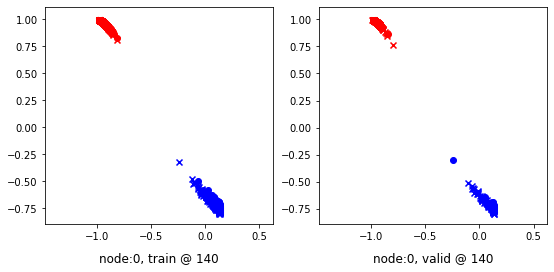

140 	 1 	 0.24802357 	 0.19899300 	 0.50120217 	 0.45746437 	 0.94622993 	 0.95161855


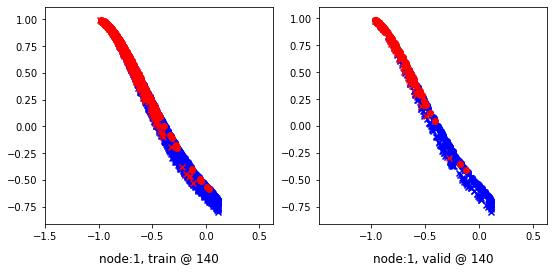

Aggregating on epoch: 141...
Aggregating on epoch: 142...
Aggregating on epoch: 143...
Aggregating on epoch: 144...
Aggregating on epoch: 145...
Aggregating on epoch: 146...
Aggregating on epoch: 147...
Aggregating on epoch: 148...
Aggregating on epoch: 149...
Aggregating on epoch: 150...
Aggregating on epoch: 151...
Aggregating on epoch: 152...
Aggregating on epoch: 153...
Aggregating on epoch: 154...
Aggregating on epoch: 155...
Aggregating on epoch: 156...
Aggregating on epoch: 157...
Aggregating on epoch: 158...
Aggregating on epoch: 159...
Aggregating on epoch: 160...
160 	 0 	 -0.21335328 	 -0.20088010 	 0.00520604 	 0.00541104 	 0.91176438 	 0.89943832


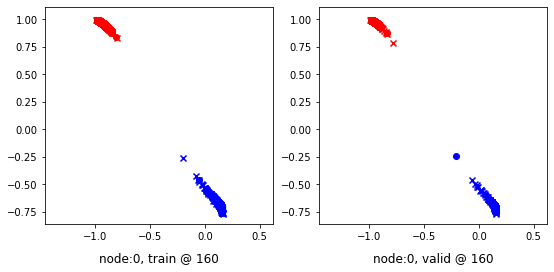

160 	 1 	 0.20567635 	 0.19791585 	 0.46419573 	 0.45642149 	 0.95152676 	 0.95165282


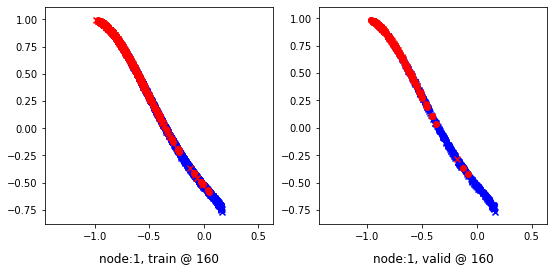

Aggregating on epoch: 161...
Aggregating on epoch: 162...
Aggregating on epoch: 163...
Aggregating on epoch: 164...
Aggregating on epoch: 165...
Aggregating on epoch: 166...
Aggregating on epoch: 167...
Aggregating on epoch: 168...
Aggregating on epoch: 169...
Aggregating on epoch: 170...
Aggregating on epoch: 171...
Aggregating on epoch: 172...
Aggregating on epoch: 173...
Aggregating on epoch: 174...
Aggregating on epoch: 175...
Aggregating on epoch: 176...
Aggregating on epoch: 177...
Aggregating on epoch: 178...
Aggregating on epoch: 179...
Aggregating on epoch: 180...
180 	 0 	 -0.22457783 	 -0.20269397 	 0.00349525 	 0.00384876 	 0.92125684 	 0.89968991


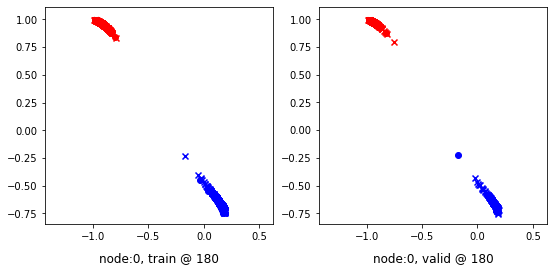

180 	 1 	 0.19453636 	 0.19699353 	 0.44867077 	 0.45609277 	 0.94733989 	 0.95224643


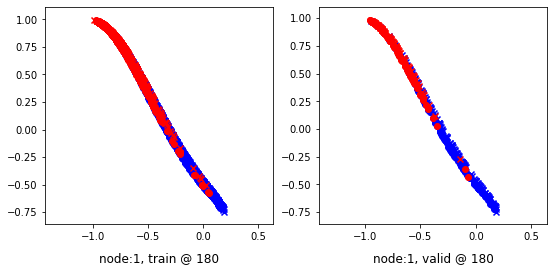

Aggregating on epoch: 181...
Aggregating on epoch: 182...
Aggregating on epoch: 183...
Aggregating on epoch: 184...
Aggregating on epoch: 185...
Aggregating on epoch: 186...
Aggregating on epoch: 187...
Aggregating on epoch: 188...
Aggregating on epoch: 189...
Aggregating on epoch: 190...
Aggregating on epoch: 191...
Aggregating on epoch: 192...
Aggregating on epoch: 193...
Aggregating on epoch: 194...
Aggregating on epoch: 195...
Aggregating on epoch: 196...
Aggregating on epoch: 197...
Aggregating on epoch: 198...
Aggregating on epoch: 199...
Aggregating on epoch: 200...
200 	 0 	 -0.23592594 	 -0.20344341 	 0.00293219 	 0.00309700 	 0.93204558 	 0.89968759


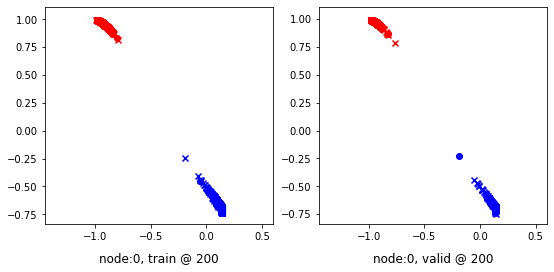

200 	 1 	 0.23718536 	 0.19703668 	 0.49343121 	 0.45596415 	 0.94972056 	 0.95207465


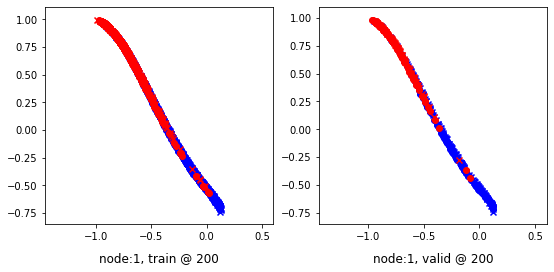

Aggregating on epoch: 201...
Aggregating on epoch: 202...
Aggregating on epoch: 203...
Aggregating on epoch: 204...
Aggregating on epoch: 205...
Aggregating on epoch: 206...
Aggregating on epoch: 207...
Aggregating on epoch: 208...
Aggregating on epoch: 209...
Aggregating on epoch: 210...
Aggregating on epoch: 211...
Aggregating on epoch: 212...
Aggregating on epoch: 213...
Aggregating on epoch: 214...
Aggregating on epoch: 215...
Aggregating on epoch: 216...
Aggregating on epoch: 217...
Aggregating on epoch: 218...
Aggregating on epoch: 219...
Aggregating on epoch: 220...
220 	 0 	 -0.22294691 	 -0.20386393 	 0.00225238 	 0.00237005 	 0.91837865 	 0.89938116


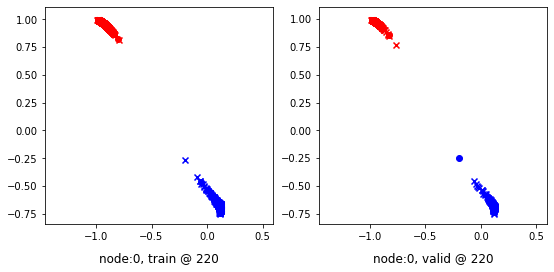

220 	 1 	 0.24749774 	 0.19566834 	 0.49907124 	 0.45450824 	 0.94483680 	 0.95198709


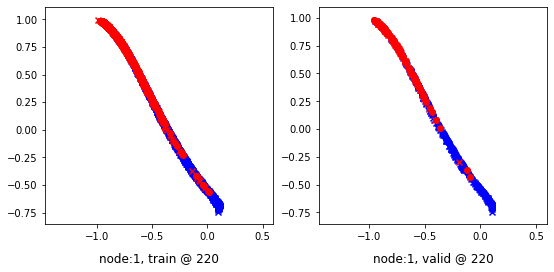

Aggregating on epoch: 221...
Aggregating on epoch: 222...
Aggregating on epoch: 223...
Aggregating on epoch: 224...
Aggregating on epoch: 225...
Aggregating on epoch: 226...
Aggregating on epoch: 227...
Aggregating on epoch: 228...
Aggregating on epoch: 229...
Aggregating on epoch: 230...
Aggregating on epoch: 231...
Aggregating on epoch: 232...
Aggregating on epoch: 233...
Aggregating on epoch: 234...
Aggregating on epoch: 235...
Aggregating on epoch: 236...
Aggregating on epoch: 237...
Aggregating on epoch: 238...
Aggregating on epoch: 239...
Aggregating on epoch: 240...
240 	 0 	 -0.14793870 	 -0.20424265 	 0.00187283 	 0.00197066 	 0.84299159 	 0.89936048


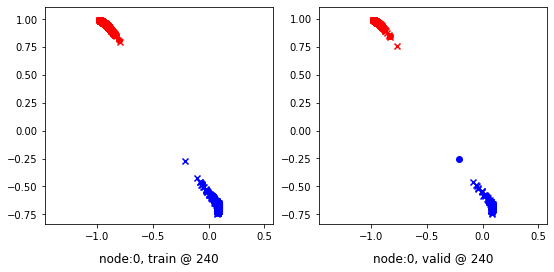

240 	 1 	 0.21867263 	 0.19843662 	 0.47794330 	 0.45689446 	 0.95210493 	 0.95160502


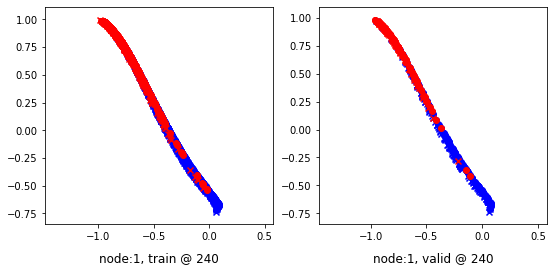

Aggregating on epoch: 241...
Aggregating on epoch: 242...
Aggregating on epoch: 243...
Aggregating on epoch: 244...
Aggregating on epoch: 245...
Aggregating on epoch: 246...
Aggregating on epoch: 247...
Aggregating on epoch: 248...
Aggregating on epoch: 249...
Aggregating on epoch: 250...
Aggregating on epoch: 251...
Aggregating on epoch: 252...
Aggregating on epoch: 253...
Aggregating on epoch: 254...
Aggregating on epoch: 255...
Aggregating on epoch: 256...
Aggregating on epoch: 257...
Aggregating on epoch: 258...
Aggregating on epoch: 259...
Aggregating on epoch: 260...
260 	 0 	 -0.20991969 	 -0.20489641 	 0.00136097 	 0.00157491 	 0.90444243 	 0.89961851


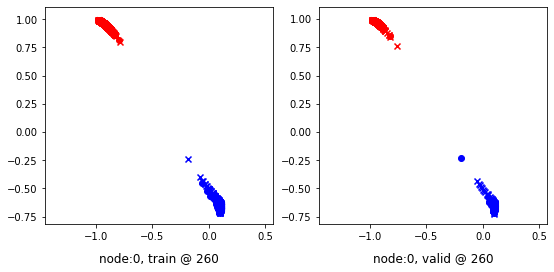

260 	 1 	 0.25803733 	 0.19799617 	 0.51678413 	 0.45627812 	 0.95203739 	 0.95142913


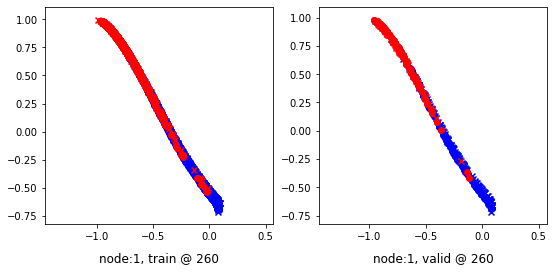

Aggregating on epoch: 261...
Aggregating on epoch: 262...
Aggregating on epoch: 263...
Aggregating on epoch: 264...
Aggregating on epoch: 265...
Aggregating on epoch: 266...
Aggregating on epoch: 267...
Aggregating on epoch: 268...
Aggregating on epoch: 269...
Aggregating on epoch: 270...
Aggregating on epoch: 271...
Aggregating on epoch: 272...
Aggregating on epoch: 273...
Aggregating on epoch: 274...
Aggregating on epoch: 275...
Aggregating on epoch: 276...
Aggregating on epoch: 277...
Aggregating on epoch: 278...
Aggregating on epoch: 279...
Aggregating on epoch: 280...
280 	 0 	 -0.26892498 	 -0.20479271 	 0.00119440 	 0.00142160 	 0.96327585 	 0.89936149


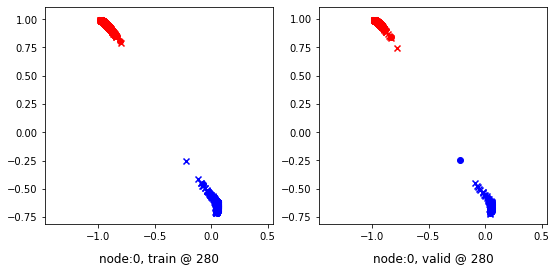

280 	 1 	 0.26854444 	 0.19735771 	 0.51980734 	 0.45571238 	 0.94430071 	 0.95150185


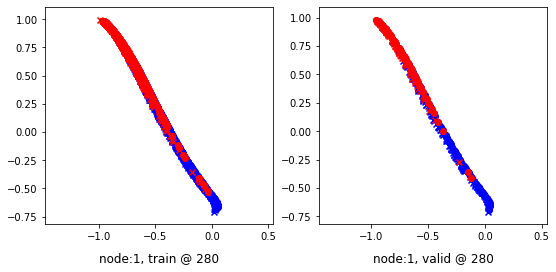

Aggregating on epoch: 281...
Aggregating on epoch: 282...
Aggregating on epoch: 283...
Aggregating on epoch: 284...
Aggregating on epoch: 285...
Aggregating on epoch: 286...
Aggregating on epoch: 287...
Aggregating on epoch: 288...
Aggregating on epoch: 289...
Aggregating on epoch: 290...
Aggregating on epoch: 291...
Aggregating on epoch: 292...
Aggregating on epoch: 293...
Aggregating on epoch: 294...
Aggregating on epoch: 295...
Aggregating on epoch: 296...
Aggregating on epoch: 297...
Aggregating on epoch: 298...
Aggregating on epoch: 299...
Aggregating on epoch: 300...
300 	 0 	 -0.21309417 	 -0.20498776 	 0.00109525 	 0.00122481 	 0.90735835 	 0.89935976


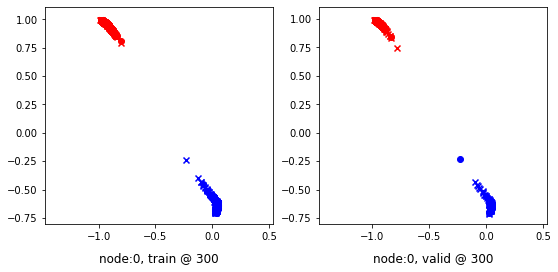

300 	 1 	 0.21460667 	 0.19692582 	 0.46590358 	 0.45497173 	 0.94453412 	 0.95119309


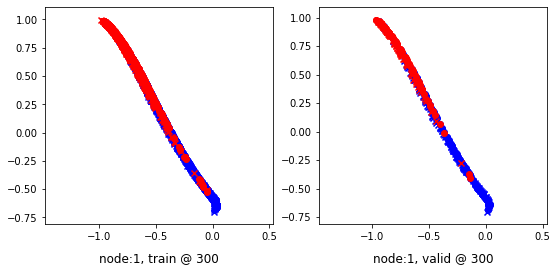

Aggregating on epoch: 301...
Aggregating on epoch: 302...
Aggregating on epoch: 303...
Aggregating on epoch: 304...
Aggregating on epoch: 305...
Aggregating on epoch: 306...
Aggregating on epoch: 307...
Aggregating on epoch: 308...
Aggregating on epoch: 309...
Aggregating on epoch: 310...
Aggregating on epoch: 311...
Aggregating on epoch: 312...
Aggregating on epoch: 313...
Aggregating on epoch: 314...
Aggregating on epoch: 315...
Aggregating on epoch: 316...
Aggregating on epoch: 317...
Aggregating on epoch: 318...
Aggregating on epoch: 319...
Aggregating on epoch: 320...
320 	 0 	 -0.18596804 	 -0.20534934 	 0.00089600 	 0.00099824 	 0.88004392 	 0.89949477


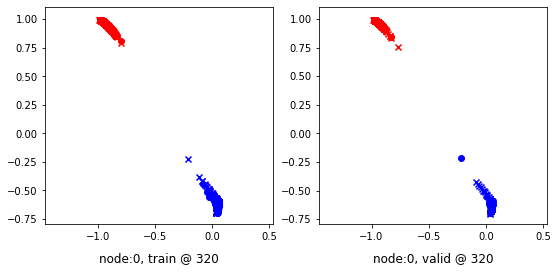

320 	 1 	 0.19579989 	 0.19685206 	 0.45522365 	 0.45482394 	 0.95257258 	 0.95111907


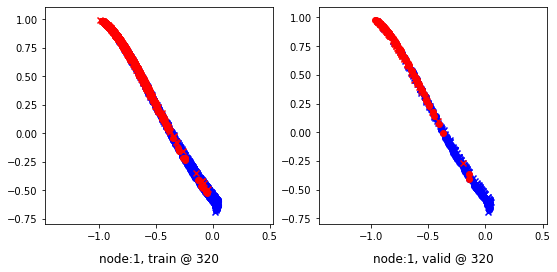

Aggregating on epoch: 321...
Aggregating on epoch: 322...
Aggregating on epoch: 323...
Aggregating on epoch: 324...
Aggregating on epoch: 325...
Aggregating on epoch: 326...
Aggregating on epoch: 327...
Aggregating on epoch: 328...
Aggregating on epoch: 329...
Aggregating on epoch: 330...
Aggregating on epoch: 331...
Aggregating on epoch: 332...
Aggregating on epoch: 333...
Aggregating on epoch: 334...
Aggregating on epoch: 335...
Aggregating on epoch: 336...
Aggregating on epoch: 337...
Aggregating on epoch: 338...
Aggregating on epoch: 339...
Aggregating on epoch: 340...
340 	 0 	 -0.21087655 	 -0.20544705 	 0.00074160 	 0.00086370 	 0.90478683 	 0.89945793


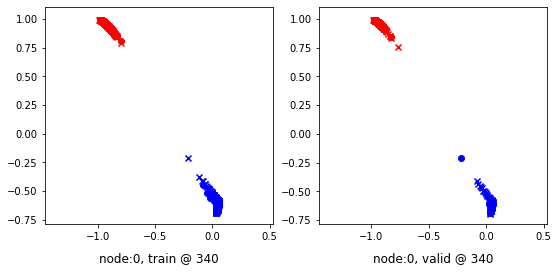

340 	 1 	 0.18377301 	 0.19656089 	 0.44438803 	 0.45463076 	 0.95377445 	 0.95121706


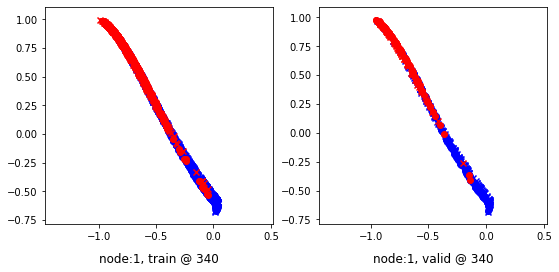

Aggregating on epoch: 341...
Aggregating on epoch: 342...
Aggregating on epoch: 343...
Aggregating on epoch: 344...
Aggregating on epoch: 345...
Aggregating on epoch: 346...
Aggregating on epoch: 347...
Aggregating on epoch: 348...
Aggregating on epoch: 349...
Aggregating on epoch: 350...
Aggregating on epoch: 351...
Aggregating on epoch: 352...
Aggregating on epoch: 353...
Aggregating on epoch: 354...
Aggregating on epoch: 355...
Aggregating on epoch: 356...
Aggregating on epoch: 357...
Aggregating on epoch: 358...
Aggregating on epoch: 359...
Aggregating on epoch: 360...
360 	 0 	 -0.24464935 	 -0.20537761 	 0.00073413 	 0.00079747 	 0.93854666 	 0.89932227


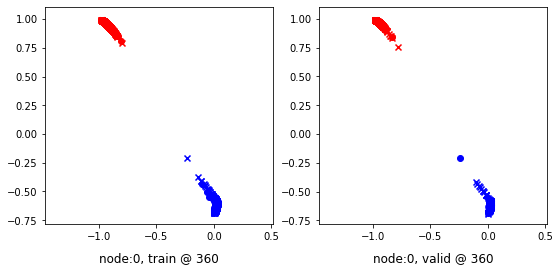

360 	 1 	 0.25206482 	 0.19742224 	 0.51452136 	 0.45535299 	 0.95561457 	 0.95107794


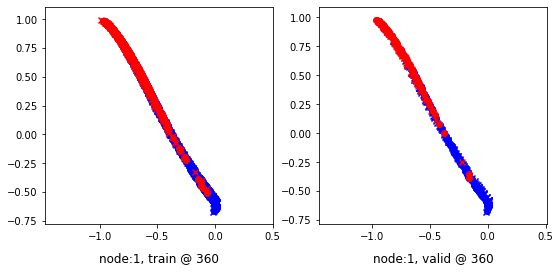

Aggregating on epoch: 361...
Aggregating on epoch: 362...
Aggregating on epoch: 363...
Aggregating on epoch: 364...
Aggregating on epoch: 365...
Aggregating on epoch: 366...
Aggregating on epoch: 367...
Aggregating on epoch: 368...
Aggregating on epoch: 369...
Aggregating on epoch: 370...
Aggregating on epoch: 371...
Aggregating on epoch: 372...
Aggregating on epoch: 373...
Aggregating on epoch: 374...
Aggregating on epoch: 375...
Aggregating on epoch: 376...
Aggregating on epoch: 377...
Aggregating on epoch: 378...
Aggregating on epoch: 379...
Aggregating on epoch: 380...
380 	 0 	 -0.19017980 	 -0.20531182 	 0.00066162 	 0.00070932 	 0.88401163 	 0.89916831


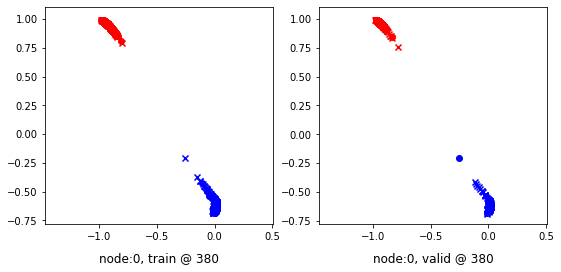

380 	 1 	 0.23297325 	 0.19780943 	 0.48410684 	 0.45558664 	 0.94436413 	 0.95092440


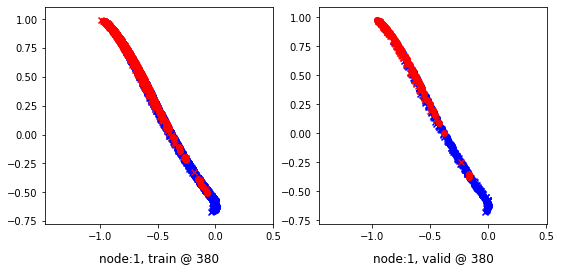

Aggregating on epoch: 381...
Aggregating on epoch: 382...
Aggregating on epoch: 383...
Aggregating on epoch: 384...
Aggregating on epoch: 385...
Aggregating on epoch: 386...
Aggregating on epoch: 387...
Aggregating on epoch: 388...
Aggregating on epoch: 389...
Aggregating on epoch: 390...
Aggregating on epoch: 391...
Aggregating on epoch: 392...
Aggregating on epoch: 393...
Aggregating on epoch: 394...
Aggregating on epoch: 395...
Aggregating on epoch: 396...
Aggregating on epoch: 397...
Aggregating on epoch: 398...
Aggregating on epoch: 399...
Aggregating on epoch: 400...
400 	 0 	 -0.19008049 	 -0.20538782 	 0.00048394 	 0.00060202 	 0.88373685 	 0.89913702


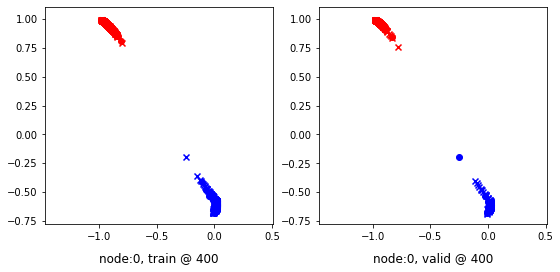

400 	 1 	 0.26809680 	 0.19819173 	 0.51760387 	 0.45583537 	 0.94353431 	 0.95079082


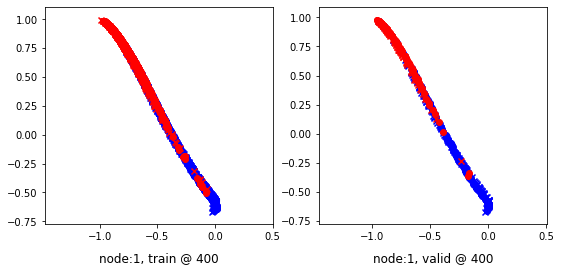

Aggregating on epoch: 401...
Aggregating on epoch: 402...
Aggregating on epoch: 403...
Aggregating on epoch: 404...
Aggregating on epoch: 405...
Aggregating on epoch: 406...
Aggregating on epoch: 407...
Aggregating on epoch: 408...
Aggregating on epoch: 409...
Aggregating on epoch: 410...
Aggregating on epoch: 411...
Aggregating on epoch: 412...
Aggregating on epoch: 413...
Aggregating on epoch: 414...
Aggregating on epoch: 415...
Aggregating on epoch: 416...
Aggregating on epoch: 417...
Aggregating on epoch: 418...
Aggregating on epoch: 419...
Aggregating on epoch: 420...
420 	 0 	 -0.16951552 	 -0.20544255 	 0.00043896 	 0.00054258 	 0.86313802 	 0.89913231


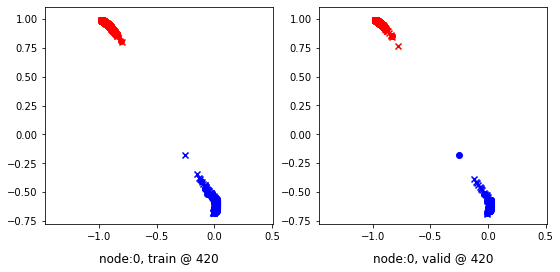

420 	 1 	 0.18719342 	 0.19931540 	 0.44124603 	 0.45666638 	 0.94734764 	 0.95049816


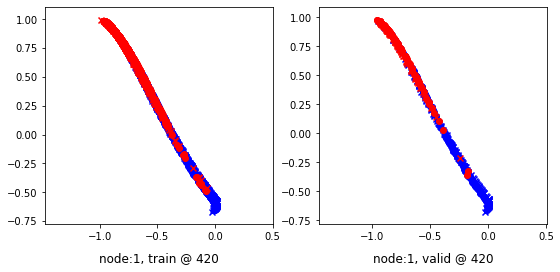

Aggregating on epoch: 421...
Aggregating on epoch: 422...
Aggregating on epoch: 423...
Aggregating on epoch: 424...
Aggregating on epoch: 425...
Aggregating on epoch: 426...
Aggregating on epoch: 427...
Aggregating on epoch: 428...
Aggregating on epoch: 429...
Aggregating on epoch: 430...
Aggregating on epoch: 431...
Aggregating on epoch: 432...
Aggregating on epoch: 433...
Aggregating on epoch: 434...
Aggregating on epoch: 435...
Aggregating on epoch: 436...
Aggregating on epoch: 437...
Aggregating on epoch: 438...
Aggregating on epoch: 439...
Aggregating on epoch: 440...
440 	 0 	 -0.22801213 	 -0.20560427 	 0.00043299 	 0.00047605 	 0.92163312 	 0.89922750


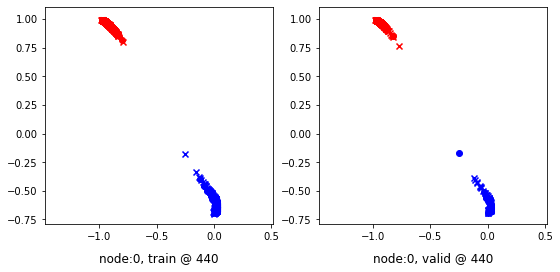

440 	 1 	 0.25537783 	 0.19780970 	 0.50610149 	 0.45410782 	 0.94488871 	 0.94944531


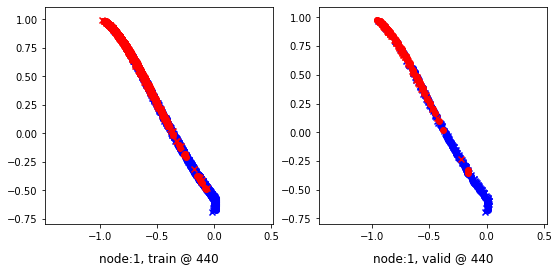

Aggregating on epoch: 441...
Aggregating on epoch: 442...
Aggregating on epoch: 443...
Aggregating on epoch: 444...
Aggregating on epoch: 445...
Aggregating on epoch: 446...
Aggregating on epoch: 447...
Aggregating on epoch: 448...
Aggregating on epoch: 449...
Aggregating on epoch: 450...
Aggregating on epoch: 451...
Aggregating on epoch: 452...
Aggregating on epoch: 453...
Aggregating on epoch: 454...
Aggregating on epoch: 455...
Aggregating on epoch: 456...
Aggregating on epoch: 457...
Aggregating on epoch: 458...
Aggregating on epoch: 459...
Aggregating on epoch: 460...
460 	 0 	 -0.18703550 	 -0.20556733 	 0.00032220 	 0.00043604 	 0.88053417 	 0.89915055


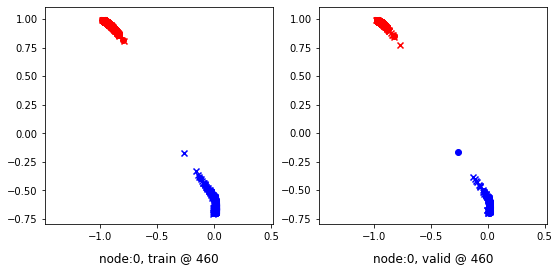

460 	 1 	 0.19704783 	 0.19915622 	 0.46052974 	 0.45515871 	 0.95681661 	 0.94914967


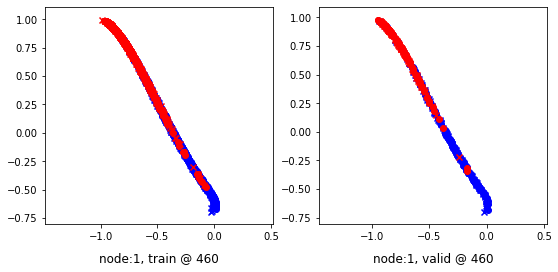

Aggregating on epoch: 461...
Aggregating on epoch: 462...
Aggregating on epoch: 463...
Aggregating on epoch: 464...
Aggregating on epoch: 465...
Aggregating on epoch: 466...
Aggregating on epoch: 467...
Aggregating on epoch: 468...
Aggregating on epoch: 469...
Aggregating on epoch: 470...
Aggregating on epoch: 471...
Aggregating on epoch: 472...
Aggregating on epoch: 473...
Aggregating on epoch: 474...
Aggregating on epoch: 475...
Aggregating on epoch: 476...
Aggregating on epoch: 477...
Aggregating on epoch: 478...
Aggregating on epoch: 479...
Aggregating on epoch: 480...
480 	 0 	 -0.19500624 	 -0.20554321 	 0.00028088 	 0.00037194 	 0.88846356 	 0.89906234


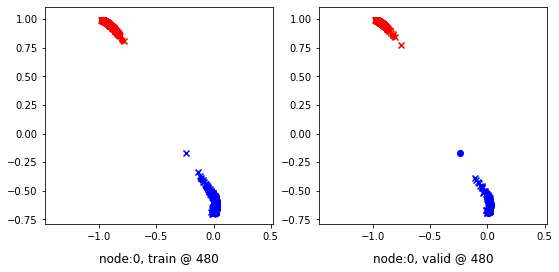

480 	 1 	 0.19639325 	 0.19737545 	 0.45128432 	 0.45347705 	 0.94822055 	 0.94924879


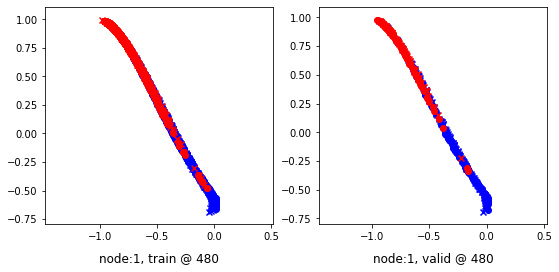

Aggregating on epoch: 481...
Aggregating on epoch: 482...
Aggregating on epoch: 483...
Aggregating on epoch: 484...
Aggregating on epoch: 485...
Aggregating on epoch: 486...
Aggregating on epoch: 487...
Aggregating on epoch: 488...
Aggregating on epoch: 489...
Aggregating on epoch: 490...
Aggregating on epoch: 491...
Aggregating on epoch: 492...
Aggregating on epoch: 493...
Aggregating on epoch: 494...
Aggregating on epoch: 495...
Aggregating on epoch: 496...
Aggregating on epoch: 497...
Aggregating on epoch: 498...
Aggregating on epoch: 499...
Aggregating on epoch: 500...
500 	 0 	 -0.24811029 	 -0.20547028 	 0.00029239 	 0.00036429 	 0.94160151 	 0.89898175


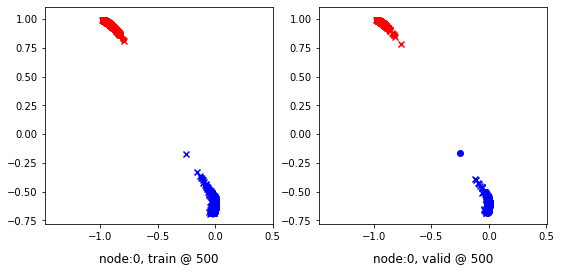

500 	 1 	 0.29267794 	 0.19820982 	 0.55195177 	 0.45444596 	 0.95275521 	 0.94938332


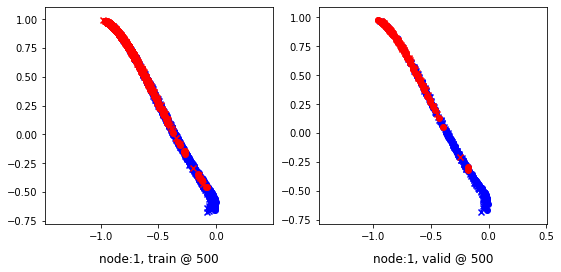

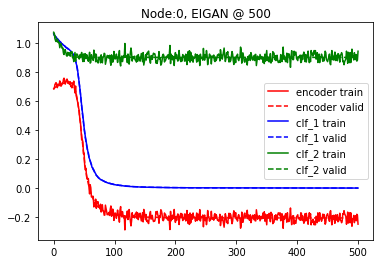

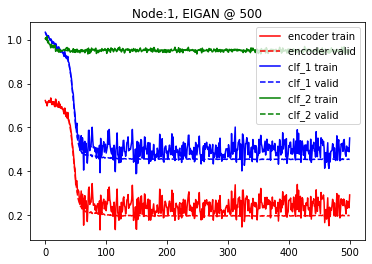

--------------------------------------------------------------------------------
EIGAN Training w/ phi=1.0 and delta=3
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.70716000 	 0.70796394 	 1.01667964 	 1.01682079 	 1.00282621 	 1.00200403


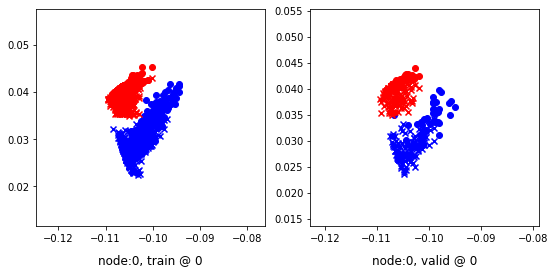

0 	 1 	 0.71255291 	 0.73155880 	 1.08705831 	 1.09716356 	 1.06776536 	 1.05875194


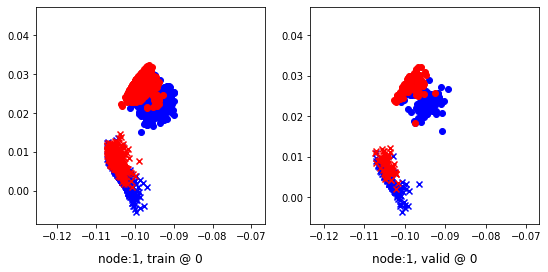

Aggregating on epoch: 3...
Aggregating on epoch: 6...
Aggregating on epoch: 9...
Aggregating on epoch: 12...
Aggregating on epoch: 15...
Aggregating on epoch: 18...
20 	 0 	 0.72662073 	 0.72134548 	 0.93828106 	 0.94173777 	 0.90521759 	 0.91353947


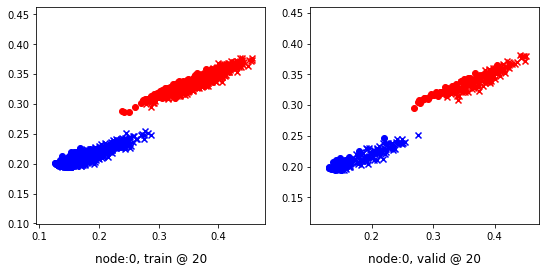

20 	 1 	 0.67486840 	 0.68845433 	 0.94801056 	 0.95878041 	 0.96650392 	 0.96347326


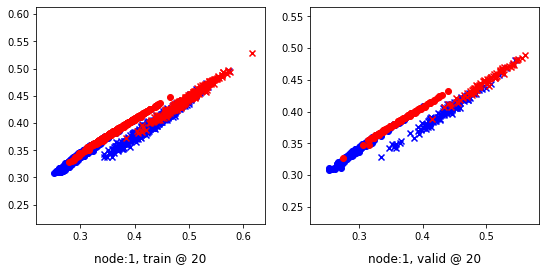

Aggregating on epoch: 21...
Aggregating on epoch: 24...
Aggregating on epoch: 27...
Aggregating on epoch: 30...
Aggregating on epoch: 33...
Aggregating on epoch: 36...
Aggregating on epoch: 39...
40 	 0 	 0.56159896 	 0.55529869 	 0.77250636 	 0.76430809 	 0.90789974 	 0.90215659


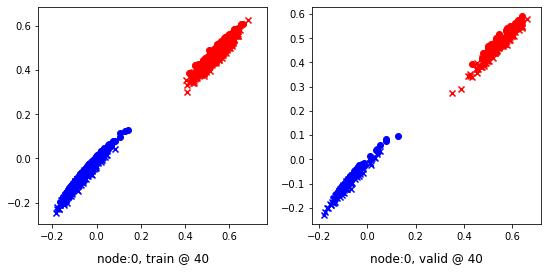

40 	 1 	 0.65281862 	 0.65971172 	 0.92571557 	 0.91850841 	 0.96639985 	 0.95194387


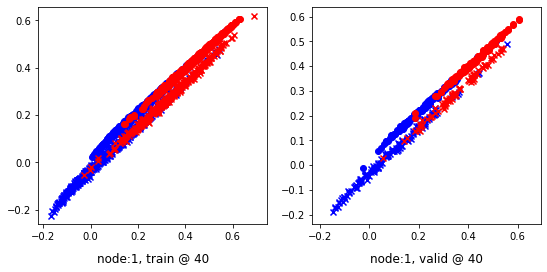

Aggregating on epoch: 42...
Aggregating on epoch: 45...
Aggregating on epoch: 48...
Aggregating on epoch: 51...
Aggregating on epoch: 54...
Aggregating on epoch: 57...
Aggregating on epoch: 60...
60 	 0 	 -0.08556688 	 -0.08115555 	 0.11885814 	 0.12397532 	 0.89837015 	 0.89827806


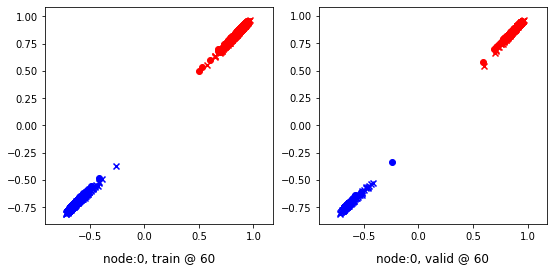

60 	 1 	 0.31482983 	 0.30806732 	 0.56161028 	 0.56388402 	 0.94651854 	 0.94896388


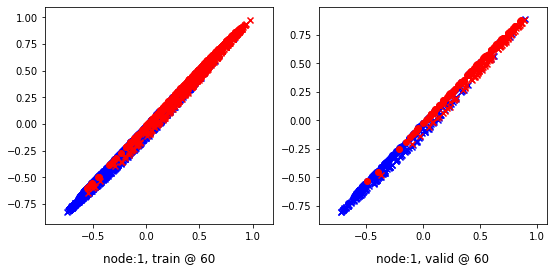

Aggregating on epoch: 63...
Aggregating on epoch: 66...
Aggregating on epoch: 69...
Aggregating on epoch: 72...
Aggregating on epoch: 75...
Aggregating on epoch: 78...
80 	 0 	 -0.18777497 	 -0.18050477 	 0.02406805 	 0.02483925 	 0.90508157 	 0.89849120


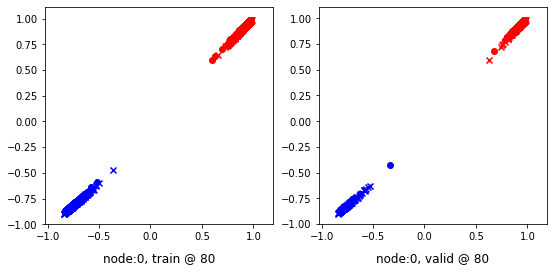

80 	 1 	 0.26776165 	 0.20677277 	 0.53137702 	 0.46029016 	 0.95721406 	 0.94666457


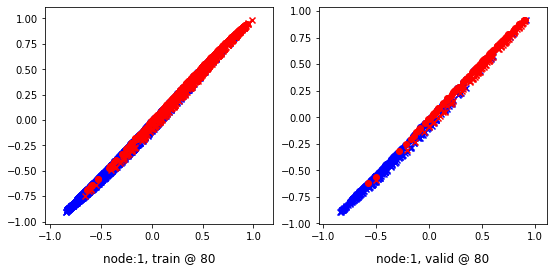

Aggregating on epoch: 81...
Aggregating on epoch: 84...
Aggregating on epoch: 87...
Aggregating on epoch: 90...
Aggregating on epoch: 93...
Aggregating on epoch: 96...
Aggregating on epoch: 99...
100 	 0 	 -0.22108847 	 -0.19540447 	 0.01086218 	 0.01097225 	 0.92514002 	 0.89952391


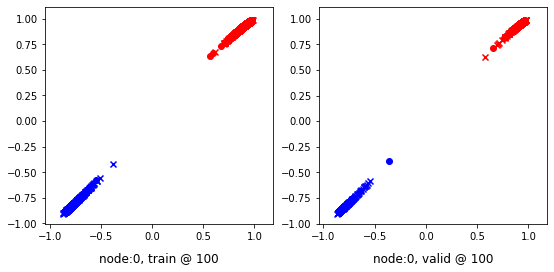

100 	 1 	 0.26868922 	 0.20217648 	 0.52752578 	 0.45864823 	 0.95310366 	 0.94961894


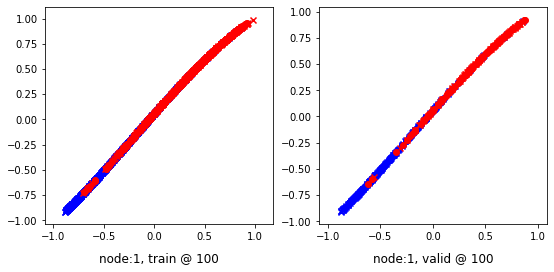

Aggregating on epoch: 102...
Aggregating on epoch: 105...
Aggregating on epoch: 108...
Aggregating on epoch: 111...
Aggregating on epoch: 114...
Aggregating on epoch: 117...
Aggregating on epoch: 120...
120 	 0 	 -0.23318702 	 -0.20096329 	 0.00615765 	 0.00638690 	 0.93256789 	 0.90049738


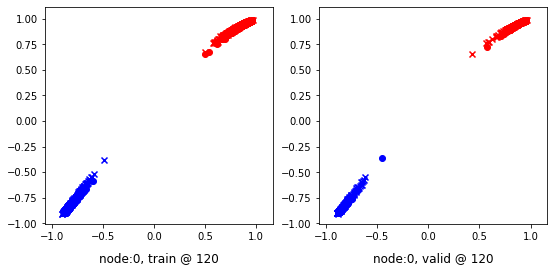

120 	 1 	 0.24756098 	 0.20423320 	 0.51646280 	 0.46498361 	 0.96170610 	 0.95389760


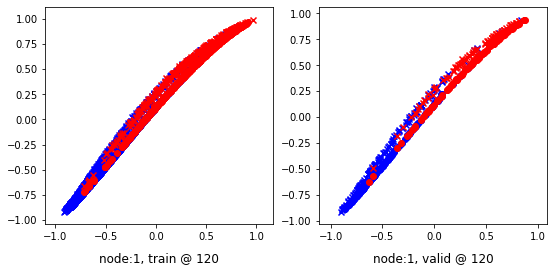

Aggregating on epoch: 123...
Aggregating on epoch: 126...
Aggregating on epoch: 129...
Aggregating on epoch: 132...
Aggregating on epoch: 135...
Aggregating on epoch: 138...
140 	 0 	 -0.19047910 	 -0.20382540 	 0.00424032 	 0.00439979 	 0.88794541 	 0.90137237


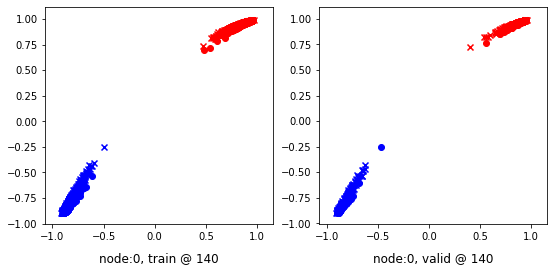

140 	 1 	 0.22168022 	 0.19902486 	 0.47723034 	 0.45706552 	 0.95020026 	 0.95118785


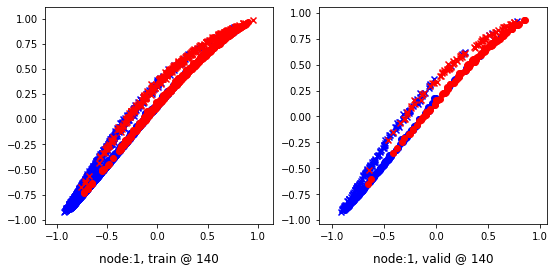

Aggregating on epoch: 141...
Aggregating on epoch: 144...
Aggregating on epoch: 147...
Aggregating on epoch: 150...
Aggregating on epoch: 153...
Aggregating on epoch: 156...
Aggregating on epoch: 159...
160 	 0 	 -0.17848395 	 -0.20463432 	 0.00264965 	 0.00302790 	 0.87433481 	 0.90080941


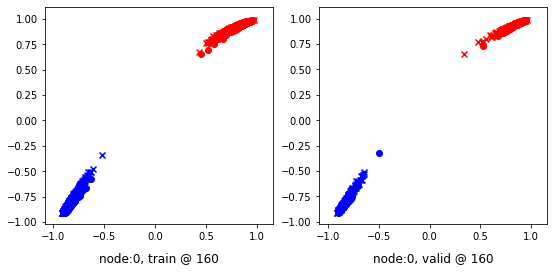

160 	 1 	 0.23985469 	 0.19975105 	 0.49572700 	 0.45614538 	 0.94836593 	 0.94954151


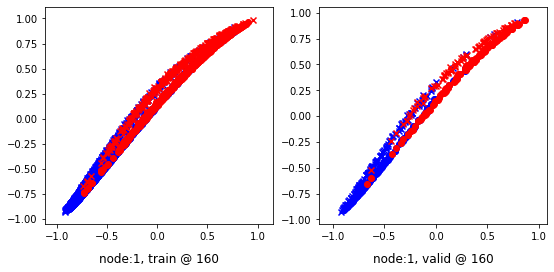

Aggregating on epoch: 162...
Aggregating on epoch: 165...
Aggregating on epoch: 168...
Aggregating on epoch: 171...
Aggregating on epoch: 174...
Aggregating on epoch: 177...
Aggregating on epoch: 180...
180 	 0 	 -0.18951611 	 -0.20511587 	 0.00212810 	 0.00220417 	 0.88481104 	 0.90046722


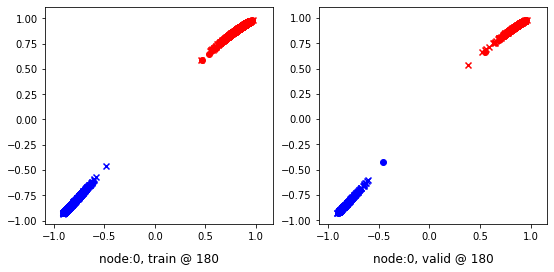

180 	 1 	 0.24556595 	 0.19952750 	 0.50321937 	 0.45773143 	 0.95130473 	 0.95135111


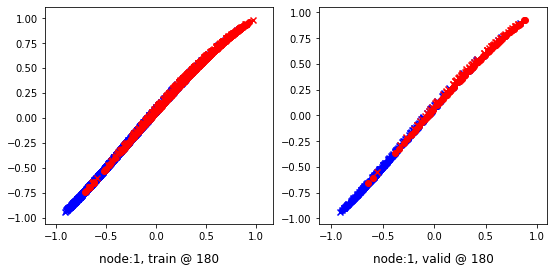

Aggregating on epoch: 183...
Aggregating on epoch: 186...
Aggregating on epoch: 189...
Aggregating on epoch: 192...
Aggregating on epoch: 195...
Aggregating on epoch: 198...
200 	 0 	 -0.26154560 	 -0.20554557 	 0.00164114 	 0.00171819 	 0.95634395 	 0.90041095


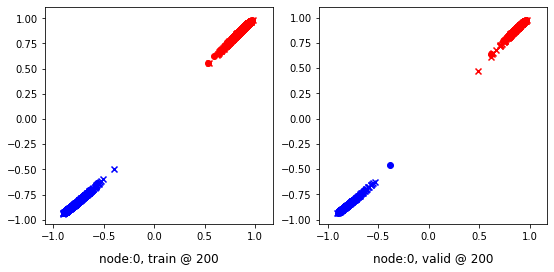

200 	 1 	 0.18197379 	 0.19528577 	 0.43637112 	 0.45651957 	 0.94831353 	 0.95438099


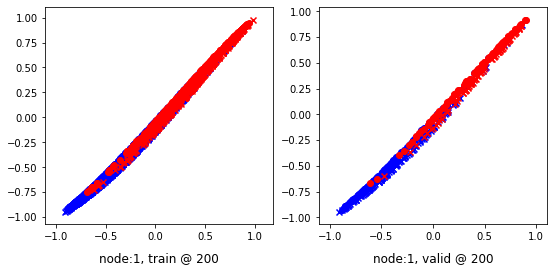

Aggregating on epoch: 201...
Aggregating on epoch: 204...
Aggregating on epoch: 207...
Aggregating on epoch: 210...
Aggregating on epoch: 213...
Aggregating on epoch: 216...
Aggregating on epoch: 219...
220 	 0 	 -0.17698812 	 -0.20567863 	 0.00124489 	 0.00137646 	 0.87138128 	 0.90020227


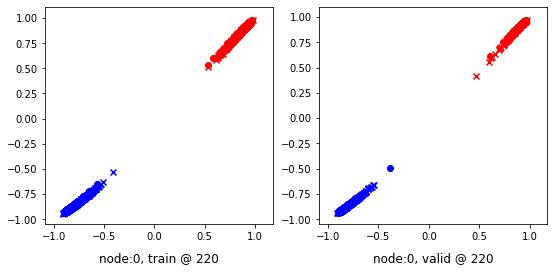

220 	 1 	 0.21666330 	 0.19999534 	 0.46956402 	 0.45499915 	 0.94637489 	 0.94815099


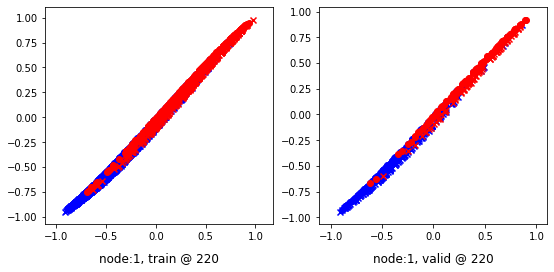

Aggregating on epoch: 222...
Aggregating on epoch: 225...
Aggregating on epoch: 228...
Aggregating on epoch: 231...
Aggregating on epoch: 234...
Aggregating on epoch: 237...
Aggregating on epoch: 240...
240 	 0 	 -0.17669372 	 -0.20576958 	 0.00101318 	 0.00111480 	 0.87085575 	 0.90003157


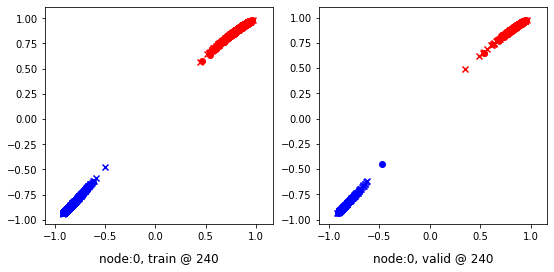

240 	 1 	 0.23813814 	 0.19671348 	 0.49016976 	 0.45525584 	 0.94513547 	 0.95168954


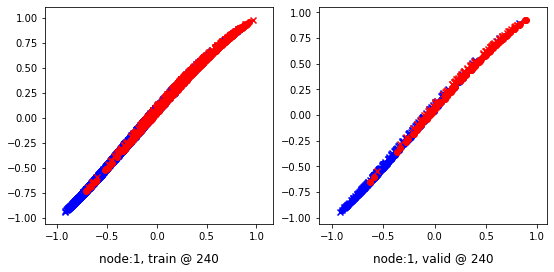

Aggregating on epoch: 243...
Aggregating on epoch: 246...
Aggregating on epoch: 249...
Aggregating on epoch: 252...
Aggregating on epoch: 255...
Aggregating on epoch: 258...
260 	 0 	 -0.15918921 	 -0.20580800 	 0.00082147 	 0.00091796 	 0.85315913 	 0.89987314


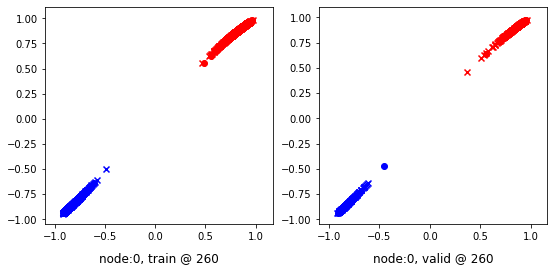

260 	 1 	 0.24466294 	 0.19617501 	 0.49683076 	 0.45533666 	 0.94506961 	 0.95230883


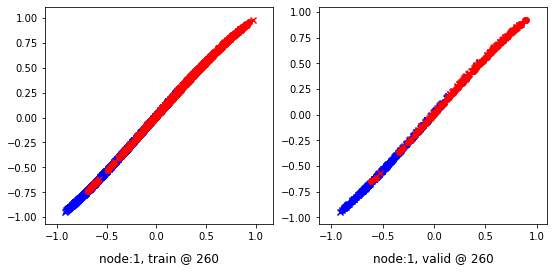

Aggregating on epoch: 261...
Aggregating on epoch: 264...
Aggregating on epoch: 267...
Aggregating on epoch: 270...
Aggregating on epoch: 273...
Aggregating on epoch: 276...
Aggregating on epoch: 279...
280 	 0 	 -0.21074250 	 -0.20579945 	 0.00070663 	 0.00077303 	 0.90459734 	 0.89971966


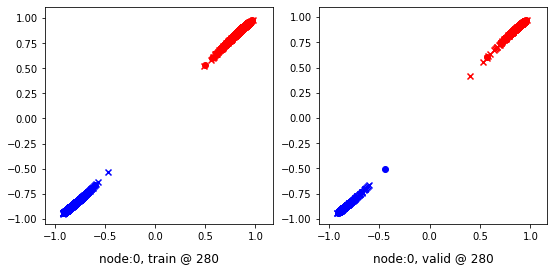

280 	 1 	 0.18858853 	 0.19516489 	 0.45141724 	 0.45516983 	 0.95608795 	 0.95315212


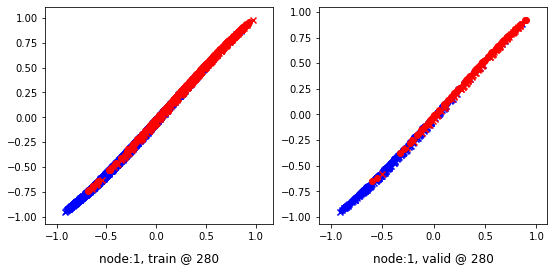

Aggregating on epoch: 282...
Aggregating on epoch: 285...
Aggregating on epoch: 288...
Aggregating on epoch: 291...
Aggregating on epoch: 294...
Aggregating on epoch: 297...
Aggregating on epoch: 300...
300 	 0 	 -0.20039293 	 -0.20581616 	 0.00060010 	 0.00066422 	 0.89414167 	 0.89962757


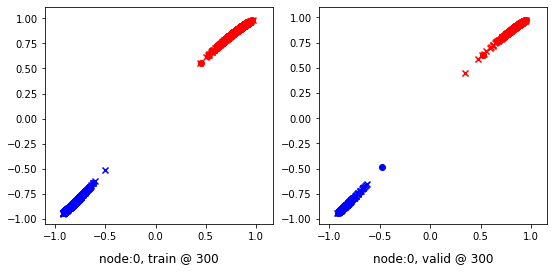

300 	 1 	 0.20709649 	 0.19532436 	 0.45774454 	 0.45520765 	 0.94410974 	 0.95303047


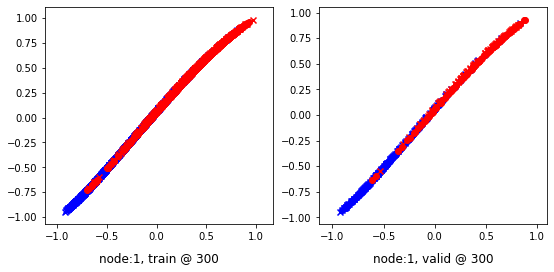

Aggregating on epoch: 303...
Aggregating on epoch: 306...
Aggregating on epoch: 309...
Aggregating on epoch: 312...
Aggregating on epoch: 315...
Aggregating on epoch: 318...
320 	 0 	 -0.20789377 	 -0.20584291 	 0.00050996 	 0.00056726 	 0.90155250 	 0.89955735


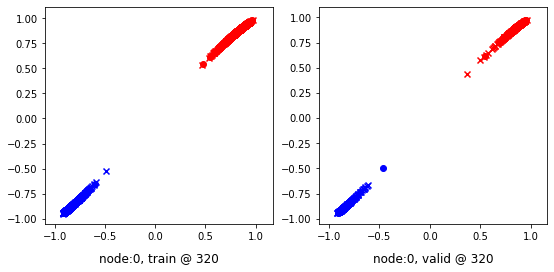

320 	 1 	 0.25739330 	 0.19441608 	 0.50765210 	 0.45444998 	 0.94473857 	 0.95318109


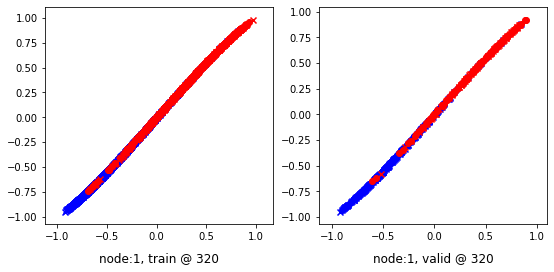

Aggregating on epoch: 321...
Aggregating on epoch: 324...
Aggregating on epoch: 327...
Aggregating on epoch: 330...
Aggregating on epoch: 333...
Aggregating on epoch: 336...
Aggregating on epoch: 339...
340 	 0 	 -0.19720399 	 -0.20575744 	 0.00046641 	 0.00048965 	 0.89081961 	 0.89939427


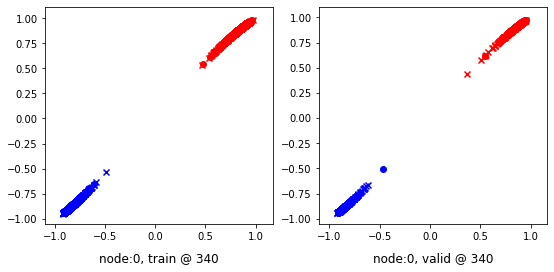

340 	 1 	 0.23949870 	 0.19359109 	 0.49750361 	 0.45313409 	 0.95069098 	 0.95269018


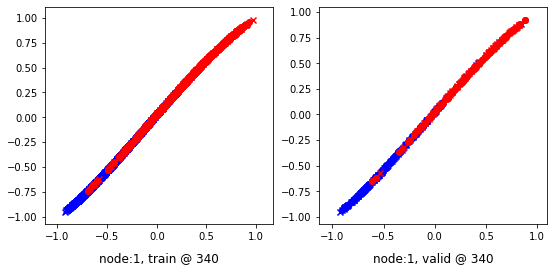

Aggregating on epoch: 342...
Aggregating on epoch: 345...
Aggregating on epoch: 348...
Aggregating on epoch: 351...
Aggregating on epoch: 354...
Aggregating on epoch: 357...
Aggregating on epoch: 360...
360 	 0 	 -0.18110487 	 -0.20586409 	 0.00036205 	 0.00042384 	 0.87461466 	 0.89943510


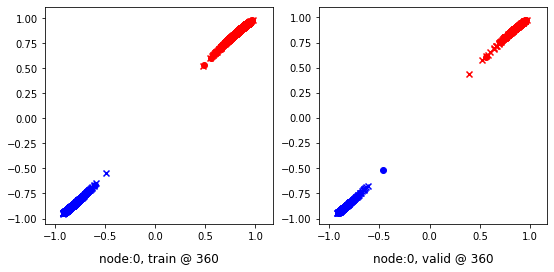

360 	 1 	 0.26773828 	 0.19439825 	 0.52456057 	 0.45421776 	 0.95029950 	 0.95296669


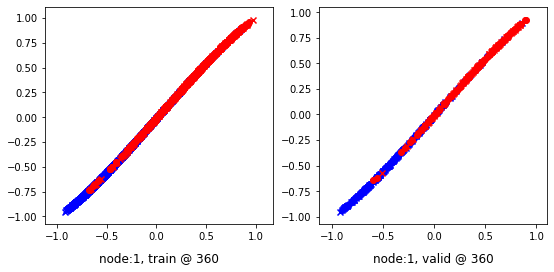

Aggregating on epoch: 363...
Aggregating on epoch: 366...
Aggregating on epoch: 369...
Aggregating on epoch: 372...
Aggregating on epoch: 375...
Aggregating on epoch: 378...
380 	 0 	 -0.23222105 	 -0.20585795 	 0.00031924 	 0.00037067 	 0.92568856 	 0.89937580


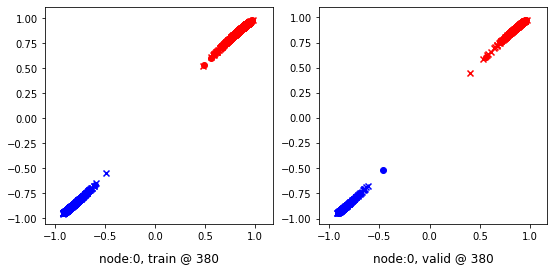

380 	 1 	 0.25594538 	 0.19464520 	 0.51527435 	 0.45474115 	 0.95228004 	 0.95324314


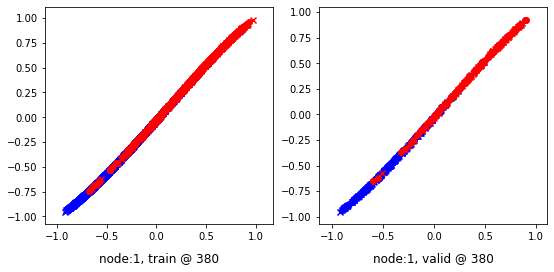

Aggregating on epoch: 381...
Aggregating on epoch: 384...
Aggregating on epoch: 387...
Aggregating on epoch: 390...
Aggregating on epoch: 393...
Aggregating on epoch: 396...
Aggregating on epoch: 399...
400 	 0 	 -0.20753920 	 -0.20582500 	 0.00029765 	 0.00032970 	 0.90098470 	 0.89930189


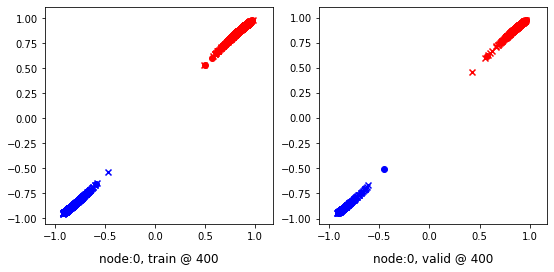

400 	 1 	 0.32048571 	 0.19384718 	 0.58455497 	 0.45361400 	 0.95893908 	 0.95291400


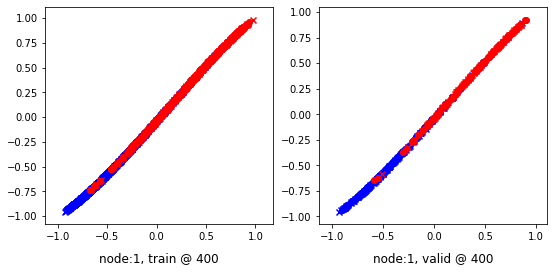

Aggregating on epoch: 402...
Aggregating on epoch: 405...
Aggregating on epoch: 408...
Aggregating on epoch: 411...
Aggregating on epoch: 414...
Aggregating on epoch: 417...
Aggregating on epoch: 420...
420 	 0 	 -0.27612811 	 -0.20601149 	 0.00026826 	 0.00029247 	 0.96954644 	 0.89945114


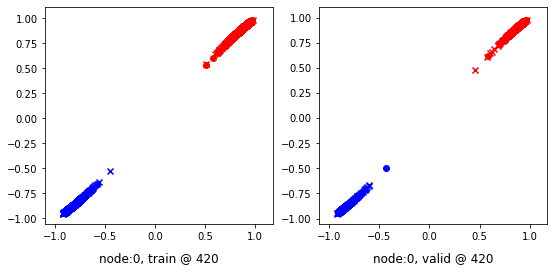

420 	 1 	 0.23168409 	 0.19486201 	 0.49390081 	 0.45497918 	 0.95551729 	 0.95326436


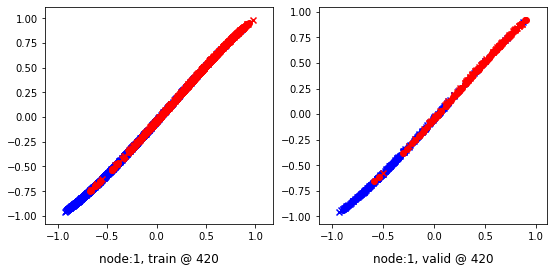

Aggregating on epoch: 423...
Aggregating on epoch: 426...
Aggregating on epoch: 429...
Aggregating on epoch: 432...
Aggregating on epoch: 435...
Aggregating on epoch: 438...
440 	 0 	 -0.18369913 	 -0.20604715 	 0.00024225 	 0.00026140 	 0.87709206 	 0.89945573


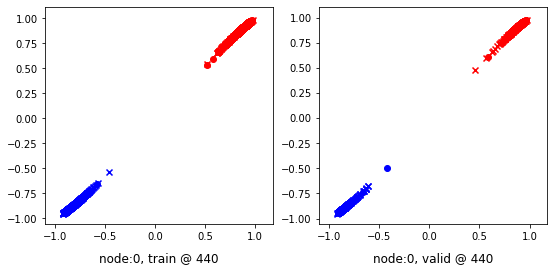

440 	 1 	 0.20562017 	 0.19646284 	 0.46378204 	 0.45610073 	 0.95171690 	 0.95278507


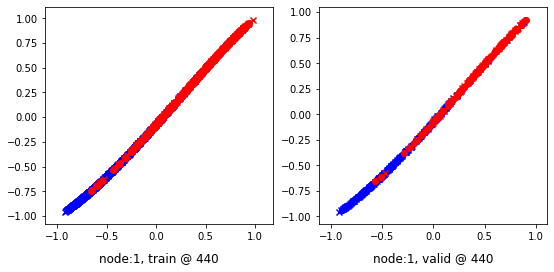

Aggregating on epoch: 441...
Aggregating on epoch: 444...
Aggregating on epoch: 447...
Aggregating on epoch: 450...
Aggregating on epoch: 453...
Aggregating on epoch: 456...
Aggregating on epoch: 459...
460 	 0 	 -0.18083300 	 -0.20610674 	 0.00019954 	 0.00023811 	 0.87418437 	 0.89949203


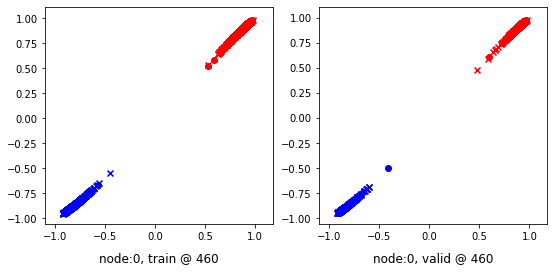

460 	 1 	 0.25993085 	 0.19615129 	 0.52183264 	 0.45558861 	 0.95538956 	 0.95258451


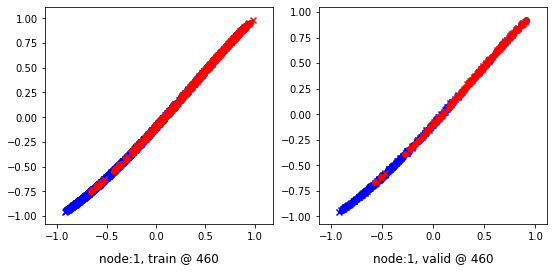

Aggregating on epoch: 462...
Aggregating on epoch: 465...
Aggregating on epoch: 468...
Aggregating on epoch: 471...
Aggregating on epoch: 474...
Aggregating on epoch: 477...
Aggregating on epoch: 480...
480 	 0 	 -0.18668427 	 -0.20583384 	 0.00020242 	 0.00022073 	 0.88005042 	 0.89920175


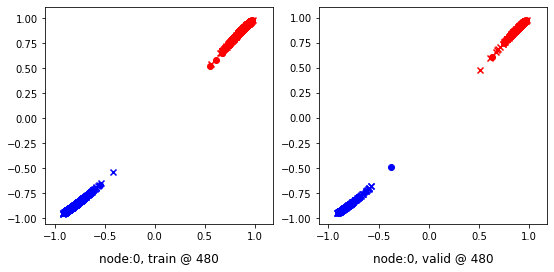

480 	 1 	 0.24689001 	 0.19576797 	 0.51225609 	 0.45529333 	 0.95908779 	 0.95267254


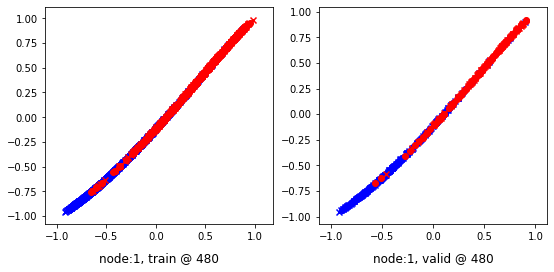

Aggregating on epoch: 483...
Aggregating on epoch: 486...
Aggregating on epoch: 489...
Aggregating on epoch: 492...
Aggregating on epoch: 495...
Aggregating on epoch: 498...
500 	 0 	 -0.19110344 	 -0.20620030 	 0.00016842 	 0.00019824 	 0.88441753 	 0.89954573


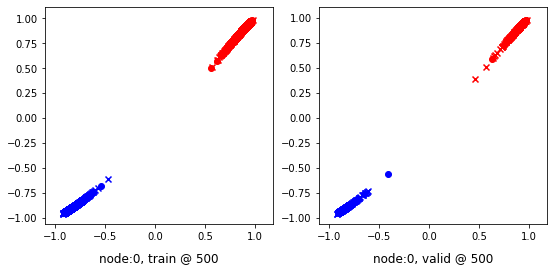

500 	 1 	 0.18983236 	 0.19471589 	 0.45133561 	 0.45343348 	 0.95731336 	 0.95186478


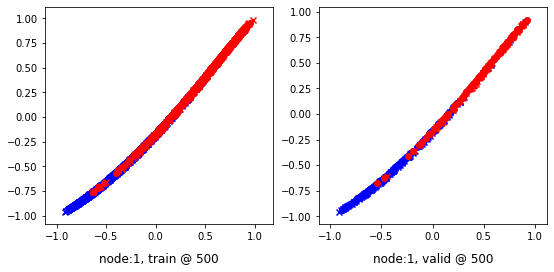

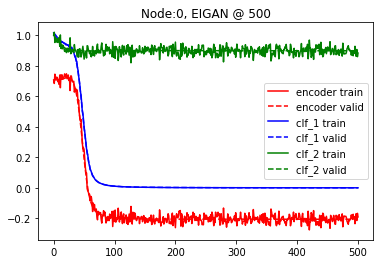

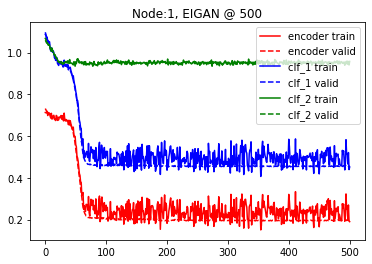

--------------------------------------------------------------------------------
EIGAN Training w/ phi=1.0 and delta=5
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.71387184 	 0.71042311 	 1.05489993 	 1.05427015 	 1.03430772 	 1.03699422


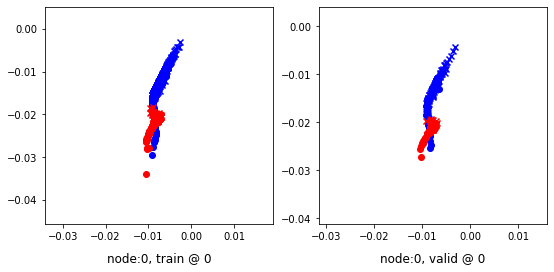

0 	 1 	 0.75678957 	 0.75122643 	 1.08955860 	 1.08625293 	 1.02603984 	 1.02817369


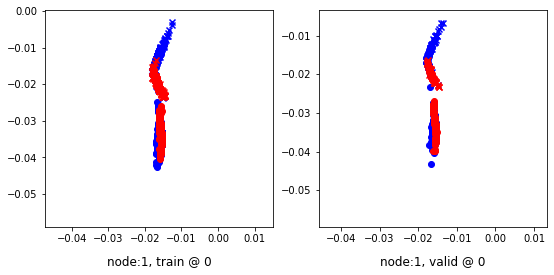

Aggregating on epoch: 5...
Aggregating on epoch: 10...
Aggregating on epoch: 15...
Aggregating on epoch: 20...
20 	 0 	 0.75638622 	 0.73161459 	 0.95845217 	 0.96193653 	 0.89541596 	 0.92346913


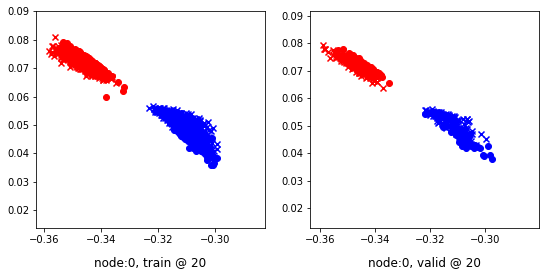

20 	 1 	 0.71534294 	 0.70902175 	 0.96823061 	 0.96841067 	 0.94630760 	 0.95253611


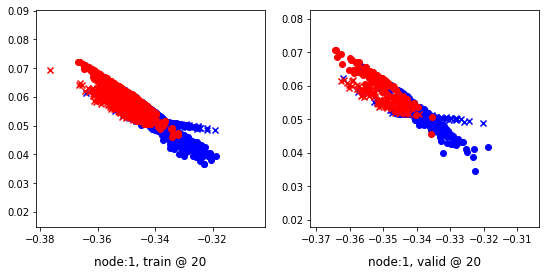

Aggregating on epoch: 25...
Aggregating on epoch: 30...
Aggregating on epoch: 35...
Aggregating on epoch: 40...
40 	 0 	 0.69188285 	 0.71883672 	 0.91498584 	 0.92420703 	 0.91760987 	 0.89851749


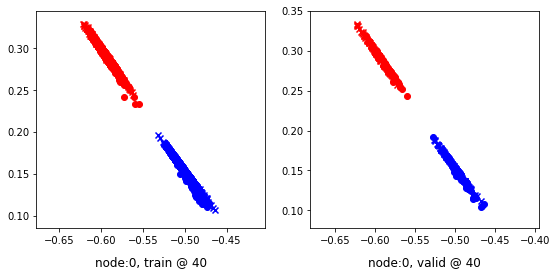

40 	 1 	 0.68526602 	 0.68628067 	 0.93664706 	 0.94516236 	 0.94456452 	 0.95202887


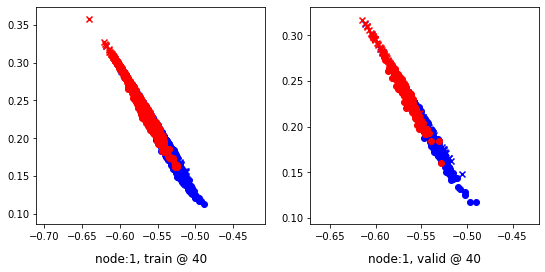

Aggregating on epoch: 45...
Aggregating on epoch: 50...
Aggregating on epoch: 55...
Aggregating on epoch: 60...
60 	 0 	 0.25268164 	 0.25438198 	 0.45681027 	 0.46158293 	 0.90305561 	 0.90034813


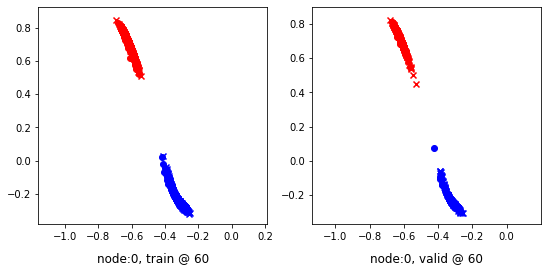

60 	 1 	 0.56147581 	 0.55811340 	 0.82900387 	 0.81666172 	 0.96431452 	 0.95169550


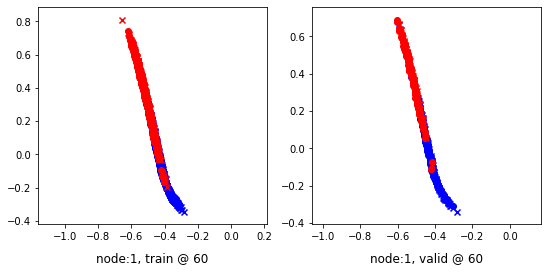

Aggregating on epoch: 65...
Aggregating on epoch: 70...
Aggregating on epoch: 75...
Aggregating on epoch: 80...
80 	 0 	 -0.15708992 	 -0.14478394 	 0.06105575 	 0.06109711 	 0.91157478 	 0.89902824


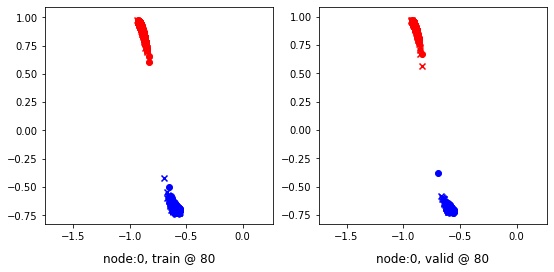

80 	 1 	 0.17939496 	 0.19957992 	 0.43726993 	 0.45881715 	 0.95094198 	 0.95238441


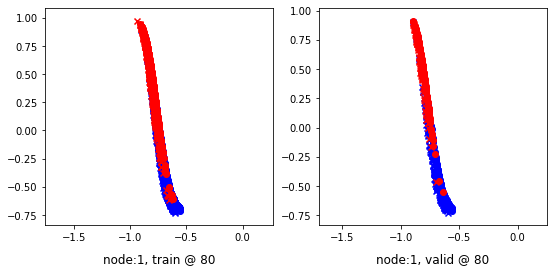

Aggregating on epoch: 85...
Aggregating on epoch: 90...
Aggregating on epoch: 95...
Aggregating on epoch: 100...
100 	 0 	 -0.20741168 	 -0.19077051 	 0.01458822 	 0.01517296 	 0.91521198 	 0.89909065


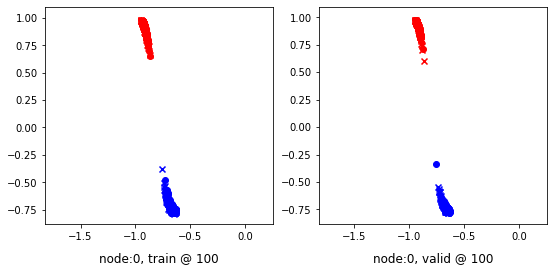

100 	 1 	 0.21675354 	 0.19973138 	 0.46480399 	 0.45869651 	 0.94063896 	 0.95211232


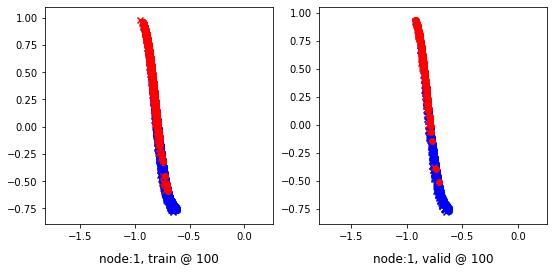

Aggregating on epoch: 105...
Aggregating on epoch: 110...
Aggregating on epoch: 115...
Aggregating on epoch: 120...
120 	 0 	 -0.21138634 	 -0.19948696 	 0.00671879 	 0.00696458 	 0.91128504 	 0.89959872


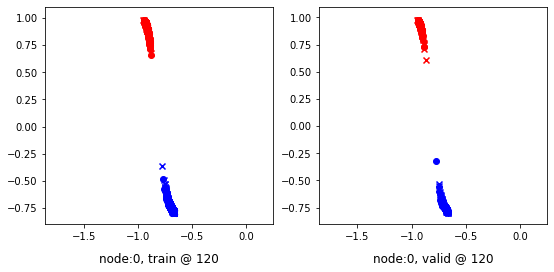

120 	 1 	 0.20818093 	 0.20039481 	 0.46906963 	 0.45998609 	 0.95313525 	 0.95273846


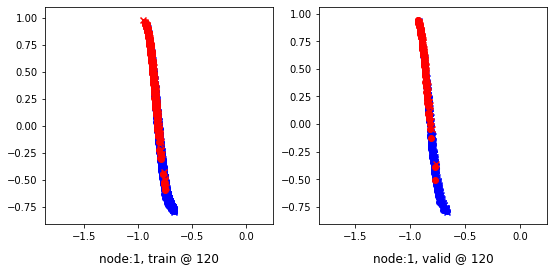

Aggregating on epoch: 125...
Aggregating on epoch: 130...
Aggregating on epoch: 135...
Aggregating on epoch: 140...
140 	 0 	 -0.22924308 	 -0.20281470 	 0.00383575 	 0.00413674 	 0.92625028 	 0.90009862


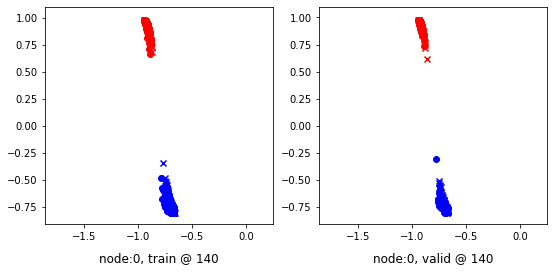

140 	 1 	 0.24041650 	 0.20021027 	 0.48600140 	 0.46020287 	 0.93913293 	 0.95313978


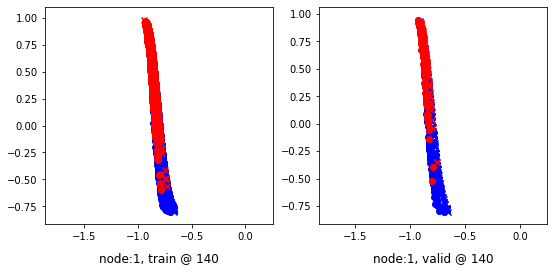

Aggregating on epoch: 145...
Aggregating on epoch: 150...
Aggregating on epoch: 155...
Aggregating on epoch: 160...
160 	 0 	 -0.19745308 	 -0.20413925 	 0.00258696 	 0.00276022 	 0.89320827 	 0.90004665


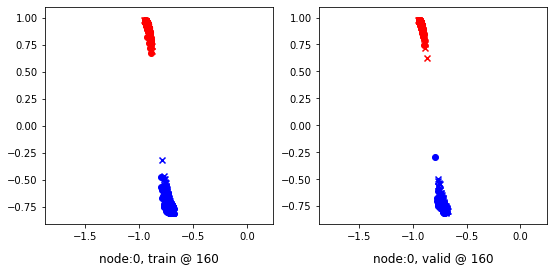

160 	 1 	 0.28916317 	 0.20050469 	 0.55142736 	 0.45982060 	 0.95588440 	 0.95246309


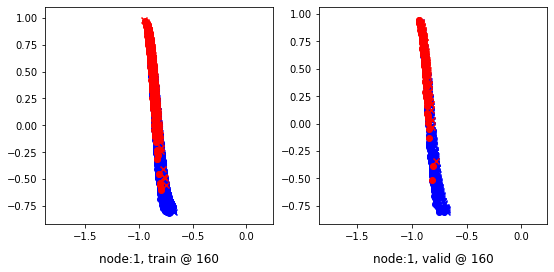

Aggregating on epoch: 165...
Aggregating on epoch: 170...
Aggregating on epoch: 175...
Aggregating on epoch: 180...
180 	 0 	 -0.23532614 	 -0.20462170 	 0.00171648 	 0.00198112 	 0.93020457 	 0.89974999


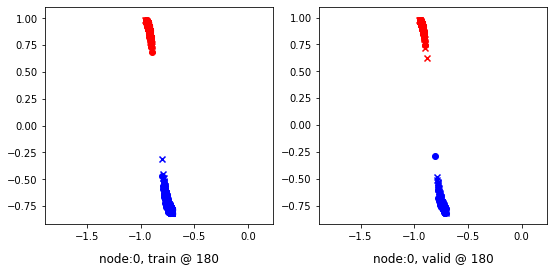

180 	 1 	 0.27541476 	 0.20306838 	 0.53387344 	 0.46198004 	 0.95140803 	 0.95205885


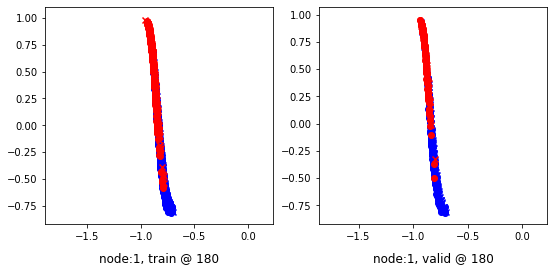

Aggregating on epoch: 185...
Aggregating on epoch: 190...
Aggregating on epoch: 195...
Aggregating on epoch: 200...
200 	 0 	 -0.21060264 	 -0.20477471 	 0.00141688 	 0.00150660 	 0.90517884 	 0.89942849


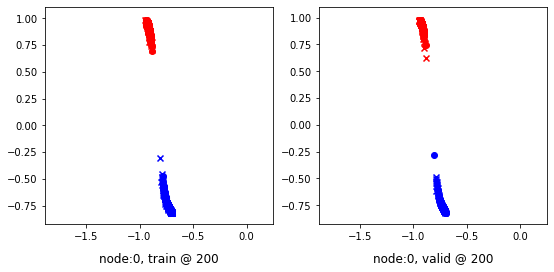

200 	 1 	 0.24405062 	 0.19886729 	 0.50343394 	 0.45818672 	 0.95225579 	 0.95246661


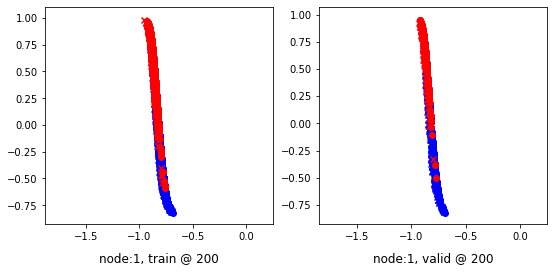

Aggregating on epoch: 205...
Aggregating on epoch: 210...
Aggregating on epoch: 215...
Aggregating on epoch: 220...
220 	 0 	 -0.20365553 	 -0.20493211 	 0.00106698 	 0.00120185 	 0.89788049 	 0.89928114


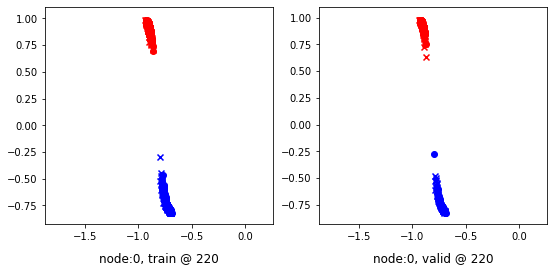

220 	 1 	 0.26946622 	 0.19970521 	 0.51770949 	 0.45864847 	 0.94065171 	 0.95209044


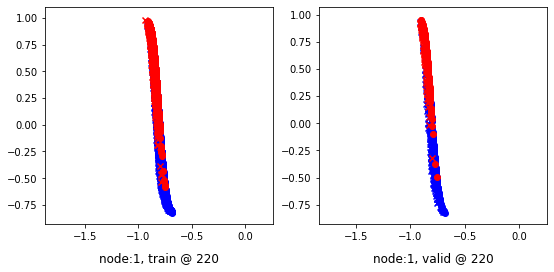

Aggregating on epoch: 225...
Aggregating on epoch: 230...
Aggregating on epoch: 235...
Aggregating on epoch: 240...
240 	 0 	 -0.22438283 	 -0.20534165 	 0.00080561 	 0.00094770 	 0.91834730 	 0.89943653


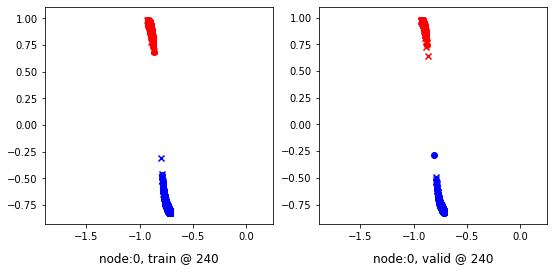

240 	 1 	 0.27197391 	 0.20007873 	 0.52418768 	 0.45934707 	 0.94534296 	 0.95241553


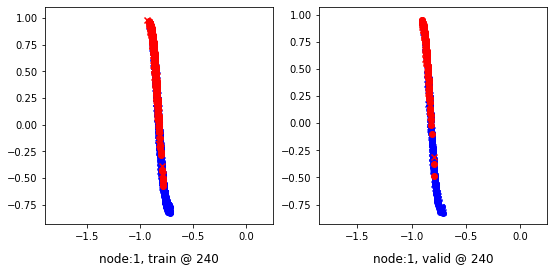

Aggregating on epoch: 245...
Aggregating on epoch: 250...
Aggregating on epoch: 255...
Aggregating on epoch: 260...
260 	 0 	 -0.17130828 	 -0.20580640 	 0.00068822 	 0.00078288 	 0.86515522 	 0.89973646


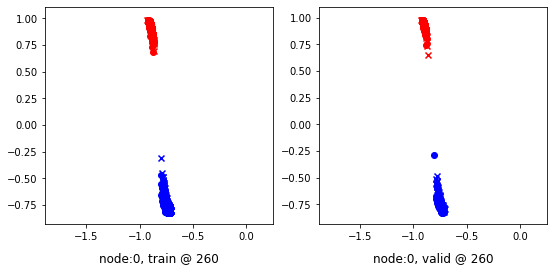

260 	 1 	 0.27651906 	 0.19720009 	 0.52504122 	 0.45711109 	 0.94215578 	 0.95305818


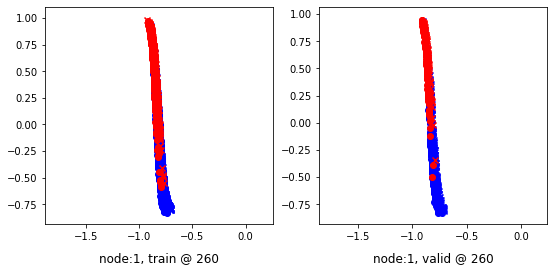

Aggregating on epoch: 265...
Aggregating on epoch: 270...
Aggregating on epoch: 275...
Aggregating on epoch: 280...
280 	 0 	 -0.25263584 	 -0.20592587 	 0.00055635 	 0.00066455 	 0.94635075 	 0.89973760


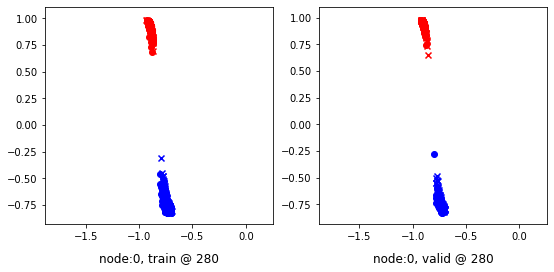

280 	 1 	 0.20506194 	 0.19865832 	 0.46043438 	 0.45796904 	 0.94853222 	 0.95245790


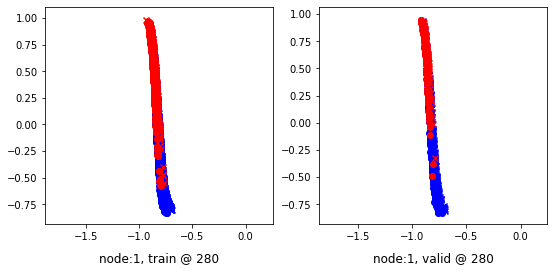

Aggregating on epoch: 285...
Aggregating on epoch: 290...
Aggregating on epoch: 295...
Aggregating on epoch: 300...
300 	 0 	 -0.21069010 	 -0.20565124 	 0.00049452 	 0.00057314 	 0.90434027 	 0.89937156


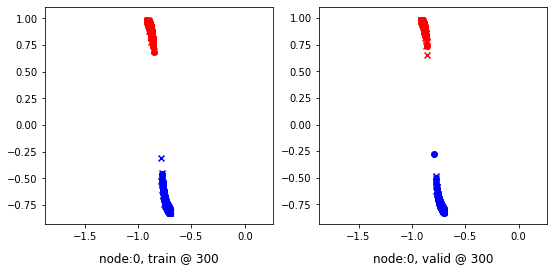

300 	 1 	 0.35493159 	 0.19686466 	 0.60377216 	 0.45705891 	 0.94226849 	 0.95334142


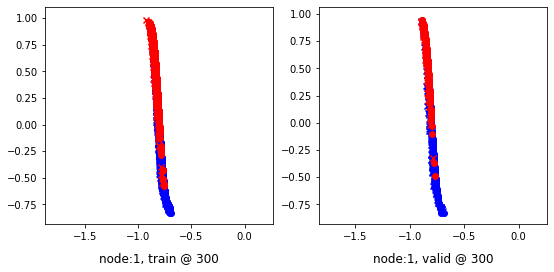

Aggregating on epoch: 305...
Aggregating on epoch: 310...
Aggregating on epoch: 315...
Aggregating on epoch: 320...
320 	 0 	 -0.23526464 	 -0.20550552 	 0.00046306 	 0.00050941 	 0.92889130 	 0.89916211


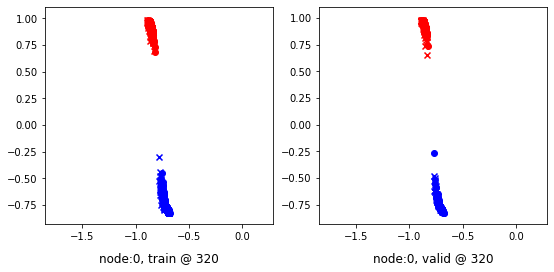

320 	 1 	 0.25141340 	 0.19603449 	 0.51701212 	 0.45572138 	 0.95836723 	 0.95283407


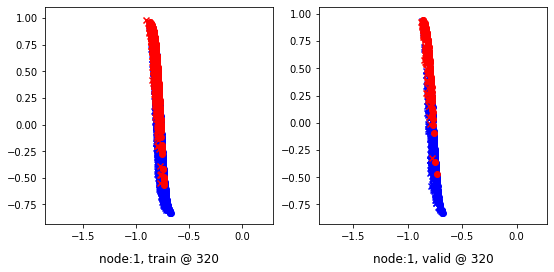

Aggregating on epoch: 325...
Aggregating on epoch: 330...
Aggregating on epoch: 335...
Aggregating on epoch: 340...
340 	 0 	 -0.21139435 	 -0.20591931 	 0.00039690 	 0.00043984 	 0.90495163 	 0.89950633


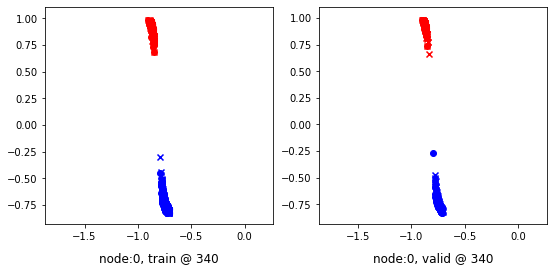

340 	 1 	 0.21268314 	 0.19892710 	 0.46386424 	 0.45906502 	 0.94364464 	 0.95328510


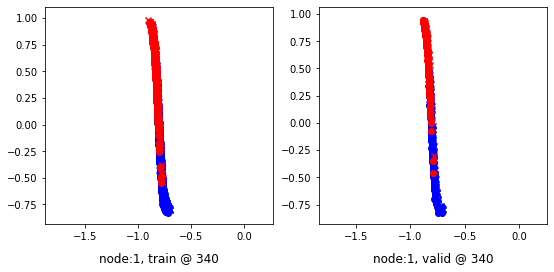

Aggregating on epoch: 345...
Aggregating on epoch: 350...
Aggregating on epoch: 355...
Aggregating on epoch: 360...
360 	 0 	 -0.20461397 	 -0.20616214 	 0.00034697 	 0.00040354 	 0.89811730 	 0.89971286


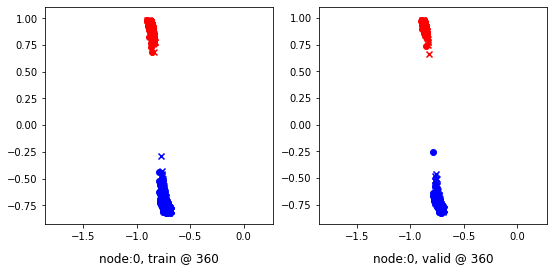

360 	 1 	 0.18847880 	 0.19767600 	 0.44807035 	 0.45718384 	 0.95352054 	 0.95265502


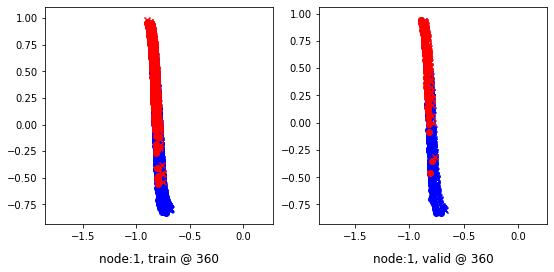

Aggregating on epoch: 365...
Aggregating on epoch: 370...
Aggregating on epoch: 375...
Aggregating on epoch: 380...
380 	 0 	 -0.19081159 	 -0.20592821 	 0.00032897 	 0.00036389 	 0.88429570 	 0.89943928


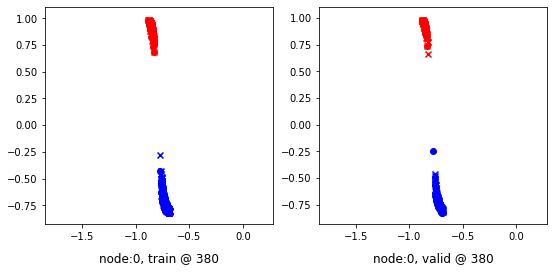

380 	 1 	 0.28518289 	 0.19586921 	 0.53514922 	 0.45544094 	 0.94778252 	 0.95271891


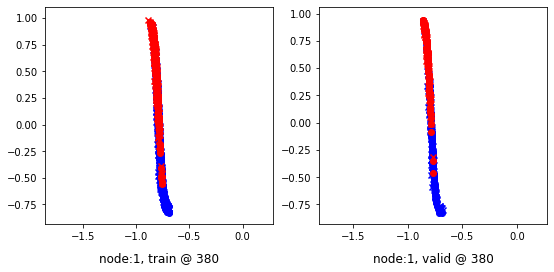

Aggregating on epoch: 385...
Aggregating on epoch: 390...
Aggregating on epoch: 395...
Aggregating on epoch: 400...
400 	 0 	 -0.22821875 	 -0.20568259 	 0.00027404 	 0.00033998 	 0.92164981 	 0.89916974


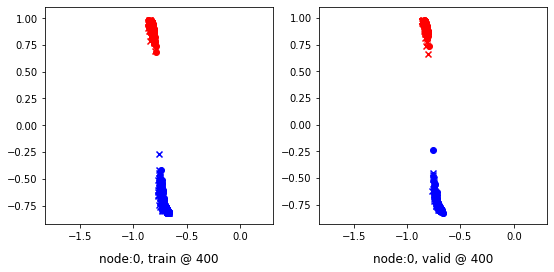

400 	 1 	 0.27843004 	 0.19451690 	 0.53379256 	 0.45359081 	 0.94848126 	 0.95222110


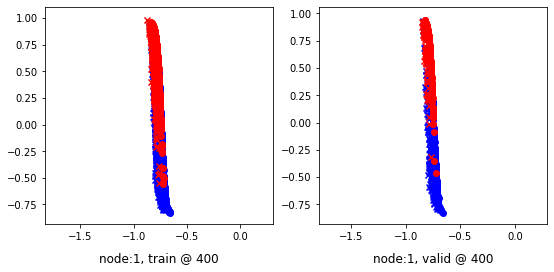

Aggregating on epoch: 405...
Aggregating on epoch: 410...
Aggregating on epoch: 415...
Aggregating on epoch: 420...
420 	 0 	 -0.18742111 	 -0.20607856 	 0.00025511 	 0.00029746 	 0.88083160 	 0.89952320


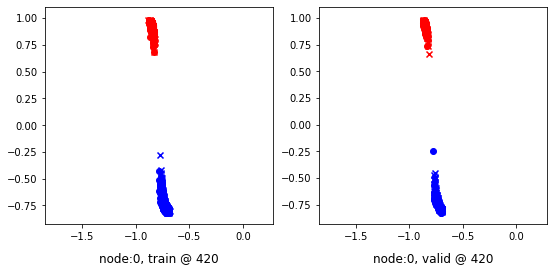

420 	 1 	 0.29171091 	 0.19522852 	 0.54782486 	 0.45532632 	 0.94940299 	 0.95324498


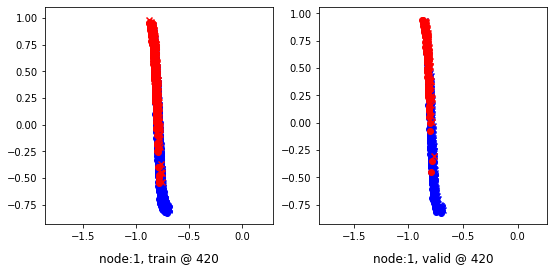

Aggregating on epoch: 425...
Aggregating on epoch: 430...
Aggregating on epoch: 435...
Aggregating on epoch: 440...
440 	 0 	 -0.23828094 	 -0.20614627 	 0.00022020 	 0.00027928 	 0.93165374 	 0.89957273


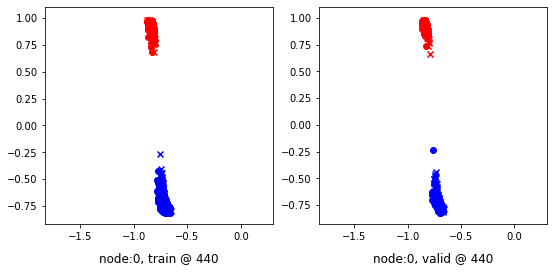

440 	 1 	 0.24063841 	 0.19749978 	 0.49692881 	 0.45648125 	 0.94935256 	 0.95212865


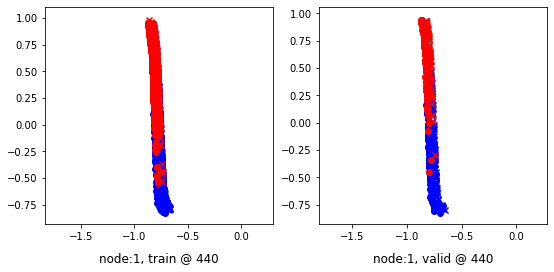

Aggregating on epoch: 445...
Aggregating on epoch: 450...
Aggregating on epoch: 455...
Aggregating on epoch: 460...
460 	 0 	 -0.20093359 	 -0.20588218 	 0.00023538 	 0.00026824 	 0.89432049 	 0.89929760


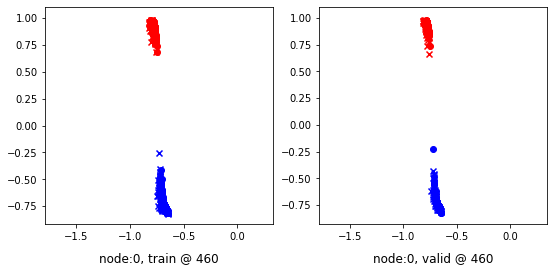

460 	 1 	 0.29016870 	 0.19511157 	 0.55116034 	 0.45521247 	 0.95473391 	 0.95324808


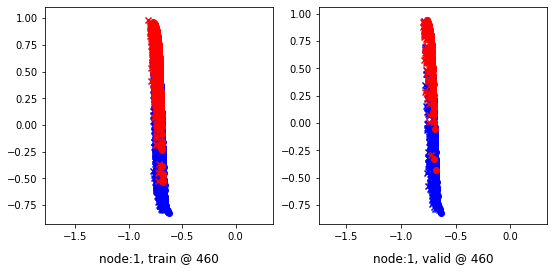

Aggregating on epoch: 465...
Aggregating on epoch: 470...
Aggregating on epoch: 475...
Aggregating on epoch: 480...
480 	 0 	 -0.21165942 	 -0.20595323 	 0.00016510 	 0.00023861 	 0.90497595 	 0.89933902


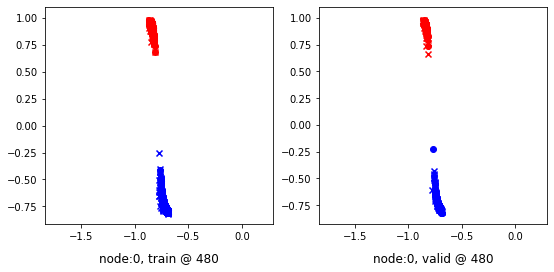

480 	 1 	 0.25743675 	 0.19537532 	 0.51396036 	 0.45407754 	 0.94996709 	 0.95184940


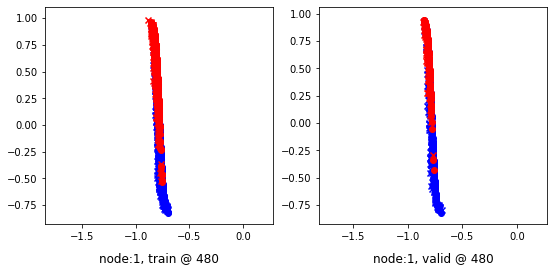

Aggregating on epoch: 485...
Aggregating on epoch: 490...
Aggregating on epoch: 495...
Aggregating on epoch: 500...
500 	 0 	 -0.21551688 	 -0.20613421 	 0.00015213 	 0.00021242 	 0.90881890 	 0.89949381


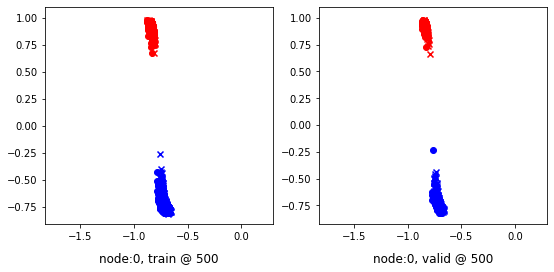

500 	 1 	 0.29507512 	 0.19468445 	 0.54901105 	 0.45442253 	 0.94966853 	 0.95288527


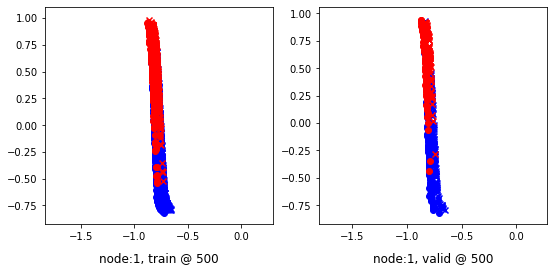

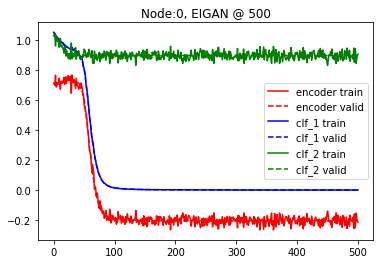

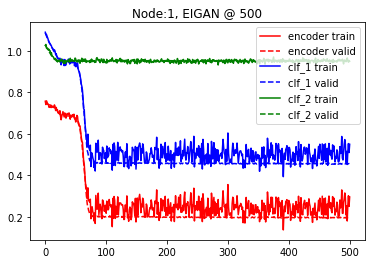

--------------------------------------------------------------------------------
EIGAN Training w/ phi=1.0 and delta=7
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.75156200 	 0.75377846 	 1.06677413 	 1.06303895 	 1.00846863 	 1.00240767


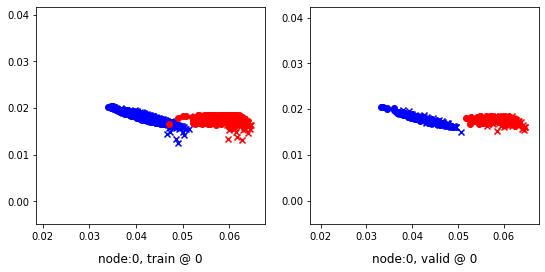

0 	 1 	 0.69862139 	 0.69545698 	 1.03570652 	 1.03428614 	 1.03042102 	 1.03197634


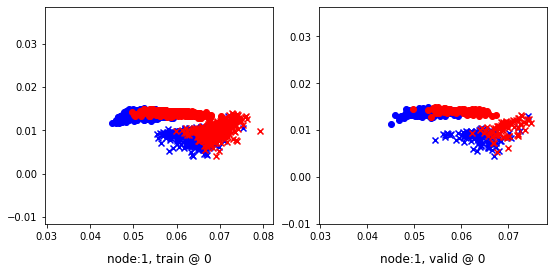

Aggregating on epoch: 7...
Aggregating on epoch: 14...
20 	 0 	 0.74498791 	 0.75480205 	 0.97046793 	 0.96940500 	 0.91875523 	 0.90775013


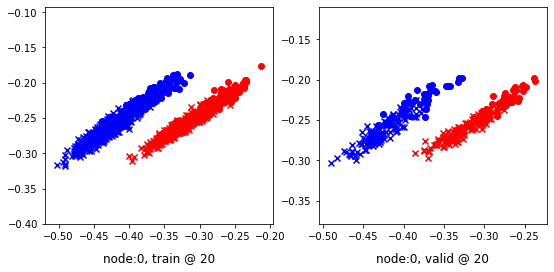

20 	 1 	 0.68652272 	 0.68645483 	 0.94683963 	 0.94087154 	 0.95364863 	 0.94756389


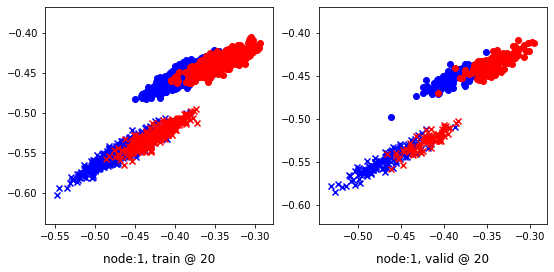

Aggregating on epoch: 21...
Aggregating on epoch: 28...
Aggregating on epoch: 35...
40 	 0 	 0.67578137 	 0.69990396 	 0.90763807 	 0.90610766 	 0.92608500 	 0.89935088


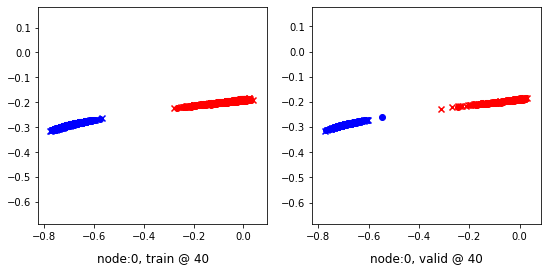

40 	 1 	 0.61581624 	 0.55950135 	 0.87568855 	 0.82524341 	 0.95668894 	 0.95888925


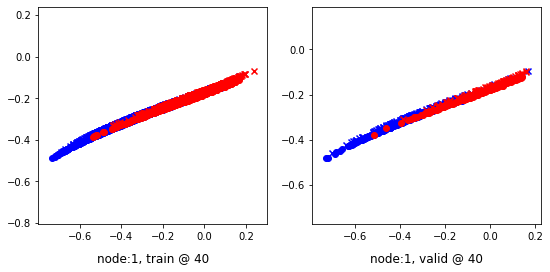

Aggregating on epoch: 42...
Aggregating on epoch: 49...
Aggregating on epoch: 56...
60 	 0 	 0.11635479 	 0.08308727 	 0.30209449 	 0.28960228 	 0.88037199 	 0.89966220


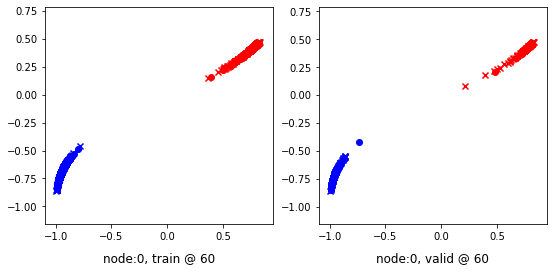

60 	 1 	 0.23871621 	 0.21695367 	 0.49775317 	 0.47714469 	 0.95092887 	 0.95333821


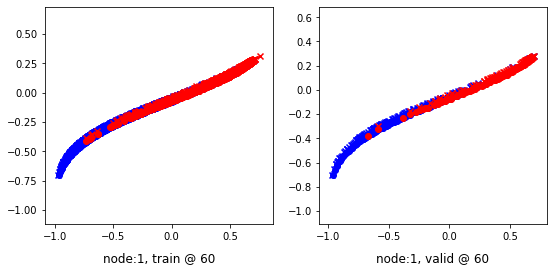

Aggregating on epoch: 63...
Aggregating on epoch: 70...
Aggregating on epoch: 77...
80 	 0 	 -0.19358531 	 -0.18200237 	 0.02429371 	 0.02434945 	 0.91116512 	 0.89949900


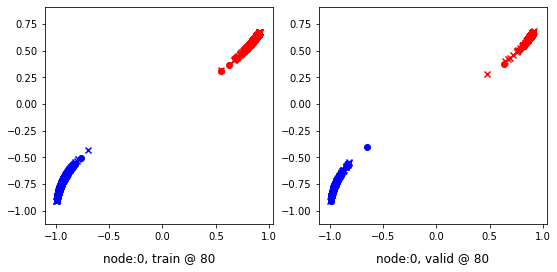

80 	 1 	 0.25846153 	 0.20468658 	 0.51223898 	 0.46227860 	 0.94819224 	 0.95073920


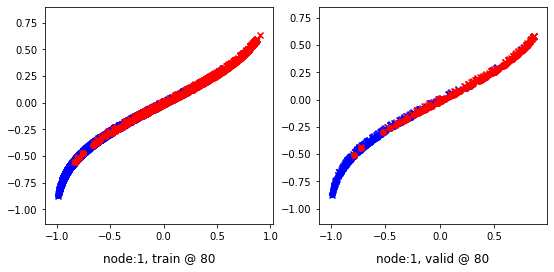

Aggregating on epoch: 84...
Aggregating on epoch: 91...
Aggregating on epoch: 98...
100 	 0 	 -0.22004944 	 -0.19821486 	 0.00797559 	 0.00821331 	 0.92119974 	 0.89957535


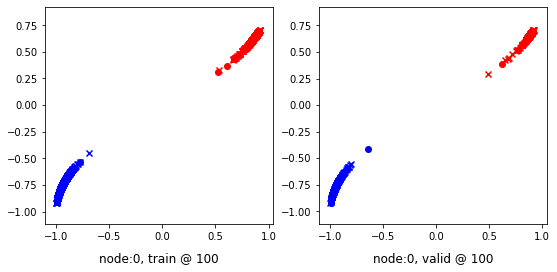

100 	 1 	 0.26915127 	 0.20403236 	 0.52571696 	 0.46170843 	 0.94994617 	 0.95082325


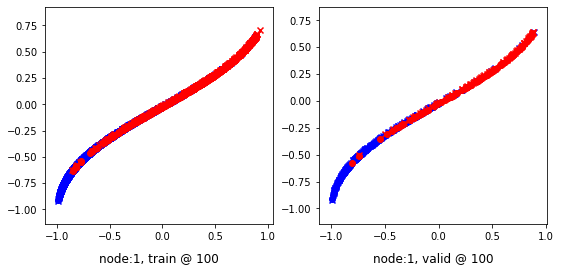

Aggregating on epoch: 105...
Aggregating on epoch: 112...
Aggregating on epoch: 119...
120 	 0 	 -0.20975259 	 -0.20215543 	 0.00424029 	 0.00441514 	 0.90715957 	 0.89971775


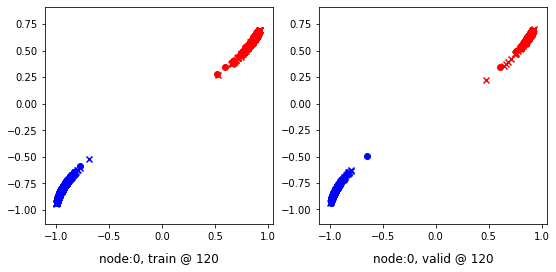

120 	 1 	 0.27945089 	 0.20017982 	 0.53758663 	 0.45927715 	 0.95131475 	 0.95224452


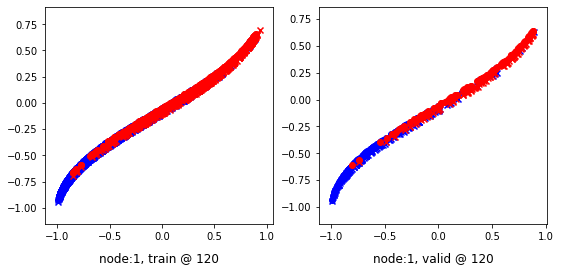

Aggregating on epoch: 126...
Aggregating on epoch: 133...
Aggregating on epoch: 140...
140 	 0 	 -0.22364153 	 -0.20387785 	 0.00262023 	 0.00273426 	 0.91941911 	 0.89975929


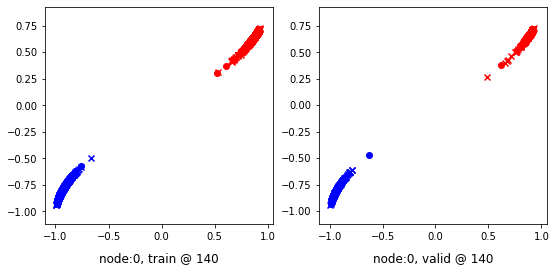

140 	 1 	 0.20551208 	 0.20178801 	 0.45925963 	 0.46113461 	 0.94682950 	 0.95249379


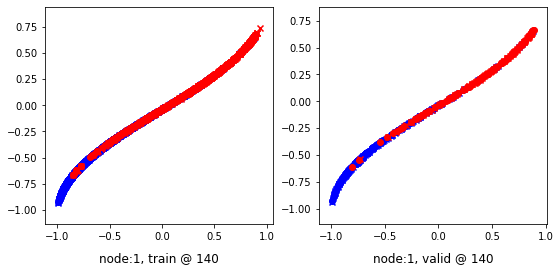

Aggregating on epoch: 147...
Aggregating on epoch: 154...
160 	 0 	 -0.25577918 	 -0.20505784 	 0.00178987 	 0.00186671 	 0.95072496 	 0.90007174


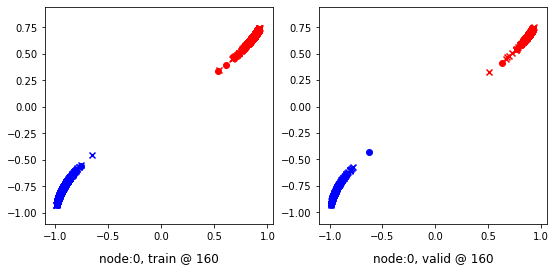

160 	 1 	 0.20384955 	 0.19988546 	 0.46295869 	 0.45963076 	 0.95303172 	 0.95289248


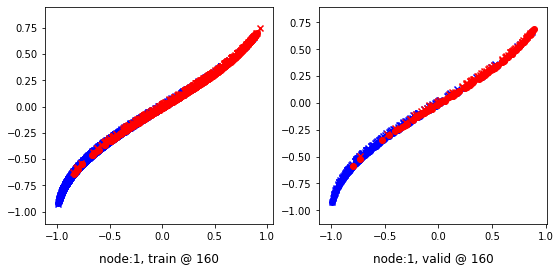

Aggregating on epoch: 161...
Aggregating on epoch: 168...
Aggregating on epoch: 175...
180 	 0 	 -0.20712379 	 -0.20557557 	 0.00132110 	 0.00138499 	 0.90160096 	 0.90010774


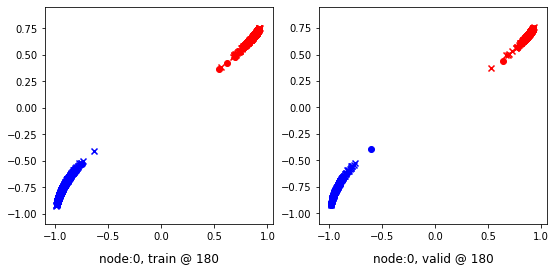

180 	 1 	 0.24864924 	 0.19814309 	 0.50244391 	 0.45743713 	 0.94715309 	 0.95244122


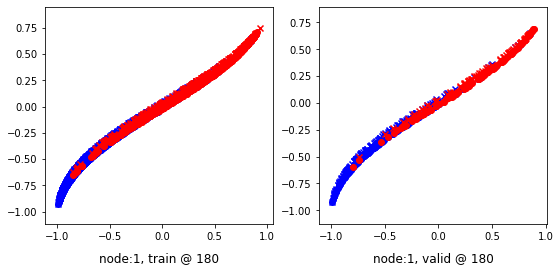

Aggregating on epoch: 182...
Aggregating on epoch: 189...
Aggregating on epoch: 196...
200 	 0 	 -0.15612254 	 -0.20577642 	 0.00099368 	 0.00107101 	 0.85026628 	 0.89999461


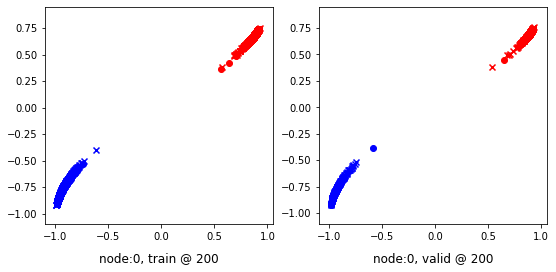

200 	 1 	 0.24870074 	 0.19898790 	 0.51263678 	 0.45756388 	 0.95759737 	 0.95172316


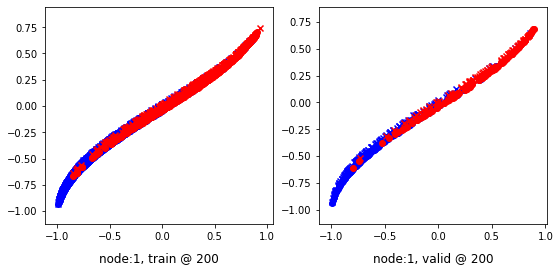

Aggregating on epoch: 203...
Aggregating on epoch: 210...
Aggregating on epoch: 217...
220 	 0 	 -0.15952115 	 -0.20583111 	 0.00077660 	 0.00084371 	 0.85344851 	 0.89982200


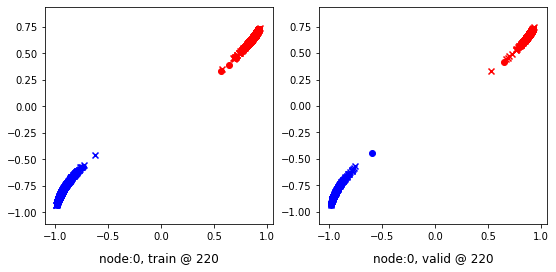

220 	 1 	 0.19498259 	 0.20068330 	 0.45263392 	 0.45921224 	 0.95073420 	 0.95167613


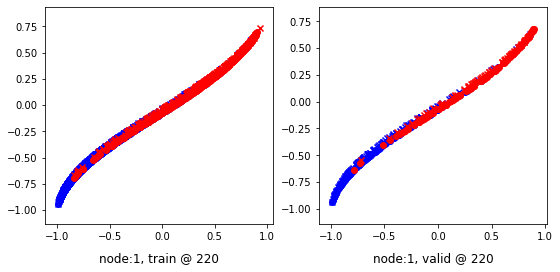

Aggregating on epoch: 224...
Aggregating on epoch: 231...
Aggregating on epoch: 238...
240 	 0 	 -0.19724239 	 -0.20590656 	 0.00065238 	 0.00069095 	 0.89104569 	 0.89974469


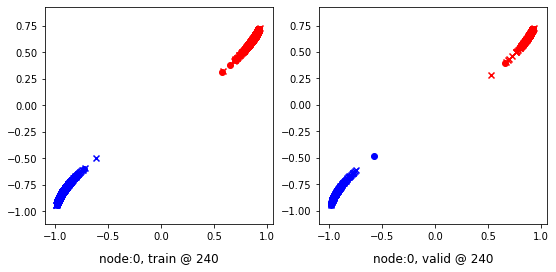

240 	 1 	 0.15611574 	 0.20166487 	 0.41779757 	 0.46102297 	 0.95478195 	 0.95250529


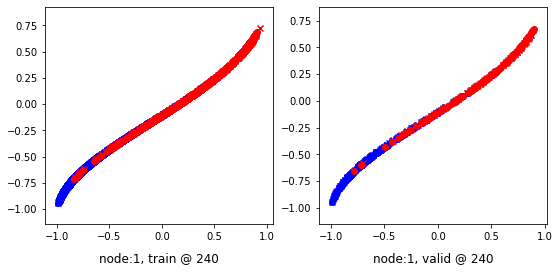

Aggregating on epoch: 245...
Aggregating on epoch: 252...
Aggregating on epoch: 259...
260 	 0 	 -0.18856643 	 -0.20593143 	 0.00053478 	 0.00059807 	 0.88225025 	 0.89967668


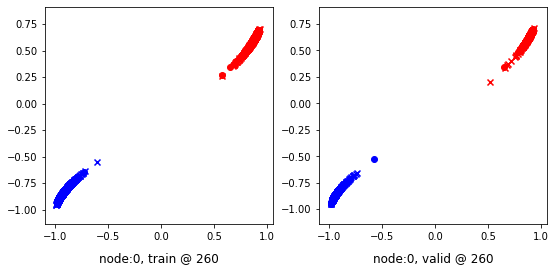

260 	 1 	 0.18589646 	 0.19851342 	 0.44140083 	 0.45849308 	 0.94876635 	 0.95312685


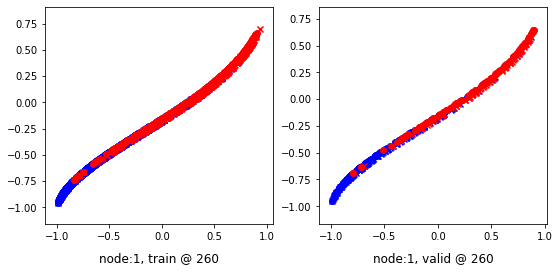

Aggregating on epoch: 266...
Aggregating on epoch: 273...
Aggregating on epoch: 280...
280 	 0 	 -0.20460758 	 -0.20590922 	 0.00044505 	 0.00050619 	 0.89820129 	 0.89956260


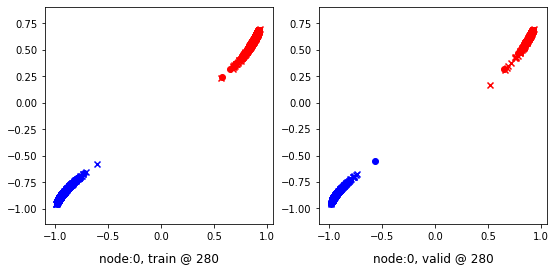

280 	 1 	 0.26249713 	 0.20183089 	 0.52427727 	 0.46188036 	 0.95473450 	 0.95319664


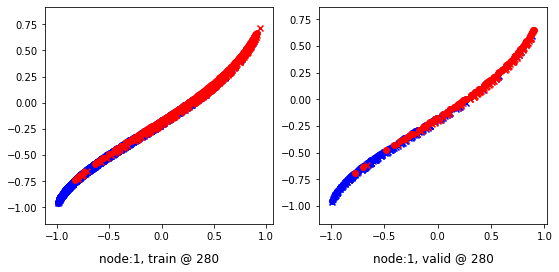

Aggregating on epoch: 287...
Aggregating on epoch: 294...
300 	 0 	 -0.18398003 	 -0.20590478 	 0.00037348 	 0.00040644 	 0.87750232 	 0.89945841


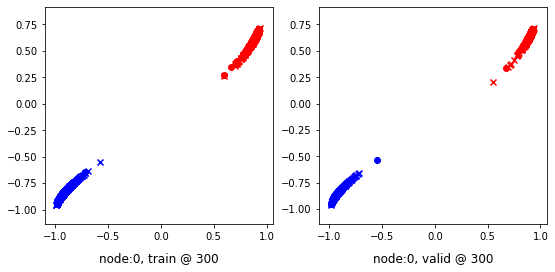

300 	 1 	 0.22026733 	 0.20161942 	 0.49358559 	 0.46081570 	 0.96678472 	 0.95234346


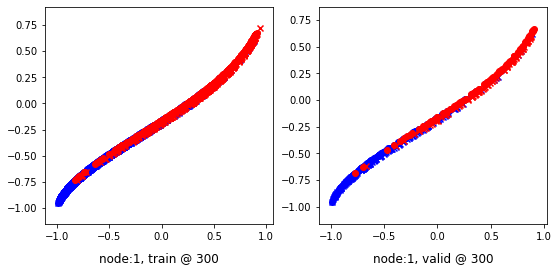

Aggregating on epoch: 301...
Aggregating on epoch: 308...
Aggregating on epoch: 315...
320 	 0 	 -0.24175029 	 -0.20596156 	 0.00030920 	 0.00034567 	 0.93520790 	 0.89945441


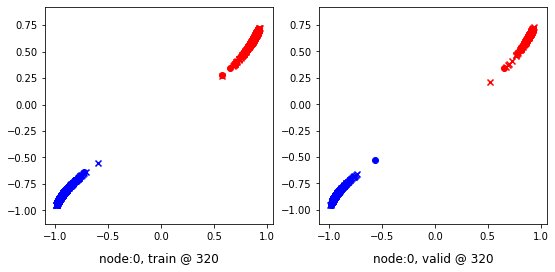

320 	 1 	 0.24611211 	 0.19827735 	 0.50476456 	 0.45787913 	 0.95193464 	 0.95274895


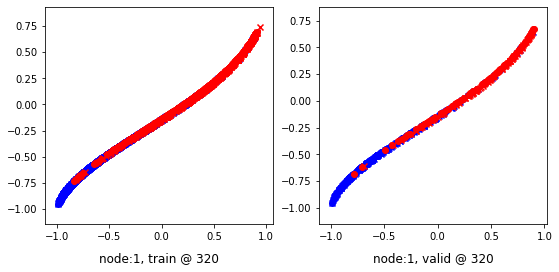

Aggregating on epoch: 322...
Aggregating on epoch: 329...
Aggregating on epoch: 336...
340 	 0 	 -0.18981445 	 -0.20600842 	 0.00025687 	 0.00029810 	 0.88321972 	 0.89945370


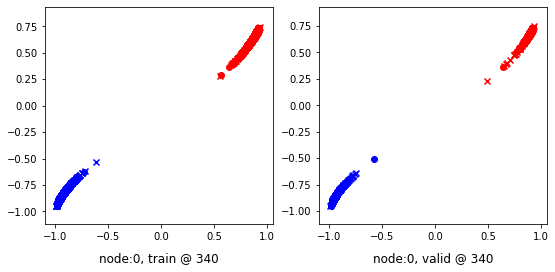

340 	 1 	 0.18790966 	 0.19951591 	 0.45722595 	 0.45966467 	 0.96289420 	 0.95329595


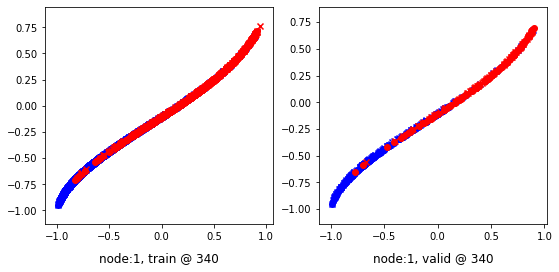

Aggregating on epoch: 343...
Aggregating on epoch: 350...
Aggregating on epoch: 357...
360 	 0 	 -0.22909772 	 -0.20598297 	 0.00023494 	 0.00026233 	 0.92248046 	 0.89939249


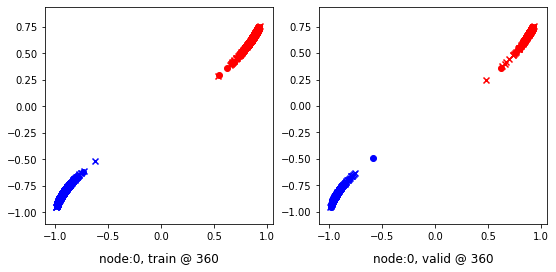

360 	 1 	 0.22958118 	 0.19841522 	 0.48913279 	 0.45885295 	 0.95257956 	 0.95358491


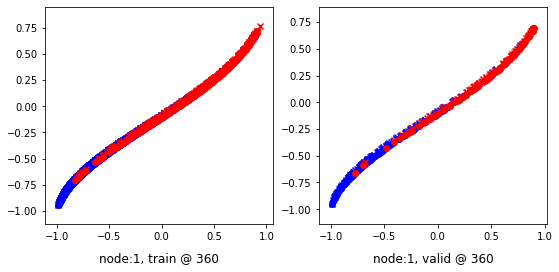

Aggregating on epoch: 364...
Aggregating on epoch: 371...
Aggregating on epoch: 378...
380 	 0 	 -0.20435609 	 -0.20597632 	 0.00020423 	 0.00023275 	 0.89770818 	 0.89935625


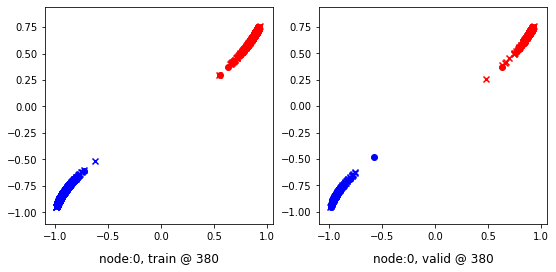

380 	 1 	 0.23349446 	 0.20115125 	 0.48446324 	 0.46043712 	 0.94591814 	 0.95243305


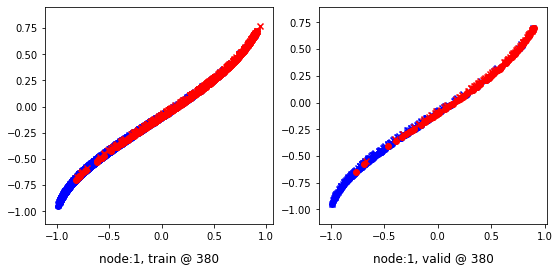

Aggregating on epoch: 385...
Aggregating on epoch: 392...
Aggregating on epoch: 399...
400 	 0 	 -0.24227224 	 -0.20598429 	 0.00018577 	 0.00020873 	 0.93560559 	 0.89934021


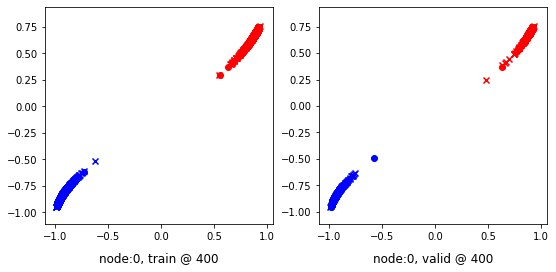

400 	 1 	 0.20844844 	 0.19829884 	 0.46434829 	 0.45717123 	 0.94861108 	 0.95201957


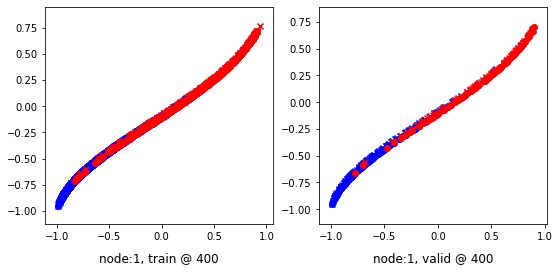

Aggregating on epoch: 406...
Aggregating on epoch: 413...
Aggregating on epoch: 420...
420 	 0 	 -0.22523539 	 -0.20599902 	 0.00017426 	 0.00018686 	 0.91855711 	 0.89933306


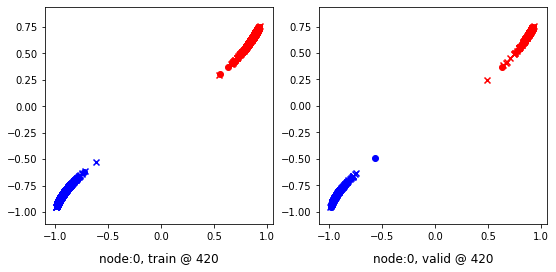

420 	 1 	 0.23373187 	 0.20012334 	 0.49222821 	 0.45918509 	 0.95166898 	 0.95220894


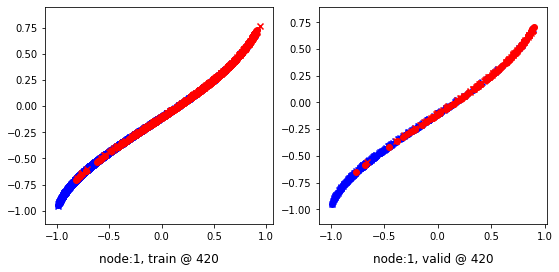

Aggregating on epoch: 427...
Aggregating on epoch: 434...
440 	 0 	 -0.22133531 	 -0.20606063 	 0.00013896 	 0.00016708 	 0.91462213 	 0.89937490


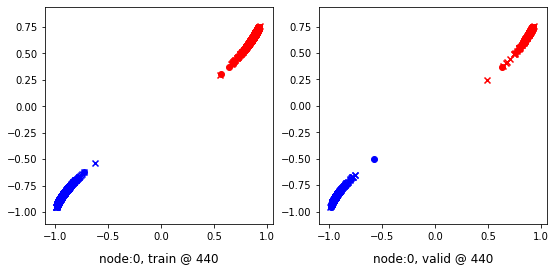

440 	 1 	 0.24138728 	 0.19794574 	 0.49810505 	 0.45755324 	 0.95146549 	 0.95275468


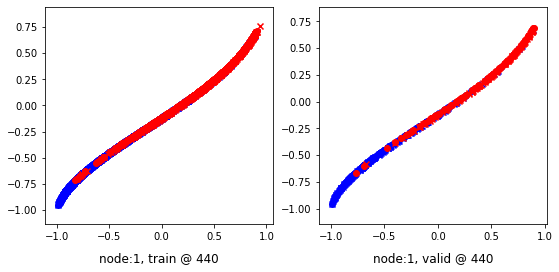

Aggregating on epoch: 441...
Aggregating on epoch: 448...
Aggregating on epoch: 455...
460 	 0 	 -0.22534731 	 -0.20607203 	 0.00013232 	 0.00015056 	 0.91862774 	 0.89936978


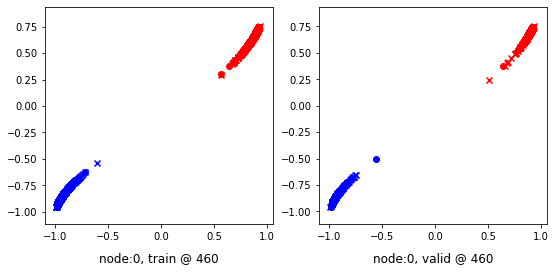

460 	 1 	 0.26770520 	 0.19789985 	 0.51835364 	 0.45762190 	 0.94397700 	 0.95286924


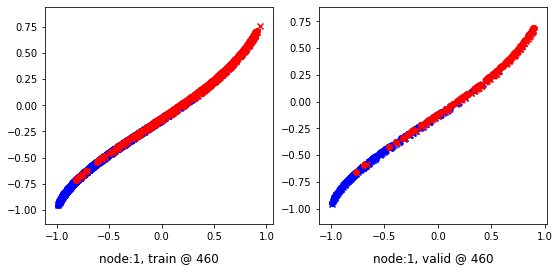

Aggregating on epoch: 462...
Aggregating on epoch: 469...
Aggregating on epoch: 476...
480 	 0 	 -0.23147039 	 -0.20608683 	 0.00012234 	 0.00013857 	 0.92474025 	 0.89937258


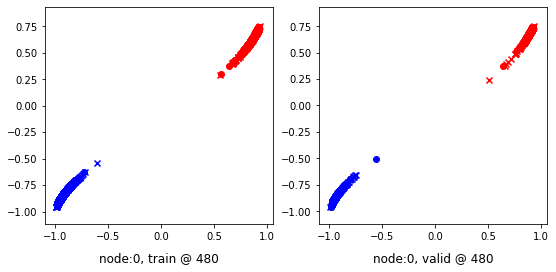

480 	 1 	 0.21594507 	 0.19984174 	 0.48037201 	 0.45948565 	 0.95698607 	 0.95279109


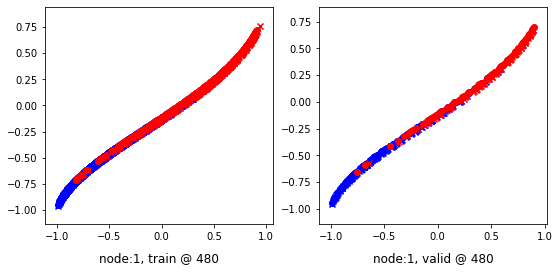

Aggregating on epoch: 483...
Aggregating on epoch: 490...
Aggregating on epoch: 497...
500 	 0 	 -0.20180547 	 -0.20610724 	 0.00011231 	 0.00012542 	 0.89506584 	 0.89937985


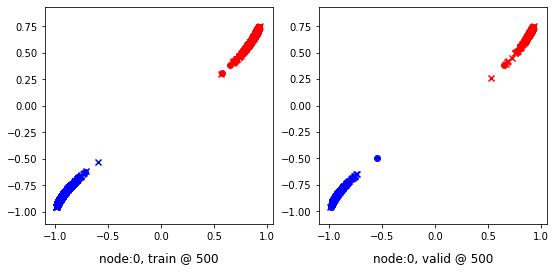

500 	 1 	 0.21745747 	 0.19834563 	 0.47655717 	 0.45774993 	 0.95229059 	 0.95255148


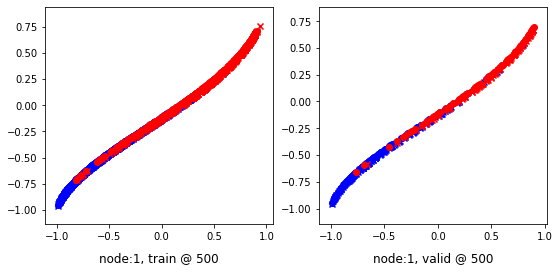

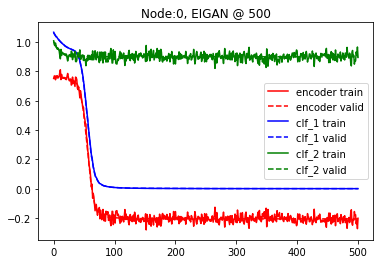

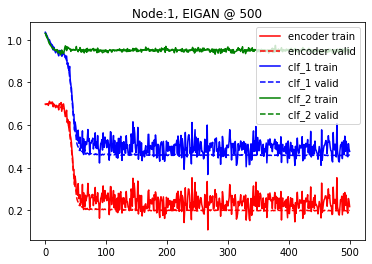

--------------------------------------------------------------------------------
EIGAN Training w/ phi=1.0 and delta=9
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.73278385 	 0.70800918 	 1.00686002 	 1.00536847 	 0.96735489 	 0.99050647


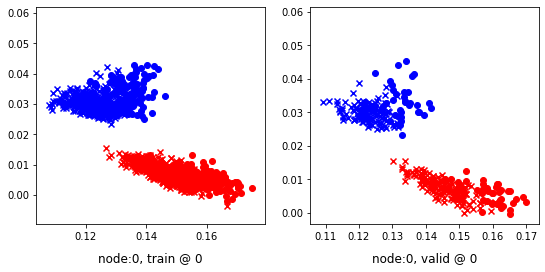

0 	 1 	 0.72721422 	 0.72640419 	 1.07001007 	 1.06869006 	 1.03632128 	 1.03543305


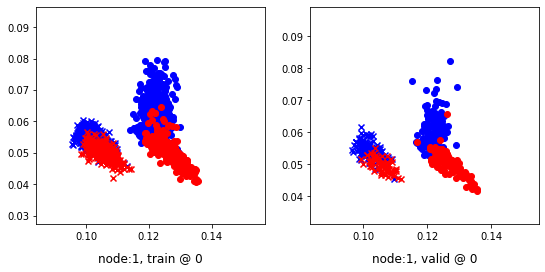

Aggregating on epoch: 9...
Aggregating on epoch: 18...
20 	 0 	 0.74609506 	 0.73803973 	 0.95244402 	 0.95125347 	 0.89976782 	 0.90636092


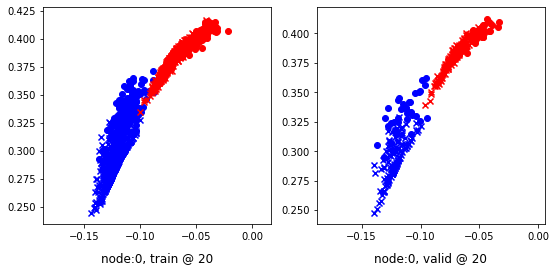

20 	 1 	 0.71203870 	 0.71015429 	 0.96925807 	 0.96922523 	 0.95048749 	 0.95221812


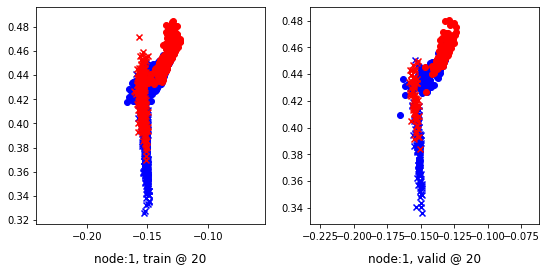

Aggregating on epoch: 27...
Aggregating on epoch: 36...
40 	 0 	 0.65027237 	 0.65119123 	 0.85767180 	 0.85642034 	 0.90405601 	 0.89837629


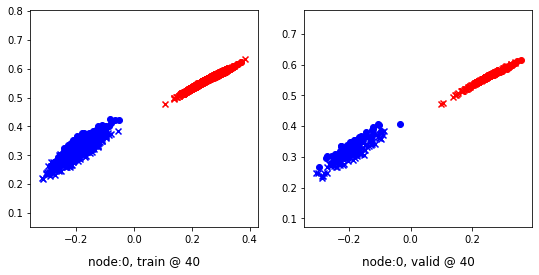

40 	 1 	 0.66766721 	 0.68343264 	 0.93040466 	 0.94394261 	 0.95602715 	 0.95365715


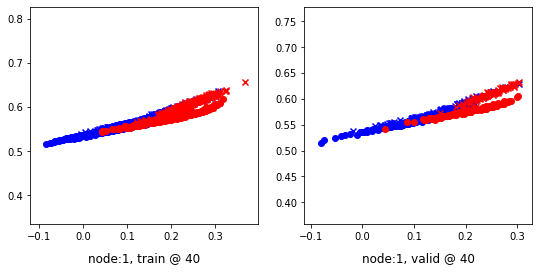

Aggregating on epoch: 45...
Aggregating on epoch: 54...
60 	 0 	 -0.01108250 	 -0.01565368 	 0.19381770 	 0.19020353 	 0.90025264 	 0.89900440


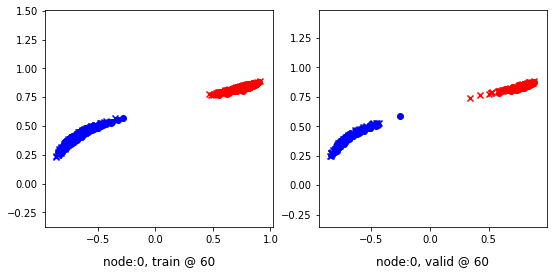

60 	 1 	 0.52816468 	 0.51241201 	 0.78288364 	 0.77356410 	 0.95023870 	 0.95429927


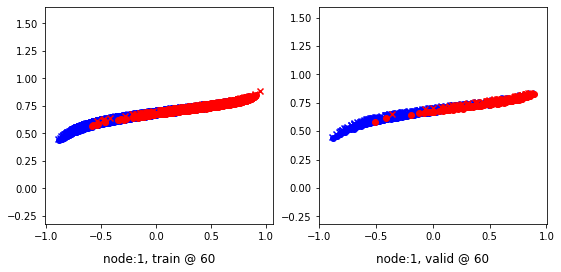

Aggregating on epoch: 63...
Aggregating on epoch: 72...
80 	 0 	 -0.14563996 	 -0.18948729 	 0.01685280 	 0.01681577 	 0.85565776 	 0.89945024


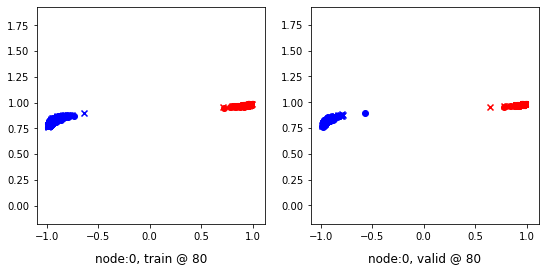

80 	 1 	 0.25528026 	 0.20790544 	 0.51147866 	 0.46734193 	 0.94932157 	 0.95258367


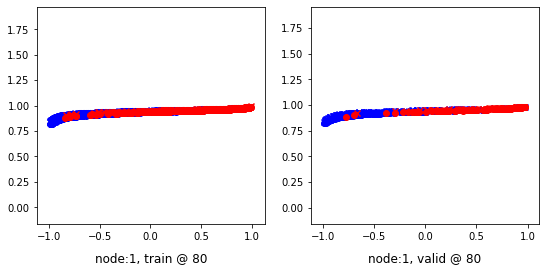

Aggregating on epoch: 81...
Aggregating on epoch: 90...
Aggregating on epoch: 99...
100 	 0 	 -0.22362192 	 -0.20040508 	 0.00570024 	 0.00588571 	 0.92247218 	 0.89943796


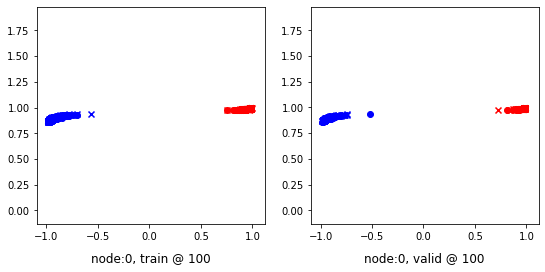

100 	 1 	 0.23615485 	 0.20512724 	 0.50281036 	 0.46443605 	 0.95901912 	 0.95245600


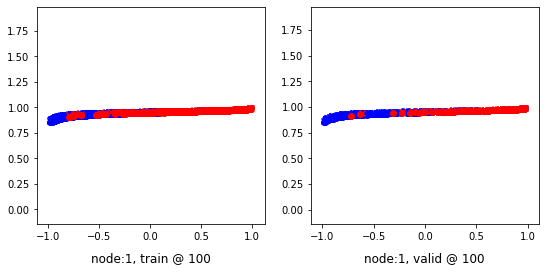

Aggregating on epoch: 108...
Aggregating on epoch: 117...
120 	 0 	 -0.20514463 	 -0.20318158 	 0.00305045 	 0.00311897 	 0.90134370 	 0.89944774


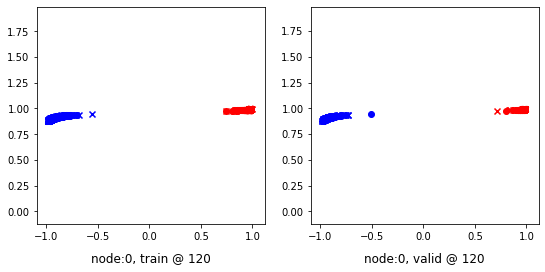

120 	 1 	 0.24780399 	 0.20218089 	 0.50877053 	 0.46147731 	 0.95421803 	 0.95244360


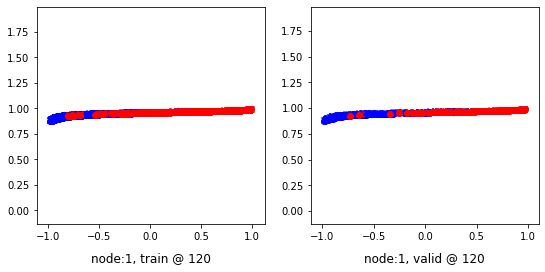

Aggregating on epoch: 126...
Aggregating on epoch: 135...
140 	 0 	 -0.19241361 	 -0.20436515 	 0.00191898 	 0.00198356 	 0.88748157 	 0.89949590


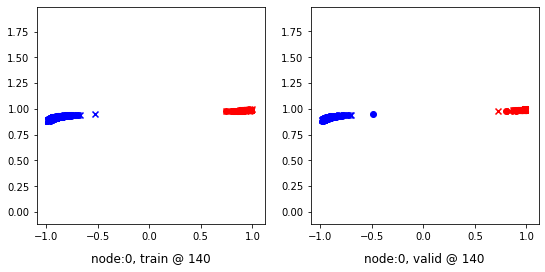

140 	 1 	 0.26484698 	 0.20195475 	 0.51291490 	 0.46113011 	 0.94139093 	 0.95232254


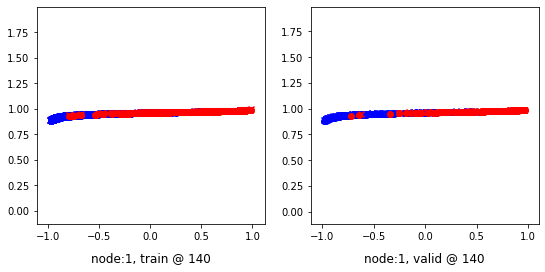

Aggregating on epoch: 144...
Aggregating on epoch: 153...
160 	 0 	 -0.20646685 	 -0.20499444 	 0.00132351 	 0.00139225 	 0.90093964 	 0.89953387


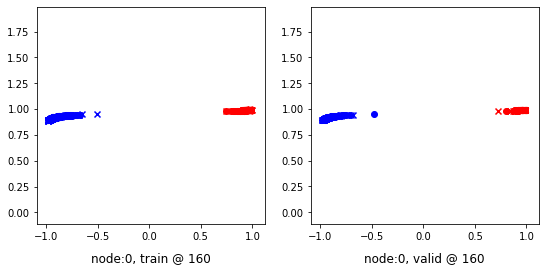

160 	 1 	 0.27871525 	 0.19946384 	 0.53496230 	 0.45835215 	 0.94956201 	 0.95203549


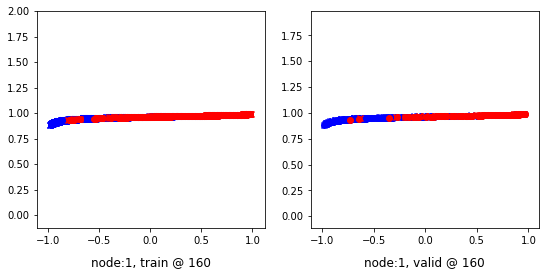

Aggregating on epoch: 162...
Aggregating on epoch: 171...
Aggregating on epoch: 180...
180 	 0 	 -0.21338040 	 -0.20533426 	 0.00099330 	 0.00103687 	 0.90752268 	 0.89951831


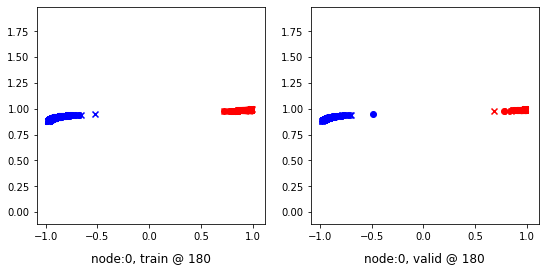

180 	 1 	 0.20830980 	 0.20390421 	 0.47214007 	 0.46351987 	 0.95922136 	 0.95276284


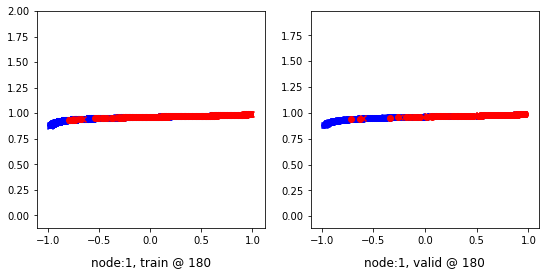

Aggregating on epoch: 189...
Aggregating on epoch: 198...
200 	 0 	 -0.21784978 	 -0.20561503 	 0.00072259 	 0.00081004 	 0.91172189 	 0.89957225


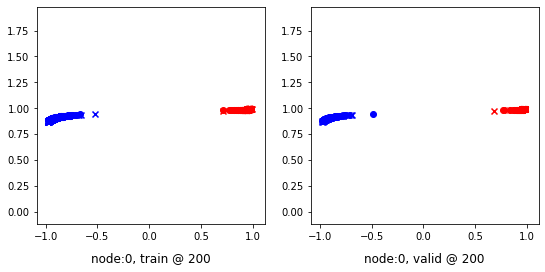

200 	 1 	 0.19457605 	 0.19960952 	 0.45458591 	 0.45896375 	 0.95400894 	 0.95250142


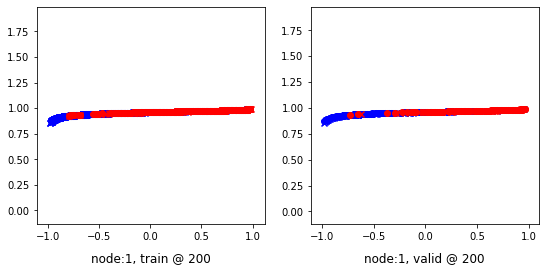

Aggregating on epoch: 207...
Aggregating on epoch: 216...
220 	 0 	 -0.21227457 	 -0.20583166 	 0.00062335 	 0.00065904 	 0.90604681 	 0.89963788


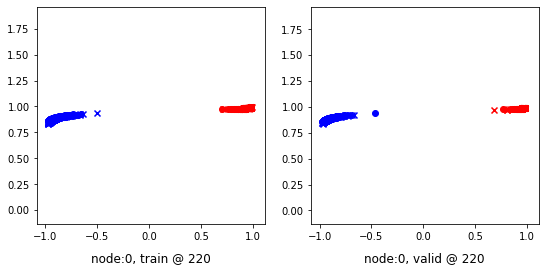

220 	 1 	 0.19787970 	 0.20085147 	 0.44400224 	 0.45994076 	 0.94023210 	 0.95223647


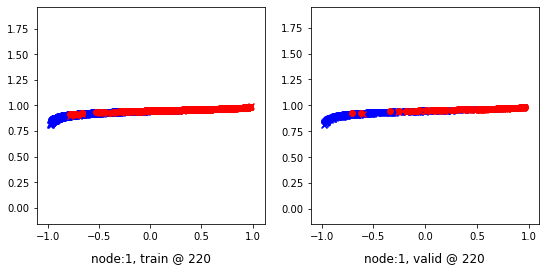

Aggregating on epoch: 225...
Aggregating on epoch: 234...
240 	 0 	 -0.21105829 	 -0.20589262 	 0.00051179 	 0.00055175 	 0.90471846 	 0.89959157


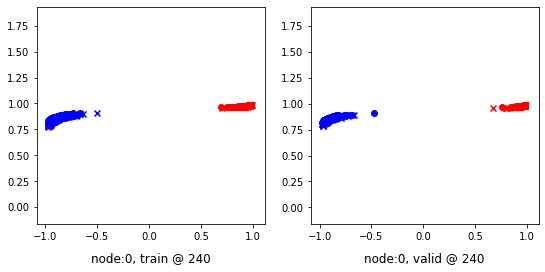

240 	 1 	 0.27075958 	 0.19994435 	 0.51887697 	 0.45896229 	 0.94142491 	 0.95216513


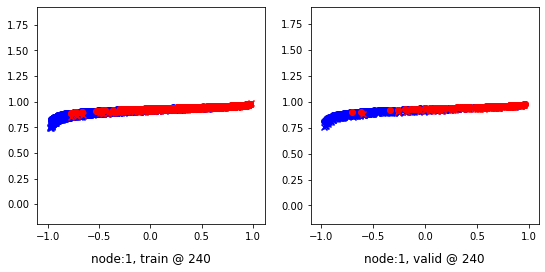

Aggregating on epoch: 243...
Aggregating on epoch: 252...
260 	 0 	 -0.21740033 	 -0.20582289 	 0.00041999 	 0.00046802 	 0.91097021 	 0.89943808


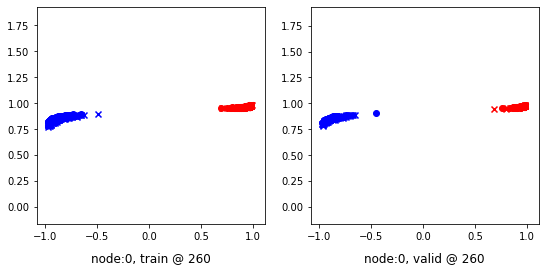

260 	 1 	 0.23345363 	 0.19911790 	 0.48787403 	 0.45751679 	 0.94817019 	 0.95154607


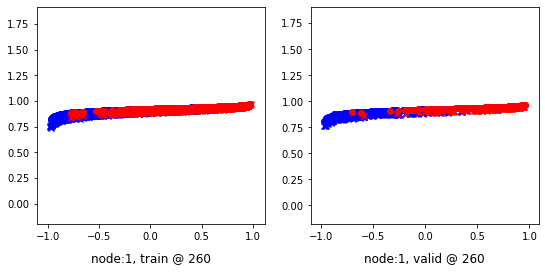

Aggregating on epoch: 261...
Aggregating on epoch: 270...
Aggregating on epoch: 279...
280 	 0 	 -0.26686585 	 -0.20588861 	 0.00037328 	 0.00040205 	 0.96038663 	 0.89943784


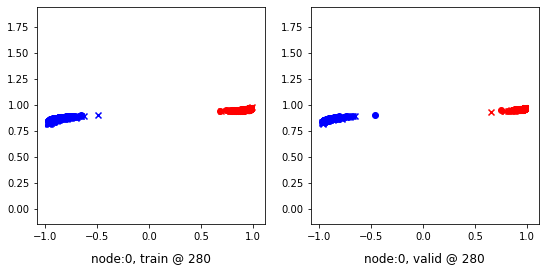

280 	 1 	 0.24113345 	 0.19855186 	 0.50069034 	 0.45720676 	 0.95307469 	 0.95180207


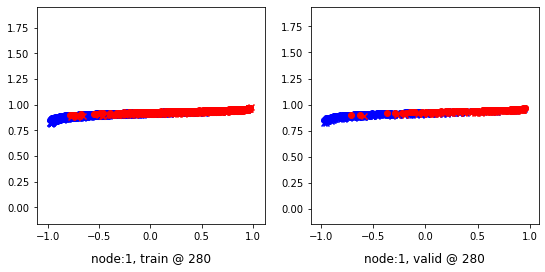

Aggregating on epoch: 288...
Aggregating on epoch: 297...
300 	 0 	 -0.13547775 	 -0.20594673 	 0.00030926 	 0.00034250 	 0.82893598 	 0.89943641


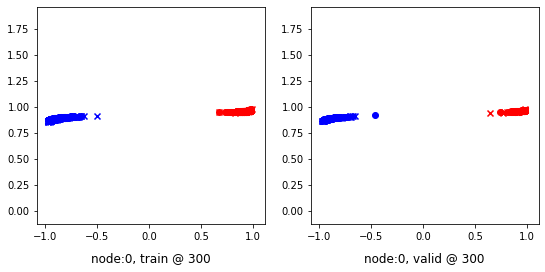

300 	 1 	 0.20178095 	 0.19834042 	 0.45877972 	 0.45660573 	 0.95023441 	 0.95141250


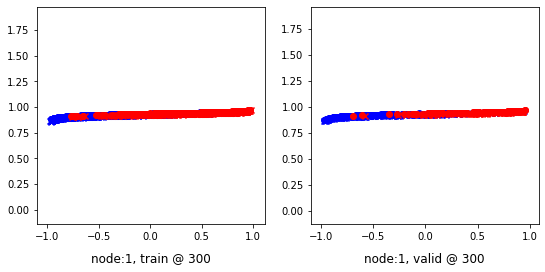

Aggregating on epoch: 306...
Aggregating on epoch: 315...
320 	 0 	 -0.17276445 	 -0.20602047 	 0.00028808 	 0.00029767 	 0.86620098 	 0.89946532


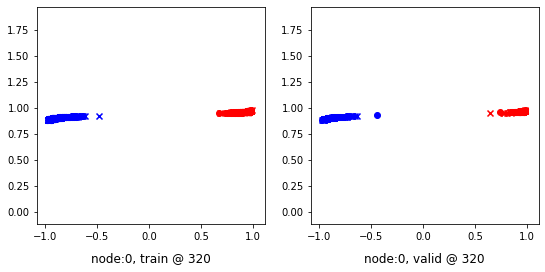

320 	 1 	 0.22582185 	 0.19817463 	 0.48354718 	 0.45664039 	 0.95108169 	 0.95161295


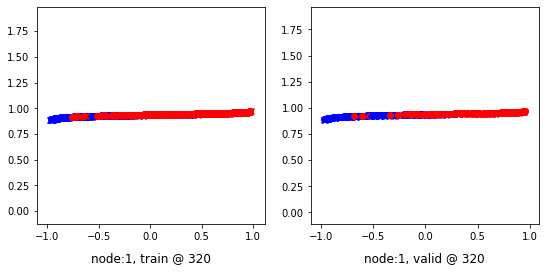

Aggregating on epoch: 324...
Aggregating on epoch: 333...
340 	 0 	 -0.23986582 	 -0.20609967 	 0.00022982 	 0.00026144 	 0.93324333 	 0.89950830


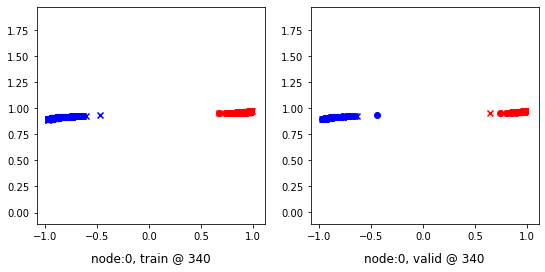

340 	 1 	 0.23690543 	 0.19948074 	 0.49442968 	 0.45834342 	 0.95099366 	 0.95200986


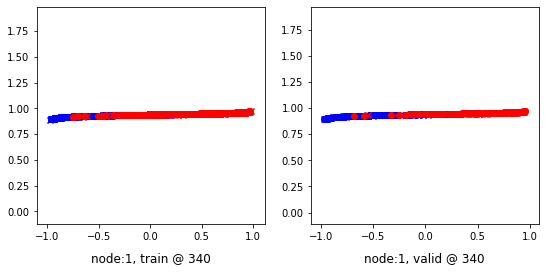

Aggregating on epoch: 342...
Aggregating on epoch: 351...
Aggregating on epoch: 360...
360 	 0 	 -0.22526281 	 -0.20611431 	 0.00019958 	 0.00023507 	 0.91861027 	 0.89949656


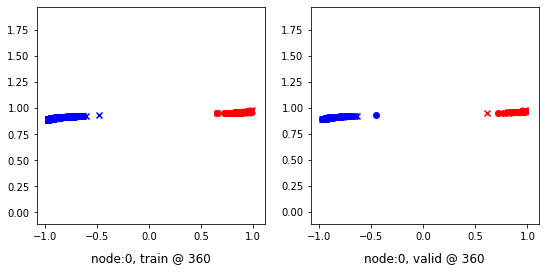

360 	 1 	 0.21844521 	 0.19987994 	 0.47862491 	 0.45935953 	 0.95335871 	 0.95262676


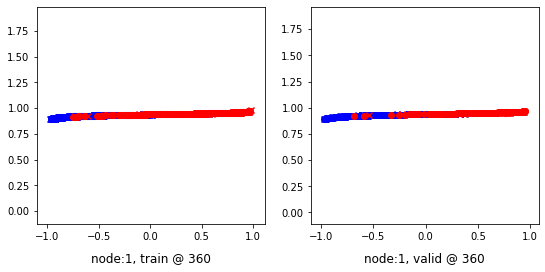

Aggregating on epoch: 369...
Aggregating on epoch: 378...
380 	 0 	 -0.19830842 	 -0.20617080 	 0.00017534 	 0.00021232 	 0.89163172 	 0.89953029


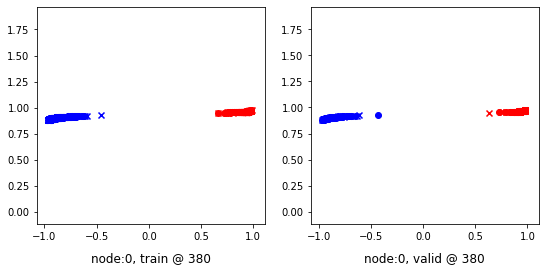

380 	 1 	 0.20145786 	 0.19958588 	 0.45218688 	 0.45879599 	 0.94347227 	 0.95235729


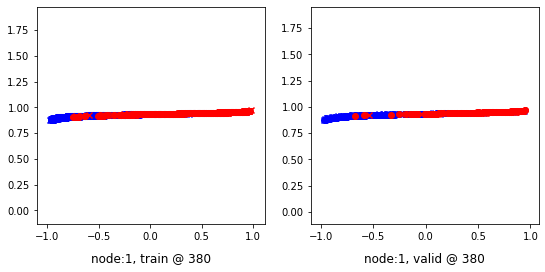

Aggregating on epoch: 387...
Aggregating on epoch: 396...
400 	 0 	 -0.18419932 	 -0.20619570 	 0.00016110 	 0.00019331 	 0.87750846 	 0.89953619


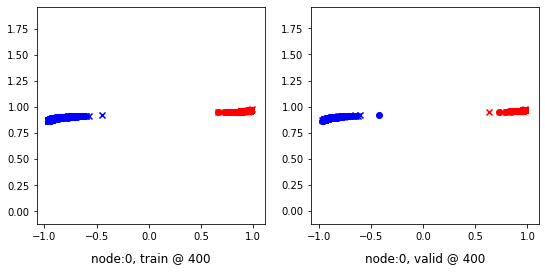

400 	 1 	 0.25225610 	 0.19629142 	 0.50186259 	 0.45508453 	 0.94343257 	 0.95194030


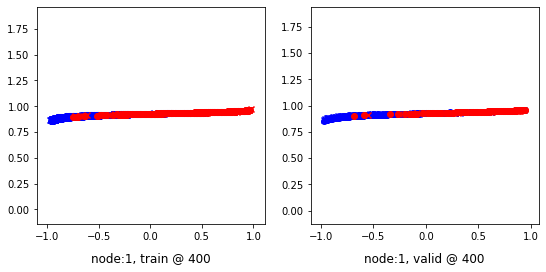

Aggregating on epoch: 405...
Aggregating on epoch: 414...
420 	 0 	 -0.23279905 	 -0.20620118 	 0.00014387 	 0.00017662 	 0.92609054 	 0.89952499


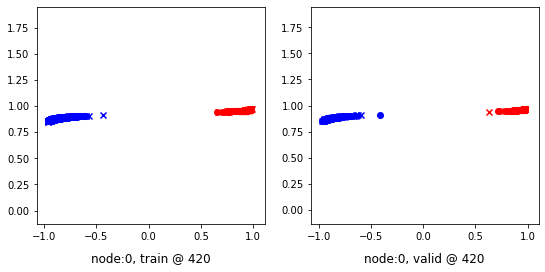

420 	 1 	 0.28657138 	 0.19894367 	 0.53840828 	 0.45790869 	 0.94504130 	 0.95211220


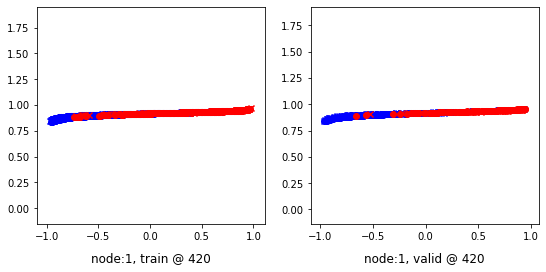

Aggregating on epoch: 423...
Aggregating on epoch: 432...
440 	 0 	 -0.24570861 	 -0.20621227 	 0.00014298 	 0.00016262 	 0.93899930 	 0.89952207


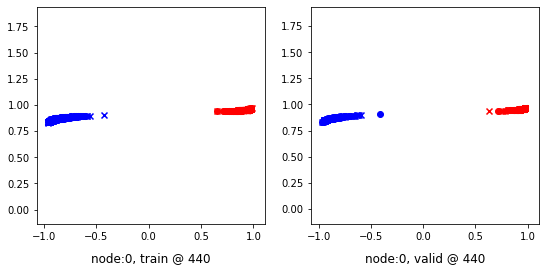

440 	 1 	 0.20842636 	 0.19590351 	 0.46037334 	 0.45486125 	 0.94485927 	 0.95210493


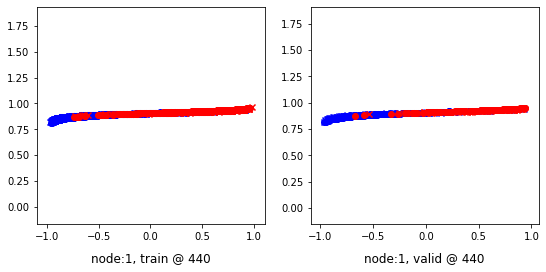

Aggregating on epoch: 441...
Aggregating on epoch: 450...
Aggregating on epoch: 459...
460 	 0 	 -0.17705517 	 -0.20617050 	 0.00012466 	 0.00015306 	 0.87032753 	 0.89947075


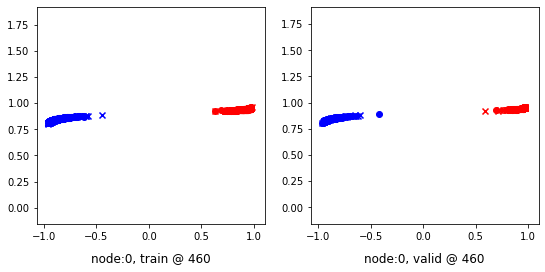

460 	 1 	 0.24525875 	 0.19624457 	 0.49948040 	 0.45574525 	 0.94732940 	 0.95264786


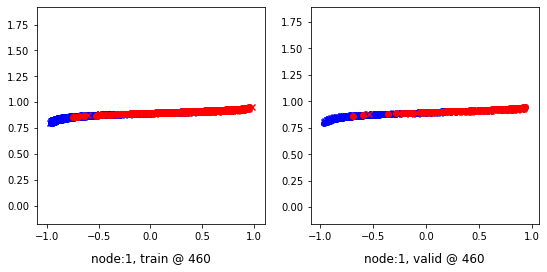

Aggregating on epoch: 468...
Aggregating on epoch: 477...
480 	 0 	 -0.23597844 	 -0.20618755 	 0.00012724 	 0.00014347 	 0.92925334 	 0.89947820


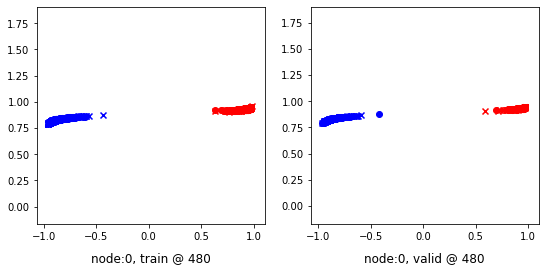

480 	 1 	 0.21333009 	 0.19685042 	 0.46283621 	 0.45576370 	 0.94276989 	 0.95206046


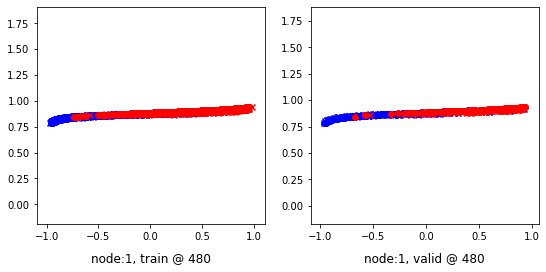

Aggregating on epoch: 486...
Aggregating on epoch: 495...
500 	 0 	 -0.19693334 	 -0.20614982 	 0.00011331 	 0.00013239 	 0.89019406 	 0.89942938


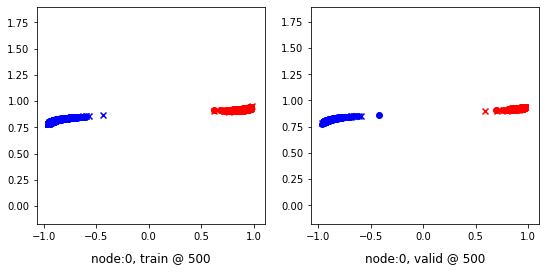

500 	 1 	 0.20915166 	 0.19725162 	 0.46249324 	 0.45591205 	 0.94688904 	 0.95180762


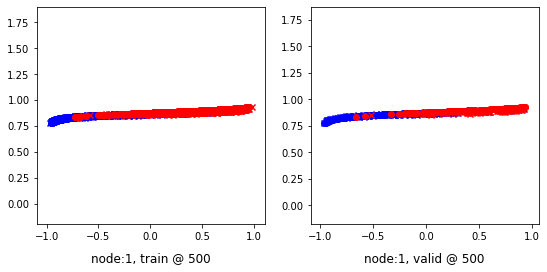

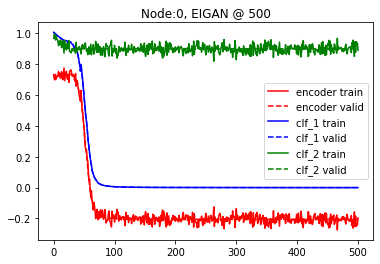

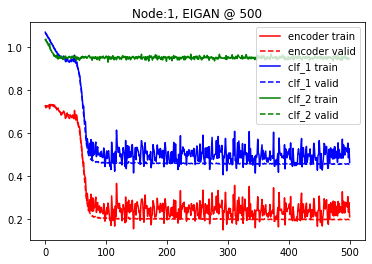

In [12]:
for phi in range(0, 11, 2):
    phi /= 10
    for delta in range(1, 11, 2):
        
        print("-"*80)
        print('EIGAN Training w/ phi={} and delta={}'.format(phi, delta))
        print("-"*80)
        encoders['{}_{}'.format(phi, delta)] = distributed(NUM_NODES, phi, delta, 
                               X_trains, X_valids, 
                               y_1_trains, y_1_valids,
                               y_2_trains, y_2_valids,
                               input_size, hidden_size, output_size, 
                               alpha, lr_encd, lr_1, lr_2, w_1, w_2,
                               train_loaders, n_iter_gan, device, global_params)

In [ ]:
import pickle as pkl
pkl.dump(encoders, open('encoders_num_nodes_2_phi_delta.pkl', 'wb'))

In [ ]:
import pickle as pkl
encoders = pkl.load(open('encoders_num_nodes_2_phi_delta.pkl', 'rb'))

In [ ]:
X_train = torch.cat(X_trains, dim=0).to(device)
X_valid = torch.cat(X_valids, dim=0).to(device)
y_1_train = torch.cat(y_1_trains, dim=0).to(device)
y_1_valid = torch.cat(y_1_valids, dim=0).to(device)
y_2_train = torch.cat(y_2_trains, dim=0).to(device)
y_2_valid = torch.cat(y_2_valids, dim=0).to(device)

In [ ]:
train_loader = DataLoader(TensorDataset(X_train, y_1_train, y_2_train), batch_size=128, shuffle=True)

encoder = centralized(X_train, X_valid,
                      y_1_train, y_1_valid,
                      y_2_train, y_2_valid,
                      input_size, hidden_size, output_size,
                      alpha, lr_encd, lr_1, lr_2, w_1[0], w_2[0],
                      train_loader, n_iter_gan, device)

In [ ]:
import pickle as pkl
pkl.dump(encoder, open('encoder_num_nodes_2_phi_delta.pkl', 'wb'))

In [ ]:
import pickle as pkl
encoder = pkl.load(open('encoder_num_nodes_2_phi_delta.pkl', 'rb'))

In [ ]:
print("-"*80)
print('ALLY: BASELINE')
print("-"*80)
history['baseline_ally'] = metrics.centralized(None, 
                                             input_size, hidden_size, output_size, 
                                             X_train, X_valid, y_1_train, y_1_valid, 
                                             w_1[0], device)

print("-"*80)
print('ADVERSARY: BASELINE')
print("-"*80)
history['baseline_advr'] = metrics.centralized(None, 
                                             input_size, hidden_size, output_size, 
                                             X_train, X_valid, y_2_train, y_2_valid, 
                                             w_2[0], device)

In [ ]:
NUM_NODES = 2
X_trains = [_.to(device) for _ in X_trains]
X_valids = [_.to(device) for _ in X_valids]
y_1_trains = [_.to(device) for _ in y_1_trains]
y_1_valids = [_.to(device) for _ in y_1_valids]
y_2_trains = [_.to(device) for _ in y_2_trains]
y_2_valids = [_.to(device) for _ in y_2_valids]

In [ ]:
print("-"*80)
print('ALLY: CENTRALIZED on 0 local')
print("-"*80)
history['baseline_ally_0'] = metrics.centralized(None, 
                                             input_size, hidden_size, output_size, 
                                             X_trains[0], X_valid, y_1_trains[0], y_1_valid, 
                                             w_1[0], device)

print("-"*80)
print('ADVERSARY: CENTRALIZED')
print("-"*80)
history['baseline_advr_0'] = metrics.centralized(None, 
                                             input_size, hidden_size, output_size, 
                                             X_trains[0], X_valid, y_2_trains[0], y_2_valid,
                                             w_2[0], device)

In [ ]:
print("-"*80)
print('ALLY: CENTRALIZED on 1 local')
print("-"*80)
history['baseline_ally_1'] = metrics.centralized(None, 
                                             input_size, hidden_size, output_size, 
                                             X_trains[1], X_valid, y_1_trains[1], y_1_valid, 
                                             w_1[1], device)

print("-"*80)
print('ADVERSARY: CENTRALIZED')
print("-"*80)
history['baseline_advr_1'] = metrics.centralized(None, 
                                             input_size, hidden_size, output_size, 
                                             X_trains[1], X_valid, y_2_trains[1], y_2_valid, 
                                             w_2[1], device)

In [ ]:
print("-"*80)
print('ALLY: CENTRALIZED')
print("-"*80)
history['centralized_ally'] = metrics.centralized(encoder, 
                                             input_size, hidden_size, output_size, 
                                             X_train, X_valid, y_1_train, y_1_valid, 
                                             w_1[0], device)

print("-"*80)
print('ADVERSARY: CENTRALIZED')
print("-"*80)
history['centralized_advr'] = metrics.centralized(encoder, 
                                             input_size, hidden_size, output_size, 
                                             X_train, X_valid, y_2_train, y_2_valid, 
                                             w_2[0], device)

In [ ]:
for key, encd in encoders.items():
    print("-"*80)
    print('ALLY: {}'.format(key))
    print("-"*80)
    history['decentralize_ally_{}'.format(key)] = metrics.distributed(encd, NUM_NODES,
                                                         input_size, hidden_size, output_size, 
                                                         X_trains, X_valids, y_1_trains, y_1_valids, 
                                                         w_1[0], device)
    print("-"*80)
    print('ADVERSARY: {}'.format(key))
    print("-"*80)
    history['decentralized_advr_{}'.format(key)] = metrics.distributed(encd, NUM_NODES,
                                                                     input_size, hidden_size, output_size, 
                                                                     X_trains, X_valids, y_2_trains, y_2_valids, 
                                                                     w_2[0], device)

In [ ]:
history

In [ ]:
history['decentralized_advr_1.0_7']

In [ ]:
delta = 7
baseline_ally = []
baseline_advr = []
eigan_ally = []
eigan_advr = []
dist_x = []
dist_ally = []
dist_advr = []

tmp = history['baseline_ally'][3]
baseline_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
tmp = history['baseline_advr'][3]
baseline_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
tmp = history['centralized_ally'][3]
eigan_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
tmp = history['centralized_advr'][3]
eigan_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

fig, (ax2, ax1) = plt.subplots(1, 2, figsize=(10, 4))

for phi in range(0, 11, 2):
    phi /= 10
    dist_x.append(phi)
    tmp = history['decentralize_{}_{}_{}'.format('ally', phi, delta)][3]
    dist_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
    tmp = history['decentralized_{}_{}_{}'.format('advr', phi, delta)][3]
    dist_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

ax1.hlines(y=eigan_ally[0], xmin=-0.1, xmax=1.1, color='b', linestyle='dashed')
ax1.hlines(y=eigan_advr[0], xmin=-0.1, xmax=1.1, color='r', linestyle='dashed')
ax1.bar(np.array(dist_x)-0.025, dist_ally, width=0.05, color='b')
ax1.bar(np.array(dist_x)+0.025, dist_advr, width=0.05, color='r')
ax1.set_xticks(dist_x)
ax1.set_xlim(left=-0.1, right=1.1)
ax1.legend(['c-ally', 'c-adversary', 'd-ally', 'd-adversary'], loc='lower right')
ax1.set_xlabel('fraction of parameters shared')
ax1.set_ylabel('f1 score')
ax1.set_title('(b)', y=-0.3)
ax1.grid()

phi = 0.8
dist_x = []
dist_ally = []
dist_advr = []
for delta in range(1, 11, 2):
    dist_x.append(delta)
    tmp = history['decentralize_{}_{}_{}'.format('ally', phi, delta)][3]
    dist_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
    tmp = history['decentralized_{}_{}_{}'.format('advr', phi, delta)][3]
    dist_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

ax2.hlines(y=eigan_ally[0], xmin=0, xmax=11, color='b', linestyle='dashed')
ax2.hlines(y=eigan_advr[0], xmin=0, xmax=11, color='r', linestyle='dashed')
ax2.bar(np.array(dist_x)-0.25, dist_ally, width=0.5, color='b')
ax2.bar(np.array(dist_x)+0.25, dist_advr, width=0.5, color='r')
ax2.set_xticks(dist_x)
ax2.set_xlim(left=0, right=11)
ax2.set_xlabel('frequency of sync')
ax2.set_ylabel('f1 score')
ax2.set_title('(a)', y=-.3)
ax2.grid()

plt.rcParams.update({'font.size': 14})
fig.subplots_adjust(wspace=0.3)
plt.savefig('distributed_eigan_comparison.png', bbox_inches='tight', dpi=300)

In [ ]:
history['centralized_ally'][3]

In [ ]:
plt.setp(bp1['boxes'], color='cyan')
plt.setp(bp1['medians'], color='black')
bp2 = ax1.boxplot(eigan_ally, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.15, 0.35, 0.55, 0.75], showfliers=False, patch_artist=True)
plt.setp(bp2['boxes'], color='red')
plt.setp(bp2['medians'], color='black')
bp3 = ax1.boxplot(baseline_ally, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.25, 0.45, 0.65, 0.85], showfliers=False, patch_artist=True)
plt.setp(bp3['boxes'], color='orange')
plt.setp(bp3['medians'], color='black')
ax1.legend([bp1["boxes"][0], bp2["boxes"][0], bp3["boxes"][0]], 
           ['Bertran', 'EIGAN', 'Unencoded'], loc='upper right', prop={'size':10})
ax1.set_xlim(left=0, right=1)
ax1.set_title('(b)', y=-0.3)
ax1.set_xlabel('variance along ally label')
ax1.set_ylabel('accuracy')
ax1.set_xticks([0.2, 0.4, 0.6, 0.8])
ax1.grid()

bp1 = ax2.boxplot(bertran_advr, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.2, 0.4, 0.6, 0.8], showfliers=False, patch_artist=True)
plt.setp(bp1['boxes'], color='cyan')
plt.setp(bp1['medians'], color='black')
bp2 = ax2.boxplot(eigan_advr, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.15, 0.35, 0.55, 0.75], showfliers=False, patch_artist=True)
plt.setp(bp2['boxes'], color='red')
plt.setp(bp2['medians'], color='black')
bp3 = ax2.boxplot(baseline_advr, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.25, 0.45, 0.65, 0.85], showfliers=False, patch_artist=True)
plt.setp(bp3['boxes'], color='orange')
plt.setp(bp3['medians'], color='black')
ax2.set_xlim(left=0, right=1)
ax2.set_title('(a)', y=-0.3)
ax2.set_xlabel('variance along ally label')
ax2.set_ylabel('accuracy')
ax2.set_xticks([0.2, 0.4, 0.6, 0.8])
ax2.grid()

fig.subplots_adjust(wspace=0.3)
plt.savefig('0.4_advr_varying_ally_comparison.png', bbox_inches='tight', dpi=300)
plt.show()